In [16]:
# main to-do's:
# set up CNN architecture

In [1]:
import numpy as np
import h5py
import glob
import matplotlib.pyplot as plt

FS = 18

## Setting up labels and colors + testing them

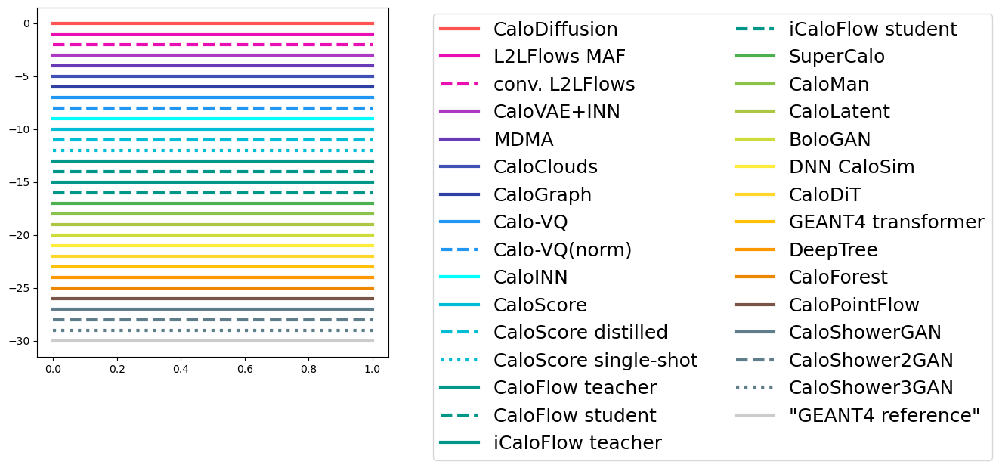

In [2]:
id_dict = {1: 'CaloDiffusion',
           2: 'L2LFlows MAF',
           3: 'conv. L2LFlows',
           4: 'CaloINN',
           5: 'MDMA',
           6: 'CaloClouds',
           7: 'Calo-VQ',
          31: 'Calo-VQ(norm)',
           8: 'CaloScore',
           9: 'CaloScore distilled',
          10: 'CaloScore single-shot',
          11: 'CaloFlow teacher',
          12: 'CaloFlow student',
          13: 'iCaloFlow teacher',
          14: 'iCaloFlow student',
          15: 'SuperCalo',
          16: 'CaloMan', 
          17: 'BoloGAN',
          #18: 'BoloGAN low',
          #19: 'BoloGAN high',
          20: 'DNN CaloSim',
          32: 'CaloDiT',
          21: 'GEANT4 transformer',
          22: 'DeepTree',
          23: 'CaloPointFlow',
          24: 'CaloShowerGAN',
          25: 'CaloShower2GAN',
          26: 'CaloShower3GAN',
          27: 'CaloVAE+INN',
          28: 'CaloForest',
          29: 'CaloGraph',
          30: 'CaloLatent',
          'geant': '"GEANT4 reference"'}

kwargs_dict = {
    1: {'color': '#FF5252', 'linestyle': 'solid'},
    2: {'color': '#E910B3', 'linestyle': 'solid'}, ##E91E63
    3: {'color': '#E910B3', 'linestyle': 'dashed'},
    27: {'color': '#ad38c1', 'linestyle': 'solid'}, #'#9C27B0'
    5: {'color': '#673AB7', 'linestyle': 'solid'},
    6: {'color': '#3F51B5', 'linestyle': 'solid'},
    29: {'color': '#2e40a4', 'linestyle': 'solid'},
    7: {'color': '#2196f3', 'linestyle': 'solid'},
    31: {'color': '#2196f3', 'linestyle': 'dashed'},
    4: {'color': '#00FFFF', 'linestyle': 'solid'},
    8: {'color': '#00BCD4', 'linestyle': 'solid'},
    9: {'color': '#00BCD4', 'linestyle': 'dashed'},
    10: {'color': '#00BCD4', 'linestyle': 'dotted'},
    11: {'color': '#009688', 'linestyle': 'solid'},
    12: {'color': '#009688', 'linestyle': 'dashed'},
    13: {'color': '#009688', 'linestyle': 'solid'},
    14: {'color': '#009688', 'linestyle': 'dashed'},
    15: {'color': '#4CAF50', 'linestyle': 'solid'},
    16: {'color': '#8bc34a', 'linestyle': 'solid'},
    30: {'color': '#acc840', 'linestyle': 'solid'},
    17: {'color': '#CDDC39', 'linestyle': 'solid'},
    20: {'color': '#ffeb3b', 'linestyle': 'solid'},
    32: {'color': '#ffd629', 'linestyle': 'solid'},
    21: {'color': '#ffc107', 'linestyle': 'solid'},
    22: {'color': '#ff9800', 'linestyle': 'solid'},
    28: {'color': '#ee8700', 'linestyle': 'solid'},
    23: {'color': '#795548', 'linestyle': 'solid'},
    24: {'color': '#607d8b', 'linestyle': 'solid'},
    25: {'color': '#607d8b', 'linestyle': 'dashed'},
    26: {'color': '#607d8b', 'linestyle': 'dotted'},
    'geant': {'color': 'k', 'linestyle': 'solid', 'alpha': 0.2},
}

running_id = 0
plt.figure(figsize=(6,6))
for entry in kwargs_dict:
    plt.plot([0,1], running_id*np.array([1., 1.]), label=id_dict[entry], linewidth=3., **kwargs_dict[entry])
    running_id -= 1.
plt.legend(bbox_to_anchor=(1.1, 1.01), fontsize=FS,ncol=2)
plt.show()

In [3]:
# list of available files

all_files = glob.glob('../scratch_CaloChallenge/data/*/*')
num_total = 0
num_ds1_photons = 0
num_ds1_pions = 0
num_ds2 = 0
num_ds3 = 0

ds1_photons_dict = {}
ds1_pions_dict = {}
ds2_dict = {}
ds3_dict = {}

#for i in range(1,32):
for i in id_dict.keys():
    for submission in all_files:
        if f"_{i}.hdf5" in submission:
            if ('/ds1-photons' in submission):
                print(f"{submission} is {id_dict[i]}")
                num_total += 1
                num_ds1_photons += 1
                ds1_photons_dict[i] = submission
            if ('/ds1-pions' in submission):
                print(f"{submission} is {id_dict[i]}")
                num_total += 1
                num_ds1_pions += 1
                ds1_pions_dict[i] = submission
            if ('/ds2_' in submission):
                print(f"{submission} is {id_dict[i]}")
                num_total += 1
                num_ds2 += 1
                ds2_dict[i] = submission
            if ('/ds3_' in submission):
                print(f"{submission} is {id_dict[i]}")
                num_total += 1
                num_ds3 += 1
                ds3_dict[i] = submission

print(" - - - ")
print(f"total of {num_total} submissions")
print(f"ds1 photons: {num_ds1_photons} submissions")
print(f"ds1 pions: {num_ds1_pions} submissions")
print(f"ds2: {num_ds2} submissions")
print(f"ds3: {num_ds3} submissions")

../scratch_CaloChallenge/data/Amram/ds2_1.hdf5 is CaloDiffusion
../scratch_CaloChallenge/data/Amram/ds1-photons_1.hdf5 is CaloDiffusion
../scratch_CaloChallenge/data/Amram/ds3_1.hdf5 is CaloDiffusion
../scratch_CaloChallenge/data/Amram/ds1-pions_1.hdf5 is CaloDiffusion
../scratch_CaloChallenge/data/Buss/ds3_2.hdf5 is L2LFlows MAF
../scratch_CaloChallenge/data/Buss/ds3_3.hdf5 is conv. L2LFlows
../scratch_CaloChallenge/data/Buss/ds2_3.hdf5 is conv. L2LFlows
../scratch_CaloChallenge/data/Favaro/ds2_4.hdf5 is CaloINN
../scratch_CaloChallenge/data/Favaro/ds1-pions_4.hdf5 is CaloINN
../scratch_CaloChallenge/data/Favaro/ds1-photons_4.hdf5 is CaloINN
../scratch_CaloChallenge/data/Kaech/ds3_5.hdf5 is MDMA
../scratch_CaloChallenge/data/Kaech/ds2_5.hdf5 is MDMA
../scratch_CaloChallenge/data/Korol/ds3_6.hdf5 is CaloClouds
../scratch_CaloChallenge/data/Liu/ds2_7.hdf5 is Calo-VQ
../scratch_CaloChallenge/data/Liu/ds3_7.hdf5 is Calo-VQ
../scratch_CaloChallenge/data/Liu/ds1-photons_7.hdf5 is Calo-VQ
..

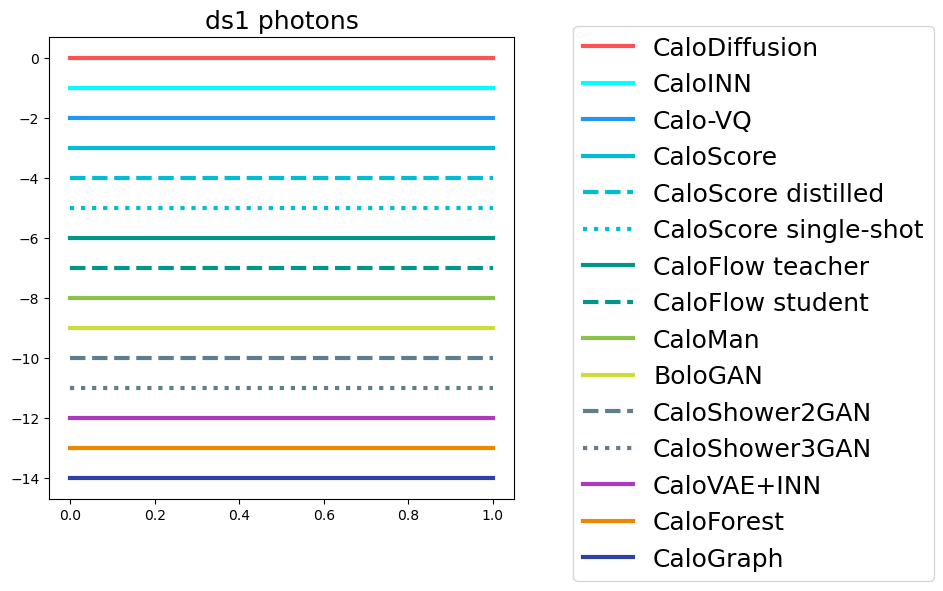

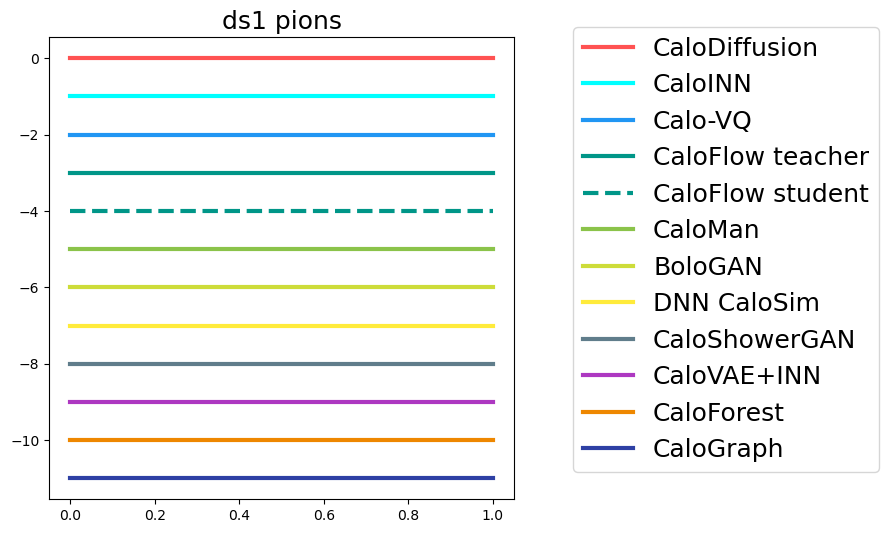

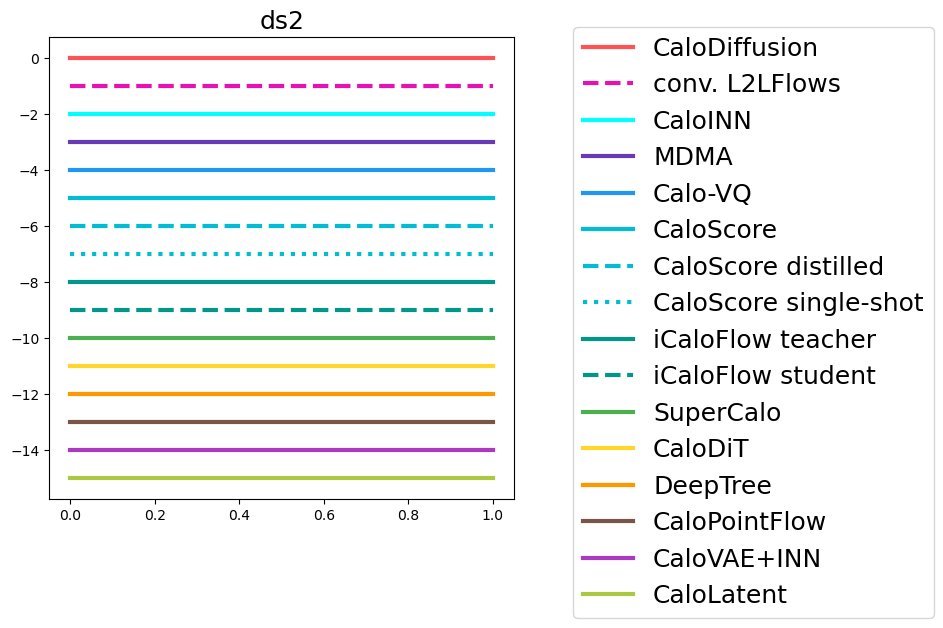

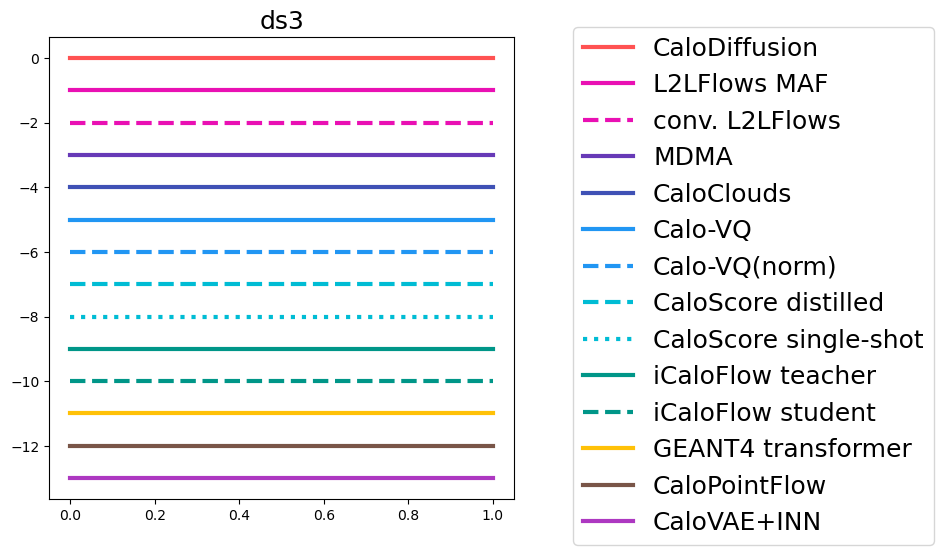

In [4]:
for dataset in [(ds1_photons_dict, 'ds1 photons'), (ds1_pions_dict, 'ds1 pions'), (ds2_dict, 'ds2'), (ds3_dict, 'ds3')]:
    plt.figure(figsize=(6,6))
    running_id = 0
    for entry in dataset[0]:
        plt.plot([0,1], running_id*np.array([1., 1.]), label=id_dict[entry], linewidth=3., **kwargs_dict[entry])
        running_id -= 1.
    plt.legend(bbox_to_anchor=(1.1, 1.05), fontsize=FS)
    plt.title(dataset[1], fontsize=FS)
    plt.show()


## evaluation

In [5]:
import sys
import pickle
sys.path.append("CaloChallenge_homepage/code/")
#import argparse
from CaloChallenge_homepage.code import HighLevelFeatures as HLF
#from eval_code import evaluate as cceval
#from eval_code import evaluate_plotting_helper as eph


In [6]:
# for LLF
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import TensorDataset
from torch.utils.data import Dataset
from torch.utils.data import DataLoader

from sklearn.metrics import ConfusionMatrixDisplay

torch.set_default_dtype(torch.float32)

device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using {device} device")

Using cuda device


In [7]:
# from preprocessing
def extract_info(filename):
    local_file = h5py.File(filename, 'r')
    E_inc = local_file['incident_energies'][:]
    if np.isnan(E_inc).any():
        print("NaN in E_inc")
    showers = local_file['showers'][:]
    if np.isnan(showers).any():
        print("NaN in showers")
    local_file.close()
    return E_inc.astype(np.float32), showers.astype(np.float32)

# from evaluate_plotting_helper

def separation_power(hist1, hist2, bins):
    """ computes the separation power aka triangular discrimination (cf eq. 15 of 2009.03796)
        Note: the definition requires Sum (hist_i) = 1, so if hist1 and hist2 come from
        plt.hist(..., density=True), we need to multiply hist_i by the bin widhts
    """
    hist1, hist2 = hist1*np.diff(bins), hist2*np.diff(bins)
    ret = (hist1 - hist2)**2
    ret /= hist1 + hist2 + 1e-16
    return 0.5 * ret.sum()

# formerly plot_E_layers
def get_sep_E_layers(hlf_class, reference_class, ref=False):
    """ gets separation power from plot of energy deposited in each layer """
    ret_seps = []
    for key in hlf_class.GetElayers().keys():
        plt.figure(figsize=(6, 6))
        bins = np.logspace(np.log10(MIN_ENERGY),
                           np.log10(reference_class.GetElayers()[key].max()), 40)
        counts_ref, bins, _ = plt.hist(reference_class.GetElayers()[key], bins=bins,
                                       label='reference', density=True, histtype='stepfilled',
                                       alpha=0.75, linewidth=2., color='#e41a1c')
        counts_data, _, _ = plt.hist(hlf_class.GetElayers()[key], label='generated', bins=bins,
                                     histtype='step', linewidth=3., alpha=1., density=True, color='#377eb8')
        plt.title("Energy deposited in layer {}".format(key))
        plt.xlabel(r'$E$ [MeV]')
        plt.yscale('log')
        plt.xscale('log')
        if not ref:
            plt.legend(fontsize=20)
        plt.tight_layout()
        seps = separation_power(counts_ref, counts_data, bins)
        print("Separation power of E layer {} histogram: {}".format(key, seps))
        plt.show()
        ret_seps.append(seps)
    return ret_seps

# formerly plot_ECEtas
def get_sep_ECEtas(hlf_class, reference_class, dataset, ref=False):
    """ gets separation power from plot of center of energy in eta """
    ret_seps = []
    for key in hlf_class.GetECEtas().keys():
        if dataset in ['2', '3']:
            lim = (-30., 30.)
        elif key in [12, 13]:
            lim = (-500., 500.)
        else:
            lim = (-100., 100.)
        plt.figure(figsize=(6, 6))
        bins = np.linspace(*lim, 101)
        counts_ref, _, _ = plt.hist(reference_class.GetECEtas()[key], bins=bins,
                                    label='reference', density=True, histtype='stepfilled',
                                    alpha=0.75, linewidth=2., color='#e41a1c')
        counts_data, _, _ = plt.hist(hlf_class.GetECEtas()[key], label='generated', bins=bins,
                                     histtype='step', linewidth=3., alpha=1., density=True, color='#377eb8')
        plt.title(r"Center of Energy in $\Delta\eta$ in layer {}".format(key))
        plt.xlabel(r'[mm]')
        plt.xlim(*lim)
        plt.yscale('log')
        if not ref:
            plt.legend(fontsize=20)
        plt.tight_layout()
        seps = separation_power(counts_ref, counts_data, bins)
        print("Separation power of EC Eta layer {} histogram: {}".format(key, seps))
        plt.show()
        ret_seps.append(seps)
    return ret_seps

# formerly plot_ECPhis
def get_sep_ECPhis(hlf_class, reference_class, dataset, ref=False):
    """ gets separation power from plot of center of energy in phi """
    ret_seps = []
    for key in hlf_class.GetECPhis().keys():
        if dataset in ['2', '3']:
            lim = (-30., 30.)
        elif key in [12, 13]:
            lim = (-500., 500.)
        else:
            lim = (-100., 100.)
        plt.figure(figsize=(6, 6))
        bins = np.linspace(*lim, 101)
        counts_ref, _, _ = plt.hist(reference_class.GetECPhis()[key], bins=bins,
                                    label='reference', density=True, histtype='stepfilled',
                                    alpha=0.75, linewidth=2., color='#e41a1c')
        counts_data, _, _ = plt.hist(hlf_class.GetECPhis()[key], label='generated', bins=bins,
                                     histtype='step', linewidth=3., alpha=1., density=True, color='#377eb8')
        plt.title(r"Center of Energy in $\Delta\phi$ in layer {}".format(key))
        plt.xlabel(r'[mm]')
        plt.xlim(*lim)
        plt.yscale('log')
        if not ref:
            plt.legend(fontsize=20)
        plt.tight_layout()
        seps = separation_power(counts_ref, counts_data, bins)
        print("Separation power of EC Phi layer {} histogram: {}".format(key, seps))
        plt.show()
        ret_seps.append(seps)
    return ret_seps

# formerly plot_ECWidthEtas
def get_sep_ECWidthEtas(hlf_class, reference_class, dataset, ref=False):
    """ gets separation power from plot of width of center of energy in eta """
    ret_seps = []
    for key in hlf_class.GetWidthEtas().keys():
        if dataset in ['2', '3']:
            lim = (0., 30.)
        elif key in [12, 13]:
            lim = (0., 400.)
        else:
            lim = (0., 100.)
        plt.figure(figsize=(6, 6))
        bins = np.linspace(*lim, 101)
        counts_ref, _, _ = plt.hist(reference_class.GetWidthEtas()[key], bins=bins,
                                    label='reference', density=True, histtype='stepfilled',
                                    alpha=0.75, linewidth=2., color='#e41a1c')
        counts_data, _, _ = plt.hist(hlf_class.GetWidthEtas()[key], label='generated', bins=bins,
                                     histtype='step', linewidth=3., alpha=1., density=True, color='#377eb8')
        plt.title(r"Width of Center of Energy in $\Delta\eta$ in layer {}".format(key))
        plt.xlabel(r'[mm]')
        plt.xlim(*lim)
        plt.yscale('log')
        if not ref:
            plt.legend(fontsize=20)
        plt.tight_layout()
        seps = separation_power(counts_ref, counts_data, bins)
        print("Separation power of Width Eta layer {} histogram: {}".format(key, seps))
        plt.show()
        ret_seps.append(seps)
    return ret_seps

# formerly plot_ECWidthPhis
def get_sep_ECWidthPhis(hlf_class, reference_class, dataset, ref=False):
    """ gets separation power from plot of width of center of energy in phi """
    ret_seps = []
    for key in hlf_class.GetWidthPhis().keys():
        if dataset in ['2', '3']:
            lim = (0., 30.)
        elif key in [12, 13]:
            lim = (0., 400.)
        else:
            lim = (0., 100.)
        plt.figure(figsize=(6, 6))
        bins = np.linspace(*lim, 101)
        counts_ref, _, _ = plt.hist(reference_class.GetWidthPhis()[key], bins=bins,
                                    label='reference', density=True, histtype='stepfilled',
                                    alpha=0.75, linewidth=2., color='#e41a1c')
        counts_data, _, _ = plt.hist(hlf_class.GetWidthPhis()[key], label='generated', bins=bins,
                                     histtype='step', linewidth=3., alpha=1., density=True, color='#377eb8')
        plt.title(r"Width of Center of Energy in $\Delta\phi$ in layer {}".format(key))
        plt.xlabel(r'[mm]')
        plt.yscale('log')
        plt.xlim(*lim)
        if not ref:
            plt.legend(fontsize=20)
        plt.tight_layout()
        seps = separation_power(counts_ref, counts_data, bins)
        print("Separation power of Width Phi layer {} histogram: {}".format(key, seps))
        plt.show()
        ret_seps.append(seps)
    return ret_seps

# formerly plot_sparsity
def get_sep_Sparsity_layers(hlf_class, reference_class, ref=False):
    """ gets separation power from plot of sparsity in each layer """
    ret_seps = []
    for key in hlf_class.GetSparsity().keys():
        plt.figure(figsize=(6, 6))
        bins = np.linspace(0., 1., 21)
        counts_ref, bins, _ = plt.hist(reference_class.GetSparsity()[key], bins=bins,
                                       label='reference', density=True, histtype='stepfilled',
                                       alpha=0.75, linewidth=2., color='#e41a1c')
        counts_data, _, _ = plt.hist(hlf_class.GetSparsity()[key], label='generated', bins=bins,
                                     histtype='step', linewidth=3., alpha=1., density=True, color='#377eb8')
        plt.title("Sparsity in layer {}".format(key))
        plt.xlabel(r'fraction of voxels with 0 energy deposition')
        #plt.yscale('log')
        if not ref:
            plt.legend(fontsize=20)
        plt.tight_layout()
        seps = separation_power(counts_ref, counts_data, bins)
        print("Separation power of Sparsity layer {} histogram: {}".format(key, seps))
        plt.show()
        ret_seps.append(seps)
    return ret_seps

# formerly plot_ECR
def get_sep_ECR(hlf_class, reference_class, dataset, ref=False):
    """ gets separation power from plot of center of energy in r """
    ret_seps = []
    for key in hlf_class.GetECR().keys():
        if dataset in ['2', '3']:
            lim = (0., 42.)
        elif key in [12, 13, 14]:
            lim = (0., 1500.)
        else:
            lim = (0., 500.)
        plt.figure(figsize=(6, 6))
        bins = np.linspace(*lim, 101)
        counts_ref, _, _ = plt.hist(reference_class.GetECR()[key], bins=bins,
                                    label='reference', density=True, histtype='stepfilled',
                                    alpha=0.75, linewidth=2., color='#e41a1c')
        counts_data, _, _ = plt.hist(hlf_class.GetECR()[key], label='generated', bins=bins,
                                     histtype='step', linewidth=3., alpha=1., density=True, color='#377eb8')
        plt.title(r"Center of Energy in $r$ in layer {}".format(key))
        plt.xlabel(r'[mm]')
        plt.xlim(*lim)
        plt.yscale('log')
        if not ref:
            plt.legend(fontsize=20)
        plt.tight_layout()
        seps = separation_power(counts_ref, counts_data, bins)
        print("Separation power of EC r layer {} histogram: {}".format(key, seps))
        plt.show()
        ret_seps.append(seps)
    return ret_seps

# formerly plot_ECWidthR
def get_sep_ECWidthR(hlf_class, reference_class, dataset, ref=False):
    """ gets separation power from plot of width of center of energy in r """
    ret_seps = []
    for key in hlf_class.GetWidthR().keys():
        if dataset in ['2', '3']:
            lim = (0., 20.)
        elif key in [12, 13, 14]:
            lim = (0., 1500.)
        else:
            lim = (0., 500.)
        plt.figure(figsize=(6, 6))
        bins = np.linspace(*lim, 101)
        counts_ref, _, _ = plt.hist(reference_class.GetWidthR()[key], bins=bins,
                                    label='reference', density=True, histtype='stepfilled',
                                    alpha=0.75, linewidth=2., color='#e41a1c')
        counts_data, _, _ = plt.hist(hlf_class.GetWidthR()[key], label='generated', bins=bins,
                                     histtype='step', linewidth=3., alpha=1., density=True, color='#377eb8')
        plt.title(r"Width of Center of Energy in $r$ in layer {}".format(key))
        plt.xlabel(r'[mm]')
        plt.xlim(*lim)
        plt.yscale('log')
        if not ref:
            plt.legend(fontsize=20)
        plt.tight_layout()
        seps = separation_power(counts_ref, counts_data, bins)
        print("Separation power of Width r layer {} histogram: {}".format(key, seps))
        plt.show()
        ret_seps.append(seps)
    return ret_seps

# formerly plot_Etot_Einc, but with changed binning (was np.linspace(0.5, 1.5, 101))
def get_sep_Etot_Einc(hlf_class, reference_class, ref=False):
    """ gets separation power from plot Etot normalized to Einc histogram """

    bins = np.linspace(0., 2., 101)
    plt.figure(figsize=(6, 6))
    counts_ref, _, _ = plt.hist(reference_class.GetEtot() / reference_class.Einc.squeeze(),
                                bins=bins, label='reference', density=True,
                                histtype='stepfilled', alpha=0.75, linewidth=2., color='#e41a1c')
    counts_data, _, _ = plt.hist(hlf_class.GetEtot() / hlf_class.Einc.squeeze(), bins=bins,
                                 label='generated', histtype='step', linewidth=3., alpha=1.,
                                 density=True, color='#377eb8')
    plt.xlim(0., 2.)
    plt.xlabel(r'$E_{tot} / E_{inc}$')
    if not ref:
        plt.legend(fontsize=20)
    plt.tight_layout()
    seps = separation_power(counts_ref, counts_data, bins)
    print("Separation power of Etot / Einc histogram: {}".format(seps))
    plt.show()
    return seps

# formerly plot_cell_dist np.log10(MIN_ENERGY)
def get_sep_cell_dist(hlf_class, reference_class, shower_direct=False, ref=False):
    """ gets separation power from plotof voxel energies across all layers """
    if shower_direct:
        shower_arr, ref_shower_arr = hlf_class, reference_class
    else:
        shower_arr, ref_shower_arr = hlf_class.showers, reference_class.showers
    plt.figure(figsize=(6, 6))
    bins = np.logspace(np.log10(MIN_ENERGY), np.log10(ref_shower_arr.max()), 50)

    counts_ref, _, _ = plt.hist(ref_shower_arr.flatten(), bins=bins,
                                label='reference', density=True, histtype='stepfilled',
                                alpha=0.75, linewidth=2., color='#e41a1c')
    counts_data, _, _ = plt.hist(shower_arr.flatten(), label='generated', bins=bins,
                                 histtype='step', linewidth=3., alpha=1., density=True, color='#377eb8')
    plt.title(r"Voxel energy distribution")
    plt.xlabel(r'$E$ [MeV]')
    plt.yscale('log')
    plt.xscale('log')
    #plt.xlim(*lim)
    if not ref:
        plt.legend(fontsize=20)
    plt.tight_layout()
    seps = separation_power(counts_ref, counts_data, bins)
    print("Separation power of voxel distribution histogram: {}".format(seps))
    plt.show()
    return seps

def get_min_max_from_dict(entry_dict, key):
    local_array = np.array(entry_dict[key])
    return local_array.min(axis=0), local_array.max(axis=0)

In [8]:
# default challenge eval
class DNN(torch.nn.Module):
    """ NN for vanilla classifier. Does not have sigmoid activation in last layer, should
        be used with torch.nn.BCEWithLogitsLoss()
    """
    def __init__(self, num_layer, num_hidden, input_dim, output_dim, dropout_probability=0.):
        super(DNN, self).__init__()

        self.dpo = dropout_probability

        self.inputlayer = torch.nn.Linear(input_dim, num_hidden)
        self.outputlayer = torch.nn.Linear(num_hidden, output_dim)

        all_layers = [self.inputlayer, torch.nn.LeakyReLU(), torch.nn.Dropout(self.dpo)]
        for _ in range(num_layer):
            all_layers.append(torch.nn.Linear(num_hidden, num_hidden))
            all_layers.append(torch.nn.LeakyReLU())
            all_layers.append(torch.nn.Dropout(self.dpo))

        all_layers.append(self.outputlayer)
        self.layers = torch.nn.Sequential(*all_layers)

    def forward(self, x):
        """ Forward pass through the DNN """
        x = self.layers(x)
        # Apply softmax to x, so NLLLoss can be used
        output = F.log_softmax(x, dim=1)
        return output
    
class HuilinQuNet(torch.nn.Module):
    pass

In [9]:
def find_accuracy(pred, label):
    overall = (np.argmax(pred, axis=-1) == label).astype(float) #.mean()
    return overall

def train(model, dataloader, optimizer, criterion, device=None, idx=None):
    model.train()
    train_loss = []
    for i, batch in enumerate(dataloader):
        optimizer.zero_grad()
        
        if idx is not None:
            batch_data = batch[0][idx[i], :-1]
            batch_labels = batch[0][idx[i], -1].to(torch.long)
        else:
            batch_data = batch[0][:, :-1]
            batch_labels = batch[0][:, -1].to(torch.long)

        if device is not None:
            batch_data = batch_data.to(device)
            batch_labels = batch_labels.to(device)

        loss = criterion(model(batch_data), batch_labels)
        train_loss.append(loss.tolist())
                
        loss.mean().backward()
        optimizer.step()
        if i % 40 == 0:
            print(f"step {i:4d} / {len(dataloader)}; loss {loss.mean().item():.4f}")
    train_loss = np.concatenate([*train_loss]).flatten()
    print(train_loss.shape)
    return train_loss.mean()

@torch.no_grad()
def evaluate(model, dataloader, criterion, device=None):
    model.eval()
    eval_loss = []
    acc = []
    for batch in dataloader:
        batch_data = batch[0][:, :-1]
        batch_labels = batch[0][:, -1].to(torch.long)
        
        if device is not None:
            batch_data = batch_data.to(device)
            batch_labels = batch_labels.to(device)            

        pred = model(batch_data)
        loss = criterion(pred, batch_labels)
        eval_loss.append(loss.tolist())
        local_acc = find_accuracy(np.exp(pred.cpu().numpy()), batch_labels.cpu().numpy())
        acc.append(local_acc)
    eval_loss = np.concatenate([*eval_loss]).flatten()
    acc = np.concatenate([*acc]).flatten()
    print(f"Evaluation loss {eval_loss.mean()}, accuracy {acc.mean()}")
    return eval_loss, acc

@torch.no_grad()
def get_prediction(model, dataloader, device=None):
    model.eval()
    preds = []
    for batch in dataloader:            
        batch_data = batch[0][:, :-1]
        batch_labels = batch[0][:, -1]
        
        if device is not None:
            batch_data = batch_data.to(device)
            batch_labels = batch_labels.to(device)            
        
        batch_preds = np.array(model(batch_data).tolist())
        
        preds.append(np.concatenate((batch_preds, batch_labels.reshape(-1, 1).tolist()), axis=1))
    preds = np.concatenate([*preds])
    print("preds shape", preds.shape)
    preds[:, :-1] = np.exp(preds[:, :-1])
    return preds

def save_weights(model, DS, RUN_NR):
    """ saves the model to file """
    file_name = f'multiclass_weights_{DS}_{RUN_NR}.pt'
    torch.save({'model_state_dict': model.state_dict()}, file_name)
    print("Model saved")

def load_weights(model, device, DS, RUN_NR):
    """ loads the model from file """
    #file_name = f'../scratch_CaloChallenge/multiclass_weights_{DS}_{RUN_NR}.pt'
    file_name = f'multiclass_weights_{DS}_{RUN_NR}.pt'
    checkpoint = torch.load(file_name, map_location=device)
    model.load_state_dict(checkpoint['model_state_dict'])
    model.to(device)
    model.eval()
    print(f"Model {file_name} loaded")
    
def log_posterior(preds):
    """ log posterior scores = sum_{x in geant} log p(C|x) where C = model i """
    return np.log(preds+1e-99).mean(axis=0)



### HLF - dataset 1 - photons

In [11]:
# compute HLF
MIN_ENERGY = 1
HLF_photons = [HLF.HighLevelFeatures('photon', 'CaloChallenge_homepage/code/binning_dataset_1_photons.xml') for _ in range(len(ds1_photons_dict)+1)]
E_inc, showers = extract_info('../scratch_CaloChallenge/data/official/dataset_1_photons_2.hdf5')
showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
HLF_photons[0].Einc = E_inc
HLF_photons[0].showers = showers
HLF_photons[0].CalculateFeatures(showers)

ds1_photons_results_dict = {'MIN_ENERGY': MIN_ENERGY}

for iter_id, submission_id in enumerate(ds1_photons_dict):
    print(f"working on {ds1_photons_dict[submission_id]} with id {submission_id}")
    E_inc, showers = extract_info(ds1_photons_dict[submission_id])
    showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
    HLF_photons[iter_id+1].Einc = E_inc
    HLF_photons[iter_id+1].showers = showers
    HLF_photons[iter_id+1].CalculateFeatures(showers)

with open(f"ds1-photons_{MIN_ENERGY}.pkl", 'wb') as handle:
    pickle.dump((HLF_photons, ds1_photons_results_dict), handle)

print(f"done")

working on ../scratch_CaloChallenge/data/Amram/ds1-photons_1.hdf5 with id 1
working on ../scratch_CaloChallenge/data/Favaro/ds1-photons_4.hdf5 with id 4
working on ../scratch_CaloChallenge/data/Liu/ds1-photons_7.hdf5 with id 7
working on ../scratch_CaloChallenge/data/Mikuni/ds1-photons_8.hdf5 with id 8
working on ../scratch_CaloChallenge/data/Mikuni/ds1-photons_9.hdf5 with id 9
working on ../scratch_CaloChallenge/data/Mikuni/ds1-photons_10.hdf5 with id 10
working on ../scratch_CaloChallenge/data/Pang/ds1-photons_11.hdf5 with id 11
working on ../scratch_CaloChallenge/data/Pang/ds1-photons_12.hdf5 with id 12
working on ../scratch_CaloChallenge/data/Reyes/ds1-photons_16.hdf5 with id 16
working on ../scratch_CaloChallenge/data/Rinaldi/ds1-photons_17.hdf5 with id 17
working on ../scratch_CaloChallenge/data/Zhang/ds1-photons_25.hdf5 with id 25
working on ../scratch_CaloChallenge/data/Zhang/ds1-photons_26.hdf5 with id 26
working on ../scratch_CaloChallenge/data/Ernst/ds1-photons_27.hdf5 with 

In [ ]:
# extract data to be plotted


with open(f"ds1-photons_{MIN_ENERGY}.pkl", 'rb') as handle:
    HLF_photons, ds1_photons_results_dict = pickle.load(handle)

ds1_photons_results_dict['E_layer_dict'] = {}
ds1_photons_results_dict['EC_eta_dict'] = {}
ds1_photons_results_dict['EC_phi_dict'] = {}
ds1_photons_results_dict['EC_eta_width_dict'] = {}
ds1_photons_results_dict['EC_phi_width_dict'] = {}
ds1_photons_results_dict['Sparsity_layer_dict'] = {}
ds1_photons_results_dict['EC_r_dict'] = {}
ds1_photons_results_dict['EC_r_width_dict'] = {}
ds1_photons_results_dict['cell_dist'] = {}
ds1_photons_results_dict['Etot_Einc_dist'] = {}


for iter_id, submission_id in enumerate(ds1_photons_dict):
    print(f"working on {ds1_photons_dict[submission_id]} with id {submission_id}")
    ds1_photons_results_dict['E_layer_dict'][submission_id] = get_sep_E_layers(HLF_photons[iter_id+1], HLF_photons[0])
    print(f"working on {ds1_photons_dict[submission_id]} with id {submission_id}")
    ds1_photons_results_dict['EC_eta_dict'][submission_id] = get_sep_ECEtas(HLF_photons[iter_id+1], HLF_photons[0], '1')
    print(f"working on {ds1_photons_dict[submission_id]} with id {submission_id}")
    ds1_photons_results_dict['EC_phi_dict'][submission_id] = get_sep_ECPhis(HLF_photons[iter_id+1], HLF_photons[0], '1')
    print(f"working on {ds1_photons_dict[submission_id]} with id {submission_id}")
    ds1_photons_results_dict['EC_eta_width_dict'][submission_id] = get_sep_ECWidthEtas(HLF_photons[iter_id+1], HLF_photons[0], '1')
    print(f"working on {ds1_photons_dict[submission_id]} with id {submission_id}")
    ds1_photons_results_dict['EC_phi_width_dict'][submission_id] = get_sep_ECWidthPhis(HLF_photons[iter_id+1], HLF_photons[0], '1')
    print(f"working on {ds1_photons_dict[submission_id]} with id {submission_id}")
    ds1_photons_results_dict['Sparsity_layer_dict'][submission_id] = get_sep_Sparsity_layers(HLF_photons[iter_id+1], HLF_photons[0])
    print(f"working on {ds1_photons_dict[submission_id]} with id {submission_id}")
    ds1_photons_results_dict['EC_r_dict'][submission_id] = get_sep_ECR(HLF_photons[iter_id+1], HLF_photons[0], '1')
    print(f"working on {ds1_photons_dict[submission_id]} with id {submission_id}")
    ds1_photons_results_dict['EC_r_width_dict'][submission_id] = get_sep_ECWidthR(HLF_photons[iter_id+1], HLF_photons[0], '1')
    print(f"working on {ds1_photons_dict[submission_id]} with id {submission_id}")
    ds1_photons_results_dict['Etot_Einc_dist'][submission_id] = get_sep_Etot_Einc(HLF_photons[iter_id+1], HLF_photons[0])
    print(f"working on {ds1_photons_dict[submission_id]} with id {submission_id}")
    ds1_photons_results_dict['cell_dist'][submission_id] = get_sep_cell_dist(HLF_photons[iter_id+1], HLF_photons[0])
    
with open(f"ds1-photons_{MIN_ENERGY}.pkl", 'wb') as handle:
    pickle.dump((HLF_photons, ds1_photons_results_dict), handle)    
    
print(f"done")

In [13]:
MIN_ENERGY = 1

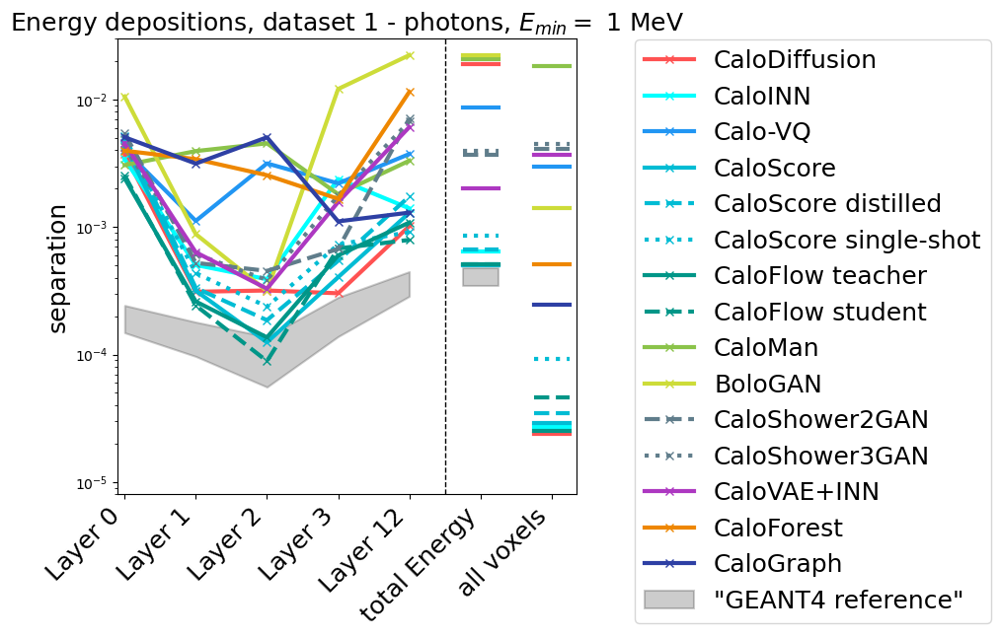

In [14]:
# energy depositions

with open(f"ds1-photons_{MIN_ENERGY}.pkl", 'rb') as handle:
    HLF_photons, ds1_photons_results_dict = pickle.load(handle)
    
with open(f"ds1-photons_reference_{MIN_ENERGY}.pkl", 'rb') as handle:
    ds1_photons_reference_dict = pickle.load(handle)

plt.figure(figsize=(6,6), facecolor='white')
x_scan = np.arange(7)

for run_id, entry in enumerate(ds1_photons_results_dict['E_layer_dict']):
    if entry in []: #27
        continue
    plt.plot(x_scan[:5], ds1_photons_results_dict['E_layer_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])
    plt.plot([x_scan[5]-0.25, x_scan[5]+0.25], np.repeat([ds1_photons_results_dict['Etot_Einc_dist'][entry]], 2), marker=None, label="_please_dont", linewidth=3., **kwargs_dict[entry])
    plt.plot([x_scan[6]-0.25, x_scan[6]+0.25], np.repeat([ds1_photons_results_dict['cell_dist'][entry]], 2), marker=None, label="_please_dont", linewidth=3., **kwargs_dict[entry])
    #plt.errorbar(x_scan[-1]-(0.8-0.1*run_id), np.mean(E_layer_dict[entry]), marker='x', yerr=np.std(E_layer_dict[entry]), linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds1_photons_reference_dict, 'E_layer_dict')
plt.fill_between(x_scan[:5], geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
geant_min, geant_max = get_min_max_from_dict(ds1_photons_reference_dict, 'Etot_Einc_dist')
plt.fill_between([x_scan[5]-0.25, x_scan[5]+0.25], np.repeat([geant_min], 2), np.repeat([geant_max], 2), label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])
geant_min, geant_max = get_min_max_from_dict(ds1_photons_reference_dict, 'cell_dist')
plt.fill_between([x_scan[6]-0.25, x_scan[6]+0.25], np.repeat([geant_min], 2), np.repeat([geant_max], 2), label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])


#for i in range(10):
#    plt.plot(x_scan[:5], ds1_photons_reference_dict['E_layer_dict'][i], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
#    plt.plot([x_scan[5]-0.25, x_scan[5]+0.25], np.repeat([ds1_photons_reference_dict['Etot_Einc_dist'][i]], 2), marker=None, label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])
#    plt.plot([x_scan[6]-0.25, x_scan[6]+0.25], np.repeat([ds1_photons_reference_dict['cell_dist'][i]], 2), marker=None, label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])
    
    
plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.35])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.ylim(8e-6, 3e-2)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels(['Layer 0', 'Layer 1', 'Layer 2', 'Layer 3', 'Layer 12', 'total Energy', 'all voxels'], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.1, 1.025), fontsize=FS)
plt.title(f"Energy depositions, dataset 1 - photons, $E_{{min}}=$ {ds1_photons_results_dict['MIN_ENERGY']} MeV", fontsize=FS)
plt.axvline(x = 4.5, color = 'k', linestyle='dashed', linewidth=1)
plt.savefig(f'results_fig/sep/ds1-photons_depositions_{MIN_ENERGY}.pdf', dpi=300, bbox_inches='tight')
plt.show()


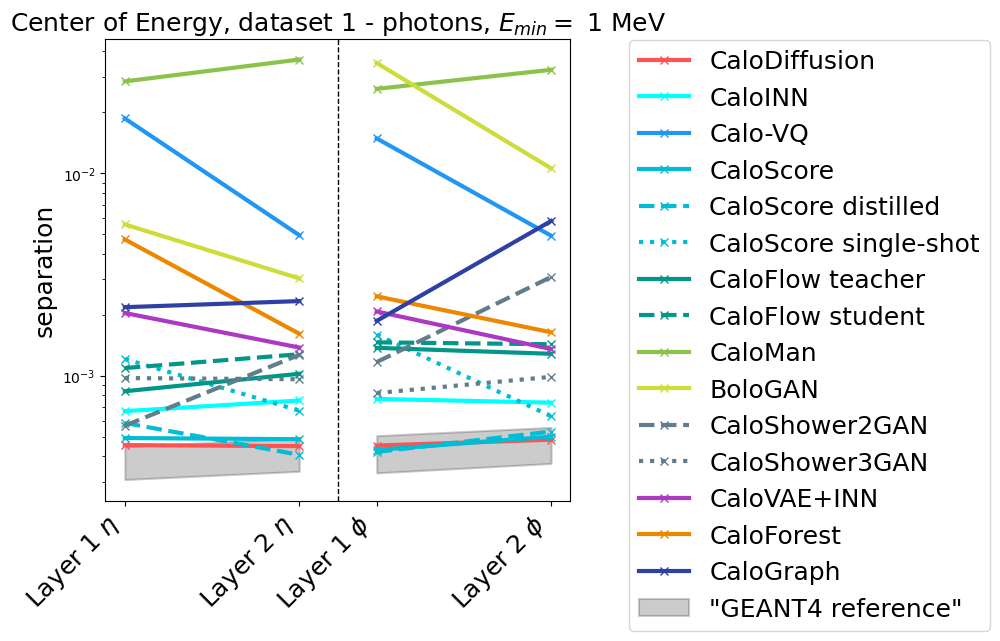

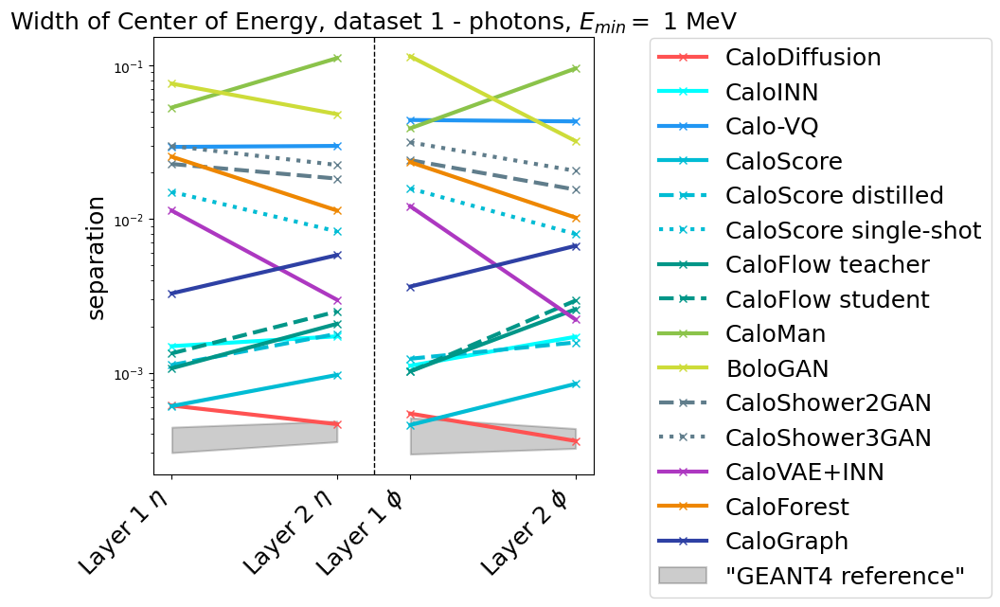

In [15]:
# EC and its width

with open(f"ds1-photons_{MIN_ENERGY}.pkl", 'rb') as handle:
    HLF_photons, ds1_photons_results_dict = pickle.load(handle)
    
with open(f"ds1-photons_reference_{MIN_ENERGY}.pkl", 'rb') as handle:
    ds1_photons_reference_dict = pickle.load(handle)

plt.figure(figsize=(6,6), facecolor='white')
x_scan = np.array([0., 0.9, 1.3, 2.2])

for run_id, entry in enumerate(ds1_photons_results_dict['EC_eta_dict']):
    if entry in []: #27
        continue
    plt.plot(x_scan[:2], ds1_photons_results_dict['EC_eta_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])
    plt.plot(x_scan[2:], ds1_photons_results_dict['EC_phi_dict'][entry], marker='x', label="_please_dont", linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds1_photons_reference_dict, 'EC_eta_dict')
plt.fill_between(x_scan[:2], geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
geant_min, geant_max = get_min_max_from_dict(ds1_photons_reference_dict, 'EC_phi_dict')
plt.fill_between(x_scan[2:], geant_min, geant_max, label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])    

#plt.plot(x_scan[:2], ds1_photons_reference_dict['EC_eta_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
#plt.plot(x_scan[2:], ds1_photons_reference_dict['EC_phi_dict'], marker='x', label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels([r'Layer 1 $\eta$', r'Layer 2 $\eta$', r'Layer 1 $\phi$', r'Layer 2 $\phi$'], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.1, 1.025), fontsize=FS)
plt.title(f"Center of Energy, dataset 1 - photons, $E_{{min}}=$ {ds1_photons_results_dict['MIN_ENERGY']} MeV", fontsize=FS)
plt.axvline(x = 1.1, color = 'k', linestyle='dashed', linewidth=1)
plt.savefig(f'results_fig/sep/ds1-photons_CE_{MIN_ENERGY}.pdf', dpi=300, bbox_inches='tight')
plt.show()
          
plt.figure(figsize=(6,6), facecolor='white')
x_scan = np.array([0., 0.9, 1.3, 2.2])

for run_id, entry in enumerate(ds1_photons_results_dict['EC_eta_width_dict']):
    if entry in []: #27
        continue
    plt.plot(x_scan[:2], ds1_photons_results_dict['EC_eta_width_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])
    plt.plot(x_scan[2:], ds1_photons_results_dict['EC_phi_width_dict'][entry], marker='x', label="_please_dont", linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds1_photons_reference_dict, 'EC_eta_width_dict')
plt.fill_between(x_scan[:2], geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
geant_min, geant_max = get_min_max_from_dict(ds1_photons_reference_dict, 'EC_phi_width_dict')
plt.fill_between(x_scan[2:], geant_min, geant_max, label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])

#plt.plot(x_scan[:2], ds1_photons_reference_dict['EC_eta_width_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
#plt.plot(x_scan[2:], ds1_photons_reference_dict['EC_phi_width_dict'], marker='x', label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels([r'Layer 1 $\eta$', r'Layer 2 $\eta$', r'Layer 1 $\phi$', r'Layer 2 $\phi$'], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.1, 1.025), fontsize=FS)
plt.title(f"Width of Center of Energy, dataset 1 - photons, $E_{{min}}=$ {ds1_photons_results_dict['MIN_ENERGY']} MeV", fontsize=FS)
plt.axvline(x = 1.1, color = 'k', linestyle='dashed', linewidth=1)
plt.savefig(f'results_fig/sep/ds1-photons_width_CE_{MIN_ENERGY}.pdf', dpi=300, bbox_inches='tight')
plt.show()
          


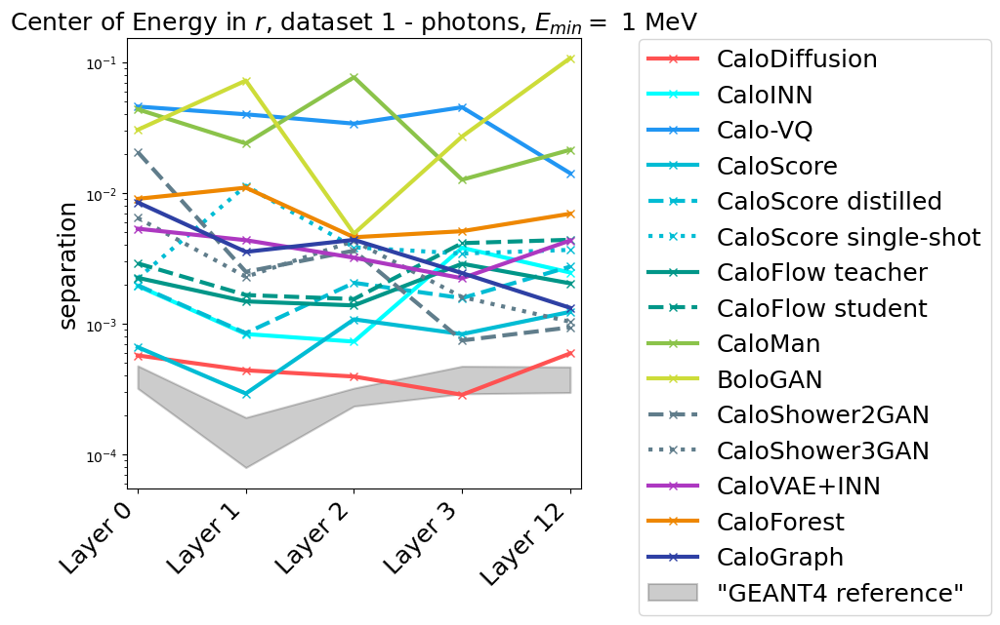

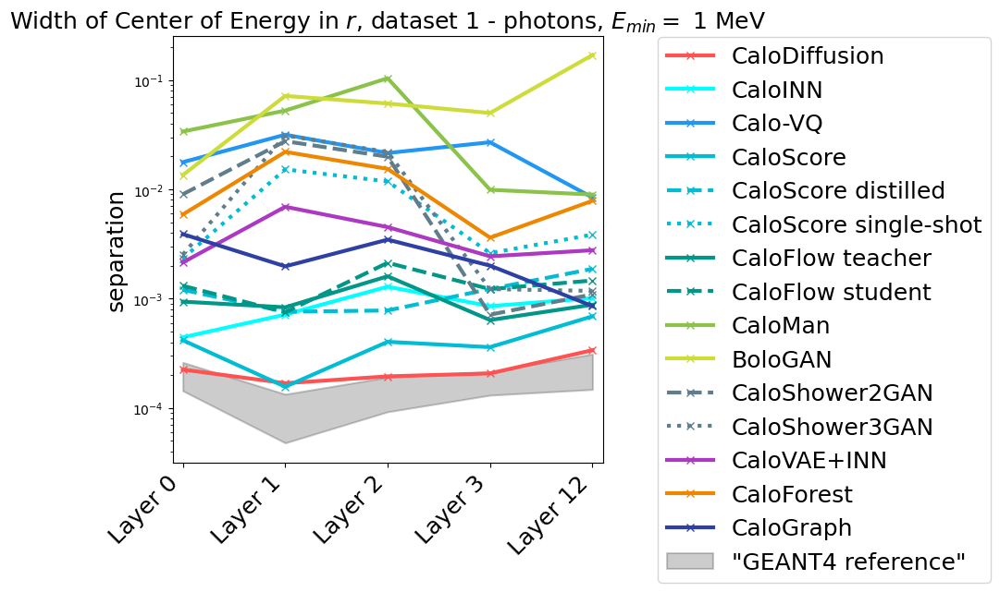

In [16]:
# EC and its width in r

with open(f"ds1-photons_{MIN_ENERGY}.pkl", 'rb') as handle:
    HLF_photons, ds1_photons_results_dict = pickle.load(handle)

with open(f"ds1-photons_reference_{MIN_ENERGY}.pkl", 'rb') as handle:
    ds1_photons_reference_dict = pickle.load(handle)
    
plt.figure(figsize=(6,6), facecolor='white')
x_scan = np.arange(5)

for run_id, entry in enumerate(ds1_photons_results_dict['EC_r_dict']):
    if entry in []: #27
        continue
    plt.plot(x_scan, ds1_photons_results_dict['EC_r_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds1_photons_reference_dict, 'EC_r_dict')
plt.fill_between(x_scan, geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
    
#plt.plot(x_scan, ds1_photons_reference_dict['EC_r_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels(['Layer 0', 'Layer 1', 'Layer 2', 'Layer 3', 'Layer 12'], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.1, 1.025), fontsize=FS)
plt.title(f"Center of Energy in $r$, dataset 1 - photons, $E_{{min}}=$ {ds1_photons_results_dict['MIN_ENERGY']} MeV", fontsize=FS)
plt.savefig(f'results_fig/sep/ds1-photons_CE_r_{MIN_ENERGY}.pdf', dpi=300, bbox_inches='tight')
plt.show()
          
plt.figure(figsize=(6,6), facecolor='white')
x_scan = np.arange(5)

for run_id, entry in enumerate(ds1_photons_results_dict['EC_r_width_dict']):
    if entry in []: #27
        continue
    plt.plot(x_scan, ds1_photons_results_dict['EC_r_width_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])
        
geant_min, geant_max = get_min_max_from_dict(ds1_photons_reference_dict, 'EC_r_width_dict')
plt.fill_between(x_scan, geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

#plt.plot(x_scan, ds1_photons_reference_dict['EC_r_width_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels(['Layer 0', 'Layer 1', 'Layer 2', 'Layer 3', 'Layer 12'], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.1, 1.025), fontsize=FS)
plt.title(f"Width of Center of Energy in $r$, dataset 1 - photons, $E_{{min}}=$ {ds1_photons_results_dict['MIN_ENERGY']} MeV", fontsize=FS)
plt.savefig(f'results_fig/sep/ds1-photons_width_CE_r_{MIN_ENERGY}.pdf', dpi=300, bbox_inches='tight')
plt.show()
          


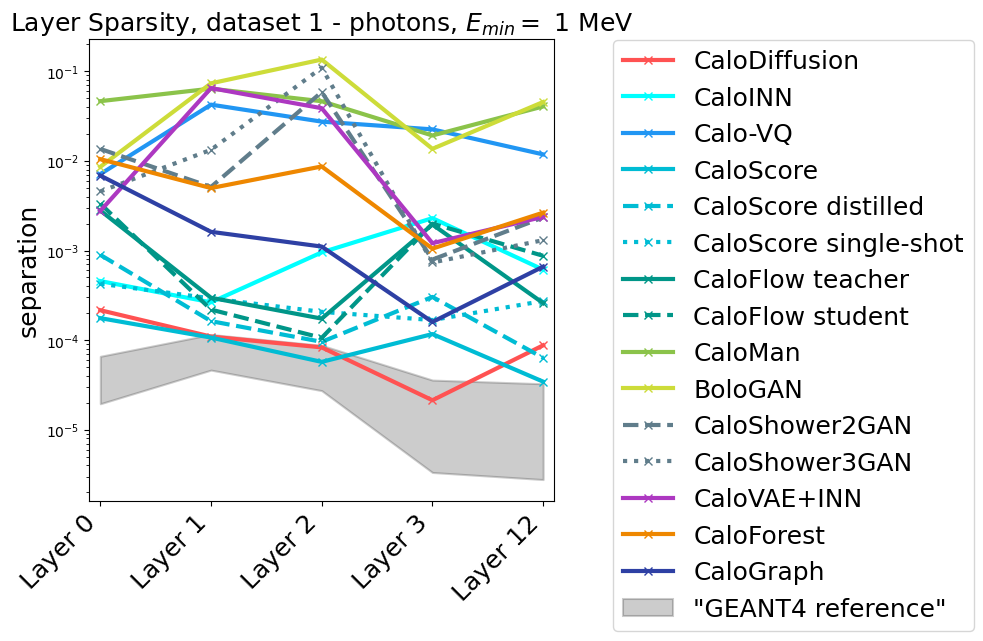

In [17]:
# layer sparsities

with open(f"ds1-photons_{MIN_ENERGY}.pkl", 'rb') as handle:
    HLF_photons, ds1_photons_results_dict = pickle.load(handle)
    
with open(f"ds1-photons_reference_{MIN_ENERGY}.pkl", 'rb') as handle:
    ds1_photons_reference_dict = pickle.load(handle)

plt.figure(figsize=(6,6), facecolor='white')
x_scan = np.arange(5)

for run_id, entry in enumerate(ds1_photons_results_dict['Sparsity_layer_dict']):
    if entry in []: #27
        continue
    plt.plot(x_scan, ds1_photons_results_dict['Sparsity_layer_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds1_photons_reference_dict, 'Sparsity_layer_dict')
plt.fill_between(x_scan, geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

#plt.plot(x_scan, ds1_photons_reference_dict['Sparsity_layer_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels(['Layer 0', 'Layer 1', 'Layer 2', 'Layer 3', 'Layer 12'], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.1, 1.025), fontsize=FS)
plt.title(f"Layer Sparsity, dataset 1 - photons, $E_{{min}}=$ {ds1_photons_results_dict['MIN_ENERGY']} MeV", fontsize=FS)
plt.savefig(f'results_fig/sep/ds1-photons_sparsity_{MIN_ENERGY}.pdf', dpi=300, bbox_inches='tight')
plt.show()


### LLF - dataset 1 - photons

In [10]:
MIN_ENERGY = 1

np.random.seed(2104)

idx_rnd = np.random.choice(np.arange(121000), size=121000, replace=False)
idx_train, idx_test, idx_val = idx_rnd[:80000], idx_rnd[80000:100000], idx_rnd[100000:]

train_data = np.array([])
test_data = np.array([])
val_data = np.array([])


E_inc, showers = extract_info('../scratch_CaloChallenge/data/official/dataset_1_photons_2.hdf5')
showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
truth_data = np.concatenate([np.log10(E_inc), showers / E_inc, -1*np.ones_like(E_inc)], axis=1)

conversion_to_submission_id = {}

for iter_id, submission_id in enumerate(ds1_photons_dict):
    print(f"working on {ds1_photons_dict[submission_id]} with submission id {submission_id} and classifier label {iter_id}")
    E_inc, showers = extract_info(ds1_photons_dict[submission_id])
    showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
    data = np.concatenate([np.log10(E_inc), showers / E_inc, iter_id*np.ones_like(E_inc)], axis=1)            
    train_data = np.vstack([*train_data, *data[idx_train]])
    test_data = np.vstack([*test_data, *data[idx_test]])
    val_data = np.vstack([*val_data, *data[idx_val]])
    conversion_to_submission_id[iter_id] = submission_id

np.random.shuffle(train_data)
np.random.shuffle(test_data)
np.random.shuffle(val_data)

print("done")

working on ../scratch_CaloChallenge/data/Amram/ds1-photons_1.hdf5 with submission id 1 and classifier label 0
working on ../scratch_CaloChallenge/data/Favaro/ds1-photons_4.hdf5 with submission id 4 and classifier label 1
working on ../scratch_CaloChallenge/data/Liu/ds1-photons_7.hdf5 with submission id 7 and classifier label 2
working on ../scratch_CaloChallenge/data/Mikuni/ds1-photons_8.hdf5 with submission id 8 and classifier label 3
working on ../scratch_CaloChallenge/data/Mikuni/ds1-photons_9.hdf5 with submission id 9 and classifier label 4
working on ../scratch_CaloChallenge/data/Mikuni/ds1-photons_10.hdf5 with submission id 10 and classifier label 5
working on ../scratch_CaloChallenge/data/Pang/ds1-photons_11.hdf5 with submission id 11 and classifier label 6
working on ../scratch_CaloChallenge/data/Pang/ds1-photons_12.hdf5 with submission id 12 and classifier label 7
working on ../scratch_CaloChallenge/data/Reyes/ds1-photons_16.hdf5 with submission id 16 and classifier label 8
wo

In [11]:
batch_size = 2000

train_dataset = TensorDataset(torch.tensor(train_data).to(device))
test_dataset = TensorDataset(torch.tensor(test_data).to(device))
val_dataset = TensorDataset(torch.tensor(val_data).to(device))
truth_dataset = TensorDataset(torch.tensor(truth_data).to(device))

train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
truth_dataloader = DataLoader(truth_dataset, batch_size=batch_size, shuffle=False)

model architecture 
DNN(
  (inputlayer): Linear(in_features=369, out_features=2048, bias=True)
  (outputlayer): Linear(in_features=2048, out_features=15, bias=True)
  (layers): Sequential(
    (0): Linear(in_features=369, out_features=2048, bias=True)
    (1): LeakyReLU(negative_slope=0.01)
    (2): Dropout(p=0.0, inplace=False)
    (3): Linear(in_features=2048, out_features=2048, bias=True)
    (4): LeakyReLU(negative_slope=0.01)
    (5): Dropout(p=0.0, inplace=False)
    (6): Linear(in_features=2048, out_features=2048, bias=True)
    (7): LeakyReLU(negative_slope=0.01)
    (8): Dropout(p=0.0, inplace=False)
    (9): Linear(in_features=2048, out_features=15, bias=True)
  )
)
Model has 9181199 trainable parameters
Evaluation loss 2.7081345049444834, accuracy 0.06666666666666667
Epoch 1 / 25 of run 1 / 10
step    0 / 600; loss 2.7080
step   40 / 600; loss 2.7083
step   80 / 600; loss 2.7082
step  120 / 600; loss 2.7058
step  160 / 600; loss 2.6716
step  200 / 600; loss 2.6026
step  240 

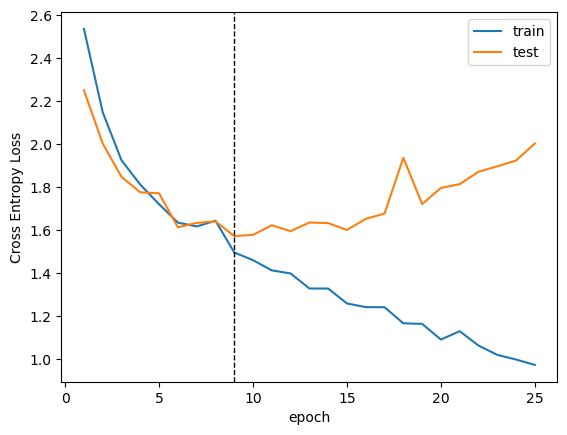

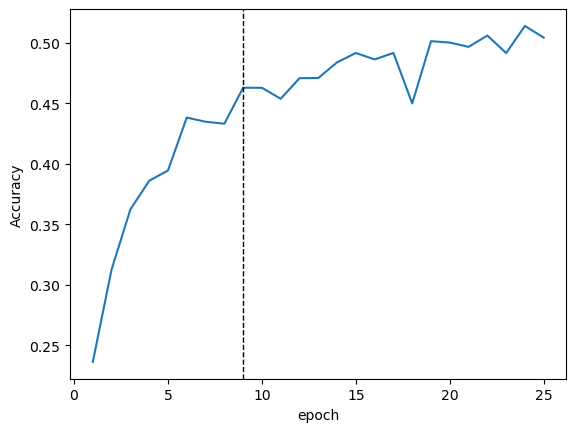

Model multiclass_weights_1-photon_ensemble_min1_0.pt loaded
Evaluation loss 1.573239378809015, accuracy 0.46285
preds shape (300000, 16)
preds shape (121000, 16)
Accuracy of model 0, which is CaloDiffusion is 0.15695.
Accuracy of model 1, which is CaloINN is 0.19825.
Accuracy of model 2, which is Calo-VQ is 0.974.
Accuracy of model 3, which is CaloScore is 0.1408.
Accuracy of model 4, which is CaloScore distilled is 0.136.
Accuracy of model 5, which is CaloScore single-shot is 0.33555.
Accuracy of model 6, which is CaloFlow teacher is 0.1779.
Accuracy of model 7, which is CaloFlow student is 0.1818.
Accuracy of model 8, which is CaloMan is 0.99455.
Accuracy of model 9, which is BoloGAN is 0.75815.
Accuracy of model 10, which is CaloShower2GAN is 0.7249.
Accuracy of model 11, which is CaloShower3GAN is 0.51335.
Accuracy of model 12, which is CaloVAE+INN is 0.7115.
Accuracy of model 13, which is CaloForest is 0.55755.
Accuracy of model 14, which is CaloGraph is 0.3815.
class 0 has maximu

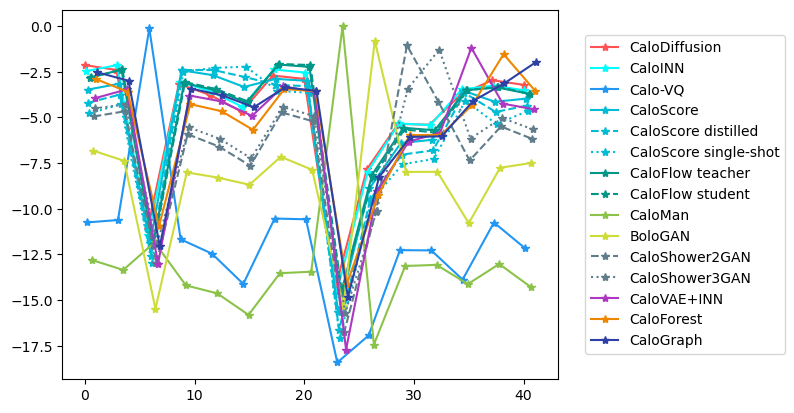

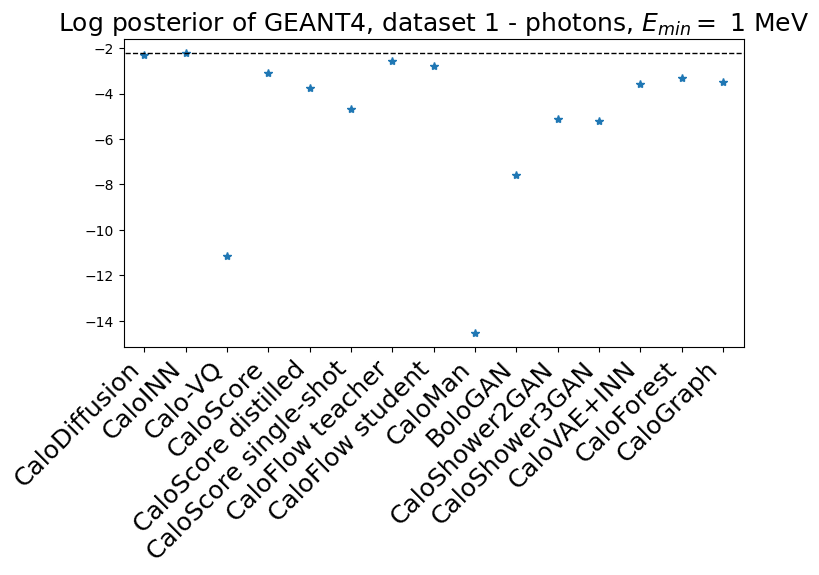

CaloDiffusion            log posterior:    -2.2807,    place:  2
CaloINN                  log posterior:    -2.2118,    place:  1
Calo-VQ                  log posterior:   -11.1545,    place: 14
CaloScore                log posterior:    -3.0910,    place:  5
CaloScore distilled      log posterior:    -3.7504,    place:  9
CaloScore single-shot    log posterior:    -4.6680,    place: 10
CaloFlow teacher         log posterior:    -2.5623,    place:  3
CaloFlow student         log posterior:    -2.7904,    place:  4
CaloMan                  log posterior:   -14.5408,    place: 15
BoloGAN                  log posterior:    -7.5926,    place: 13
CaloShower2GAN           log posterior:    -5.1040,    place: 11
CaloShower3GAN           log posterior:    -5.1919,    place: 12
CaloVAE+INN              log posterior:    -3.5679,    place:  8
CaloForest               log posterior:    -3.3092,    place:  6
CaloGraph                log posterior:    -3.4797,    place:  7

  - - - -  

model archi

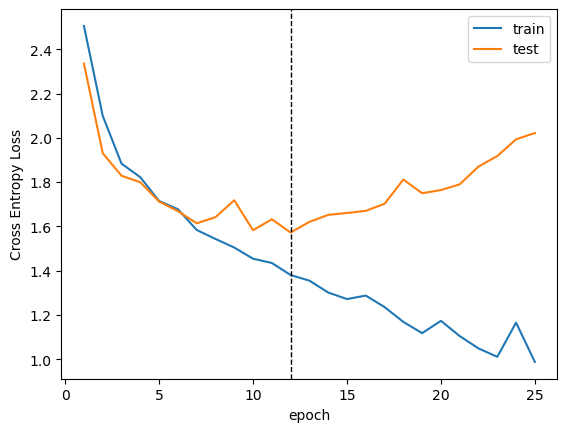

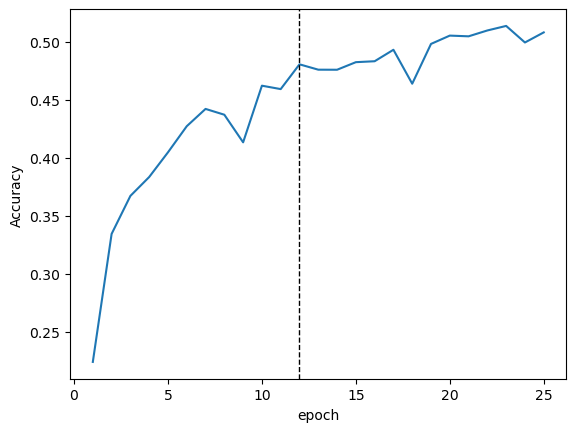

Model multiclass_weights_1-photon_ensemble_min1_1.pt loaded
Evaluation loss 1.5721996433306993, accuracy 0.48047666666666666
preds shape (300000, 16)
preds shape (121000, 16)
Accuracy of model 0, which is CaloDiffusion is 0.18735.
Accuracy of model 1, which is CaloINN is 0.2441.
Accuracy of model 2, which is Calo-VQ is 0.9862.
Accuracy of model 3, which is CaloScore is 0.1644.
Accuracy of model 4, which is CaloScore distilled is 0.15025.
Accuracy of model 5, which is CaloScore single-shot is 0.4406.
Accuracy of model 6, which is CaloFlow teacher is 0.10175.
Accuracy of model 7, which is CaloFlow student is 0.1847.
Accuracy of model 8, which is CaloMan is 0.9964.
Accuracy of model 9, which is BoloGAN is 0.7816.
Accuracy of model 10, which is CaloShower2GAN is 0.72095.
Accuracy of model 11, which is CaloShower3GAN is 0.543.
Accuracy of model 12, which is CaloVAE+INN is 0.7119.
Accuracy of model 13, which is CaloForest is 0.5042.
Accuracy of model 14, which is CaloGraph is 0.48975.
class 

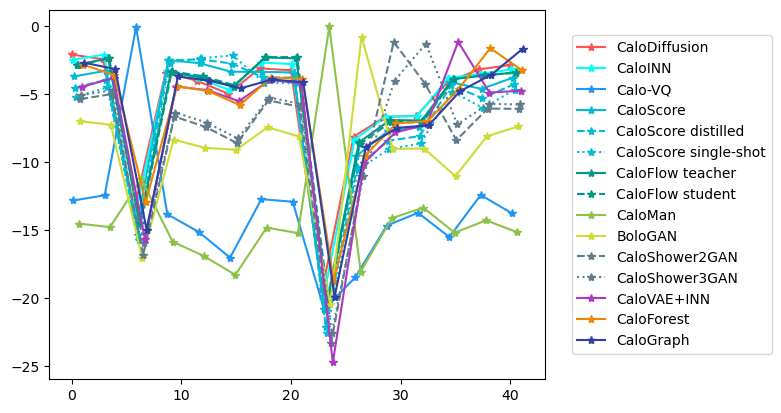

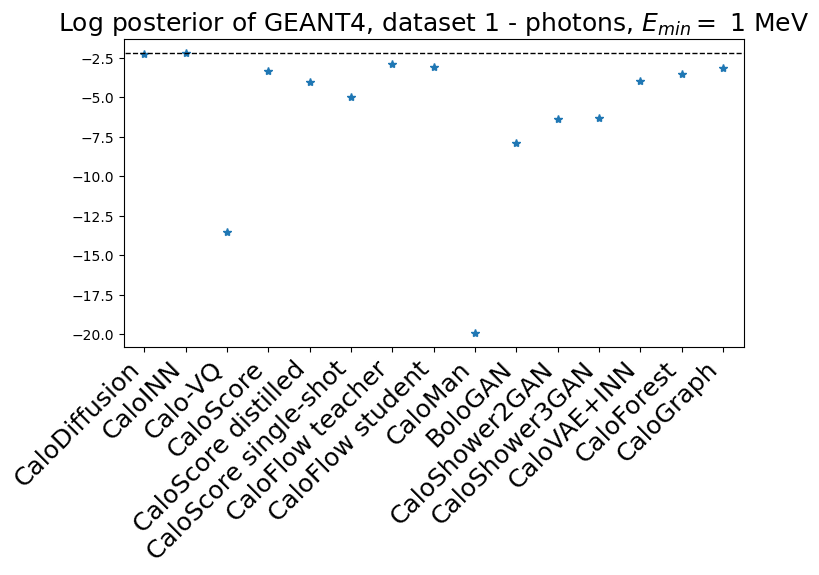

CaloDiffusion            log posterior:    -2.2521,    place:  2
CaloINN                  log posterior:    -2.2007,    place:  1
Calo-VQ                  log posterior:   -13.5454,    place: 14
CaloScore                log posterior:    -3.3342,    place:  6
CaloScore distilled      log posterior:    -4.0205,    place:  9
CaloScore single-shot    log posterior:    -4.9892,    place: 10
CaloFlow teacher         log posterior:    -2.9237,    place:  3
CaloFlow student         log posterior:    -3.0974,    place:  4
CaloMan                  log posterior:   -19.9256,    place: 15
BoloGAN                  log posterior:    -7.9046,    place: 13
CaloShower2GAN           log posterior:    -6.3648,    place: 12
CaloShower3GAN           log posterior:    -6.3271,    place: 11
CaloVAE+INN              log posterior:    -3.9570,    place:  8
CaloForest               log posterior:    -3.5422,    place:  7
CaloGraph                log posterior:    -3.1333,    place:  5

  - - - -  

model archi

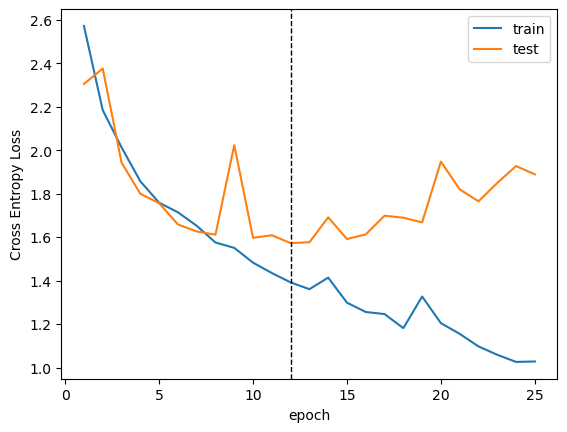

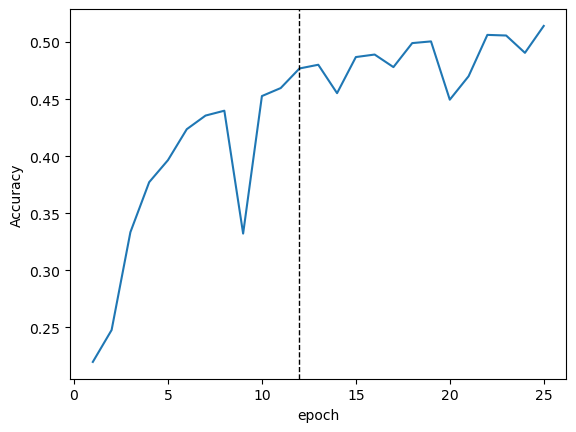

Model multiclass_weights_1-photon_ensemble_min1_2.pt loaded
Evaluation loss 1.5723676867845857, accuracy 0.4768833333333333
preds shape (300000, 16)
preds shape (121000, 16)
Accuracy of model 0, which is CaloDiffusion is 0.18785.
Accuracy of model 1, which is CaloINN is 0.16175.
Accuracy of model 2, which is Calo-VQ is 0.98485.
Accuracy of model 3, which is CaloScore is 0.08935.
Accuracy of model 4, which is CaloScore distilled is 0.15795.
Accuracy of model 5, which is CaloScore single-shot is 0.3903.
Accuracy of model 6, which is CaloFlow teacher is 0.19815.
Accuracy of model 7, which is CaloFlow student is 0.2527.
Accuracy of model 8, which is CaloMan is 0.9958.
Accuracy of model 9, which is BoloGAN is 0.77575.
Accuracy of model 10, which is CaloShower2GAN is 0.6865.
Accuracy of model 11, which is CaloShower3GAN is 0.6249.
Accuracy of model 12, which is CaloVAE+INN is 0.6295.
Accuracy of model 13, which is CaloForest is 0.4853.
Accuracy of model 14, which is CaloGraph is 0.5326.
clas

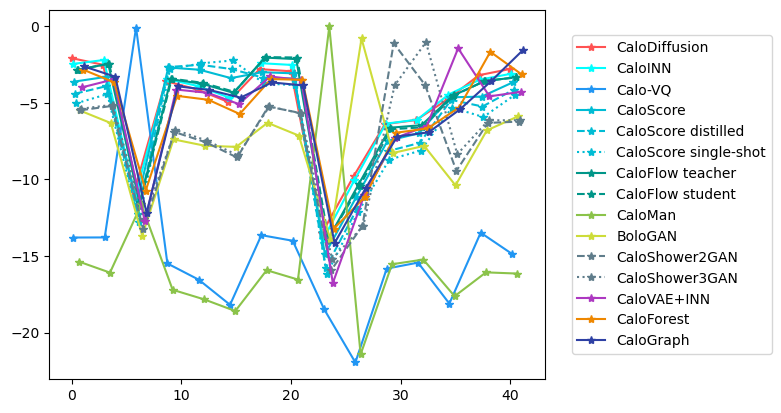

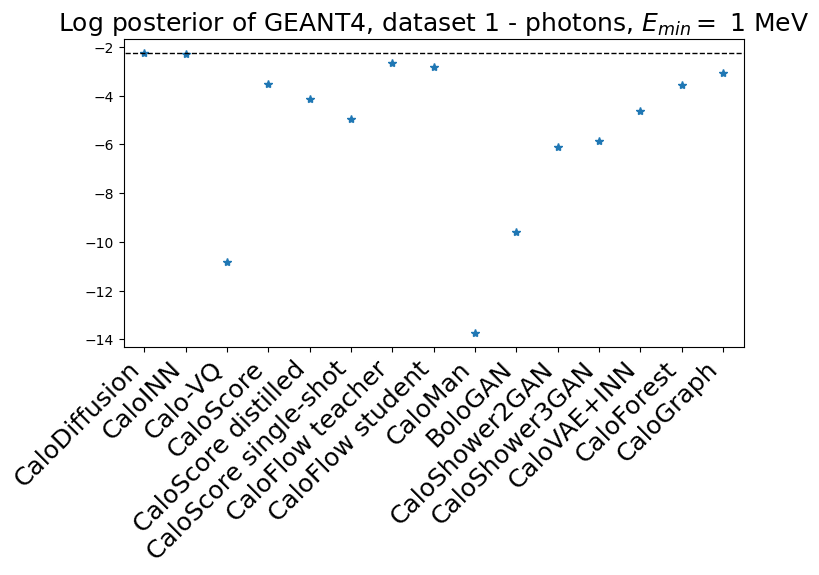

CaloDiffusion            log posterior:    -2.2451,    place:  1
CaloINN                  log posterior:    -2.2938,    place:  2
Calo-VQ                  log posterior:   -10.8037,    place: 14
CaloScore                log posterior:    -3.5223,    place:  6
CaloScore distilled      log posterior:    -4.1442,    place:  8
CaloScore single-shot    log posterior:    -4.9692,    place: 10
CaloFlow teacher         log posterior:    -2.6529,    place:  3
CaloFlow student         log posterior:    -2.8279,    place:  4
CaloMan                  log posterior:   -13.7328,    place: 15
BoloGAN                  log posterior:    -9.5788,    place: 13
CaloShower2GAN           log posterior:    -6.1138,    place: 12
CaloShower3GAN           log posterior:    -5.8696,    place: 11
CaloVAE+INN              log posterior:    -4.6092,    place:  9
CaloForest               log posterior:    -3.5451,    place:  7
CaloGraph                log posterior:    -3.0627,    place:  5

  - - - -  

model archi

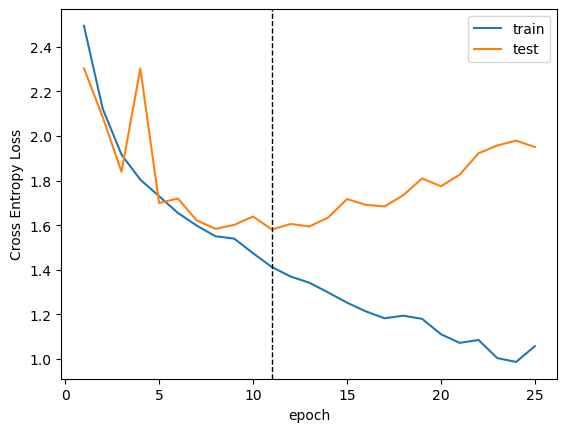

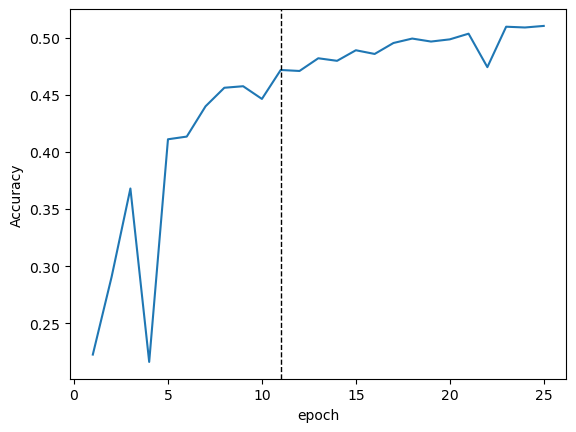

Model multiclass_weights_1-photon_ensemble_min1_3.pt loaded
Evaluation loss 1.5805570307164625, accuracy 0.47174
preds shape (300000, 16)
preds shape (121000, 16)
Accuracy of model 0, which is CaloDiffusion is 0.204.
Accuracy of model 1, which is CaloINN is 0.15465.
Accuracy of model 2, which is Calo-VQ is 0.9695.
Accuracy of model 3, which is CaloScore is 0.11255.
Accuracy of model 4, which is CaloScore distilled is 0.22825.
Accuracy of model 5, which is CaloScore single-shot is 0.37475.
Accuracy of model 6, which is CaloFlow teacher is 0.0814.
Accuracy of model 7, which is CaloFlow student is 0.3403.
Accuracy of model 8, which is CaloMan is 0.99605.
Accuracy of model 9, which is BoloGAN is 0.78675.
Accuracy of model 10, which is CaloShower2GAN is 0.4636.
Accuracy of model 11, which is CaloShower3GAN is 0.78005.
Accuracy of model 12, which is CaloVAE+INN is 0.6442.
Accuracy of model 13, which is CaloForest is 0.50605.
Accuracy of model 14, which is CaloGraph is 0.434.
class 0 has maxi

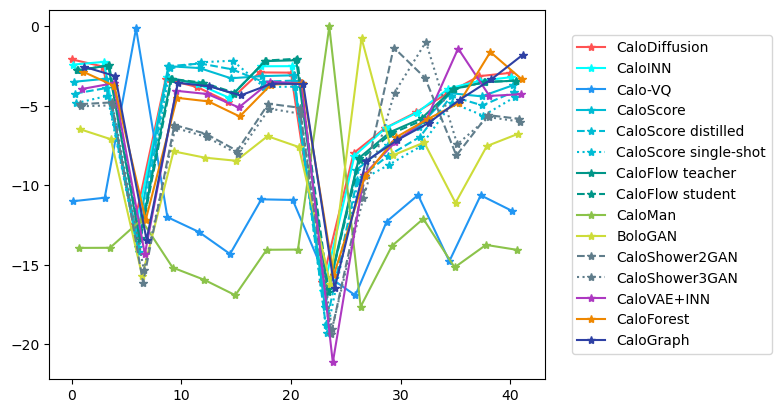

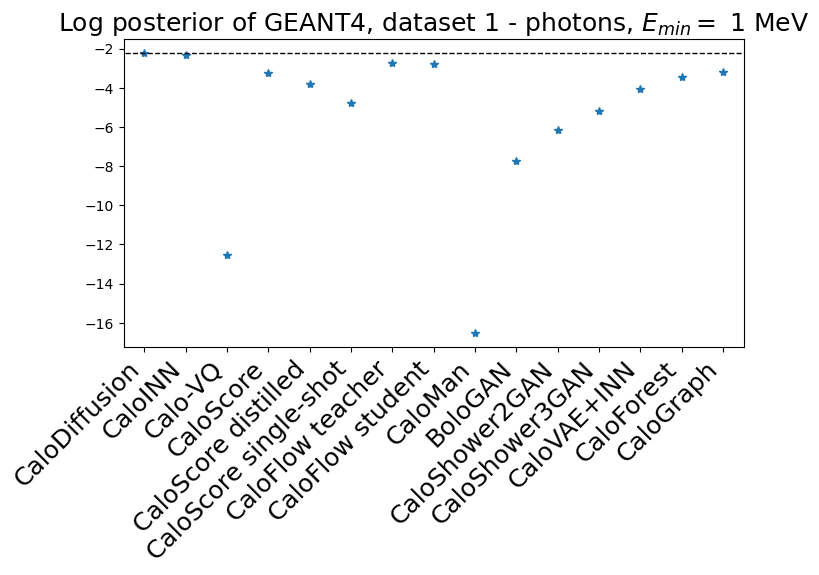

CaloDiffusion            log posterior:    -2.2263,    place:  1
CaloINN                  log posterior:    -2.3352,    place:  2
Calo-VQ                  log posterior:   -12.5259,    place: 14
CaloScore                log posterior:    -3.2690,    place:  6
CaloScore distilled      log posterior:    -3.8301,    place:  8
CaloScore single-shot    log posterior:    -4.7769,    place: 10
CaloFlow teacher         log posterior:    -2.7402,    place:  3
CaloFlow student         log posterior:    -2.7935,    place:  4
CaloMan                  log posterior:   -16.5198,    place: 15
BoloGAN                  log posterior:    -7.7370,    place: 13
CaloShower2GAN           log posterior:    -6.1460,    place: 12
CaloShower3GAN           log posterior:    -5.2017,    place: 11
CaloVAE+INN              log posterior:    -4.0455,    place:  9
CaloForest               log posterior:    -3.4796,    place:  7
CaloGraph                log posterior:    -3.1788,    place:  5

  - - - -  

model archi

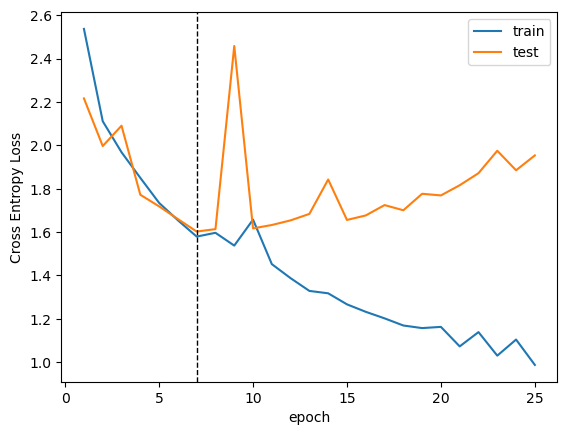

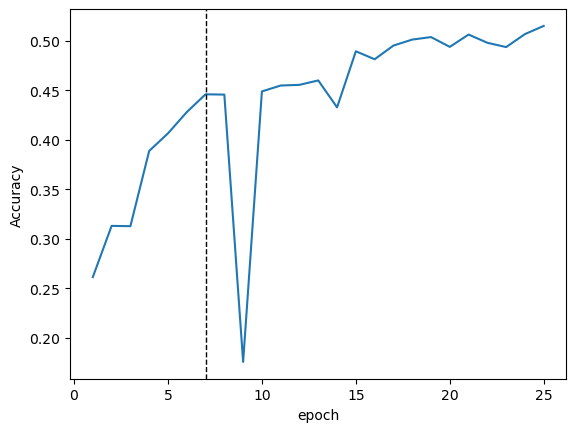

Model multiclass_weights_1-photon_ensemble_min1_4.pt loaded
Evaluation loss 1.6025136960548754, accuracy 0.4458933333333333
preds shape (300000, 16)
preds shape (121000, 16)
Accuracy of model 0, which is CaloDiffusion is 0.2014.
Accuracy of model 1, which is CaloINN is 0.10355.
Accuracy of model 2, which is Calo-VQ is 0.97765.
Accuracy of model 3, which is CaloScore is 0.07465.
Accuracy of model 4, which is CaloScore distilled is 0.1767.
Accuracy of model 5, which is CaloScore single-shot is 0.3434.
Accuracy of model 6, which is CaloFlow teacher is 0.04275.
Accuracy of model 7, which is CaloFlow student is 0.3686.
Accuracy of model 8, which is CaloMan is 0.9979.
Accuracy of model 9, which is BoloGAN is 0.7202.
Accuracy of model 10, which is CaloShower2GAN is 0.5697.
Accuracy of model 11, which is CaloShower3GAN is 0.66935.
Accuracy of model 12, which is CaloVAE+INN is 0.4564.
Accuracy of model 13, which is CaloForest is 0.52255.
Accuracy of model 14, which is CaloGraph is 0.4636.
class

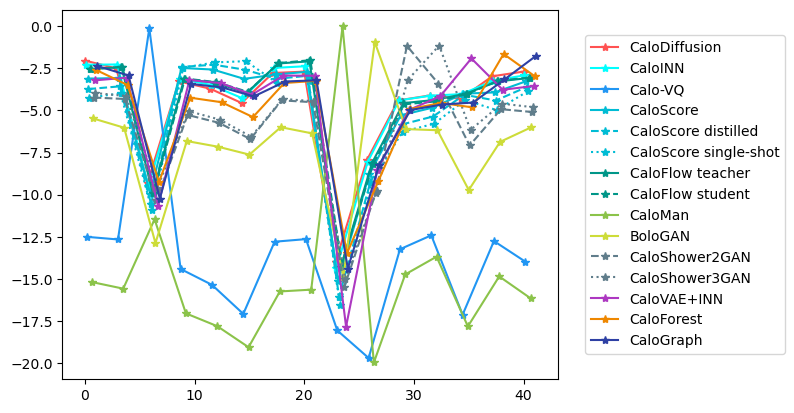

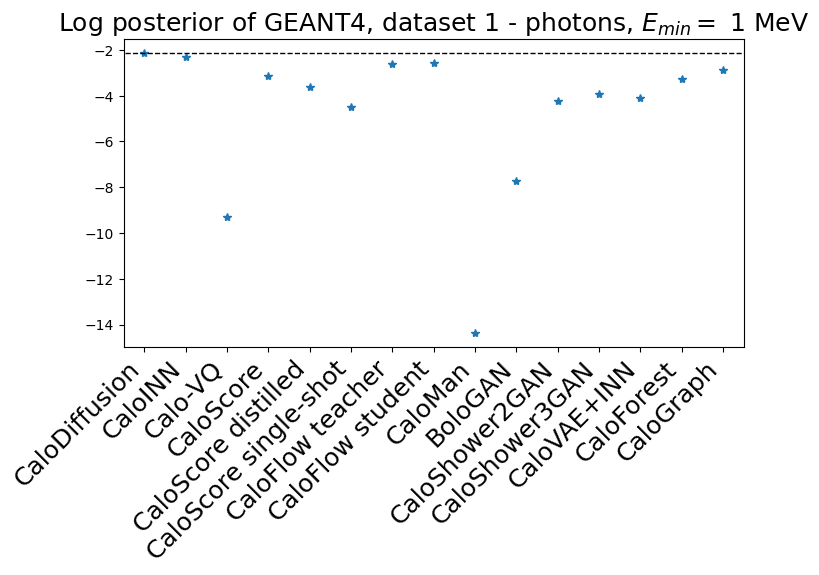

CaloDiffusion            log posterior:    -2.1332,    place:  1
CaloINN                  log posterior:    -2.3100,    place:  2
Calo-VQ                  log posterior:    -9.2959,    place: 14
CaloScore                log posterior:    -3.1536,    place:  6
CaloScore distilled      log posterior:    -3.6343,    place:  8
CaloScore single-shot    log posterior:    -4.4905,    place: 12
CaloFlow teacher         log posterior:    -2.6288,    place:  4
CaloFlow student         log posterior:    -2.5735,    place:  3
CaloMan                  log posterior:   -14.3684,    place: 15
BoloGAN                  log posterior:    -7.7374,    place: 13
CaloShower2GAN           log posterior:    -4.2145,    place: 11
CaloShower3GAN           log posterior:    -3.9488,    place:  9
CaloVAE+INN              log posterior:    -4.0983,    place: 10
CaloForest               log posterior:    -3.2674,    place:  7
CaloGraph                log posterior:    -2.8932,    place:  5

  - - - -  

model archi

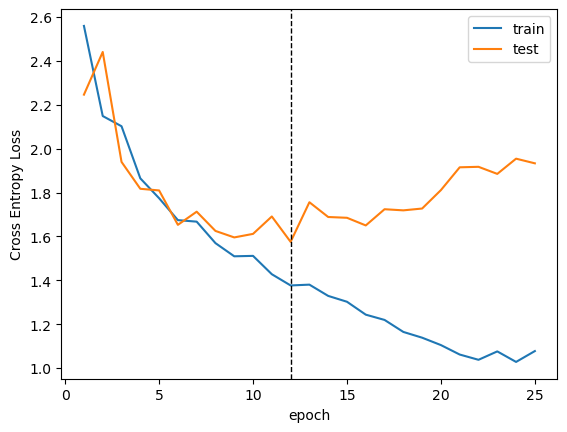

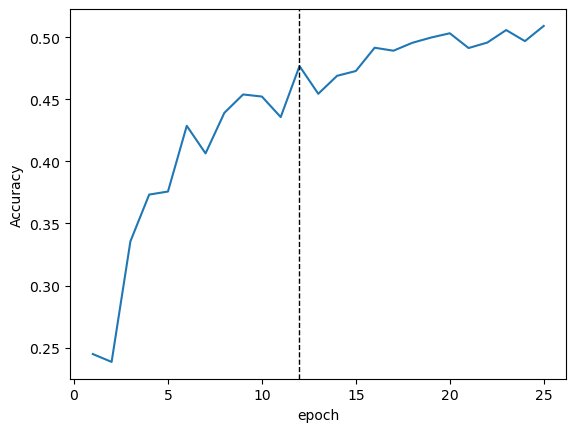

Model multiclass_weights_1-photon_ensemble_min1_5.pt loaded
Evaluation loss 1.5751450165020078, accuracy 0.47695333333333334
preds shape (300000, 16)
preds shape (121000, 16)
Accuracy of model 0, which is CaloDiffusion is 0.22185.
Accuracy of model 1, which is CaloINN is 0.2072.
Accuracy of model 2, which is Calo-VQ is 0.9836.
Accuracy of model 3, which is CaloScore is 0.154.
Accuracy of model 4, which is CaloScore distilled is 0.2065.
Accuracy of model 5, which is CaloScore single-shot is 0.4016.
Accuracy of model 6, which is CaloFlow teacher is 0.1104.
Accuracy of model 7, which is CaloFlow student is 0.1599.
Accuracy of model 8, which is CaloMan is 0.9941.
Accuracy of model 9, which is BoloGAN is 0.75575.
Accuracy of model 10, which is CaloShower2GAN is 0.59495.
Accuracy of model 11, which is CaloShower3GAN is 0.6633.
Accuracy of model 12, which is CaloVAE+INN is 0.6542.
Accuracy of model 13, which is CaloForest is 0.5058.
Accuracy of model 14, which is CaloGraph is 0.54115.
class 0

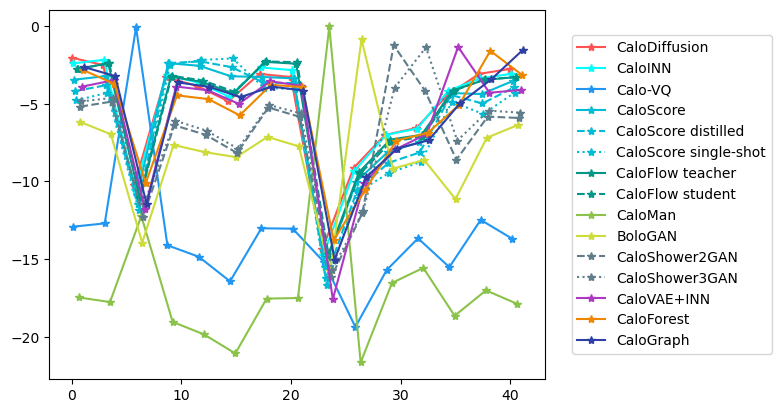

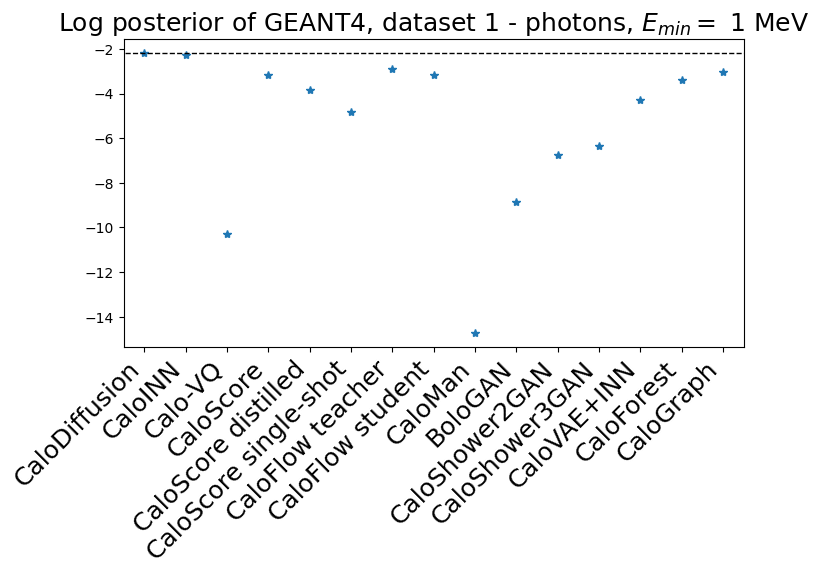

CaloDiffusion            log posterior:    -2.1820,    place:  1
CaloINN                  log posterior:    -2.2658,    place:  2
Calo-VQ                  log posterior:   -10.3040,    place: 14
CaloScore                log posterior:    -3.1779,    place:  6
CaloScore distilled      log posterior:    -3.8197,    place:  8
CaloScore single-shot    log posterior:    -4.8262,    place: 10
CaloFlow teacher         log posterior:    -2.9066,    place:  3
CaloFlow student         log posterior:    -3.1500,    place:  5
CaloMan                  log posterior:   -14.7228,    place: 15
BoloGAN                  log posterior:    -8.8530,    place: 13
CaloShower2GAN           log posterior:    -6.7544,    place: 12
CaloShower3GAN           log posterior:    -6.3500,    place: 11
CaloVAE+INN              log posterior:    -4.2709,    place:  9
CaloForest               log posterior:    -3.4037,    place:  7
CaloGraph                log posterior:    -3.0137,    place:  4

  - - - -  

model archi

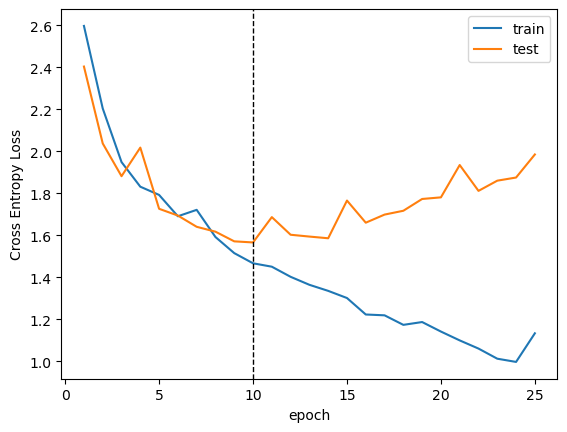

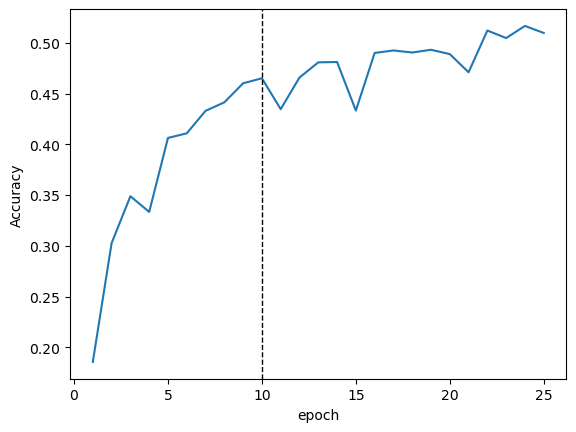

Model multiclass_weights_1-photon_ensemble_min1_6.pt loaded
Evaluation loss 1.5664909413841475, accuracy 0.46498666666666666
preds shape (300000, 16)
preds shape (121000, 16)
Accuracy of model 0, which is CaloDiffusion is 0.15215.
Accuracy of model 1, which is CaloINN is 0.1688.
Accuracy of model 2, which is Calo-VQ is 0.95955.
Accuracy of model 3, which is CaloScore is 0.16575.
Accuracy of model 4, which is CaloScore distilled is 0.05895.
Accuracy of model 5, which is CaloScore single-shot is 0.4954.
Accuracy of model 6, which is CaloFlow teacher is 0.14245.
Accuracy of model 7, which is CaloFlow student is 0.2595.
Accuracy of model 8, which is CaloMan is 0.99755.
Accuracy of model 9, which is BoloGAN is 0.7454.
Accuracy of model 10, which is CaloShower2GAN is 0.66535.
Accuracy of model 11, which is CaloShower3GAN is 0.62815.
Accuracy of model 12, which is CaloVAE+INN is 0.6081.
Accuracy of model 13, which is CaloForest is 0.45295.
Accuracy of model 14, which is CaloGraph is 0.47475.


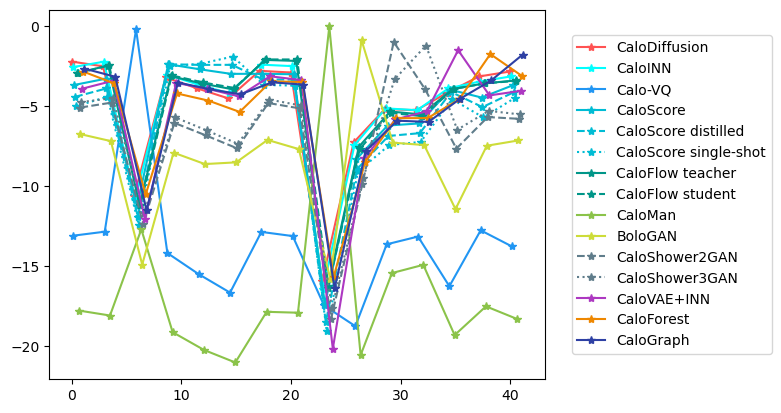

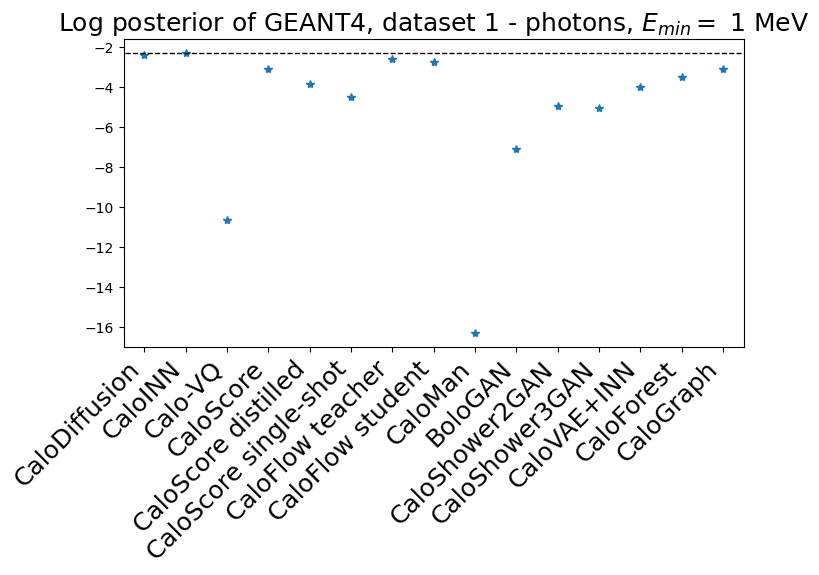

CaloDiffusion            log posterior:    -2.3716,    place:  2
CaloINN                  log posterior:    -2.2764,    place:  1
Calo-VQ                  log posterior:   -10.6092,    place: 14
CaloScore                log posterior:    -3.0761,    place:  5
CaloScore distilled      log posterior:    -3.8277,    place:  8
CaloScore single-shot    log posterior:    -4.4631,    place: 10
CaloFlow teacher         log posterior:    -2.5960,    place:  3
CaloFlow student         log posterior:    -2.7431,    place:  4
CaloMan                  log posterior:   -16.2752,    place: 15
BoloGAN                  log posterior:    -7.0668,    place: 13
CaloShower2GAN           log posterior:    -4.9072,    place: 11
CaloShower3GAN           log posterior:    -5.0257,    place: 12
CaloVAE+INN              log posterior:    -3.9815,    place:  9
CaloForest               log posterior:    -3.4780,    place:  7
CaloGraph                log posterior:    -3.0945,    place:  6

  - - - -  

model archi

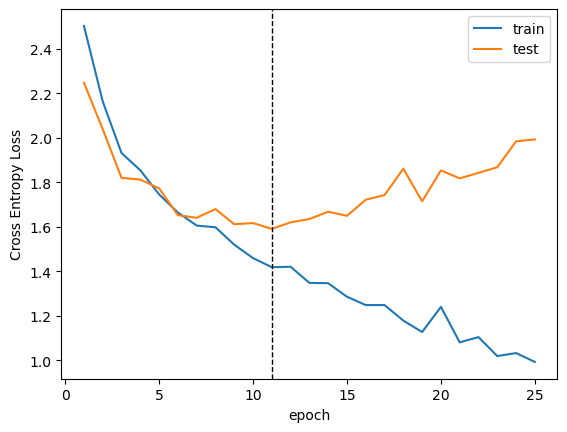

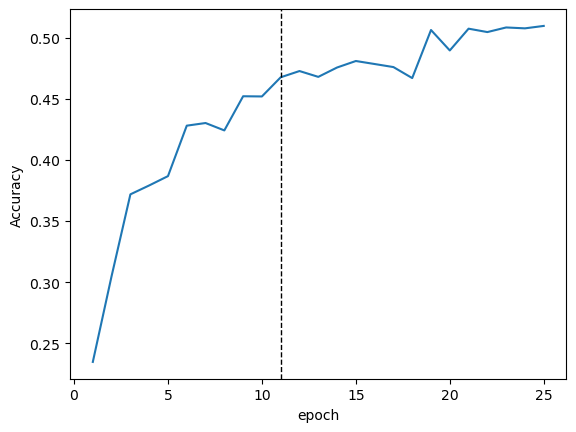

Model multiclass_weights_1-photon_ensemble_min1_7.pt loaded
Evaluation loss 1.5913123638001314, accuracy 0.4676133333333333
preds shape (300000, 16)
preds shape (121000, 16)
Accuracy of model 0, which is CaloDiffusion is 0.26775.
Accuracy of model 1, which is CaloINN is 0.264.
Accuracy of model 2, which is Calo-VQ is 0.98995.
Accuracy of model 3, which is CaloScore is 0.1418.
Accuracy of model 4, which is CaloScore distilled is 0.1709.
Accuracy of model 5, which is CaloScore single-shot is 0.4811.
Accuracy of model 6, which is CaloFlow teacher is 0.0549.
Accuracy of model 7, which is CaloFlow student is 0.08635.
Accuracy of model 8, which is CaloMan is 0.99275.
Accuracy of model 9, which is BoloGAN is 0.8002.
Accuracy of model 10, which is CaloShower2GAN is 0.562.
Accuracy of model 11, which is CaloShower3GAN is 0.63145.
Accuracy of model 12, which is CaloVAE+INN is 0.65715.
Accuracy of model 13, which is CaloForest is 0.49285.
Accuracy of model 14, which is CaloGraph is 0.42105.
class

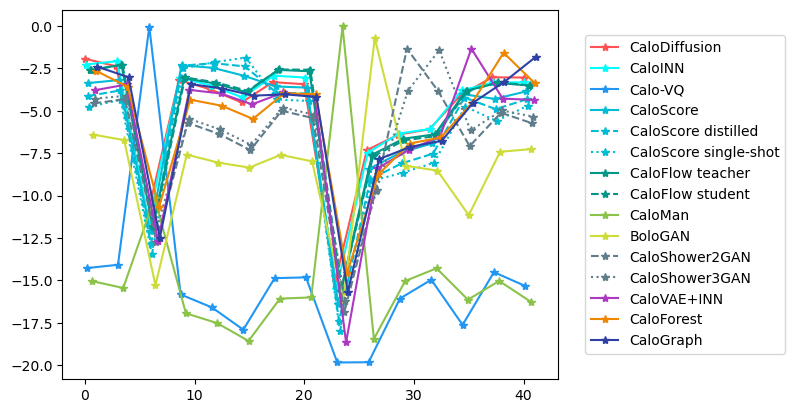

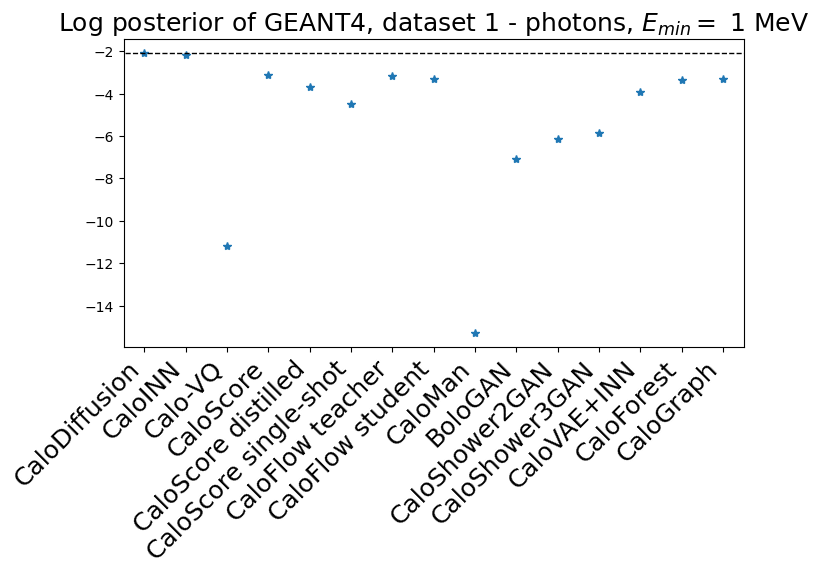

CaloDiffusion            log posterior:    -2.0815,    place:  1
CaloINN                  log posterior:    -2.1682,    place:  2
Calo-VQ                  log posterior:   -11.2000,    place: 14
CaloScore                log posterior:    -3.1111,    place:  3
CaloScore distilled      log posterior:    -3.7099,    place:  8
CaloScore single-shot    log posterior:    -4.5009,    place: 10
CaloFlow teacher         log posterior:    -3.1649,    place:  4
CaloFlow student         log posterior:    -3.3298,    place:  6
CaloMan                  log posterior:   -15.2883,    place: 15
BoloGAN                  log posterior:    -7.0975,    place: 13
CaloShower2GAN           log posterior:    -6.1365,    place: 12
CaloShower3GAN           log posterior:    -5.8672,    place: 11
CaloVAE+INN              log posterior:    -3.9324,    place:  9
CaloForest               log posterior:    -3.3625,    place:  7
CaloGraph                log posterior:    -3.2892,    place:  5

  - - - -  

model archi

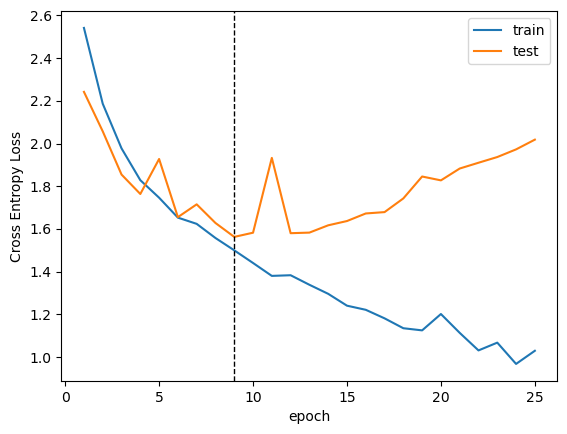

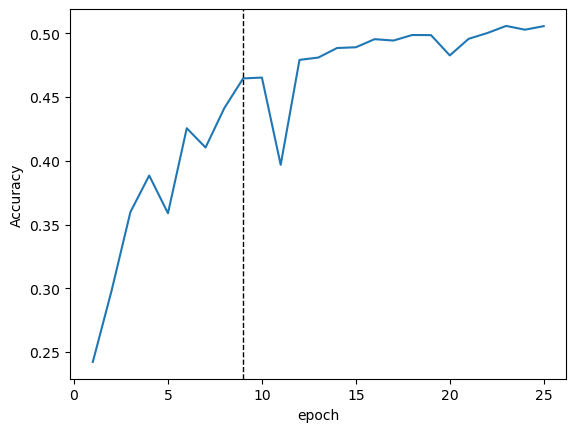

Model multiclass_weights_1-photon_ensemble_min1_8.pt loaded
Evaluation loss 1.562627769338416, accuracy 0.46462
preds shape (300000, 16)
preds shape (121000, 16)
Accuracy of model 0, which is CaloDiffusion is 0.161.
Accuracy of model 1, which is CaloINN is 0.21655.
Accuracy of model 2, which is Calo-VQ is 0.97365.
Accuracy of model 3, which is CaloScore is 0.14965.
Accuracy of model 4, which is CaloScore distilled is 0.1374.
Accuracy of model 5, which is CaloScore single-shot is 0.45925.
Accuracy of model 6, which is CaloFlow teacher is 0.12625.
Accuracy of model 7, which is CaloFlow student is 0.26425.
Accuracy of model 8, which is CaloMan is 0.9923.
Accuracy of model 9, which is BoloGAN is 0.74505.
Accuracy of model 10, which is CaloShower2GAN is 0.6538.
Accuracy of model 11, which is CaloShower3GAN is 0.5242.
Accuracy of model 12, which is CaloVAE+INN is 0.5929.
Accuracy of model 13, which is CaloForest is 0.53205.
Accuracy of model 14, which is CaloGraph is 0.441.
class 0 has maxim

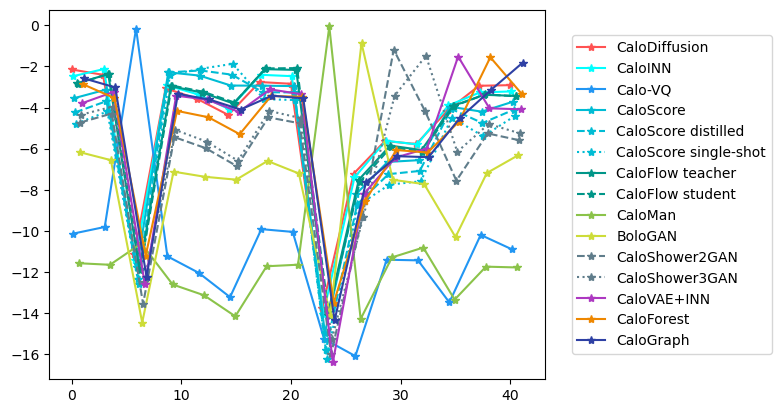

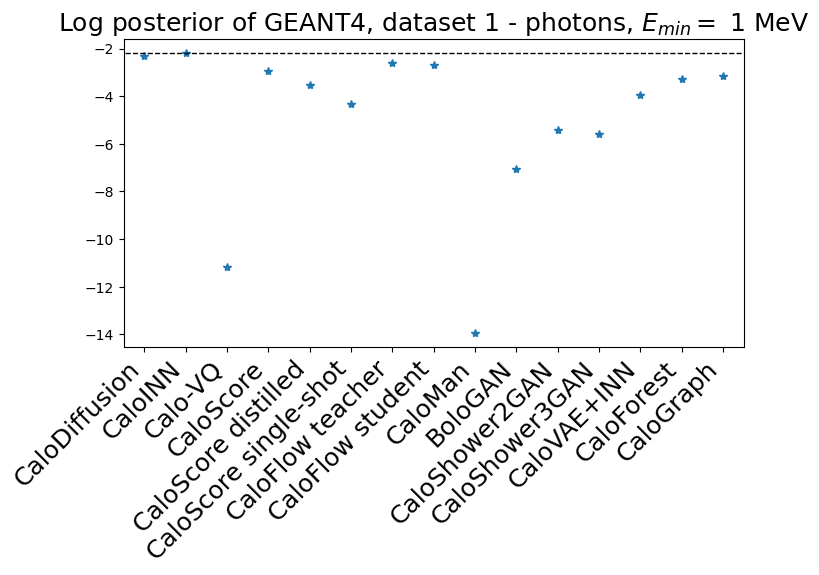

CaloDiffusion            log posterior:    -2.2919,    place:  2
CaloINN                  log posterior:    -2.1824,    place:  1
Calo-VQ                  log posterior:   -11.1697,    place: 14
CaloScore                log posterior:    -2.9606,    place:  5
CaloScore distilled      log posterior:    -3.5186,    place:  8
CaloScore single-shot    log posterior:    -4.3156,    place: 10
CaloFlow teacher         log posterior:    -2.5853,    place:  3
CaloFlow student         log posterior:    -2.7029,    place:  4
CaloMan                  log posterior:   -13.9460,    place: 15
BoloGAN                  log posterior:    -7.0458,    place: 13
CaloShower2GAN           log posterior:    -5.4003,    place: 11
CaloShower3GAN           log posterior:    -5.5811,    place: 12
CaloVAE+INN              log posterior:    -3.9594,    place:  9
CaloForest               log posterior:    -3.2748,    place:  7
CaloGraph                log posterior:    -3.1510,    place:  6

  - - - -  

model archi

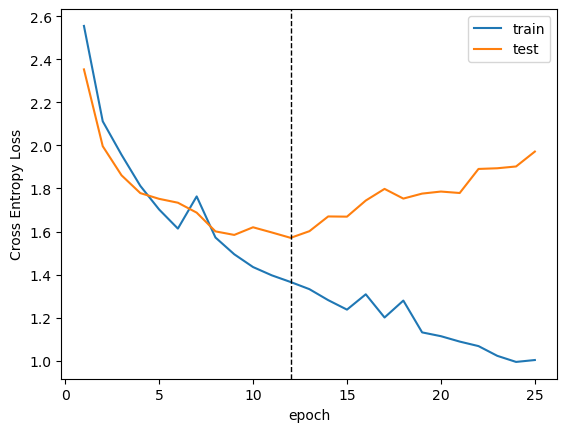

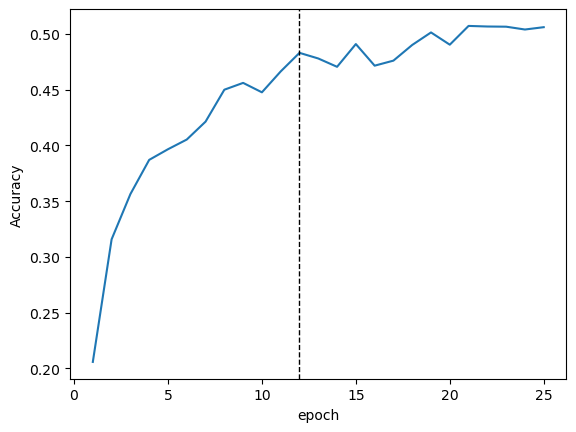

Model multiclass_weights_1-photon_ensemble_min1_9.pt loaded
Evaluation loss 1.5706298775742604, accuracy 0.48305
preds shape (300000, 16)
preds shape (121000, 16)
Accuracy of model 0, which is CaloDiffusion is 0.15695.
Accuracy of model 1, which is CaloINN is 0.18195.
Accuracy of model 2, which is Calo-VQ is 0.9821.
Accuracy of model 3, which is CaloScore is 0.19385.
Accuracy of model 4, which is CaloScore distilled is 0.12525.
Accuracy of model 5, which is CaloScore single-shot is 0.4307.
Accuracy of model 6, which is CaloFlow teacher is 0.15105.
Accuracy of model 7, which is CaloFlow student is 0.22555.
Accuracy of model 8, which is CaloMan is 0.9956.
Accuracy of model 9, which is BoloGAN is 0.80795.
Accuracy of model 10, which is CaloShower2GAN is 0.72675.
Accuracy of model 11, which is CaloShower3GAN is 0.5006.
Accuracy of model 12, which is CaloVAE+INN is 0.7074.
Accuracy of model 13, which is CaloForest is 0.51125.
Accuracy of model 14, which is CaloGraph is 0.5488.
class 0 has m

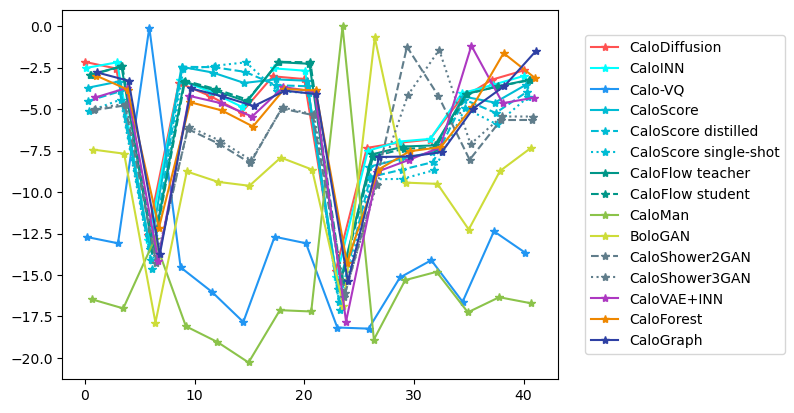

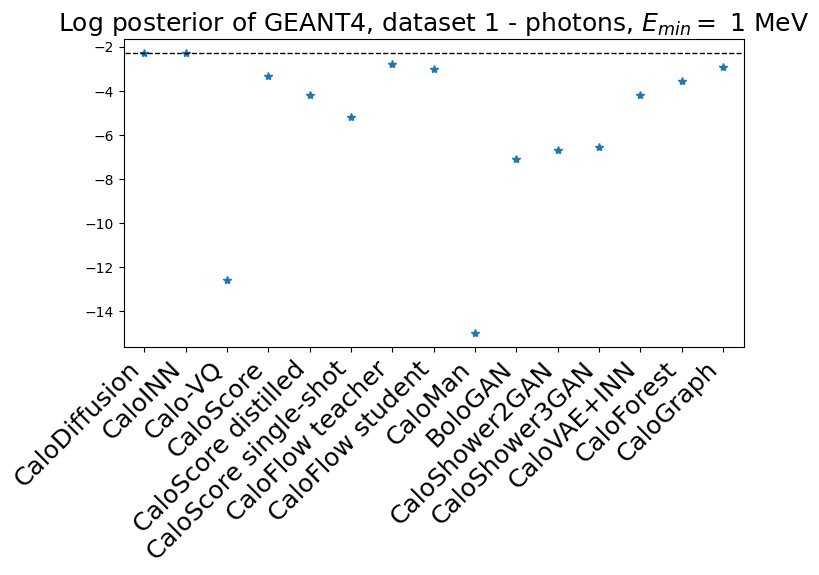

CaloDiffusion            log posterior:    -2.3088,    place:  2
CaloINN                  log posterior:    -2.2898,    place:  1
Calo-VQ                  log posterior:   -12.6129,    place: 14
CaloScore                log posterior:    -3.3216,    place:  6
CaloScore distilled      log posterior:    -4.1968,    place:  8
CaloScore single-shot    log posterior:    -5.2183,    place: 10
CaloFlow teacher         log posterior:    -2.8035,    place:  3
CaloFlow student         log posterior:    -3.0126,    place:  5
CaloMan                  log posterior:   -14.9973,    place: 15
BoloGAN                  log posterior:    -7.0935,    place: 13
CaloShower2GAN           log posterior:    -6.6917,    place: 12
CaloShower3GAN           log posterior:    -6.5389,    place: 11
CaloVAE+INN              log posterior:    -4.1980,    place:  9
CaloForest               log posterior:    -3.5833,    place:  7
CaloGraph                log posterior:    -2.9329,    place:  4

  - - - -  

done


In [12]:
num_epoch = 25
num_runs = 10
DS = '1-photon_ensemble_min1'

only_eval = False

accuracy = []
train_losses = []
eval_losses = []

preds_models = []
preds_truth = []

preds_by_model = []
log_post_by_model = []
log_truth = []
final_accuracy = []

for run_nr in range(num_runs):
    dense_net = DNN(num_layer=2, num_hidden=2048, input_dim=369, output_dim=num_ds1_photons)
    dense_net.to(device)

    print("model architecture ")
    print(dense_net)
    total_parameters = sum(p.numel() for p in dense_net.parameters() if p.requires_grad)
    print(f"Model has {total_parameters:d} trainable parameters")

    criterion = nn.NLLLoss(reduction='none')
    optimizer = torch.optim.Adam(dense_net.parameters(), lr=1e-3)
    
    best_val_loss = 1e6

    if not only_eval:
        accuracy.append([])
        _, acc = evaluate(dense_net, test_dataloader, criterion)
        accuracy[-1].append(acc.mean())

        train_losses.append([])
        eval_losses.append([])

        for epoch in range(num_epoch):
            print(f"Epoch {epoch+1} / {num_epoch} of run {run_nr+1} / {num_runs}")
            train_loss = train(dense_net, train_dataloader, optimizer, criterion)
            eval_loss, acc = evaluate(dense_net, test_dataloader, criterion)
            train_losses[-1].append(train_loss.mean())
            eval_losses[-1].append(eval_loss.mean())
            accuracy[-1].append(acc.mean())
            if eval_loss.mean() < best_val_loss:
                save_weights(dense_net, DS, run_nr)
                best_val_loss = eval_loss.mean()
            print("   - - - - -   ")
    
    print("evaluating this run:")
    if not only_eval:
        epochs = np.arange(num_epoch) + 1
        plt.plot(epochs, train_losses[-1], label='train')
        plt.plot(epochs, eval_losses[-1], label='test')
        plt.ylabel("Cross Entropy Loss")
        plt.xlabel("epoch")
        plt.axvline(x = np.argmin(eval_losses[-1])+1, color = 'k', linestyle='dashed', linewidth=1)
        plt.legend()
        plt.show()

        plt.plot(epochs, accuracy[-1][1:])
        plt.axvline(x = np.argmin(eval_losses[-1])+1, color = 'k', linestyle='dashed', linewidth=1)
        plt.ylabel("Accuracy")
        plt.xlabel("epoch")
        plt.show()

    load_weights(dense_net, device, DS, run_nr)
    _ = evaluate(dense_net, test_dataloader, criterion)
    preds_models.append(get_prediction(dense_net, test_dataloader))
    preds_truth.append(get_prediction(dense_net, truth_dataloader))


    preds_by_model.append([])
    log_post_by_model.append([])
    for i in range(num_ds1_photons):
        preds_by_model[-1].append(preds_models[-1][preds_models[-1][:, -1] == i][:, :-1])
        log_post_by_model[-1].append(log_posterior(preds_by_model[-1][-1]))

    preds_truth[-1] = preds_truth[-1][:, :-1]
    log_truth.append(log_posterior(preds_truth[-1]))

    final_accuracy.append([])
    for i in range(num_ds1_photons):
        final_accuracy[-1].append(find_accuracy(preds_by_model[-1][i], i))
        print(f"Accuracy of model {i}, which is {id_dict[conversion_to_submission_id[i]]} is {final_accuracy[-1][i].mean()}.")


    for i in range(num_ds1_photons):
        plt.plot(np.linspace(0, 40, num_ds1_photons)+0.08*i, log_post_by_model[-1][i], '*', label=id_dict[conversion_to_submission_id[i]], **kwargs_dict[conversion_to_submission_id[i]])
        print(f"class {i} has maximum posterior in class {np.argmax(log_post_by_model[-1][i])}")

    plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left")
    plt.show()
    
    plt.figure(figsize=(8,4))
    plt.plot(np.arange(num_ds1_photons), log_truth[-1], '*')
    plt.hlines(np.max(log_truth[-1]), xmin=-1, xmax=num_ds1_photons, color = 'k', linestyle='dashed', linewidth=1)
    plt.xlim(-0.5, num_ds1_photons-0.5)
    plt.title(f"Log posterior of GEANT4, dataset 1 - photons, $E_{{min}}=$ {MIN_ENERGY} MeV", fontsize=FS)
    plt.gca().set_xticks(np.arange(num_ds1_photons))
    plt.gca().set_xticklabels([id_dict[conversion_to_submission_id[i]] for i in range(num_ds1_photons)], rotation=45, ha='right', fontsize=FS)
    plt.show()

    score_order = np.argsort(np.argsort(-log_truth[-1]))+1
    for i in range(num_ds1_photons):
        print(f"{id_dict[conversion_to_submission_id[i]]:24s} log posterior:   {log_truth[-1][i]:8.4f},    place: {score_order[i]:2d}")    
        
    print("\n  - - - -  \n")
log_post_by_model = np.array(log_post_by_model)
log_truth = np.array(log_truth)
final_accuracy = np.array(final_accuracy)
print("done")

Accuracy of model  0, which is CaloDiffusion             is 0.1897 +/- 0.0344.
Accuracy of model  1, which is CaloINN                   is 0.1901 +/- 0.0442.
Accuracy of model  2, which is Calo-VQ                   is 0.9781 +/- 0.0087.
Accuracy of model  3, which is CaloScore                 is 0.1387 +/- 0.0347.
Accuracy of model  4, which is CaloScore distilled       is 0.1548 +/- 0.0442.
Accuracy of model  5, which is CaloScore single-shot     is 0.4153 +/- 0.0525.
Accuracy of model  6, which is CaloFlow teacher          is 0.1187 +/- 0.0480.
Accuracy of model  7, which is CaloFlow student          is 0.2324 +/- 0.0799.
Accuracy of model  8, which is CaloMan                   is 0.9953 +/- 0.0018.
Accuracy of model  9, which is BoloGAN                   is 0.7677 +/- 0.0261.
Accuracy of model 10, which is CaloShower2GAN            is 0.6369 +/- 0.0827.
Accuracy of model 11, which is CaloShower3GAN            is 0.6078 +/- 0.0833.
Accuracy of model 12, which is CaloVAE+INN          

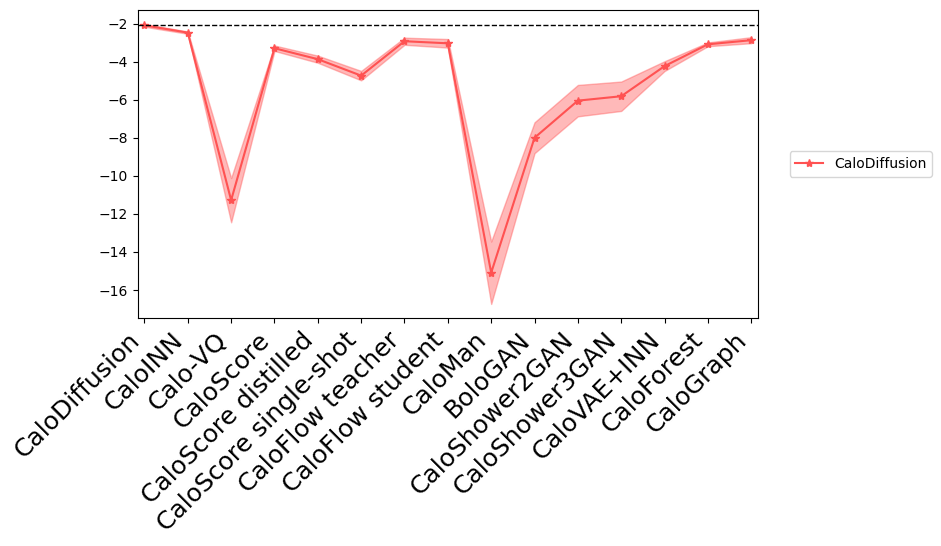

class 0 has maximum posterior in class 0


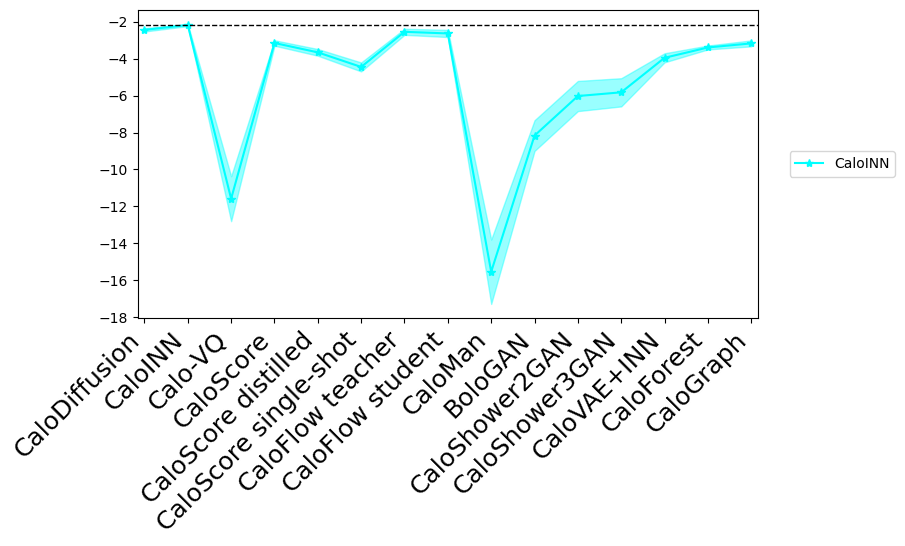

class 1 has maximum posterior in class 1


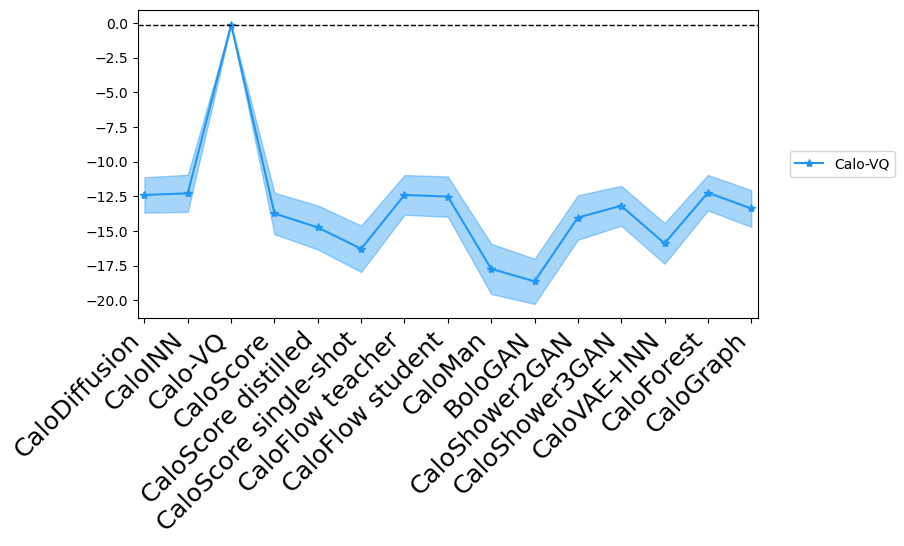

class 2 has maximum posterior in class 2


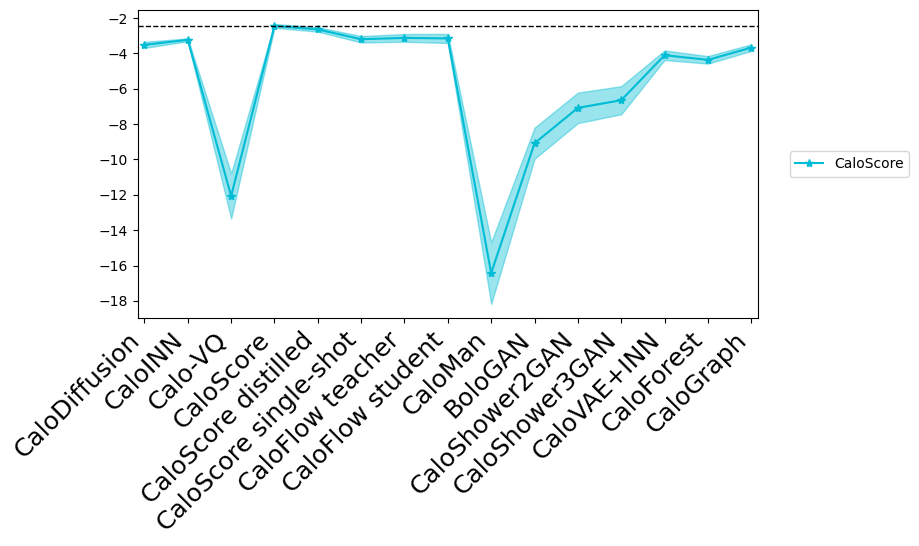

class 3 has maximum posterior in class 3


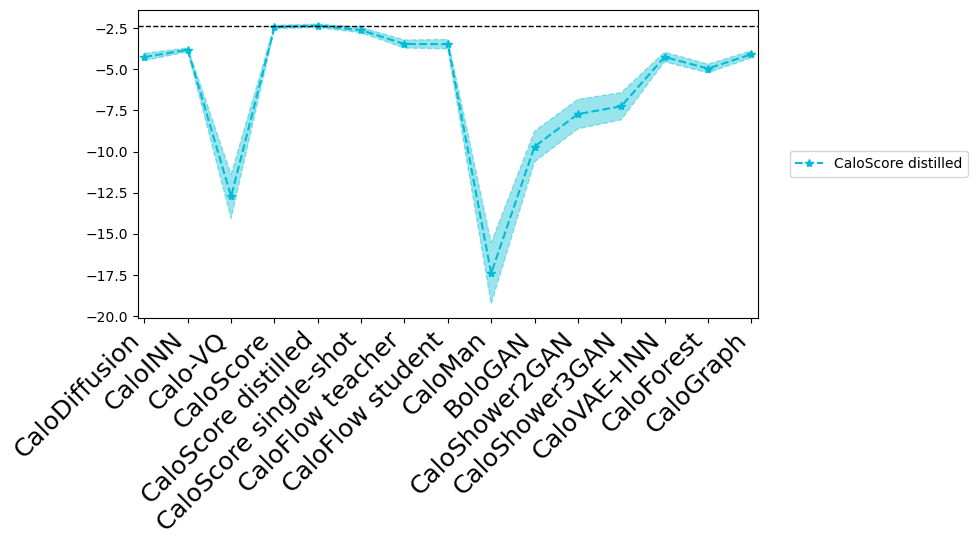

class 4 has maximum posterior in class 4


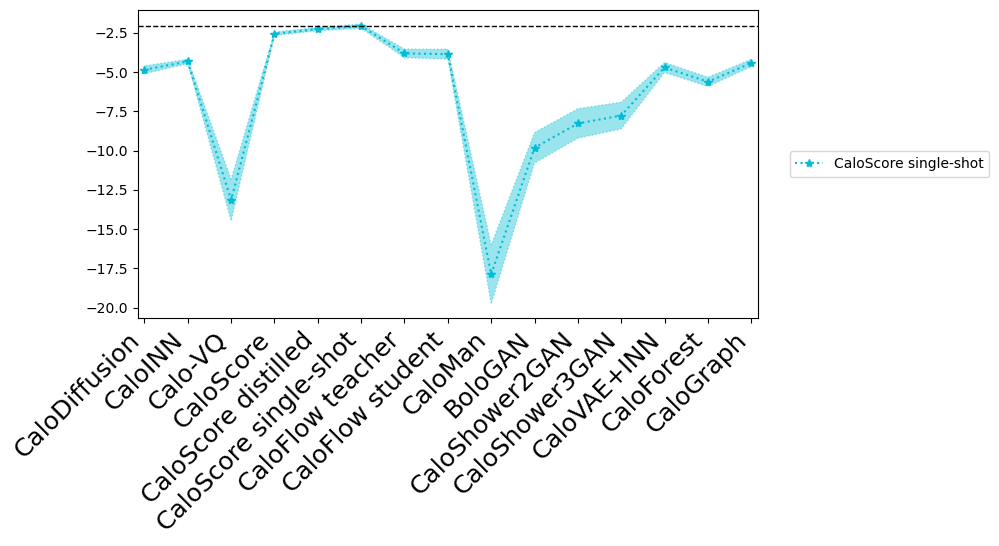

class 5 has maximum posterior in class 5


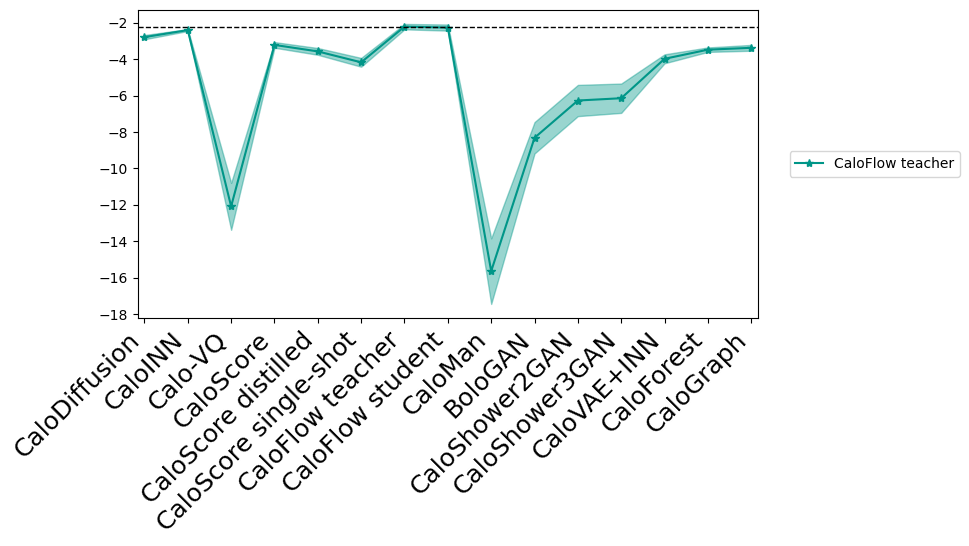

class 6 has maximum posterior in class 6


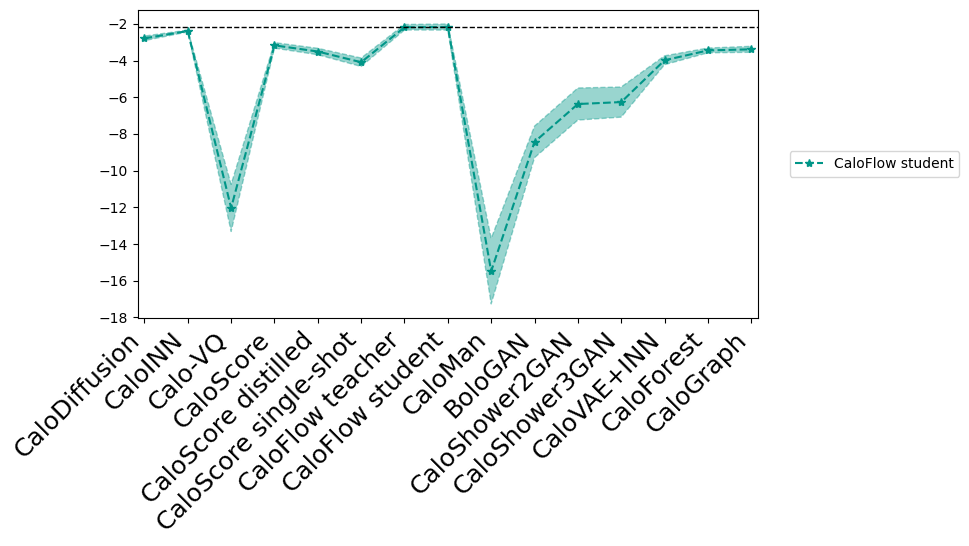

class 7 has maximum posterior in class 7


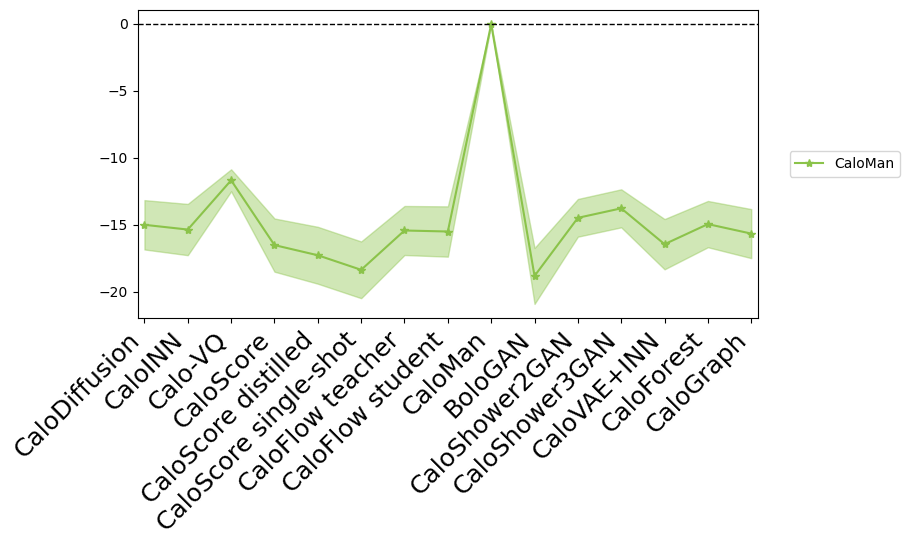

class 8 has maximum posterior in class 8


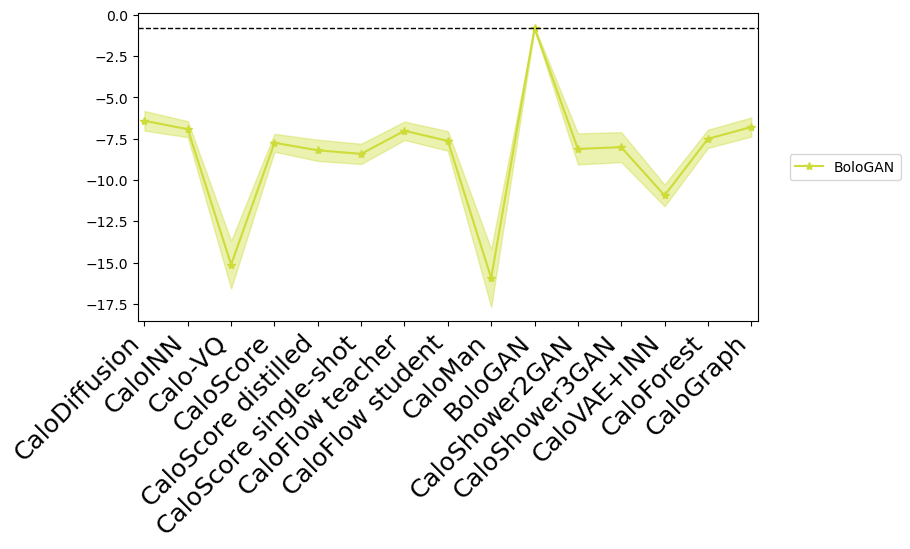

class 9 has maximum posterior in class 9


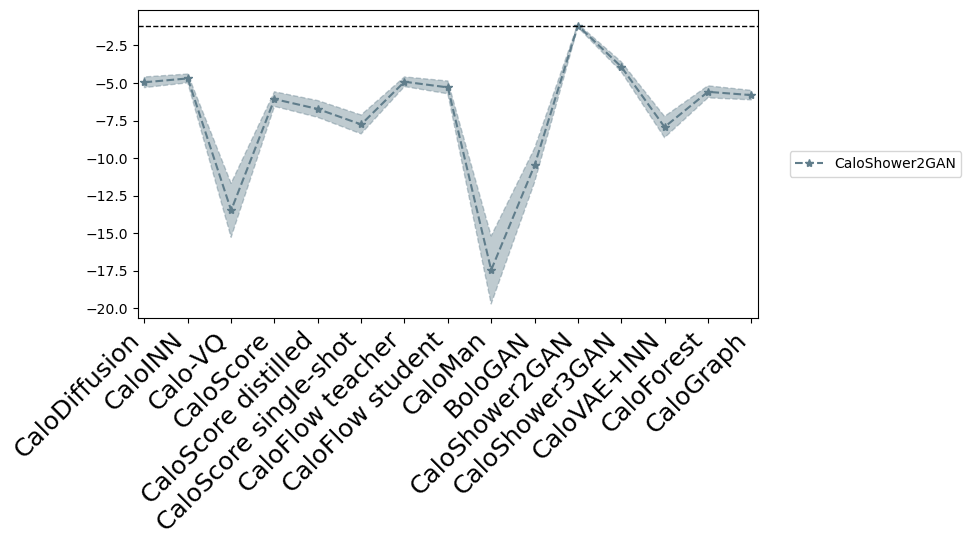

class 10 has maximum posterior in class 10


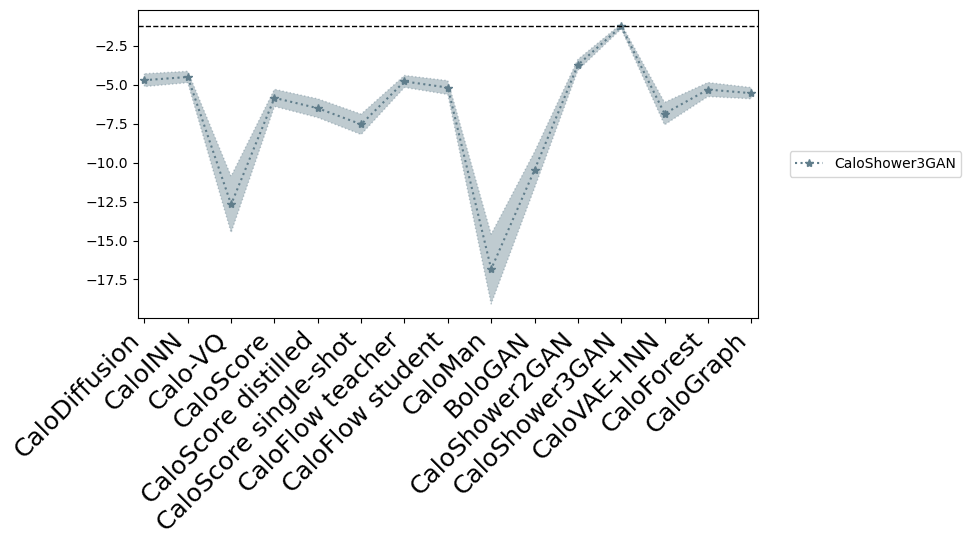

class 11 has maximum posterior in class 11


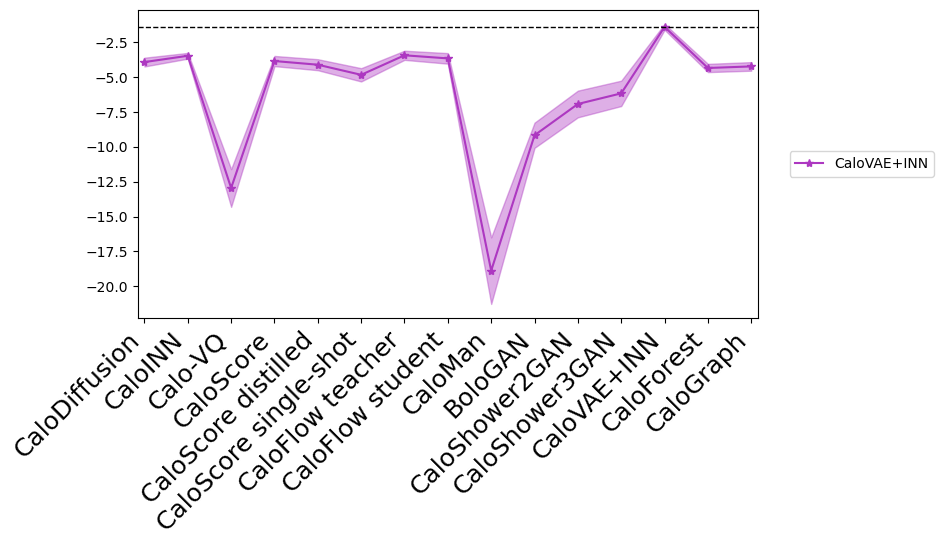

class 12 has maximum posterior in class 12


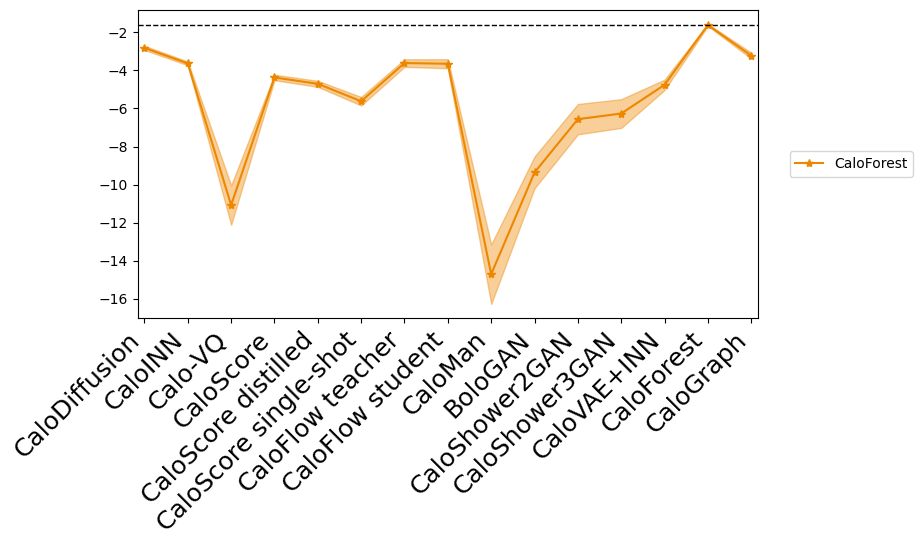

class 13 has maximum posterior in class 13


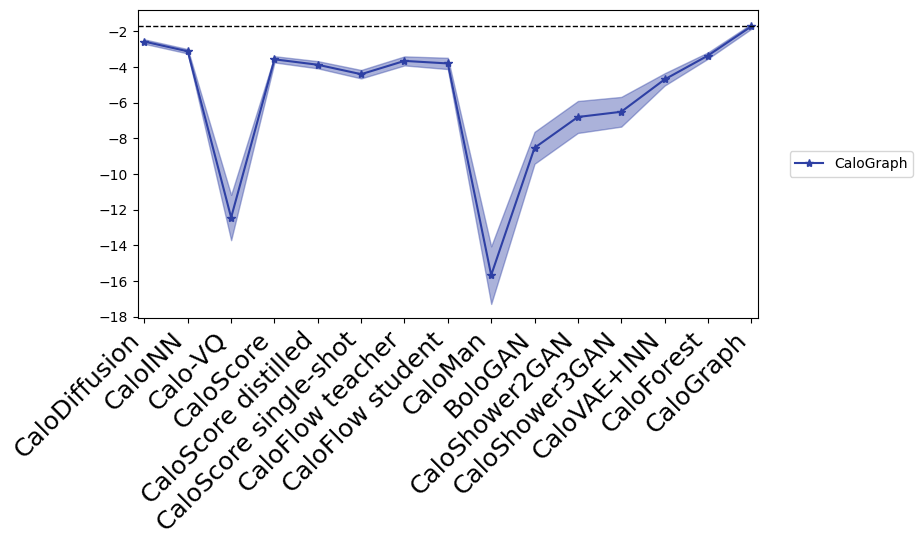

class 14 has maximum posterior in class 14


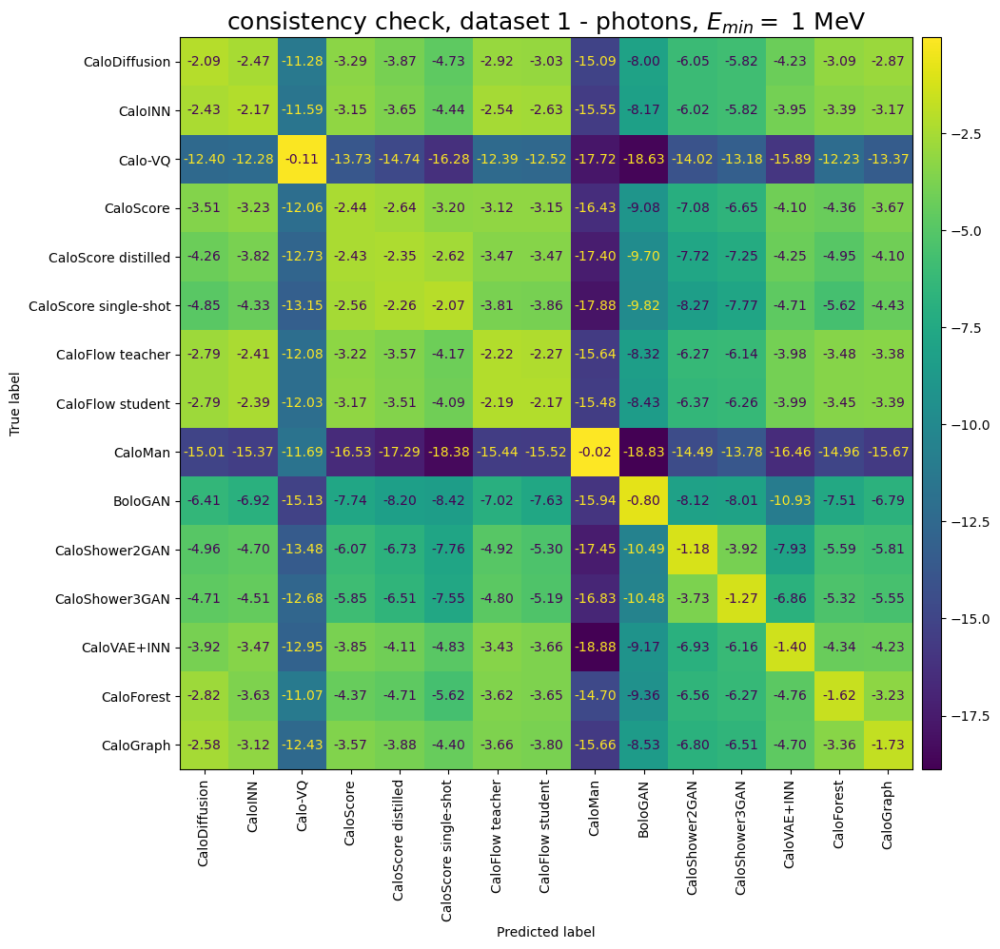

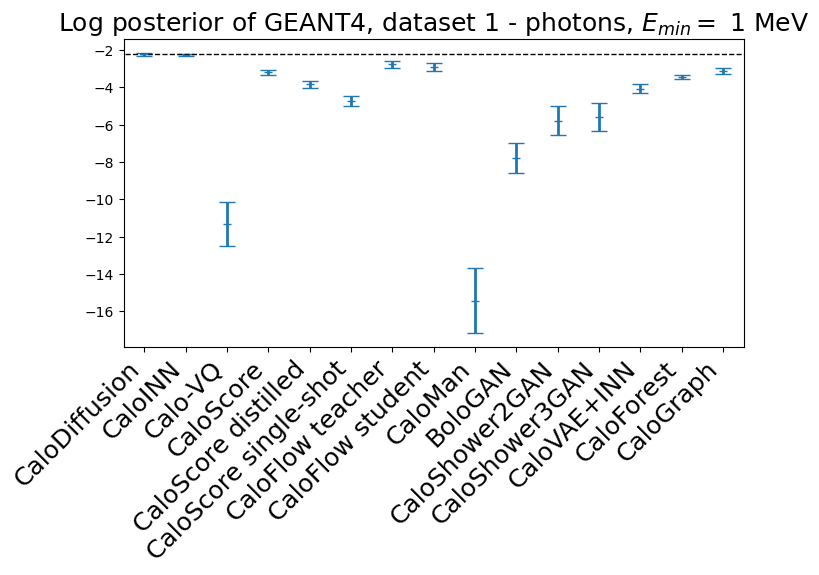

CaloDiffusion            log posterior:    -2.2373 +/- 0.0816,    place:  1
CaloINN                  log posterior:    -2.2534 +/- 0.0551,    place:  2
Calo-VQ                  log posterior:   -11.3221 +/- 1.1851,    place: 14
CaloScore                log posterior:    -3.2017 +/- 0.1538,    place:  6
CaloScore distilled      log posterior:    -3.8452 +/- 0.2058,    place:  8
CaloScore single-shot    log posterior:    -4.7218 +/- 0.2702,    place: 10
CaloFlow teacher         log posterior:    -2.7564 +/- 0.1843,    place:  3
CaloFlow student         log posterior:    -2.9021 +/- 0.2230,    place:  4
CaloMan                  log posterior:   -15.4317 +/- 1.7269,    place: 15
BoloGAN                  log posterior:    -7.7707 +/- 0.8016,    place: 13
CaloShower2GAN           log posterior:    -5.7833 +/- 0.7943,    place: 12
CaloShower3GAN           log posterior:    -5.5902 +/- 0.7415,    place: 11
CaloVAE+INN              log posterior:    -4.0620 +/- 0.2554,    place:  9
CaloForest  

In [13]:
run_accuracy_means = final_accuracy.mean(axis=-1)

for i in range(num_ds1_photons):
    print(f"Accuracy of model {i:2d}, which is {id_dict[conversion_to_submission_id[i]]:25s} is {run_accuracy_means[:,i].mean():.4f} +/- {run_accuracy_means[:,i].std():.4f}.")

print('\n')
for i in range(num_ds1_photons):
    plt.figure(figsize=(8,4))
    plt.plot(np.linspace(0, 3*num_ds1_photons + 1, num_ds1_photons), log_post_by_model.mean(axis=0)[i], '*', label=id_dict[conversion_to_submission_id[i]], **kwargs_dict[conversion_to_submission_id[i]])  # +(1./num_ds1_photons)*i
    plt.fill_between(np.linspace(0, 3*num_ds1_photons + 1, num_ds1_photons), log_post_by_model.mean(axis=0)[i]-log_post_by_model.std(axis=0)[i], log_post_by_model.mean(axis=0)[i]+log_post_by_model.std(axis=0)[i], label='_please_dont', alpha=0.4, **kwargs_dict[conversion_to_submission_id[i]])
    
    plt.xlim(-0.5, 3*num_ds1_photons + 1.5) # 2.5
    plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left")
    plt.hlines(np.max(log_post_by_model.mean(axis=0)[i]), xmin=-0.5, xmax=3*num_ds1_photons + 1.5, color = 'k', linestyle='dashed', linewidth=1)
    plt.gca().set_xticks(np.linspace(0, 3*num_ds1_photons + 1, num_ds1_photons))
    plt.gca().set_xticklabels([id_dict[conversion_to_submission_id[i]] for i in range(num_ds1_photons)], rotation=45, ha='right', fontsize=FS)

    plt.savefig(f'results_fig/cls/ds1-photons_check_{i}_{MIN_ENERGY}.pdf', dpi=300, bbox_inches='tight')
    plt.show()
    print(f"class {i} has maximum posterior in class {np.argmax(log_post_by_model.mean(axis=0)[i])}")

plt.figure(figsize=(10,10))
disp = ConfusionMatrixDisplay(confusion_matrix=log_post_by_model.mean(axis=0), 
                              display_labels=[id_dict[conversion_to_submission_id[i]] for i in range(num_ds1_photons)])
disp.plot(xticks_rotation='vertical', ax=plt.gca(), colorbar=False, values_format=".2f")
plt.title(f"consistency check, dataset 1 - photons, $E_{{min}}=$ {MIN_ENERGY} MeV", fontsize=FS)
cax = plt.gcf().add_axes([plt.gca().get_position().x1+0.01,plt.gca().get_position().y0,0.02,plt.gca().get_position().height])
plt.colorbar(disp.im_,  cax=cax)
plt.savefig(f'results_fig/cls/ds1-photons_confusion_{MIN_ENERGY}.pdf', dpi=300, bbox_inches='tight')
plt.show()

plt.figure(figsize=(8,4))
plt.errorbar(np.arange(num_ds1_photons), log_truth.mean(axis=0), yerr=log_truth.std(axis=0), elinewidth=2, marker='_', capsize=6, linestyle='None')
plt.hlines(np.max(log_truth.mean(axis=0)), xmin=-1, xmax=num_ds1_photons, color = 'k', linestyle='dashed', linewidth=1)
plt.xlim(-0.5, num_ds1_photons-0.5)
plt.title(f"Log posterior of GEANT4, dataset 1 - photons, $E_{{min}}=$ {MIN_ENERGY} MeV", fontsize=FS)
plt.gca().set_xticks(np.arange(num_ds1_photons))
plt.gca().set_xticklabels([id_dict[conversion_to_submission_id[i]] for i in range(num_ds1_photons)], rotation=45, ha='right', fontsize=FS)
plt.savefig(f'results_fig/cls/ds1-photons_truth_{MIN_ENERGY}.pdf', dpi=300, bbox_inches='tight')
plt.show()

score_order = np.argsort(np.argsort(-log_truth.mean(axis=0)))+1
for i in range(num_ds1_photons):
    print(f"{id_dict[conversion_to_submission_id[i]]:24s} log posterior:   {log_truth.mean(axis=0)[i]:8.4f} +/- {log_truth.std(axis=0)[i]:6.4f},    place: {score_order[i]:2d}")

### HLF - dataset 1 - pions

In [18]:
# compute HLF
MIN_ENERGY = 1
HLF_pions = [HLF.HighLevelFeatures('pion', 'CaloChallenge_homepage/code/binning_dataset_1_pions.xml') for _ in range(len(ds1_pions_dict)+1)]
E_inc, showers = extract_info('../scratch_CaloChallenge/data/official/NEW_dataset_1_pions_2.hdf5')
showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
HLF_pions[0].Einc = E_inc
HLF_pions[0].showers = showers
HLF_pions[0].CalculateFeatures(showers)

ds1_pions_results_dict = {'MIN_ENERGY': MIN_ENERGY}

for iter_id, submission_id in enumerate(ds1_pions_dict):
    print(f"working on {ds1_pions_dict[submission_id]} with id {submission_id}")
    E_inc, showers = extract_info(ds1_pions_dict[submission_id])
    showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
    HLF_pions[iter_id+1].Einc = E_inc
    HLF_pions[iter_id+1].showers = showers
    HLF_pions[iter_id+1].CalculateFeatures(showers)
    
with open(f"ds1-pions_{MIN_ENERGY}.pkl", 'wb') as handle:
    pickle.dump((HLF_pions, ds1_pions_results_dict), handle)
    
print(f"done")

working on ../scratch_CaloChallenge/data/Amram/ds1-pions_1.hdf5 with id 1
working on ../scratch_CaloChallenge/data/Favaro/ds1-pions_4.hdf5 with id 4
working on ../scratch_CaloChallenge/data/Liu/ds1-pions_7.hdf5 with id 7
working on ../scratch_CaloChallenge/data/Pang/ds1-pions_11.hdf5 with id 11
working on ../scratch_CaloChallenge/data/Pang/ds1-pions_12.hdf5 with id 12
working on ../scratch_CaloChallenge/data/Reyes/ds1-pions_16.hdf5 with id 16
working on ../scratch_CaloChallenge/data/Rinaldi/ds1-pions_17.hdf5 with id 17
working on ../scratch_CaloChallenge/data/Salamani/ds1-pions_20.hdf5 with id 20
working on ../scratch_CaloChallenge/data/Zhang/ds1-pions_24.hdf5 with id 24
working on ../scratch_CaloChallenge/data/Ernst/ds1-pions_27.hdf5 with id 27
working on ../scratch_CaloChallenge/data/Cresswell/ds1-pions_28.hdf5 with id 28
working on ../scratch_CaloChallenge/data/Kobylyansky/ds1-pions_29.hdf5 with id 29
done


In [ ]:
# extract data to be plotted

with open(f"ds1-pions_{MIN_ENERGY}.pkl", 'rb') as handle:
    HLF_pions, ds1_pions_results_dict = pickle.load(handle)

ds1_pions_results_dict['E_layer_dict'] = {}
ds1_pions_results_dict['EC_eta_dict'] = {}
ds1_pions_results_dict['EC_phi_dict'] = {}
ds1_pions_results_dict['EC_eta_width_dict'] = {}
ds1_pions_results_dict['EC_phi_width_dict'] = {}
ds1_pions_results_dict['Sparsity_layer_dict'] = {}
ds1_pions_results_dict['EC_r_dict'] = {}
ds1_pions_results_dict['EC_r_width_dict'] = {}
ds1_pions_results_dict['cell_dist'] = {}
ds1_pions_results_dict['Etot_Einc_dist'] = {}


for iter_id, submission_id in enumerate(ds1_pions_dict):
    print(f"working on {ds1_pions_dict[submission_id]} with id {submission_id}")
    ds1_pions_results_dict['E_layer_dict'][submission_id] = get_sep_E_layers(HLF_pions[iter_id+1], HLF_pions[0])
    print(f"working on {ds1_pions_dict[submission_id]} with id {submission_id}")
    ds1_pions_results_dict['EC_eta_dict'][submission_id] = get_sep_ECEtas(HLF_pions[iter_id+1], HLF_pions[0], '1')
    print(f"working on {ds1_pions_dict[submission_id]} with id {submission_id}")
    ds1_pions_results_dict['EC_phi_dict'][submission_id] = get_sep_ECPhis(HLF_pions[iter_id+1], HLF_pions[0], '1')
    print(f"working on {ds1_pions_dict[submission_id]} with id {submission_id}")
    ds1_pions_results_dict['EC_eta_width_dict'][submission_id] = get_sep_ECWidthEtas(HLF_pions[iter_id+1], HLF_pions[0], '1')
    print(f"working on {ds1_pions_dict[submission_id]} with id {submission_id}")
    ds1_pions_results_dict['EC_phi_width_dict'][submission_id] = get_sep_ECWidthPhis(HLF_pions[iter_id+1], HLF_pions[0], '1')
    print(f"working on {ds1_pions_dict[submission_id]} with id {submission_id}")
    ds1_pions_results_dict['Sparsity_layer_dict'][submission_id] = get_sep_Sparsity_layers(HLF_pions[iter_id+1], HLF_pions[0])
    print(f"working on {ds1_pions_dict[submission_id]} with id {submission_id}")
    ds1_pions_results_dict['EC_r_dict'][submission_id] = get_sep_ECR(HLF_pions[iter_id+1], HLF_pions[0], '1')
    print(f"working on {ds1_pions_dict[submission_id]} with id {submission_id}")
    ds1_pions_results_dict['EC_r_width_dict'][submission_id] = get_sep_ECWidthR(HLF_pions[iter_id+1], HLF_pions[0], '1')
    print(f"working on {ds1_pions_dict[submission_id]} with id {submission_id}")
    ds1_pions_results_dict['Etot_Einc_dist'][submission_id] = get_sep_Etot_Einc(HLF_pions[iter_id+1], HLF_pions[0])
    print(f"working on {ds1_pions_dict[submission_id]} with id {submission_id}")
    ds1_pions_results_dict['cell_dist'][submission_id] = get_sep_cell_dist(HLF_pions[iter_id+1], HLF_pions[0])
    
with open(f"ds1-pions_{MIN_ENERGY}.pkl", 'wb') as handle:
    pickle.dump((HLF_pions, ds1_pions_results_dict), handle)

print(f"done")

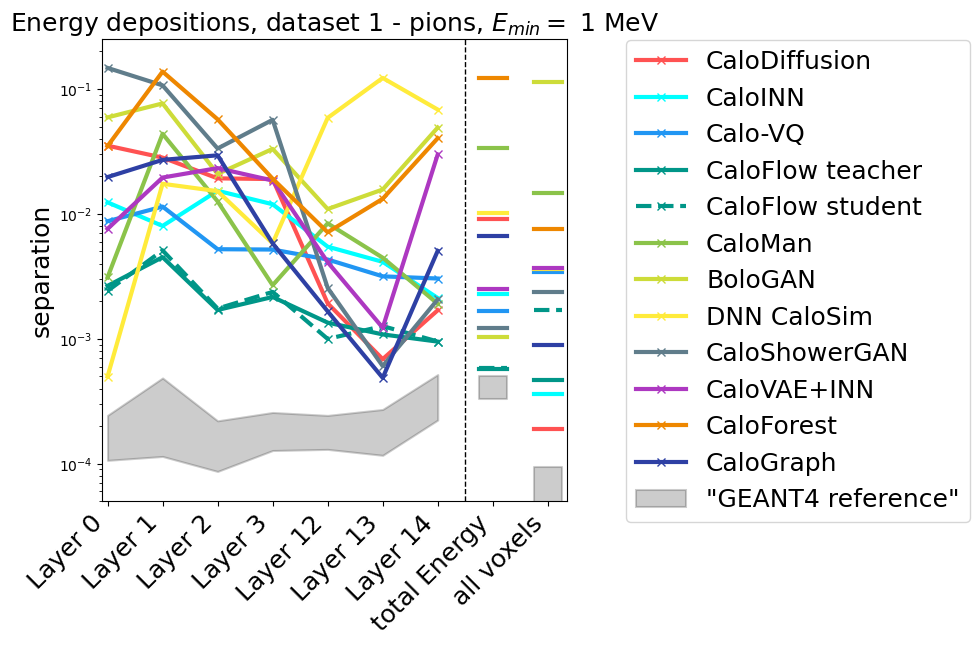

In [20]:
# energy depositions

with open(f"ds1-pions_{MIN_ENERGY}.pkl", 'rb') as handle:
    HLF_pions, ds1_pions_results_dict = pickle.load(handle)

with open(f"ds1-pions_reference_{MIN_ENERGY}.pkl", 'rb') as handle:
    ds1_pions_reference_dict = pickle.load(handle)


plt.figure(figsize=(6,6), facecolor='white')
x_scan = np.arange(9)

for entry in ds1_pions_results_dict['E_layer_dict']:
    if entry in []: #27
        continue
    plt.plot(x_scan[:7], ds1_pions_results_dict['E_layer_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])
    #plt.plot(x_scan[7:], [ds1_pions_results_dict['Etot_Einc_dist'][entry], ds1_pions_results_dict['cell_dist'][entry]], marker='o', label="_please_dont", linewidth=3., **kwargs_dict[entry])
    plt.plot([x_scan[7]-0.25, x_scan[7]+0.25], np.repeat([ds1_pions_results_dict['Etot_Einc_dist'][entry]], 2), marker=None, label="_please_dont", linewidth=3., **kwargs_dict[entry])
    plt.plot([x_scan[8]-0.25, x_scan[8]+0.25], np.repeat([ds1_pions_results_dict['cell_dist'][entry]], 2), marker=None, label="_please_dont", linewidth=3., **kwargs_dict[entry])
    #plt.errorbar(x_scan[-1], E_layer_dict[entry].mean(), yerr=E_layer_dict[entry].std(), linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds1_pions_reference_dict, 'E_layer_dict')
plt.fill_between(x_scan[:7], geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
geant_min, geant_max = get_min_max_from_dict(ds1_pions_reference_dict, 'Etot_Einc_dist')
plt.fill_between([x_scan[7]-0.25, x_scan[7]+0.25], np.repeat([geant_min], 2), np.repeat([geant_max], 2), label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])
geant_min, geant_max = get_min_max_from_dict(ds1_pions_reference_dict, 'cell_dist')
plt.fill_between([x_scan[8]-0.25, x_scan[8]+0.25], np.repeat([geant_min], 2), np.repeat([geant_max], 2), label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])

#plt.plot(x_scan[:7], ds1_pions_reference_dict['E_layer_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
#plt.plot([x_scan[7]-0.25, x_scan[7]+0.25], np.repeat([ds1_pions_reference_dict['Etot_Einc_dist']], 2), marker=None, label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])
#plt.plot([x_scan[8]-0.25, x_scan[8]+0.25], np.repeat([ds1_pions_reference_dict['cell_dist']], 2), marker=None, label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.35])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.ylim(5e-5,2.5e-1)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels(['Layer 0', 'Layer 1', 'Layer 2', 'Layer 3', 'Layer 12', 'Layer 13', 'Layer 14', 'total Energy', 'all voxels'],
                          rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.1, 1.025), fontsize=FS)
plt.title(f"Energy depositions, dataset 1 - pions, $E_{{min}}=$ {ds1_pions_results_dict['MIN_ENERGY']} MeV", fontsize=FS)
plt.axvline(x = 6.5, color = 'k', linestyle='dashed', linewidth=1)
plt.savefig(f'results_fig/sep/ds1-pions_depositions_{MIN_ENERGY}.pdf', dpi=300, bbox_inches='tight')
plt.show()
          

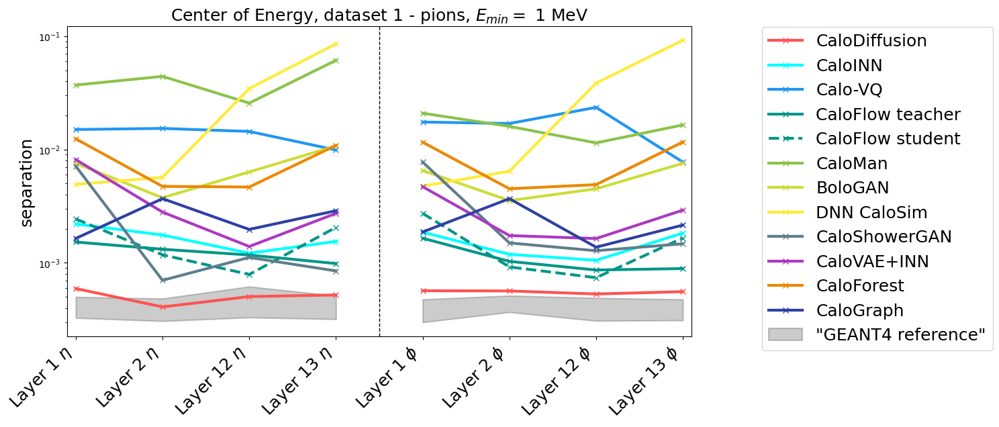

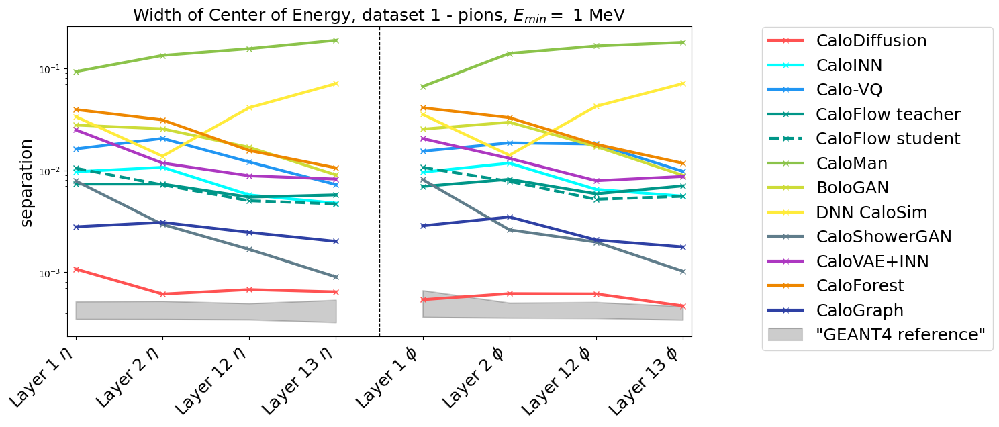

In [21]:
# EC and its width

with open(f"ds1-pions_{MIN_ENERGY}.pkl", 'rb') as handle:
    HLF_pions, ds1_pions_results_dict = pickle.load(handle)
with open(f"ds1-pions_reference_{MIN_ENERGY}.pkl", 'rb') as handle:
    ds1_pions_reference_dict = pickle.load(handle)

plt.figure(figsize=(12,6), facecolor='white')
x_scan = np.arange(8.)

for run_id, entry in enumerate(ds1_pions_results_dict['EC_eta_dict']):
    if entry in []: #27
        continue
    plt.plot(x_scan[:4], ds1_pions_results_dict['EC_eta_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])
    plt.plot(x_scan[4:], ds1_pions_results_dict['EC_phi_dict'][entry], marker='x', label="_please_dont", linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds1_pions_reference_dict, 'EC_eta_dict')
plt.fill_between(x_scan[:4], geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
geant_min, geant_max = get_min_max_from_dict(ds1_pions_reference_dict, 'EC_phi_dict')
plt.fill_between(x_scan[4:], geant_min, geant_max, label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])


#plt.plot(x_scan[:4], ds1_pions_reference_dict['EC_eta_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
#plt.plot(x_scan[4:], ds1_pions_reference_dict['EC_phi_dict'], marker='x', label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels([r'Layer 1 $\eta$', r'Layer 2 $\eta$', r'Layer 12 $\eta$', r'Layer 13 $\eta$', 
                           r'Layer 1 $\phi$', r'Layer 2 $\phi$', r'Layer 12 $\phi$', r'Layer 13 $\phi$'], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.1, 1.025), fontsize=FS)
plt.title(f"Center of Energy, dataset 1 - pions, $E_{{min}}=$ {ds1_pions_results_dict['MIN_ENERGY']} MeV", fontsize=FS)
plt.axvline(x = 3.5, color = 'k', linestyle='dashed', linewidth=1)
plt.savefig(f'results_fig/sep/ds1-pions_CE_{MIN_ENERGY}.pdf', dpi=300, bbox_inches='tight')
plt.show()
          
plt.figure(figsize=(12,6), facecolor='white')
x_scan = np.arange(8.)

for run_id, entry in enumerate(ds1_pions_results_dict['EC_eta_width_dict']):
    if entry in []: #27
        continue
    plt.plot(x_scan[:4], ds1_pions_results_dict['EC_eta_width_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])
    plt.plot(x_scan[4:], ds1_pions_results_dict['EC_phi_width_dict'][entry], marker='x', label="_please_dont", linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds1_pions_reference_dict, 'EC_eta_width_dict')
plt.fill_between(x_scan[:4], geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
geant_min, geant_max = get_min_max_from_dict(ds1_pions_reference_dict, 'EC_phi_width_dict')
plt.fill_between(x_scan[4:], geant_min, geant_max, label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])
    
    
#plt.plot(x_scan[:4], ds1_pions_reference_dict['EC_eta_width_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
#plt.plot(x_scan[4:], ds1_pions_reference_dict['EC_phi_width_dict'], marker='x', label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels([r'Layer 1 $\eta$', r'Layer 2 $\eta$', r'Layer 12 $\eta$', r'Layer 13 $\eta$', 
                           r'Layer 1 $\phi$', r'Layer 2 $\phi$', r'Layer 12 $\phi$', r'Layer 13 $\phi$'], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.1, 1.025), fontsize=FS)
plt.title(f"Width of Center of Energy, dataset 1 - pions, $E_{{min}}=$ {ds1_pions_results_dict['MIN_ENERGY']} MeV", fontsize=FS)
plt.axvline(x = 3.5, color = 'k', linestyle='dashed', linewidth=1)
plt.savefig(f'results_fig/sep/ds1-pions_width_CE_{MIN_ENERGY}.pdf', dpi=300, bbox_inches='tight')
plt.show()
          


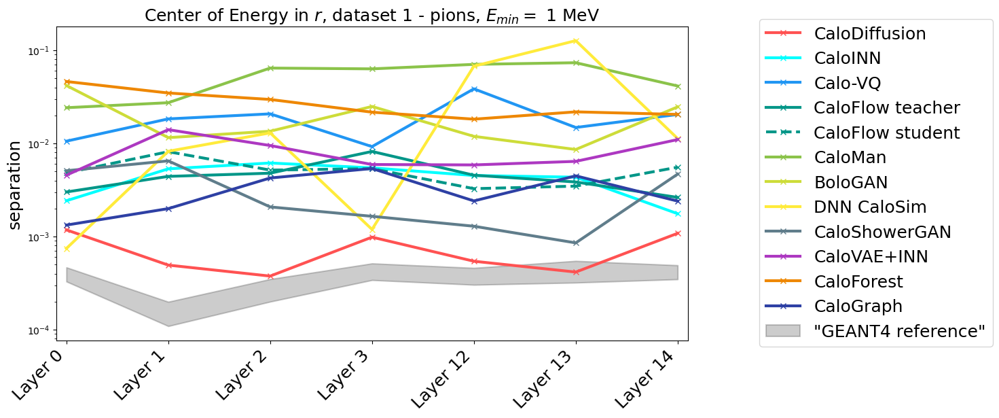

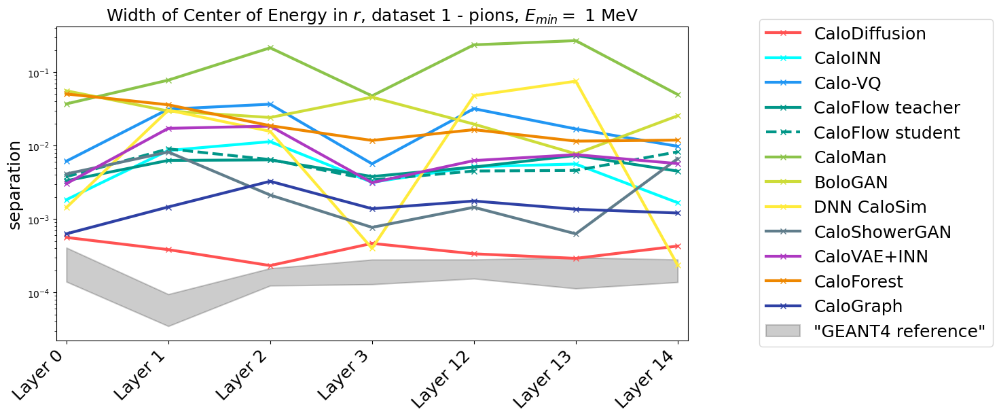

In [22]:
# EC and its width in r

with open(f"ds1-pions_{MIN_ENERGY}.pkl", 'rb') as handle:
    HLF_pions, ds1_pions_results_dict = pickle.load(handle)
with open(f"ds1-pions_reference_{MIN_ENERGY}.pkl", 'rb') as handle:
    ds1_pions_reference_dict = pickle.load(handle)

plt.figure(figsize=(12,6), facecolor='white')
x_scan = np.arange(7)

for run_id, entry in enumerate(ds1_pions_results_dict['EC_r_dict']):
    if entry in []: #27
        continue
    plt.plot(x_scan, ds1_pions_results_dict['EC_r_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds1_pions_reference_dict, 'EC_r_dict')
plt.fill_between(x_scan, geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
    
#plt.plot(x_scan, ds1_pions_reference_dict['EC_r_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels(['Layer 0', 'Layer 1', 'Layer 2', 'Layer 3', 'Layer 12', 'Layer 13', 'Layer 14'], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.1, 1.05), fontsize=FS)
plt.title(f"Center of Energy in $r$, dataset 1 - pions, $E_{{min}}=$ {ds1_pions_results_dict['MIN_ENERGY']} MeV", fontsize=FS)
plt.savefig(f'results_fig/sep/ds1-pions_CE_r_{MIN_ENERGY}.pdf', dpi=300, bbox_inches='tight')
plt.show()
          
plt.figure(figsize=(12,6), facecolor='white')
x_scan = np.arange(7)

for run_id, entry in enumerate(ds1_pions_results_dict['EC_r_width_dict']):
    if entry in []: #27
        continue
    plt.plot(x_scan, ds1_pions_results_dict['EC_r_width_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds1_pions_reference_dict, 'EC_r_width_dict')
plt.fill_between(x_scan, geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
    
#plt.plot(x_scan, ds1_pions_reference_dict['EC_r_width_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels(['Layer 0', 'Layer 1', 'Layer 2', 'Layer 3', 'Layer 12', 'Layer 13', 'Layer 14'], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.1, 1.05), fontsize=FS)
plt.title(f"Width of Center of Energy in $r$, dataset 1 - pions, $E_{{min}}=$ {ds1_pions_results_dict['MIN_ENERGY']} MeV", fontsize=FS)
plt.savefig(f'results_fig/sep/ds1-pions_width_CE_r_{MIN_ENERGY}.pdf', dpi=300, bbox_inches='tight')
plt.show()
          


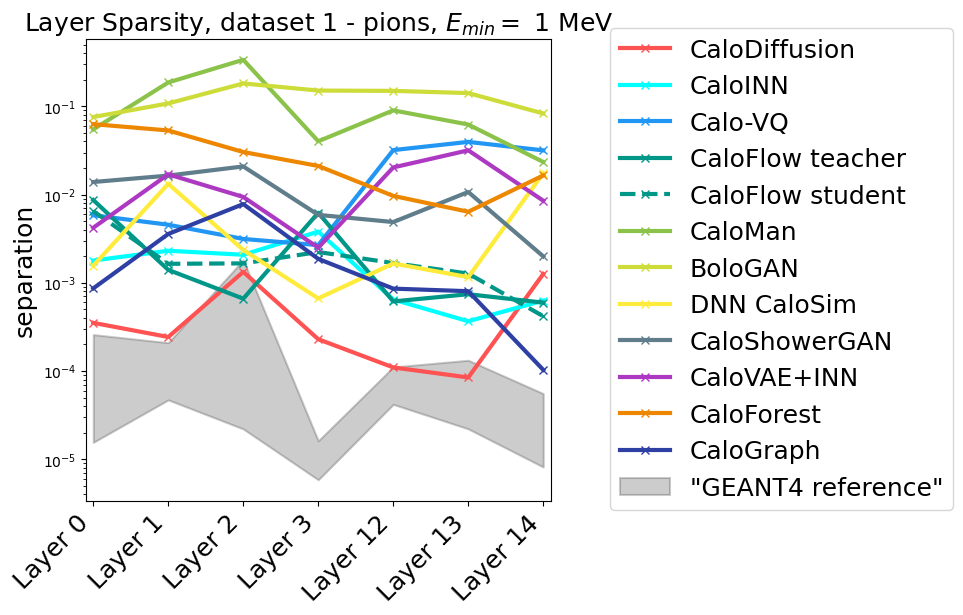

In [23]:
# layer sparsities

with open(f"ds1-pions_{MIN_ENERGY}.pkl", 'rb') as handle:
    HLF_pions, ds1_pions_results_dict = pickle.load(handle)
with open(f"ds1-pions_reference_{MIN_ENERGY}.pkl", 'rb') as handle:
    ds1_pions_reference_dict = pickle.load(handle)

plt.figure(figsize=(6,6), facecolor='white')
x_scan = np.arange(7)

for entry in ds1_pions_results_dict['Sparsity_layer_dict']:
    if entry in []: #27
        continue
    plt.plot(x_scan, ds1_pions_results_dict['Sparsity_layer_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])
geant_min, geant_max = get_min_max_from_dict(ds1_pions_reference_dict, 'Sparsity_layer_dict')
plt.fill_between(x_scan, geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

#plt.plot(x_scan, ds1_pions_reference_dict['Sparsity_layer_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels(['Layer 0', 'Layer 1', 'Layer 2', 'Layer 3', 'Layer 12', 'Layer 13', 'Layer 14'], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.1, 1.05), fontsize=FS)
plt.title(f"Layer Sparsity, dataset 1 - pions, $E_{{min}}=$ {ds1_pions_results_dict['MIN_ENERGY']} MeV", fontsize=FS)
plt.savefig(f'results_fig/sep/ds1-pions_sparsity_{MIN_ENERGY}.pdf', dpi=300, bbox_inches='tight')
plt.show()


### LLF - dataset 1 - pions

In [14]:
MIN_ENERGY = 1

np.random.seed(2104)

idx_rnd = np.random.choice(np.arange(120800), size=120800, replace=False)
idx_train, idx_test, idx_val = idx_rnd[:80000], idx_rnd[80000:100000], idx_rnd[100000:]

train_data = np.array([])
test_data = np.array([])
val_data = np.array([])


E_inc, showers = extract_info('../scratch_CaloChallenge/data/official/NEW_dataset_1_pions_2.hdf5')
showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
truth_data = np.concatenate([np.log10(E_inc), showers / E_inc, -1*np.ones_like(E_inc)], axis=1)

conversion_to_submission_id = {}

for iter_id, submission_id in enumerate(ds1_pions_dict):
    print(f"working on {ds1_pions_dict[submission_id]} with submission id {submission_id} and classifier label {iter_id}")
    E_inc, showers = extract_info(ds1_pions_dict[submission_id])
    showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
    data = np.concatenate([np.log10(E_inc), showers / E_inc, iter_id*np.ones_like(E_inc)], axis=1)            
    train_data = np.vstack([*train_data, *data[idx_train]])
    test_data = np.vstack([*test_data, *data[idx_test]])
    val_data = np.vstack([*val_data, *data[idx_val]])
    conversion_to_submission_id[iter_id] = submission_id

np.random.shuffle(train_data)
np.random.shuffle(test_data)
np.random.shuffle(val_data)

print("done")

working on ../scratch_CaloChallenge/data/Amram/ds1-pions_1.hdf5 with submission id 1 and classifier label 0
working on ../scratch_CaloChallenge/data/Favaro/ds1-pions_4.hdf5 with submission id 4 and classifier label 1
working on ../scratch_CaloChallenge/data/Liu/ds1-pions_7.hdf5 with submission id 7 and classifier label 2
working on ../scratch_CaloChallenge/data/Pang/ds1-pions_11.hdf5 with submission id 11 and classifier label 3
working on ../scratch_CaloChallenge/data/Pang/ds1-pions_12.hdf5 with submission id 12 and classifier label 4
working on ../scratch_CaloChallenge/data/Reyes/ds1-pions_16.hdf5 with submission id 16 and classifier label 5
working on ../scratch_CaloChallenge/data/Rinaldi/ds1-pions_17.hdf5 with submission id 17 and classifier label 6
working on ../scratch_CaloChallenge/data/Salamani/ds1-pions_20.hdf5 with submission id 20 and classifier label 7
working on ../scratch_CaloChallenge/data/Zhang/ds1-pions_24.hdf5 with submission id 24 and classifier label 8
working on ../

In [15]:
batch_size = 2000

train_dataset = TensorDataset(torch.tensor(train_data).to(device))
test_dataset = TensorDataset(torch.tensor(test_data).to(device))
val_dataset = TensorDataset(torch.tensor(val_data).to(device))
truth_dataset = TensorDataset(torch.tensor(truth_data).to(device))

train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
truth_dataloader = DataLoader(truth_dataset, batch_size=batch_size, shuffle=False)

model architecture 
DNN(
  (inputlayer): Linear(in_features=534, out_features=2048, bias=True)
  (outputlayer): Linear(in_features=2048, out_features=12, bias=True)
  (layers): Sequential(
    (0): Linear(in_features=534, out_features=2048, bias=True)
    (1): LeakyReLU(negative_slope=0.01)
    (2): Dropout(p=0.0, inplace=False)
    (3): Linear(in_features=2048, out_features=2048, bias=True)
    (4): LeakyReLU(negative_slope=0.01)
    (5): Dropout(p=0.0, inplace=False)
    (6): Linear(in_features=2048, out_features=2048, bias=True)
    (7): LeakyReLU(negative_slope=0.01)
    (8): Dropout(p=0.0, inplace=False)
    (9): Linear(in_features=2048, out_features=12, bias=True)
  )
)
Model has 9512972 trainable parameters
Evaluation loss 2.4851521075119574, accuracy 0.08333333333333333
Epoch 1 / 25 of run 1 / 10
step    0 / 480; loss 2.4857
step   40 / 480; loss 2.4850
step   80 / 480; loss 2.3792
step  120 / 480; loss 2.3589
step  160 / 480; loss 2.3077
step  200 / 480; loss 2.2375
step  240 

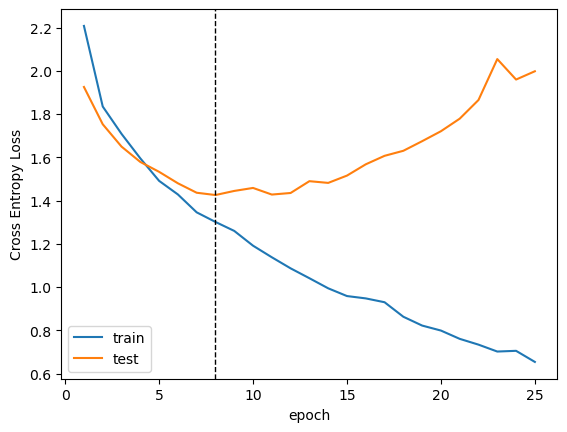

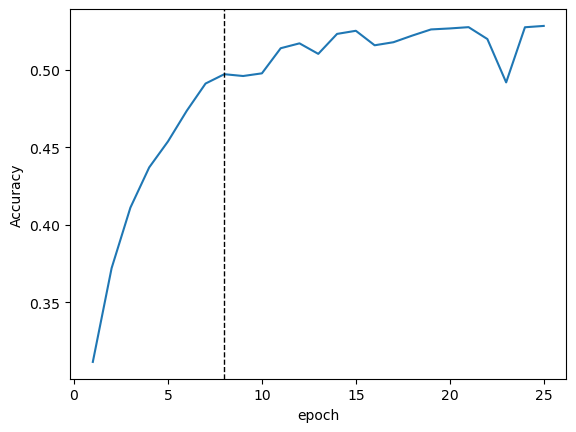

Model multiclass_weights_1-pion_ensemble_min1_0.pt loaded
Evaluation loss 1.4255538893041064, accuracy 0.4970583333333333
preds shape (240000, 13)
preds shape (120800, 13)
Accuracy of model 0, which is CaloDiffusion is 0.15295.
Accuracy of model 1, which is CaloINN is 0.1985.
Accuracy of model 2, which is Calo-VQ is 0.83205.
Accuracy of model 3, which is CaloFlow teacher is 0.21585.
Accuracy of model 4, which is CaloFlow student is 0.2729.
Accuracy of model 5, which is CaloMan is 0.9588.
Accuracy of model 6, which is BoloGAN is 0.7094.
Accuracy of model 7, which is DNN CaloSim is 0.4803.
Accuracy of model 8, which is CaloShowerGAN is 0.57665.
Accuracy of model 9, which is CaloVAE+INN is 0.5574.
Accuracy of model 10, which is CaloForest is 0.6294.
Accuracy of model 11, which is CaloGraph is 0.3805.
class 0 has maximum posterior in class 0
class 1 has maximum posterior in class 1
class 2 has maximum posterior in class 2
class 3 has maximum posterior in class 3
class 4 has maximum posteri

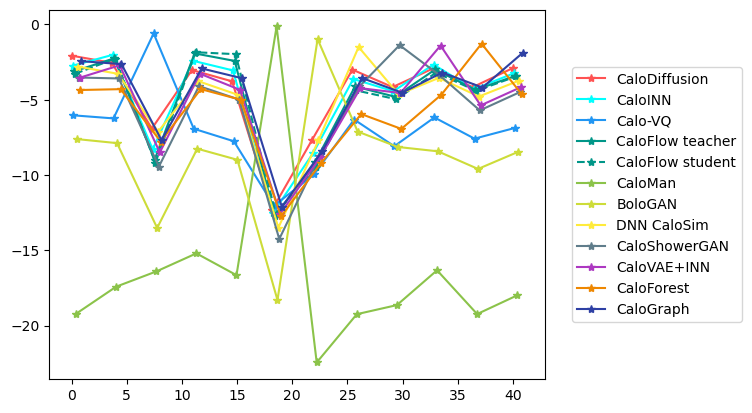

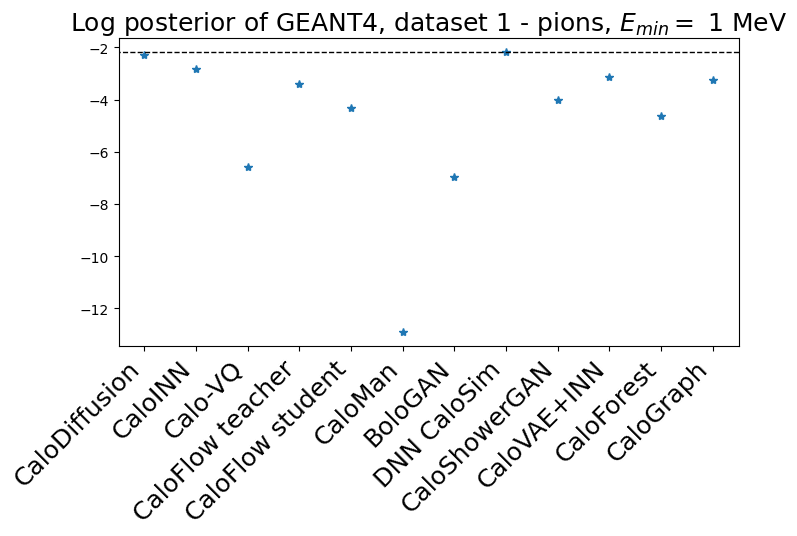

CaloDiffusion            log posterior:    -2.2907,    place:  2
CaloINN                  log posterior:    -2.8131,    place:  3
Calo-VQ                  log posterior:    -6.5779,    place: 10
CaloFlow teacher         log posterior:    -3.4216,    place:  6
CaloFlow student         log posterior:    -4.3137,    place:  8
CaloMan                  log posterior:   -12.9215,    place: 12
BoloGAN                  log posterior:    -6.9503,    place: 11
DNN CaloSim              log posterior:    -2.1983,    place:  1
CaloShowerGAN            log posterior:    -4.0235,    place:  7
CaloVAE+INN              log posterior:    -3.1550,    place:  4
CaloForest               log posterior:    -4.6244,    place:  9
CaloGraph                log posterior:    -3.2667,    place:  5

  - - - -  

model architecture 
DNN(
  (inputlayer): Linear(in_features=534, out_features=2048, bias=True)
  (outputlayer): Linear(in_features=2048, out_features=12, bias=True)
  (layers): Sequential(
    (0): Linear(i

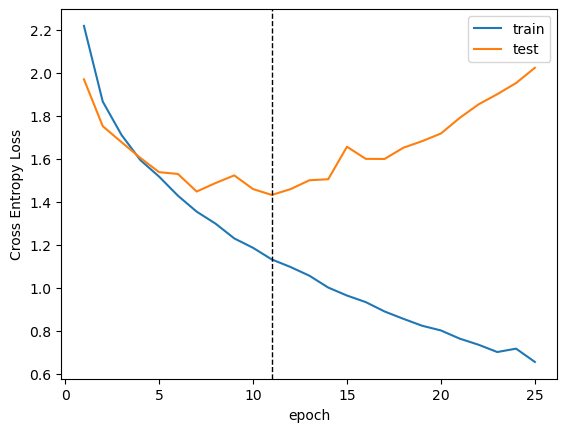

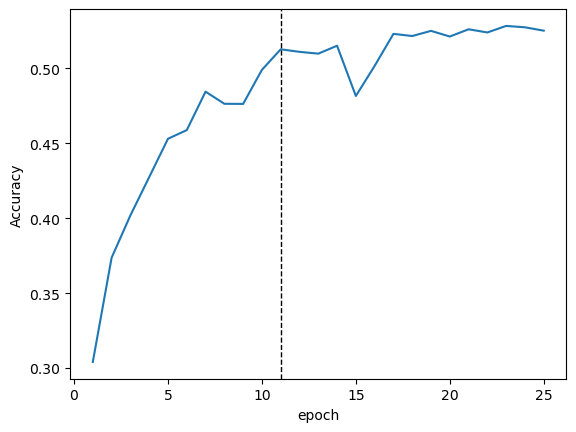

Model multiclass_weights_1-pion_ensemble_min1_1.pt loaded
Evaluation loss 1.431990133326915, accuracy 0.5127708333333333
preds shape (240000, 13)
preds shape (120800, 13)
Accuracy of model 0, which is CaloDiffusion is 0.2398.
Accuracy of model 1, which is CaloINN is 0.1496.
Accuracy of model 2, which is Calo-VQ is 0.80185.
Accuracy of model 3, which is CaloFlow teacher is 0.1998.
Accuracy of model 4, which is CaloFlow student is 0.4753.
Accuracy of model 5, which is CaloMan is 0.9595.
Accuracy of model 6, which is BoloGAN is 0.7344.
Accuracy of model 7, which is DNN CaloSim is 0.4187.
Accuracy of model 8, which is CaloShowerGAN is 0.6418.
Accuracy of model 9, which is CaloVAE+INN is 0.5496.
Accuracy of model 10, which is CaloForest is 0.60525.
Accuracy of model 11, which is CaloGraph is 0.37765.
class 0 has maximum posterior in class 0
class 1 has maximum posterior in class 1
class 2 has maximum posterior in class 2
class 3 has maximum posterior in class 3
class 4 has maximum posterior

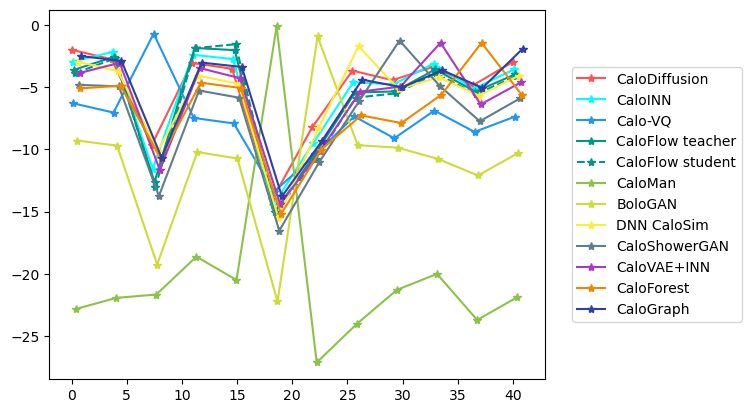

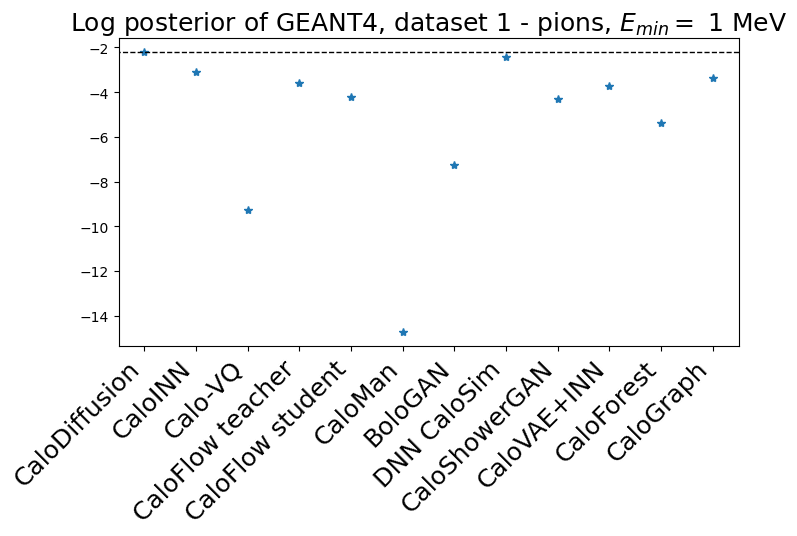

CaloDiffusion            log posterior:    -2.2243,    place:  1
CaloINN                  log posterior:    -3.0846,    place:  3
Calo-VQ                  log posterior:    -9.2853,    place: 11
CaloFlow teacher         log posterior:    -3.5785,    place:  5
CaloFlow student         log posterior:    -4.1954,    place:  7
CaloMan                  log posterior:   -14.7446,    place: 12
BoloGAN                  log posterior:    -7.2664,    place: 10
DNN CaloSim              log posterior:    -2.4480,    place:  2
CaloShowerGAN            log posterior:    -4.3047,    place:  8
CaloVAE+INN              log posterior:    -3.7125,    place:  6
CaloForest               log posterior:    -5.3674,    place:  9
CaloGraph                log posterior:    -3.3614,    place:  4

  - - - -  

model architecture 
DNN(
  (inputlayer): Linear(in_features=534, out_features=2048, bias=True)
  (outputlayer): Linear(in_features=2048, out_features=12, bias=True)
  (layers): Sequential(
    (0): Linear(i

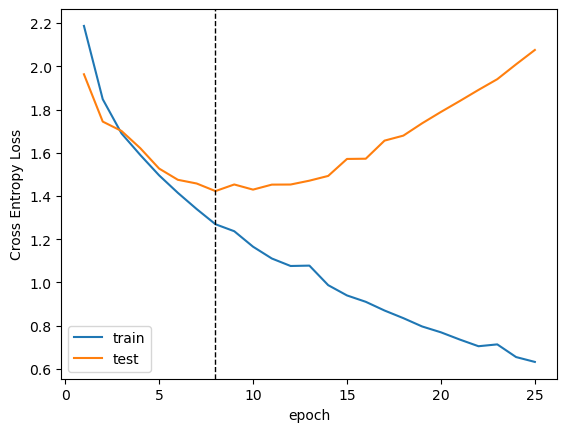

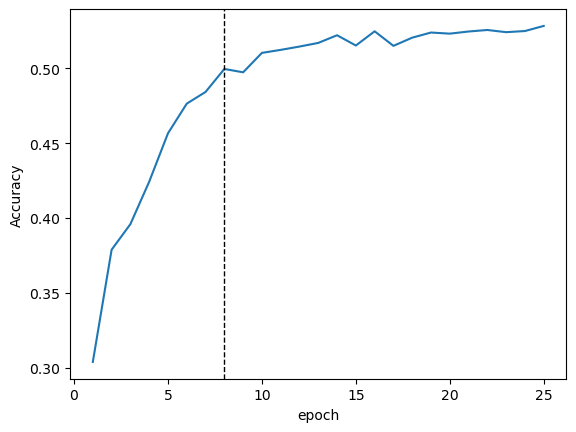

Model multiclass_weights_1-pion_ensemble_min1_2.pt loaded
Evaluation loss 1.4226904845946517, accuracy 0.4996
preds shape (240000, 13)
preds shape (120800, 13)
Accuracy of model 0, which is CaloDiffusion is 0.18905.
Accuracy of model 1, which is CaloINN is 0.17965.
Accuracy of model 2, which is Calo-VQ is 0.8217.
Accuracy of model 3, which is CaloFlow teacher is 0.242.
Accuracy of model 4, which is CaloFlow student is 0.4059.
Accuracy of model 5, which is CaloMan is 0.95915.
Accuracy of model 6, which is BoloGAN is 0.702.
Accuracy of model 7, which is DNN CaloSim is 0.424.
Accuracy of model 8, which is CaloShowerGAN is 0.5651.
Accuracy of model 9, which is CaloVAE+INN is 0.4756.
Accuracy of model 10, which is CaloForest is 0.66935.
Accuracy of model 11, which is CaloGraph is 0.3617.
class 0 has maximum posterior in class 0
class 1 has maximum posterior in class 1
class 2 has maximum posterior in class 2
class 3 has maximum posterior in class 3
class 4 has maximum posterior in class 4
c

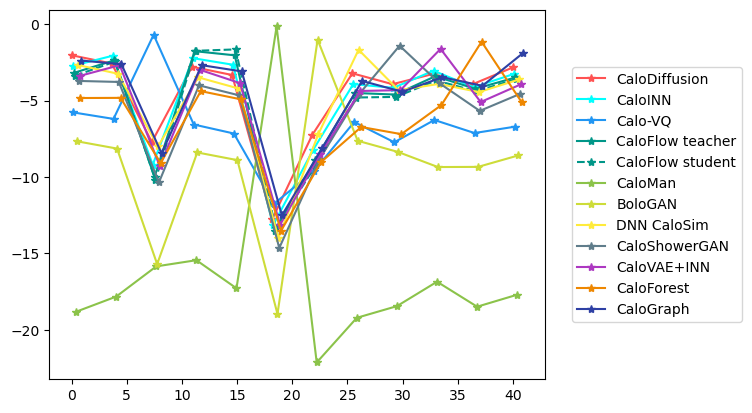

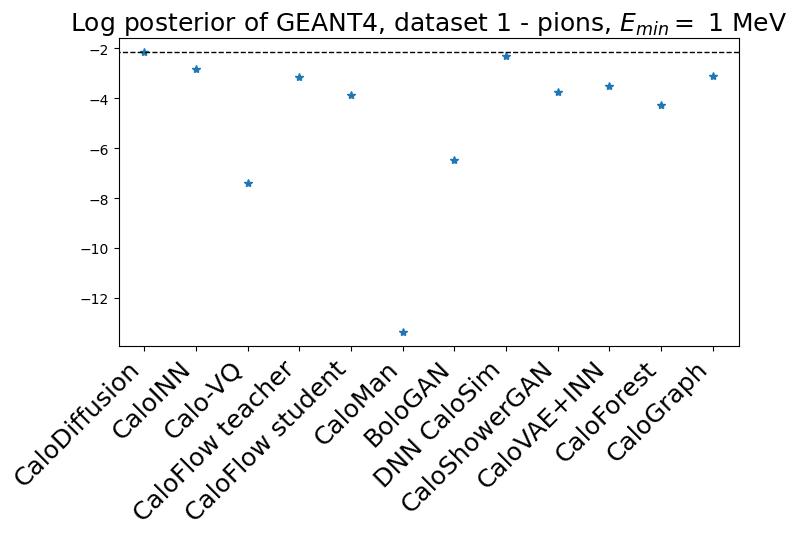

CaloDiffusion            log posterior:    -2.1670,    place:  1
CaloINN                  log posterior:    -2.8137,    place:  3
Calo-VQ                  log posterior:    -7.3824,    place: 11
CaloFlow teacher         log posterior:    -3.1486,    place:  5
CaloFlow student         log posterior:    -3.8558,    place:  8
CaloMan                  log posterior:   -13.3766,    place: 12
BoloGAN                  log posterior:    -6.4852,    place: 10
DNN CaloSim              log posterior:    -2.3151,    place:  2
CaloShowerGAN            log posterior:    -3.7546,    place:  7
CaloVAE+INN              log posterior:    -3.5111,    place:  6
CaloForest               log posterior:    -4.2839,    place:  9
CaloGraph                log posterior:    -3.1199,    place:  4

  - - - -  

model architecture 
DNN(
  (inputlayer): Linear(in_features=534, out_features=2048, bias=True)
  (outputlayer): Linear(in_features=2048, out_features=12, bias=True)
  (layers): Sequential(
    (0): Linear(i

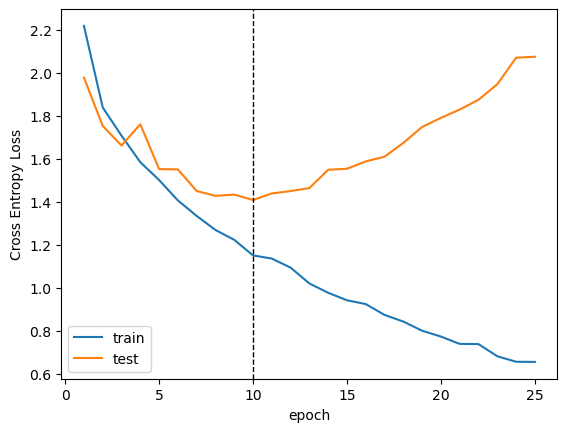

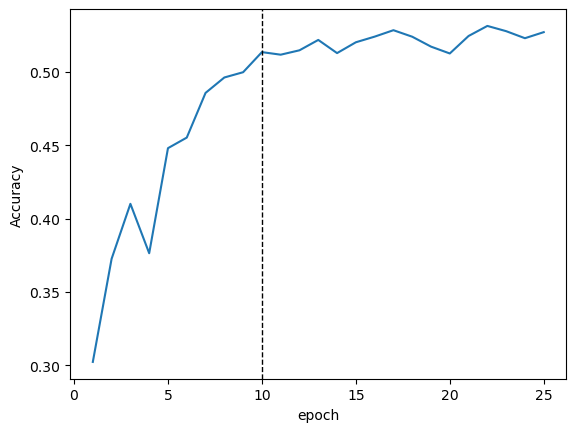

Model multiclass_weights_1-pion_ensemble_min1_3.pt loaded
Evaluation loss 1.4087025513603826, accuracy 0.5136458333333334
preds shape (240000, 13)
preds shape (120800, 13)
Accuracy of model 0, which is CaloDiffusion is 0.20915.
Accuracy of model 1, which is CaloINN is 0.2215.
Accuracy of model 2, which is Calo-VQ is 0.8337.
Accuracy of model 3, which is CaloFlow teacher is 0.17355.
Accuracy of model 4, which is CaloFlow student is 0.3902.
Accuracy of model 5, which is CaloMan is 0.97965.
Accuracy of model 6, which is BoloGAN is 0.74815.
Accuracy of model 7, which is DNN CaloSim is 0.49905.
Accuracy of model 8, which is CaloShowerGAN is 0.57415.
Accuracy of model 9, which is CaloVAE+INN is 0.4927.
Accuracy of model 10, which is CaloForest is 0.6413.
Accuracy of model 11, which is CaloGraph is 0.40065.
class 0 has maximum posterior in class 0
class 1 has maximum posterior in class 1
class 2 has maximum posterior in class 2
class 3 has maximum posterior in class 3
class 4 has maximum post

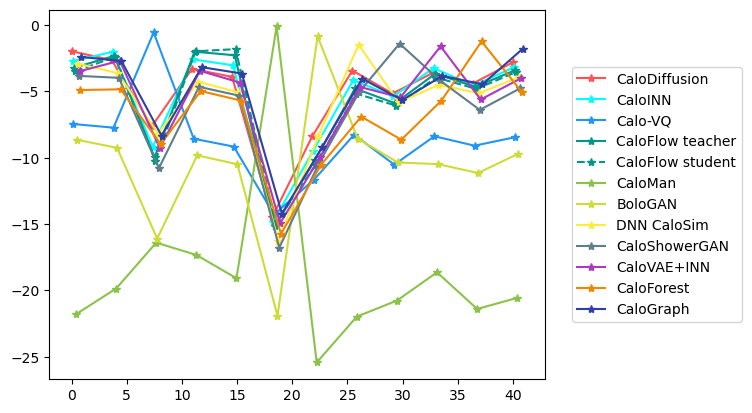

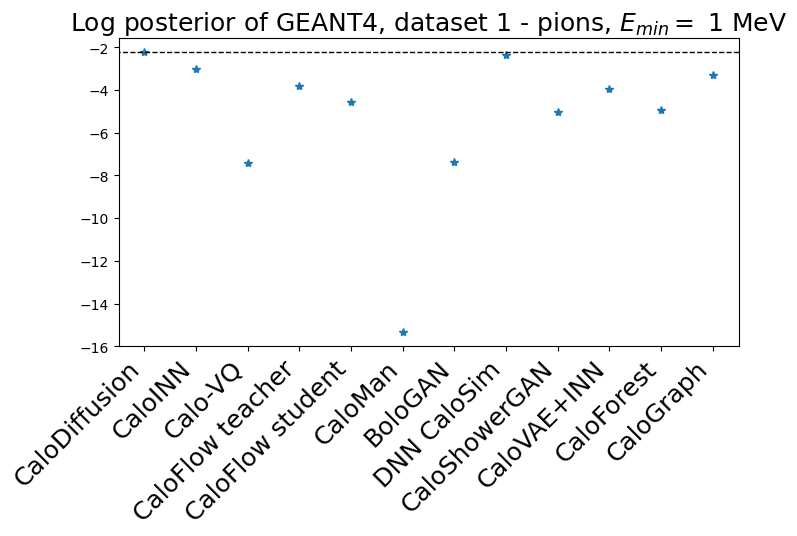

CaloDiffusion            log posterior:    -2.2414,    place:  1
CaloINN                  log posterior:    -3.0066,    place:  3
Calo-VQ                  log posterior:    -7.4213,    place: 11
CaloFlow teacher         log posterior:    -3.7931,    place:  5
CaloFlow student         log posterior:    -4.5446,    place:  7
CaloMan                  log posterior:   -15.3547,    place: 12
BoloGAN                  log posterior:    -7.3735,    place: 10
DNN CaloSim              log posterior:    -2.3743,    place:  2
CaloShowerGAN            log posterior:    -5.0187,    place:  9
CaloVAE+INN              log posterior:    -3.9627,    place:  6
CaloForest               log posterior:    -4.9215,    place:  8
CaloGraph                log posterior:    -3.2757,    place:  4

  - - - -  

model architecture 
DNN(
  (inputlayer): Linear(in_features=534, out_features=2048, bias=True)
  (outputlayer): Linear(in_features=2048, out_features=12, bias=True)
  (layers): Sequential(
    (0): Linear(i

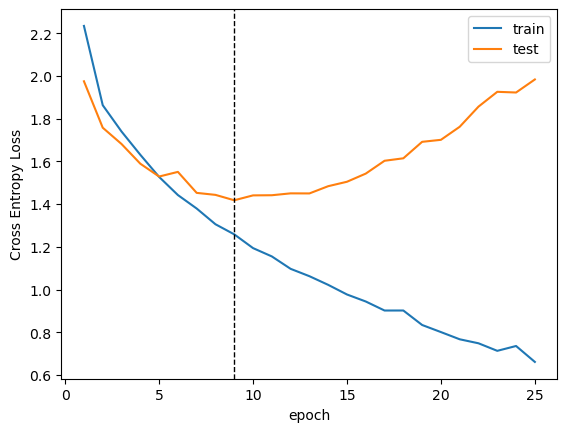

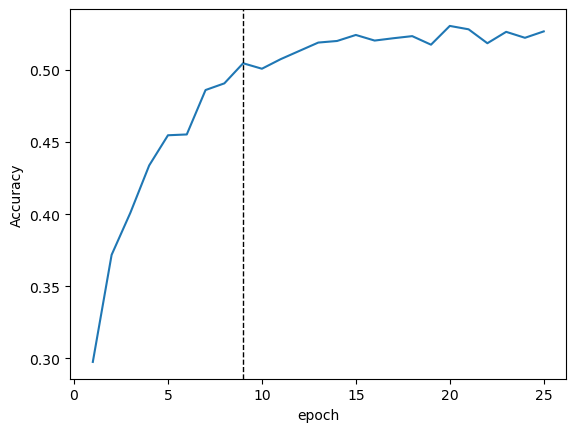

Model multiclass_weights_1-pion_ensemble_min1_4.pt loaded
Evaluation loss 1.4180610566806042, accuracy 0.50455
preds shape (240000, 13)
preds shape (120800, 13)
Accuracy of model 0, which is CaloDiffusion is 0.15505.
Accuracy of model 1, which is CaloINN is 0.1974.
Accuracy of model 2, which is Calo-VQ is 0.7658.
Accuracy of model 3, which is CaloFlow teacher is 0.2446.
Accuracy of model 4, which is CaloFlow student is 0.3613.
Accuracy of model 5, which is CaloMan is 0.97695.
Accuracy of model 6, which is BoloGAN is 0.73365.
Accuracy of model 7, which is DNN CaloSim is 0.45645.
Accuracy of model 8, which is CaloShowerGAN is 0.5736.
Accuracy of model 9, which is CaloVAE+INN is 0.5323.
Accuracy of model 10, which is CaloForest is 0.64995.
Accuracy of model 11, which is CaloGraph is 0.40755.
class 0 has maximum posterior in class 0
class 1 has maximum posterior in class 1
class 2 has maximum posterior in class 2
class 3 has maximum posterior in class 3
class 4 has maximum posterior in cla

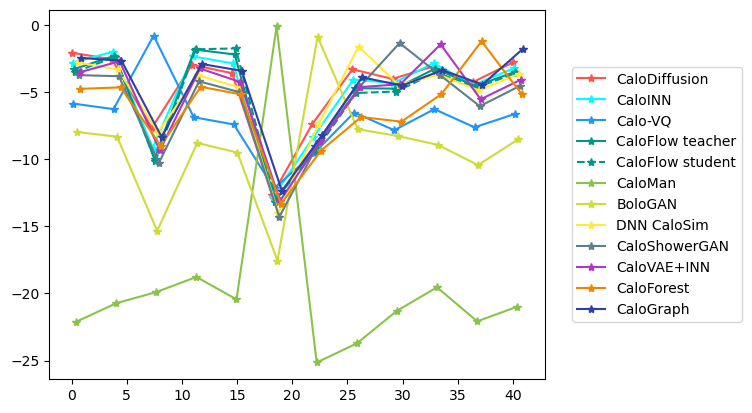

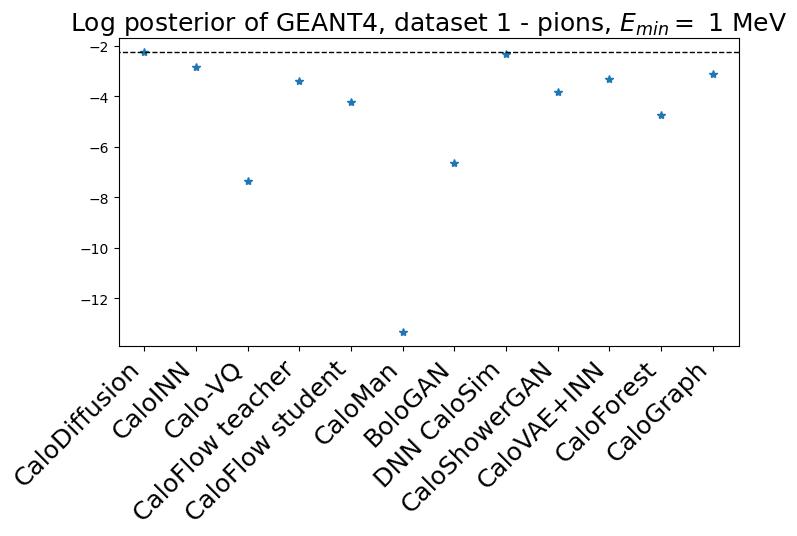

CaloDiffusion            log posterior:    -2.2558,    place:  1
CaloINN                  log posterior:    -2.8511,    place:  3
Calo-VQ                  log posterior:    -7.3692,    place: 11
CaloFlow teacher         log posterior:    -3.3891,    place:  6
CaloFlow student         log posterior:    -4.2214,    place:  8
CaloMan                  log posterior:   -13.3613,    place: 12
BoloGAN                  log posterior:    -6.6345,    place: 10
DNN CaloSim              log posterior:    -2.3210,    place:  2
CaloShowerGAN            log posterior:    -3.8303,    place:  7
CaloVAE+INN              log posterior:    -3.3220,    place:  5
CaloForest               log posterior:    -4.7279,    place:  9
CaloGraph                log posterior:    -3.1280,    place:  4

  - - - -  

model architecture 
DNN(
  (inputlayer): Linear(in_features=534, out_features=2048, bias=True)
  (outputlayer): Linear(in_features=2048, out_features=12, bias=True)
  (layers): Sequential(
    (0): Linear(i

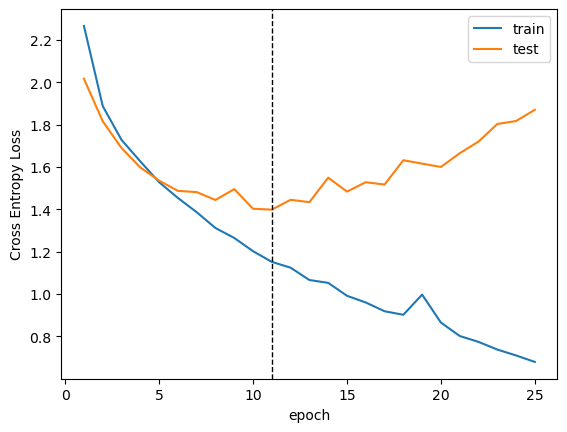

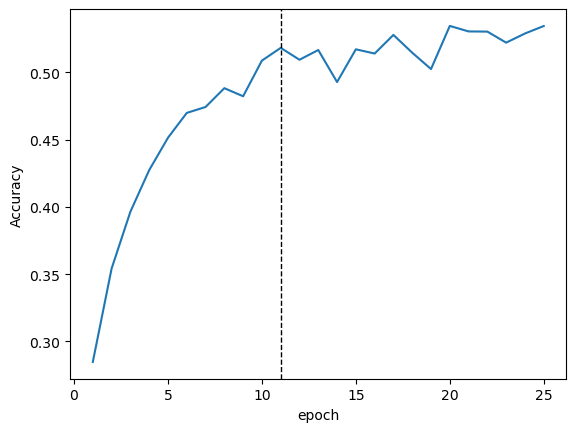

Model multiclass_weights_1-pion_ensemble_min1_5.pt loaded
Evaluation loss 1.3983356827523772, accuracy 0.5182666666666667
preds shape (240000, 13)
preds shape (120800, 13)
Accuracy of model 0, which is CaloDiffusion is 0.17325.
Accuracy of model 1, which is CaloINN is 0.19195.
Accuracy of model 2, which is Calo-VQ is 0.82745.
Accuracy of model 3, which is CaloFlow teacher is 0.1947.
Accuracy of model 4, which is CaloFlow student is 0.37905.
Accuracy of model 5, which is CaloMan is 0.9607.
Accuracy of model 6, which is BoloGAN is 0.7817.
Accuracy of model 7, which is DNN CaloSim is 0.529.
Accuracy of model 8, which is CaloShowerGAN is 0.63095.
Accuracy of model 9, which is CaloVAE+INN is 0.4983.
Accuracy of model 10, which is CaloForest is 0.6285.
Accuracy of model 11, which is CaloGraph is 0.42365.
class 0 has maximum posterior in class 0
class 1 has maximum posterior in class 1
class 2 has maximum posterior in class 2
class 3 has maximum posterior in class 3
class 4 has maximum poster

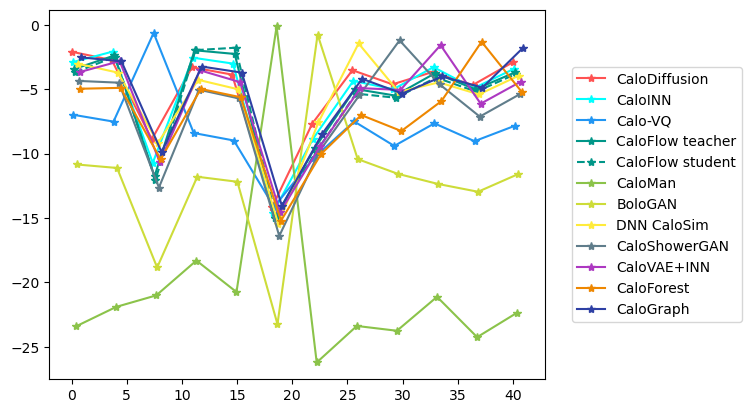

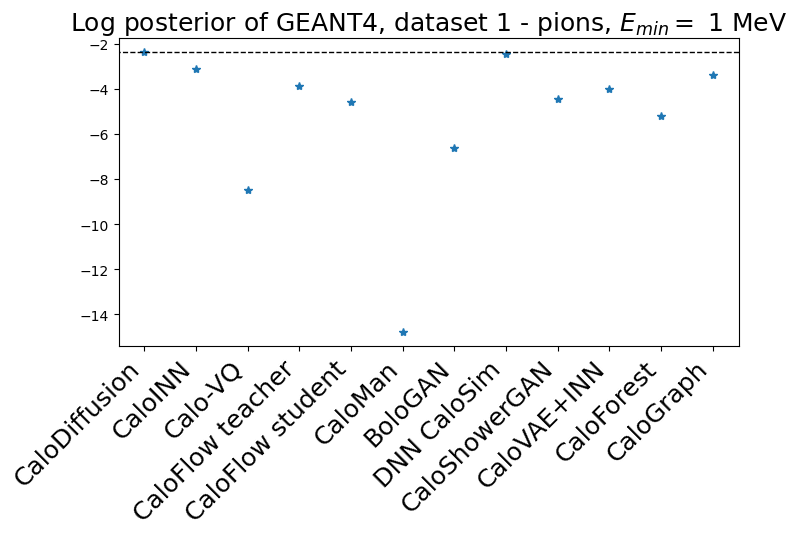

CaloDiffusion            log posterior:    -2.3790,    place:  1
CaloINN                  log posterior:    -3.1268,    place:  3
Calo-VQ                  log posterior:    -8.4622,    place: 11
CaloFlow teacher         log posterior:    -3.8755,    place:  5
CaloFlow student         log posterior:    -4.5884,    place:  8
CaloMan                  log posterior:   -14.8080,    place: 12
BoloGAN                  log posterior:    -6.6292,    place: 10
DNN CaloSim              log posterior:    -2.4481,    place:  2
CaloShowerGAN            log posterior:    -4.4420,    place:  7
CaloVAE+INN              log posterior:    -4.0114,    place:  6
CaloForest               log posterior:    -5.2085,    place:  9
CaloGraph                log posterior:    -3.3570,    place:  4

  - - - -  

model architecture 
DNN(
  (inputlayer): Linear(in_features=534, out_features=2048, bias=True)
  (outputlayer): Linear(in_features=2048, out_features=12, bias=True)
  (layers): Sequential(
    (0): Linear(i

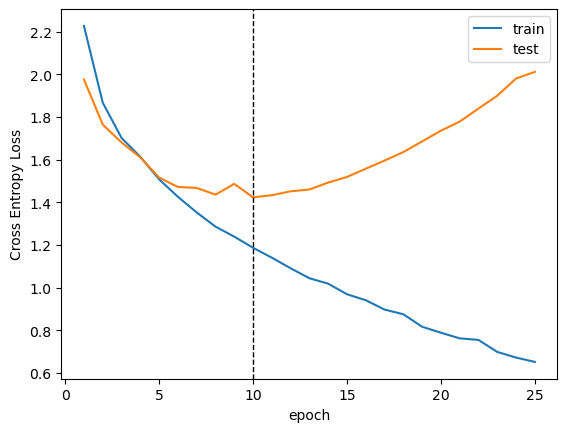

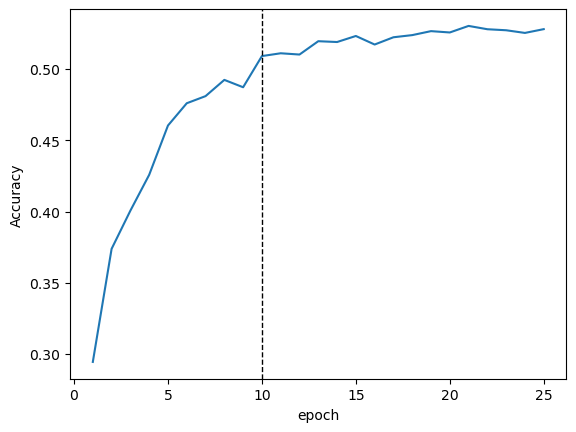

Model multiclass_weights_1-pion_ensemble_min1_6.pt loaded
Evaluation loss 1.4233389891792998, accuracy 0.509075
preds shape (240000, 13)
preds shape (120800, 13)
Accuracy of model 0, which is CaloDiffusion is 0.20115.
Accuracy of model 1, which is CaloINN is 0.19955.
Accuracy of model 2, which is Calo-VQ is 0.83895.
Accuracy of model 3, which is CaloFlow teacher is 0.198.
Accuracy of model 4, which is CaloFlow student is 0.38505.
Accuracy of model 5, which is CaloMan is 0.96185.
Accuracy of model 6, which is BoloGAN is 0.6523.
Accuracy of model 7, which is DNN CaloSim is 0.44855.
Accuracy of model 8, which is CaloShowerGAN is 0.6664.
Accuracy of model 9, which is CaloVAE+INN is 0.49125.
Accuracy of model 10, which is CaloForest is 0.6711.
Accuracy of model 11, which is CaloGraph is 0.39475.
class 0 has maximum posterior in class 0
class 1 has maximum posterior in class 1
class 2 has maximum posterior in class 2
class 3 has maximum posterior in class 3
class 4 has maximum posterior in c

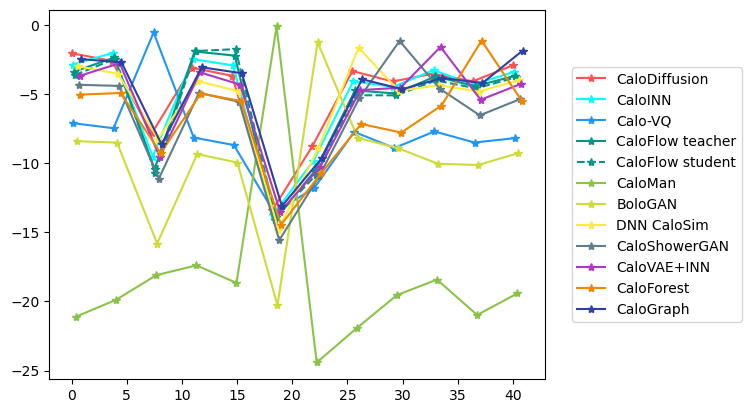

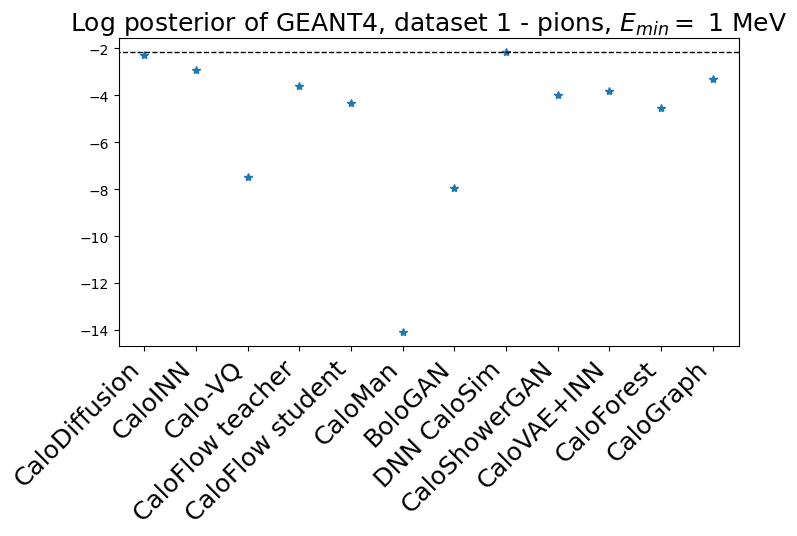

CaloDiffusion            log posterior:    -2.2903,    place:  2
CaloINN                  log posterior:    -2.9234,    place:  3
Calo-VQ                  log posterior:    -7.4860,    place: 10
CaloFlow teacher         log posterior:    -3.5911,    place:  5
CaloFlow student         log posterior:    -4.3106,    place:  8
CaloMan                  log posterior:   -14.1037,    place: 12
BoloGAN                  log posterior:    -7.9416,    place: 11
DNN CaloSim              log posterior:    -2.1760,    place:  1
CaloShowerGAN            log posterior:    -3.9846,    place:  7
CaloVAE+INN              log posterior:    -3.8283,    place:  6
CaloForest               log posterior:    -4.5349,    place:  9
CaloGraph                log posterior:    -3.3192,    place:  4

  - - - -  

model architecture 
DNN(
  (inputlayer): Linear(in_features=534, out_features=2048, bias=True)
  (outputlayer): Linear(in_features=2048, out_features=12, bias=True)
  (layers): Sequential(
    (0): Linear(i

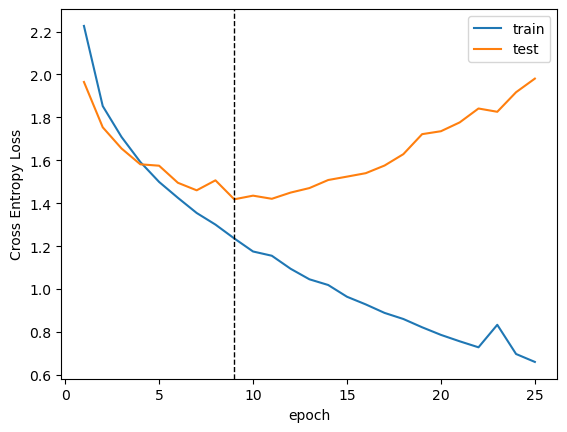

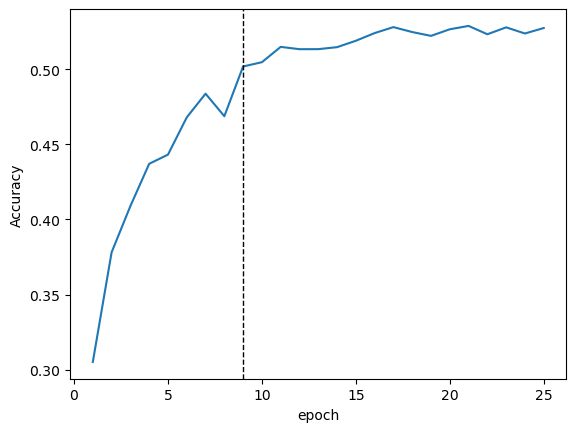

Model multiclass_weights_1-pion_ensemble_min1_7.pt loaded
Evaluation loss 1.418300845284025, accuracy 0.501825
preds shape (240000, 13)
preds shape (120800, 13)
Accuracy of model 0, which is CaloDiffusion is 0.2361.
Accuracy of model 1, which is CaloINN is 0.1229.
Accuracy of model 2, which is Calo-VQ is 0.86495.
Accuracy of model 3, which is CaloFlow teacher is 0.16315.
Accuracy of model 4, which is CaloFlow student is 0.351.
Accuracy of model 5, which is CaloMan is 0.9494.
Accuracy of model 6, which is BoloGAN is 0.70905.
Accuracy of model 7, which is DNN CaloSim is 0.5262.
Accuracy of model 8, which is CaloShowerGAN is 0.5497.
Accuracy of model 9, which is CaloVAE+INN is 0.45255.
Accuracy of model 10, which is CaloForest is 0.6519.
Accuracy of model 11, which is CaloGraph is 0.445.
class 0 has maximum posterior in class 0
class 1 has maximum posterior in class 1
class 2 has maximum posterior in class 2
class 3 has maximum posterior in class 3
class 4 has maximum posterior in class 4

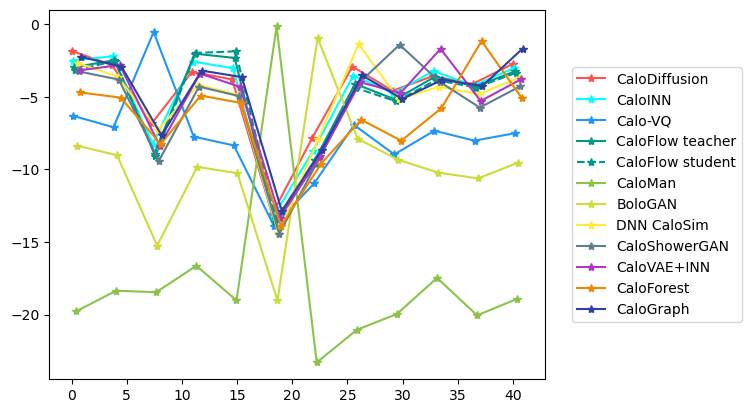

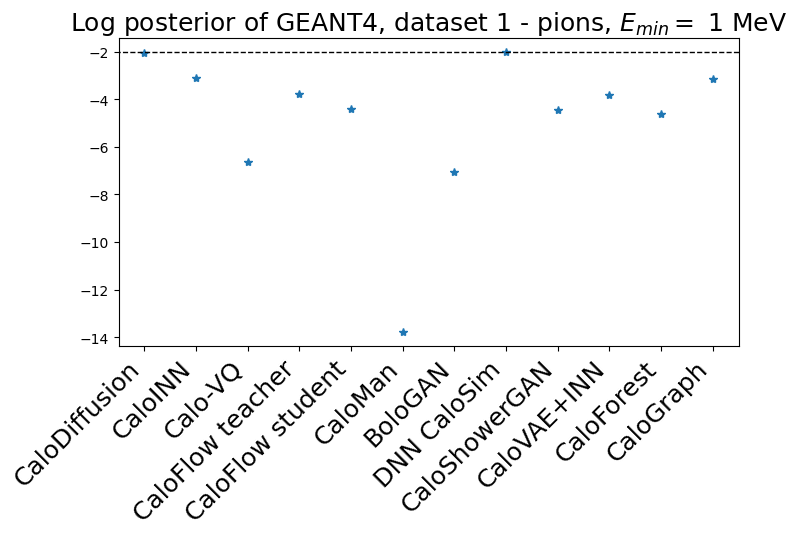

CaloDiffusion            log posterior:    -2.0761,    place:  2
CaloINN                  log posterior:    -3.1057,    place:  3
Calo-VQ                  log posterior:    -6.6229,    place: 10
CaloFlow teacher         log posterior:    -3.7683,    place:  5
CaloFlow student         log posterior:    -4.4277,    place:  7
CaloMan                  log posterior:   -13.7974,    place: 12
BoloGAN                  log posterior:    -7.0778,    place: 11
DNN CaloSim              log posterior:    -2.0395,    place:  1
CaloShowerGAN            log posterior:    -4.4742,    place:  8
CaloVAE+INN              log posterior:    -3.8341,    place:  6
CaloForest               log posterior:    -4.6227,    place:  9
CaloGraph                log posterior:    -3.1458,    place:  4

  - - - -  

model architecture 
DNN(
  (inputlayer): Linear(in_features=534, out_features=2048, bias=True)
  (outputlayer): Linear(in_features=2048, out_features=12, bias=True)
  (layers): Sequential(
    (0): Linear(i

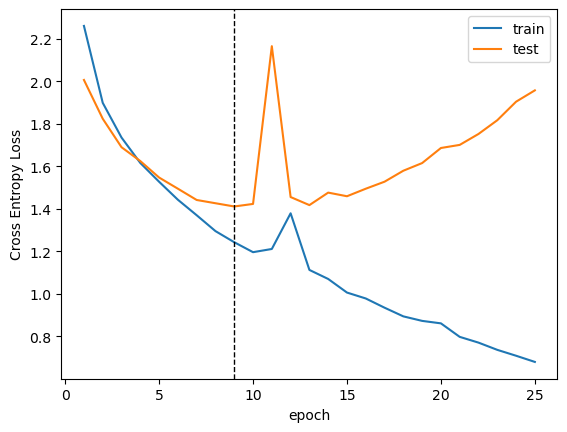

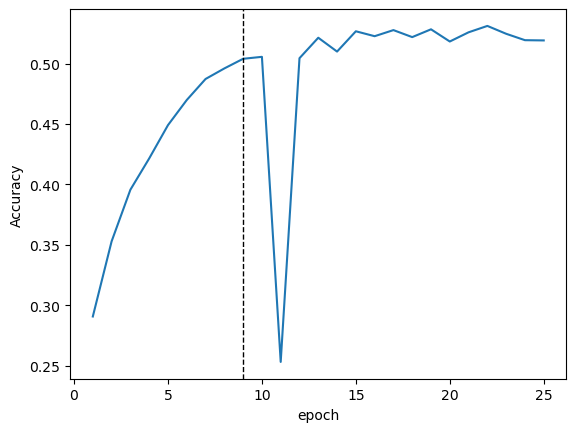

Model multiclass_weights_1-pion_ensemble_min1_8.pt loaded
Evaluation loss 1.4115202600239323, accuracy 0.5039625
preds shape (240000, 13)
preds shape (120800, 13)
Accuracy of model 0, which is CaloDiffusion is 0.17505.
Accuracy of model 1, which is CaloINN is 0.22275.
Accuracy of model 2, which is Calo-VQ is 0.81215.
Accuracy of model 3, which is CaloFlow teacher is 0.2046.
Accuracy of model 4, which is CaloFlow student is 0.45615.
Accuracy of model 5, which is CaloMan is 0.95725.
Accuracy of model 6, which is BoloGAN is 0.7105.
Accuracy of model 7, which is DNN CaloSim is 0.44355.
Accuracy of model 8, which is CaloShowerGAN is 0.6445.
Accuracy of model 9, which is CaloVAE+INN is 0.3644.
Accuracy of model 10, which is CaloForest is 0.66425.
Accuracy of model 11, which is CaloGraph is 0.3924.
class 0 has maximum posterior in class 0
class 1 has maximum posterior in class 1
class 2 has maximum posterior in class 2
class 3 has maximum posterior in class 3
class 4 has maximum posterior in 

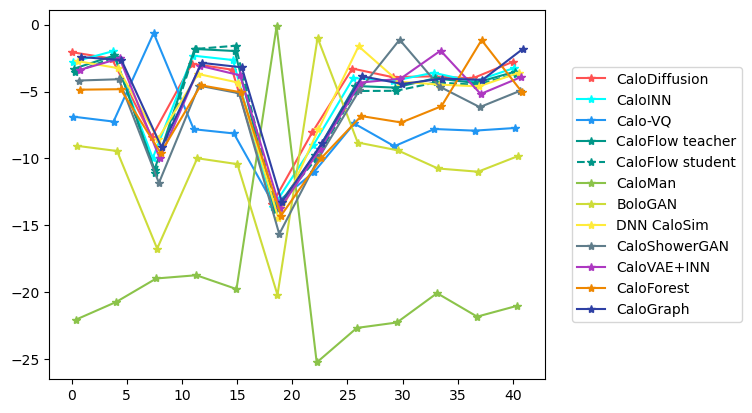

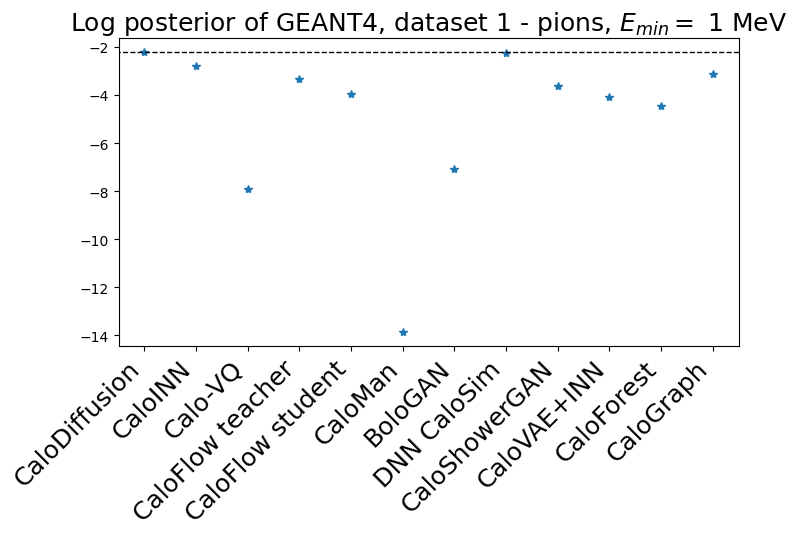

CaloDiffusion            log posterior:    -2.2262,    place:  1
CaloINN                  log posterior:    -2.7754,    place:  3
Calo-VQ                  log posterior:    -7.9217,    place: 11
CaloFlow teacher         log posterior:    -3.3433,    place:  5
CaloFlow student         log posterior:    -3.9493,    place:  7
CaloMan                  log posterior:   -13.8805,    place: 12
BoloGAN                  log posterior:    -7.0581,    place: 10
DNN CaloSim              log posterior:    -2.2584,    place:  2
CaloShowerGAN            log posterior:    -3.6418,    place:  6
CaloVAE+INN              log posterior:    -4.0697,    place:  8
CaloForest               log posterior:    -4.4516,    place:  9
CaloGraph                log posterior:    -3.1029,    place:  4

  - - - -  

model architecture 
DNN(
  (inputlayer): Linear(in_features=534, out_features=2048, bias=True)
  (outputlayer): Linear(in_features=2048, out_features=12, bias=True)
  (layers): Sequential(
    (0): Linear(i

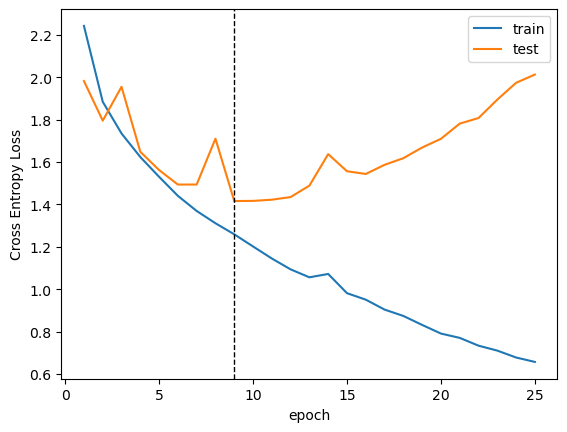

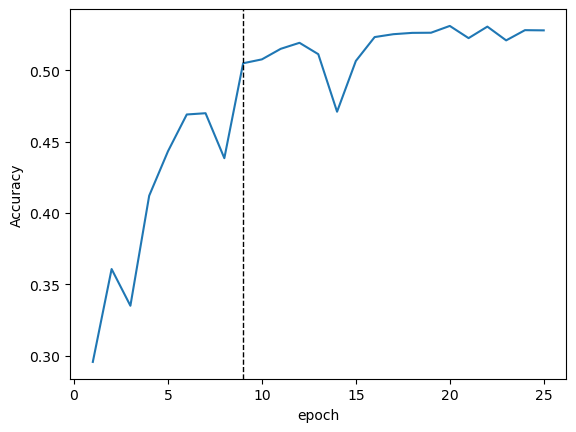

Model multiclass_weights_1-pion_ensemble_min1_9.pt loaded
Evaluation loss 1.4158690282317146, accuracy 0.504975
preds shape (240000, 13)
preds shape (120800, 13)
Accuracy of model 0, which is CaloDiffusion is 0.22495.
Accuracy of model 1, which is CaloINN is 0.18415.
Accuracy of model 2, which is Calo-VQ is 0.84755.
Accuracy of model 3, which is CaloFlow teacher is 0.2419.
Accuracy of model 4, which is CaloFlow student is 0.3311.
Accuracy of model 5, which is CaloMan is 0.96495.
Accuracy of model 6, which is BoloGAN is 0.7127.
Accuracy of model 7, which is DNN CaloSim is 0.40125.
Accuracy of model 8, which is CaloShowerGAN is 0.58805.
Accuracy of model 9, which is CaloVAE+INN is 0.4659.
Accuracy of model 10, which is CaloForest is 0.6556.
Accuracy of model 11, which is CaloGraph is 0.4416.
class 0 has maximum posterior in class 0
class 1 has maximum posterior in class 1
class 2 has maximum posterior in class 2
class 3 has maximum posterior in class 3
class 4 has maximum posterior in cl

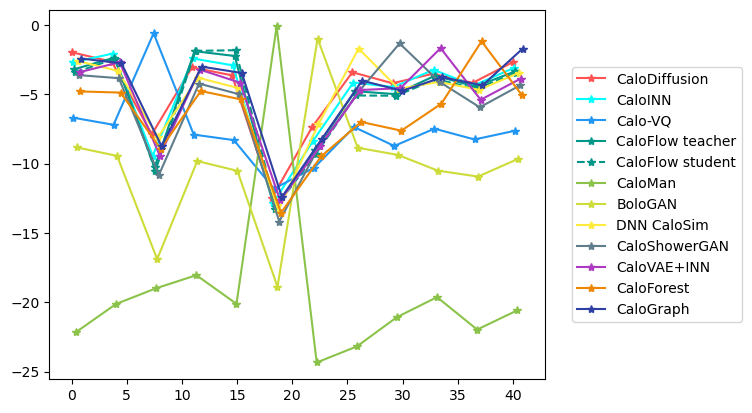

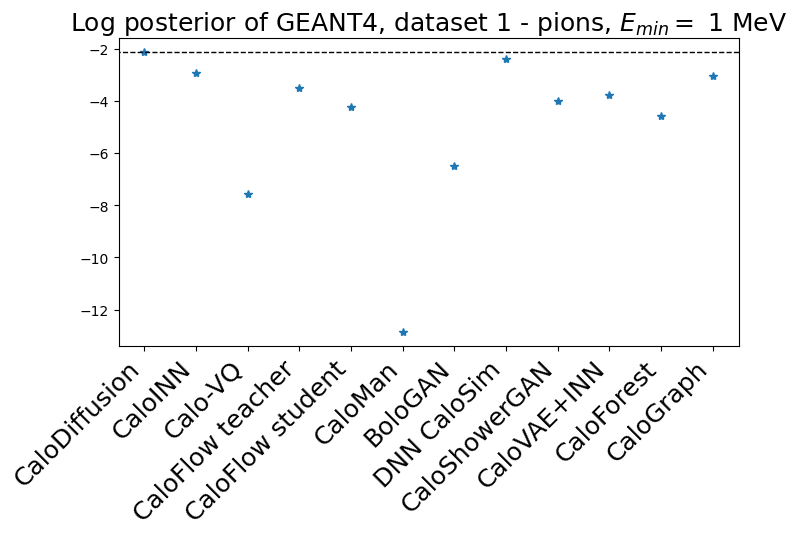

CaloDiffusion            log posterior:    -2.1391,    place:  1
CaloINN                  log posterior:    -2.9375,    place:  3
Calo-VQ                  log posterior:    -7.5769,    place: 11
CaloFlow teacher         log posterior:    -3.5019,    place:  5
CaloFlow student         log posterior:    -4.2304,    place:  8
CaloMan                  log posterior:   -12.8817,    place: 12
BoloGAN                  log posterior:    -6.4950,    place: 10
DNN CaloSim              log posterior:    -2.4030,    place:  2
CaloShowerGAN            log posterior:    -4.0085,    place:  7
CaloVAE+INN              log posterior:    -3.7768,    place:  6
CaloForest               log posterior:    -4.5825,    place:  9
CaloGraph                log posterior:    -3.0263,    place:  4

  - - - -  

done


In [16]:
num_epoch = 25
num_runs = 10
DS = '1-pion_ensemble_min1'

only_eval = False

accuracy = []
train_losses = []
eval_losses = []

preds_models = []
preds_truth = []

preds_by_model = []
log_post_by_model = []
log_truth = []
final_accuracy = []

for run_nr in range(num_runs):
    dense_net = DNN(num_layer=2, num_hidden=2048, input_dim=534, output_dim=num_ds1_pions)
    dense_net.to(device)

    print("model architecture ")
    print(dense_net)
    total_parameters = sum(p.numel() for p in dense_net.parameters() if p.requires_grad)
    print(f"Model has {total_parameters:d} trainable parameters")

    criterion = nn.NLLLoss(reduction='none')
    optimizer = torch.optim.Adam(dense_net.parameters(), lr=1e-3)
    
    best_val_loss = 1e6
    
    if not only_eval:

        accuracy.append([])
        _, acc = evaluate(dense_net, test_dataloader, criterion)
        accuracy[-1].append(acc.mean())

        train_losses.append([])
        eval_losses.append([])

        for epoch in range(num_epoch):
            print(f"Epoch {epoch+1} / {num_epoch} of run {run_nr+1} / {num_runs}")
            train_loss = train(dense_net, train_dataloader, optimizer, criterion)
            eval_loss, acc = evaluate(dense_net, test_dataloader, criterion)
            train_losses[-1].append(train_loss.mean())
            eval_losses[-1].append(eval_loss.mean())
            accuracy[-1].append(acc.mean())
            if eval_loss.mean() < best_val_loss:
                save_weights(dense_net, DS, run_nr)
                best_val_loss = eval_loss.mean()
            print("   - - - - -   ")
    
    print("evaluating this run:")
    if not only_eval:
        epochs = np.arange(num_epoch) + 1
        plt.plot(epochs, train_losses[-1], label='train')
        plt.plot(epochs, eval_losses[-1], label='test')
        plt.ylabel("Cross Entropy Loss")
        plt.xlabel("epoch")
        plt.axvline(x = np.argmin(eval_losses[-1])+1, color = 'k', linestyle='dashed', linewidth=1)
        plt.legend()
        plt.show()

        plt.plot(epochs, accuracy[-1][1:])
        plt.axvline(x = np.argmin(eval_losses[-1])+1, color = 'k', linestyle='dashed', linewidth=1)
        plt.ylabel("Accuracy")
        plt.xlabel("epoch")
        plt.show()

    load_weights(dense_net, device, DS, run_nr)
    _ = evaluate(dense_net, test_dataloader, criterion)
    preds_models.append(get_prediction(dense_net, test_dataloader))
    preds_truth.append(get_prediction(dense_net, truth_dataloader))


    preds_by_model.append([])
    log_post_by_model.append([])
    for i in range(num_ds1_pions):
        preds_by_model[-1].append(preds_models[-1][preds_models[-1][:, -1] == i][:, :-1])
        log_post_by_model[-1].append(log_posterior(preds_by_model[-1][-1]))

    preds_truth[-1] = preds_truth[-1][:, :-1]
    log_truth.append(log_posterior(preds_truth[-1]))

    final_accuracy.append([])
    for i in range(num_ds1_pions):
        final_accuracy[-1].append(find_accuracy(preds_by_model[-1][i], i))
        print(f"Accuracy of model {i}, which is {id_dict[conversion_to_submission_id[i]]} is {final_accuracy[-1][i].mean()}.")


    for i in range(num_ds1_pions):
        plt.plot(np.linspace(0, 40, num_ds1_pions)+0.08*i, log_post_by_model[-1][i], '*', label=id_dict[conversion_to_submission_id[i]], **kwargs_dict[conversion_to_submission_id[i]])
        print(f"class {i} has maximum posterior in class {np.argmax(log_post_by_model[-1][i])}")

    plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left")
    plt.show()
    
    plt.figure(figsize=(8,4))
    plt.plot(np.arange(num_ds1_pions), log_truth[-1], '*')
    plt.hlines(np.max(log_truth[-1]), xmin=-1, xmax=num_ds1_pions, color = 'k', linestyle='dashed', linewidth=1)
    plt.xlim(-0.5, num_ds1_pions-0.5)
    plt.title(f"Log posterior of GEANT4, dataset 1 - pions, $E_{{min}}=$ {MIN_ENERGY} MeV", fontsize=FS)
    plt.gca().set_xticks(np.arange(num_ds1_pions))
    plt.gca().set_xticklabels([id_dict[conversion_to_submission_id[i]] for i in range(num_ds1_pions)], rotation=45, ha='right', fontsize=FS)
    plt.show()

    score_order = np.argsort(np.argsort(-log_truth[-1]))+1
    for i in range(num_ds1_pions):
        print(f"{id_dict[conversion_to_submission_id[i]]:24s} log posterior:   {log_truth[-1][i]:8.4f},    place: {score_order[i]:2d}")    
        
    print("\n  - - - -  \n")
log_post_by_model = np.array(log_post_by_model)
log_truth = np.array(log_truth)
final_accuracy = np.array(final_accuracy)
print("done")

Accuracy of model  0, which is CaloDiffusion             is 0.1956 +/- 0.0302.
Accuracy of model  1, which is CaloINN                   is 0.1868 +/- 0.0291.
Accuracy of model  2, which is Calo-VQ                   is 0.8246 +/- 0.0258.
Accuracy of model  3, which is CaloFlow teacher          is 0.2078 +/- 0.0269.
Accuracy of model  4, which is CaloFlow student          is 0.3808 +/- 0.0554.
Accuracy of model  5, which is CaloMan                   is 0.9628 +/- 0.0086.
Accuracy of model  6, which is BoloGAN                   is 0.7194 +/- 0.0321.
Accuracy of model  7, which is DNN CaloSim               is 0.4627 +/- 0.0423.
Accuracy of model  8, which is CaloShowerGAN             is 0.6011 +/- 0.0386.
Accuracy of model  9, which is CaloVAE+INN               is 0.4880 +/- 0.0528.
Accuracy of model 10, which is CaloForest                is 0.6467 +/- 0.0198.
Accuracy of model 11, which is CaloGraph                 is 0.4025 +/- 0.0260.




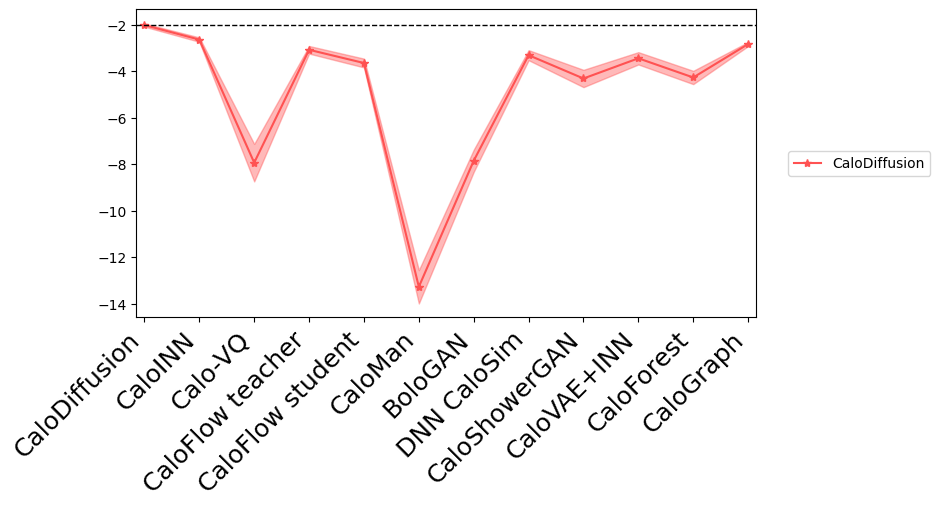

class 0 has maximum posterior in class 0


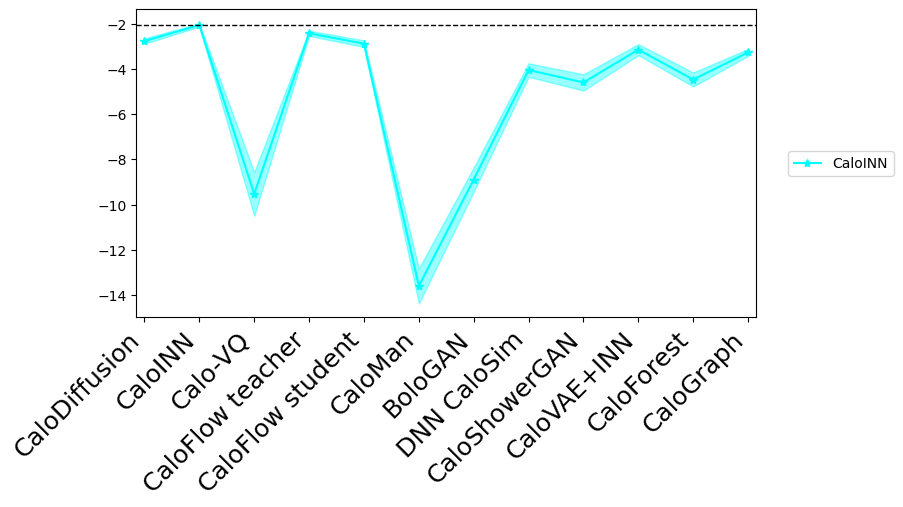

class 1 has maximum posterior in class 1


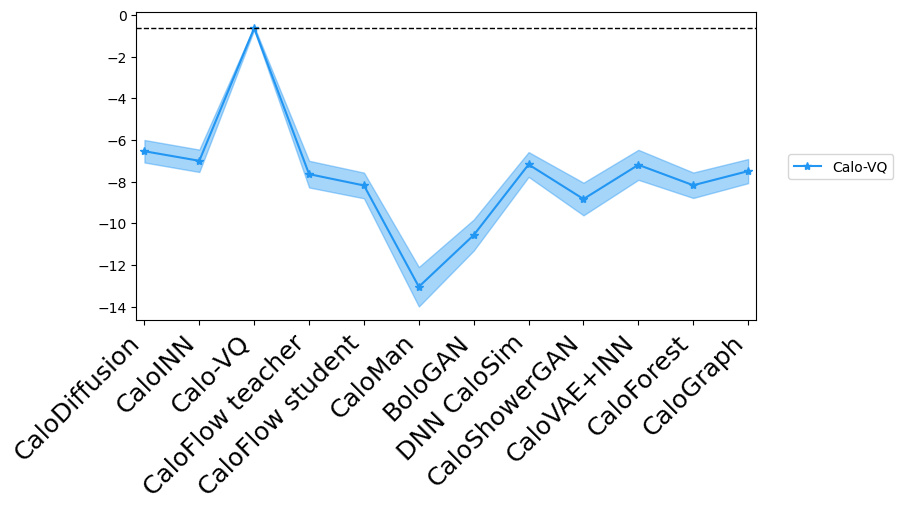

class 2 has maximum posterior in class 2


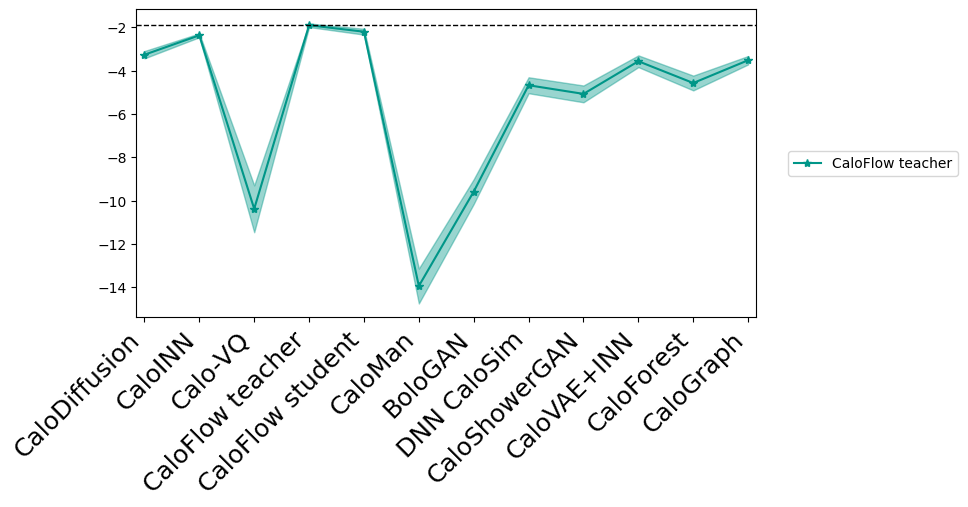

class 3 has maximum posterior in class 3


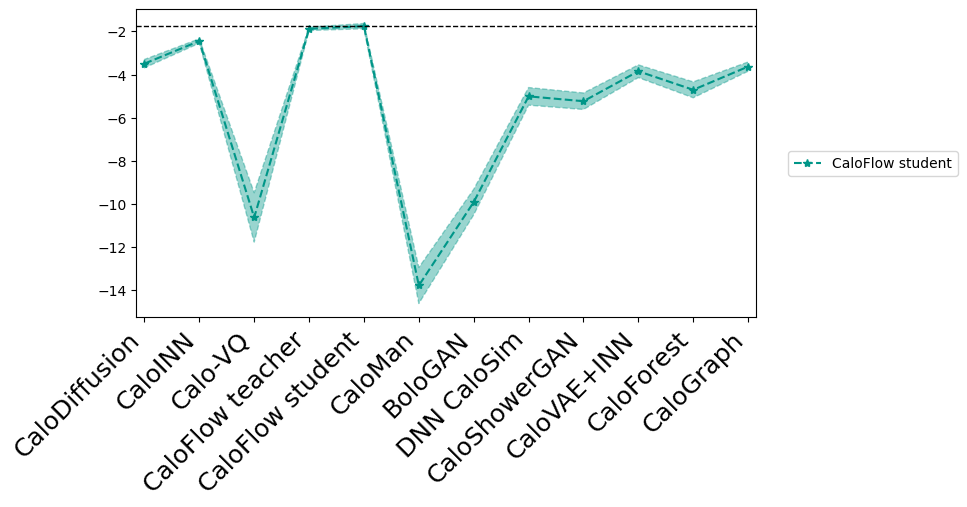

class 4 has maximum posterior in class 4


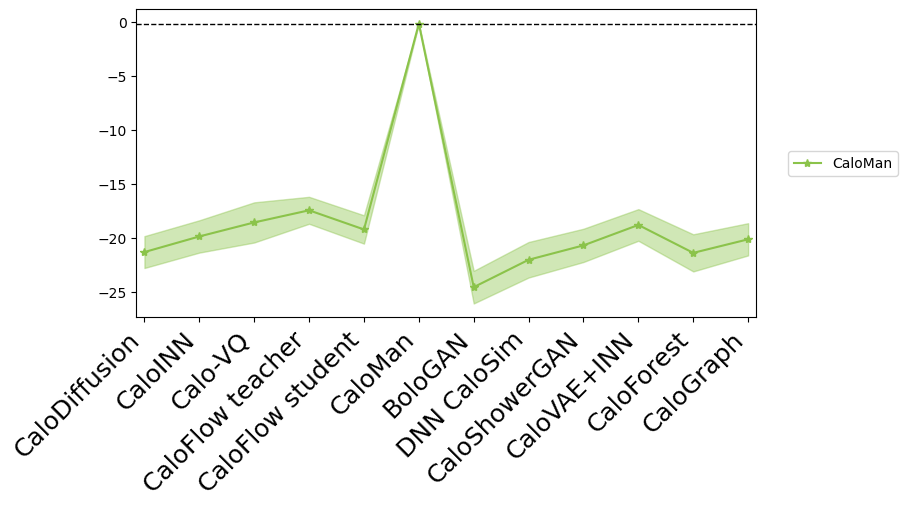

class 5 has maximum posterior in class 5


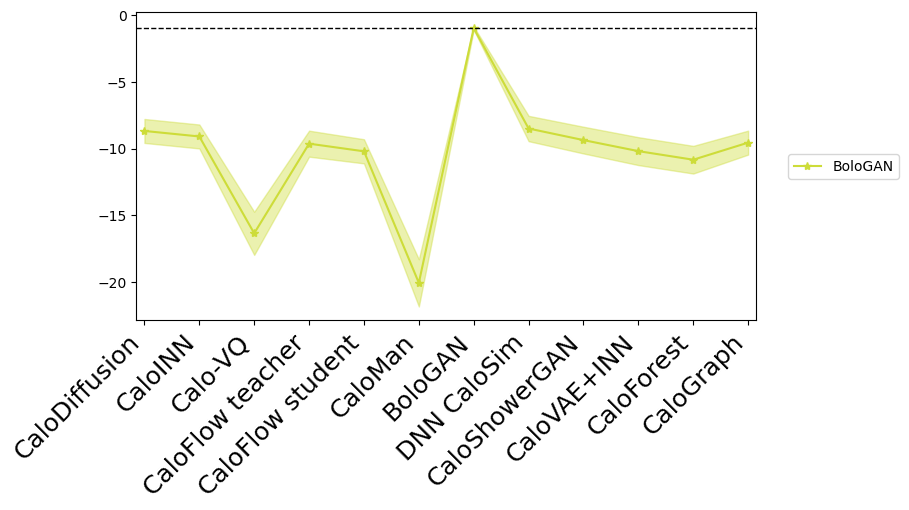

class 6 has maximum posterior in class 6


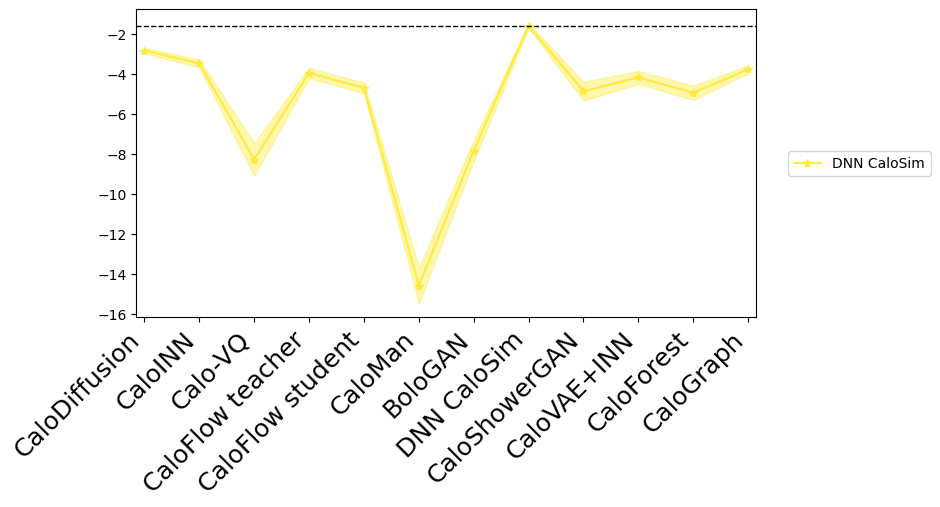

class 7 has maximum posterior in class 7


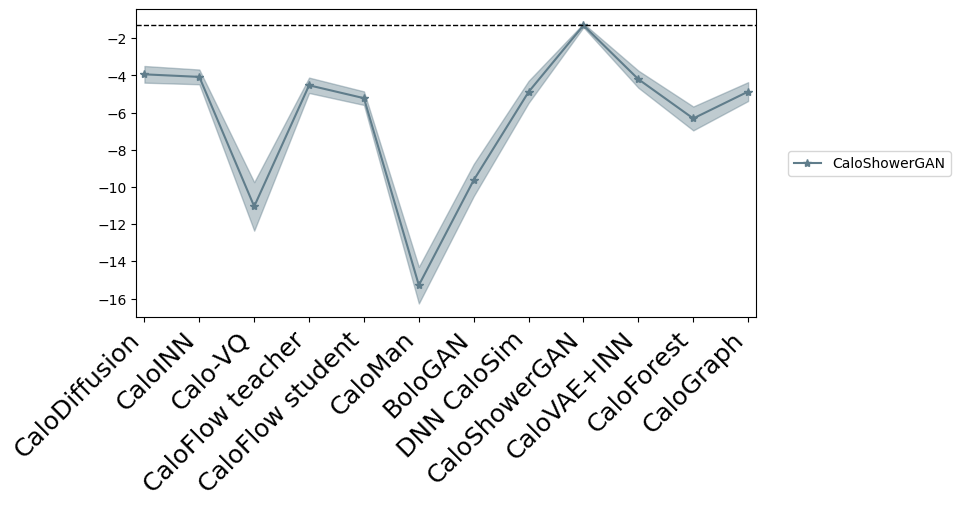

class 8 has maximum posterior in class 8


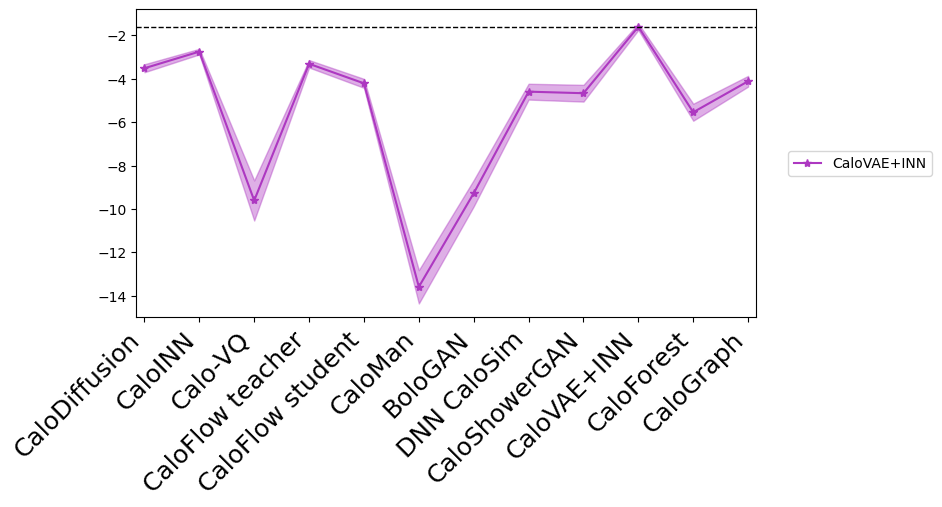

class 9 has maximum posterior in class 9


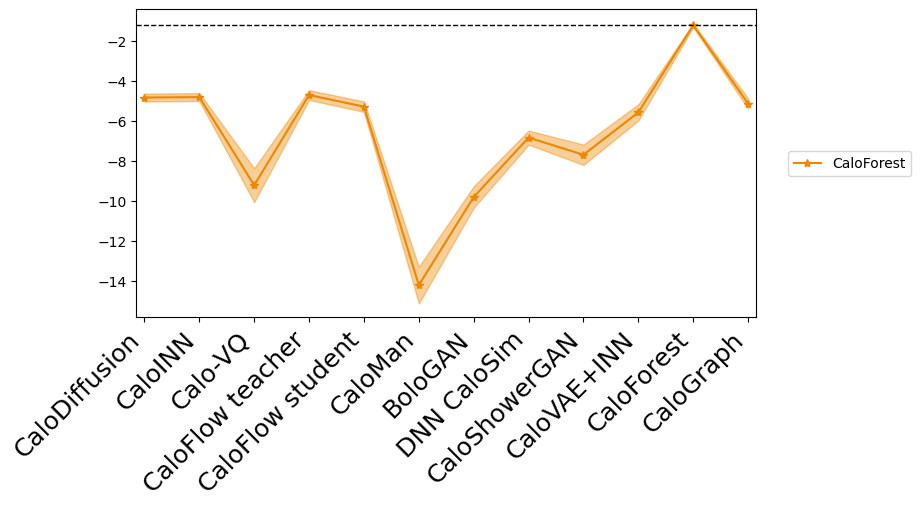

class 10 has maximum posterior in class 10


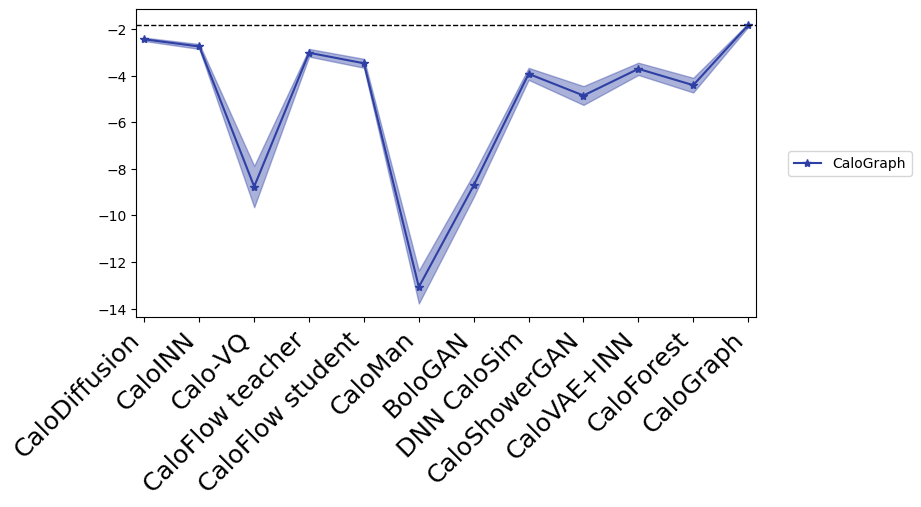

class 11 has maximum posterior in class 11


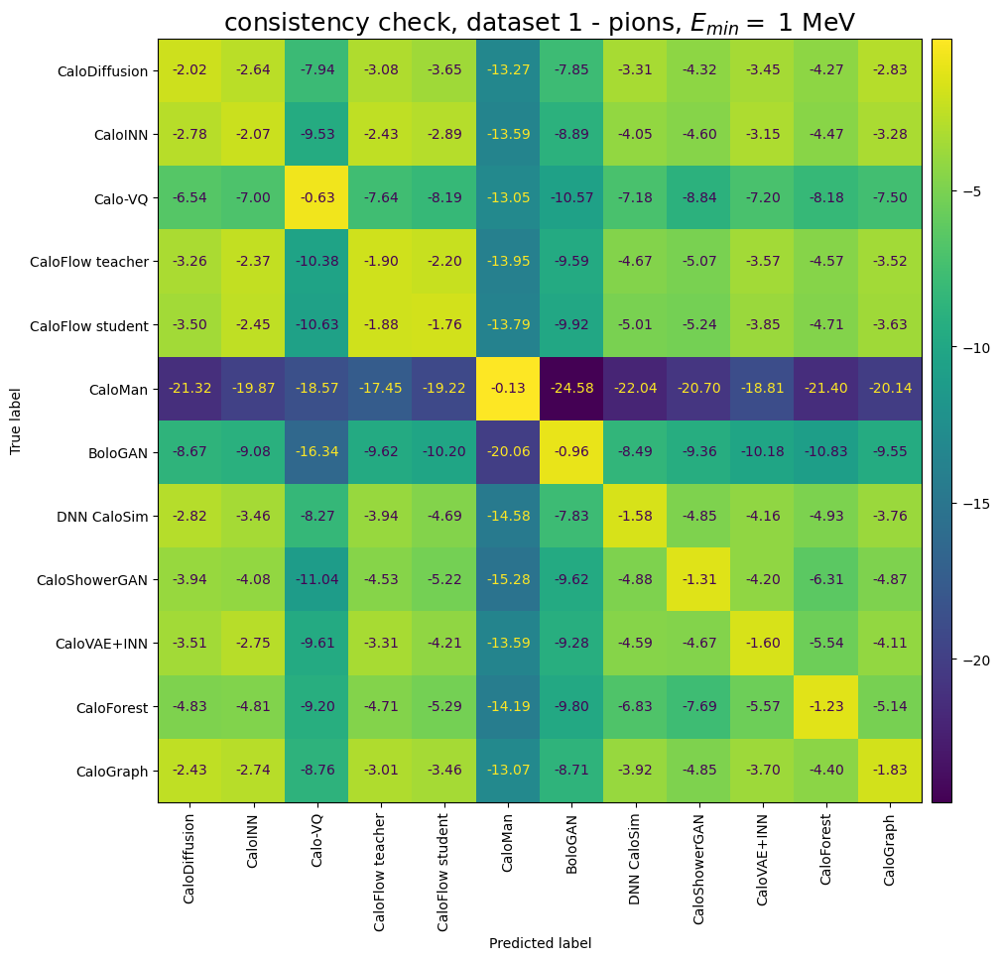

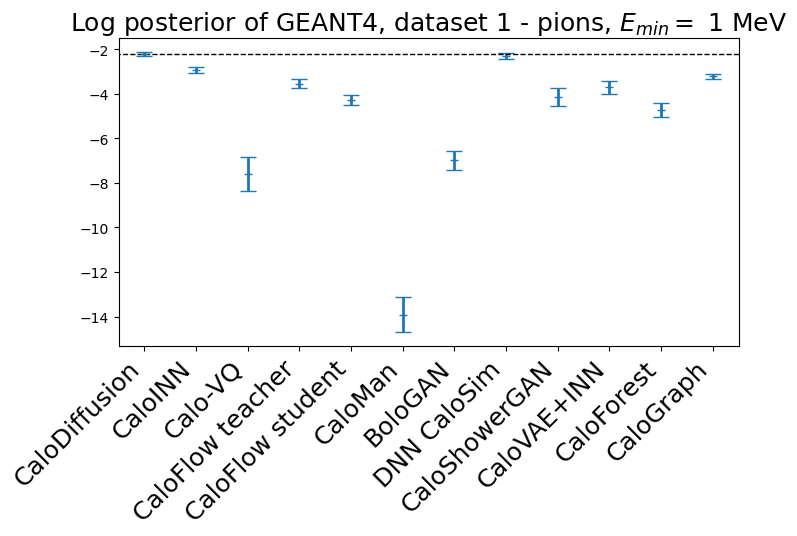

CaloDiffusion            log posterior:    -2.2290 +/- 0.0814,    place:  1
CaloINN                  log posterior:    -2.9438 +/- 0.1245,    place:  3
Calo-VQ                  log posterior:    -7.6106 +/- 0.7637,    place: 11
CaloFlow teacher         log posterior:    -3.5411 +/- 0.2152,    place:  5
CaloFlow student         log posterior:    -4.2637 +/- 0.2211,    place:  8
CaloMan                  log posterior:   -13.9230 +/- 0.7912,    place: 12
BoloGAN                  log posterior:    -6.9912 +/- 0.4358,    place: 10
DNN CaloSim              log posterior:    -2.2982 +/- 0.1249,    place:  2
CaloShowerGAN            log posterior:    -4.1483 +/- 0.3936,    place:  7
CaloVAE+INN              log posterior:    -3.7183 +/- 0.2855,    place:  6
CaloForest               log posterior:    -4.7325 +/- 0.3211,    place:  9
CaloGraph                log posterior:    -3.2103 +/- 0.1132,    place:  4


In [17]:
run_accuracy_means = final_accuracy.mean(axis=-1)

for i in range(num_ds1_pions):
    print(f"Accuracy of model {i:2d}, which is {id_dict[conversion_to_submission_id[i]]:25s} is {run_accuracy_means[:,i].mean():.4f} +/- {run_accuracy_means[:,i].std():.4f}.")

print('\n')
for i in range(num_ds1_pions):
    plt.figure(figsize=(8,4))
    plt.plot(np.linspace(0, 3*num_ds1_pions + 1, num_ds1_pions), log_post_by_model.mean(axis=0)[i], '*', label=id_dict[conversion_to_submission_id[i]], **kwargs_dict[conversion_to_submission_id[i]])  # +(1./num_ds1_pions)*i
    plt.fill_between(np.linspace(0, 3*num_ds1_pions + 1, num_ds1_pions), log_post_by_model.mean(axis=0)[i]-log_post_by_model.std(axis=0)[i], log_post_by_model.mean(axis=0)[i]+log_post_by_model.std(axis=0)[i], label='_please_dont', alpha=0.4, **kwargs_dict[conversion_to_submission_id[i]])
    
    plt.xlim(-0.5, 3*num_ds1_pions + 1.5) # 2.5
    plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left")
    plt.hlines(np.max(log_post_by_model.mean(axis=0)[i]), xmin=-0.5, xmax=3*num_ds1_pions + 1.5, color = 'k', linestyle='dashed', linewidth=1)
    plt.gca().set_xticks(np.linspace(0, 3*num_ds1_pions + 1, num_ds1_pions))
    plt.gca().set_xticklabels([id_dict[conversion_to_submission_id[i]] for i in range(num_ds1_pions)], rotation=45, ha='right', fontsize=FS)

    plt.savefig(f'results_fig/cls/ds1-pions_check_{i}_{MIN_ENERGY}.pdf', dpi=300, bbox_inches='tight')
    plt.show()
    print(f"class {i} has maximum posterior in class {np.argmax(log_post_by_model.mean(axis=0)[i])}")

plt.figure(figsize=(10,10))
disp = ConfusionMatrixDisplay(confusion_matrix=log_post_by_model.mean(axis=0), 
                              display_labels=[id_dict[conversion_to_submission_id[i]] for i in range(num_ds1_pions)])
disp.plot(xticks_rotation='vertical', ax=plt.gca(), colorbar=False, values_format=".2f")
plt.title(f"consistency check, dataset 1 - pions, $E_{{min}}=$ {MIN_ENERGY} MeV", fontsize=FS)
cax = plt.gcf().add_axes([plt.gca().get_position().x1+0.01,plt.gca().get_position().y0,0.02,plt.gca().get_position().height])
plt.colorbar(disp.im_,  cax=cax)
plt.savefig(f'results_fig/cls/ds1-pions_confusion_{MIN_ENERGY}.pdf', dpi=300, bbox_inches='tight')
plt.show()
    
    
plt.figure(figsize=(8,4))
plt.errorbar(np.arange(num_ds1_pions), log_truth.mean(axis=0), yerr=log_truth.std(axis=0), elinewidth=2, marker='_', capsize=6, linestyle='None')
plt.hlines(np.max(log_truth.mean(axis=0)), xmin=-1, xmax=num_ds1_pions, color = 'k', linestyle='dashed', linewidth=1)
plt.xlim(-0.5, num_ds1_pions-0.5)
plt.title(f"Log posterior of GEANT4, dataset 1 - pions, $E_{{min}}=$ {MIN_ENERGY} MeV", fontsize=FS)
plt.gca().set_xticks(np.arange(num_ds1_pions))
plt.gca().set_xticklabels([id_dict[conversion_to_submission_id[i]] for i in range(num_ds1_pions)], rotation=45, ha='right', fontsize=FS)
plt.savefig(f'results_fig/cls/ds1-pions_truth_{MIN_ENERGY}.pdf', dpi=300, bbox_inches='tight')
plt.show()

score_order = np.argsort(np.argsort(-log_truth.mean(axis=0)))+1
for i in range(num_ds1_pions):
    print(f"{id_dict[conversion_to_submission_id[i]]:24s} log posterior:   {log_truth.mean(axis=0)[i]:8.4f} +/- {log_truth.std(axis=0)[i]:6.4f},    place: {score_order[i]:2d}")

### HLF - dataset 2

working on ../scratch_CaloChallenge/data/Amram/ds2_1.hdf5 with id 1
Separation power of voxel distribution histogram: 0.01418650193932516


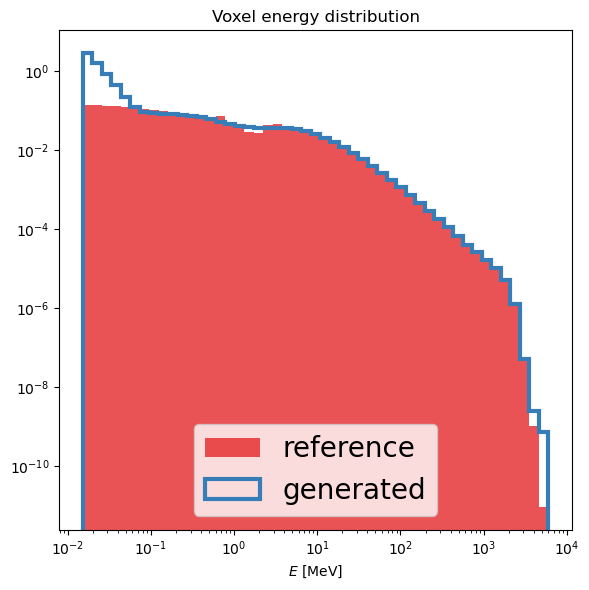

working on ../scratch_CaloChallenge/data/Buss/ds2_3.hdf5 with id 3
Separation power of voxel distribution histogram: 0.0011019914776107952


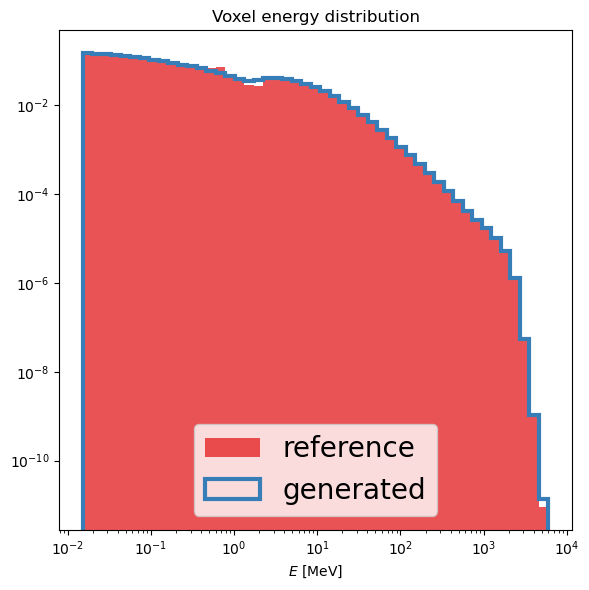

working on ../scratch_CaloChallenge/data/Favaro/ds2_4.hdf5 with id 4
Separation power of voxel distribution histogram: 0.0023109650439591327


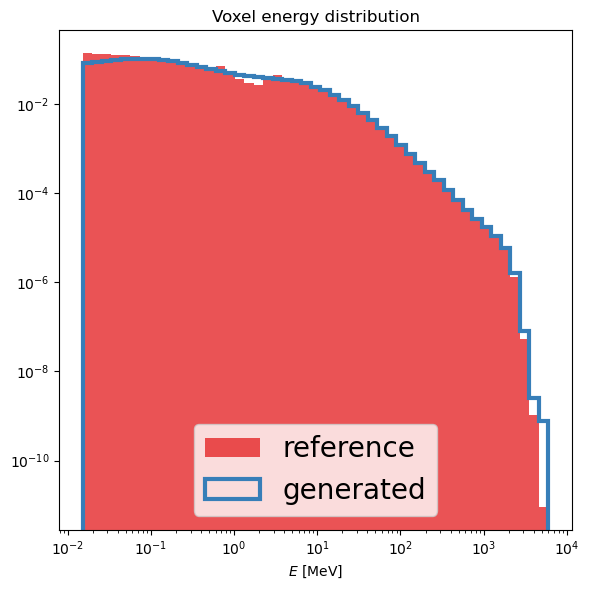

working on ../scratch_CaloChallenge/data/Kaech/ds2_5.hdf5 with id 5
Separation power of voxel distribution histogram: 0.004153756307454081


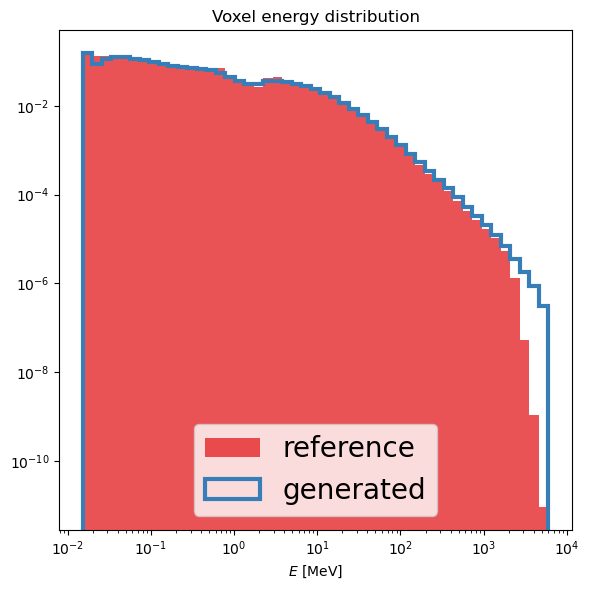

working on ../scratch_CaloChallenge/data/Liu/ds2_7.hdf5 with id 7
Separation power of voxel distribution histogram: 0.05153072445486436


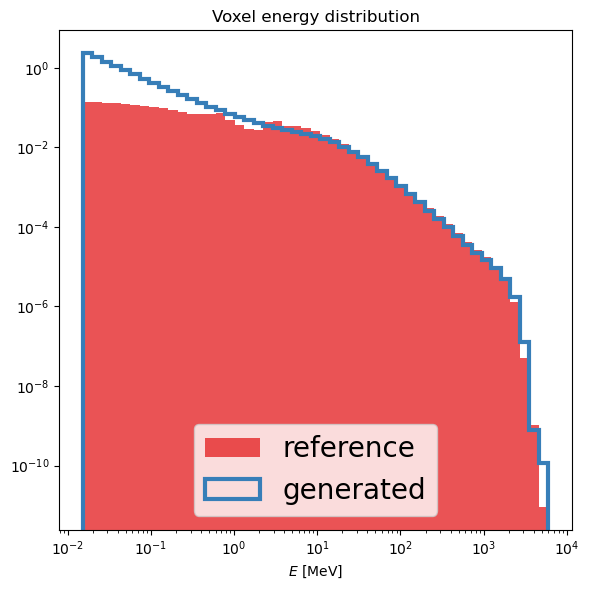

working on ../scratch_CaloChallenge/data/Mikuni/ds2_8.hdf5 with id 8
Separation power of voxel distribution histogram: 0.0038353453574560075


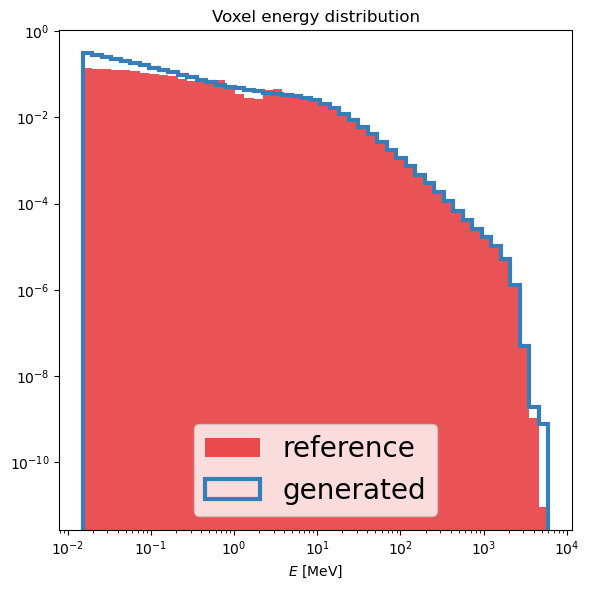

working on ../scratch_CaloChallenge/data/Mikuni/ds2_9.hdf5 with id 9
Separation power of voxel distribution histogram: 0.015039918013443091


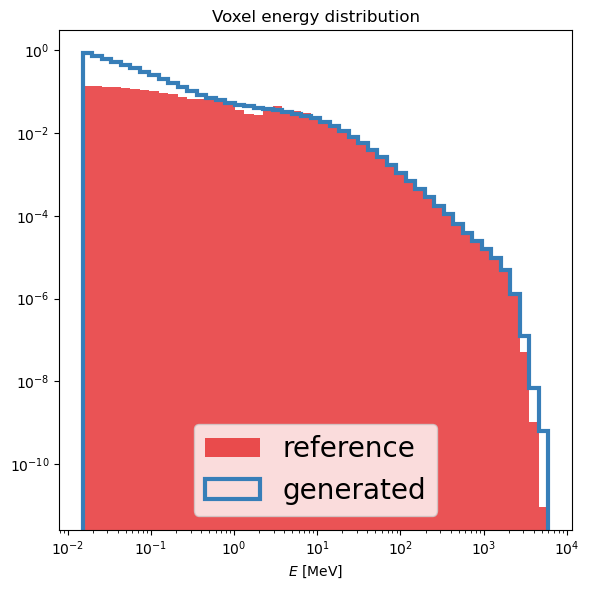

working on ../scratch_CaloChallenge/data/Mikuni/ds2_10.hdf5 with id 10
Separation power of voxel distribution histogram: 0.012263634108033739


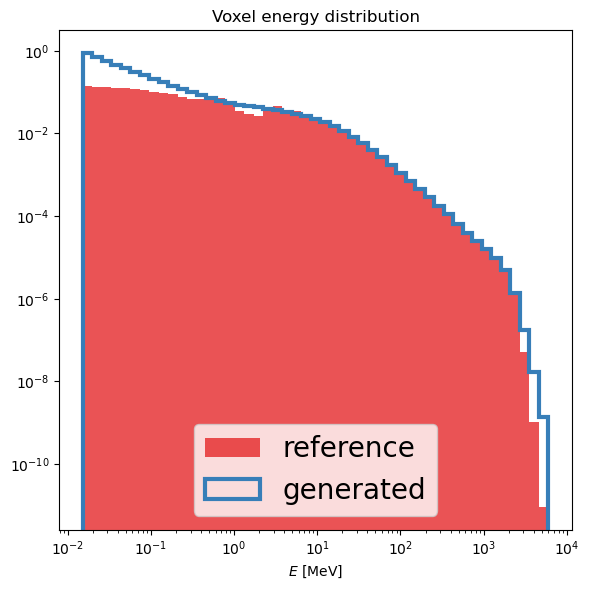

working on ../scratch_CaloChallenge/data/Pang/ds2_13.hdf5 with id 13
Separation power of voxel distribution histogram: 0.0004755089350177153


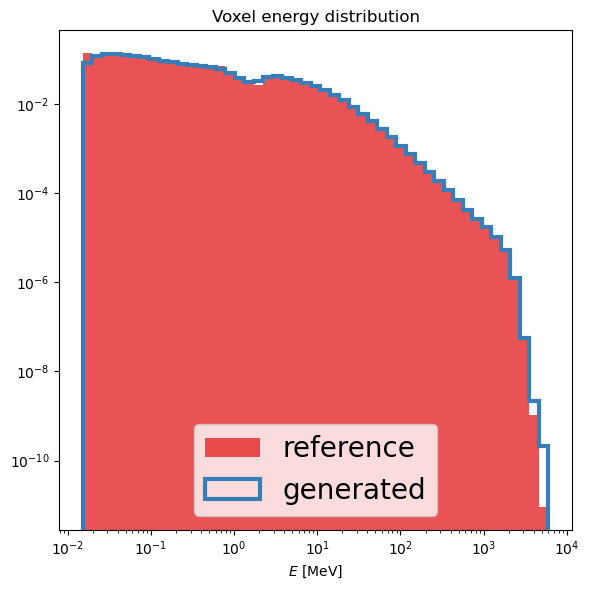

working on ../scratch_CaloChallenge/data/Pang/ds2_14.hdf5 with id 14
Separation power of voxel distribution histogram: 0.004356282931214033


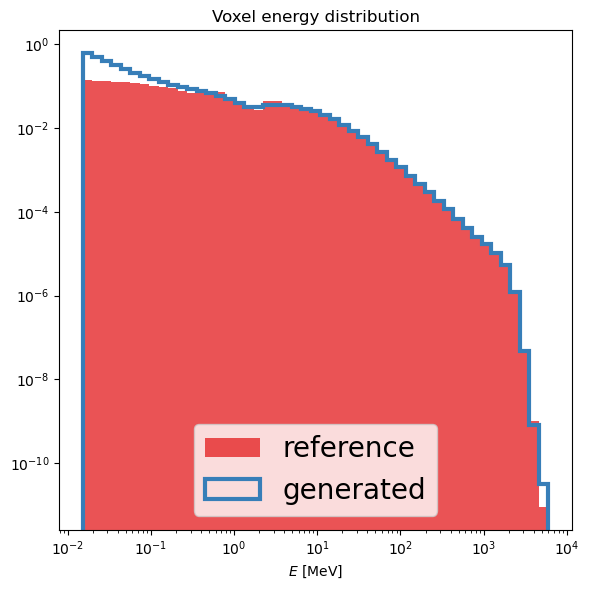

working on ../scratch_CaloChallenge/data/Pang/ds2_15.hdf5 with id 15
Separation power of voxel distribution histogram: 0.0024816391595814213


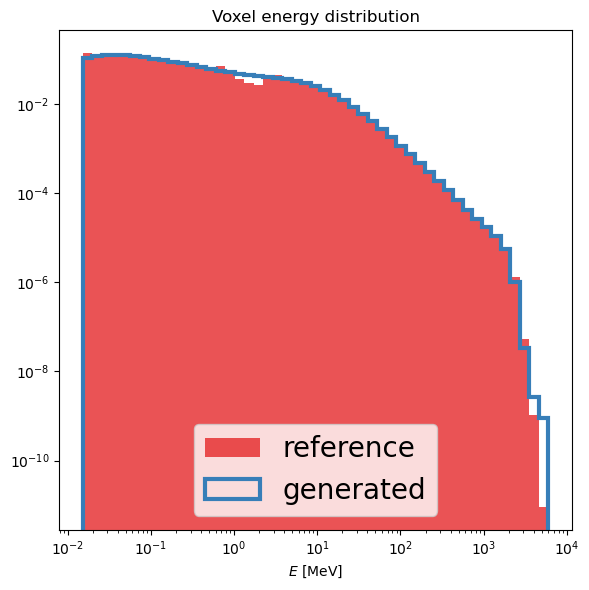

working on ../scratch_CaloChallenge/data/Cardoso/ds2_32.hdf5 with id 32
Separation power of voxel distribution histogram: 0.0013833327151891587


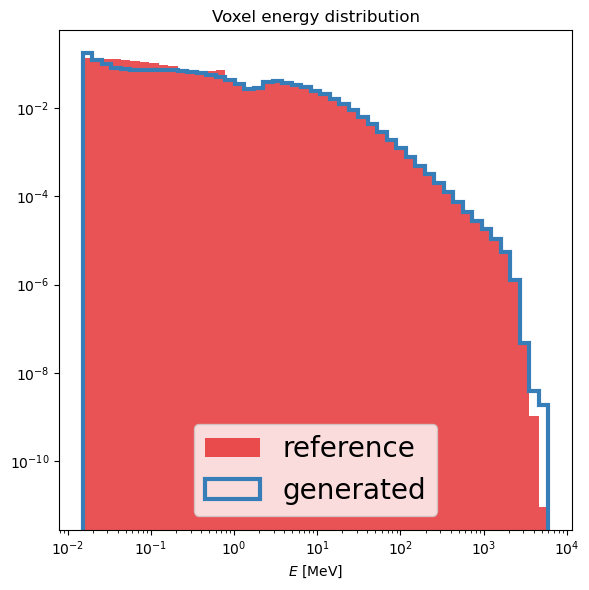

working on ../scratch_CaloChallenge/data/Scham/ds2_22.hdf5 with id 22
Separation power of voxel distribution histogram: 0.0029262352816948997


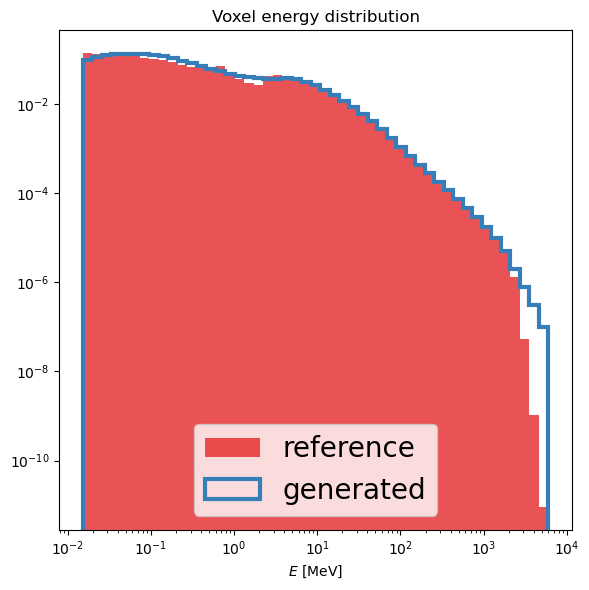

working on ../scratch_CaloChallenge/data/Schnake/ds2_23.hdf5 with id 23
Separation power of voxel distribution histogram: 0.0007630361849348439


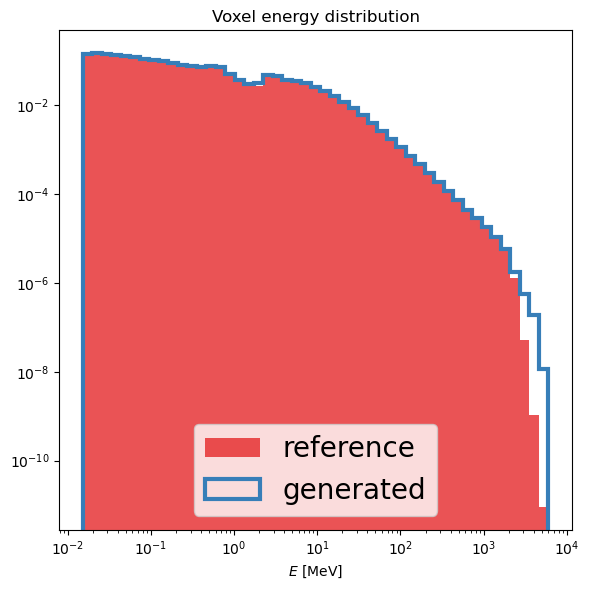

working on ../scratch_CaloChallenge/data/Ernst/ds2_27.hdf5 with id 27
Separation power of voxel distribution histogram: 0.10081163171058437


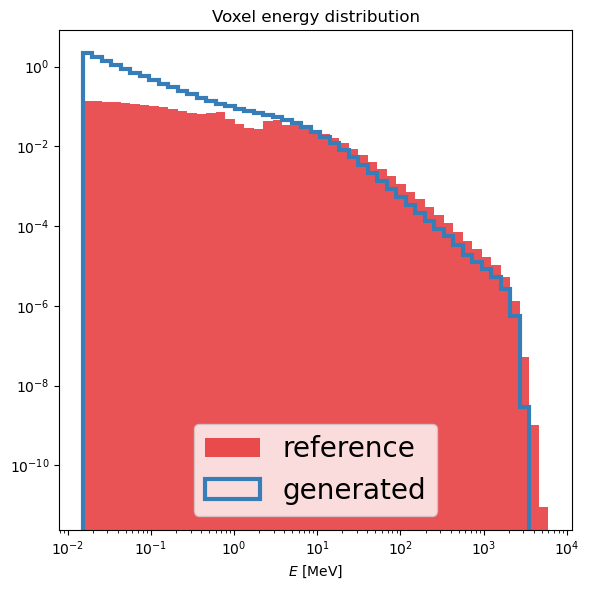

working on ../scratch_CaloChallenge/data/Madula/ds2_30.hdf5 with id 30
Separation power of voxel distribution histogram: 0.09479348189760393


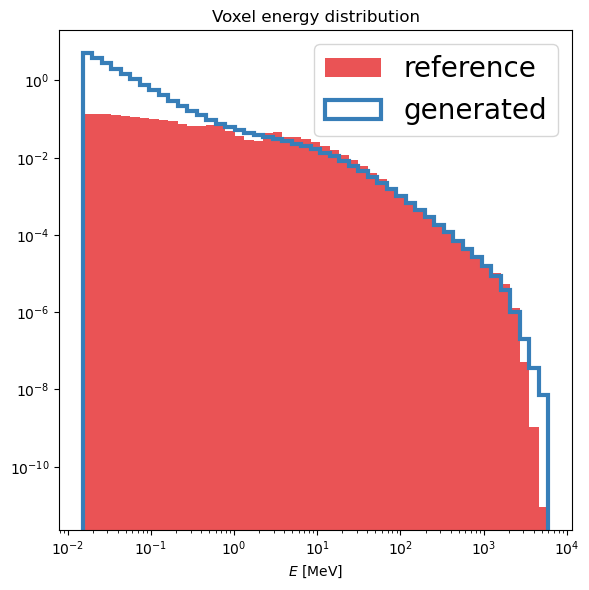

done


In [11]:
# compute HLF
MIN_ENERGY = 0.5e-3/0.033
HLF_2 = [HLF.HighLevelFeatures('electron', 'CaloChallenge_homepage/code/binning_dataset_2.xml') for _ in range(len(ds2_dict)+1)]
E_inc, showers = extract_info('../scratch_CaloChallenge/data/official/dataset_2_2.hdf5')
HLF_2[0].Einc = E_inc
ref_showers = showers
HLF_2[0].CalculateFeatures(showers)

ds2_results_dict = {'MIN_ENERGY': MIN_ENERGY}

for iter_id, submission_id in enumerate(ds2_dict):
    print(f"working on {ds2_dict[submission_id]} with id {submission_id}")
    E_inc, showers = extract_info(ds2_dict[submission_id])
    showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
    HLF_2[iter_id+1].Einc = E_inc
    HLF_2[iter_id+1].sep_cells = get_sep_cell_dist(showers, ref_showers, shower_direct=True)
    HLF_2[iter_id+1].CalculateFeatures(showers)
    
with open('ds2.pkl', 'wb') as handle:
    pickle.dump((HLF_2, ds2_results_dict), handle)

print(f"done")

In [ ]:
# extract data to be plotted

with open('ds2.pkl', 'rb') as handle:
    HLF_2, ds2_results_dict = pickle.load(handle)

ds2_results_dict['E_layer_dict'] = {}
ds2_results_dict['EC_eta_dict'] = {}
ds2_results_dict['EC_phi_dict'] = {}
ds2_results_dict['EC_eta_width_dict'] = {}
ds2_results_dict['EC_phi_width_dict'] = {}
ds2_results_dict['Sparsity_layer_dict'] = {}
ds2_results_dict['EC_r_dict'] = {}
ds2_results_dict['EC_r_width_dict'] = {}
ds2_results_dict['cell_dist'] = {}
ds2_results_dict['Etot_Einc_dist'] = {}


for iter_id, submission_id in enumerate(ds2_dict):
    print(f"working on {ds2_dict[submission_id]} with id {submission_id}")
    ds2_results_dict['E_layer_dict'][submission_id] = get_sep_E_layers(HLF_2[iter_id+1], HLF_2[0])
    print(f"working on {ds2_dict[submission_id]} with id {submission_id}")
    ds2_results_dict['EC_eta_dict'][submission_id] = get_sep_ECEtas(HLF_2[iter_id+1], HLF_2[0], '2')
    print(f"working on {ds2_dict[submission_id]} with id {submission_id}")
    ds2_results_dict['EC_phi_dict'][submission_id] = get_sep_ECPhis(HLF_2[iter_id+1], HLF_2[0], '2')
    print(f"working on {ds2_dict[submission_id]} with id {submission_id}")
    ds2_results_dict['EC_eta_width_dict'][submission_id] = get_sep_ECWidthEtas(HLF_2[iter_id+1], HLF_2[0], '2')
    print(f"working on {ds2_dict[submission_id]} with id {submission_id}")
    ds2_results_dict['EC_phi_width_dict'][submission_id] = get_sep_ECWidthPhis(HLF_2[iter_id+1], HLF_2[0], '2')
    print(f"working on {ds2_dict[submission_id]} with id {submission_id}")
    ds2_results_dict['Sparsity_layer_dict'][submission_id] = get_sep_Sparsity_layers(HLF_2[iter_id+1], HLF_2[0])
    print(f"working on {ds2_dict[submission_id]} with id {submission_id}")
    ds2_results_dict['EC_r_dict'][submission_id] = get_sep_ECR(HLF_2[iter_id+1], HLF_2[0], '2')
    print(f"working on {ds2_dict[submission_id]} with id {submission_id}")
    ds2_results_dict['EC_r_width_dict'][submission_id] = get_sep_ECWidthR(HLF_2[iter_id+1], HLF_2[0], '2')
    print(f"working on {ds2_dict[submission_id]} with id {submission_id}")
    ds2_results_dict['Etot_Einc_dist'][submission_id] = get_sep_Etot_Einc(HLF_2[iter_id+1], HLF_2[0])
    print(f"working on {ds2_dict[submission_id]} with id {submission_id}")
    ds2_results_dict['cell_dist'][submission_id] = HLF_2[iter_id+1].sep_cells

    
with open('ds2.pkl', 'wb') as handle:
    pickle.dump((HLF_2, ds2_results_dict), handle)

print(f"done")

In [13]:
MIN_ENERGY = 0.5e-3/0.033

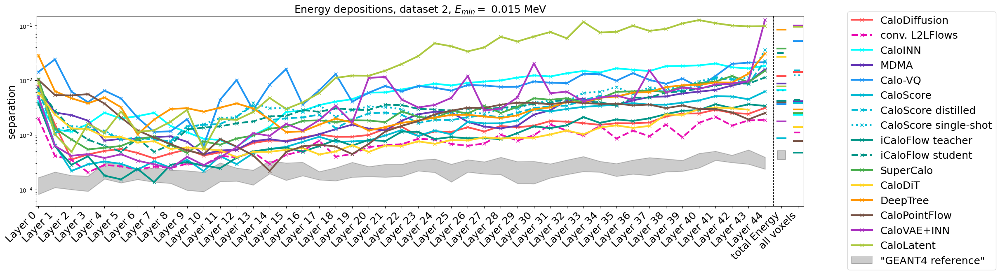

In [14]:
# energy depositions

with open('ds2.pkl', 'rb') as handle:
    HLF_2, ds2_results_dict = pickle.load(handle)
with open("ds2_reference.pkl", 'rb') as handle:
    ds2_reference_dict = pickle.load(handle)

plt.figure(figsize=(24,6), facecolor='white')
x_scan = np.arange(45+2)

for entry in ds2_results_dict['E_layer_dict']:
    if entry in []:
        continue
    plt.plot(x_scan[:45], ds2_results_dict['E_layer_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])
    #plt.errorbar(x_scan[-1], E_layer_dict[entry].mean(), yerr=E_layer_dict[entry].std(), linewidth=3., **kwargs_dict[entry])
    #plt.plot(x_scan[45:], [ds2_results_dict['Etot_Einc_dist'][entry], ds2_results_dict['cell_dist'][entry]], marker='o', label="_please_dont", linewidth=3., **kwargs_dict[entry])
    plt.plot([x_scan[45]-0.25, x_scan[45]+0.25], np.repeat([ds2_results_dict['Etot_Einc_dist'][entry]], 2), marker=None, label="_please_dont", linewidth=3., **kwargs_dict[entry])
    plt.plot([x_scan[46]-0.25, x_scan[46]+0.25], np.repeat([ds2_results_dict['cell_dist'][entry]], 2), marker=None, label="_please_dont", linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds2_reference_dict, 'E_layer_dict')
plt.fill_between(x_scan[:45], geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
geant_min, geant_max = get_min_max_from_dict(ds2_reference_dict, 'Etot_Einc_dist')
plt.fill_between([x_scan[45]-0.25, x_scan[45]+0.25], np.repeat([geant_min], 2), np.repeat([geant_max], 2), label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])
geant_min, geant_max = get_min_max_from_dict(ds2_reference_dict, 'cell_dist')
plt.fill_between([x_scan[46]-0.25, x_scan[46]+0.25], np.repeat([geant_min], 2), np.repeat([geant_max], 2), label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])

#for i in range(10):
#    plt.plot(x_scan[:45], ds2_reference_dict['E_layer_dict'][i], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
#    plt.plot([x_scan[45]-0.25, x_scan[45]+0.25], np.repeat([ds2_reference_dict['Etot_Einc_dist'][i]], 2), marker=None, label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])
#    plt.plot([x_scan[46]-0.25, x_scan[46]+0.25], np.repeat([ds2_reference_dict['cell_dist'][i]], 2), marker=None, label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.35])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.ylim(5e-5,1.5e-1)
plt.gca().set_xticks(x_scan)
labels = [f'Layer {i}' for i in range(45)]
labels.append('total Energy')
labels.append('all voxels')
plt.gca().set_xticklabels(labels, rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.05, 1.05), fontsize=FS)
plt.title(f"Energy depositions, dataset 2, $E_{{min}}=$ {ds2_results_dict['MIN_ENERGY']:.3f} MeV", fontsize=FS)
plt.axvline(x = 44.5, color = 'k', linestyle='dashed', linewidth=1)
plt.savefig('results_fig/sep/ds2_depositions.pdf', dpi=300, bbox_inches='tight')
plt.show()
         


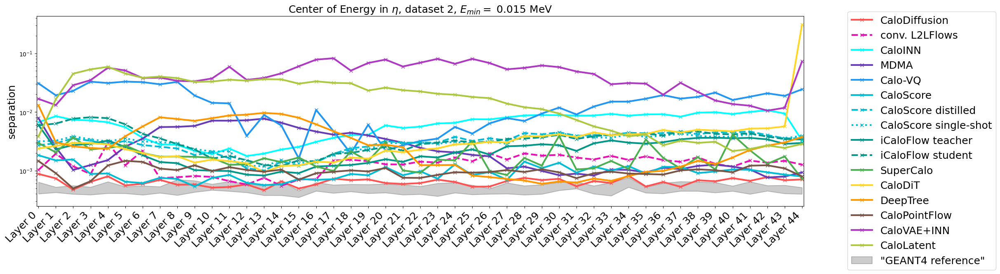

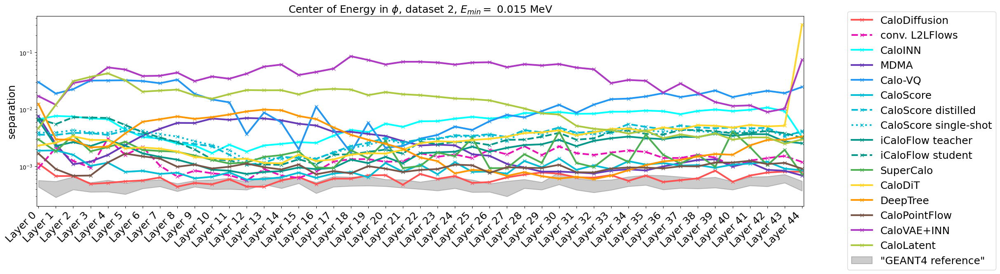

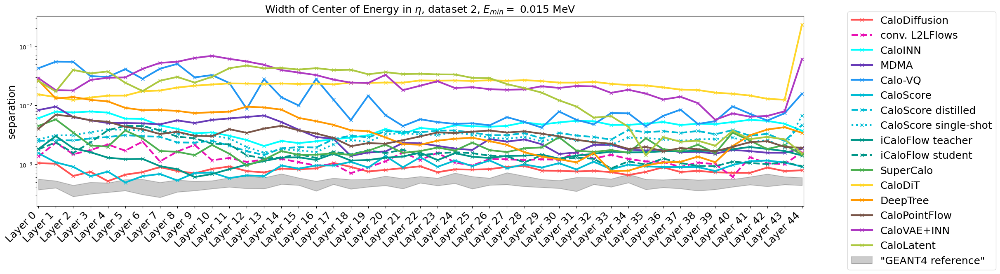

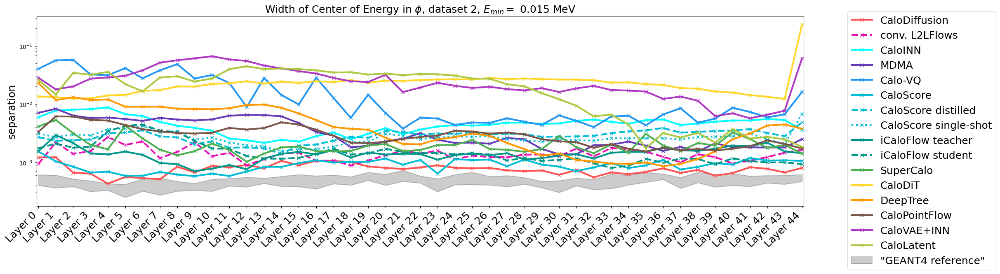

In [15]:
# EC and its width

with open('ds2.pkl', 'rb') as handle:
    HLF_2, ds2_results_dict = pickle.load(handle)
with open("ds2_reference.pkl", 'rb') as handle:
    ds2_reference_dict = pickle.load(handle)

plt.figure(figsize=(24,6), facecolor='white')
x_scan = np.arange(45)

for entry in ds2_results_dict['EC_eta_dict']:
    if entry in []:
        continue
    plt.plot(x_scan, ds2_results_dict['EC_eta_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds2_reference_dict, 'EC_eta_dict')
plt.fill_between(x_scan, geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

#for i in range(10):
#    plt.plot(x_scan, ds2_reference_dict['EC_eta_dict'][i], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels([f'Layer {i}' for i in range(45)], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.05, 1.05), fontsize=FS)
plt.title(f"Center of Energy in $\eta$, dataset 2, $E_{{min}}=$ {ds2_results_dict['MIN_ENERGY']:.3f} MeV", fontsize=FS)
plt.savefig('results_fig/sep/ds2_CE_eta.pdf', dpi=300, bbox_inches='tight')
plt.show()
          
          
plt.figure(figsize=(24,6), facecolor='white')
x_scan = np.arange(45)

for entry in ds2_results_dict['EC_phi_dict']:
    if entry in []:
        continue
    plt.plot(x_scan, ds2_results_dict['EC_phi_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds2_reference_dict, 'EC_phi_dict')
plt.fill_between(x_scan, geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
#for i in range(10):
#    plt.plot(x_scan, ds2_reference_dict['EC_phi_dict'][i], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels([f'Layer {i}' for i in range(45)], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.05, 1.05), fontsize=FS)
plt.title(f"Center of Energy in $\phi$, dataset 2, $E_{{min}}=$ {ds2_results_dict['MIN_ENERGY']:.3f} MeV", fontsize=FS)
plt.savefig('results_fig/sep/ds2_CE_phi.pdf', dpi=300, bbox_inches='tight')
plt.show()


plt.figure(figsize=(24,6), facecolor='white')
x_scan = np.arange(45)

for entry in ds2_results_dict['EC_eta_width_dict']:
    if entry in []:
        continue
    plt.plot(x_scan, ds2_results_dict['EC_eta_width_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds2_reference_dict, 'EC_eta_width_dict')
plt.fill_between(x_scan, geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
#for i in range(10):
#    plt.plot(x_scan, ds2_reference_dict['EC_eta_width_dict'][i], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels([f'Layer {i}' for i in range(45)], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.05, 1.05), fontsize=FS)
plt.title(f"Width of Center of Energy in $\eta$, dataset 2, $E_{{min}}=$ {ds2_results_dict['MIN_ENERGY']:.3f} MeV", fontsize=FS)
plt.savefig('results_fig/sep/ds2_width_CE_eta.pdf', dpi=300, bbox_inches='tight')
plt.show()
          
          
plt.figure(figsize=(24,6), facecolor='white')
x_scan = np.arange(45)

for entry in ds2_results_dict['EC_phi_width_dict']:
    if entry in []:
        continue
    plt.plot(x_scan, ds2_results_dict['EC_phi_width_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds2_reference_dict, 'EC_phi_width_dict')
plt.fill_between(x_scan, geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
#for i in range(10):
#    plt.plot(x_scan, ds2_reference_dict['EC_phi_width_dict'][i], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels([f'Layer {i}' for i in range(45)], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.05, 1.05), fontsize=FS)
plt.title(f"Width of Center of Energy in $\phi$, dataset 2, $E_{{min}}=$ {ds2_results_dict['MIN_ENERGY']:.3f} MeV", fontsize=FS)
plt.savefig('results_fig/sep/ds2_width_CE_phi.pdf', dpi=300, bbox_inches='tight')
plt.show()




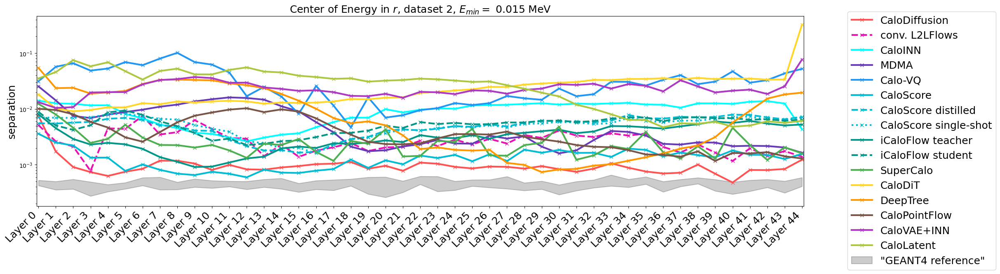

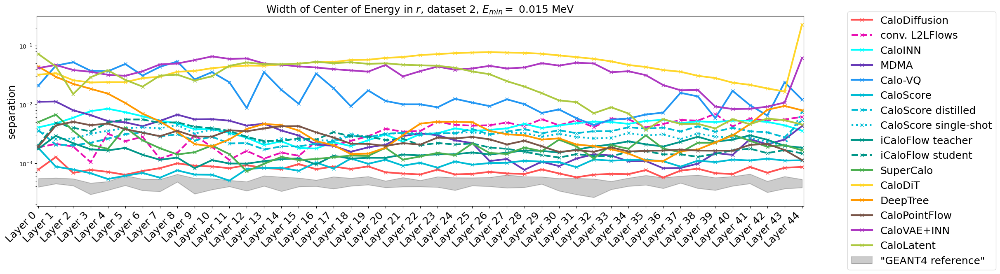

In [16]:
# EC and its width in r

with open('ds2.pkl', 'rb') as handle:
    HLF_2, ds2_results_dict = pickle.load(handle)
with open("ds2_reference.pkl", 'rb') as handle:
    ds2_reference_dict = pickle.load(handle)

plt.figure(figsize=(24,6), facecolor='white')
x_scan = np.arange(45)

for entry in ds2_results_dict['EC_r_dict']:
    if entry in []:
        continue
    plt.plot(x_scan, ds2_results_dict['EC_r_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds2_reference_dict, 'EC_r_dict')
plt.fill_between(x_scan, geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

#plt.plot(x_scan, ds2_reference_dict['EC_r_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels([f'Layer {i}' for i in range(45)], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.05, 1.05), fontsize=FS)
plt.title(f"Center of Energy in $r$, dataset 2, $E_{{min}}=$ {ds2_results_dict['MIN_ENERGY']:.3f} MeV", fontsize=FS)
plt.savefig('results_fig/sep/ds2_CE_r.pdf', dpi=300, bbox_inches='tight')
plt.show()


plt.figure(figsize=(24,6), facecolor='white')
x_scan = np.arange(45)

for entry in ds2_results_dict['EC_r_width_dict']:
    if entry in []:
        continue
    plt.plot(x_scan, ds2_results_dict['EC_r_width_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds2_reference_dict, 'EC_r_width_dict')
plt.fill_between(x_scan, geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

#plt.plot(x_scan, ds2_reference_dict['EC_r_width_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels([f'Layer {i}' for i in range(45)], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.05, 1.05), fontsize=FS)
plt.title(f"Width of Center of Energy in $r$, dataset 2, $E_{{min}}=$ {ds2_results_dict['MIN_ENERGY']:.3f} MeV", fontsize=FS)
plt.savefig('results_fig/sep/ds2_width_CE_r.pdf', dpi=300, bbox_inches='tight')
plt.show()



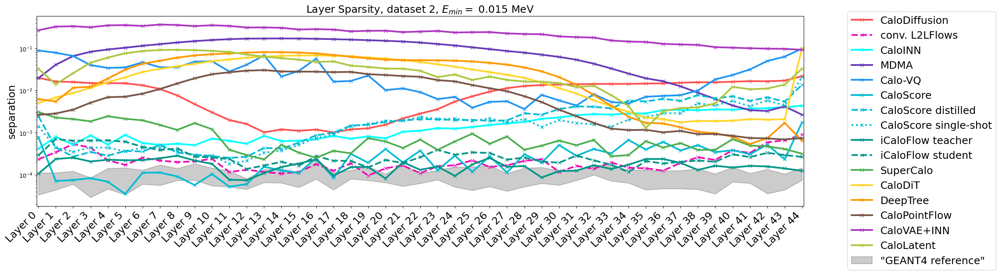

In [17]:
# layer sparsities

with open('ds2.pkl', 'rb') as handle:
    HLF_2, ds2_results_dict = pickle.load(handle)
with open("ds2_reference.pkl", 'rb') as handle:
    ds2_reference_dict = pickle.load(handle)

plt.figure(figsize=(24,6), facecolor='white')
x_scan = np.arange(45)

for entry in ds2_results_dict['Sparsity_layer_dict']:
    if entry in []:
        continue
    plt.plot(x_scan, ds2_results_dict['Sparsity_layer_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds2_reference_dict, 'Sparsity_layer_dict')
plt.fill_between(x_scan, geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

#plt.plot(x_scan, ds2_reference_dict['Sparsity_layer_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels([f'Layer {i}' for i in range(45)], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.05, 1.05), fontsize=FS)
plt.title(f"Layer Sparsity, dataset 2, $E_{{min}}=$ {ds2_results_dict['MIN_ENERGY']:.3f} MeV", fontsize=FS)
plt.savefig('results_fig/sep/ds2_sparsity.pdf', dpi=300, bbox_inches='tight')
plt.show()


### LLF - dataset 2

In [18]:
MIN_ENERGY = 0.5e-3/0.033

np.random.seed(2104)

first_run = True

if first_run:
    train_data = np.memmap('train_ds2_memmap.dat', mode='w+', shape=(num_ds2*60000, 6482), dtype=np.float32)
    test_data = np.memmap('test_ds2_memmap.dat', mode='w+', shape=(num_ds2*20000, 6482), dtype=np.float32)
    val_data = np.memmap('val_ds2_memmap.dat', mode='w+', shape=(num_ds2*20000, 6482), dtype=np.float32)

    shuffled_idx_train = np.arange(len(train_data))
    shuffled_idx_test = np.arange(len(test_data))
    shuffled_idx_val = np.arange(len(val_data))

    np.random.shuffle(shuffled_idx_train)
    np.random.shuffle(shuffled_idx_test)
    np.random.shuffle(shuffled_idx_val)

E_inc, showers = extract_info('../scratch_CaloChallenge/data/official/dataset_2_2.hdf5')
showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
truth_data = np.concatenate([np.log10(E_inc), showers / E_inc, -1*np.ones_like(E_inc)], axis=1)

conversion_to_submission_id = {}

for iter_id, submission_id in enumerate(ds2_dict):
    print(f"working on {ds2_dict[submission_id]} with submission id {submission_id} and classifier label {iter_id}")
    if first_run:
        E_inc, showers = extract_info(ds2_dict[submission_id])
        showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
        data = np.concatenate([np.log10(E_inc), showers / E_inc, iter_id*np.ones_like(E_inc)], axis=1)
        train_data[shuffled_idx_train[iter_id*60000:(iter_id+1)*60000]] = data[:60000] #[idx_train]
        test_data[shuffled_idx_test[iter_id*20000:(iter_id+1)*20000]] = data[60000:80000] #[idx_test]
        val_data[shuffled_idx_val[iter_id*20000:(iter_id+1)*20000]] = data[80000:] #[idx_val]
    conversion_to_submission_id[iter_id] = submission_id

print("done")

working on ../scratch_CaloChallenge/data/Amram/ds2_1.hdf5 with submission id 1 and classifier label 0
working on ../scratch_CaloChallenge/data/Buss/ds2_3.hdf5 with submission id 3 and classifier label 1
working on ../scratch_CaloChallenge/data/Favaro/ds2_4.hdf5 with submission id 4 and classifier label 2
working on ../scratch_CaloChallenge/data/Kaech/ds2_5.hdf5 with submission id 5 and classifier label 3
working on ../scratch_CaloChallenge/data/Liu/ds2_7.hdf5 with submission id 7 and classifier label 4
working on ../scratch_CaloChallenge/data/Mikuni/ds2_8.hdf5 with submission id 8 and classifier label 5
working on ../scratch_CaloChallenge/data/Mikuni/ds2_9.hdf5 with submission id 9 and classifier label 6
working on ../scratch_CaloChallenge/data/Mikuni/ds2_10.hdf5 with submission id 10 and classifier label 7
working on ../scratch_CaloChallenge/data/Pang/ds2_13.hdf5 with submission id 13 and classifier label 8
working on ../scratch_CaloChallenge/data/Pang/ds2_14.hdf5 with submission id 1

In [19]:
train_data = np.memmap('train_ds2_memmap.dat', mode='r+', shape=(num_ds2*60000, 6482), dtype=np.float32)
test_data = np.memmap('test_ds2_memmap.dat', mode='r+', shape=(num_ds2*20000, 6482), dtype=np.float32)
val_data = np.memmap('val_ds2_memmap.dat', mode='r+', shape=(num_ds2*20000, 6482), dtype=np.float32)

batch_size = 2000

train_dataset = TensorDataset(torch.from_numpy(train_data))
test_dataset = TensorDataset(torch.from_numpy(test_data))
val_dataset = TensorDataset(torch.from_numpy(val_data))
truth_dataset = TensorDataset(torch.from_numpy(truth_data))

train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_dataloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
truth_dataloader = DataLoader(truth_dataset, batch_size=batch_size, shuffle=False)

model architecture 
DNN(
  (inputlayer): Linear(in_features=6481, out_features=2048, bias=True)
  (outputlayer): Linear(in_features=2048, out_features=16, bias=True)
  (layers): Sequential(
    (0): Linear(in_features=6481, out_features=2048, bias=True)
    (1): LeakyReLU(negative_slope=0.01)
    (2): Dropout(p=0.0, inplace=False)
    (3): Linear(in_features=2048, out_features=2048, bias=True)
    (4): LeakyReLU(negative_slope=0.01)
    (5): Dropout(p=0.0, inplace=False)
    (6): Linear(in_features=2048, out_features=2048, bias=True)
    (7): LeakyReLU(negative_slope=0.01)
    (8): Dropout(p=0.0, inplace=False)
    (9): Linear(in_features=2048, out_features=16, bias=True)
  )
)
Model has 21700624 trainable parameters
Evaluation loss 2.77266623730734, accuracy 0.0625
Epoch 1 / 20 of run 1 / 10
step    0 / 480; loss 2.7732
step   40 / 480; loss 2.7686
step   80 / 480; loss 2.7480
step  120 / 480; loss 2.7014
step  160 / 480; loss 2.6843
step  200 / 480; loss 2.6549
step  240 / 480; loss 

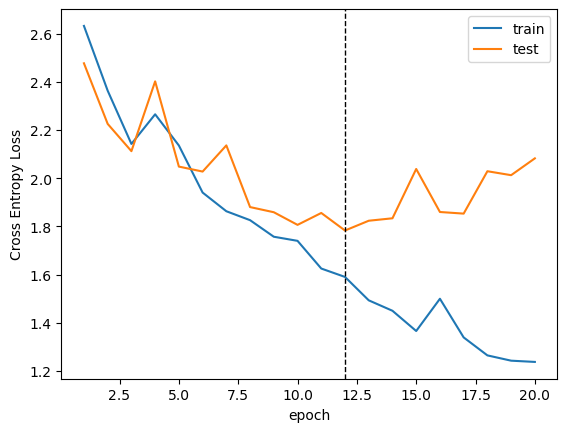

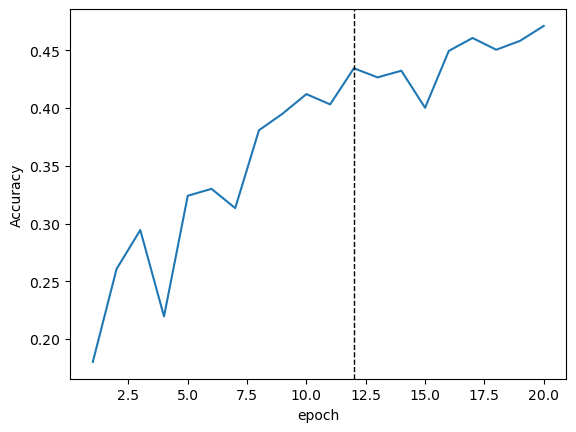

Model multiclass_weights_2_ensemble_0.pt loaded
Evaluation loss 1.7831984490921347, accuracy 0.434409375
preds shape (320000, 17)
preds shape (100000, 17)
Accuracy of model 0, which is CaloDiffusion is 0.1085.
Accuracy of model 1, which is conv. L2LFlows is 0.1729.
Accuracy of model 2, which is CaloINN is 0.2804.
Accuracy of model 3, which is MDMA is 0.6752.
Accuracy of model 4, which is Calo-VQ is 0.9035.
Accuracy of model 5, which is CaloScore is 0.10625.
Accuracy of model 6, which is CaloScore distilled is 0.09035.
Accuracy of model 7, which is CaloScore single-shot is 0.29355.
Accuracy of model 8, which is iCaloFlow teacher is 0.1484.
Accuracy of model 9, which is iCaloFlow student is 0.38045.
Accuracy of model 10, which is SuperCalo is 0.22385.
Accuracy of model 11, which is CaloDiT is 0.83775.
Accuracy of model 12, which is DeepTree is 0.7951.
Accuracy of model 13, which is CaloPointFlow is 0.30275.
Accuracy of model 14, which is CaloVAE+INN is 0.72955.
Accuracy of model 15, whic

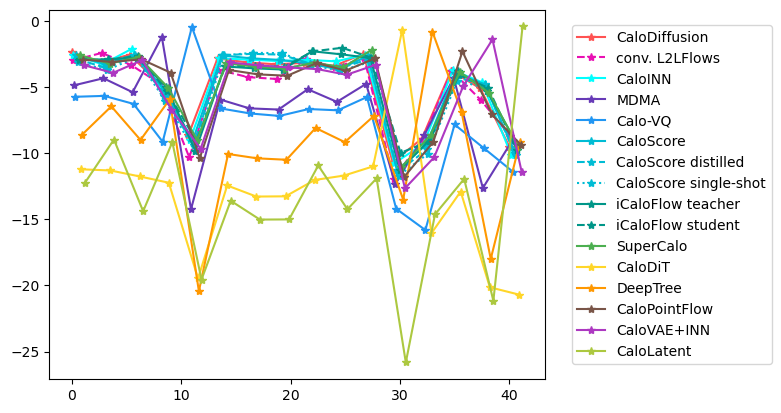

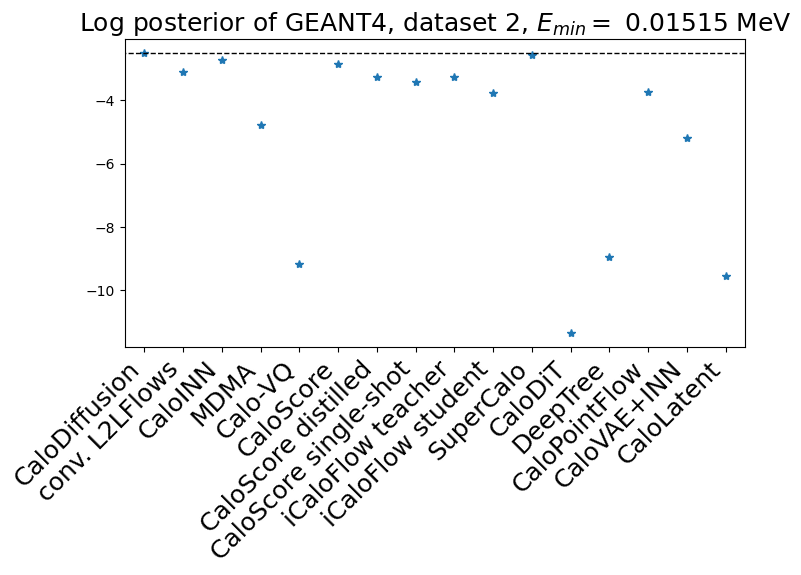

CaloDiffusion            log posterior:    -2.4975,    place:  1
conv. L2LFlows           log posterior:    -3.1057,    place:  5
CaloINN                  log posterior:    -2.7156,    place:  3
MDMA                     log posterior:    -4.7669,    place: 11
Calo-VQ                  log posterior:    -9.1781,    place: 14
CaloScore                log posterior:    -2.8433,    place:  4
CaloScore distilled      log posterior:    -3.2743,    place:  7
CaloScore single-shot    log posterior:    -3.4332,    place:  8
iCaloFlow teacher        log posterior:    -3.2529,    place:  6
iCaloFlow student        log posterior:    -3.7570,    place: 10
SuperCalo                log posterior:    -2.5713,    place:  2
CaloDiT                  log posterior:   -11.3679,    place: 16
DeepTree                 log posterior:    -8.9510,    place: 13
CaloPointFlow            log posterior:    -3.7430,    place:  9
CaloVAE+INN              log posterior:    -5.1801,    place: 12
CaloLatent               

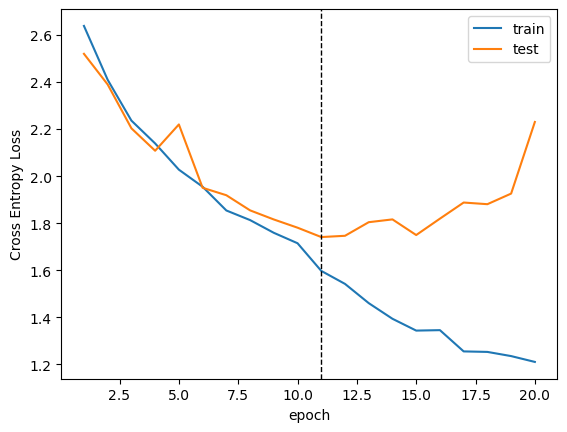

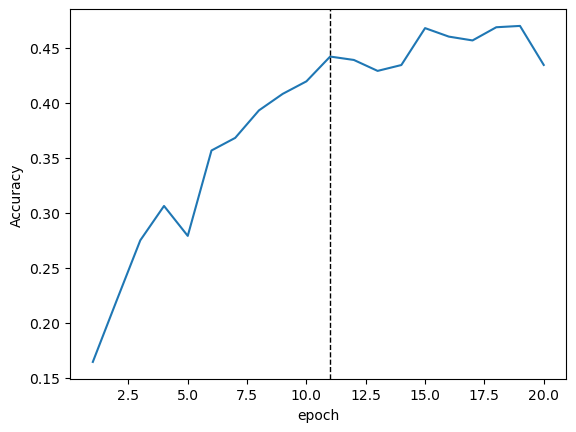

Model multiclass_weights_2_ensemble_1.pt loaded
Evaluation loss 1.7409224845398803, accuracy 0.441778125
preds shape (320000, 17)
preds shape (100000, 17)
Accuracy of model 0, which is CaloDiffusion is 0.10755.
Accuracy of model 1, which is conv. L2LFlows is 0.22665.
Accuracy of model 2, which is CaloINN is 0.139.
Accuracy of model 3, which is MDMA is 0.70535.
Accuracy of model 4, which is Calo-VQ is 0.9137.
Accuracy of model 5, which is CaloScore is 0.0744.
Accuracy of model 6, which is CaloScore distilled is 0.016.
Accuracy of model 7, which is CaloScore single-shot is 0.29845.
Accuracy of model 8, which is iCaloFlow teacher is 0.16515.
Accuracy of model 9, which is iCaloFlow student is 0.4314.
Accuracy of model 10, which is SuperCalo is 0.21735.
Accuracy of model 11, which is CaloDiT is 0.84385.
Accuracy of model 12, which is DeepTree is 0.79355.
Accuracy of model 13, which is CaloPointFlow is 0.47255.
Accuracy of model 14, which is CaloVAE+INN is 0.78185.
Accuracy of model 15, whic

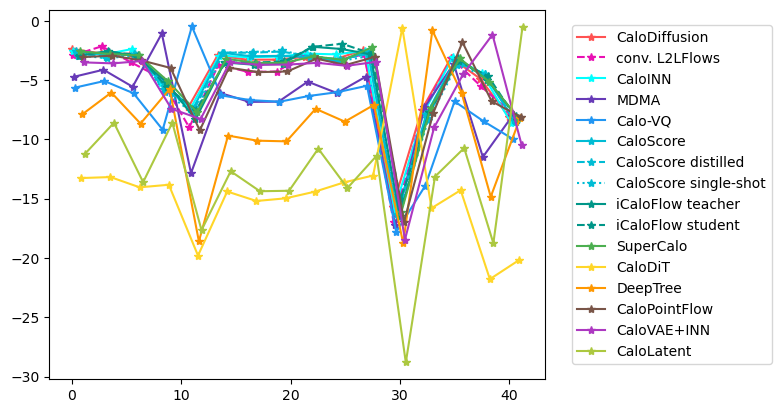

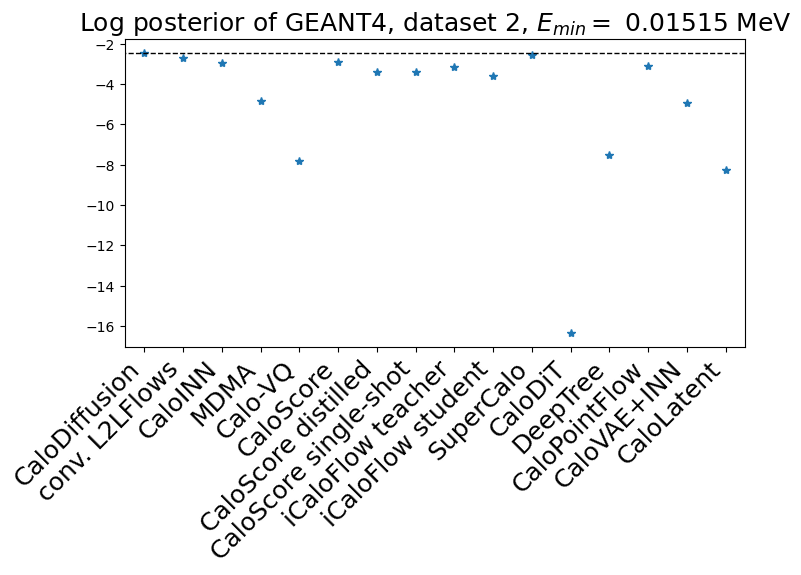

CaloDiffusion            log posterior:    -2.4613,    place:  1
conv. L2LFlows           log posterior:    -2.7366,    place:  3
CaloINN                  log posterior:    -2.9548,    place:  5
MDMA                     log posterior:    -4.8352,    place: 11
Calo-VQ                  log posterior:    -7.8078,    place: 14
CaloScore                log posterior:    -2.9241,    place:  4
CaloScore distilled      log posterior:    -3.4126,    place:  8
CaloScore single-shot    log posterior:    -3.4201,    place:  9
iCaloFlow teacher        log posterior:    -3.1408,    place:  7
iCaloFlow student        log posterior:    -3.5808,    place: 10
SuperCalo                log posterior:    -2.5617,    place:  2
CaloDiT                  log posterior:   -16.3465,    place: 16
DeepTree                 log posterior:    -7.5357,    place: 13
CaloPointFlow            log posterior:    -3.1191,    place:  6
CaloVAE+INN              log posterior:    -4.9485,    place: 12
CaloLatent               

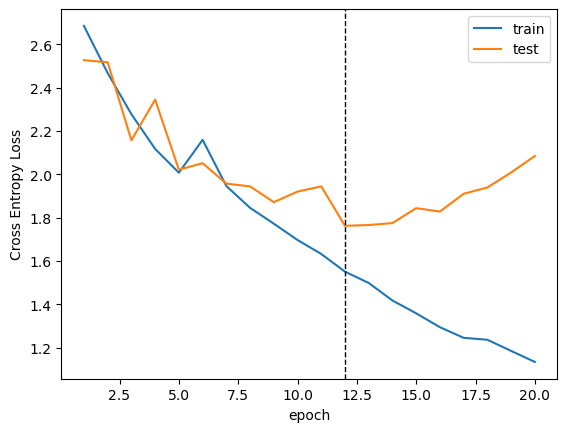

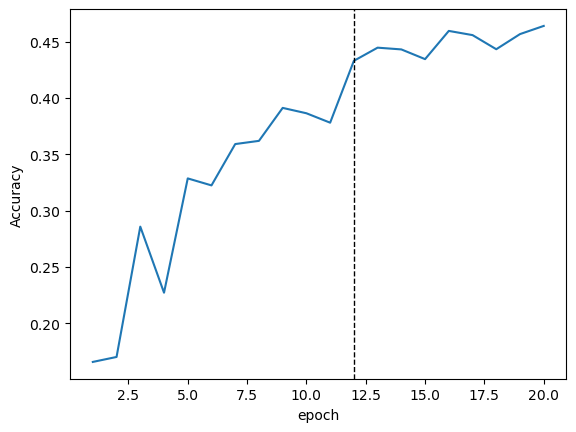

Model multiclass_weights_2_ensemble_2.pt loaded
Evaluation loss 1.762102762578844, accuracy 0.4330375
preds shape (320000, 17)
preds shape (100000, 17)
Accuracy of model 0, which is CaloDiffusion is 0.0669.
Accuracy of model 1, which is conv. L2LFlows is 0.19855.
Accuracy of model 2, which is CaloINN is 0.22625.
Accuracy of model 3, which is MDMA is 0.66805.
Accuracy of model 4, which is Calo-VQ is 0.91805.
Accuracy of model 5, which is CaloScore is 0.1165.
Accuracy of model 6, which is CaloScore distilled is 0.00485.
Accuracy of model 7, which is CaloScore single-shot is 0.2668.
Accuracy of model 8, which is iCaloFlow teacher is 0.15625.
Accuracy of model 9, which is iCaloFlow student is 0.2962.
Accuracy of model 10, which is SuperCalo is 0.2157.
Accuracy of model 11, which is CaloDiT is 0.873.
Accuracy of model 12, which is DeepTree is 0.7725.
Accuracy of model 13, which is CaloPointFlow is 0.4835.
Accuracy of model 14, which is CaloVAE+INN is 0.8042.
Accuracy of model 15, which is C

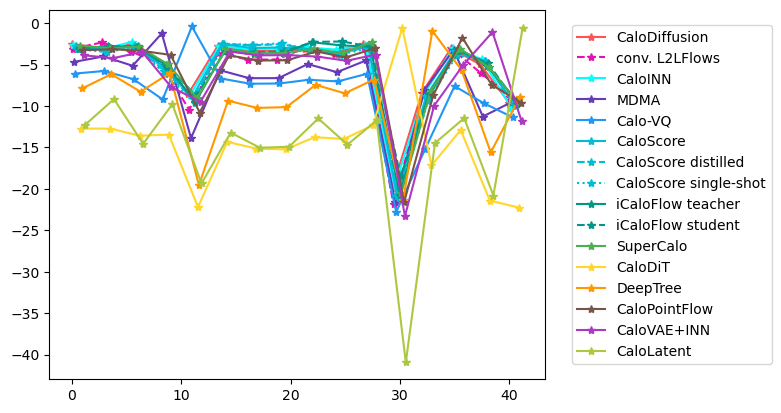

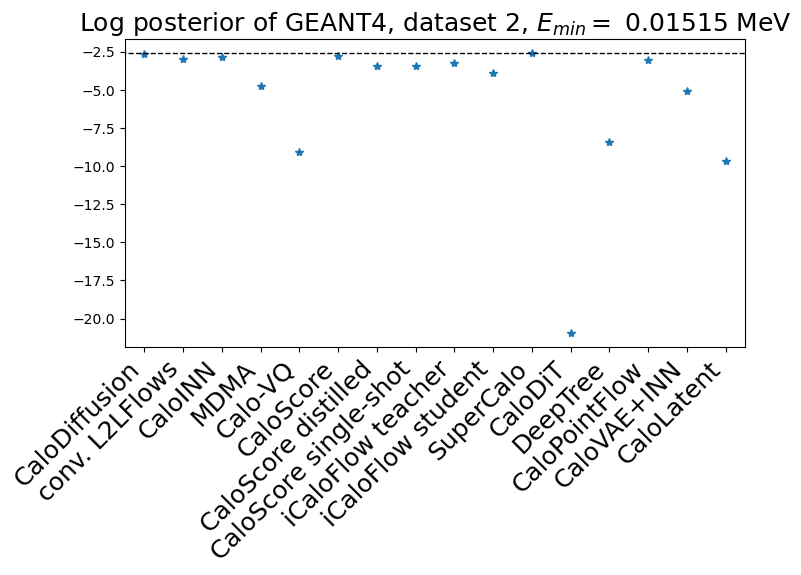

CaloDiffusion            log posterior:    -2.6294,    place:  2
conv. L2LFlows           log posterior:    -2.9527,    place:  5
CaloINN                  log posterior:    -2.8696,    place:  4
MDMA                     log posterior:    -4.7465,    place: 11
Calo-VQ                  log posterior:    -9.0928,    place: 14
CaloScore                log posterior:    -2.7816,    place:  3
CaloScore distilled      log posterior:    -3.4737,    place:  9
CaloScore single-shot    log posterior:    -3.4736,    place:  8
iCaloFlow teacher        log posterior:    -3.2493,    place:  7
iCaloFlow student        log posterior:    -3.8839,    place: 10
SuperCalo                log posterior:    -2.5884,    place:  1
CaloDiT                  log posterior:   -20.9403,    place: 16
DeepTree                 log posterior:    -8.4189,    place: 13
CaloPointFlow            log posterior:    -3.0395,    place:  6
CaloVAE+INN              log posterior:    -5.0762,    place: 12
CaloLatent               

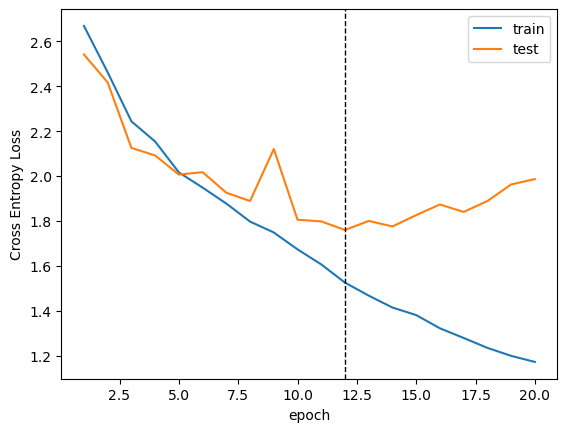

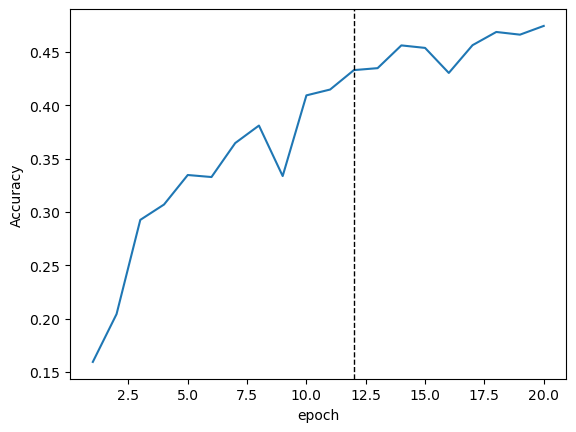

Model multiclass_weights_2_ensemble_3.pt loaded
Evaluation loss 1.7599051950068747, accuracy 0.432990625
preds shape (320000, 17)
preds shape (100000, 17)
Accuracy of model 0, which is CaloDiffusion is 0.20535.
Accuracy of model 1, which is conv. L2LFlows is 0.19495.
Accuracy of model 2, which is CaloINN is 0.2065.
Accuracy of model 3, which is MDMA is 0.6678.
Accuracy of model 4, which is Calo-VQ is 0.9648.
Accuracy of model 5, which is CaloScore is 0.11295.
Accuracy of model 6, which is CaloScore distilled is 0.0454.
Accuracy of model 7, which is CaloScore single-shot is 0.18025.
Accuracy of model 8, which is iCaloFlow teacher is 0.13705.
Accuracy of model 9, which is iCaloFlow student is 0.40425.
Accuracy of model 10, which is SuperCalo is 0.18175.
Accuracy of model 11, which is CaloDiT is 0.85715.
Accuracy of model 12, which is DeepTree is 0.78885.
Accuracy of model 13, which is CaloPointFlow is 0.34315.
Accuracy of model 14, which is CaloVAE+INN is 0.7548.
Accuracy of model 15, wh

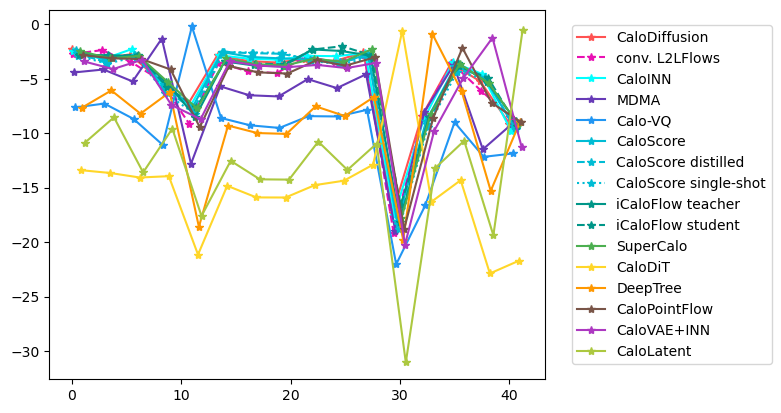

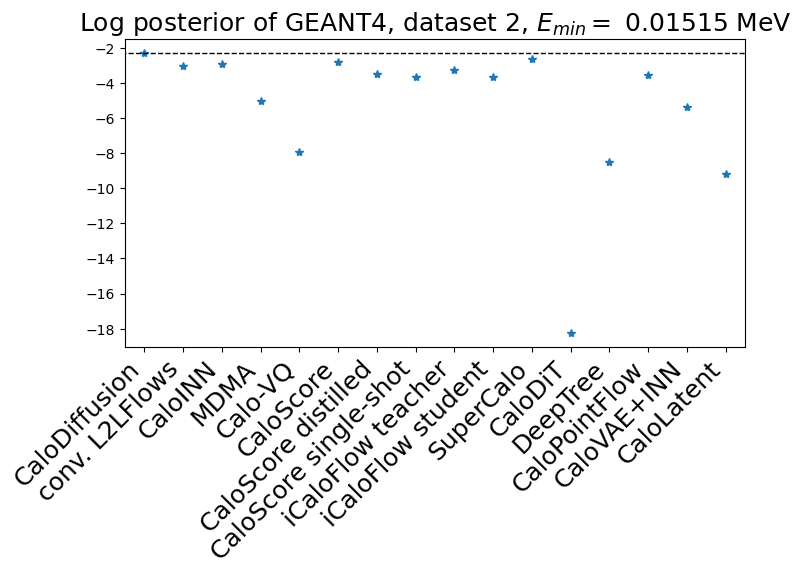

CaloDiffusion            log posterior:    -2.3029,    place:  1
conv. L2LFlows           log posterior:    -3.0218,    place:  5
CaloINN                  log posterior:    -2.9426,    place:  4
MDMA                     log posterior:    -5.0606,    place: 11
Calo-VQ                  log posterior:    -7.9225,    place: 13
CaloScore                log posterior:    -2.8001,    place:  3
CaloScore distilled      log posterior:    -3.4821,    place:  7
CaloScore single-shot    log posterior:    -3.6540,    place:  9
iCaloFlow teacher        log posterior:    -3.2641,    place:  6
iCaloFlow student        log posterior:    -3.6917,    place: 10
SuperCalo                log posterior:    -2.6446,    place:  2
CaloDiT                  log posterior:   -18.2394,    place: 16
DeepTree                 log posterior:    -8.5015,    place: 14
CaloPointFlow            log posterior:    -3.5582,    place:  8
CaloVAE+INN              log posterior:    -5.3541,    place: 12
CaloLatent               

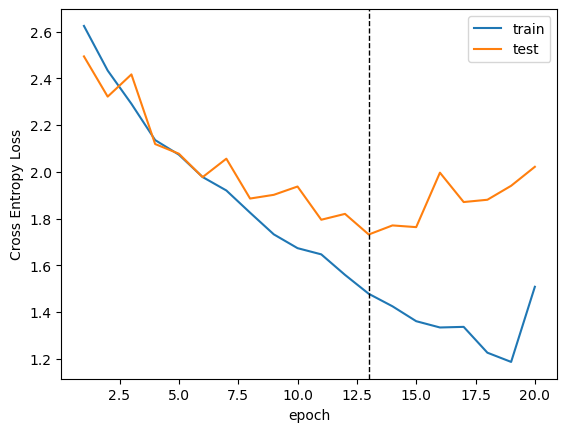

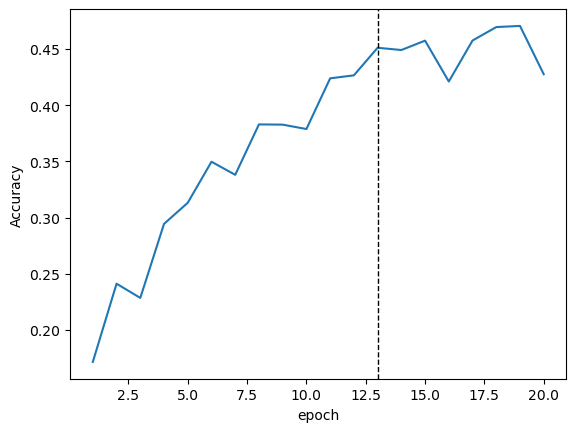

Model multiclass_weights_2_ensemble_4.pt loaded
Evaluation loss 1.731919055826637, accuracy 0.4511875
preds shape (320000, 17)
preds shape (100000, 17)
Accuracy of model 0, which is CaloDiffusion is 0.14335.
Accuracy of model 1, which is conv. L2LFlows is 0.2191.
Accuracy of model 2, which is CaloINN is 0.26065.
Accuracy of model 3, which is MDMA is 0.70815.
Accuracy of model 4, which is Calo-VQ is 0.9362.
Accuracy of model 5, which is CaloScore is 0.12165.
Accuracy of model 6, which is CaloScore distilled is 0.16455.
Accuracy of model 7, which is CaloScore single-shot is 0.20495.
Accuracy of model 8, which is iCaloFlow teacher is 0.11925.
Accuracy of model 9, which is iCaloFlow student is 0.37425.
Accuracy of model 10, which is SuperCalo is 0.2012.
Accuracy of model 11, which is CaloDiT is 0.86195.
Accuracy of model 12, which is DeepTree is 0.8198.
Accuracy of model 13, which is CaloPointFlow is 0.43385.
Accuracy of model 14, which is CaloVAE+INN is 0.7493.
Accuracy of model 15, which

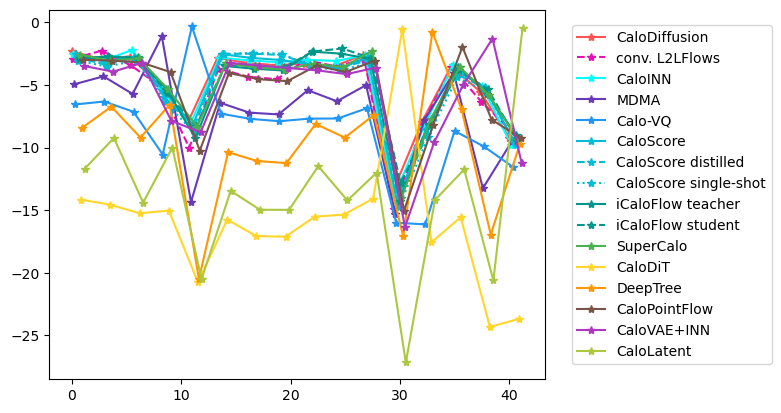

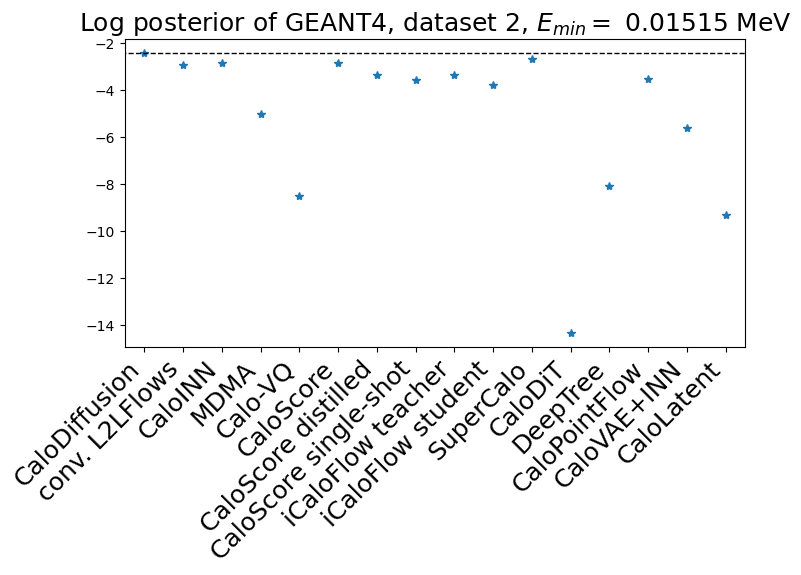

CaloDiffusion            log posterior:    -2.4274,    place:  1
conv. L2LFlows           log posterior:    -2.9251,    place:  5
CaloINN                  log posterior:    -2.8718,    place:  4
MDMA                     log posterior:    -5.0369,    place: 11
Calo-VQ                  log posterior:    -8.5216,    place: 14
CaloScore                log posterior:    -2.8443,    place:  3
CaloScore distilled      log posterior:    -3.3753,    place:  7
CaloScore single-shot    log posterior:    -3.5752,    place:  9
iCaloFlow teacher        log posterior:    -3.3651,    place:  6
iCaloFlow student        log posterior:    -3.7767,    place: 10
SuperCalo                log posterior:    -2.6913,    place:  2
CaloDiT                  log posterior:   -14.3352,    place: 16
DeepTree                 log posterior:    -8.0867,    place: 13
CaloPointFlow            log posterior:    -3.5149,    place:  8
CaloVAE+INN              log posterior:    -5.6371,    place: 12
CaloLatent               

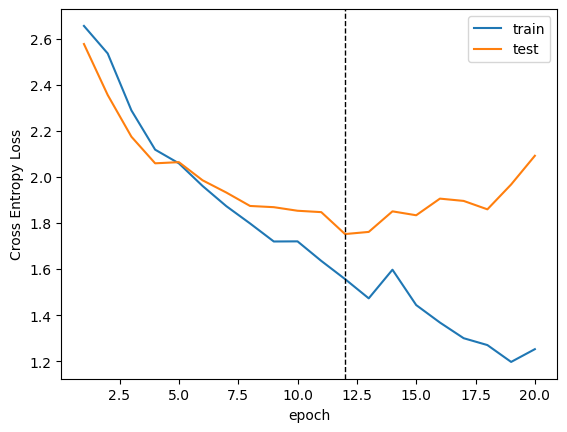

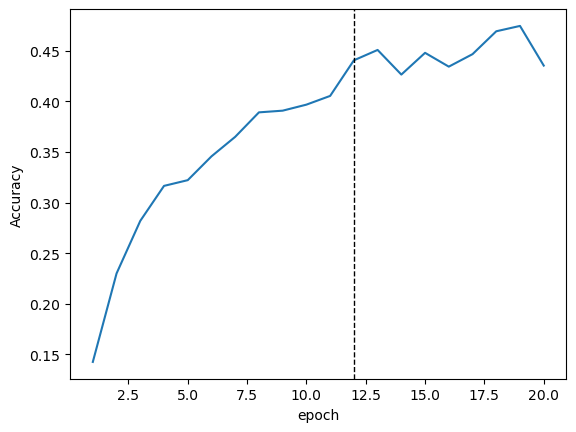

Model multiclass_weights_2_ensemble_5.pt loaded
Evaluation loss 1.7520137161288403, accuracy 0.440503125
preds shape (320000, 17)
preds shape (100000, 17)
Accuracy of model 0, which is CaloDiffusion is 0.08685.
Accuracy of model 1, which is conv. L2LFlows is 0.2081.
Accuracy of model 2, which is CaloINN is 0.19705.
Accuracy of model 3, which is MDMA is 0.6901.
Accuracy of model 4, which is Calo-VQ is 0.92325.
Accuracy of model 5, which is CaloScore is 0.13005.
Accuracy of model 6, which is CaloScore distilled is 0.0647.
Accuracy of model 7, which is CaloScore single-shot is 0.3614.
Accuracy of model 8, which is iCaloFlow teacher is 0.1402.
Accuracy of model 9, which is iCaloFlow student is 0.4043.
Accuracy of model 10, which is SuperCalo is 0.1905.
Accuracy of model 11, which is CaloDiT is 0.8807.
Accuracy of model 12, which is DeepTree is 0.79435.
Accuracy of model 13, which is CaloPointFlow is 0.4182.
Accuracy of model 14, which is CaloVAE+INN is 0.6706.
Accuracy of model 15, which i

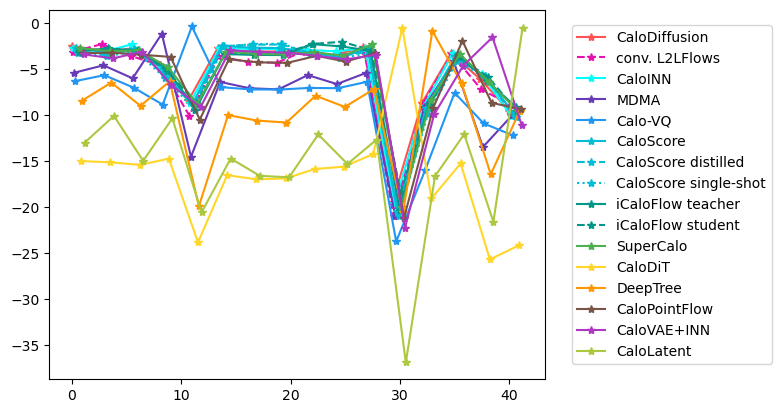

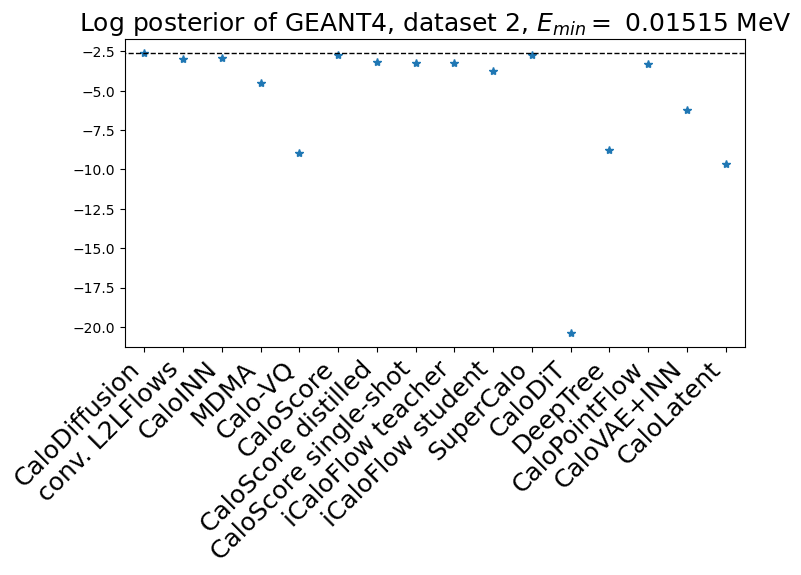

CaloDiffusion            log posterior:    -2.6097,    place:  1
conv. L2LFlows           log posterior:    -2.9725,    place:  5
CaloINN                  log posterior:    -2.9612,    place:  4
MDMA                     log posterior:    -4.5225,    place: 11
Calo-VQ                  log posterior:    -8.9781,    place: 14
CaloScore                log posterior:    -2.7581,    place:  2
CaloScore distilled      log posterior:    -3.1821,    place:  6
CaloScore single-shot    log posterior:    -3.2752,    place:  8
iCaloFlow teacher        log posterior:    -3.2723,    place:  7
iCaloFlow student        log posterior:    -3.7819,    place: 10
SuperCalo                log posterior:    -2.7594,    place:  3
CaloDiT                  log posterior:   -20.3777,    place: 16
DeepTree                 log posterior:    -8.7849,    place: 13
CaloPointFlow            log posterior:    -3.2975,    place:  9
CaloVAE+INN              log posterior:    -6.2185,    place: 12
CaloLatent               

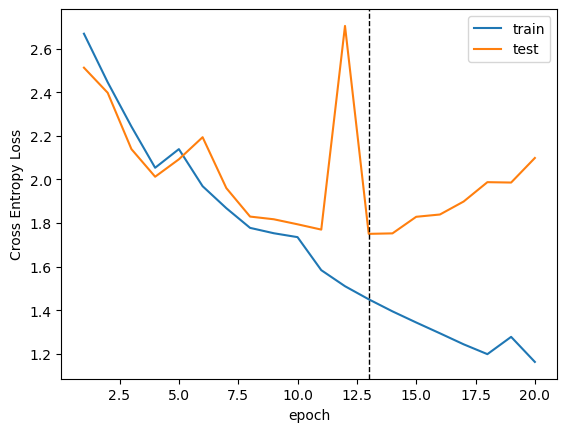

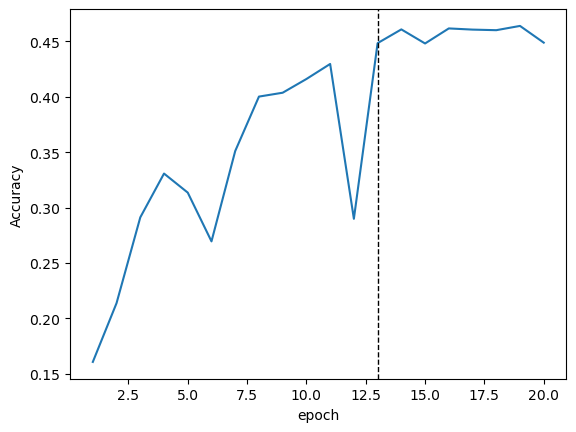

Model multiclass_weights_2_ensemble_6.pt loaded
Evaluation loss 1.7501770540845192, accuracy 0.448484375
preds shape (320000, 17)
preds shape (100000, 17)
Accuracy of model 0, which is CaloDiffusion is 0.16175.
Accuracy of model 1, which is conv. L2LFlows is 0.3425.
Accuracy of model 2, which is CaloINN is 0.23215.
Accuracy of model 3, which is MDMA is 0.64625.
Accuracy of model 4, which is Calo-VQ is 0.91255.
Accuracy of model 5, which is CaloScore is 0.1018.
Accuracy of model 6, which is CaloScore distilled is 0.09575.
Accuracy of model 7, which is CaloScore single-shot is 0.14145.
Accuracy of model 8, which is iCaloFlow teacher is 0.1746.
Accuracy of model 9, which is iCaloFlow student is 0.4319.
Accuracy of model 10, which is SuperCalo is 0.2114.
Accuracy of model 11, which is CaloDiT is 0.84265.
Accuracy of model 12, which is DeepTree is 0.7592.
Accuracy of model 13, which is CaloPointFlow is 0.45855.
Accuracy of model 14, which is CaloVAE+INN is 0.79615.
Accuracy of model 15, whi

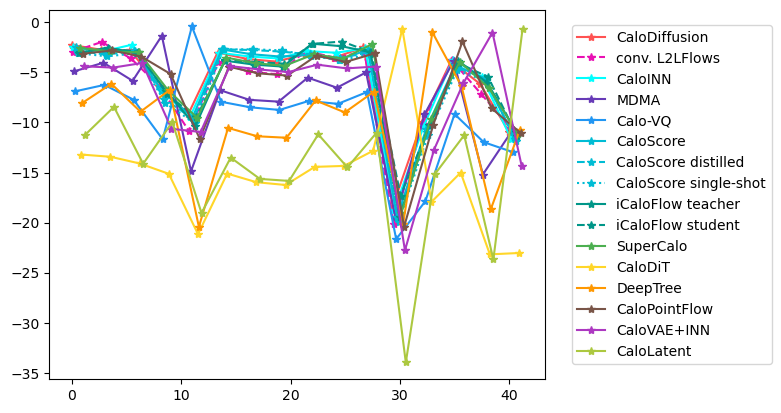

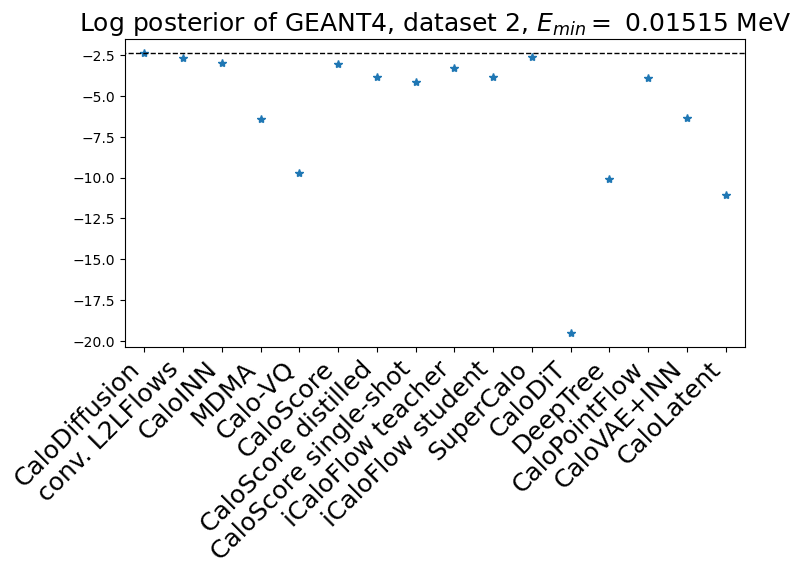

CaloDiffusion            log posterior:    -2.3847,    place:  1
conv. L2LFlows           log posterior:    -2.6983,    place:  3
CaloINN                  log posterior:    -2.9735,    place:  4
MDMA                     log posterior:    -6.4489,    place: 12
Calo-VQ                  log posterior:    -9.7400,    place: 13
CaloScore                log posterior:    -3.0601,    place:  5
CaloScore distilled      log posterior:    -3.8362,    place:  7
CaloScore single-shot    log posterior:    -4.1327,    place: 10
iCaloFlow teacher        log posterior:    -3.2751,    place:  6
iCaloFlow student        log posterior:    -3.8629,    place:  8
SuperCalo                log posterior:    -2.6134,    place:  2
CaloDiT                  log posterior:   -19.4983,    place: 16
DeepTree                 log posterior:   -10.0883,    place: 14
CaloPointFlow            log posterior:    -3.8989,    place:  9
CaloVAE+INN              log posterior:    -6.3612,    place: 11
CaloLatent               

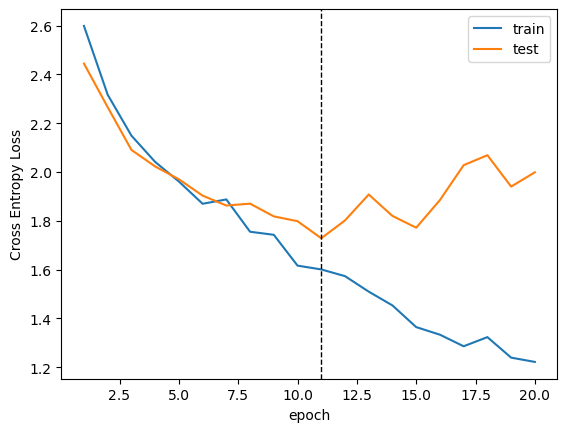

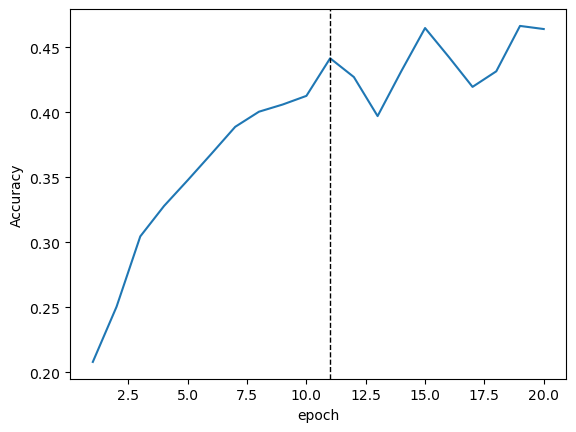

Model multiclass_weights_2_ensemble_7.pt loaded
Evaluation loss 1.7284239819227571, accuracy 0.441565625
preds shape (320000, 17)
preds shape (100000, 17)
Accuracy of model 0, which is CaloDiffusion is 0.07755.
Accuracy of model 1, which is conv. L2LFlows is 0.2323.
Accuracy of model 2, which is CaloINN is 0.18105.
Accuracy of model 3, which is MDMA is 0.6494.
Accuracy of model 4, which is Calo-VQ is 0.90205.
Accuracy of model 5, which is CaloScore is 0.11465.
Accuracy of model 6, which is CaloScore distilled is 0.02575.
Accuracy of model 7, which is CaloScore single-shot is 0.32975.
Accuracy of model 8, which is iCaloFlow teacher is 0.1949.
Accuracy of model 9, which is iCaloFlow student is 0.4198.
Accuracy of model 10, which is SuperCalo is 0.1558.
Accuracy of model 11, which is CaloDiT is 0.90285.
Accuracy of model 12, which is DeepTree is 0.7891.
Accuracy of model 13, which is CaloPointFlow is 0.35755.
Accuracy of model 14, which is CaloVAE+INN is 0.8269.
Accuracy of model 15, whic

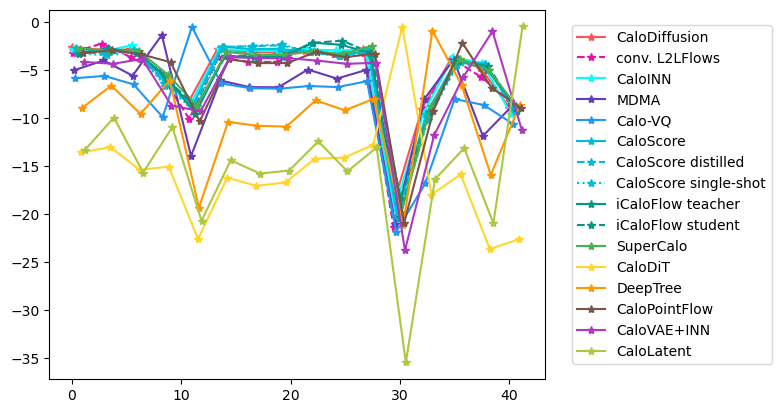

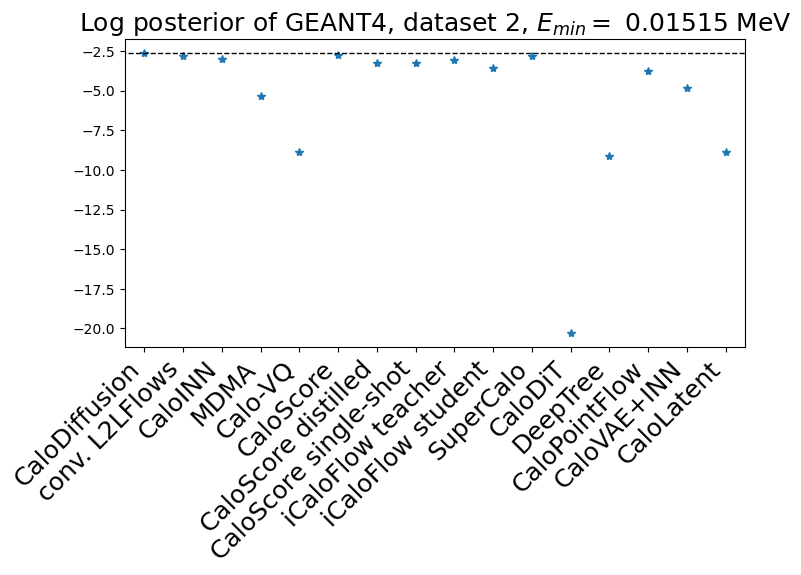

CaloDiffusion            log posterior:    -2.6254,    place:  1
conv. L2LFlows           log posterior:    -2.8314,    place:  3
CaloINN                  log posterior:    -2.9853,    place:  5
MDMA                     log posterior:    -5.3120,    place: 12
Calo-VQ                  log posterior:    -8.8742,    place: 13
CaloScore                log posterior:    -2.7623,    place:  2
CaloScore distilled      log posterior:    -3.2441,    place:  7
CaloScore single-shot    log posterior:    -3.2789,    place:  8
iCaloFlow teacher        log posterior:    -3.0680,    place:  6
iCaloFlow student        log posterior:    -3.5476,    place:  9
SuperCalo                log posterior:    -2.8348,    place:  4
CaloDiT                  log posterior:   -20.2857,    place: 16
DeepTree                 log posterior:    -9.1145,    place: 15
CaloPointFlow            log posterior:    -3.7859,    place: 10
CaloVAE+INN              log posterior:    -4.8417,    place: 11
CaloLatent               

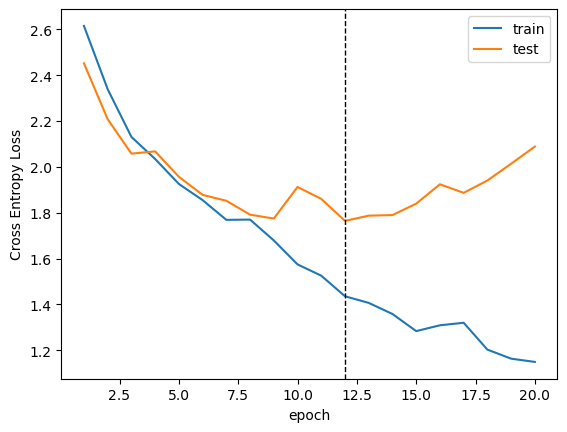

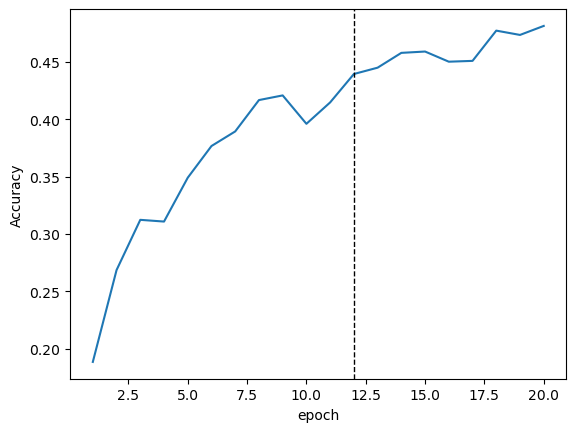

Model multiclass_weights_2_ensemble_8.pt loaded
Evaluation loss 1.76411926768015, accuracy 0.439475
preds shape (320000, 17)
preds shape (100000, 17)
Accuracy of model 0, which is CaloDiffusion is 0.102.
Accuracy of model 1, which is conv. L2LFlows is 0.2007.
Accuracy of model 2, which is CaloINN is 0.2648.
Accuracy of model 3, which is MDMA is 0.6716.
Accuracy of model 4, which is Calo-VQ is 0.9149.
Accuracy of model 5, which is CaloScore is 0.1183.
Accuracy of model 6, which is CaloScore distilled is 0.0898.
Accuracy of model 7, which is CaloScore single-shot is 0.12905.
Accuracy of model 8, which is iCaloFlow teacher is 0.12465.
Accuracy of model 9, which is iCaloFlow student is 0.40405.
Accuracy of model 10, which is SuperCalo is 0.17515.
Accuracy of model 11, which is CaloDiT is 0.90765.
Accuracy of model 12, which is DeepTree is 0.84305.
Accuracy of model 13, which is CaloPointFlow is 0.36615.
Accuracy of model 14, which is CaloVAE+INN is 0.83315.
Accuracy of model 15, which is C

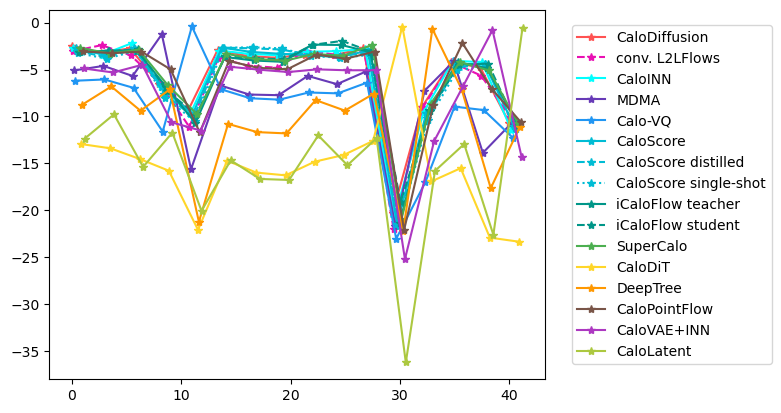

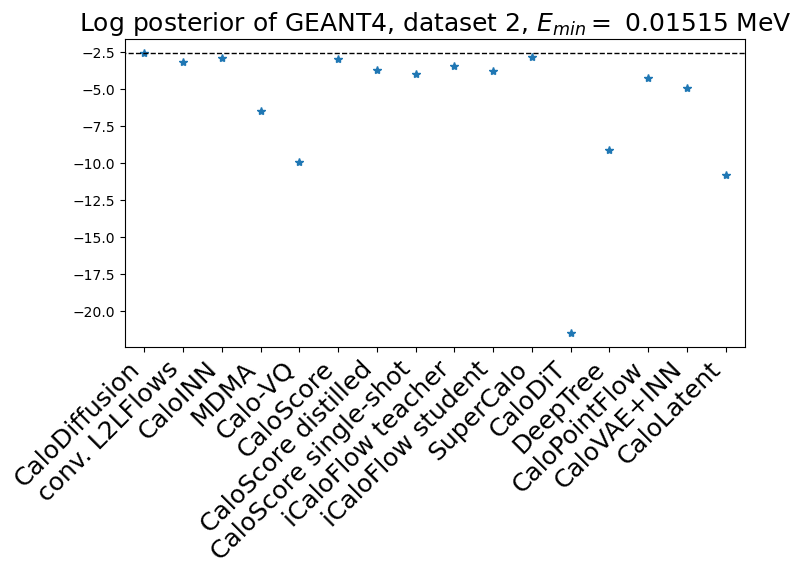

CaloDiffusion            log posterior:    -2.5608,    place:  1
conv. L2LFlows           log posterior:    -3.1977,    place:  5
CaloINN                  log posterior:    -2.9108,    place:  3
MDMA                     log posterior:    -6.4856,    place: 12
Calo-VQ                  log posterior:    -9.9284,    place: 14
CaloScore                log posterior:    -2.9666,    place:  4
CaloScore distilled      log posterior:    -3.7156,    place:  7
CaloScore single-shot    log posterior:    -3.9486,    place:  9
iCaloFlow teacher        log posterior:    -3.4734,    place:  6
iCaloFlow student        log posterior:    -3.7947,    place:  8
SuperCalo                log posterior:    -2.8382,    place:  2
CaloDiT                  log posterior:   -21.4517,    place: 16
DeepTree                 log posterior:    -9.0897,    place: 13
CaloPointFlow            log posterior:    -4.2302,    place: 10
CaloVAE+INN              log posterior:    -4.9287,    place: 11
CaloLatent               

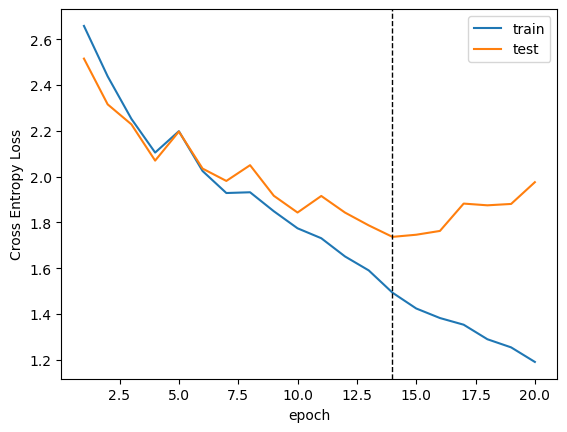

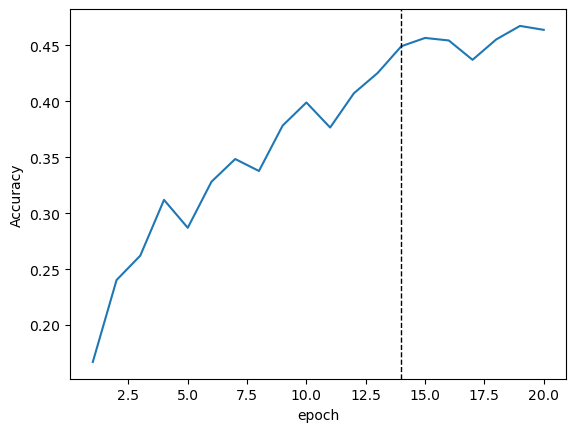

Model multiclass_weights_2_ensemble_9.pt loaded
Evaluation loss 1.736796282499499, accuracy 0.449325
preds shape (320000, 17)
preds shape (100000, 17)
Accuracy of model 0, which is CaloDiffusion is 0.0897.
Accuracy of model 1, which is conv. L2LFlows is 0.2655.
Accuracy of model 2, which is CaloINN is 0.1916.
Accuracy of model 3, which is MDMA is 0.68955.
Accuracy of model 4, which is Calo-VQ is 0.9204.
Accuracy of model 5, which is CaloScore is 0.15165.
Accuracy of model 6, which is CaloScore distilled is 0.0349.
Accuracy of model 7, which is CaloScore single-shot is 0.29565.
Accuracy of model 8, which is iCaloFlow teacher is 0.1851.
Accuracy of model 9, which is iCaloFlow student is 0.374.
Accuracy of model 10, which is SuperCalo is 0.15795.
Accuracy of model 11, which is CaloDiT is 0.87065.
Accuracy of model 12, which is DeepTree is 0.8144.
Accuracy of model 13, which is CaloPointFlow is 0.45955.
Accuracy of model 14, which is CaloVAE+INN is 0.78195.
Accuracy of model 15, which is C

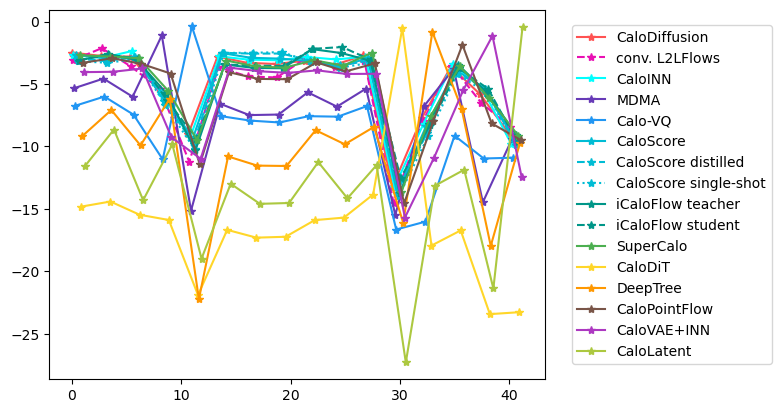

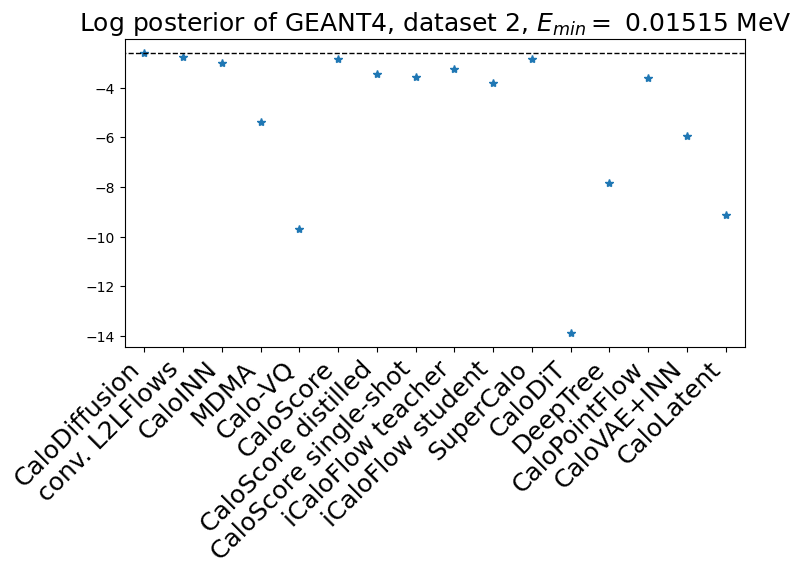

CaloDiffusion            log posterior:    -2.5955,    place:  1
conv. L2LFlows           log posterior:    -2.7464,    place:  2
CaloINN                  log posterior:    -2.9813,    place:  5
MDMA                     log posterior:    -5.3678,    place: 11
Calo-VQ                  log posterior:    -9.6743,    place: 15
CaloScore                log posterior:    -2.8395,    place:  4
CaloScore distilled      log posterior:    -3.4604,    place:  7
CaloScore single-shot    log posterior:    -3.5688,    place:  8
iCaloFlow teacher        log posterior:    -3.2278,    place:  6
iCaloFlow student        log posterior:    -3.8050,    place: 10
SuperCalo                log posterior:    -2.8280,    place:  3
CaloDiT                  log posterior:   -13.8784,    place: 16
DeepTree                 log posterior:    -7.8232,    place: 13
CaloPointFlow            log posterior:    -3.6101,    place:  9
CaloVAE+INN              log posterior:    -5.9530,    place: 12
CaloLatent               

In [20]:
num_epoch = 20
num_runs = 10
DS = '2_ensemble'

only_eval = False

accuracy = []
train_losses = []
eval_losses = []

preds_models = []
preds_truth = []

preds_by_model = []
log_post_by_model = []
log_truth = []
final_accuracy = []

for run_nr in range(num_runs):
#for run_nr in [3, 4]:
    dense_net = DNN(num_layer=2, num_hidden=2048, input_dim=6481, output_dim=num_ds2)
    dense_net.to(device)

    print("model architecture ")
    print(dense_net)
    total_parameters = sum(p.numel() for p in dense_net.parameters() if p.requires_grad)
    print(f"Model has {total_parameters:d} trainable parameters")

    criterion = nn.NLLLoss(reduction='none')
    optimizer = torch.optim.Adam(dense_net.parameters(), lr=1e-3)
    
    if not only_eval:
        best_val_loss = 1e6

        accuracy.append([])
        _, acc = evaluate(dense_net, test_dataloader, criterion, device=device)
        accuracy[-1].append(acc.mean())

        train_losses.append([])
        eval_losses.append([])

        for epoch in range(num_epoch):
            print(f"Epoch {epoch+1} / {num_epoch} of run {run_nr+1} / {num_runs}")
            train_loss = train(dense_net, train_dataloader, optimizer, criterion, device=device)
            eval_loss, acc = evaluate(dense_net, test_dataloader, criterion, device=device)
            train_losses[-1].append(train_loss.mean())
            eval_losses[-1].append(eval_loss.mean())
            accuracy[-1].append(acc.mean())
            if eval_loss.mean() < best_val_loss:
                save_weights(dense_net, DS, run_nr)
                best_val_loss = eval_loss.mean()
            print("   - - - - -   ")
    
    print("evaluating this run:")
    if not only_eval:
        epochs = np.arange(num_epoch) + 1
        plt.plot(epochs, train_losses[-1], label='train')
        plt.plot(epochs, eval_losses[-1], label='test')
        plt.ylabel("Cross Entropy Loss")
        plt.xlabel("epoch")
        plt.axvline(x = np.argmin(eval_losses[-1])+1, color = 'k', linestyle='dashed', linewidth=1)
        plt.legend()
        plt.show()

        plt.plot(epochs, accuracy[-1][1:])
        plt.axvline(x = np.argmin(eval_losses[-1])+1, color = 'k', linestyle='dashed', linewidth=1)
        plt.ylabel("Accuracy")
        plt.xlabel("epoch")
        plt.show()

    load_weights(dense_net, device, DS, run_nr)
    _ = evaluate(dense_net, test_dataloader, criterion, device=device)
    preds_models.append(get_prediction(dense_net, test_dataloader, device=device))
    preds_truth.append(get_prediction(dense_net, truth_dataloader, device=device))


    preds_by_model.append([])
    log_post_by_model.append([])
    for i in range(num_ds2):
        preds_by_model[-1].append(preds_models[-1][preds_models[-1][:, -1] == i][:, :-1])
        log_post_by_model[-1].append(log_posterior(preds_by_model[-1][-1]))

    preds_truth[-1] = preds_truth[-1][:, :-1]
    log_truth.append(log_posterior(preds_truth[-1]))

    final_accuracy.append([])
    for i in range(num_ds2):
        final_accuracy[-1].append(find_accuracy(preds_by_model[-1][i], i))
        print(f"Accuracy of model {i}, which is {id_dict[conversion_to_submission_id[i]]} is {final_accuracy[-1][i].mean()}.")


    for i in range(num_ds2):
        plt.plot(np.linspace(0, 40, num_ds2)+0.08*i, log_post_by_model[-1][i], '*', label=id_dict[conversion_to_submission_id[i]], **kwargs_dict[conversion_to_submission_id[i]])
        print(f"class {i} has maximum posterior in class {np.argmax(log_post_by_model[-1][i])}")

    plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left")
    plt.show()
    
    plt.figure(figsize=(8,4))
    plt.plot(np.arange(num_ds2), log_truth[-1], '*')
    plt.hlines(np.max(log_truth[-1]), xmin=-1, xmax=num_ds2, color = 'k', linestyle='dashed', linewidth=1)
    plt.xlim(-0.5, num_ds2-0.5)
    plt.title(f"Log posterior of GEANT4, dataset 2, $E_{{min}}=$ {MIN_ENERGY:.5f} MeV", fontsize=FS)
    plt.gca().set_xticks(np.arange(num_ds2))
    plt.gca().set_xticklabels([id_dict[conversion_to_submission_id[i]] for i in range(num_ds2)], rotation=45, ha='right', fontsize=FS)
    plt.show()

    score_order = np.argsort(np.argsort(-log_truth[-1]))+1
    for i in range(num_ds2):
        print(f"{id_dict[conversion_to_submission_id[i]]:24s} log posterior:   {log_truth[-1][i]:8.4f},    place: {score_order[i]:2d}")    
        
    print("\n  - - - -  \n")
log_post_by_model = np.array(log_post_by_model)
log_truth = np.array(log_truth)
final_accuracy = np.array(final_accuracy)
print("done")

Accuracy of model  0, which is CaloDiffusion             is 0.1150 +/- 0.0407.
Accuracy of model  1, which is conv. L2LFlows            is 0.2261 +/- 0.0455.
Accuracy of model  2, which is CaloINN                   is 0.2179 +/- 0.0413.
Accuracy of model  3, which is MDMA                      is 0.6771 +/- 0.0200.
Accuracy of model  4, which is Calo-VQ                   is 0.9209 +/- 0.0173.
Accuracy of model  5, which is CaloScore                 is 0.1148 +/- 0.0188.
Accuracy of model  6, which is CaloScore distilled       is 0.0632 +/- 0.0458.
Accuracy of model  7, which is CaloScore single-shot     is 0.2501 +/- 0.0766.
Accuracy of model  8, which is iCaloFlow teacher         is 0.1546 +/- 0.0240.
Accuracy of model  9, which is iCaloFlow student         is 0.3921 +/- 0.0378.
Accuracy of model 10, which is SuperCalo                 is 0.1931 +/- 0.0235.
Accuracy of model 11, which is CaloDiT                   is 0.8678 +/- 0.0230.
Accuracy of model 12, which is DeepTree             

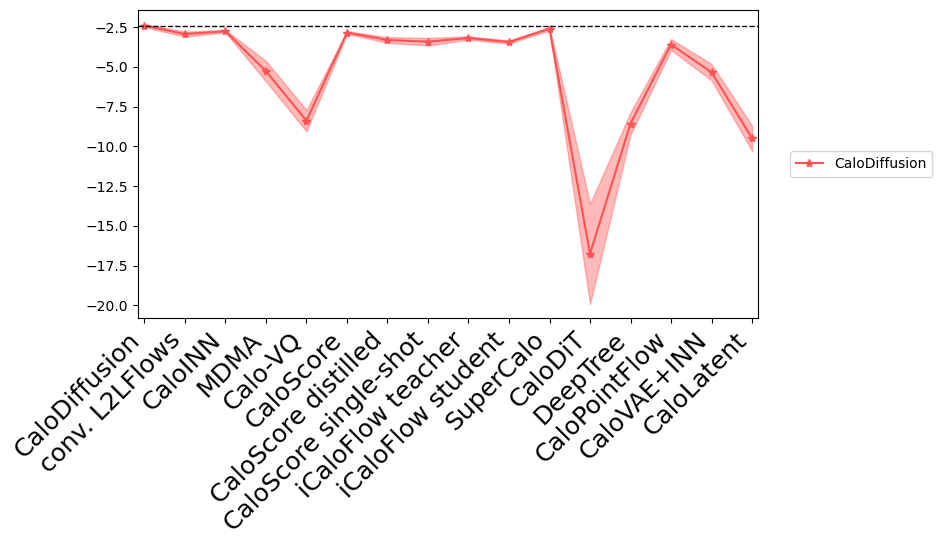

class 0 has maximum posterior in class 0


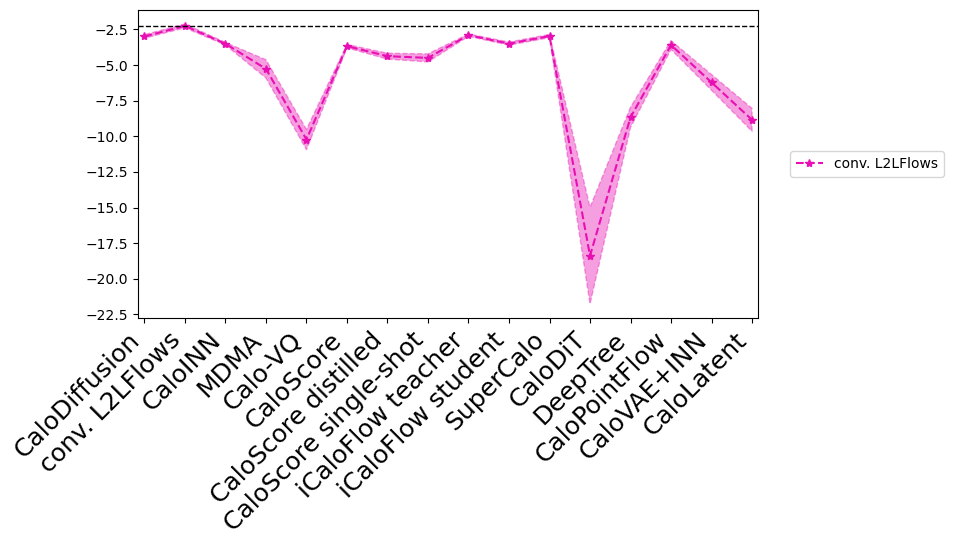

class 1 has maximum posterior in class 1


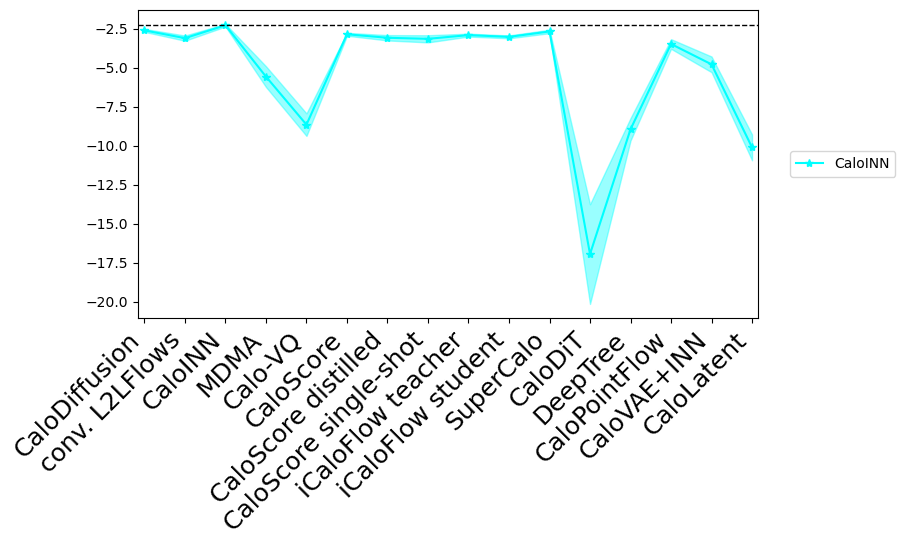

class 2 has maximum posterior in class 2


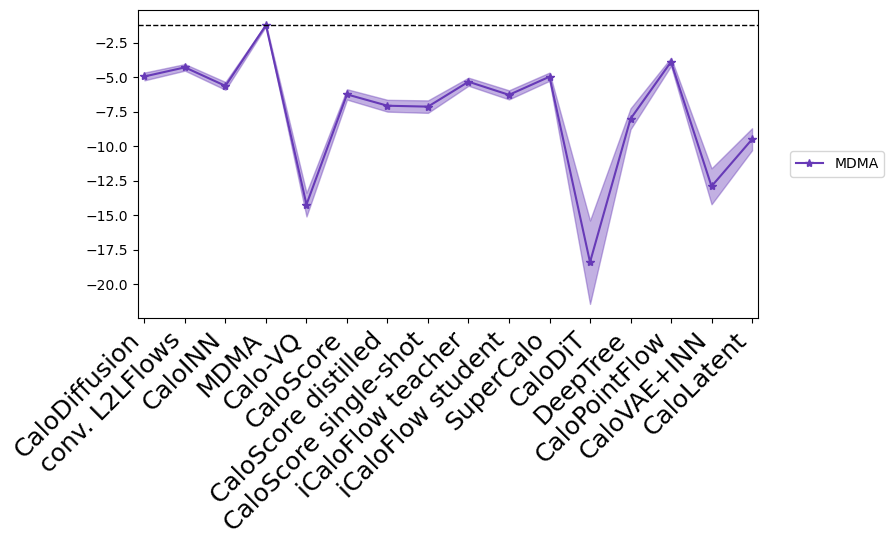

class 3 has maximum posterior in class 3


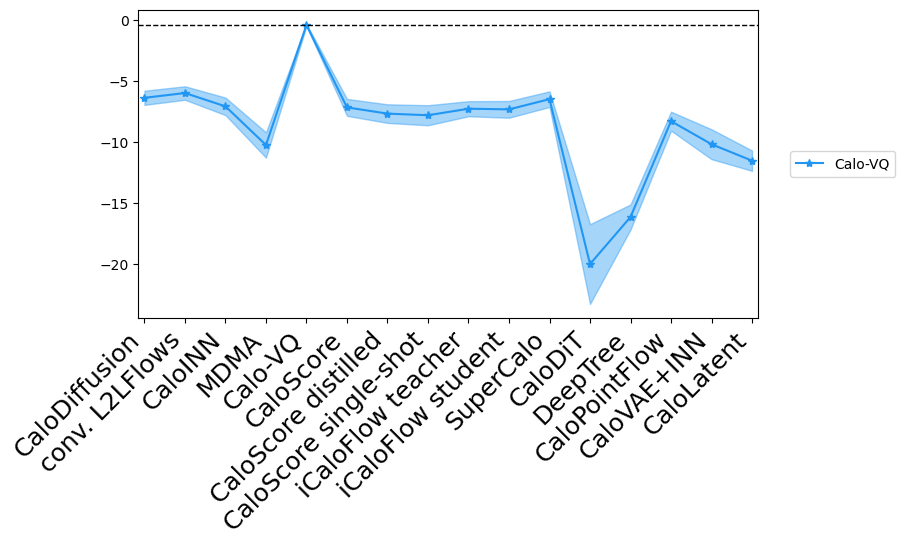

class 4 has maximum posterior in class 4


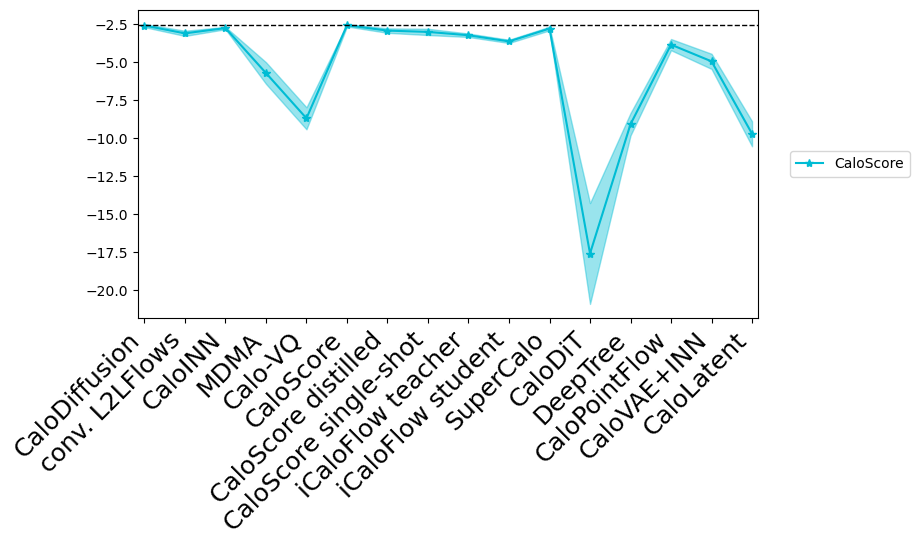

class 5 has maximum posterior in class 5


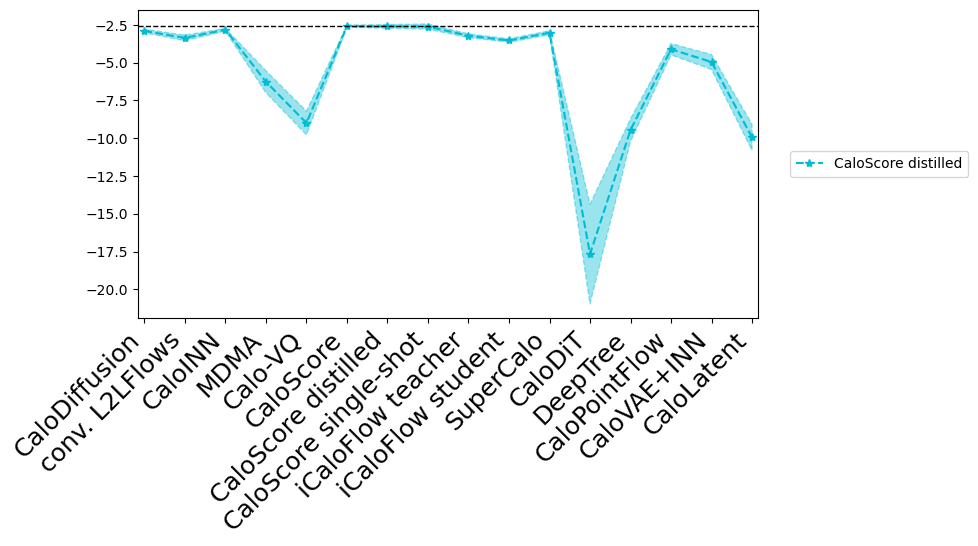

class 6 has maximum posterior in class 5


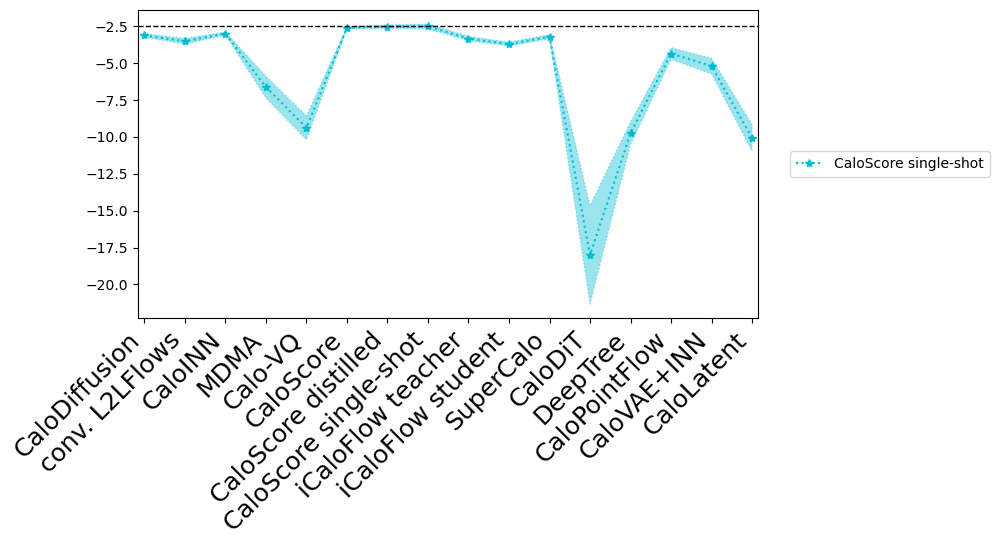

class 7 has maximum posterior in class 7


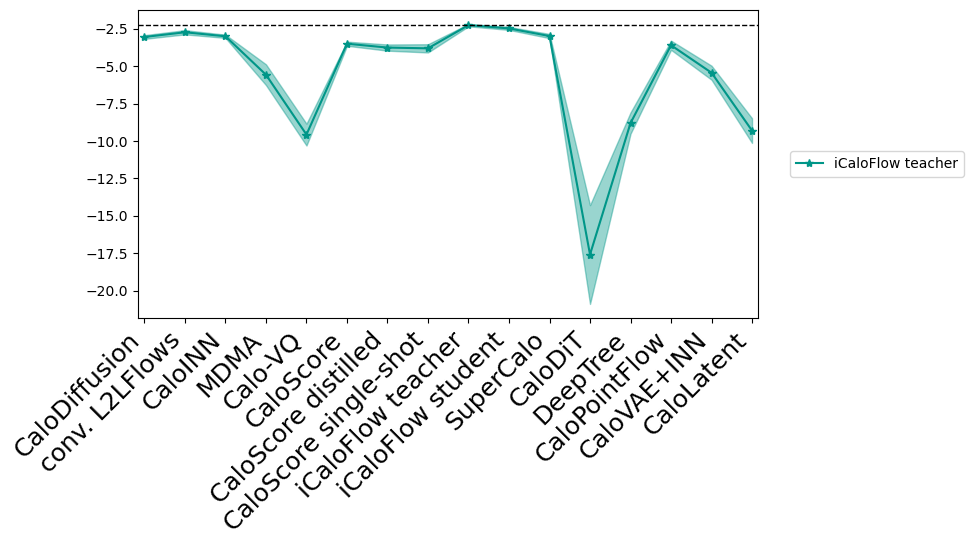

class 8 has maximum posterior in class 8


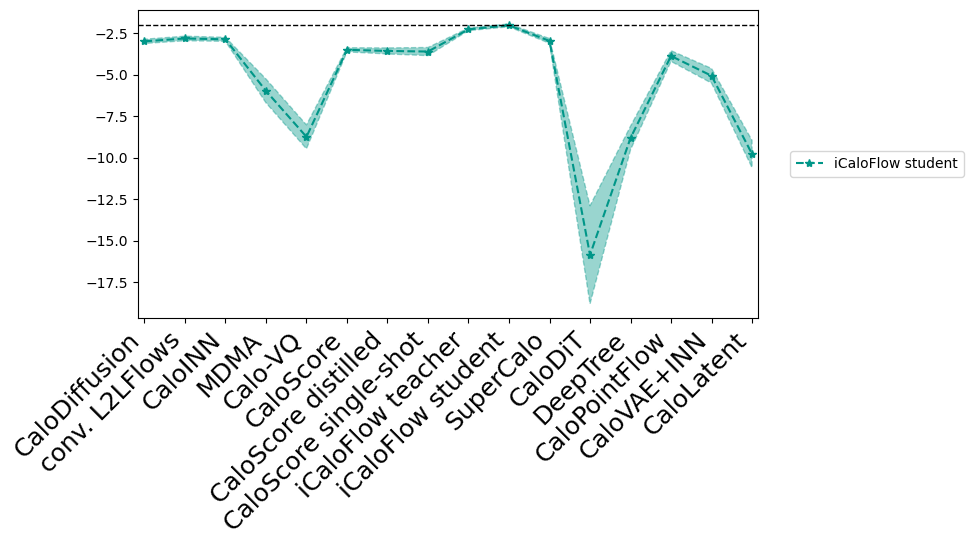

class 9 has maximum posterior in class 9


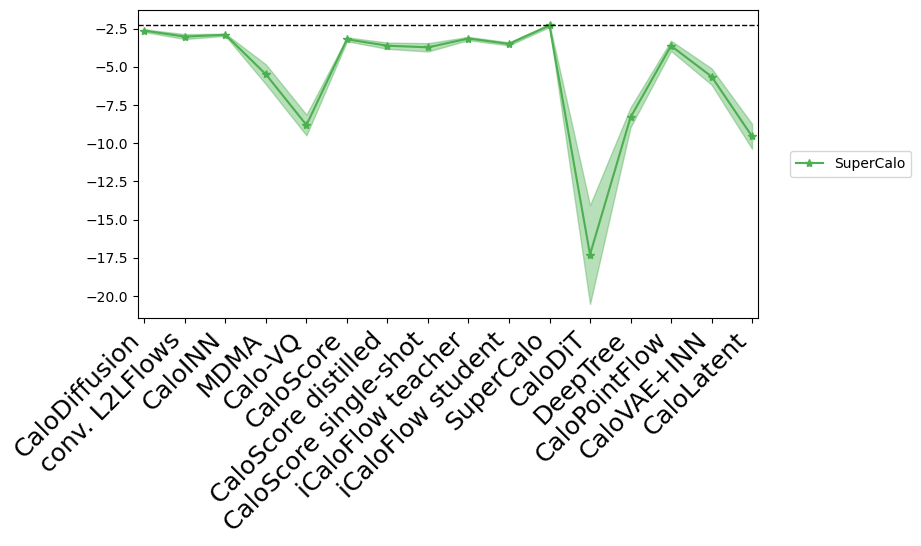

class 10 has maximum posterior in class 10


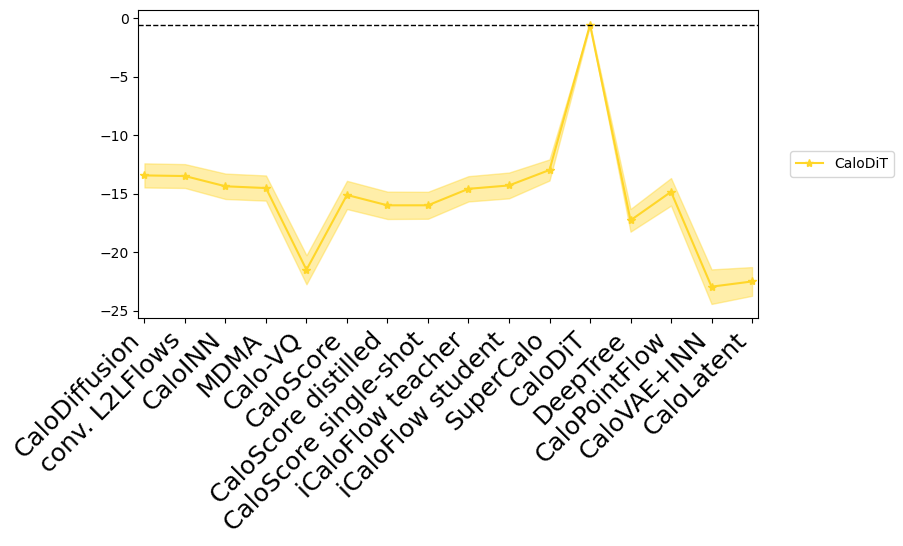

class 11 has maximum posterior in class 11


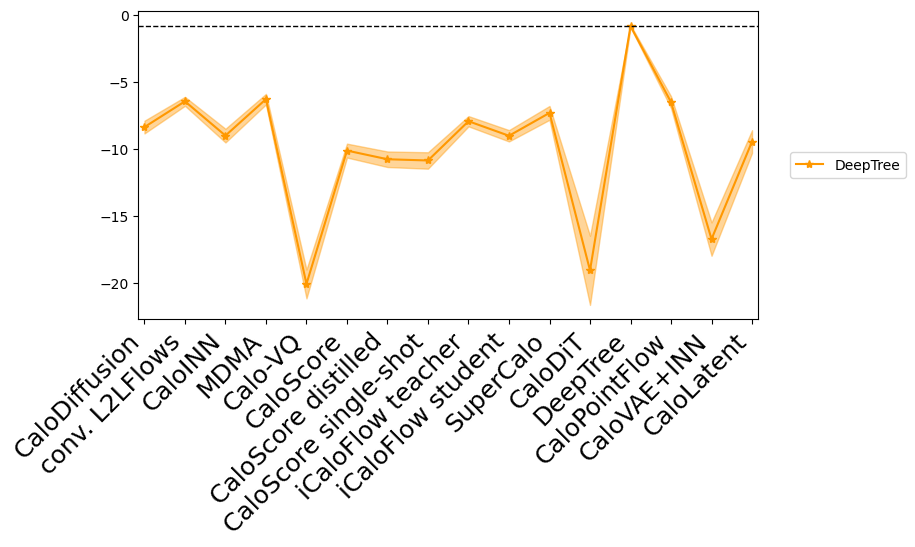

class 12 has maximum posterior in class 12


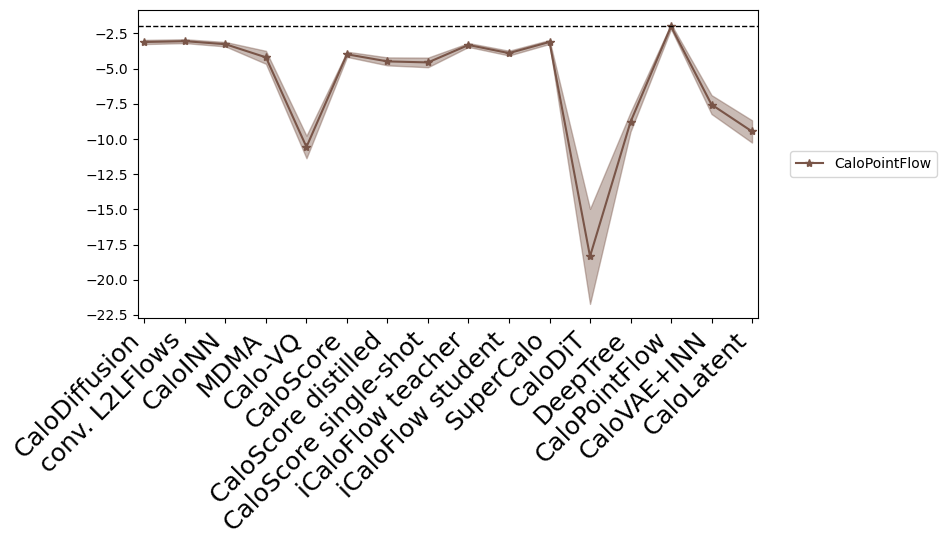

class 13 has maximum posterior in class 13


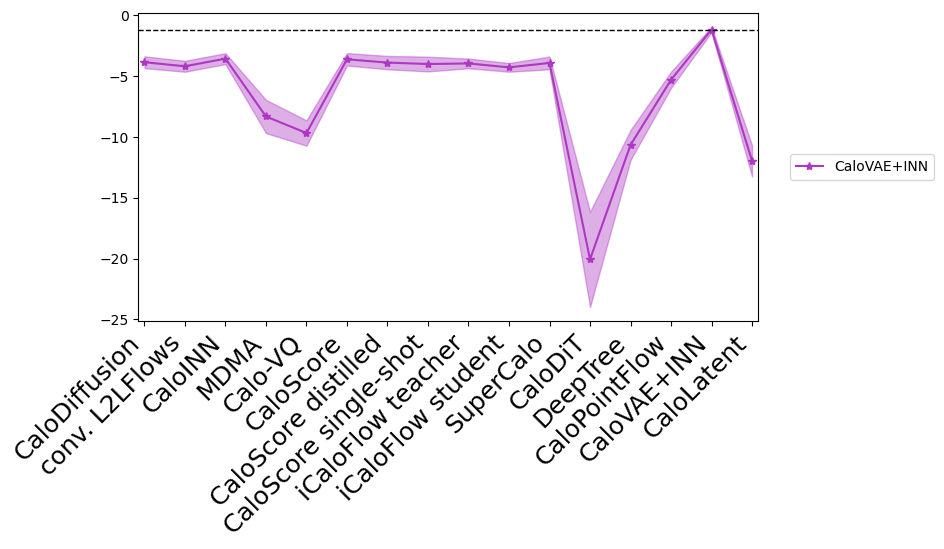

class 14 has maximum posterior in class 14


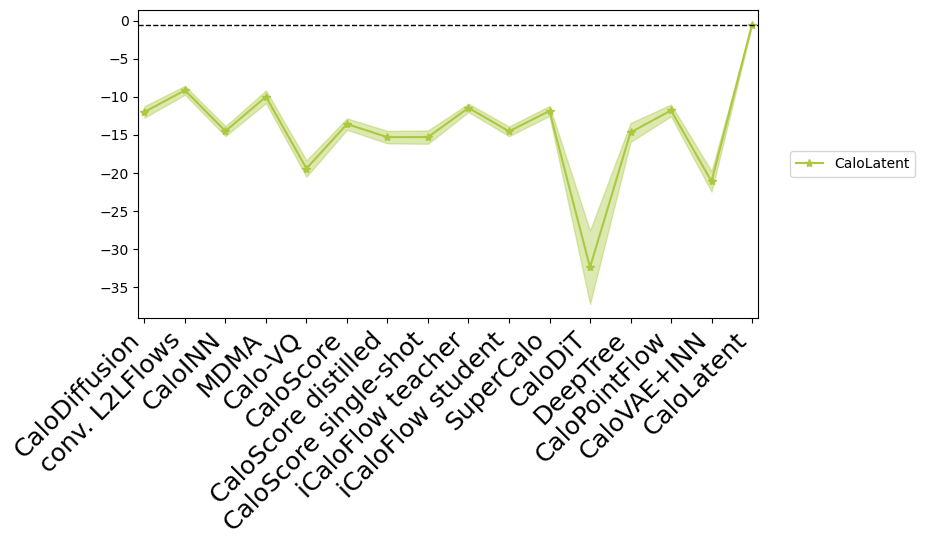

class 15 has maximum posterior in class 15


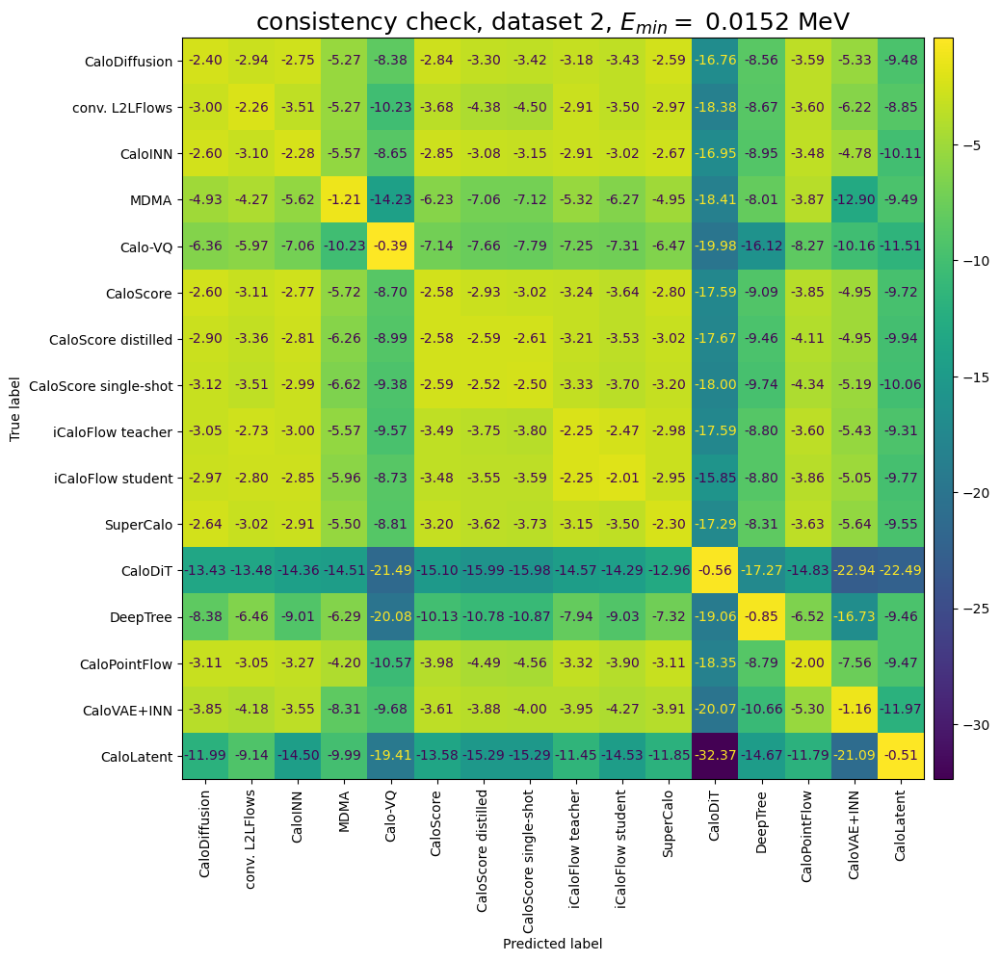

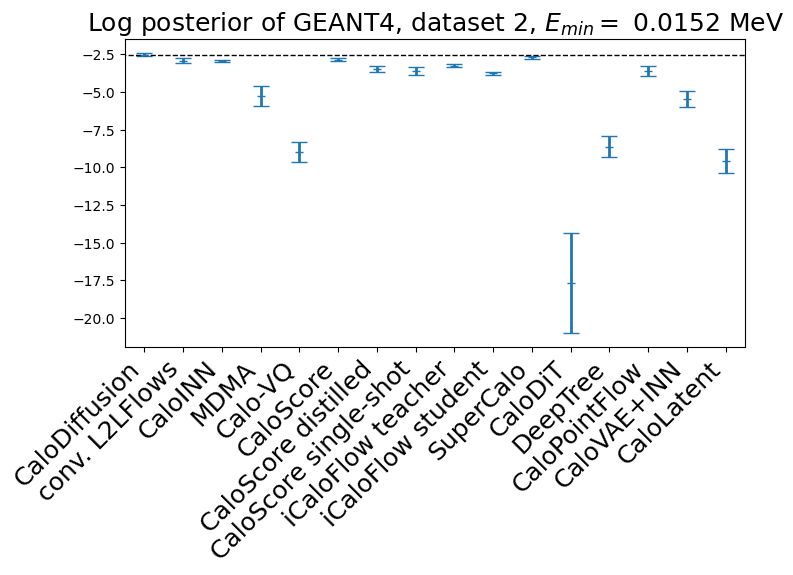

CaloDiffusion            log posterior:    -2.5095 +/- 0.1074,    place:  1
conv. L2LFlows           log posterior:    -2.9188 +/- 0.1570,    place:  5
CaloINN                  log posterior:    -2.9166 +/- 0.0780,    place:  4
MDMA                     log posterior:    -5.2583 +/- 0.6520,    place: 11
Calo-VQ                  log posterior:    -8.9718 +/- 0.6873,    place: 14
CaloScore                log posterior:    -2.8580 +/- 0.0928,    place:  3
CaloScore distilled      log posterior:    -3.4456 +/- 0.1932,    place:  7
CaloScore single-shot    log posterior:    -3.5760 +/- 0.2624,    place:  8
iCaloFlow teacher        log posterior:    -3.2589 +/- 0.1045,    place:  6
iCaloFlow student        log posterior:    -3.7482 +/- 0.1051,    place: 10
SuperCalo                log posterior:    -2.6931 +/- 0.1075,    place:  2
CaloDiT                  log posterior:   -17.6721 +/- 3.3136,    place: 16
DeepTree                 log posterior:    -8.6394 +/- 0.7002,    place: 13
CaloPointFlo

In [25]:
run_accuracy_means = final_accuracy.mean(axis=-1)

for i in range(num_ds2):
    print(f"Accuracy of model {i:2d}, which is {id_dict[conversion_to_submission_id[i]]:25s} is {run_accuracy_means[:,i].mean():.4f} +/- {run_accuracy_means[:,i].std():.4f}.")

print('\n')
for i in range(num_ds2):
    plt.figure(figsize=(8,4))
    plt.plot(np.linspace(0, 3*num_ds2 + 1, num_ds2), log_post_by_model.mean(axis=0)[i], '*', label=id_dict[conversion_to_submission_id[i]], **kwargs_dict[conversion_to_submission_id[i]])  # +(1./num_ds1_pions)*i
    plt.fill_between(np.linspace(0, 3*num_ds2 + 1, num_ds2), log_post_by_model.mean(axis=0)[i]-log_post_by_model.std(axis=0)[i], log_post_by_model.mean(axis=0)[i]+log_post_by_model.std(axis=0)[i], label='_please_dont', alpha=0.4, **kwargs_dict[conversion_to_submission_id[i]])
    
    plt.xlim(-0.5, 3*num_ds2 + 1.5) # 2.5
    plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left")
    plt.hlines(np.max(log_post_by_model.mean(axis=0)[i]), xmin=-0.5, xmax=3*num_ds2 + 1.5, color = 'k', linestyle='dashed', linewidth=1)
    plt.gca().set_xticks(np.linspace(0, 3*num_ds2 + 1, num_ds2))
    plt.gca().set_xticklabels([id_dict[conversion_to_submission_id[i]] for i in range(num_ds2)], rotation=45, ha='right', fontsize=FS)

    plt.savefig(f'results_fig/cls/ds2_check_{i}.pdf', dpi=300, bbox_inches='tight')
    plt.show()
    print(f"class {i} has maximum posterior in class {np.argmax(log_post_by_model.mean(axis=0)[i])}")

plt.figure(figsize=(10,10))
disp = ConfusionMatrixDisplay(confusion_matrix=log_post_by_model.mean(axis=0), 
                              display_labels=[id_dict[conversion_to_submission_id[i]] for i in range(num_ds2)])
disp.plot(xticks_rotation='vertical', ax=plt.gca(), colorbar=False, values_format=".2f")
plt.title(f"consistency check, dataset 2, $E_{{min}}=$ {MIN_ENERGY:.4f} MeV", fontsize=FS)
cax = plt.gcf().add_axes([plt.gca().get_position().x1+0.01,plt.gca().get_position().y0,0.02,plt.gca().get_position().height])
plt.colorbar(disp.im_,  cax=cax)
plt.savefig(f'results_fig/cls/ds2_confusion.pdf', dpi=300, bbox_inches='tight')
plt.show()
    
plt.figure(figsize=(8,4))
plt.errorbar(np.arange(num_ds2), log_truth.mean(axis=0), yerr=log_truth.std(axis=0), elinewidth=2, marker='_', capsize=6, linestyle='None')
plt.hlines(np.max(log_truth.mean(axis=0)), xmin=-1, xmax=num_ds2, color = 'k', linestyle='dashed', linewidth=1)
plt.xlim(-0.5, num_ds2-0.5)
plt.title(f"Log posterior of GEANT4, dataset 2, $E_{{min}}=$ {MIN_ENERGY:.4f} MeV", fontsize=FS)
plt.gca().set_xticks(np.arange(num_ds2))
plt.gca().set_xticklabels([id_dict[conversion_to_submission_id[i]] for i in range(num_ds2)], rotation=45, ha='right', fontsize=FS)
plt.savefig(f'results_fig/cls/ds2_truth.pdf', dpi=300, bbox_inches='tight')
plt.show()

score_order = np.argsort(np.argsort(-log_truth.mean(axis=0)))+1
for i in range(num_ds2):
    print(f"{id_dict[conversion_to_submission_id[i]]:24s} log posterior:   {log_truth.mean(axis=0)[i]:8.4f} +/- {log_truth.std(axis=0)[i]:6.4f},    place: {score_order[i]:2d}")

### HLF - dataset 3

In [ ]:
# compute HLF
MIN_ENERGY = 0.5e-3/0.033
HLF_3 = [HLF.HighLevelFeatures('electron', 'CaloChallenge_homepage/code/binning_dataset_3.xml') for _ in range(len(ds3_dict)+1)]
E_inc, showers = extract_info('../scratch_CaloChallenge/data/official/dataset_3_joined.hdf5')
HLF_3[0].Einc = E_inc
ref_showers = showers
HLF_3[0].CalculateFeatures(showers)

ds3_results_dict = {'MIN_ENERGY': MIN_ENERGY}

for iter_id, submission_id in enumerate(ds3_dict):
    print(f"working on {ds3_dict[submission_id]} with id {submission_id}")
    E_inc, showers = extract_info(ds3_dict[submission_id])
    showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
    HLF_3[iter_id+1].Einc = E_inc
    HLF_3[iter_id+1].sep_cells = get_sep_cell_dist(showers, ref_showers, shower_direct=True)
    HLF_3[iter_id+1].CalculateFeatures(showers)

with open('ds3.pkl', 'wb') as handle:
    pickle.dump((HLF_3, ds3_results_dict), handle)
                    
print(f"done")

In [ ]:
# extract data to be plotted

with open('ds3.pkl', 'rb') as handle:
    HLF_3, ds3_results_dict = pickle.load(handle)

ds3_results_dict['E_layer_dict'] = {}
ds3_results_dict['EC_eta_dict'] = {}
ds3_results_dict['EC_phi_dict'] = {}
ds3_results_dict['EC_eta_width_dict'] = {}
ds3_results_dict['EC_phi_width_dict'] = {}
ds3_results_dict['Sparsity_layer_dict'] = {}
ds3_results_dict['EC_r_dict'] = {}
ds3_results_dict['EC_r_width_dict'] = {}
ds3_results_dict['cell_dist'] = {}
ds3_results_dict['Etot_Einc_dist'] = {}

for iter_id, submission_id in enumerate(ds3_dict):
    print(f"working on {ds3_dict[submission_id]} with id {submission_id}")
    ds3_results_dict['E_layer_dict'][submission_id] = get_sep_E_layers(HLF_3[iter_id+1], HLF_3[0])
    print(f"working on {ds3_dict[submission_id]} with id {submission_id}")
    ds3_results_dict['EC_eta_dict'][submission_id] = get_sep_ECEtas(HLF_3[iter_id+1], HLF_3[0], '3')
    print(f"working on {ds3_dict[submission_id]} with id {submission_id}")
    ds3_results_dict['EC_phi_dict'][submission_id] = get_sep_ECPhis(HLF_3[iter_id+1], HLF_3[0], '3')
    print(f"working on {ds3_dict[submission_id]} with id {submission_id}")
    ds3_results_dict['EC_eta_width_dict'][submission_id] = get_sep_ECWidthEtas(HLF_3[iter_id+1], HLF_3[0], '3')
    print(f"working on {ds3_dict[submission_id]} with id {submission_id}")
    ds3_results_dict['EC_phi_width_dict'][submission_id] = get_sep_ECWidthPhis(HLF_3[iter_id+1], HLF_3[0], '3')
    print(f"working on {ds3_dict[submission_id]} with id {submission_id}")
    ds3_results_dict['Sparsity_layer_dict'][submission_id] = get_sep_Sparsity_layers(HLF_3[iter_id+1], HLF_3[0])
    print(f"working on {ds3_dict[submission_id]} with id {submission_id}")
    ds3_results_dict['EC_r_dict'][submission_id] = get_sep_ECR(HLF_3[iter_id+1], HLF_3[0], '3')
    print(f"working on {ds3_dict[submission_id]} with id {submission_id}")
    ds3_results_dict['EC_r_width_dict'][submission_id] = get_sep_ECWidthR(HLF_3[iter_id+1], HLF_3[0], '3')
    print(f"working on {ds3_dict[submission_id]} with id {submission_id}")
    ds3_results_dict['Etot_Einc_dist'][submission_id] = get_sep_Etot_Einc(HLF_3[iter_id+1], HLF_3[0])
    print(f"working on {ds3_dict[submission_id]} with id {submission_id}")
    ds3_results_dict['cell_dist'][submission_id] = HLF_3[iter_id+1].sep_cells

with open('ds3.pkl', 'wb') as handle:
    pickle.dump((HLF_3, ds3_results_dict), handle)

print(f"done")

In [11]:
MIN_ENERGY = 0.5e-3/0.033

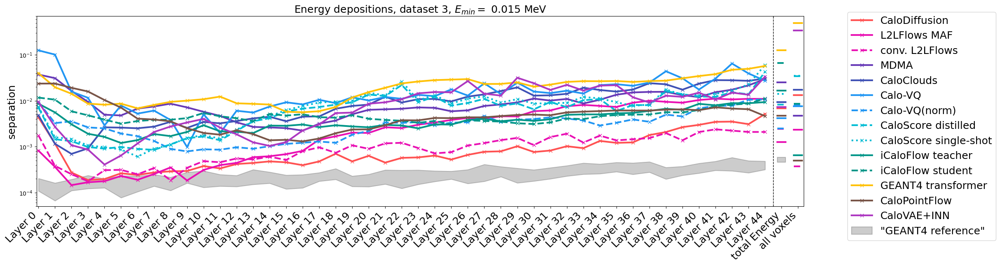

In [13]:
# energy depositions

with open('ds3.pkl', 'rb') as handle:
    HLF_3, ds3_results_dict = pickle.load(handle)
with open("ds3_reference.pkl", 'rb') as handle:
    ds3_reference_dict = pickle.load(handle)


plt.figure(figsize=(24,6), facecolor='white')
x_scan = np.arange(45+2)

for entry in ds3_results_dict['E_layer_dict']:
    if entry in []:
        continue
    plt.plot(x_scan[:45], ds3_results_dict['E_layer_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])
    #plt.plot(x_scan[45:], [ds3_results_dict['Etot_Einc_dist'][entry], ds3_results_dict['cell_dist'][entry]], marker='o', label="_please_dont", linewidth=3., **kwargs_dict[entry])
    plt.plot([x_scan[45]-0.25, x_scan[45]+0.25], np.repeat([ds3_results_dict['Etot_Einc_dist'][entry]], 2), marker=None, label="_please_dont", linewidth=3., **kwargs_dict[entry])
    plt.plot([x_scan[46]-0.25, x_scan[46]+0.25], np.repeat([ds3_results_dict['cell_dist'][entry]], 2), marker=None, label="_please_dont", linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds3_reference_dict, 'E_layer_dict')
plt.fill_between(x_scan[:45], geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
geant_min, geant_max = get_min_max_from_dict(ds3_reference_dict, 'Etot_Einc_dist')
plt.fill_between([x_scan[45]-0.25, x_scan[45]+0.25], np.repeat([geant_min], 2), np.repeat([geant_max], 2), label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])
geant_min, geant_max = get_min_max_from_dict(ds3_reference_dict, 'cell_dist')
plt.fill_between([x_scan[46]-0.25, x_scan[46]+0.25], np.repeat([geant_min], 2), np.repeat([geant_max], 2), label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])


#plt.plot(x_scan[:45], ds3_reference_dict['E_layer_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
#plt.plot([x_scan[45]-0.25, x_scan[45]+0.25], np.repeat([ds3_reference_dict['Etot_Einc_dist']], 2), marker=None, label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])
#plt.plot([x_scan[46]-0.25, x_scan[46]+0.25], np.repeat([ds3_reference_dict['cell_dist']], 2), marker=None, label="_please_dont", linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.35])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.ylim(5e-5, 7e-1)
labels = [f'Layer {i}' for i in range(45)]
labels.append('total Energy')
labels.append('all voxels')
plt.gca().set_xticklabels(labels, rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.05, 1.05), fontsize=FS)
plt.title(f"Energy depositions, dataset 3, $E_{{min}}=$ {ds3_results_dict['MIN_ENERGY']:.3f} MeV", fontsize=FS)
plt.axvline(x = 44.5, color = 'k', linestyle='dashed', linewidth=1)
plt.savefig('results_fig/sep/ds3_depositions.pdf', dpi=300, bbox_inches='tight')
plt.show()


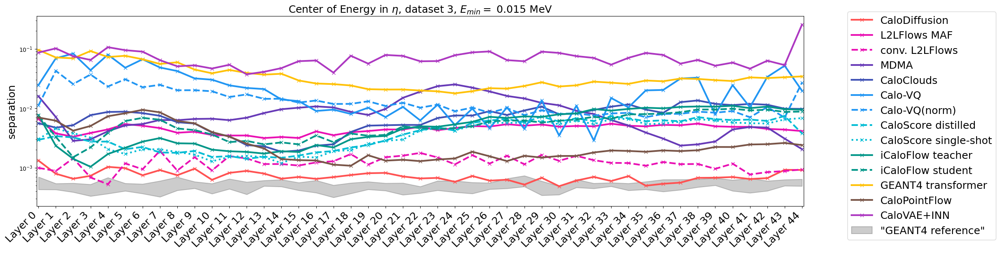

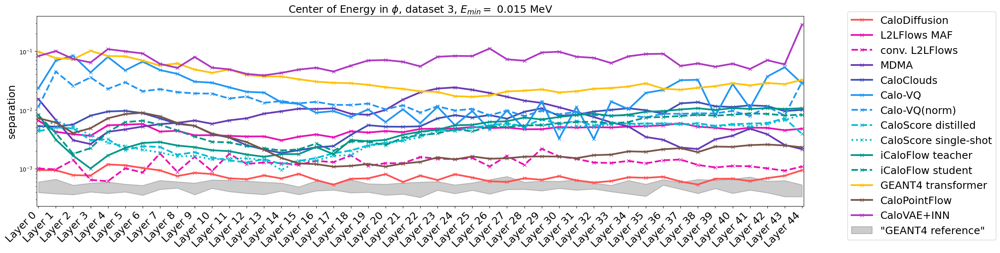

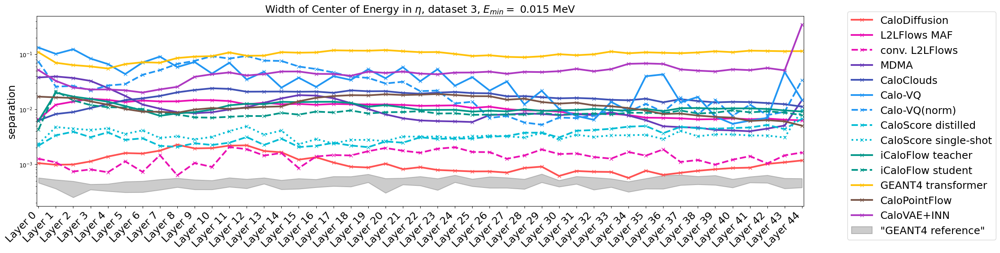

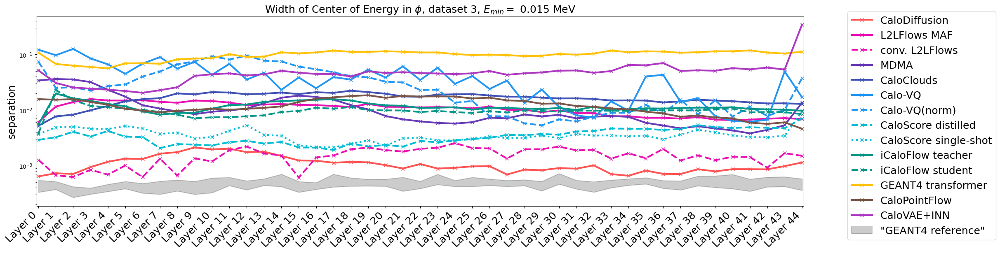

In [14]:
# EC and its width

with open('ds3.pkl', 'rb') as handle:
    HLF_3, ds3_results_dict = pickle.load(handle)
with open("ds3_reference.pkl", 'rb') as handle:
    ds3_reference_dict = pickle.load(handle)

plt.figure(figsize=(24,6), facecolor='white')
x_scan = np.arange(45)

for entry in ds3_results_dict['EC_eta_dict']:
    if entry in []:
        continue
    plt.plot(x_scan, ds3_results_dict['EC_eta_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds3_reference_dict, 'EC_eta_dict')
plt.fill_between(x_scan, geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

#plt.plot(x_scan, ds3_reference_dict['EC_eta_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels([f'Layer {i}' for i in range(45)], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.05, 1.05), fontsize=FS)
plt.title(f"Center of Energy in $\eta$, dataset 3, $E_{{min}}=$ {ds3_results_dict['MIN_ENERGY']:.3f} MeV", fontsize=FS)
plt.savefig('results_fig/sep/ds3_CE_eta.pdf', dpi=300, bbox_inches='tight')
plt.show()
          
          
plt.figure(figsize=(24,6), facecolor='white')
x_scan = np.arange(45)

for entry in ds3_results_dict['EC_phi_dict']:
    if entry in []:
        continue
    plt.plot(x_scan, ds3_results_dict['EC_phi_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds3_reference_dict, 'EC_phi_dict')
plt.fill_between(x_scan, geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

#plt.plot(x_scan, ds3_reference_dict['EC_phi_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels([f'Layer {i}' for i in range(45)], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.05, 1.05), fontsize=FS)
plt.title(f"Center of Energy in $\phi$, dataset 3, $E_{{min}}=$ {ds3_results_dict['MIN_ENERGY']:.3f} MeV", fontsize=FS)
plt.savefig('results_fig/sep/ds3_CE_phi.pdf', dpi=300, bbox_inches='tight')
plt.show()


plt.figure(figsize=(24,6), facecolor='white')
x_scan = np.arange(45)

for entry in ds3_results_dict['EC_eta_width_dict']:
    if entry in []:
        continue
    plt.plot(x_scan, ds3_results_dict['EC_eta_width_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds3_reference_dict, 'EC_eta_width_dict')
plt.fill_between(x_scan, geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])
    
#plt.plot(x_scan, ds3_reference_dict['EC_eta_width_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels([f'Layer {i}' for i in range(45)], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.05, 1.05), fontsize=FS)
plt.title(f"Width of Center of Energy in $\eta$, dataset 3, $E_{{min}}=$ {ds3_results_dict['MIN_ENERGY']:.3f} MeV", fontsize=FS)
plt.savefig('results_fig/sep/ds3_width_CE_eta.pdf', dpi=300, bbox_inches='tight')
plt.show()
          
          
plt.figure(figsize=(24,6), facecolor='white')
x_scan = np.arange(45)

for entry in ds3_results_dict['EC_phi_width_dict']:
    if entry in []:
        continue
    plt.plot(x_scan, ds3_results_dict['EC_phi_width_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds3_reference_dict, 'EC_phi_width_dict')
plt.fill_between(x_scan, geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

#plt.plot(x_scan, ds3_reference_dict['EC_phi_width_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels([f'Layer {i}' for i in range(45)], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.05, 1.05), fontsize=FS)
plt.title(f"Width of Center of Energy in $\phi$, dataset 3, $E_{{min}}=$ {ds3_results_dict['MIN_ENERGY']:.3f} MeV", fontsize=FS)
plt.savefig('results_fig/sep/ds3_width_CE_phi.pdf', dpi=300, bbox_inches='tight')
plt.show()




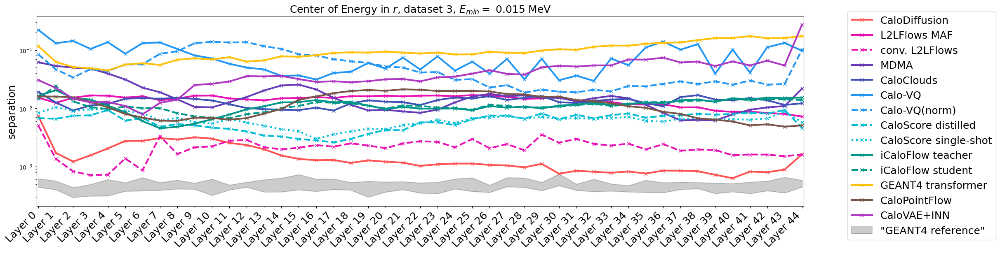

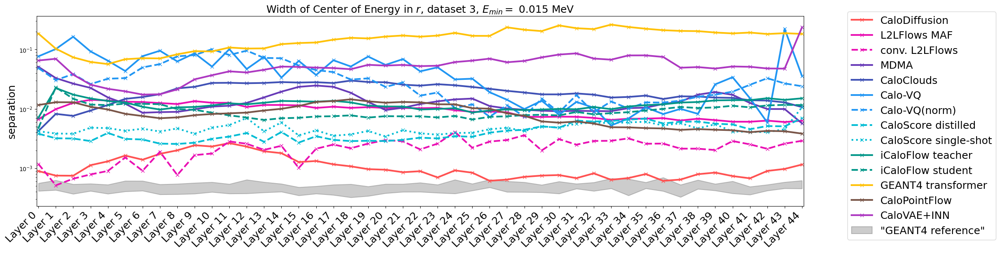

In [15]:
# EC and its width in r

with open('ds3.pkl', 'rb') as handle:
    HLF_3, ds3_results_dict = pickle.load(handle)
with open("ds3_reference.pkl", 'rb') as handle:
    ds3_reference_dict = pickle.load(handle)

plt.figure(figsize=(24,6), facecolor='white')
x_scan = np.arange(45)

for entry in ds3_results_dict['EC_r_dict']:
    if entry in []:
        continue
    plt.plot(x_scan, ds3_results_dict['EC_r_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds3_reference_dict, 'EC_r_dict')
plt.fill_between(x_scan, geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

#plt.plot(x_scan, ds3_reference_dict['EC_r_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels([f'Layer {i}' for i in range(45)], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.05, 1.05), fontsize=FS)
plt.title(f"Center of Energy in $r$, dataset 3, $E_{{min}}=$ {ds3_results_dict['MIN_ENERGY']:.3f} MeV", fontsize=FS)
plt.savefig('results_fig/sep/ds3_CE_r.pdf', dpi=300, bbox_inches='tight')
plt.show()
                    
          
plt.figure(figsize=(24,6), facecolor='white')
x_scan = np.arange(45)

for entry in ds3_results_dict['EC_r_width_dict']:
    if entry in []:
        continue
    plt.plot(x_scan, ds3_results_dict['EC_r_width_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])

geant_min, geant_max = get_min_max_from_dict(ds3_reference_dict, 'EC_r_width_dict')
plt.fill_between(x_scan, geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

#plt.plot(x_scan, ds3_reference_dict['EC_r_width_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels([f'Layer {i}' for i in range(45)], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.05, 1.05), fontsize=FS)
plt.title(f"Width of Center of Energy in $r$, dataset 3, $E_{{min}}=$ {ds3_results_dict['MIN_ENERGY']:.3f} MeV", fontsize=FS)
plt.savefig('results_fig/sep/ds3_width_CE_r.pdf', dpi=300, bbox_inches='tight')
plt.show()


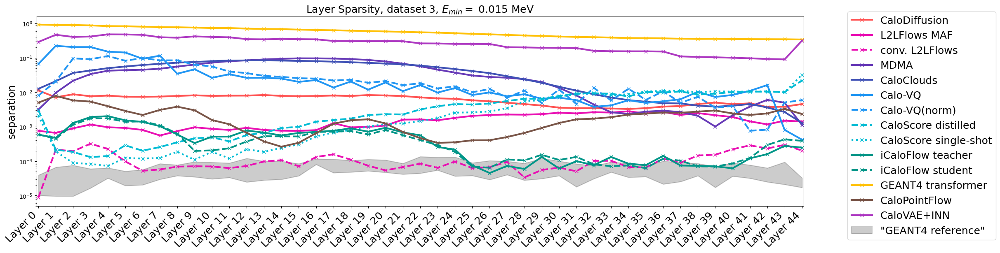

In [16]:
# layer sparsities

with open('ds3.pkl', 'rb') as handle:
    HLF_3, ds3_results_dict = pickle.load(handle)
with open("ds3_reference.pkl", 'rb') as handle:
    ds3_reference_dict = pickle.load(handle)

plt.figure(figsize=(24,6), facecolor='white')
x_scan = np.arange(45)

for entry in ds3_results_dict['Sparsity_layer_dict']:
    if entry in []:
        continue
    plt.plot(x_scan, ds3_results_dict['Sparsity_layer_dict'][entry], marker='x', label=id_dict[entry], linewidth=3., **kwargs_dict[entry])
geant_min, geant_max = get_min_max_from_dict(ds3_reference_dict, 'Sparsity_layer_dict')
plt.fill_between(x_scan, geant_min, geant_max, label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

#plt.plot(x_scan, ds3_reference_dict['Sparsity_layer_dict'], marker='x', label=id_dict['geant'], linewidth=1.5, **kwargs_dict['geant'])

plt.xlim([x_scan[0]-0.1, x_scan[-1]+0.1])
plt.yscale("log")
plt.ylabel('separation', fontsize=FS)
plt.gca().set_xticks(x_scan)
plt.gca().set_xticklabels([f'Layer {i}' for i in range(45)], rotation=45, ha='right', fontsize=FS)
plt.legend(bbox_to_anchor=(1.05, 1.05), fontsize=FS)
plt.title(f"Layer Sparsity, dataset 3, $E_{{min}}=$ {ds3_results_dict['MIN_ENERGY']:.3f} MeV", fontsize=FS)
plt.savefig('results_fig/sep/ds3_sparsity.pdf', dpi=300, bbox_inches='tight')
plt.show()


### LLF - dataset 3

In [10]:
MIN_ENERGY = 0.5e-3/0.033

np.random.seed(2104)

first_run = False

if first_run:
    train_data = np.memmap('../scratch_CaloChallenge/train_ds3_memmap.dat', mode='w+', shape=(num_ds3*60000, 40502), dtype=np.float32)
    test_data = np.memmap('../scratch_CaloChallenge/test_ds3_memmap.dat', mode='w+', shape=(num_ds3*20000, 40502), dtype=np.float32)
    val_data = np.memmap('../scratch_CaloChallenge/val_ds3_memmap.dat', mode='w+', shape=(num_ds3*20000, 40502), dtype=np.float32)

    shuffled_idx_train = np.arange(len(train_data))
    shuffled_idx_test = np.arange(len(test_data))
    shuffled_idx_val = np.arange(len(val_data))

    np.random.shuffle(shuffled_idx_train)
    np.random.shuffle(shuffled_idx_test)
    np.random.shuffle(shuffled_idx_val)

E_inc, showers = extract_info('../scratch_CaloChallenge/data/official/dataset_3_joined.hdf5')
showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
truth_data = np.concatenate([np.log10(E_inc), showers / E_inc, -1*np.ones_like(E_inc)], axis=1)

conversion_to_submission_id = {}

for iter_id, submission_id in enumerate(ds3_dict):
    print(f"working on {ds3_dict[submission_id]} with submission id {submission_id} and classifier label {iter_id}")
    if first_run:
        E_inc, showers = extract_info(ds3_dict[submission_id])
        showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
        data = np.concatenate([np.log10(E_inc), showers / E_inc, iter_id*np.ones_like(E_inc)], axis=1)
        train_data[shuffled_idx_train[iter_id*60000:(iter_id+1)*60000]] = data[:60000]
        test_data[shuffled_idx_test[iter_id*20000:(iter_id+1)*20000]] = data[60000:80000]
        val_data[shuffled_idx_val[iter_id*20000:(iter_id+1)*20000]] = data[80000:]
    conversion_to_submission_id[iter_id] = submission_id

print("done")

working on ../scratch_CaloChallenge/data/Amram/ds3_1.hdf5 with submission id 1 and classifier label 0
working on ../scratch_CaloChallenge/data/Buss/ds3_2.hdf5 with submission id 2 and classifier label 1
working on ../scratch_CaloChallenge/data/Buss/ds3_3.hdf5 with submission id 3 and classifier label 2
working on ../scratch_CaloChallenge/data/Kaech/ds3_5.hdf5 with submission id 5 and classifier label 3
working on ../scratch_CaloChallenge/data/Korol/ds3_6.hdf5 with submission id 6 and classifier label 4
working on ../scratch_CaloChallenge/data/Liu/ds3_7.hdf5 with submission id 7 and classifier label 5
working on ../scratch_CaloChallenge/data/Liu/ds3_31.hdf5 with submission id 31 and classifier label 6
working on ../scratch_CaloChallenge/data/Mikuni/ds3_9.hdf5 with submission id 9 and classifier label 7
working on ../scratch_CaloChallenge/data/Mikuni/ds3_10.hdf5 with submission id 10 and classifier label 8
working on ../scratch_CaloChallenge/data/Pang/ds3_13.hdf5 with submission id 13 an

In [11]:
train_data = np.memmap('../scratch_CaloChallenge/train_ds3_memmap.dat', mode='r+', shape=(num_ds3*60000, 40502), dtype=np.float32)
test_data = np.memmap('../scratch_CaloChallenge/test_ds3_memmap.dat', mode='r+', shape=(num_ds3*20000, 40502), dtype=np.float32)
val_data = np.memmap('../scratch_CaloChallenge/val_ds3_memmap.dat', mode='r+', shape=(num_ds3*20000, 40502), dtype=np.float32)

batch_size = 4000

train_dataset = TensorDataset(torch.from_numpy(train_data))
test_dataset = TensorDataset(torch.from_numpy(test_data))
val_dataset = TensorDataset(torch.from_numpy(val_data))
truth_dataset = TensorDataset(torch.from_numpy(truth_data))

train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=False) # was True
test_dataloader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)
truth_dataloader = DataLoader(truth_dataset, batch_size=batch_size, shuffle=False)

model architecture 
DNN(
  (inputlayer): Linear(in_features=40501, out_features=2048, bias=True)
  (outputlayer): Linear(in_features=2048, out_features=14, bias=True)
  (layers): Sequential(
    (0): Linear(in_features=40501, out_features=2048, bias=True)
    (1): LeakyReLU(negative_slope=0.01)
    (2): Dropout(p=0.0, inplace=False)
    (3): Linear(in_features=2048, out_features=2048, bias=True)
    (4): LeakyReLU(negative_slope=0.01)
    (5): Dropout(p=0.0, inplace=False)
    (6): Linear(in_features=2048, out_features=2048, bias=True)
    (7): LeakyReLU(negative_slope=0.01)
    (8): Dropout(p=0.0, inplace=False)
    (9): Linear(in_features=2048, out_features=14, bias=True)
  )
)
Model has 91369486 trainable parameters
evaluating this run:
Model multiclass_weights_3_ensemble_0.pt loaded
Evaluation loss 1.4606289292406593, accuracy 0.5362892857142857
preds shape (280000, 15)
preds shape (100000, 15)
Accuracy of model 0, which is CaloDiffusion is 0.22835.
Accuracy of model 1, which is L2

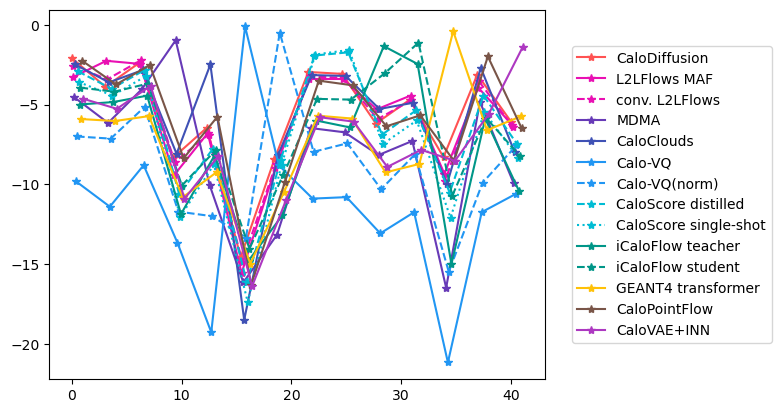

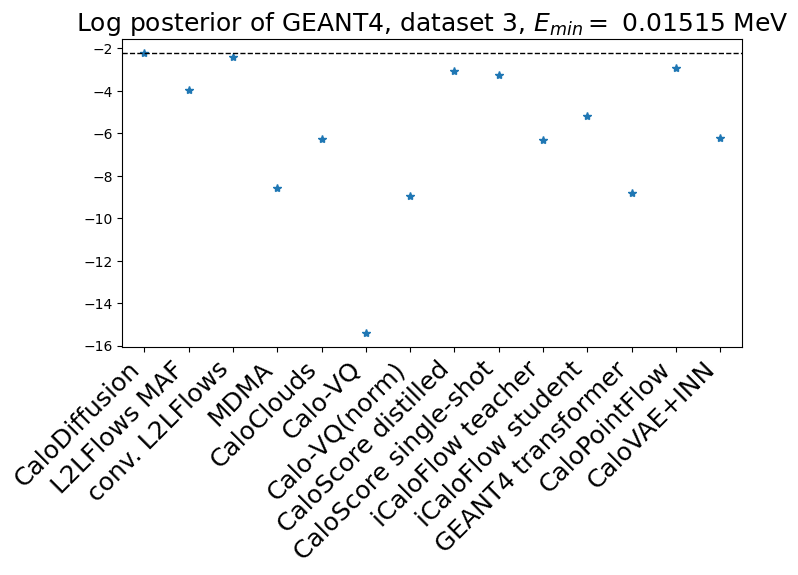

CaloDiffusion            log posterior:    -2.2138,    place:  1
L2LFlows MAF             log posterior:    -3.9453,    place:  6
conv. L2LFlows           log posterior:    -2.3850,    place:  2
MDMA                     log posterior:    -8.5558,    place: 11
CaloClouds               log posterior:    -6.2555,    place:  9
Calo-VQ                  log posterior:   -15.4035,    place: 14
Calo-VQ(norm)            log posterior:    -8.9395,    place: 13
CaloScore distilled      log posterior:    -3.0650,    place:  4
CaloScore single-shot    log posterior:    -3.2385,    place:  5
iCaloFlow teacher        log posterior:    -6.3068,    place: 10
iCaloFlow student        log posterior:    -5.1995,    place:  7
GEANT4 transformer       log posterior:    -8.8293,    place: 12
CaloPointFlow            log posterior:    -2.9399,    place:  3
CaloVAE+INN              log posterior:    -6.2016,    place:  8

  - - - -  

model architecture 
DNN(
  (inputlayer): Linear(in_features=40501, out_featu

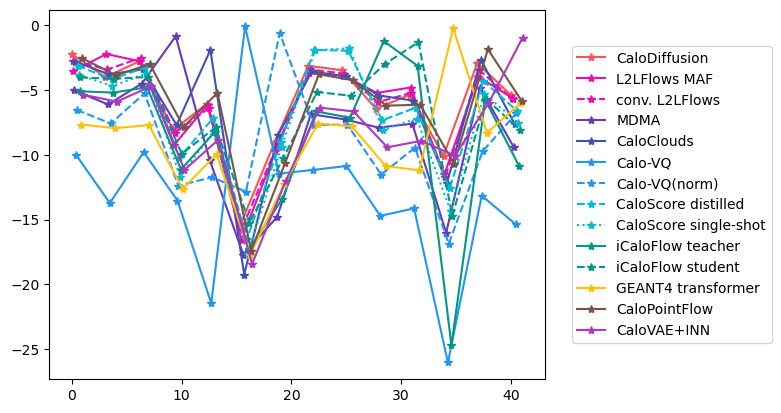

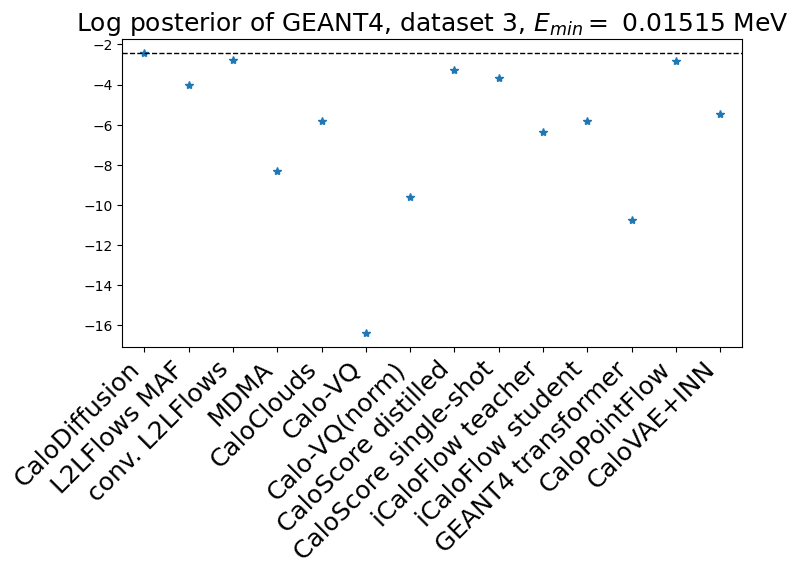

CaloDiffusion            log posterior:    -2.4278,    place:  1
L2LFlows MAF             log posterior:    -4.0481,    place:  6
conv. L2LFlows           log posterior:    -2.7891,    place:  2
MDMA                     log posterior:    -8.2958,    place: 11
CaloClouds               log posterior:    -5.8226,    place:  9
Calo-VQ                  log posterior:   -16.3767,    place: 14
Calo-VQ(norm)            log posterior:    -9.6159,    place: 12
CaloScore distilled      log posterior:    -3.2717,    place:  4
CaloScore single-shot    log posterior:    -3.6774,    place:  5
iCaloFlow teacher        log posterior:    -6.3815,    place: 10
iCaloFlow student        log posterior:    -5.8145,    place:  8
GEANT4 transformer       log posterior:   -10.7494,    place: 13
CaloPointFlow            log posterior:    -2.8538,    place:  3
CaloVAE+INN              log posterior:    -5.4607,    place:  7

  - - - -  

model architecture 
DNN(
  (inputlayer): Linear(in_features=40501, out_featu

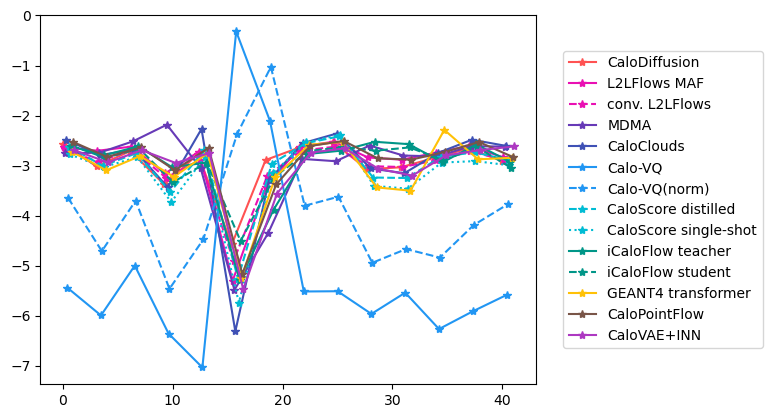

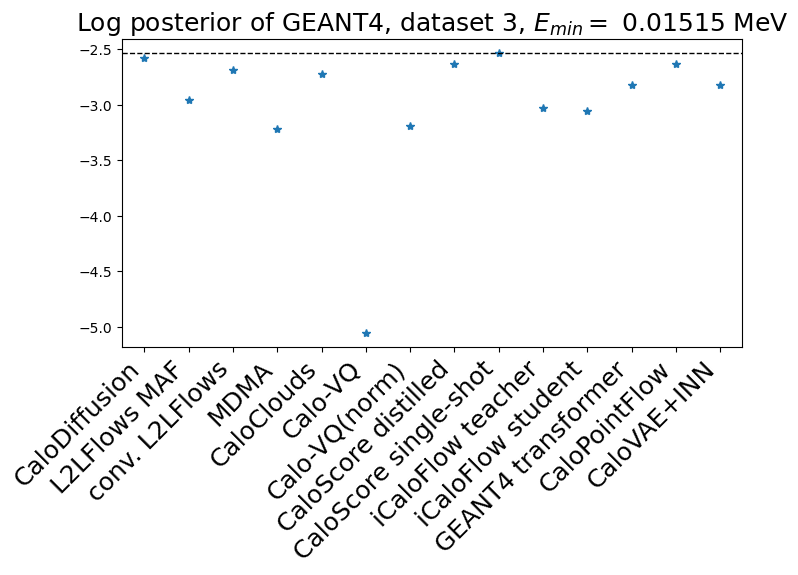

CaloDiffusion            log posterior:    -2.5773,    place:  2
L2LFlows MAF             log posterior:    -2.9589,    place:  9
conv. L2LFlows           log posterior:    -2.6847,    place:  5
MDMA                     log posterior:    -3.2154,    place: 13
CaloClouds               log posterior:    -2.7178,    place:  6
Calo-VQ                  log posterior:    -5.0553,    place: 14
Calo-VQ(norm)            log posterior:    -3.1888,    place: 12
CaloScore distilled      log posterior:    -2.6351,    place:  4
CaloScore single-shot    log posterior:    -2.5318,    place:  1
iCaloFlow teacher        log posterior:    -3.0282,    place: 10
iCaloFlow student        log posterior:    -3.0520,    place: 11
GEANT4 transformer       log posterior:    -2.8168,    place:  7
CaloPointFlow            log posterior:    -2.6326,    place:  3
CaloVAE+INN              log posterior:    -2.8213,    place:  8

  - - - -  

model architecture 
DNN(
  (inputlayer): Linear(in_features=40501, out_featu

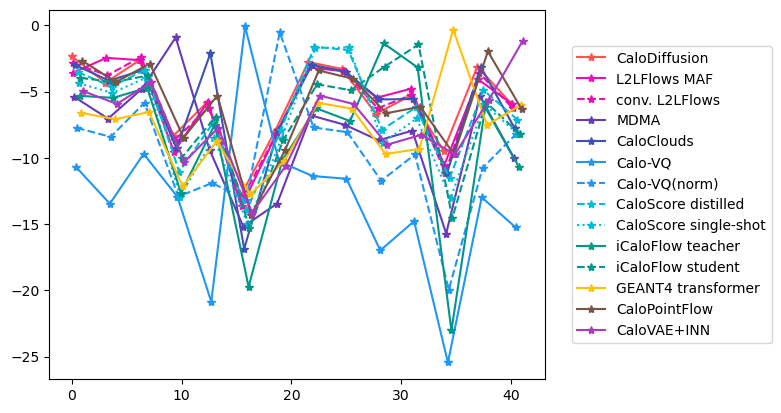

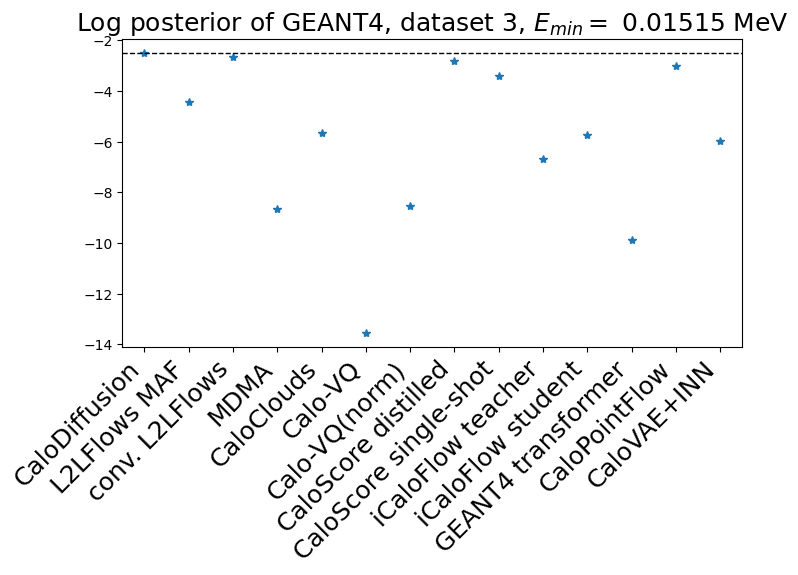

CaloDiffusion            log posterior:    -2.4922,    place:  1
L2LFlows MAF             log posterior:    -4.4431,    place:  6
conv. L2LFlows           log posterior:    -2.6456,    place:  2
MDMA                     log posterior:    -8.6635,    place: 12
CaloClouds               log posterior:    -5.6659,    place:  7
Calo-VQ                  log posterior:   -13.5440,    place: 14
Calo-VQ(norm)            log posterior:    -8.5173,    place: 11
CaloScore distilled      log posterior:    -2.8110,    place:  3
CaloScore single-shot    log posterior:    -3.3884,    place:  5
iCaloFlow teacher        log posterior:    -6.6923,    place: 10
iCaloFlow student        log posterior:    -5.7367,    place:  8
GEANT4 transformer       log posterior:    -9.8733,    place: 13
CaloPointFlow            log posterior:    -2.9918,    place:  4
CaloVAE+INN              log posterior:    -5.9589,    place:  9

  - - - -  

model architecture 
DNN(
  (inputlayer): Linear(in_features=40501, out_featu

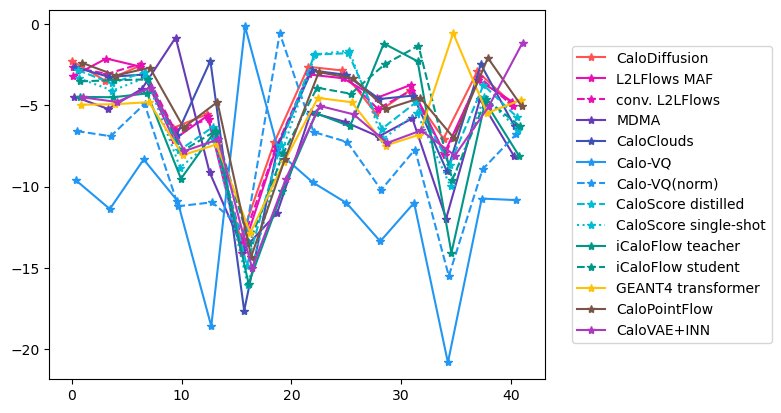

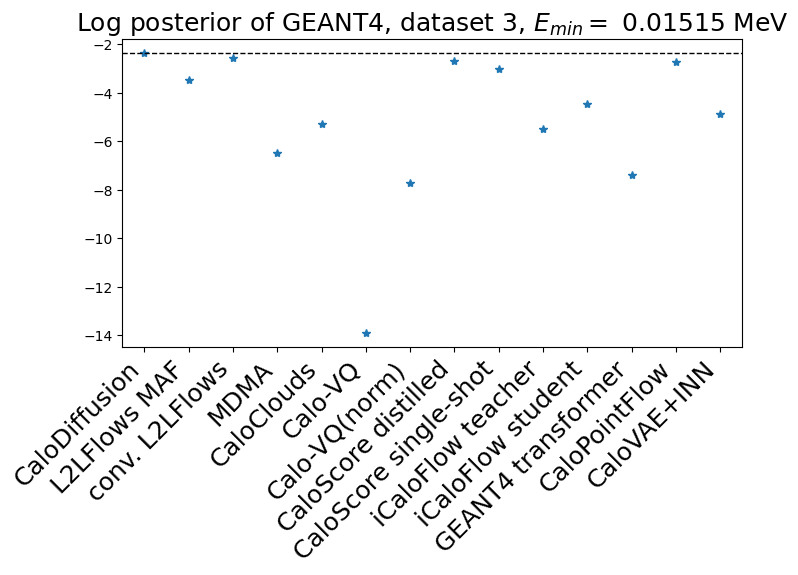

CaloDiffusion            log posterior:    -2.3540,    place:  1
L2LFlows MAF             log posterior:    -3.4882,    place:  6
conv. L2LFlows           log posterior:    -2.5673,    place:  2
MDMA                     log posterior:    -6.4867,    place: 11
CaloClouds               log posterior:    -5.2841,    place:  9
Calo-VQ                  log posterior:   -13.9085,    place: 14
Calo-VQ(norm)            log posterior:    -7.7182,    place: 13
CaloScore distilled      log posterior:    -2.6971,    place:  3
CaloScore single-shot    log posterior:    -3.0033,    place:  5
iCaloFlow teacher        log posterior:    -5.5032,    place: 10
iCaloFlow student        log posterior:    -4.4505,    place:  7
GEANT4 transformer       log posterior:    -7.3928,    place: 12
CaloPointFlow            log posterior:    -2.7458,    place:  4
CaloVAE+INN              log posterior:    -4.8811,    place:  8

  - - - -  

model architecture 
DNN(
  (inputlayer): Linear(in_features=40501, out_featu

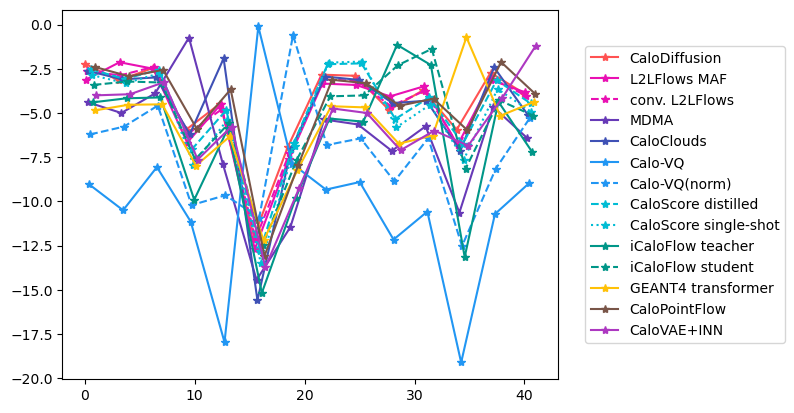

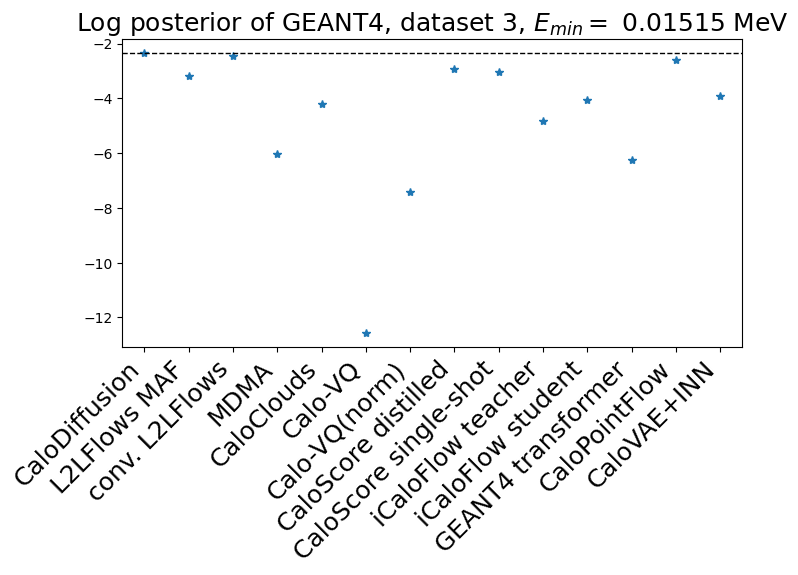

CaloDiffusion            log posterior:    -2.3424,    place:  1
L2LFlows MAF             log posterior:    -3.1812,    place:  6
conv. L2LFlows           log posterior:    -2.4543,    place:  2
MDMA                     log posterior:    -6.0329,    place: 11
CaloClouds               log posterior:    -4.2167,    place:  9
Calo-VQ                  log posterior:   -12.5642,    place: 14
Calo-VQ(norm)            log posterior:    -7.4069,    place: 13
CaloScore distilled      log posterior:    -2.9112,    place:  4
CaloScore single-shot    log posterior:    -3.0554,    place:  5
iCaloFlow teacher        log posterior:    -4.8386,    place: 10
iCaloFlow student        log posterior:    -4.0720,    place:  8
GEANT4 transformer       log posterior:    -6.2449,    place: 12
CaloPointFlow            log posterior:    -2.5824,    place:  3
CaloVAE+INN              log posterior:    -3.9015,    place:  7

  - - - -  

model architecture 
DNN(
  (inputlayer): Linear(in_features=40501, out_featu

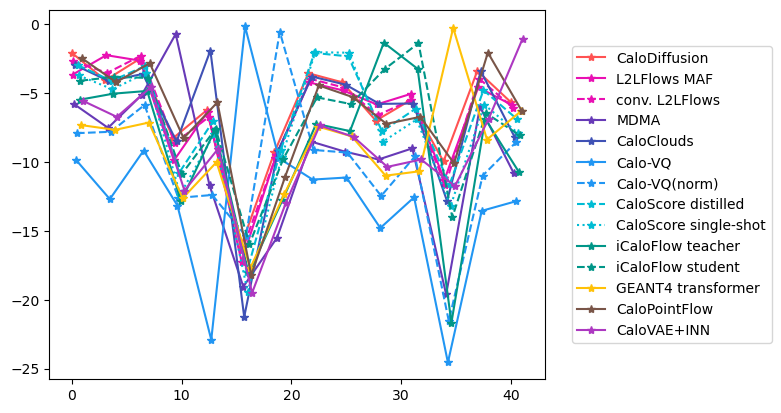

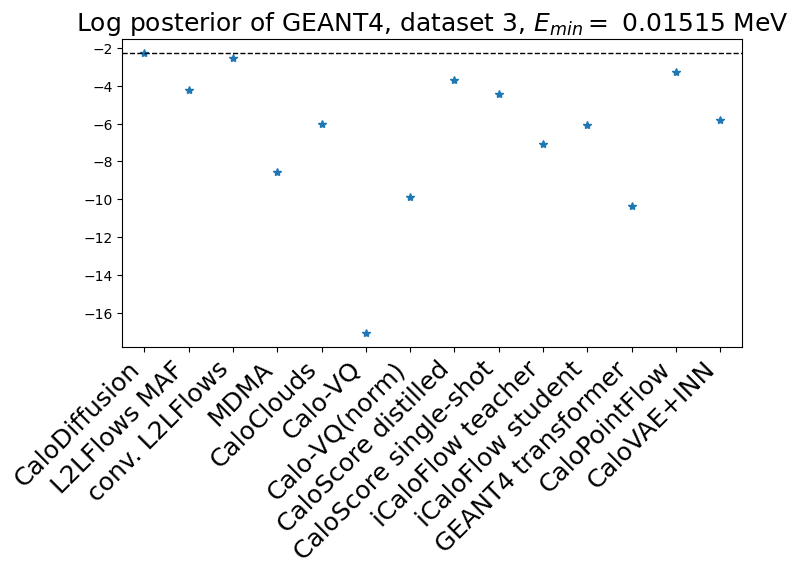

CaloDiffusion            log posterior:    -2.2633,    place:  1
L2LFlows MAF             log posterior:    -4.2418,    place:  5
conv. L2LFlows           log posterior:    -2.5285,    place:  2
MDMA                     log posterior:    -8.5518,    place: 11
CaloClouds               log posterior:    -6.0092,    place:  8
Calo-VQ                  log posterior:   -17.0659,    place: 14
Calo-VQ(norm)            log posterior:    -9.8814,    place: 12
CaloScore distilled      log posterior:    -3.7087,    place:  4
CaloScore single-shot    log posterior:    -4.4359,    place:  6
iCaloFlow teacher        log posterior:    -7.0792,    place: 10
iCaloFlow student        log posterior:    -6.0773,    place:  9
GEANT4 transformer       log posterior:   -10.3673,    place: 13
CaloPointFlow            log posterior:    -3.2657,    place:  3
CaloVAE+INN              log posterior:    -5.7998,    place:  7

  - - - -  

model architecture 
DNN(
  (inputlayer): Linear(in_features=40501, out_featu

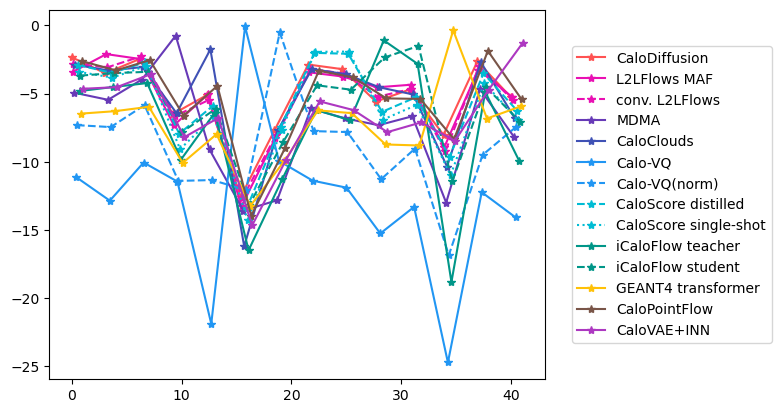

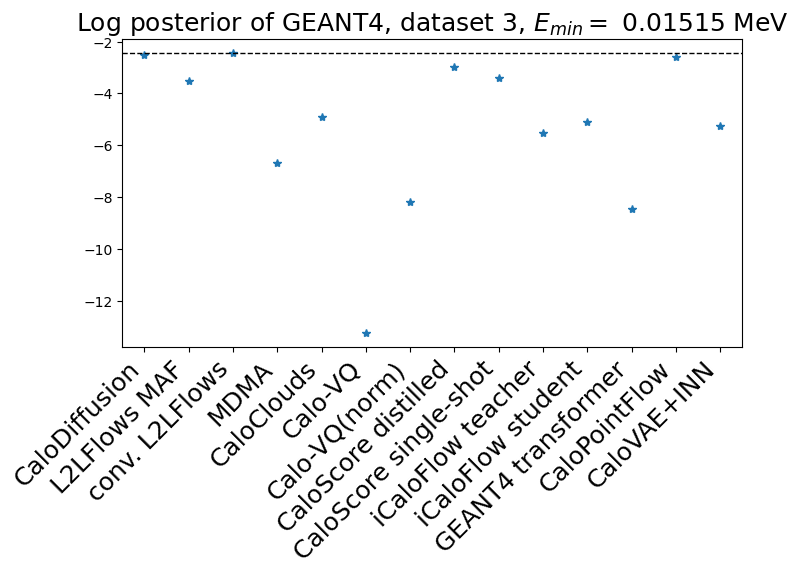

CaloDiffusion            log posterior:    -2.5024,    place:  2
L2LFlows MAF             log posterior:    -3.5281,    place:  6
conv. L2LFlows           log posterior:    -2.4350,    place:  1
MDMA                     log posterior:    -6.6704,    place: 11
CaloClouds               log posterior:    -4.8906,    place:  7
Calo-VQ                  log posterior:   -13.2453,    place: 14
Calo-VQ(norm)            log posterior:    -8.1846,    place: 12
CaloScore distilled      log posterior:    -2.9898,    place:  4
CaloScore single-shot    log posterior:    -3.3959,    place:  5
iCaloFlow teacher        log posterior:    -5.5417,    place: 10
iCaloFlow student        log posterior:    -5.0842,    place:  8
GEANT4 transformer       log posterior:    -8.4544,    place: 13
CaloPointFlow            log posterior:    -2.5809,    place:  3
CaloVAE+INN              log posterior:    -5.2480,    place:  9

  - - - -  

model architecture 
DNN(
  (inputlayer): Linear(in_features=40501, out_featu

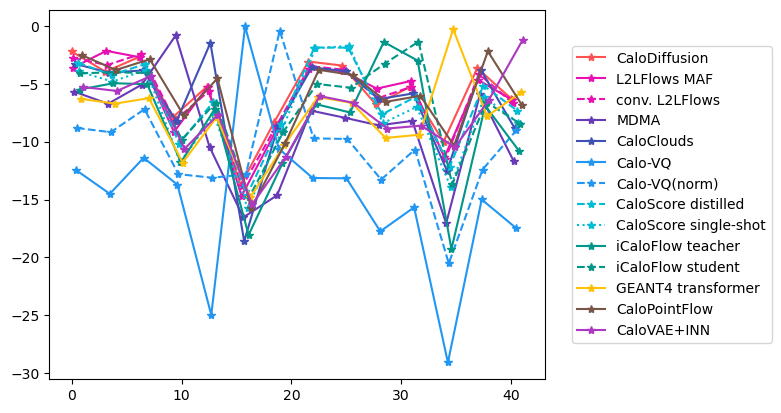

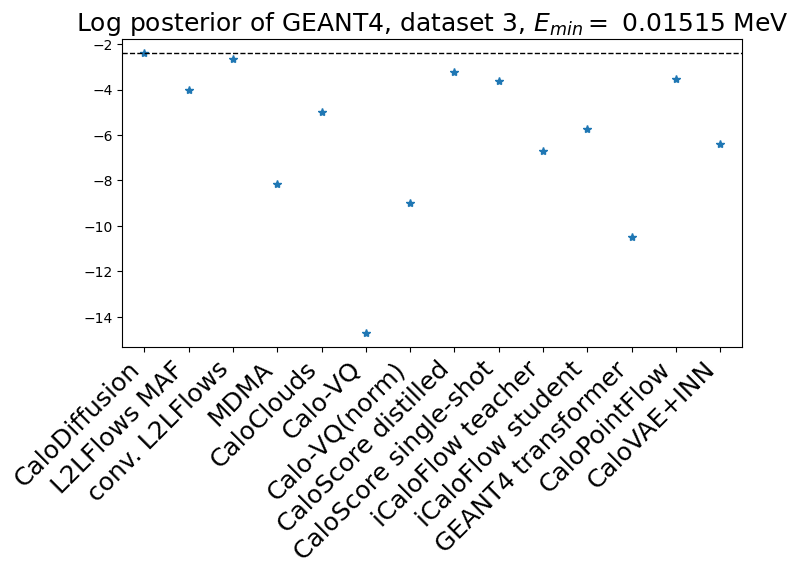

CaloDiffusion            log posterior:    -2.3909,    place:  1
L2LFlows MAF             log posterior:    -4.0088,    place:  6
conv. L2LFlows           log posterior:    -2.6560,    place:  2
MDMA                     log posterior:    -8.1419,    place: 11
CaloClouds               log posterior:    -5.0070,    place:  7
Calo-VQ                  log posterior:   -14.7085,    place: 14
Calo-VQ(norm)            log posterior:    -8.9748,    place: 12
CaloScore distilled      log posterior:    -3.2135,    place:  3
CaloScore single-shot    log posterior:    -3.6305,    place:  5
iCaloFlow teacher        log posterior:    -6.7160,    place: 10
iCaloFlow student        log posterior:    -5.7183,    place:  8
GEANT4 transformer       log posterior:   -10.4902,    place: 13
CaloPointFlow            log posterior:    -3.5377,    place:  4
CaloVAE+INN              log posterior:    -6.4076,    place:  9

  - - - -  

model architecture 
DNN(
  (inputlayer): Linear(in_features=40501, out_featu

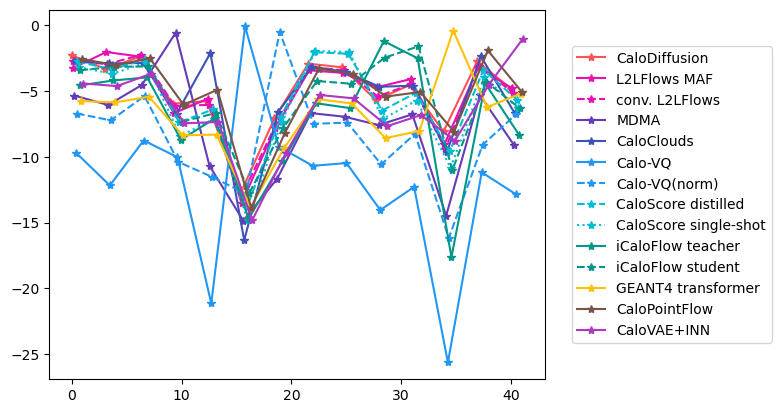

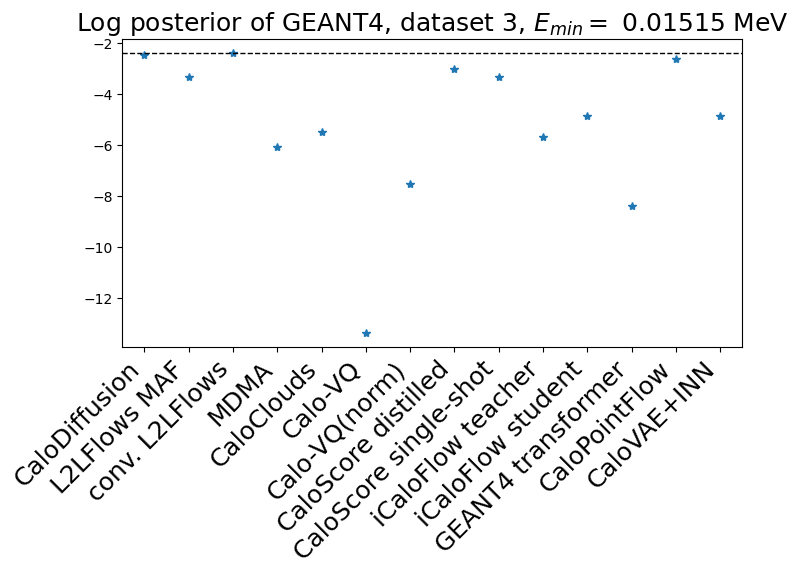

CaloDiffusion            log posterior:    -2.4501,    place:  2
L2LFlows MAF             log posterior:    -3.3263,    place:  6
conv. L2LFlows           log posterior:    -2.3842,    place:  1
MDMA                     log posterior:    -6.0610,    place: 11
CaloClouds               log posterior:    -5.4754,    place:  9
Calo-VQ                  log posterior:   -13.3816,    place: 14
Calo-VQ(norm)            log posterior:    -7.5199,    place: 12
CaloScore distilled      log posterior:    -3.0020,    place:  4
CaloScore single-shot    log posterior:    -3.3176,    place:  5
iCaloFlow teacher        log posterior:    -5.6964,    place: 10
iCaloFlow student        log posterior:    -4.8674,    place:  8
GEANT4 transformer       log posterior:    -8.3975,    place: 13
CaloPointFlow            log posterior:    -2.6113,    place:  3
CaloVAE+INN              log posterior:    -4.8661,    place:  7

  - - - -  

done


In [13]:
num_epoch = 24
num_runs = 10
DS = '3_ensemble'

only_eval = True

accuracy = []
train_losses = []
eval_losses = []

preds_models = []
preds_truth = []

preds_by_model = []
log_post_by_model = []
log_truth = []
final_accuracy = []

for run_nr in range(num_runs):
    dense_net = DNN(num_layer=2, num_hidden=2048, input_dim=40501, output_dim=num_ds3)
    dense_net.to(device)

    print("model architecture ")
    print(dense_net)
    total_parameters = sum(p.numel() for p in dense_net.parameters() if p.requires_grad)
    print(f"Model has {total_parameters:d} trainable parameters")

    criterion = nn.NLLLoss(reduction='none')
    optimizer = torch.optim.Adam(dense_net.parameters(), lr=1e-3)
    
    if not only_eval:
        random_idx = np.array([np.random.permutation(np.arange(4000)) for _ in range(15*12*num_ds3)])
        random_idx_1, random_idx_2 = np.split(random_idx, 2, axis=1)
        random_idx = np.vstack([random_idx_1, random_idx_2])
        
        best_val_loss = 1e6

        accuracy.append([])
        _, acc = evaluate(dense_net, test_dataloader, criterion, device=device)
        accuracy[-1].append(acc.mean())

        train_losses.append([])
        eval_losses.append([])

        for epoch in range(num_epoch):
            print(f"Epoch {epoch+1} / {num_epoch} of run {run_nr+1} / {num_runs}")
            train_loss = train(dense_net, train_dataloader, optimizer, criterion, device=device, idx=random_idx[epoch*15*num_ds3:(epoch+1)*15*num_ds3])
            eval_loss, acc = evaluate(dense_net, test_dataloader, criterion, device=device)
            train_losses[-1].append(train_loss.mean())
            eval_losses[-1].append(eval_loss.mean())
            accuracy[-1].append(acc.mean())
            if eval_loss.mean() < best_val_loss:
                save_weights(dense_net, DS, run_nr)
                best_val_loss = eval_loss.mean()
            print("   - - - - -   ")
    
    print("evaluating this run:")
    if not only_eval:
        epochs = np.arange(num_epoch) + 1
        plt.plot(epochs, train_losses[-1], label='train')
        plt.plot(epochs, eval_losses[-1], label='test')
        plt.ylabel("Cross Entropy Loss")
        plt.xlabel("epoch")
        plt.axvline(x = np.argmin(eval_losses[-1])+1, color = 'k', linestyle='dashed', linewidth=1)
        plt.legend()
        plt.show()

        plt.plot(epochs, accuracy[-1][1:])
        plt.axvline(x = np.argmin(eval_losses[-1])+1, color = 'k', linestyle='dashed', linewidth=1)
        plt.ylabel("Accuracy")
        plt.xlabel("epoch")
        plt.show()

    load_weights(dense_net, device, DS, run_nr)
    _ = evaluate(dense_net, test_dataloader, criterion, device=device)
    preds_models.append(get_prediction(dense_net, test_dataloader, device=device))
    preds_truth.append(get_prediction(dense_net, truth_dataloader, device=device))


    preds_by_model.append([])
    log_post_by_model.append([])
    for i in range(num_ds3):
        preds_by_model[-1].append(preds_models[-1][preds_models[-1][:, -1] == i][:, :-1])
        log_post_by_model[-1].append(log_posterior(preds_by_model[-1][-1]))

    preds_truth[-1] = preds_truth[-1][:, :-1]
    log_truth.append(log_posterior(preds_truth[-1]))

    final_accuracy.append([])
    for i in range(num_ds3):
        final_accuracy[-1].append(find_accuracy(preds_by_model[-1][i], i))
        print(f"Accuracy of model {i}, which is {id_dict[conversion_to_submission_id[i]]} is {final_accuracy[-1][i].mean()}.")


    for i in range(num_ds3):
        plt.plot(np.linspace(0, 40, num_ds3)+0.08*i, log_post_by_model[-1][i], '*', label=id_dict[conversion_to_submission_id[i]], **kwargs_dict[conversion_to_submission_id[i]])
        print(f"class {i} has maximum posterior in class {np.argmax(log_post_by_model[-1][i])}")

    plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left")
    plt.show()
    
    plt.figure(figsize=(8,4))
    plt.plot(np.arange(num_ds3), log_truth[-1], '*')
    plt.hlines(np.max(log_truth[-1]), xmin=-1, xmax=num_ds3, color = 'k', linestyle='dashed', linewidth=1)
    plt.xlim(-0.5, num_ds3-0.5)
    plt.title(f"Log posterior of GEANT4, dataset 3, $E_{{min}}=$ {MIN_ENERGY:.5f} MeV", fontsize=FS)
    plt.gca().set_xticks(np.arange(num_ds3))
    plt.gca().set_xticklabels([id_dict[conversion_to_submission_id[i]] for i in range(num_ds3)], rotation=45, ha='right', fontsize=FS)
    plt.show()

    score_order = np.argsort(np.argsort(-log_truth[-1]))+1
    for i in range(num_ds3):
        print(f"{id_dict[conversion_to_submission_id[i]]:24s} log posterior:   {log_truth[-1][i]:8.4f},    place: {score_order[i]:2d}")    
        
    print("\n  - - - -  \n")
log_post_by_model = np.array(log_post_by_model)
log_truth = np.array(log_truth)
final_accuracy = np.array(final_accuracy)
print("done")


Accuracy of model  0, which is CaloDiffusion             is 0.1747 +/- 0.0722.
Accuracy of model  1, which is L2LFlows MAF              is 0.2510 +/- 0.0654.
Accuracy of model  2, which is conv. L2LFlows            is 0.0886 +/- 0.0382.
Accuracy of model  3, which is MDMA                      is 0.7889 +/- 0.0977.
Accuracy of model  4, which is CaloClouds                is 0.4483 +/- 0.0779.
Accuracy of model  5, which is Calo-VQ                   is 0.9778 +/- 0.0066.
Accuracy of model  6, which is Calo-VQ(norm)             is 0.8483 +/- 0.0859.
Accuracy of model  7, which is CaloScore distilled       is 0.1323 +/- 0.1000.
Accuracy of model  8, which is CaloScore single-shot     is 0.4185 +/- 0.1259.
Accuracy of model  9, which is iCaloFlow teacher         is 0.5751 +/- 0.1513.
Accuracy of model 10, which is iCaloFlow student         is 0.5748 +/- 0.1493.
Accuracy of model 11, which is GEANT4 transformer        is 0.8668 +/- 0.1986.
Accuracy of model 12, which is CaloPointFlow        

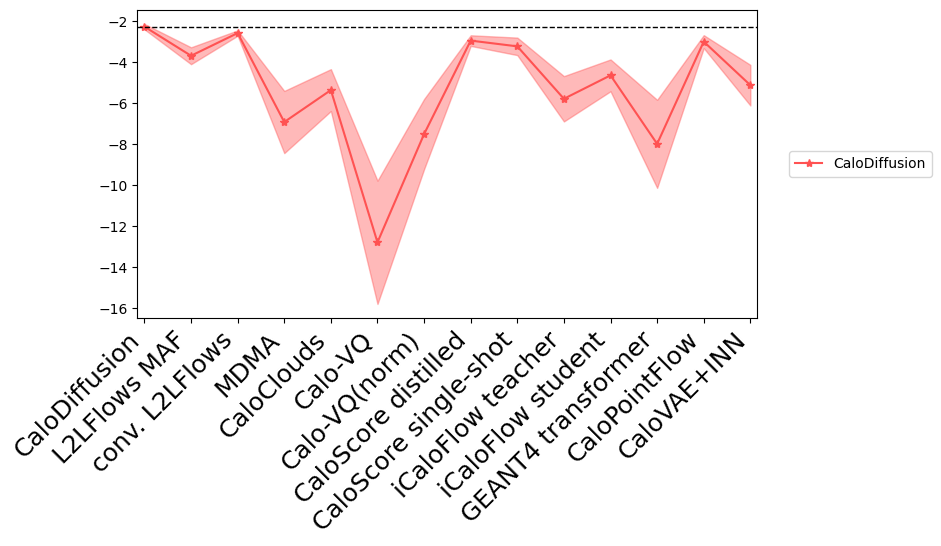

class 0 has maximum posterior in class 0


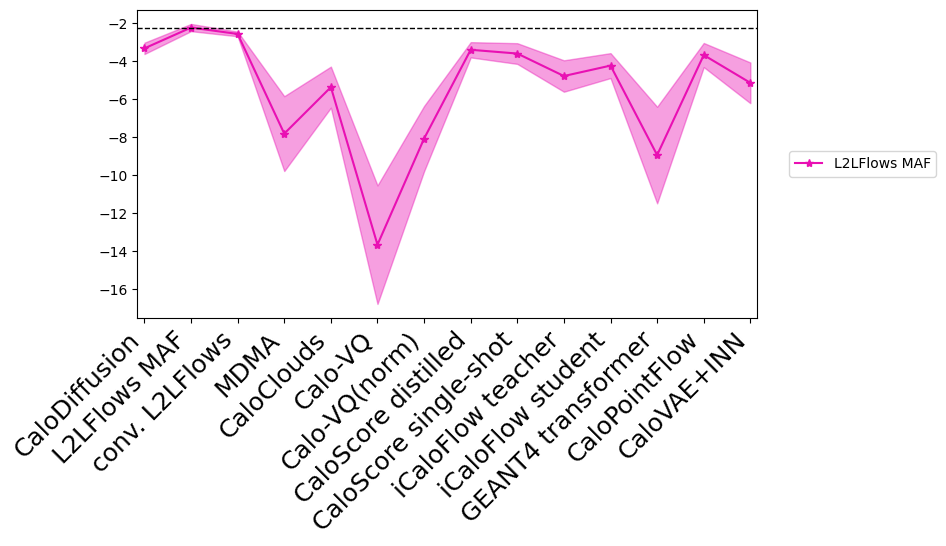

class 1 has maximum posterior in class 1


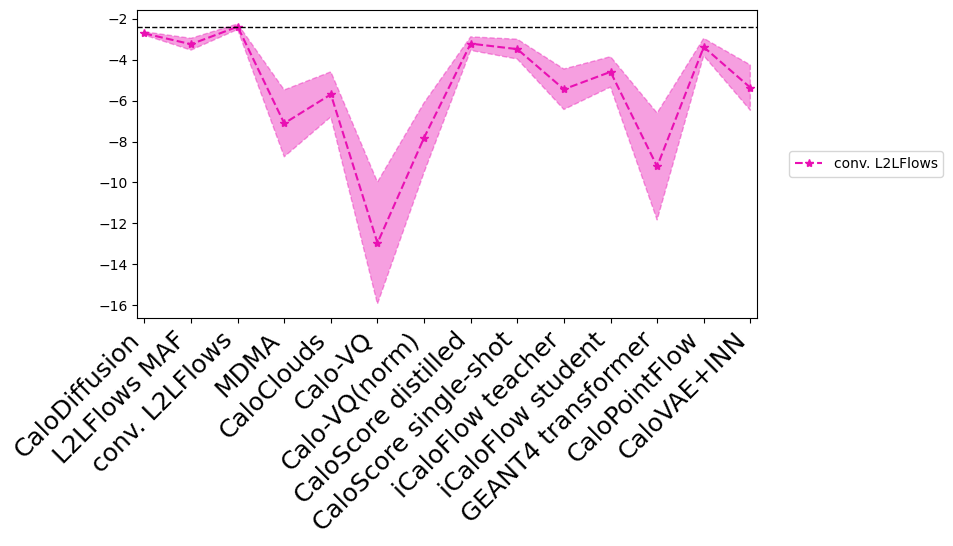

class 2 has maximum posterior in class 2


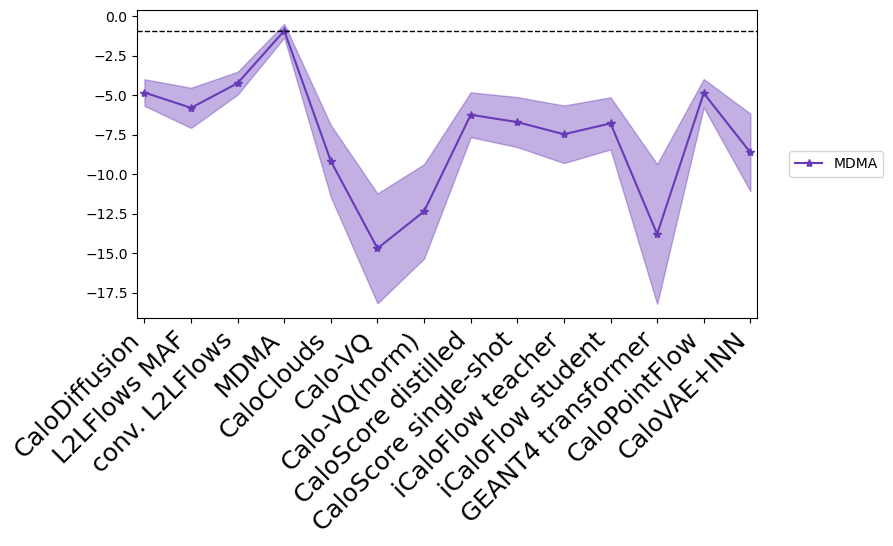

class 3 has maximum posterior in class 3


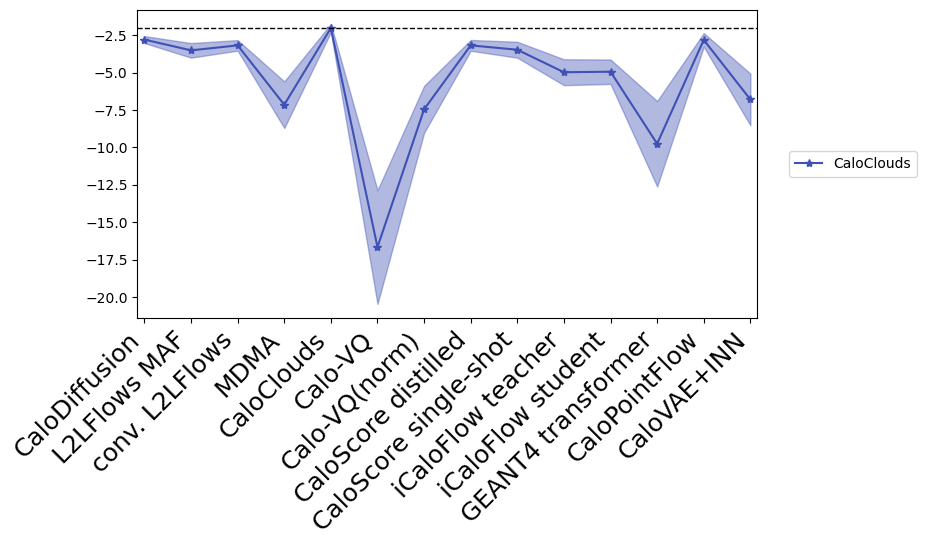

class 4 has maximum posterior in class 4


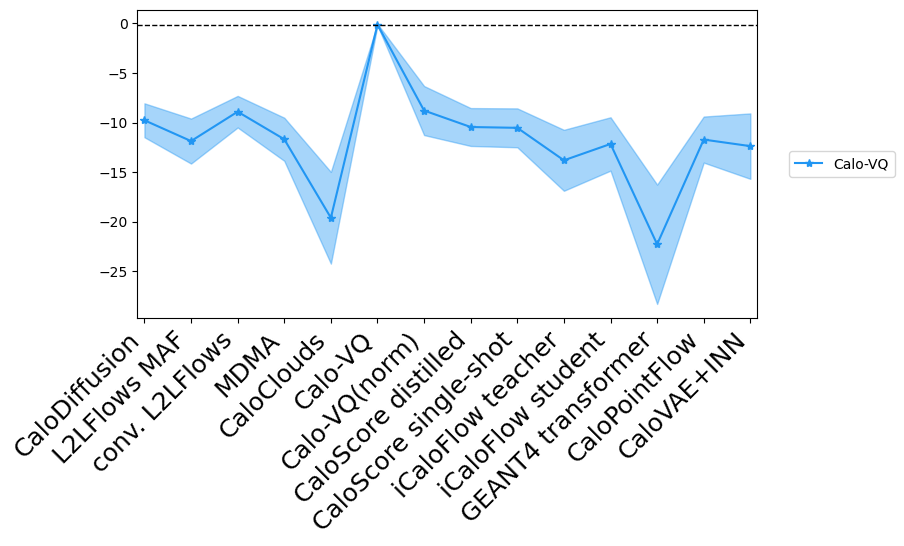

class 5 has maximum posterior in class 5


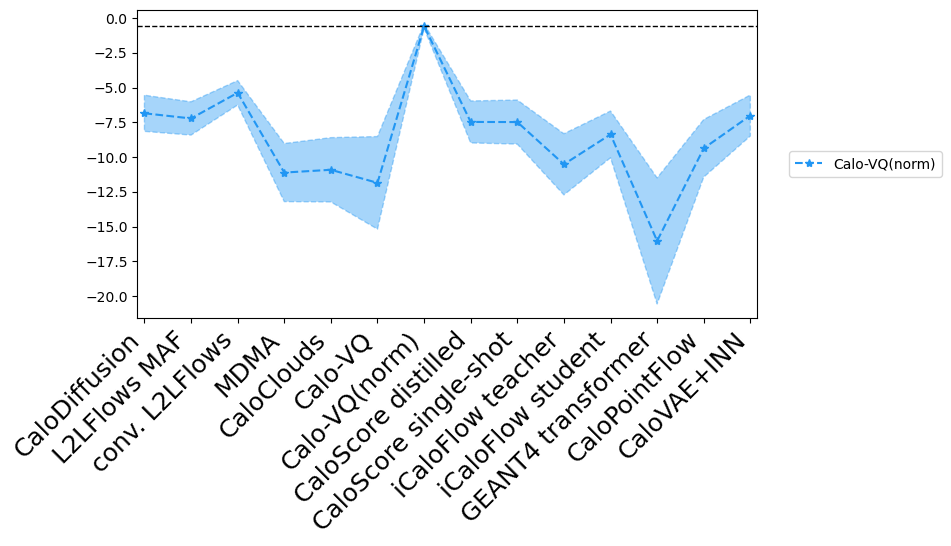

class 6 has maximum posterior in class 6


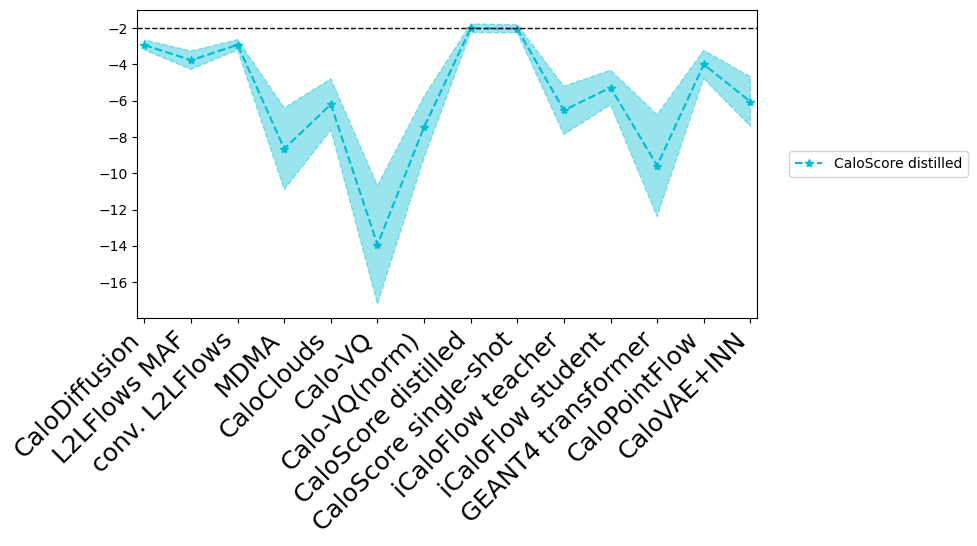

class 7 has maximum posterior in class 7


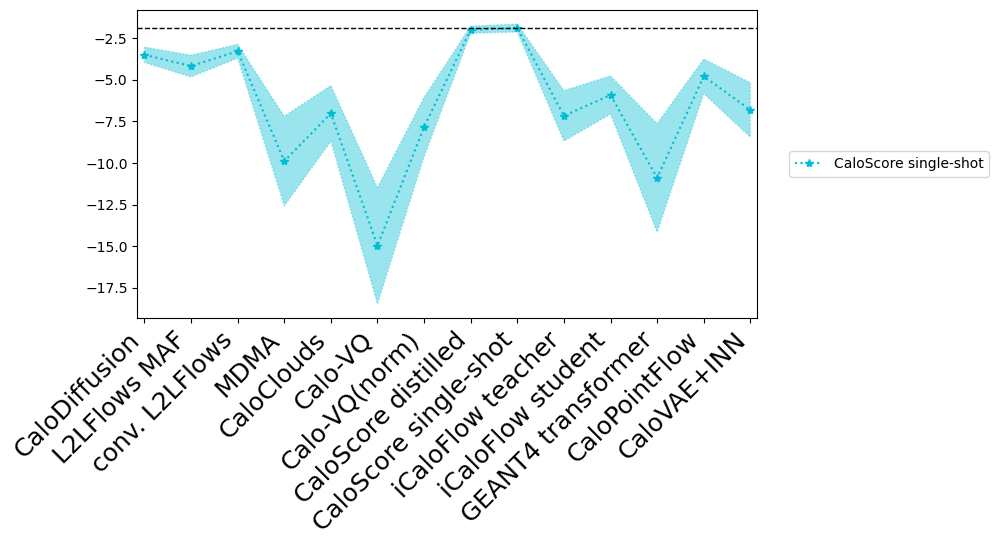

class 8 has maximum posterior in class 8


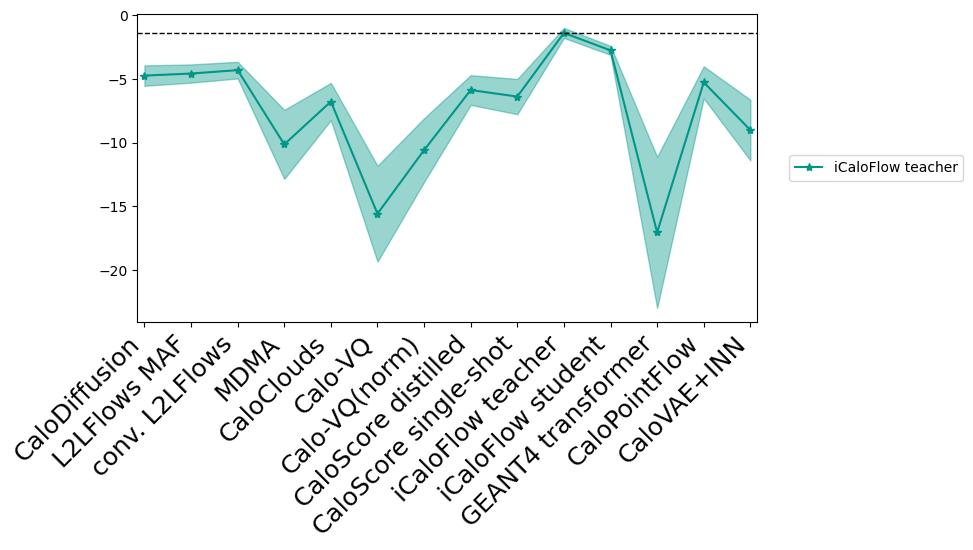

class 9 has maximum posterior in class 9


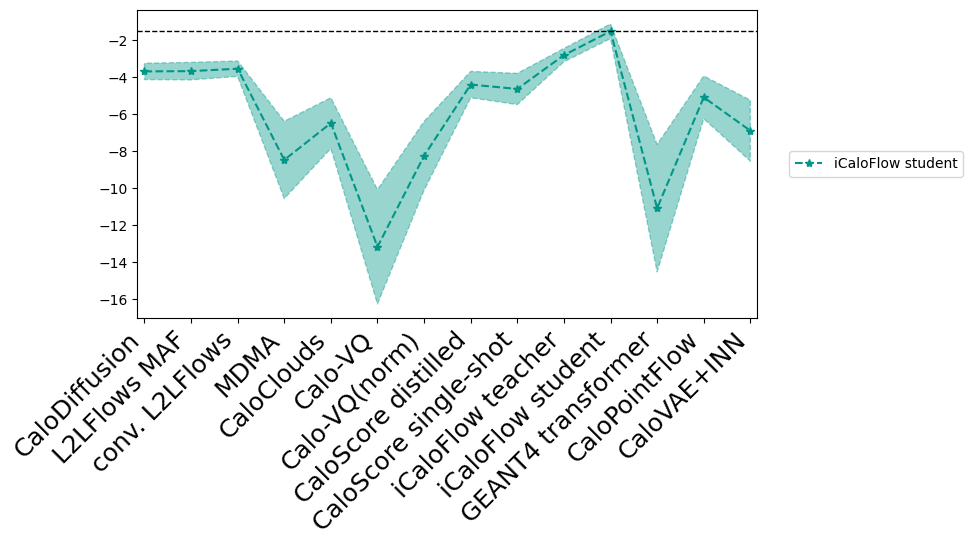

class 10 has maximum posterior in class 10


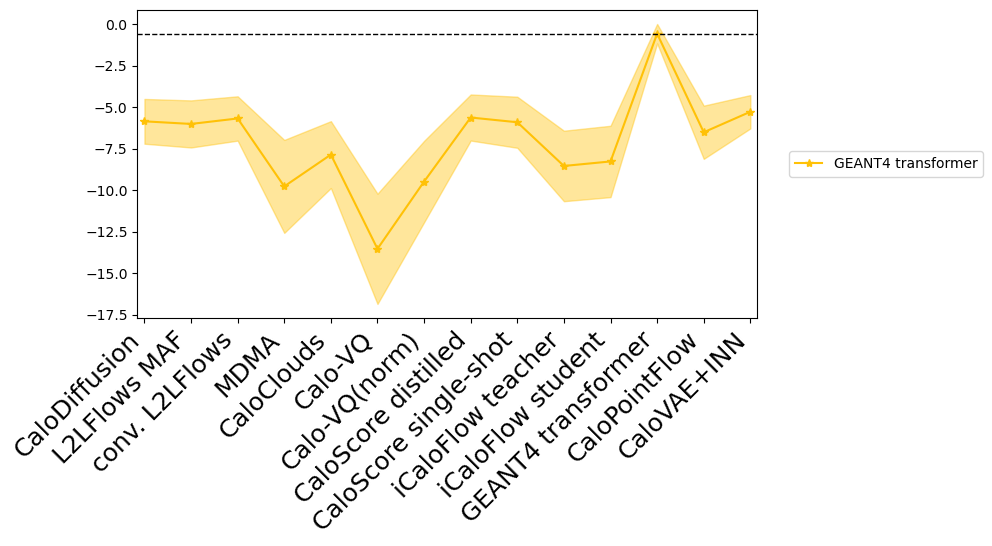

class 11 has maximum posterior in class 11


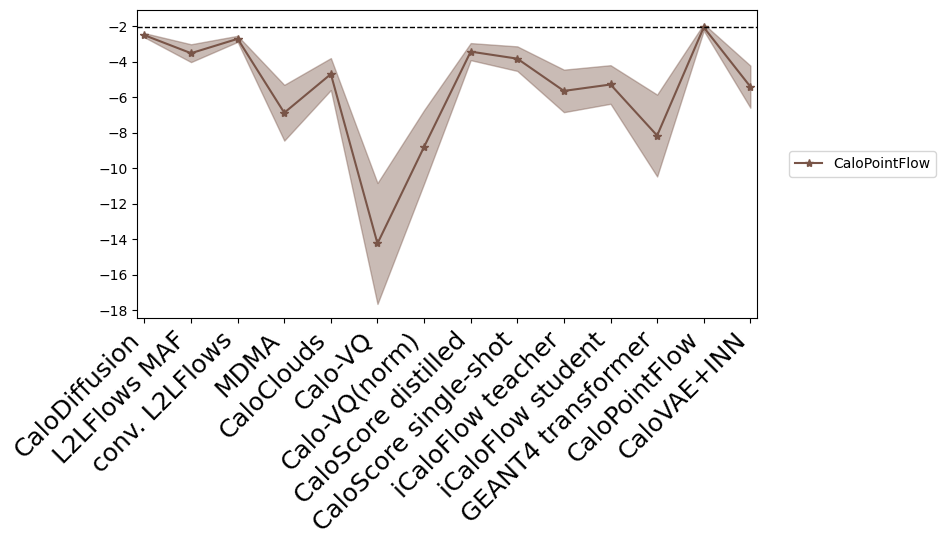

class 12 has maximum posterior in class 12


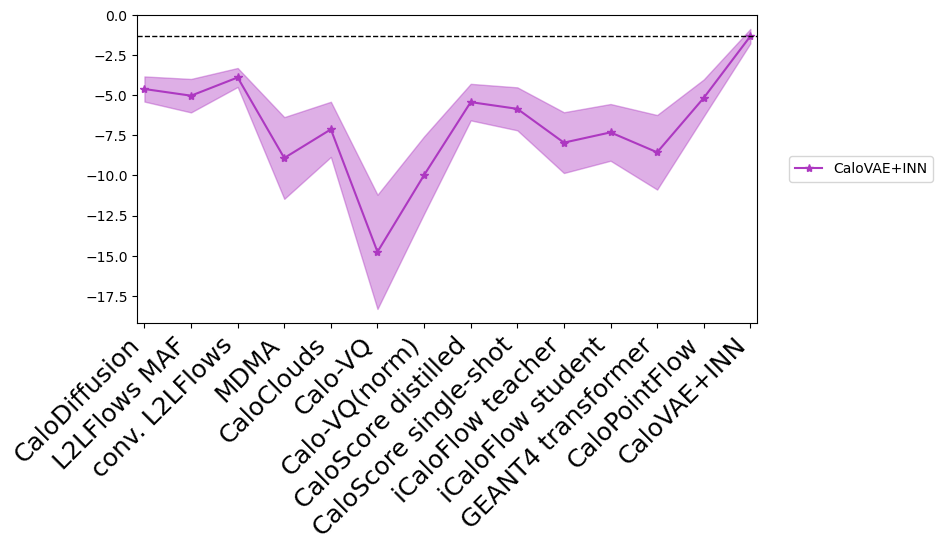

class 13 has maximum posterior in class 13


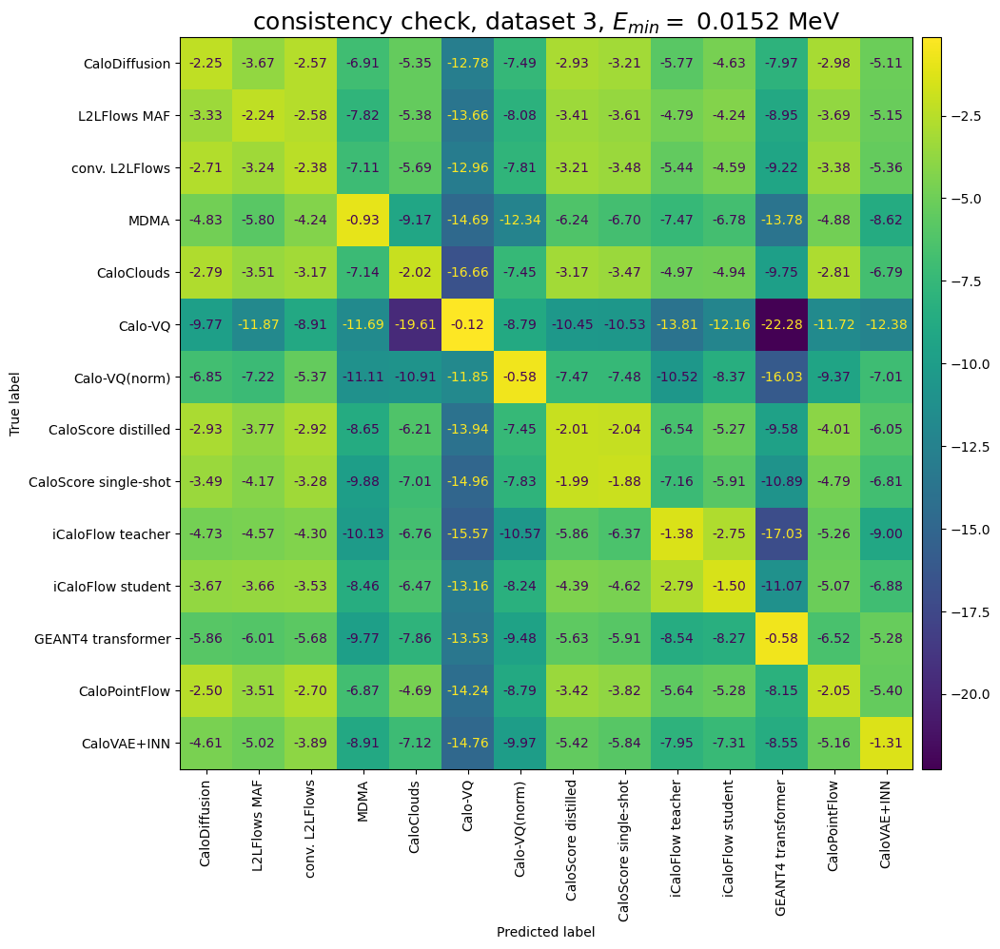

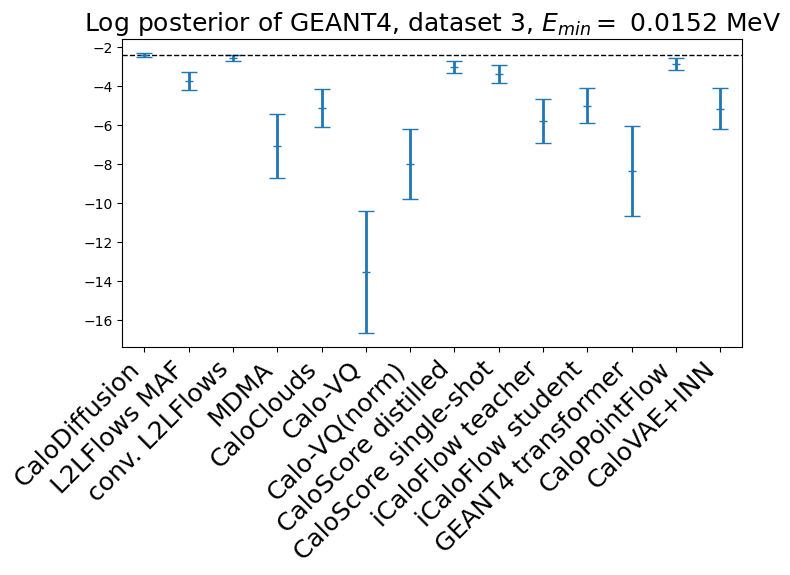

CaloDiffusion            log posterior:    -2.4014 +/- 0.1061,    place:  1
L2LFlows MAF             log posterior:    -3.7170 +/- 0.4639,    place:  6
conv. L2LFlows           log posterior:    -2.5530 +/- 0.1317,    place:  2
MDMA                     log posterior:    -7.0675 +/- 1.6446,    place: 11
CaloClouds               log posterior:    -5.1345 +/- 0.9836,    place:  8
Calo-VQ                  log posterior:   -13.5254 +/- 3.1386,    place: 14
Calo-VQ(norm)            log posterior:    -7.9947 +/- 1.7915,    place: 12
CaloScore distilled      log posterior:    -3.0305 +/- 0.2975,    place:  4
CaloScore single-shot    log posterior:    -3.3675 +/- 0.4749,    place:  5
iCaloFlow teacher        log posterior:    -5.7784 +/- 1.1240,    place: 10
iCaloFlow student        log posterior:    -5.0072 +/- 0.8891,    place:  7
GEANT4 transformer       log posterior:    -8.3616 +/- 2.3007,    place: 13
CaloPointFlow            log posterior:    -2.8742 +/- 0.3045,    place:  3
CaloVAE+INN 

In [14]:
run_accuracy_means = final_accuracy.mean(axis=-1)

for i in range(num_ds3):
    print(f"Accuracy of model {i:2d}, which is {id_dict[conversion_to_submission_id[i]]:25s} is {run_accuracy_means[:,i].mean():.4f} +/- {run_accuracy_means[:,i].std():.4f}.")

print('\n')
for i in range(num_ds3):
    plt.figure(figsize=(8,4))
    plt.plot(np.linspace(0, 3*num_ds3 + 1, num_ds3), log_post_by_model.mean(axis=0)[i], '*', label=id_dict[conversion_to_submission_id[i]], **kwargs_dict[conversion_to_submission_id[i]])  # +(1./num_ds1_pions)*i
    plt.fill_between(np.linspace(0, 3*num_ds3 + 1, num_ds3), log_post_by_model.mean(axis=0)[i]-log_post_by_model.std(axis=0)[i], log_post_by_model.mean(axis=0)[i]+log_post_by_model.std(axis=0)[i], label='_please_dont', alpha=0.4, **kwargs_dict[conversion_to_submission_id[i]])
    
    plt.xlim(-0.5, 3*num_ds3 + 1.5) # 2.5
    plt.legend(bbox_to_anchor=(1.04, 0.5), loc="center left")
    plt.hlines(np.max(log_post_by_model.mean(axis=0)[i]), xmin=-0.5, xmax=3*num_ds3 + 1.5, color = 'k', linestyle='dashed', linewidth=1)
    plt.gca().set_xticks(np.linspace(0, 3*num_ds3 + 1, num_ds3))
    plt.gca().set_xticklabels([id_dict[conversion_to_submission_id[i]] for i in range(num_ds3)], rotation=45, ha='right', fontsize=FS)

    plt.savefig(f'results_fig/cls/ds3_check_{i}.pdf', dpi=300, bbox_inches='tight')
    plt.show()
    print(f"class {i} has maximum posterior in class {np.argmax(log_post_by_model.mean(axis=0)[i])}")

plt.figure(figsize=(10,10))
disp = ConfusionMatrixDisplay(confusion_matrix=log_post_by_model.mean(axis=0), 
                              display_labels=[id_dict[conversion_to_submission_id[i]] for i in range(num_ds3)])
disp.plot(xticks_rotation='vertical', ax=plt.gca(), colorbar=False, values_format=".2f")
plt.title(f"consistency check, dataset 3, $E_{{min}}=$ {MIN_ENERGY:.4f} MeV", fontsize=FS)
cax = plt.gcf().add_axes([plt.gca().get_position().x1+0.01,plt.gca().get_position().y0,0.02,plt.gca().get_position().height])
plt.colorbar(disp.im_,  cax=cax)
plt.savefig(f'results_fig/cls/ds3_confusion.pdf', dpi=300, bbox_inches='tight')
plt.show()
    
plt.figure(figsize=(8,4))
plt.errorbar(np.arange(num_ds3), log_truth.mean(axis=0), yerr=log_truth.std(axis=0), elinewidth=2, marker='_', capsize=6, linestyle='None')
plt.hlines(np.max(log_truth.mean(axis=0)), xmin=-1, xmax=num_ds3, color = 'k', linestyle='dashed', linewidth=1)
plt.xlim(-0.5, num_ds3-0.5)
plt.title(f"Log posterior of GEANT4, dataset 3, $E_{{min}}=$ {MIN_ENERGY:.4f} MeV", fontsize=FS)
plt.gca().set_xticks(np.arange(num_ds3))
plt.gca().set_xticklabels([id_dict[conversion_to_submission_id[i]] for i in range(num_ds3)], rotation=45, ha='right', fontsize=FS)
plt.savefig(f'results_fig/cls/ds3_truth.pdf', dpi=300, bbox_inches='tight')
plt.show()

score_order = np.argsort(np.argsort(-log_truth.mean(axis=0)))+1
for i in range(num_ds3):
    print(f"{id_dict[conversion_to_submission_id[i]]:24s} log posterior:   {log_truth.mean(axis=0)[i]:8.4f} +/- {log_truth.std(axis=0)[i]:6.4f},    place: {score_order[i]:2d}")

### Visualization of Truth data

#### ds1 photons

In [12]:
# compute HLF
MIN_ENERGY = 1
HLF_photons_ref = []

ds1_photons_reference_dict = {'MIN_ENERGY': MIN_ENERGY}

for i in range(2):
    print(f"working on file {i+1}.")
    HLF_photons_ref.append(HLF.HighLevelFeatures('photon', 'CaloChallenge_homepage/code/binning_dataset_1_photons.xml'))
    E_inc, showers = extract_info(f'../scratch_CaloChallenge/data/official/dataset_1_photons_{i+1}.hdf5')
    showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
    HLF_photons_ref[-1].Einc = E_inc
    HLF_photons_ref[-1].showers = showers
    HLF_photons_ref[-1].CalculateFeatures(showers)

print(f"done reading files")


working on file 1.
working on file 2.
done reading files


Separation power of E layer 0 histogram: 0.0002068153539126427


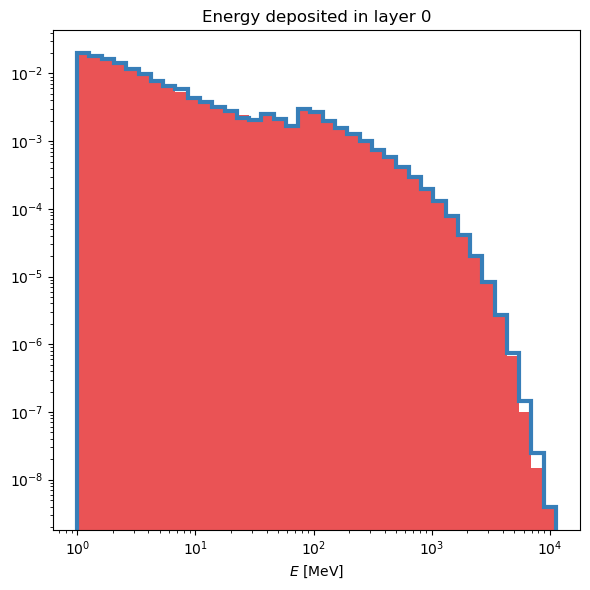

Separation power of E layer 1 histogram: 0.00015406199588013046


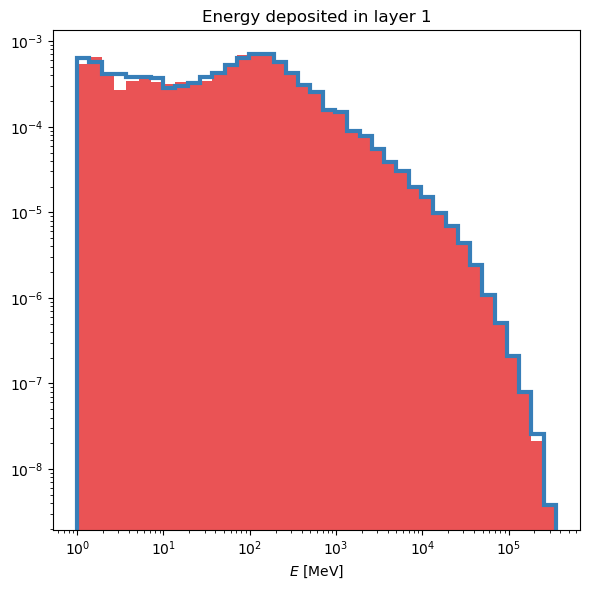

Separation power of E layer 2 histogram: 6.958223939923896e-05


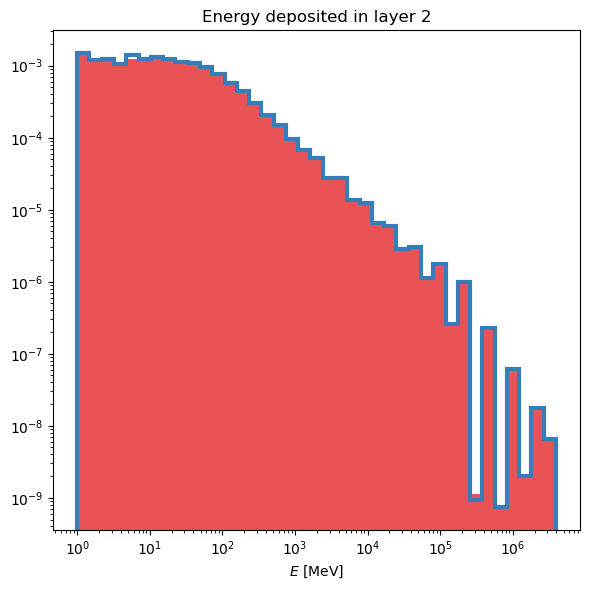

Separation power of E layer 3 histogram: 0.00023735513154076962


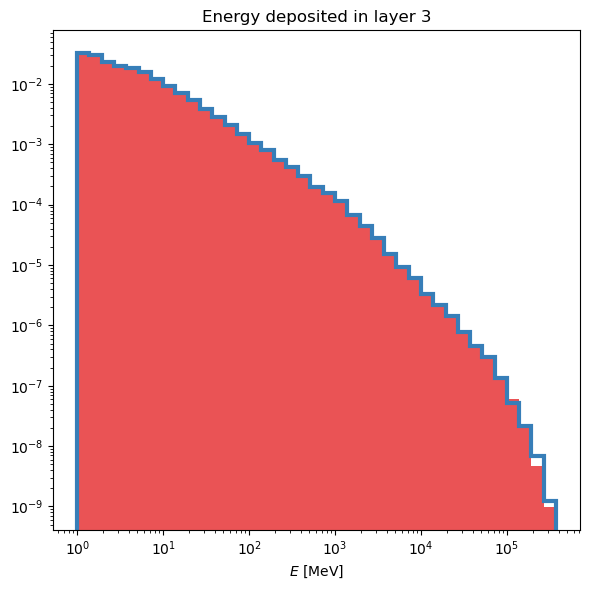

Separation power of E layer 12 histogram: 0.0002938941086371743


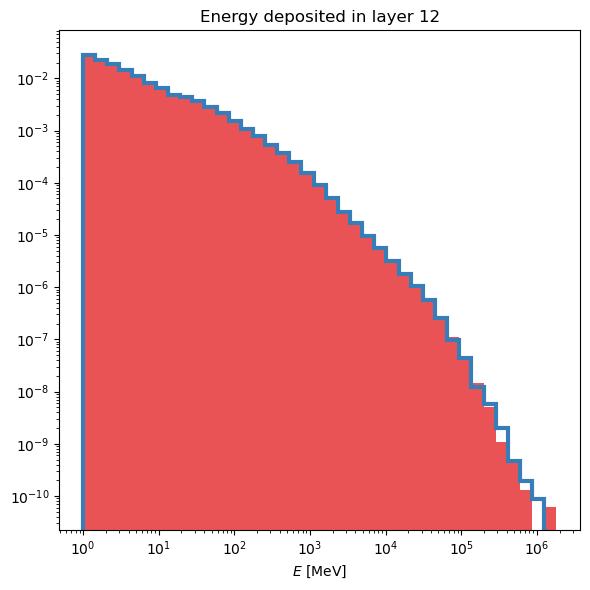

Separation power of EC Eta layer 1 histogram: 0.00035219061480771684


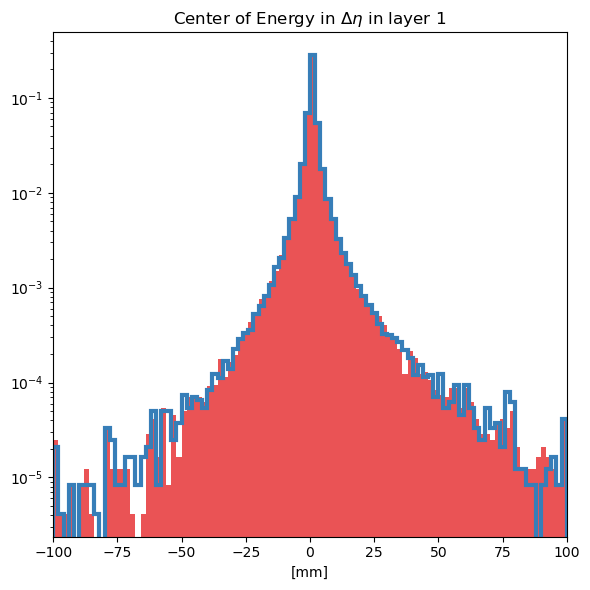

Separation power of EC Eta layer 2 histogram: 0.00040606784726393916


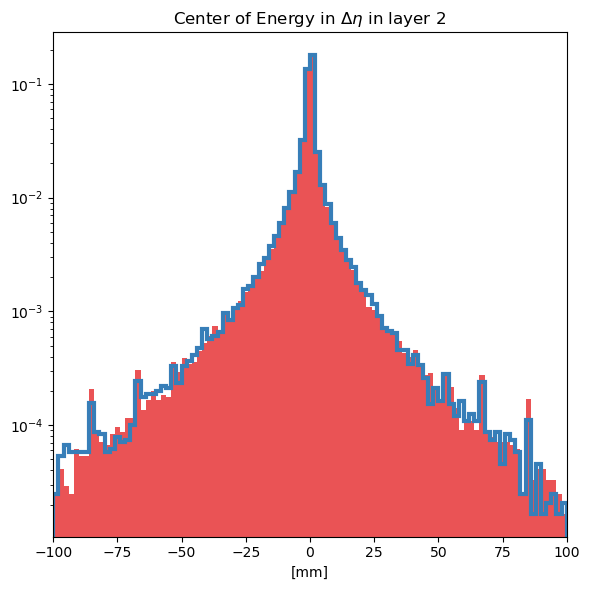

Separation power of EC Phi layer 1 histogram: 0.00037257645887381287


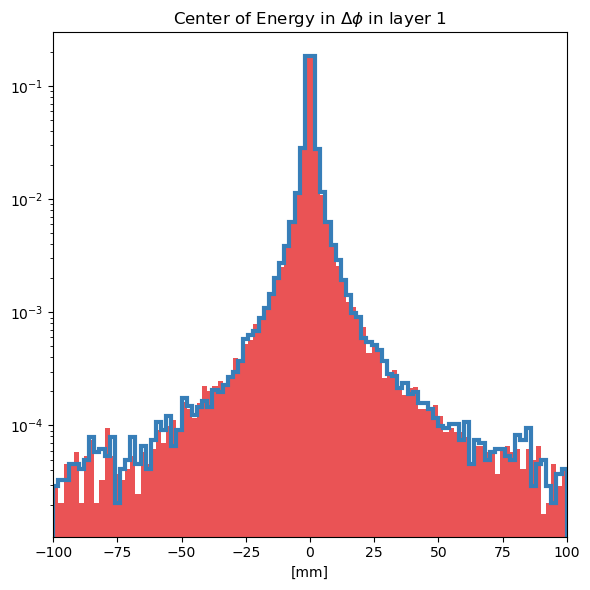

Separation power of EC Phi layer 2 histogram: 0.0005558030986526791


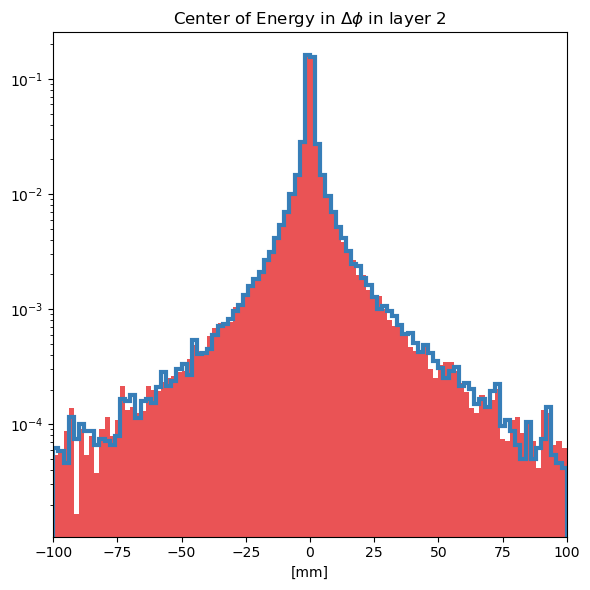

Separation power of Width Eta layer 1 histogram: 0.00044249029727875784


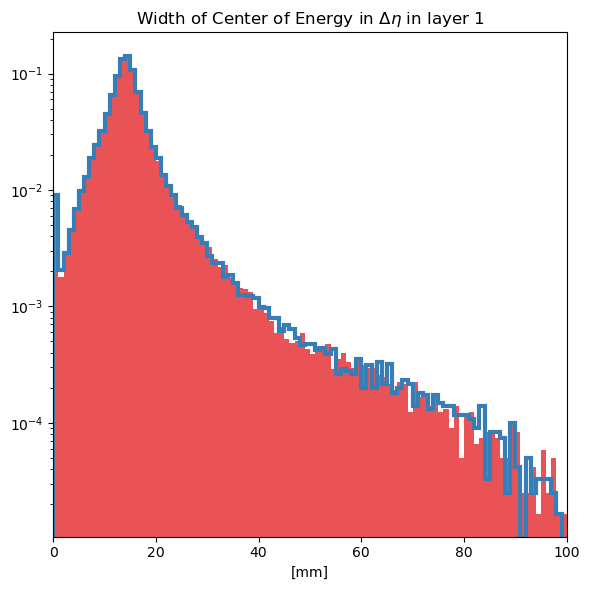

Separation power of Width Eta layer 2 histogram: 0.00046099613555130534


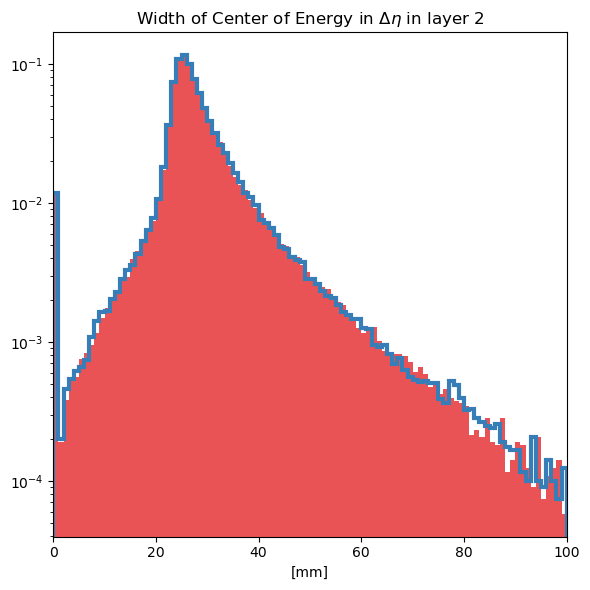

Separation power of Width Phi layer 1 histogram: 0.00038725191259046996


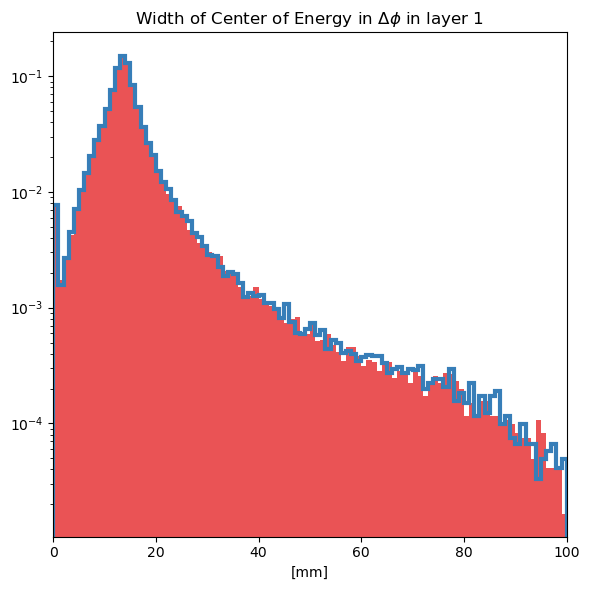

Separation power of Width Phi layer 2 histogram: 0.00034169093415939965


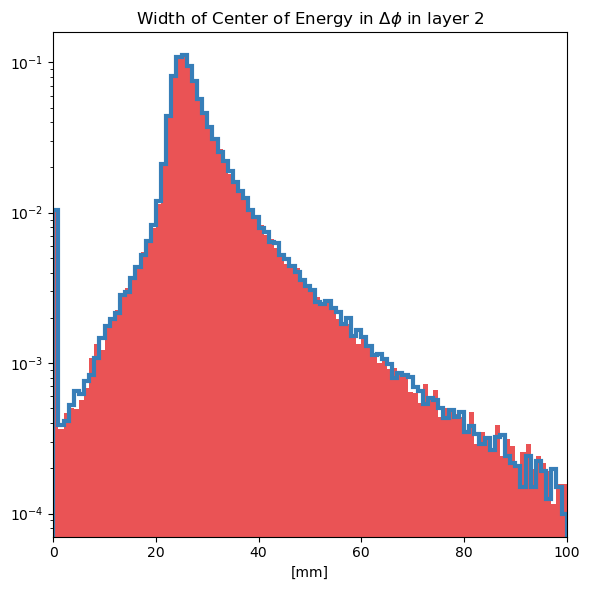

Separation power of Sparsity layer 0 histogram: 3.337466147091501e-05


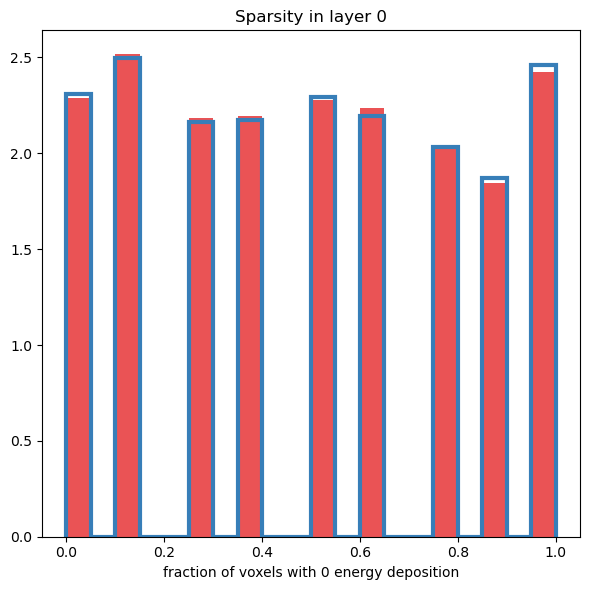

Separation power of Sparsity layer 1 histogram: 0.00011560454732566877


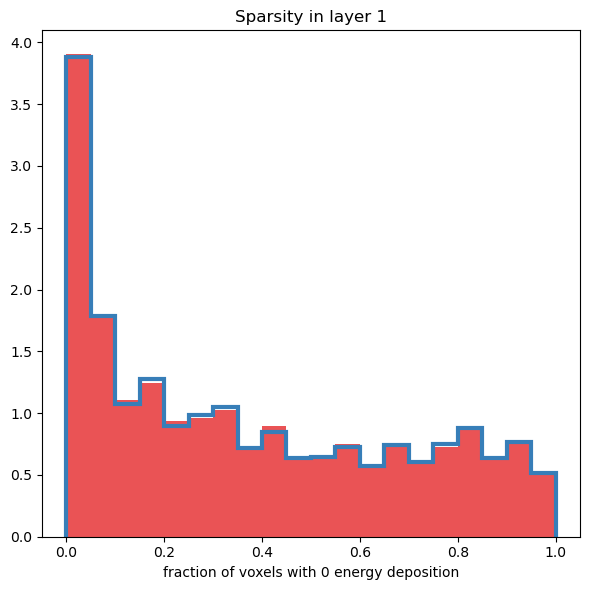

Separation power of Sparsity layer 2 histogram: 5.725414760891809e-05


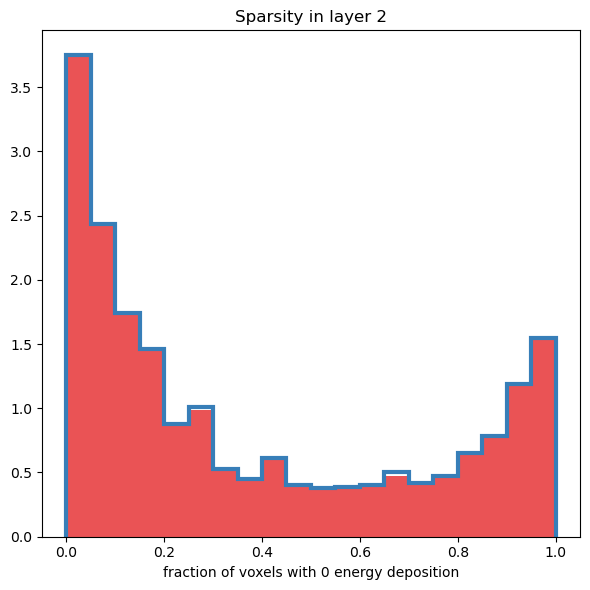

Separation power of Sparsity layer 3 histogram: 5.348008572536167e-06


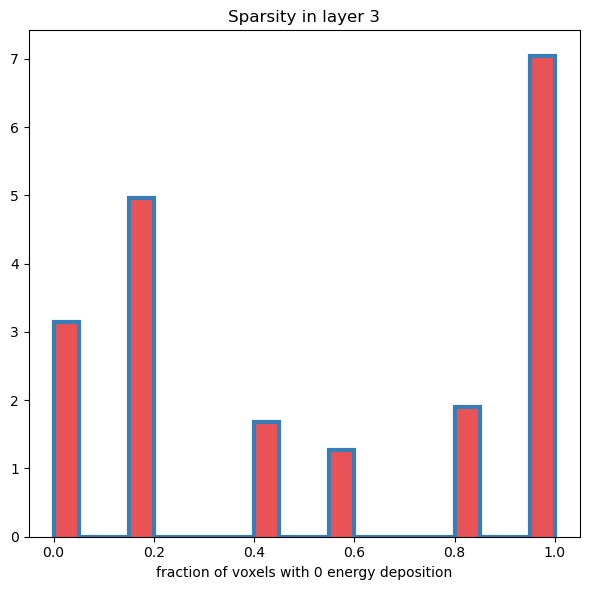

Separation power of Sparsity layer 12 histogram: 3.256759384900204e-05


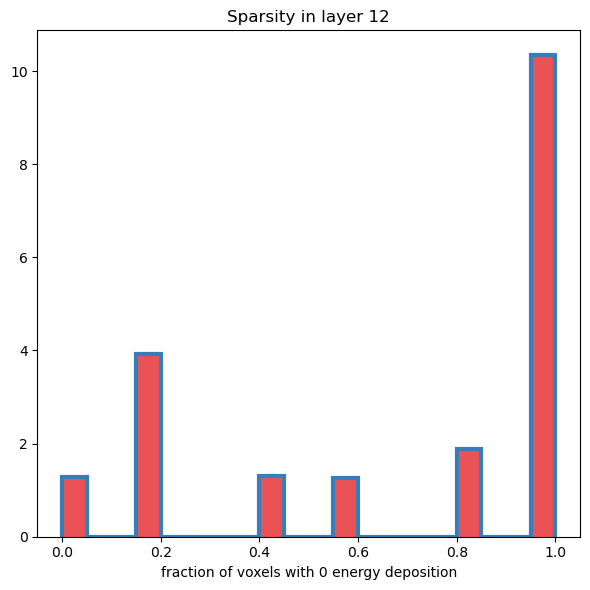

Separation power of EC r layer 0 histogram: 0.00047656486059119196


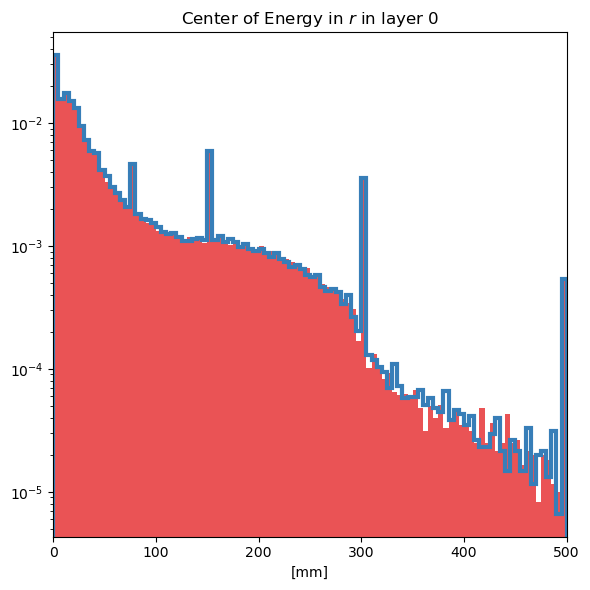

Separation power of EC r layer 1 histogram: 7.933503950842585e-05


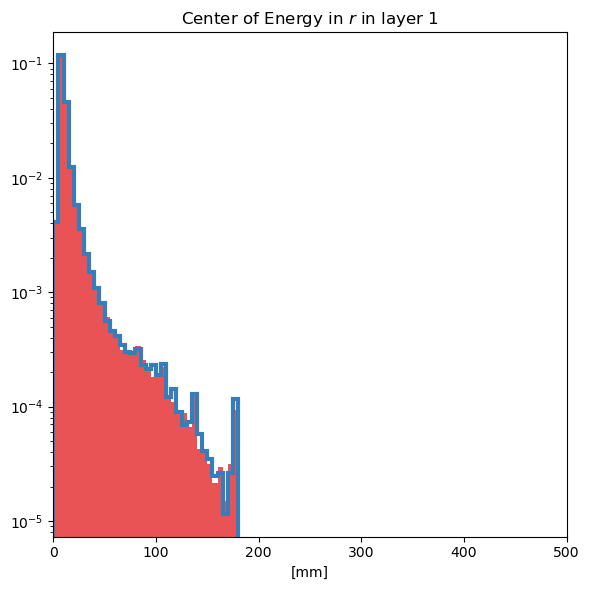

Separation power of EC r layer 2 histogram: 0.00031556831859611467


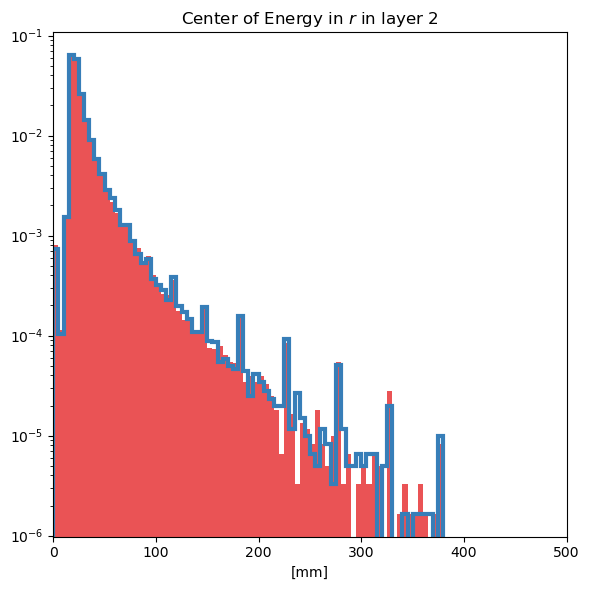

Separation power of EC r layer 3 histogram: 0.0003600583493205504


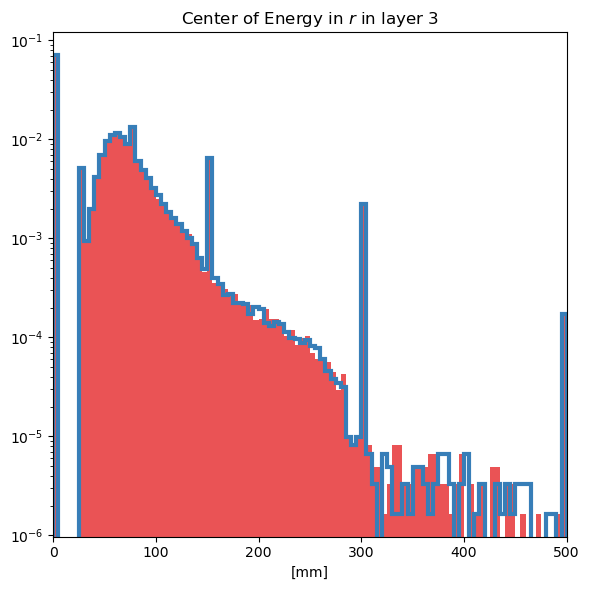

Separation power of EC r layer 12 histogram: 0.0003938166685758749


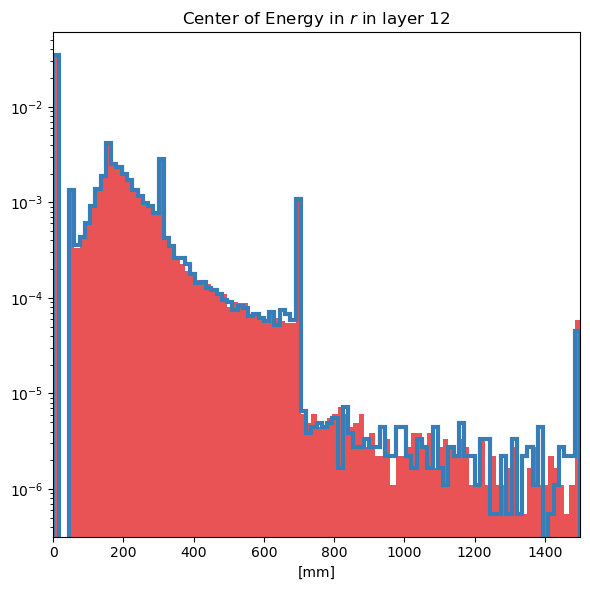

Separation power of Width r layer 0 histogram: 0.00019803274707233537


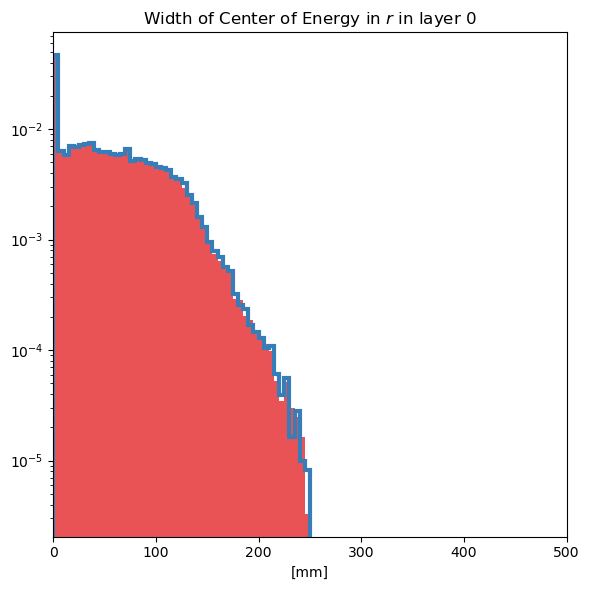

Separation power of Width r layer 1 histogram: 5.4719267883988486e-05


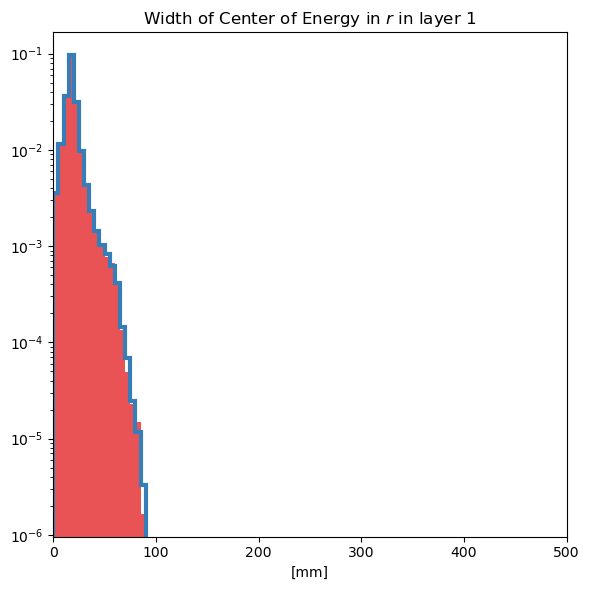

Separation power of Width r layer 2 histogram: 0.0001294633133345145


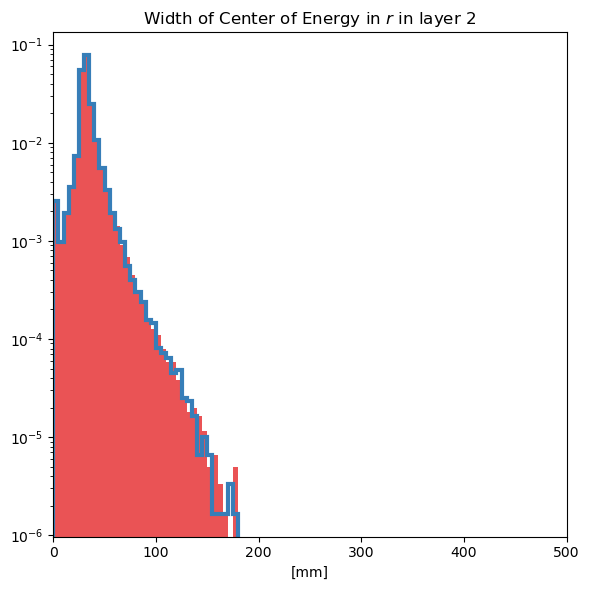

Separation power of Width r layer 3 histogram: 0.00017029714193564732


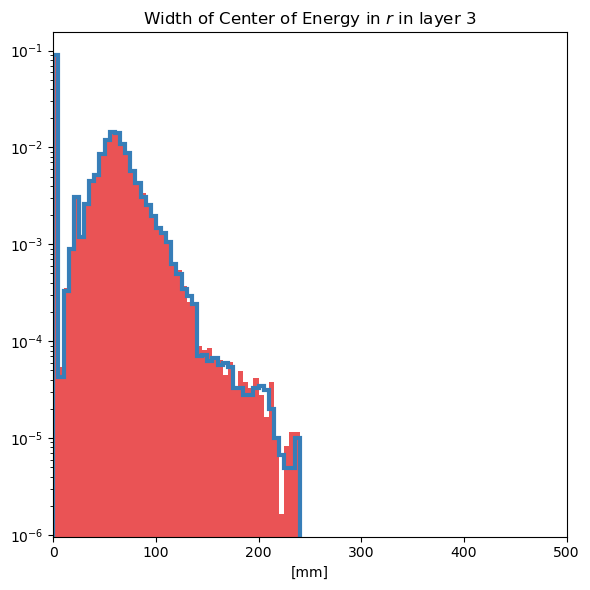

Separation power of Width r layer 12 histogram: 0.00014791208113549203


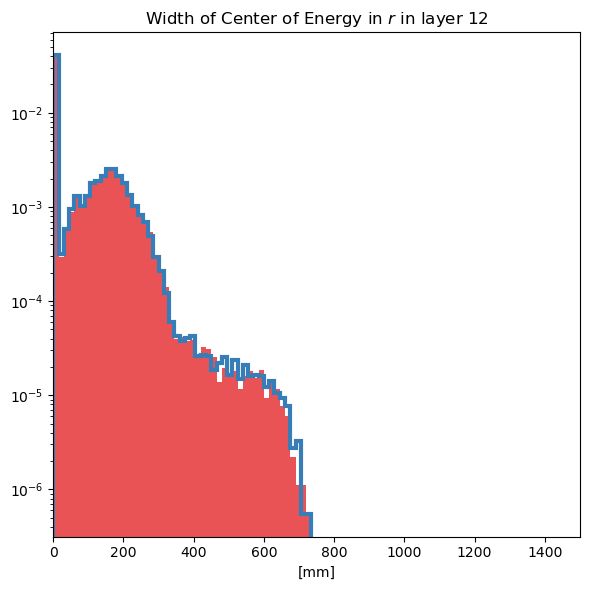

Separation power of voxel distribution histogram: 1.0099263839695856e-06


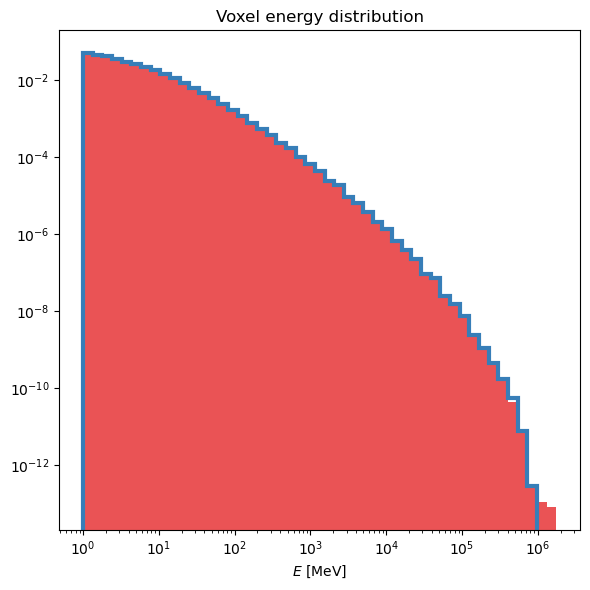

Separation power of Etot / Einc histogram: 0.00037815004135838406


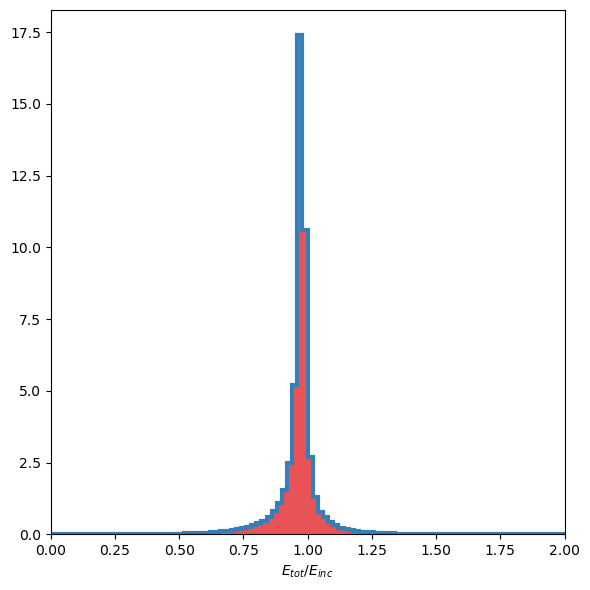

done


In [21]:
ds1_photons_reference_dict['E_layer_dict'] = get_sep_E_layers(HLF_photons_ref[1], HLF_photons_ref[0], ref=True)
ds1_photons_reference_dict['EC_eta_dict'] = get_sep_ECEtas(HLF_photons_ref[1], HLF_photons_ref[0], '1', ref=True)
ds1_photons_reference_dict['EC_phi_dict'] = get_sep_ECPhis(HLF_photons_ref[1], HLF_photons_ref[0], '1', ref=True)
ds1_photons_reference_dict['EC_eta_width_dict'] = get_sep_ECWidthEtas(HLF_photons_ref[1], HLF_photons_ref[0], '1', ref=True)
ds1_photons_reference_dict['EC_phi_width_dict'] = get_sep_ECWidthPhis(HLF_photons_ref[1], HLF_photons_ref[0], '1', ref=True)
ds1_photons_reference_dict['Sparsity_layer_dict'] = get_sep_Sparsity_layers(HLF_photons_ref[1], HLF_photons_ref[0], ref=True)
ds1_photons_reference_dict['EC_r_dict'] = get_sep_ECR(HLF_photons_ref[1], HLF_photons_ref[0], '1', ref=True)
ds1_photons_reference_dict['EC_r_width_dict'] = get_sep_ECWidthR(HLF_photons_ref[1], HLF_photons_ref[0], '1', ref=True)
ds1_photons_reference_dict['cell_dist'] = get_sep_cell_dist(HLF_photons_ref[1], HLF_photons_ref[0], ref=True)
ds1_photons_reference_dict['Etot_Einc_dist'] = get_sep_Etot_Einc(HLF_photons_ref[1], HLF_photons_ref[0], ref=True)

with open(f"ds1-photons_reference_{MIN_ENERGY}.pkl", 'wb') as handle:
    pickle.dump(ds1_photons_reference_dict, handle)

print(f"done")

#### ds1 photons 10 bootstraps for errorbars

In [35]:
# compute HLF
MIN_ENERGY = 1
HLF_photons_ref = []

ds1_photons_reference_dict = {'MIN_ENERGY': MIN_ENERGY}

for i in range(2):
    print(f"working on file {i+1}.")
    HLF_photons_ref.append(HLF.HighLevelFeatures('photon', 'CaloChallenge_homepage/code/binning_dataset_1_photons.xml'))
    E_inc, showers = extract_info(f'../scratch_CaloChallenge/data/official/dataset_1_photons_{i+1}.hdf5')
    showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
    HLF_photons_ref[-1].Einc = E_inc
    HLF_photons_ref[-1].showers = showers
    HLF_photons_ref[-1].CalculateFeatures(showers)

print(f"done reading files")


working on file 1.
working on file 2.
done reading files


In [ ]:
big_Einc = np.concatenate([HLF_photons_ref[0].Einc, HLF_photons_ref[1].Einc])
big_showers = np.concatenate([HLF_photons_ref[0].showers, HLF_photons_ref[1].showers])
print(big_Einc.shape)
print(big_showers.shape)

for i in range(9):
    print(f"working on file {i+1} of 9")
    current_Einc_1 = np.array([])
    current_Einc_2 = np.array([])
    for n in range(8,23):
        len_Einc = len(big_Einc[big_Einc==2**n])
        new_idx = np.random.choice(np.arange(len_Einc), size=len_Einc, replace=False)
        current_Einc_1 = np.concatenate([current_Einc_1, big_Einc[big_Einc==2**n][new_idx[:len(new_idx)//2]]])
        current_Einc_2 = np.concatenate([current_Einc_2, big_Einc[big_Einc==2**n][new_idx[len(new_idx)//2:]]])
        if n == 8:
            current_showers_1 = big_showers[(big_Einc==2**n).reshape(-1)][new_idx[:len(new_idx)//2]]
            current_showers_2 = big_showers[(big_Einc==2**n).reshape(-1)][new_idx[len(new_idx)//2:]]
        else:
            current_showers_1 = np.concatenate([current_showers_1, big_showers[(big_Einc==2**n).reshape(-1)][new_idx[:len(new_idx)//2]]])
            current_showers_2 = np.concatenate([current_showers_2, big_showers[(big_Einc==2**n).reshape(-1)][new_idx[len(new_idx)//2:]]])

    current_Einc_1 = current_Einc_1.reshape(-1, 1)
    current_Einc_2 = current_Einc_2.reshape(-1, 1)
    #print(current_Einc_1.shape)
    #print(np.unique(current_Einc_1, return_counts=True))
    #print(current_Einc_2.shape)
    #print(np.unique(current_Einc_2, return_counts=True))
    #print(current_showers_1.shape)
    #print(current_showers_2.shape)
    HLF_photons_ref.append(HLF.HighLevelFeatures('photon', 'CaloChallenge_homepage/code/binning_dataset_1_photons.xml'))
    HLF_photons_ref[-1].Einc = current_Einc_1
    HLF_photons_ref[-1].showers = current_showers_1
    HLF_photons_ref[-1].CalculateFeatures(current_showers_1)
    print("done with first half")
    HLF_photons_ref.append(HLF.HighLevelFeatures('photon', 'CaloChallenge_homepage/code/binning_dataset_1_photons.xml'))
    HLF_photons_ref[-1].Einc = current_Einc_2
    HLF_photons_ref[-1].showers = current_showers_2
    HLF_photons_ref[-1].CalculateFeatures(current_showers_2)
    print("done with second half")

print("done")

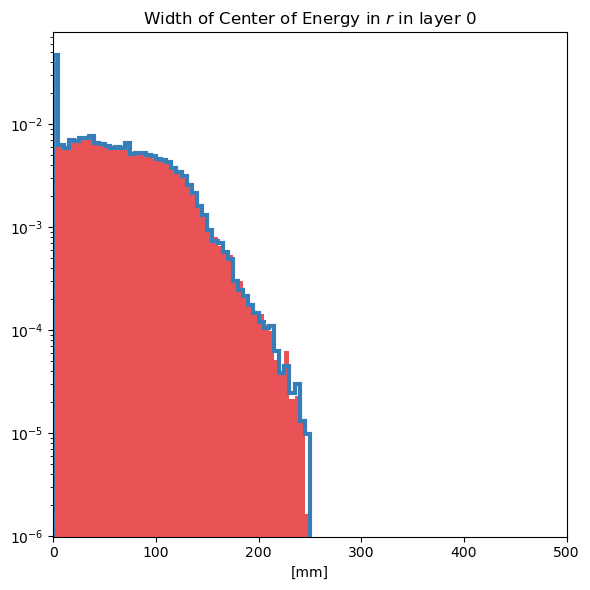

Separation power of Width r layer 1 histogram: 4.802437397610025e-05


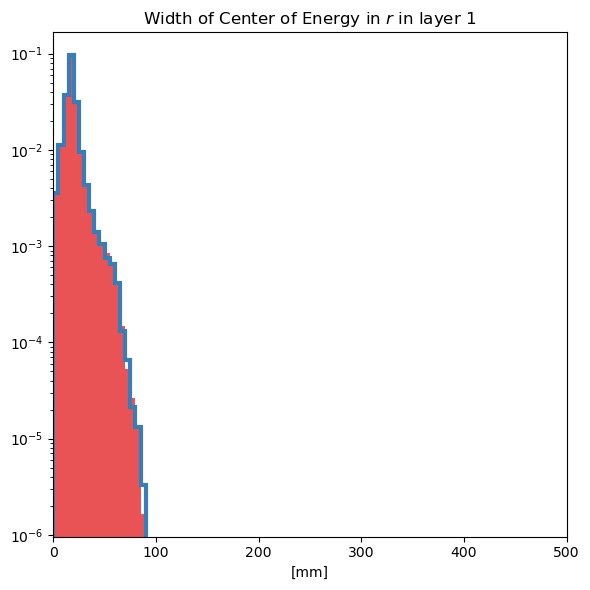

Separation power of Width r layer 2 histogram: 0.0001916060874495013


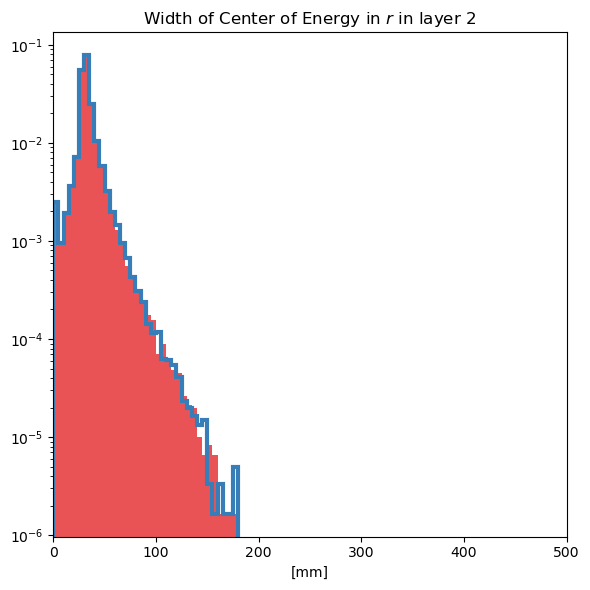

Separation power of Width r layer 3 histogram: 0.00015797443195785681


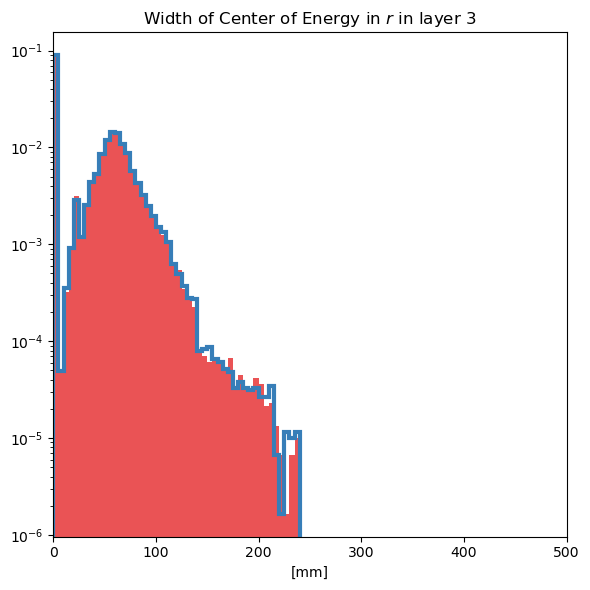

Separation power of Width r layer 12 histogram: 0.00018158041020781314


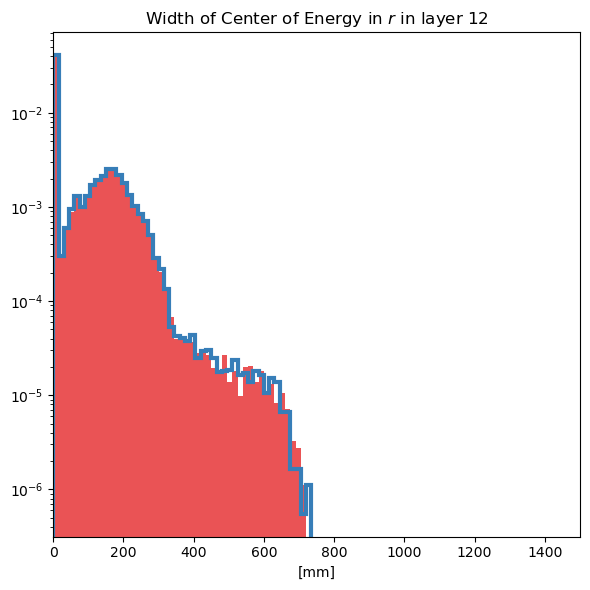

Separation power of voxel distribution histogram: 5.600202386454485e-07


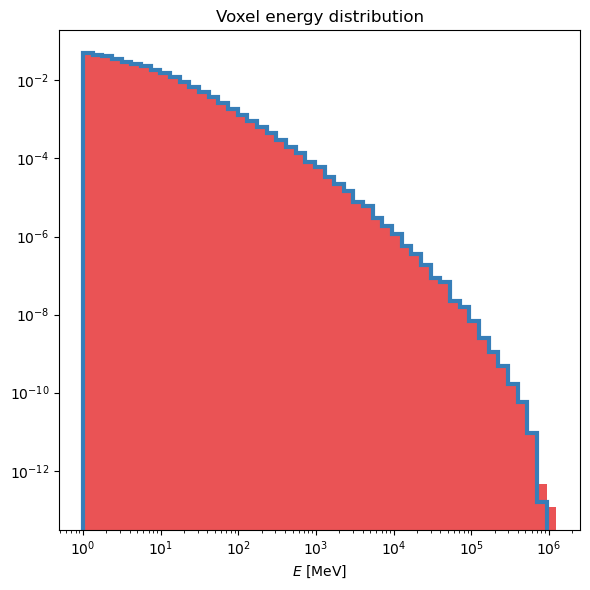

Separation power of Etot / Einc histogram: 0.00047910177816957593


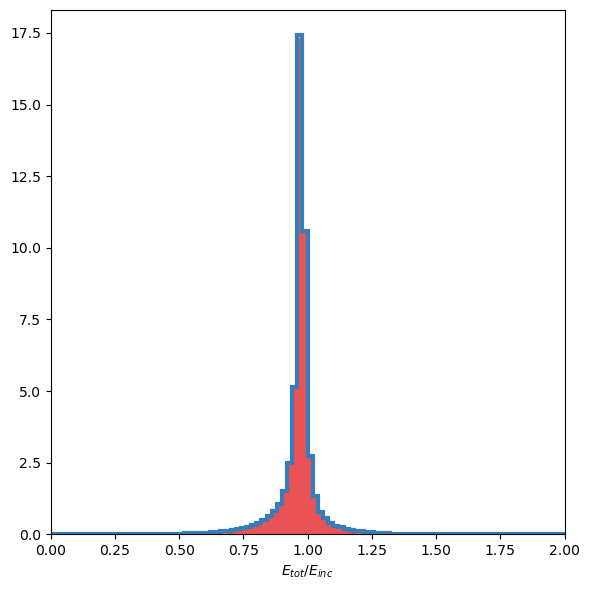

in iteration 9 of 10
Separation power of E layer 0 histogram: 0.0001915000777810678


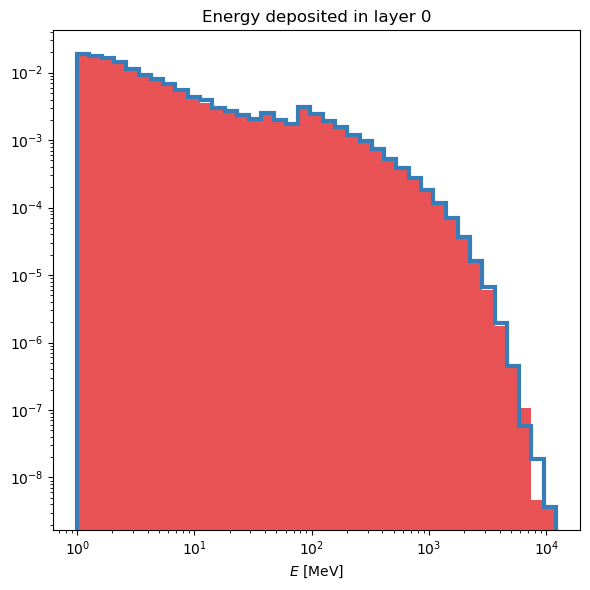

Separation power of E layer 1 histogram: 0.00015321618491826984


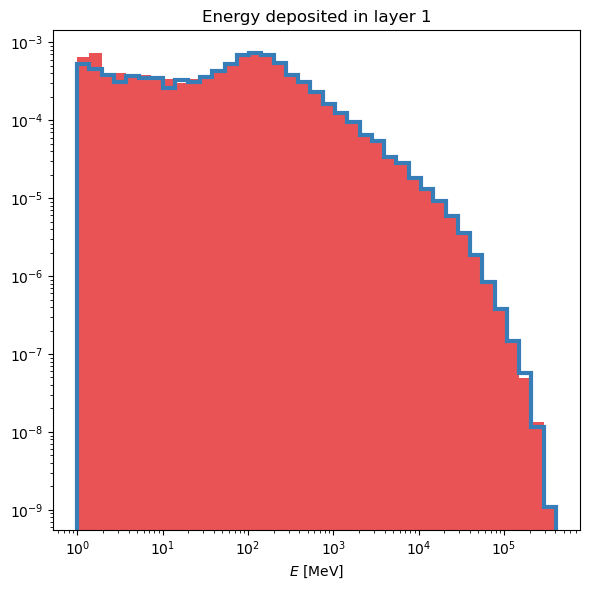

Separation power of E layer 2 histogram: 0.00013771711120158975


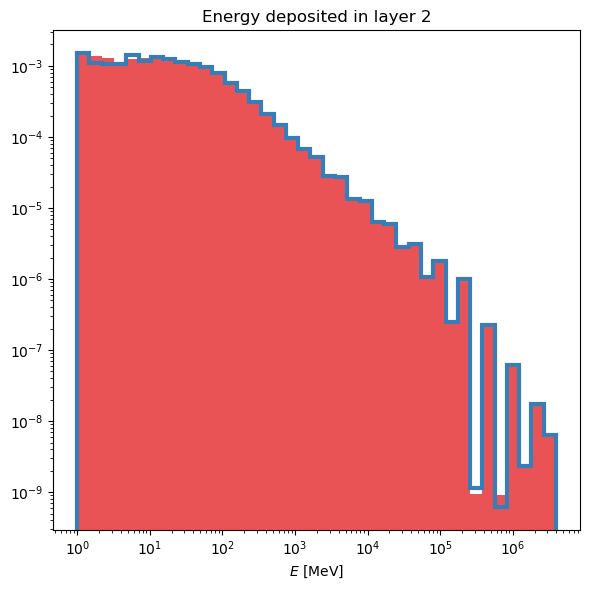

Separation power of E layer 3 histogram: 0.00019982451312781262


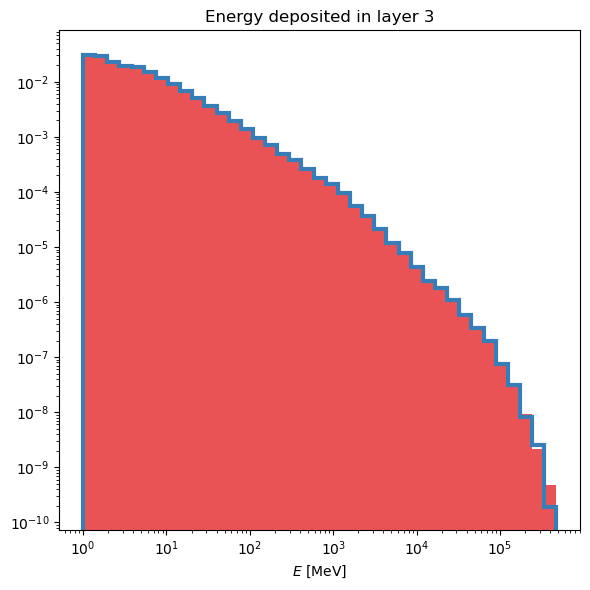

Separation power of E layer 12 histogram: 0.0003225694866770867


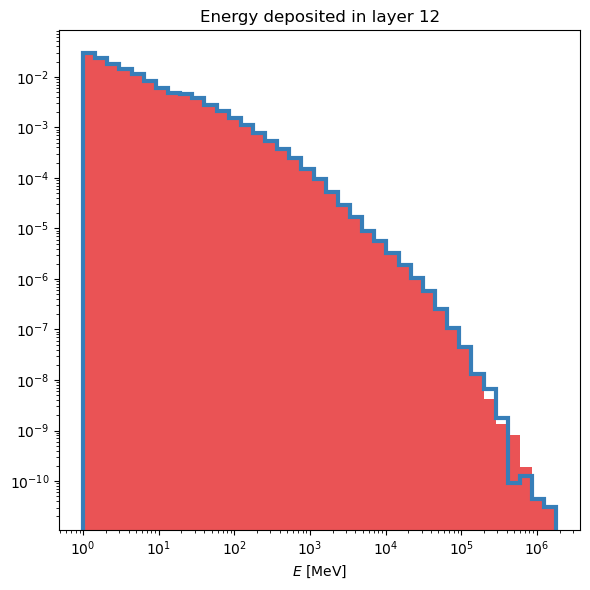

Separation power of EC Eta layer 1 histogram: 0.0003072046667569813


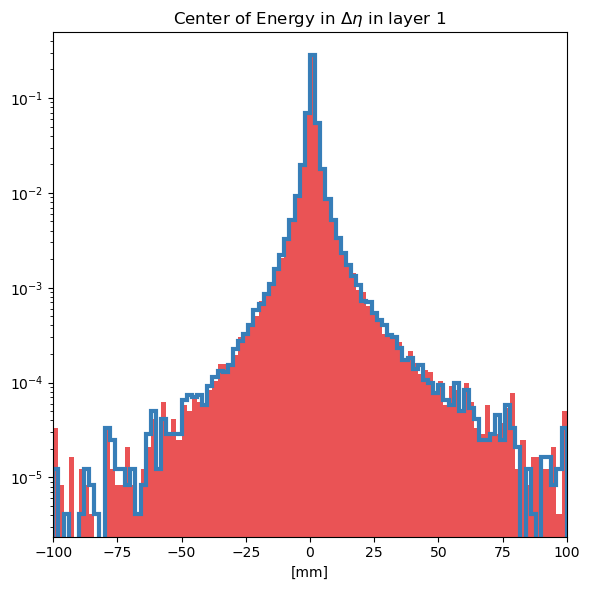

Separation power of EC Eta layer 2 histogram: 0.00039105509466595163


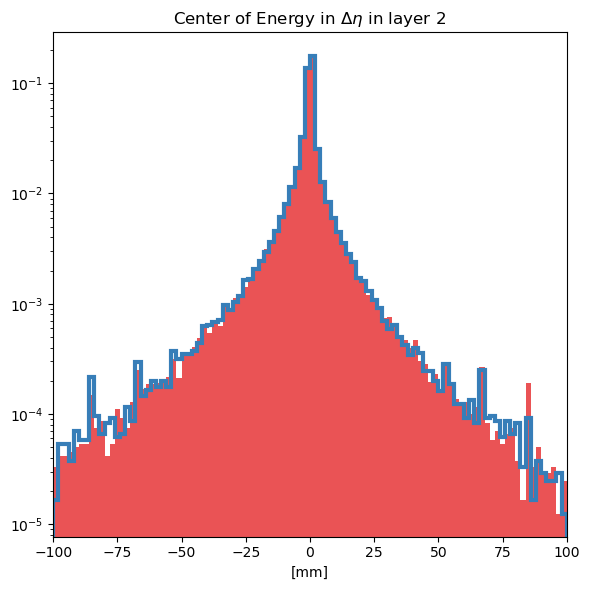

Separation power of EC Phi layer 1 histogram: 0.00033149721544585635


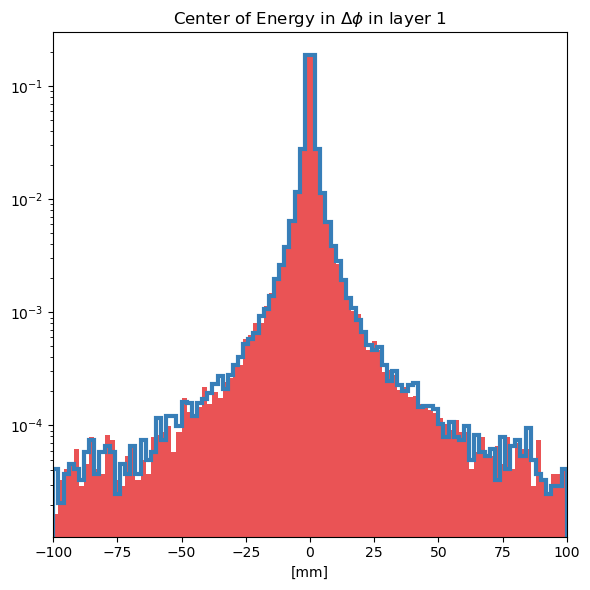

Separation power of EC Phi layer 2 histogram: 0.00036895929390150494


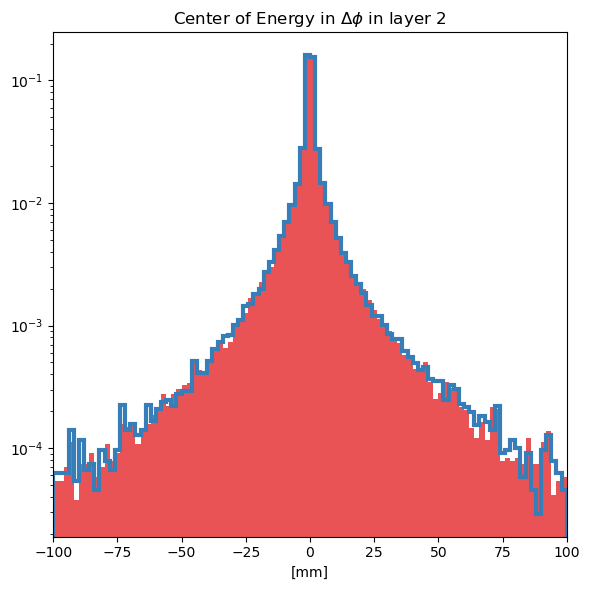

Separation power of Width Eta layer 1 histogram: 0.00040220099332028596


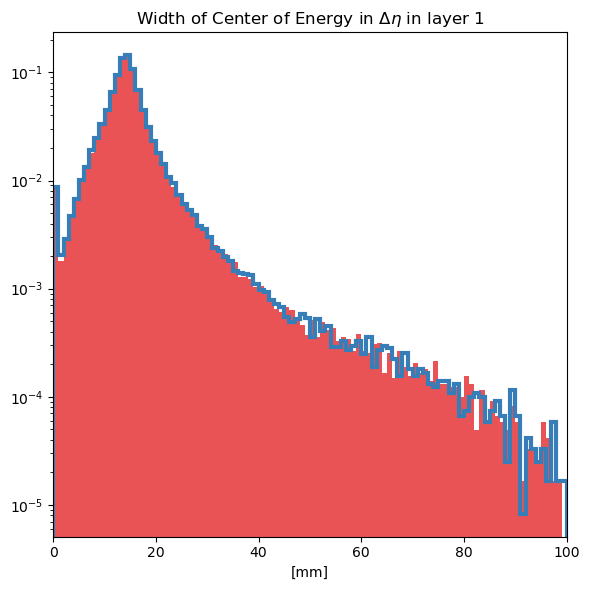

Separation power of Width Eta layer 2 histogram: 0.00035538483578265374


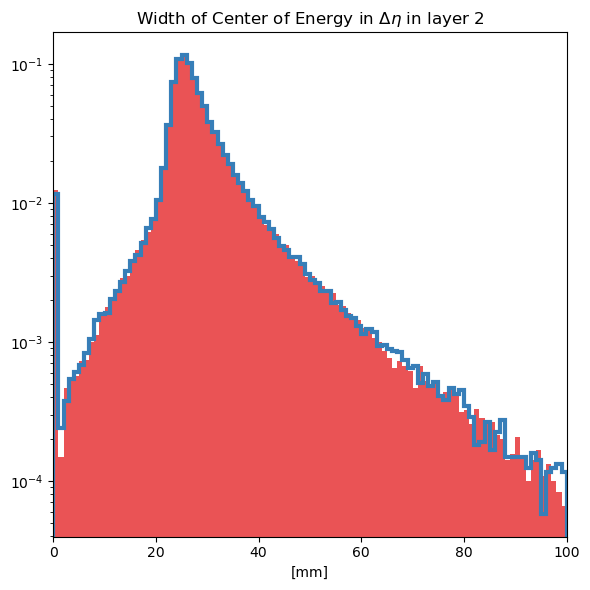

Separation power of Width Phi layer 1 histogram: 0.000509281100677259


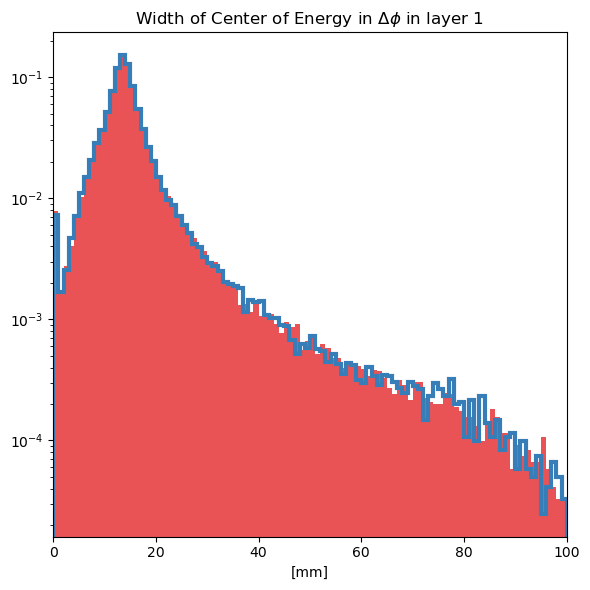

Separation power of Width Phi layer 2 histogram: 0.00032744550991831915


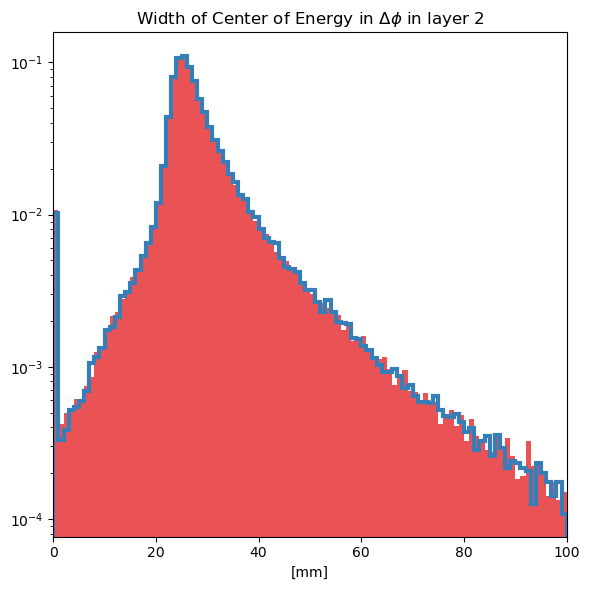

Separation power of Sparsity layer 0 histogram: 6.593073074718702e-05


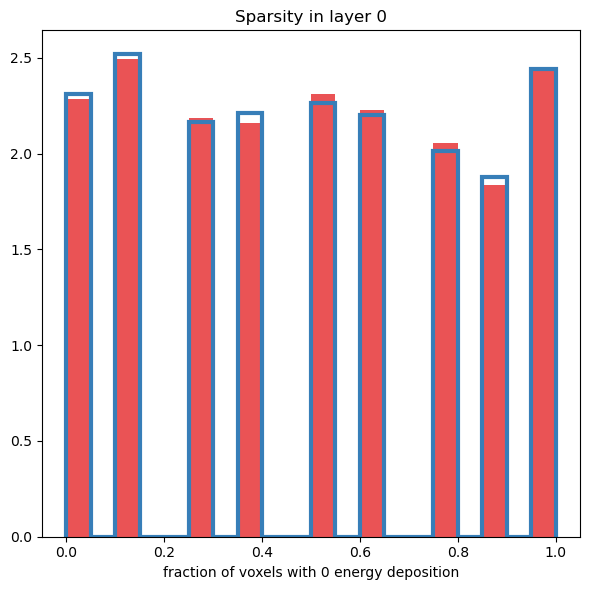

Separation power of Sparsity layer 1 histogram: 6.062560057534352e-05


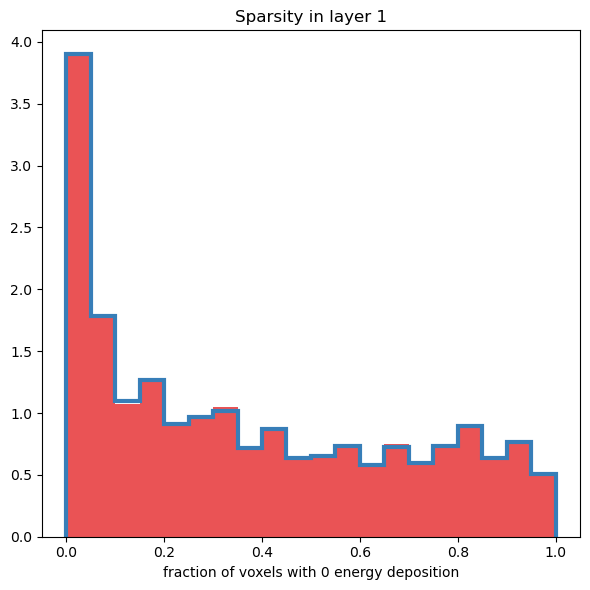

Separation power of Sparsity layer 2 histogram: 3.878186543343656e-05


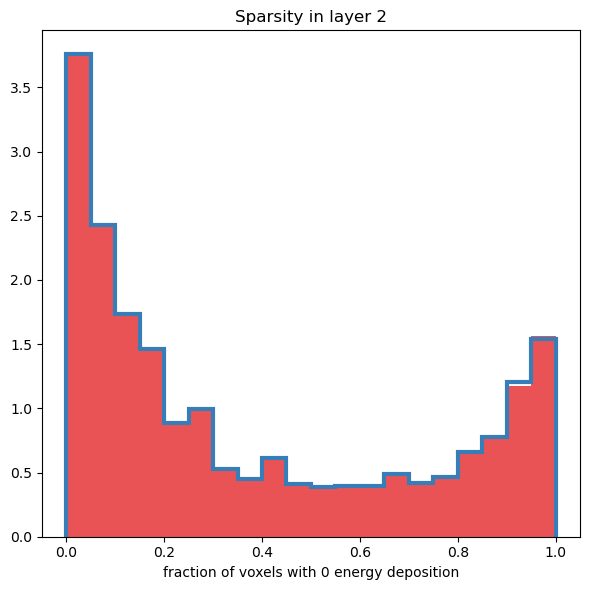

Separation power of Sparsity layer 3 histogram: 1.0794932991067769e-05


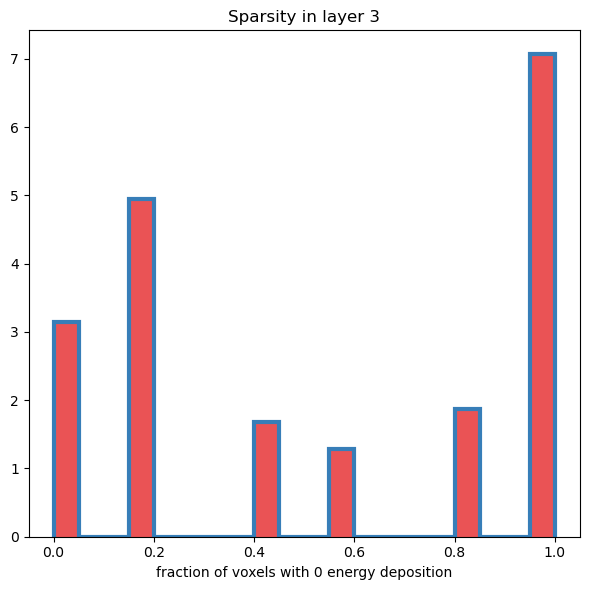

Separation power of Sparsity layer 12 histogram: 1.0708084756505076e-05


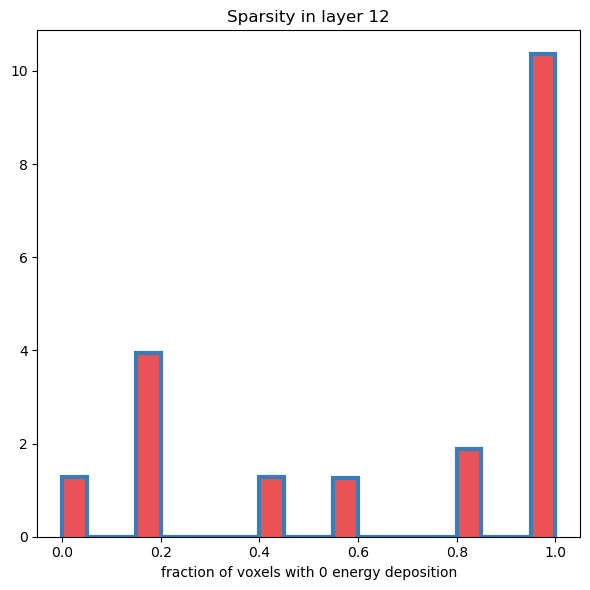

Separation power of EC r layer 0 histogram: 0.00032002358494514317


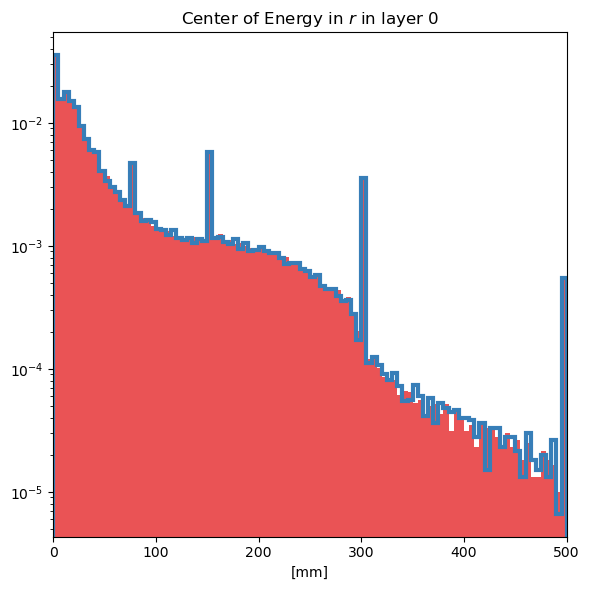

Separation power of EC r layer 1 histogram: 0.00013874979951888493


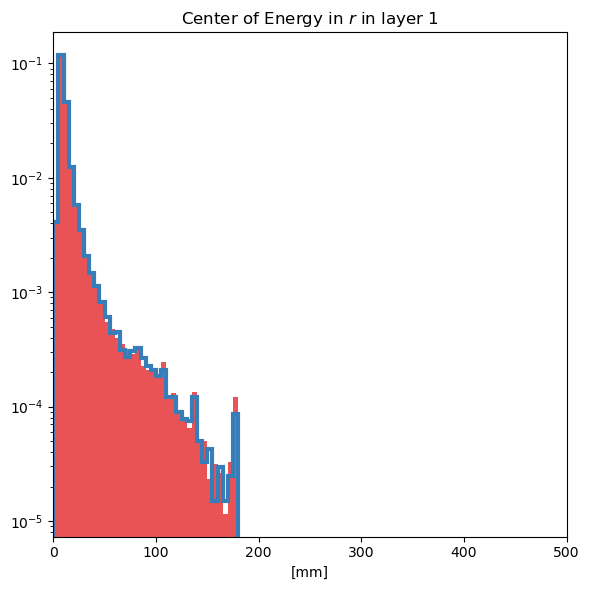

Separation power of EC r layer 2 histogram: 0.00030648417576946353


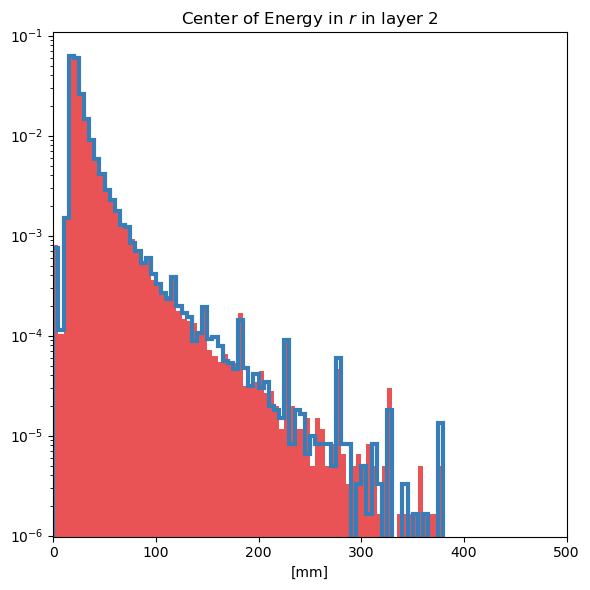

Separation power of EC r layer 3 histogram: 0.00030282401410851


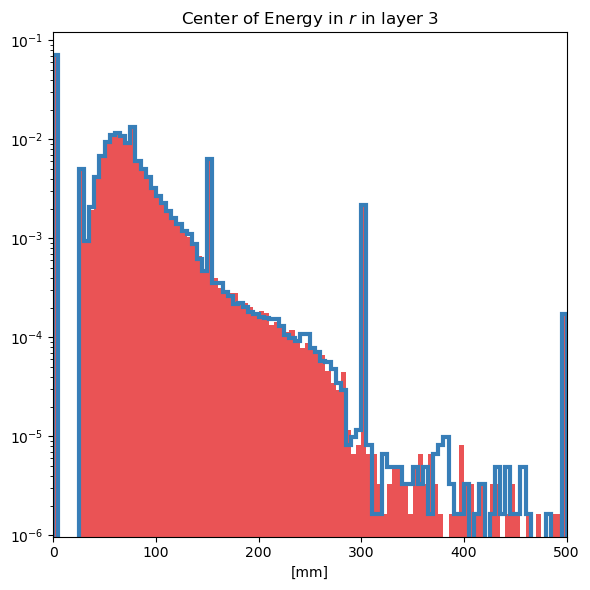

Separation power of EC r layer 12 histogram: 0.0003638287938022603


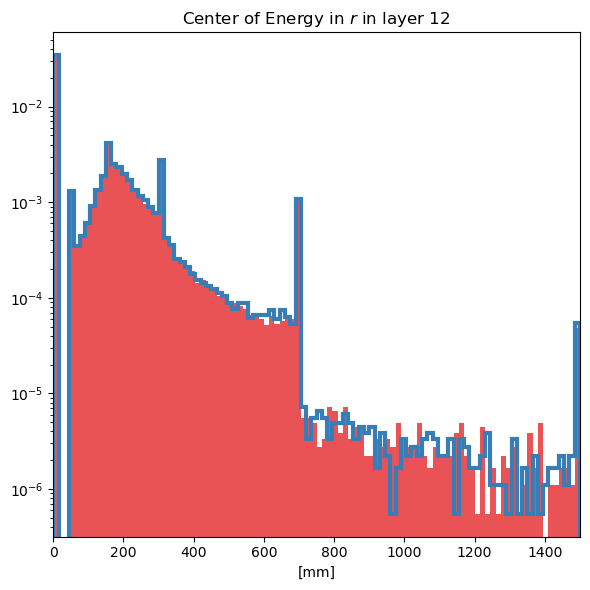

Separation power of Width r layer 0 histogram: 0.00014372878057220142


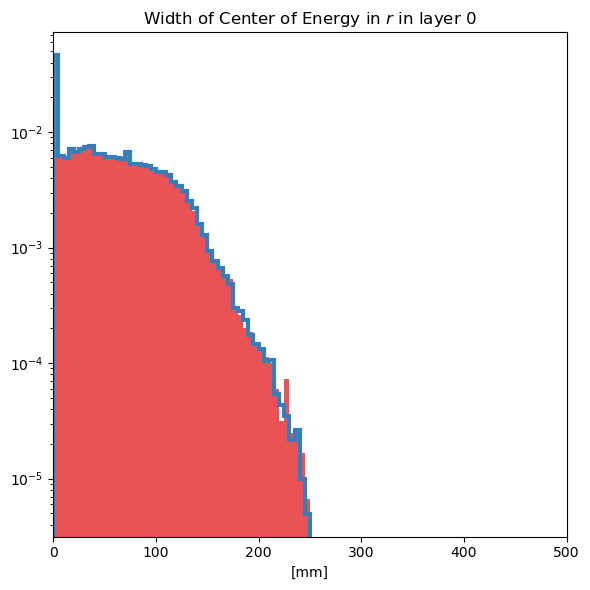

Separation power of Width r layer 1 histogram: 6.829788656525471e-05


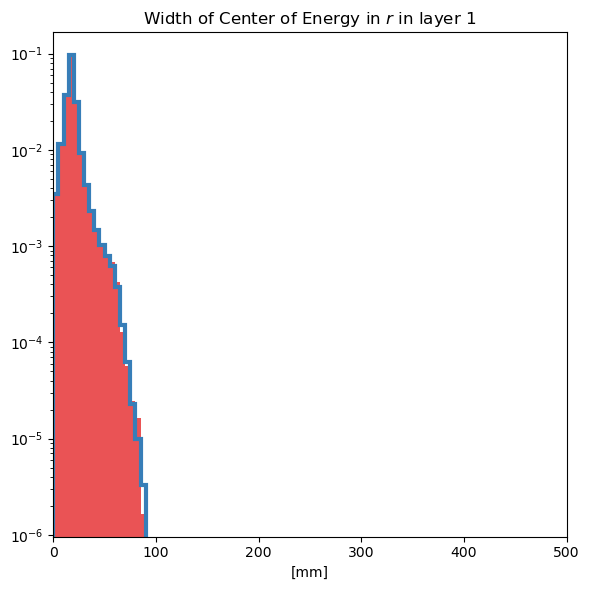

Separation power of Width r layer 2 histogram: 0.00014458703840208252


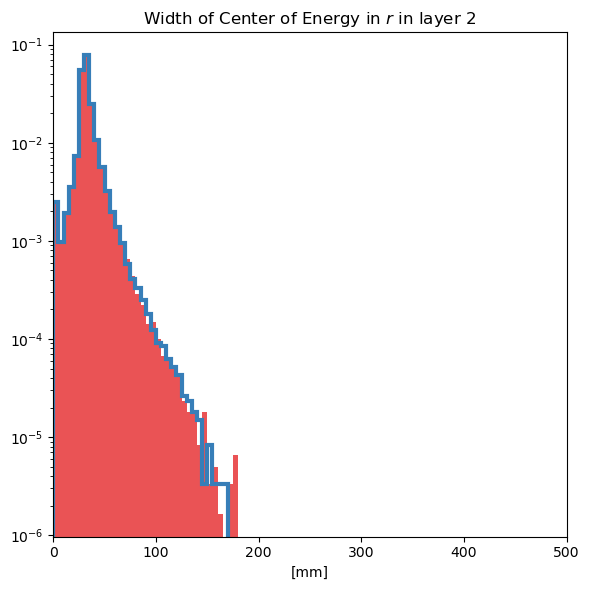

Separation power of Width r layer 3 histogram: 0.00021481443365475145


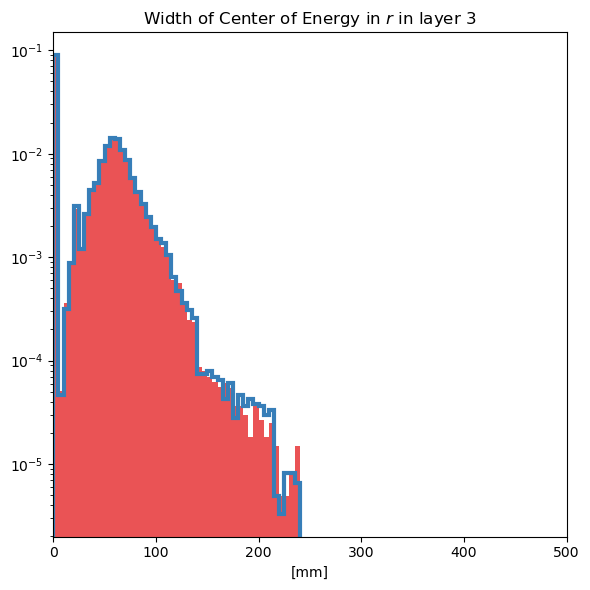

Separation power of Width r layer 12 histogram: 0.00016815420170508536


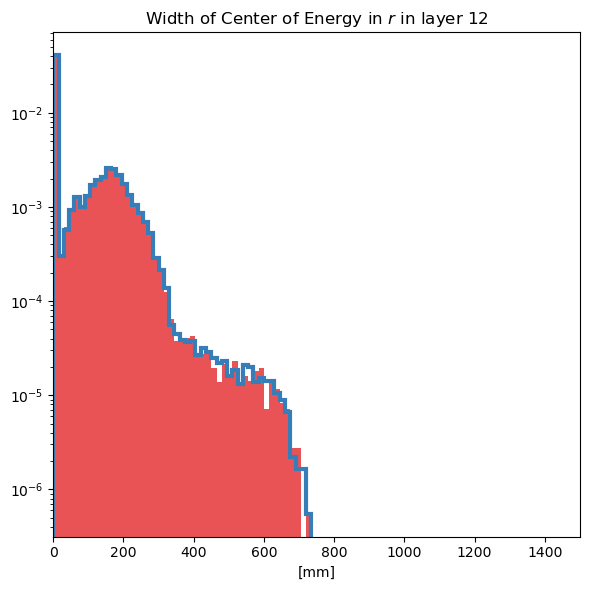

Separation power of voxel distribution histogram: 9.581953382727825e-07


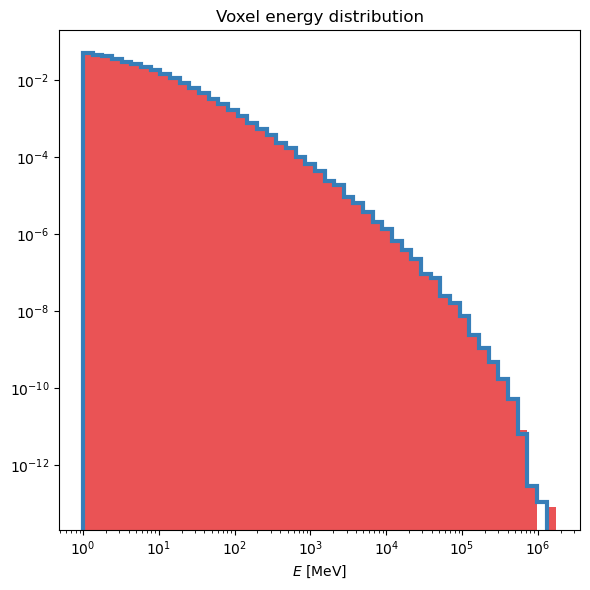

Separation power of Etot / Einc histogram: 0.00034727519216394396


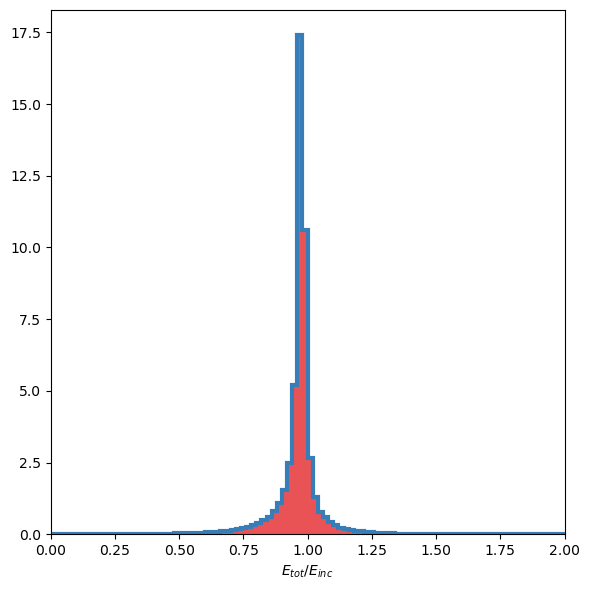

in iteration 10 of 10
Separation power of E layer 0 histogram: 0.00016609140519691117


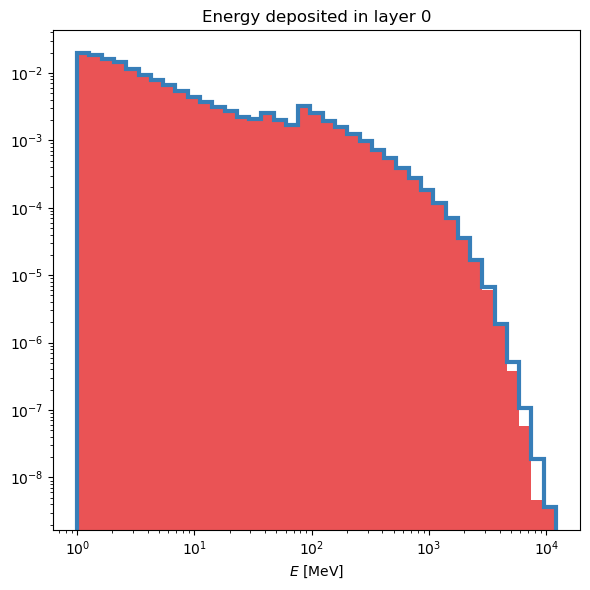

Separation power of E layer 1 histogram: 0.00012842575682932278


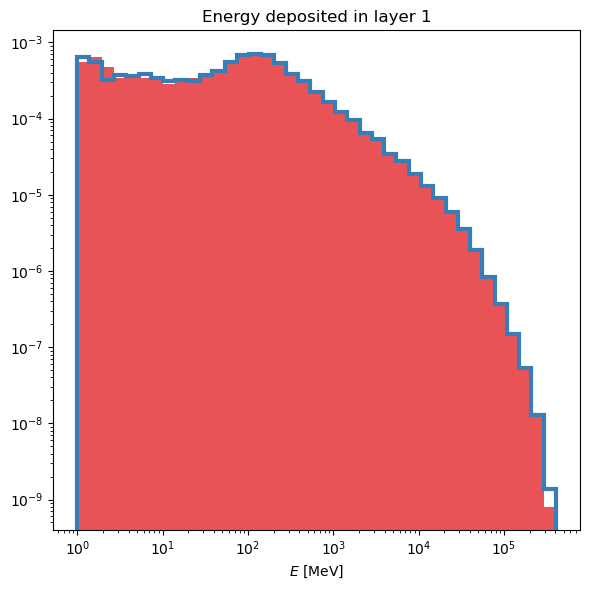

Separation power of E layer 2 histogram: 5.55592677150745e-05


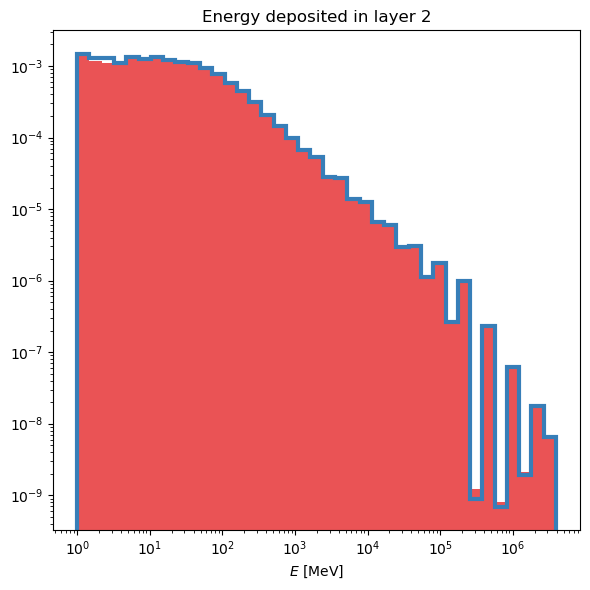

Separation power of E layer 3 histogram: 0.00020871607183806275


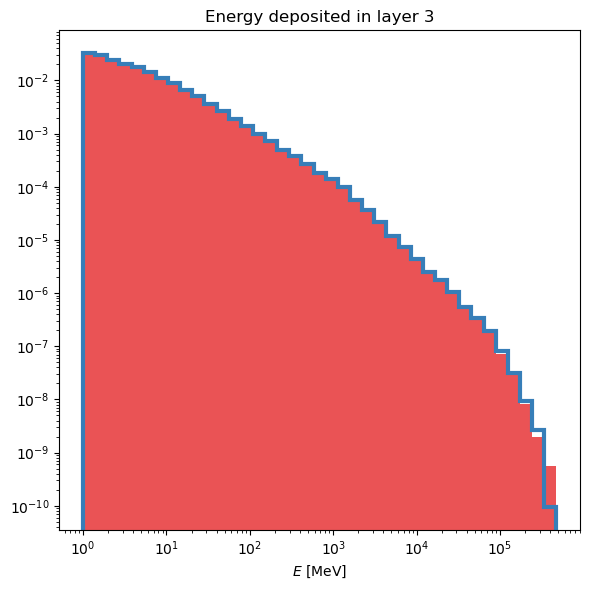

Separation power of E layer 12 histogram: 0.0003926933533873081


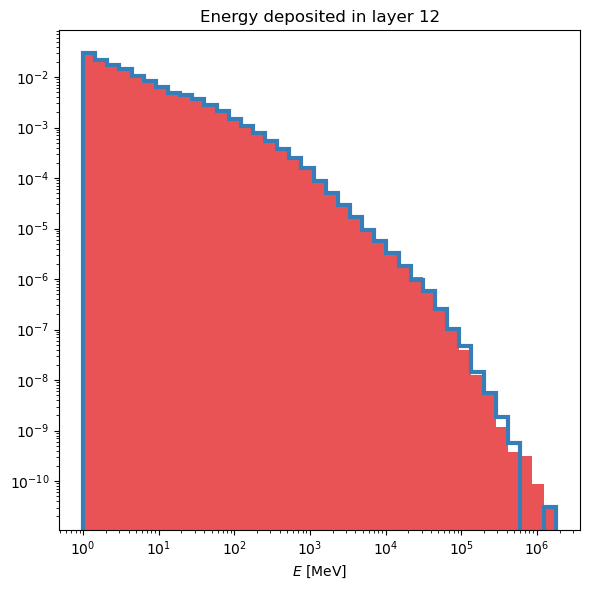

Separation power of EC Eta layer 1 histogram: 0.00037183826146485274


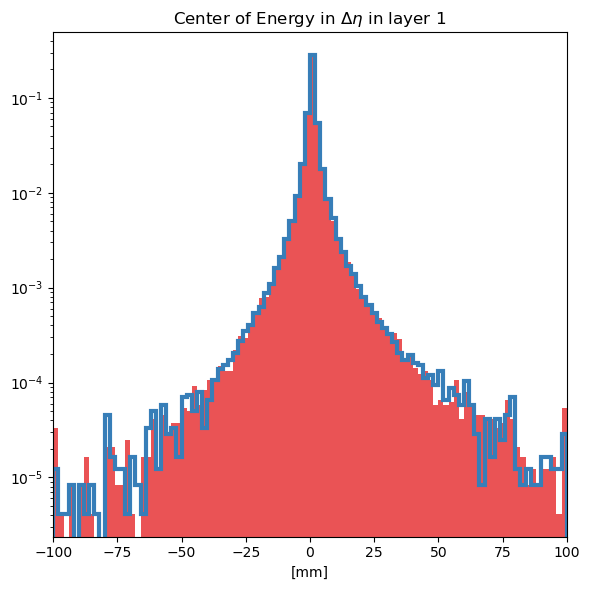

Separation power of EC Eta layer 2 histogram: 0.0003942404160398832


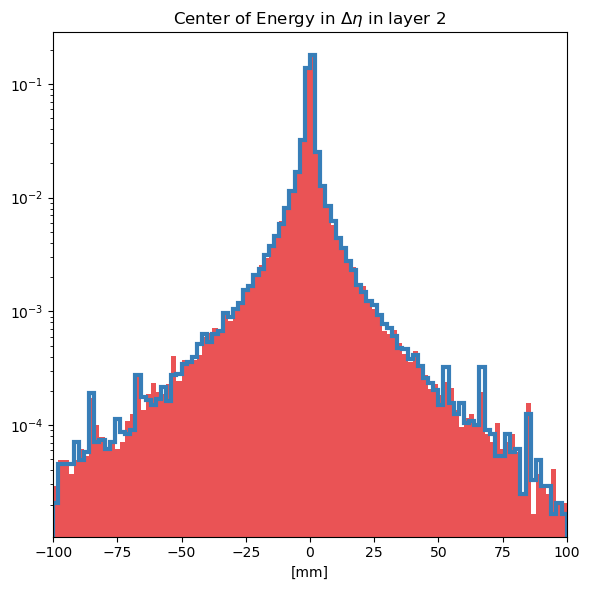

Separation power of EC Phi layer 1 histogram: 0.00039892770734480245


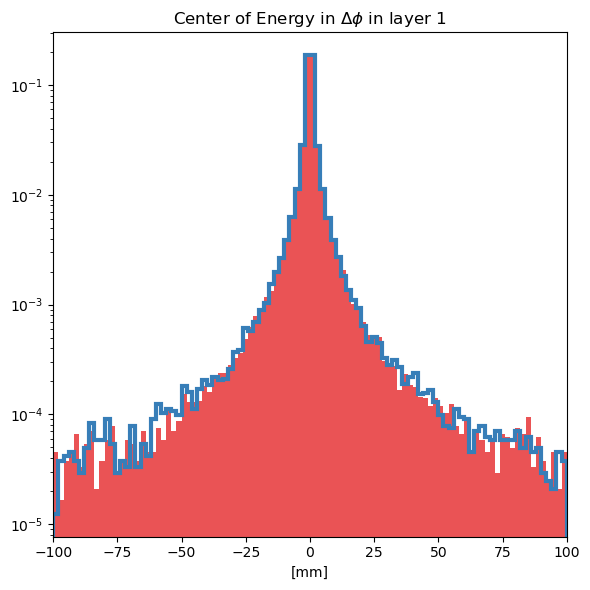

Separation power of EC Phi layer 2 histogram: 0.0004183189703156435


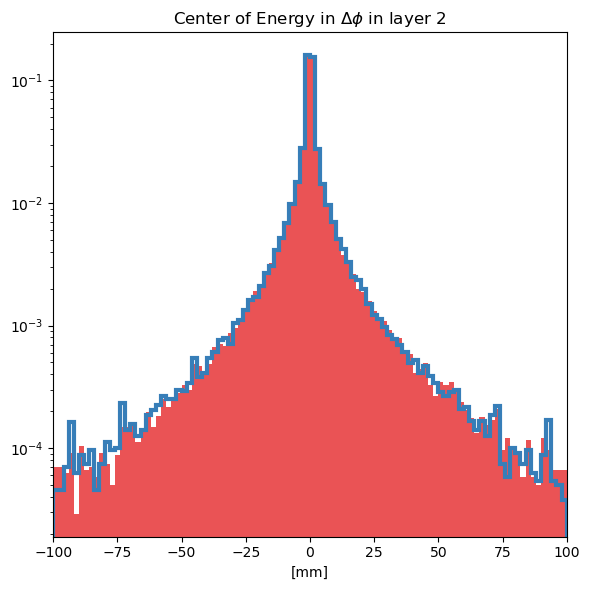

Separation power of Width Eta layer 1 histogram: 0.0003020065776992869


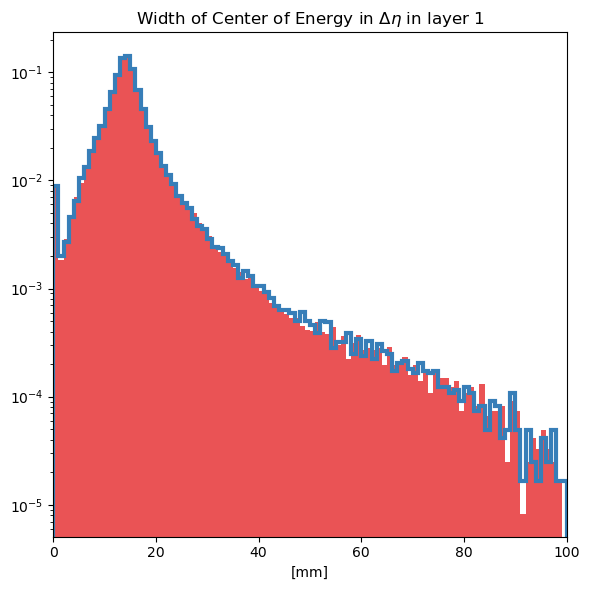

Separation power of Width Eta layer 2 histogram: 0.0004844872035699506


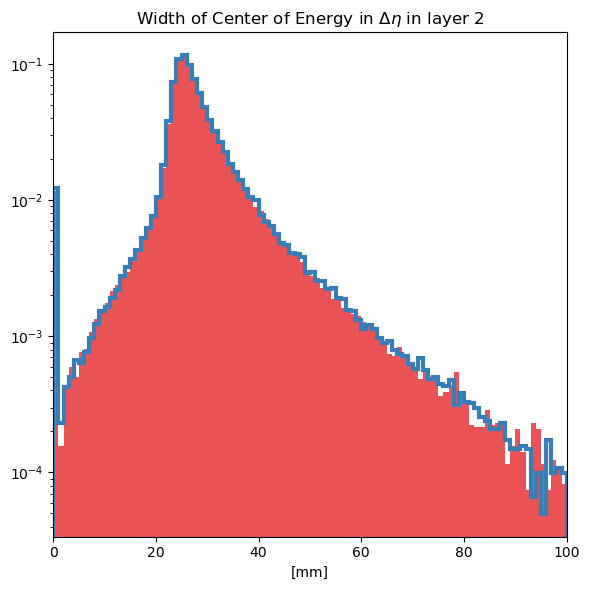

Separation power of Width Phi layer 1 histogram: 0.0002955080993450818


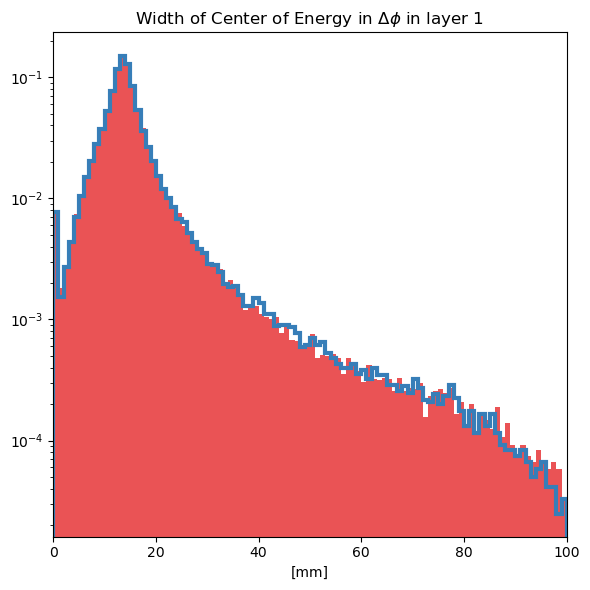

Separation power of Width Phi layer 2 histogram: 0.00040895944364497874


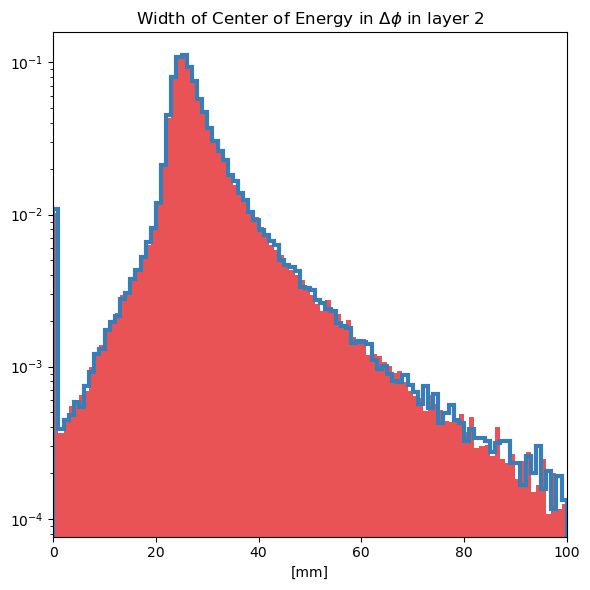

Separation power of Sparsity layer 0 histogram: 1.9481501572015643e-05


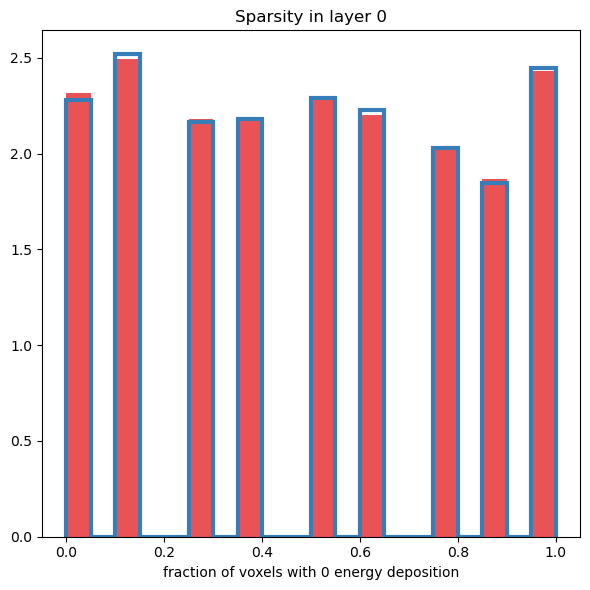

Separation power of Sparsity layer 1 histogram: 5.549189563674295e-05


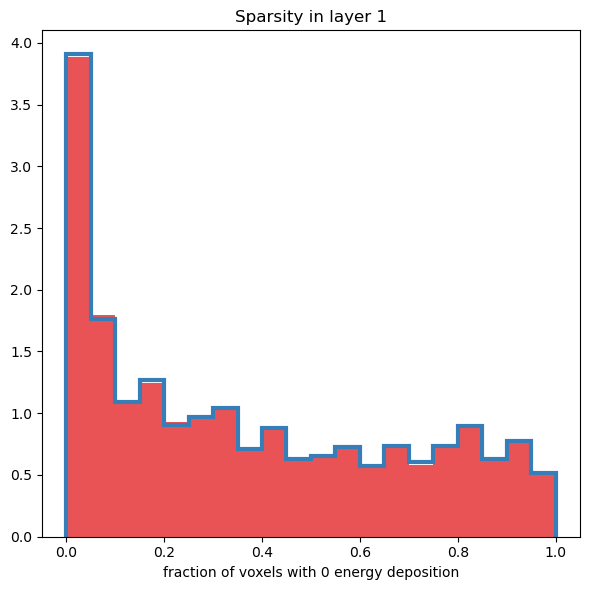

Separation power of Sparsity layer 2 histogram: 7.370455600551269e-05


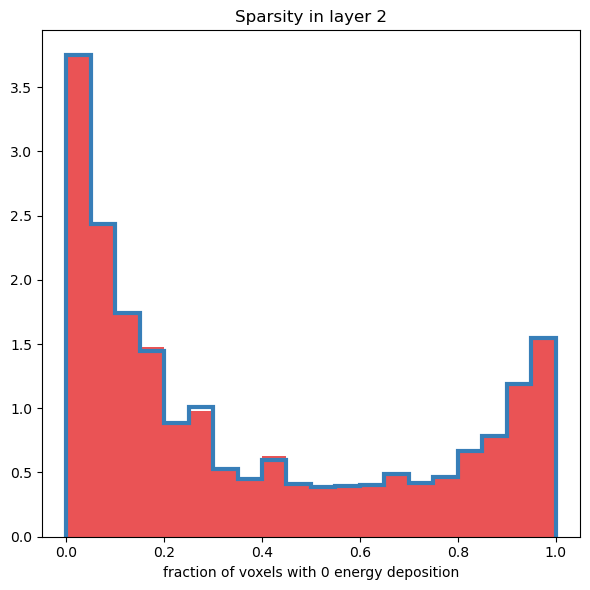

Separation power of Sparsity layer 3 histogram: 1.091173287878397e-05


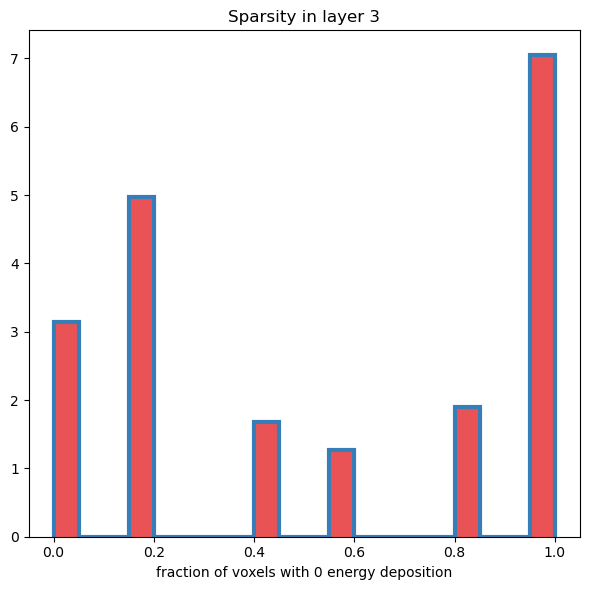

Separation power of Sparsity layer 12 histogram: 2.7444266650688404e-05


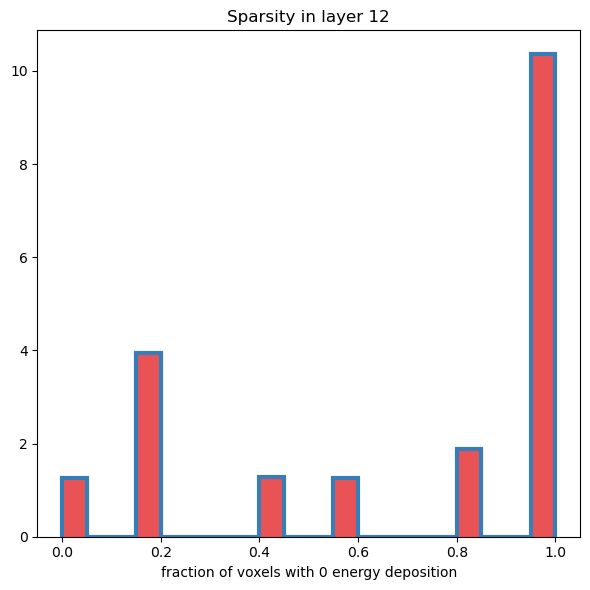

Separation power of EC r layer 0 histogram: 0.0003860009578536294


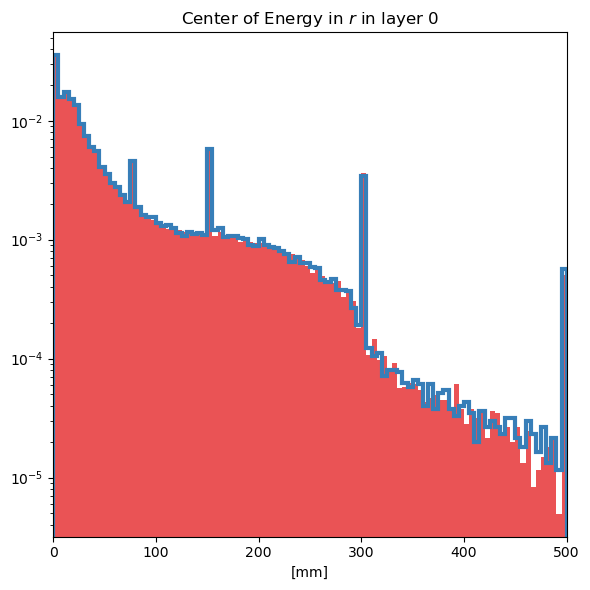

Separation power of EC r layer 1 histogram: 0.00017686787305253615


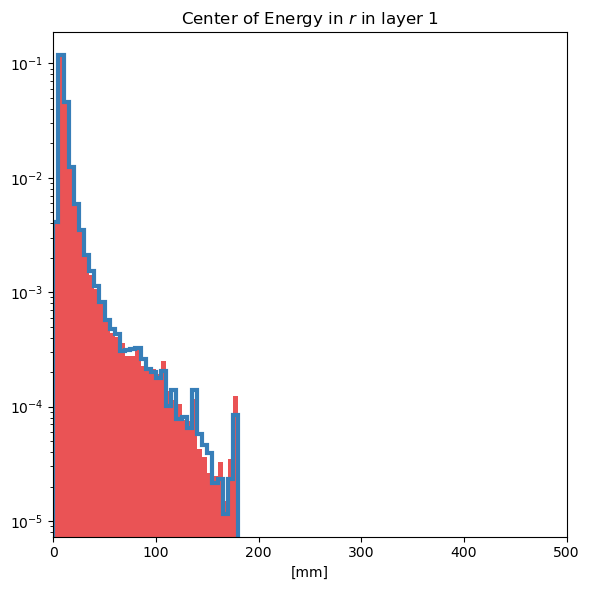

Separation power of EC r layer 2 histogram: 0.0002344621972881905


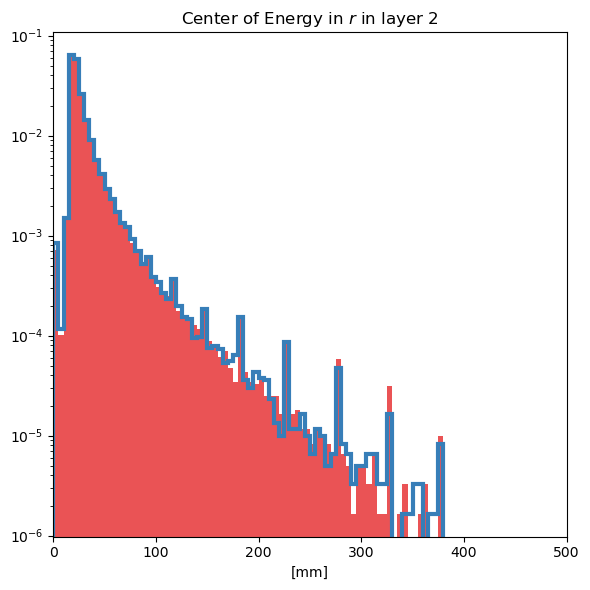

Separation power of EC r layer 3 histogram: 0.00041402795473850334


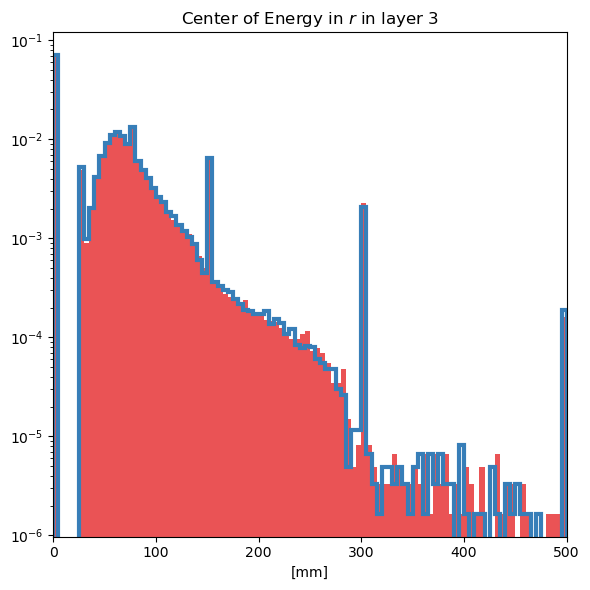

Separation power of EC r layer 12 histogram: 0.0003348528768495997


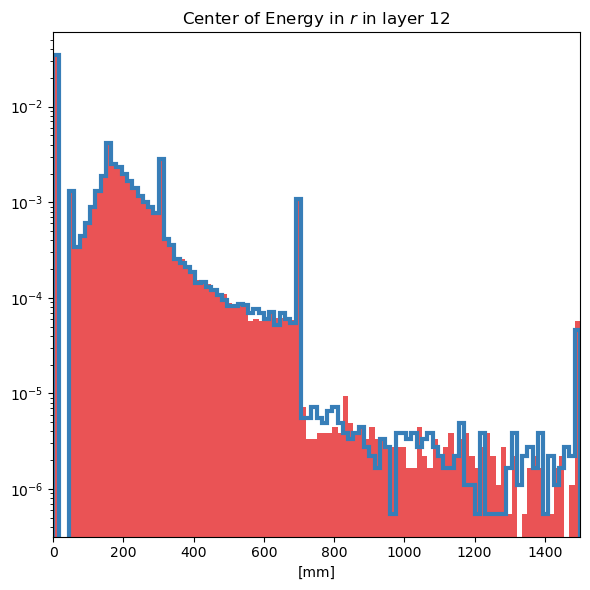

Separation power of Width r layer 0 histogram: 0.00019899429139591906


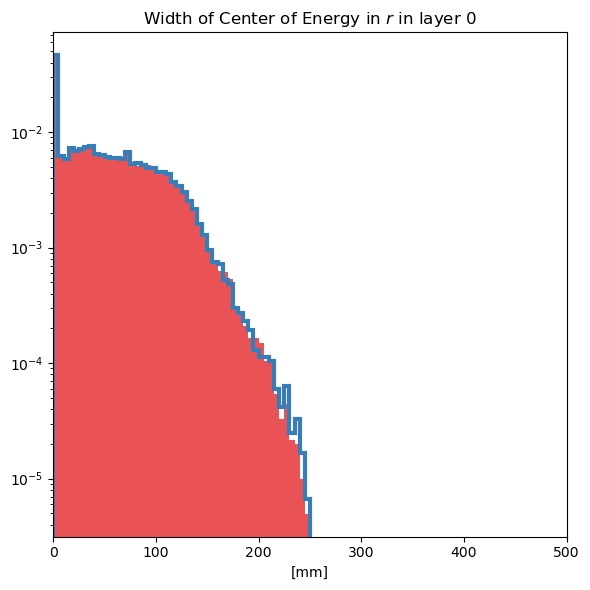

Separation power of Width r layer 1 histogram: 6.864892051217019e-05


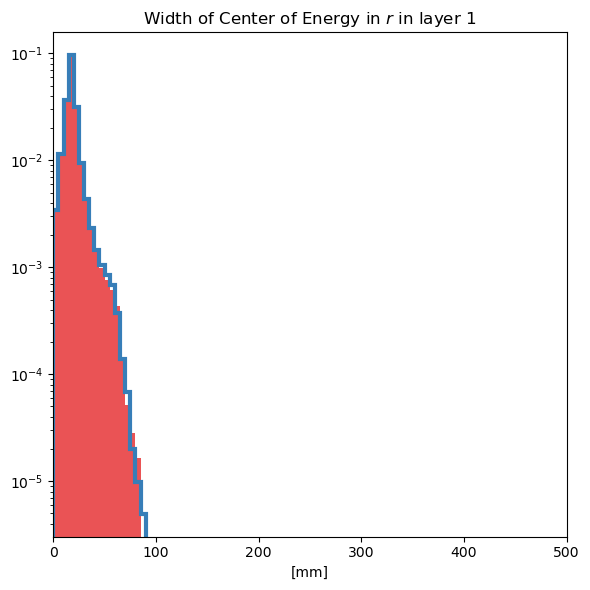

Separation power of Width r layer 2 histogram: 0.000153941788220913


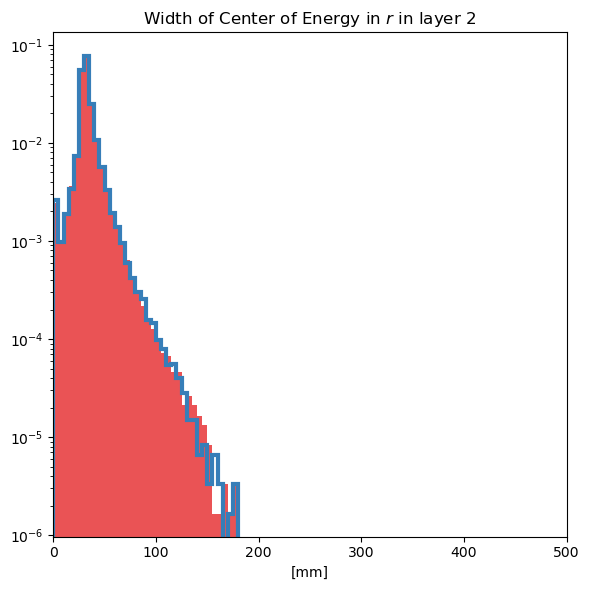

Separation power of Width r layer 3 histogram: 0.00020211920483801865


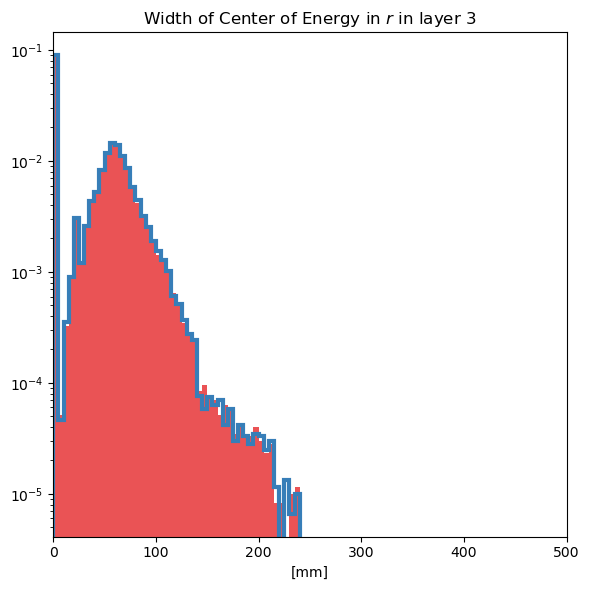

Separation power of Width r layer 12 histogram: 0.000312141352267937


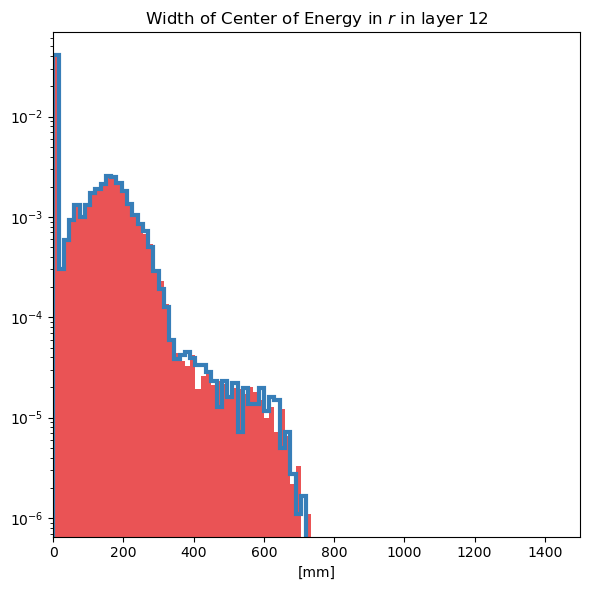

Separation power of voxel distribution histogram: 1.029438878343334e-06


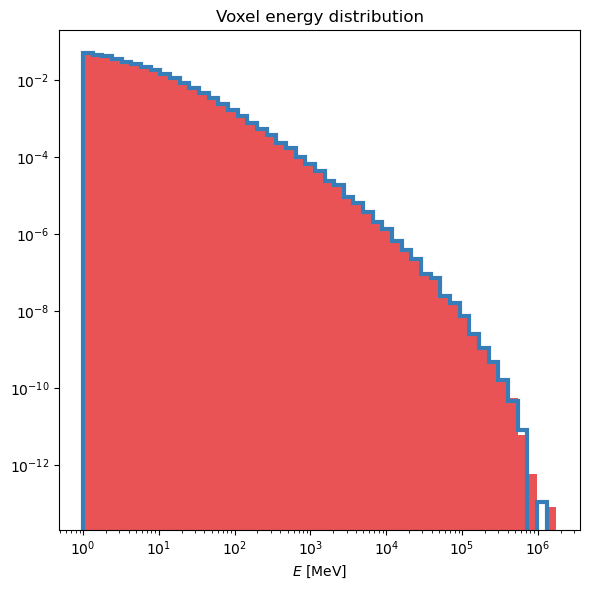

Separation power of Etot / Einc histogram: 0.00041627757596442134


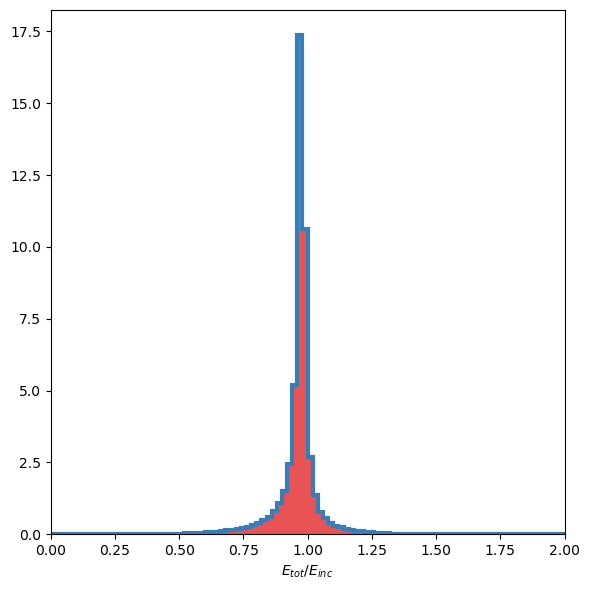

done


In [38]:
ds1_photons_reference_dict['E_layer_dict'] = []
ds1_photons_reference_dict['EC_eta_dict'] = []
ds1_photons_reference_dict['EC_phi_dict'] = []
ds1_photons_reference_dict['EC_eta_width_dict'] = []
ds1_photons_reference_dict['EC_phi_width_dict'] = []
ds1_photons_reference_dict['Sparsity_layer_dict'] = []
ds1_photons_reference_dict['EC_r_dict'] = []
ds1_photons_reference_dict['EC_r_width_dict'] = []
ds1_photons_reference_dict['cell_dist'] = []
ds1_photons_reference_dict['Etot_Einc_dist'] = []


for i in range(10):
    print(f'in iteration {i+1} of 10')
    ds1_photons_reference_dict['E_layer_dict'].append(get_sep_E_layers(HLF_photons_ref[2*i+1], HLF_photons_ref[2*i], ref=True))
    ds1_photons_reference_dict['EC_eta_dict'].append(get_sep_ECEtas(HLF_photons_ref[2*i+1], HLF_photons_ref[2*i], '1', ref=True))
    ds1_photons_reference_dict['EC_phi_dict'].append(get_sep_ECPhis(HLF_photons_ref[2*i+1], HLF_photons_ref[2*i], '1', ref=True))
    ds1_photons_reference_dict['EC_eta_width_dict'].append(get_sep_ECWidthEtas(HLF_photons_ref[2*i+1], HLF_photons_ref[2*i], '1', ref=True))
    ds1_photons_reference_dict['EC_phi_width_dict'].append(get_sep_ECWidthPhis(HLF_photons_ref[2*i+1], HLF_photons_ref[2*i], '1', ref=True))
    ds1_photons_reference_dict['Sparsity_layer_dict'].append(get_sep_Sparsity_layers(HLF_photons_ref[2*i+1], HLF_photons_ref[2*i], ref=True))
    ds1_photons_reference_dict['EC_r_dict'].append(get_sep_ECR(HLF_photons_ref[2*i+1], HLF_photons_ref[2*i], '1', ref=True))
    ds1_photons_reference_dict['EC_r_width_dict'].append(get_sep_ECWidthR(HLF_photons_ref[2*i+1], HLF_photons_ref[2*i], '1', ref=True))
    ds1_photons_reference_dict['cell_dist'].append(get_sep_cell_dist(HLF_photons_ref[2*i+1], HLF_photons_ref[2*i], ref=True))
    ds1_photons_reference_dict['Etot_Einc_dist'].append(get_sep_Etot_Einc(HLF_photons_ref[2*i+1], HLF_photons_ref[2*i], ref=True))

with open(f"ds1-photons_reference_{MIN_ENERGY}.pkl", 'wb') as handle:
    pickle.dump(ds1_photons_reference_dict, handle)

print(f"done")

#### ds1 pions

In [38]:
# compute HLF
MIN_ENERGY = 1
HLF_pions_ref = []

ds1_pions_reference_dict = {'MIN_ENERGY': MIN_ENERGY}
file_name = {0: 'dataset_1_pions_1', 1: 'NEW_dataset_1_pions_2'}

for i in range(2):
    print(f"working on file {i+1}.")
    HLF_pions_ref.append(HLF.HighLevelFeatures('pion', 'CaloChallenge_homepage/code/binning_dataset_1_pions.xml'))
    E_inc, showers = extract_info(f'../scratch_CaloChallenge/data/official/{file_name[i]}.hdf5')
    showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
    HLF_pions_ref[-1].Einc = E_inc
    HLF_pions_ref[-1].showers = showers
    HLF_pions_ref[-1].CalculateFeatures(showers)

print(f"done reading files")


working on file 1.
working on file 2.
done reading files


Separation power of E layer 0 histogram: 0.00018046309063003208


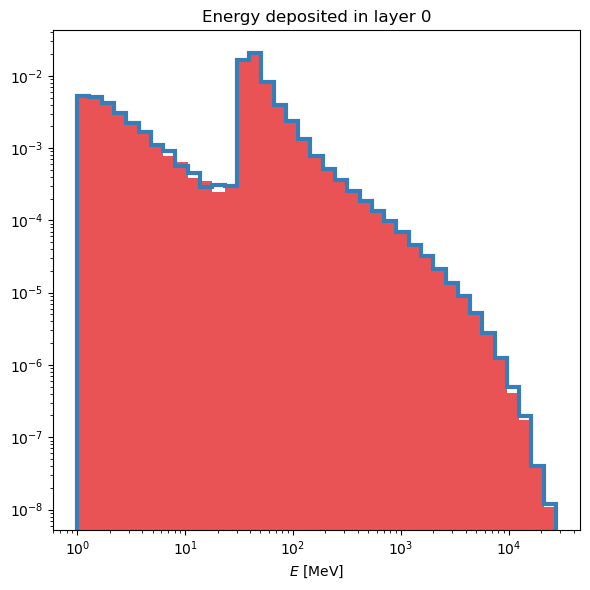

Separation power of E layer 1 histogram: 0.0005678663816632068


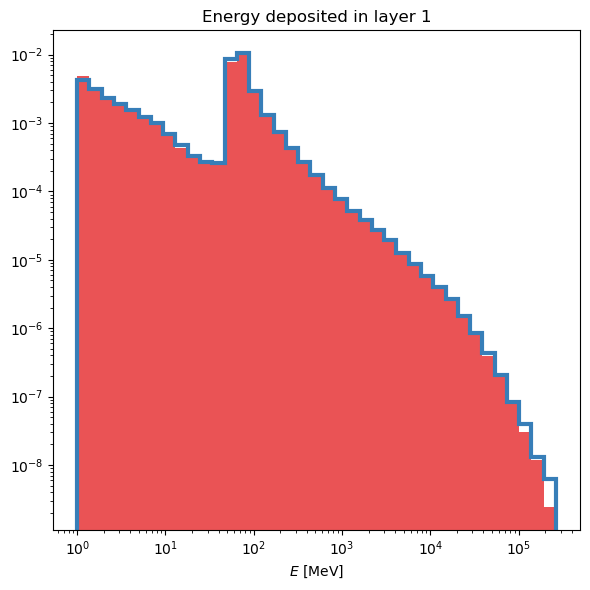

Separation power of E layer 2 histogram: 0.0005868245124431069


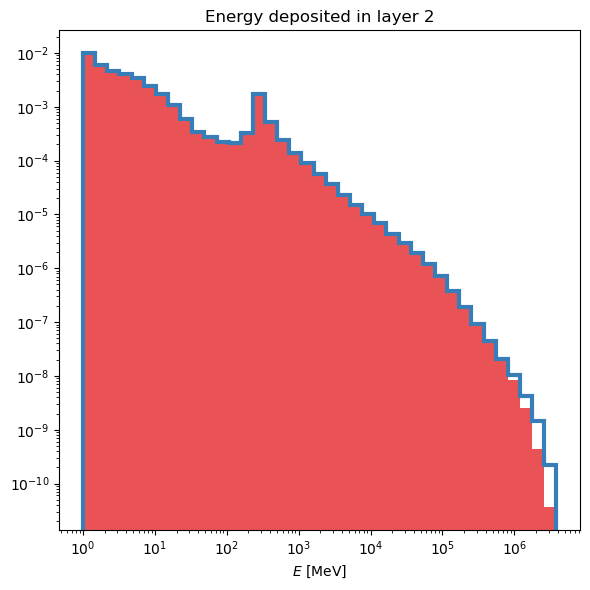

Separation power of E layer 3 histogram: 0.0007140388230878531


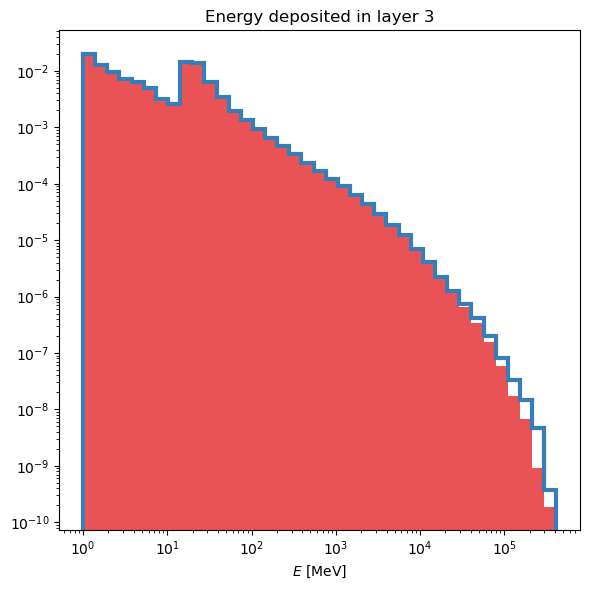

Separation power of E layer 12 histogram: 0.00098887592560773


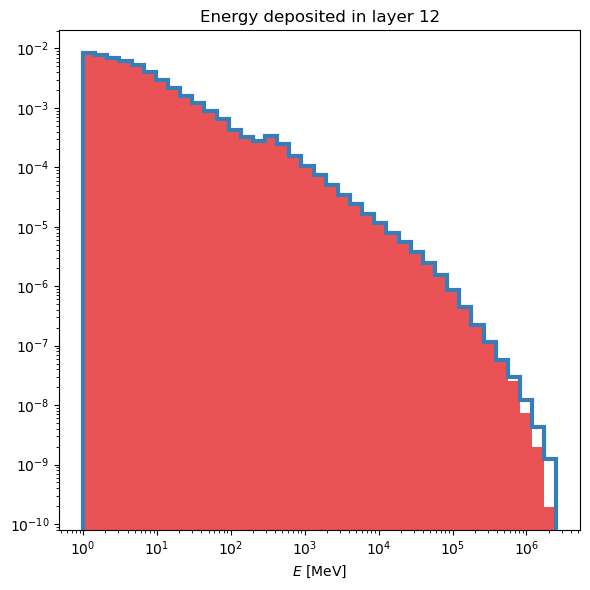

Separation power of E layer 13 histogram: 0.0015964687931576702


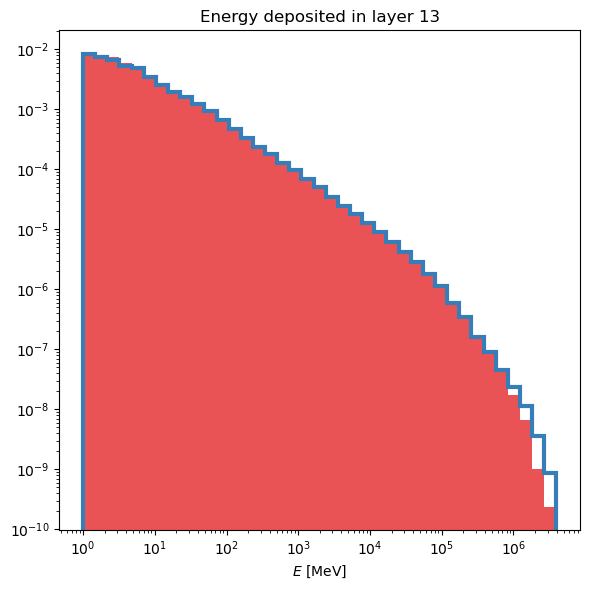

Separation power of E layer 14 histogram: 0.001779019982335045


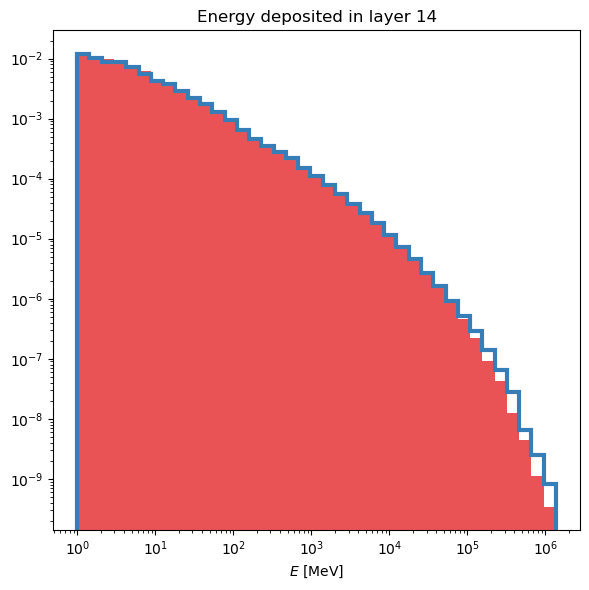

Separation power of EC Eta layer 1 histogram: 0.00044273804159166097


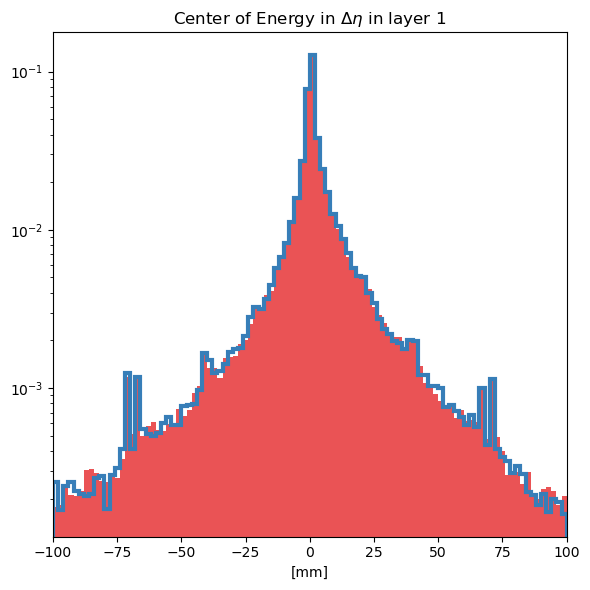

Separation power of EC Eta layer 2 histogram: 0.00048417285463810583


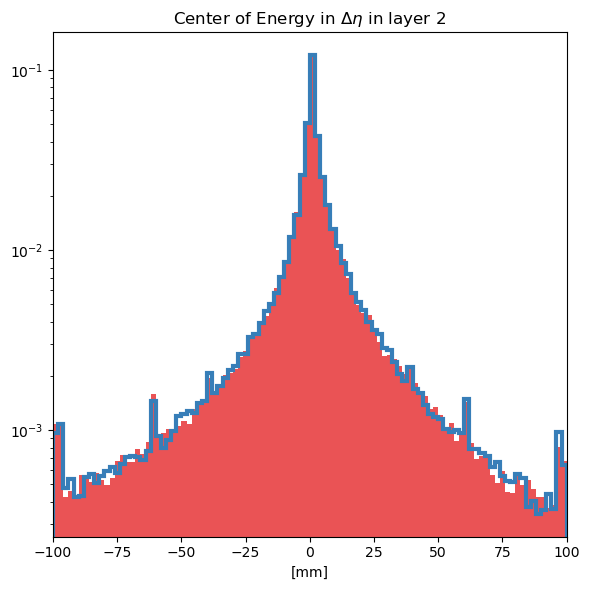

Separation power of EC Eta layer 12 histogram: 0.0004660107880043007


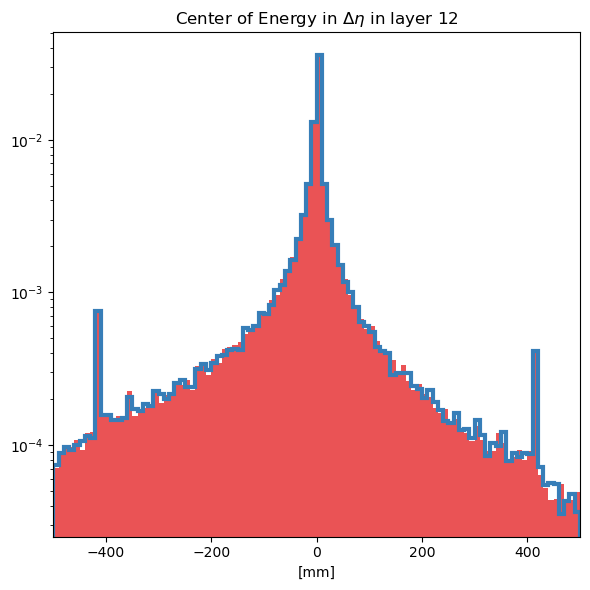

Separation power of EC Eta layer 13 histogram: 0.0004387749740813342


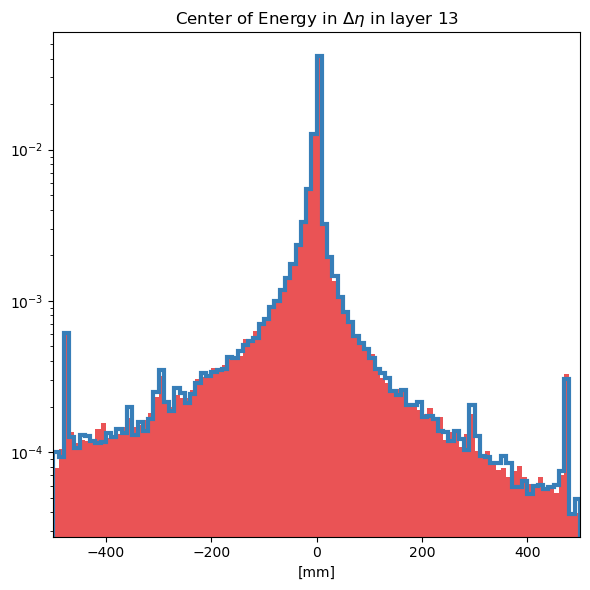

Separation power of EC Phi layer 1 histogram: 0.0003770222101069583


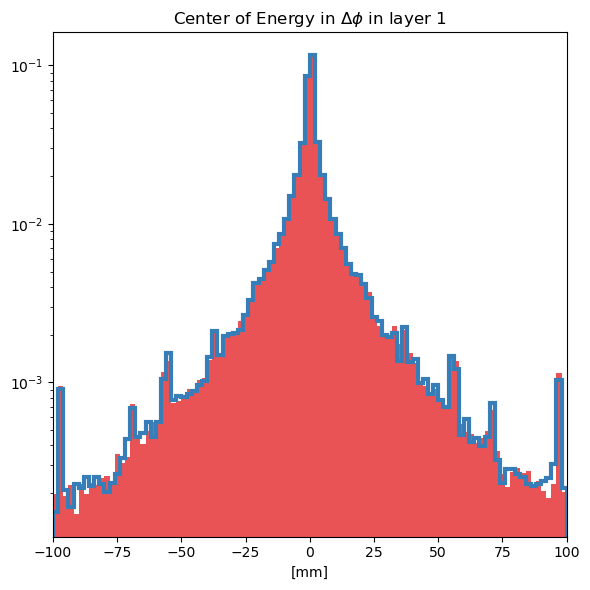

Separation power of EC Phi layer 2 histogram: 0.00043584359337785574


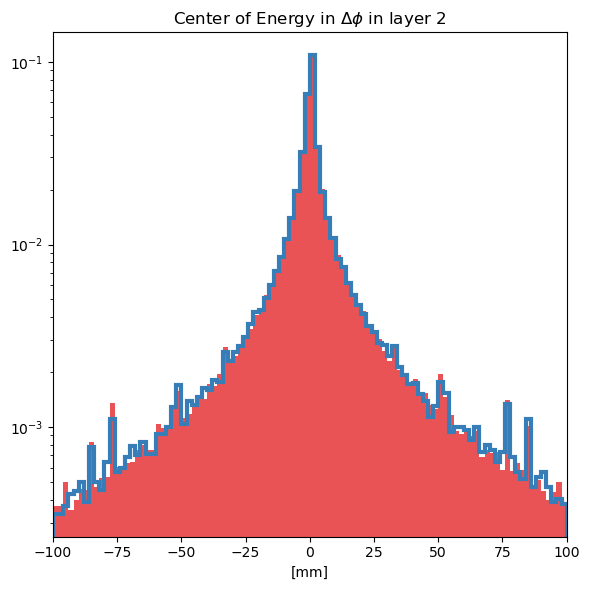

Separation power of EC Phi layer 12 histogram: 0.0004545747918004648


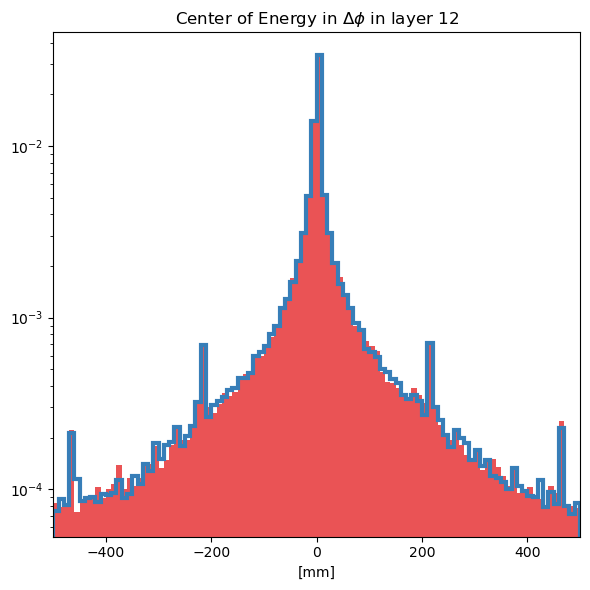

Separation power of EC Phi layer 13 histogram: 0.00047912457163323786


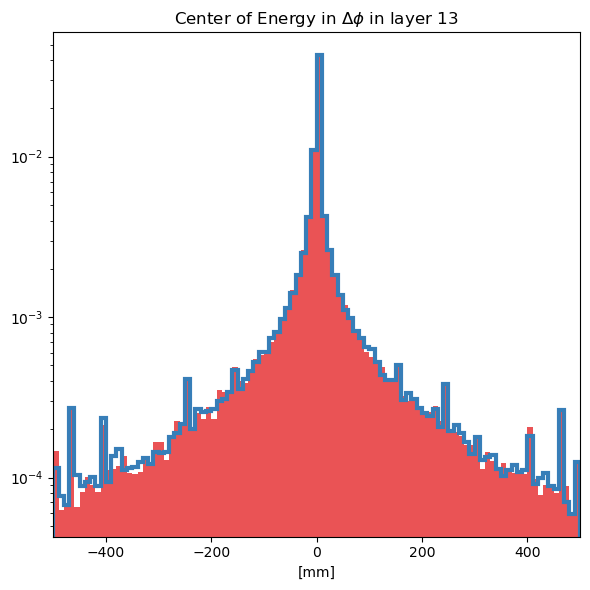

Separation power of Width Eta layer 1 histogram: 0.0004966301423660158


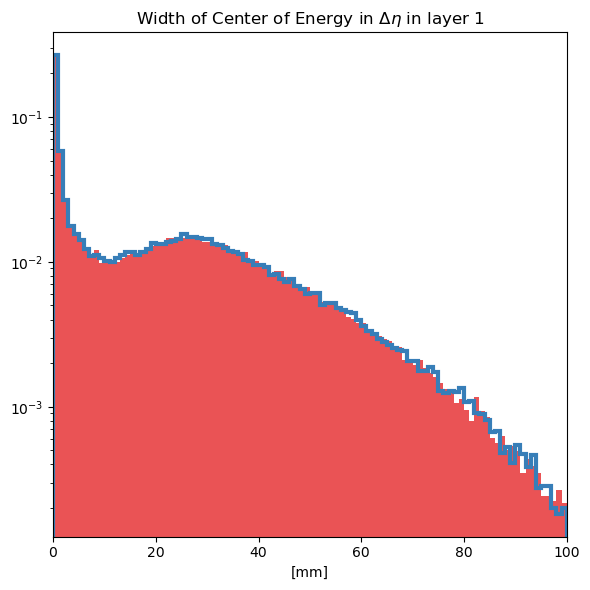

Separation power of Width Eta layer 2 histogram: 0.0003658936002300467


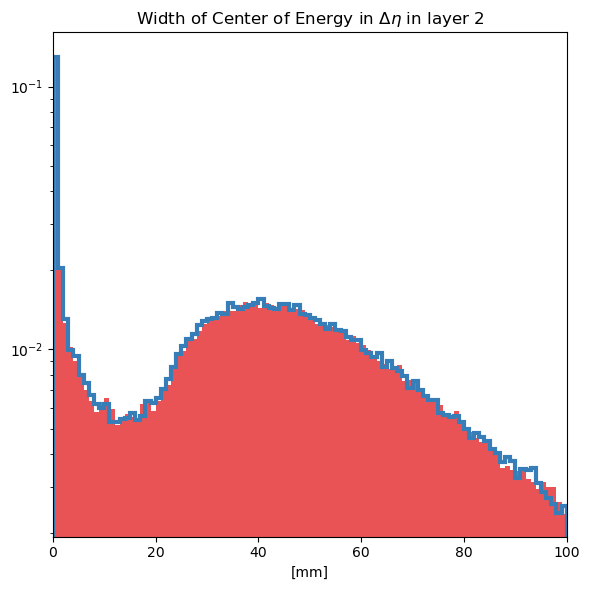

Separation power of Width Eta layer 12 histogram: 0.00037496667484745484


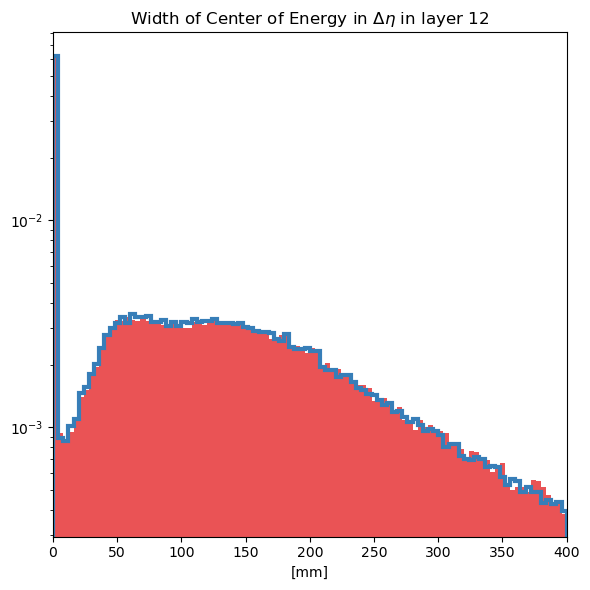

Separation power of Width Eta layer 13 histogram: 0.00044315378451587837


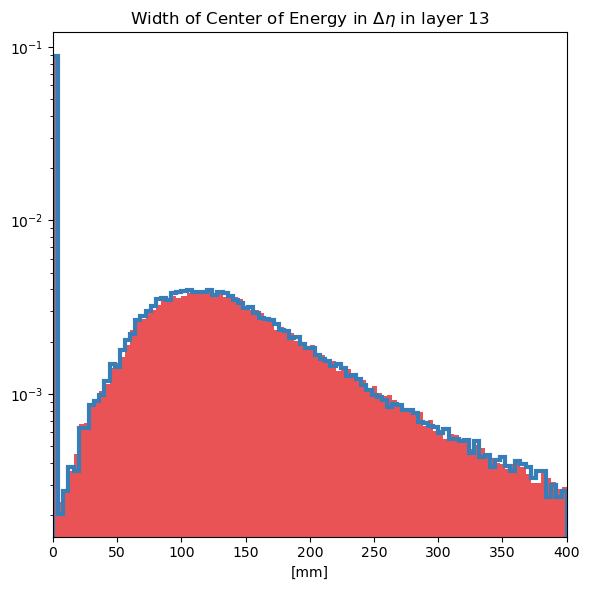

Separation power of Width Phi layer 1 histogram: 0.00039514644244928476


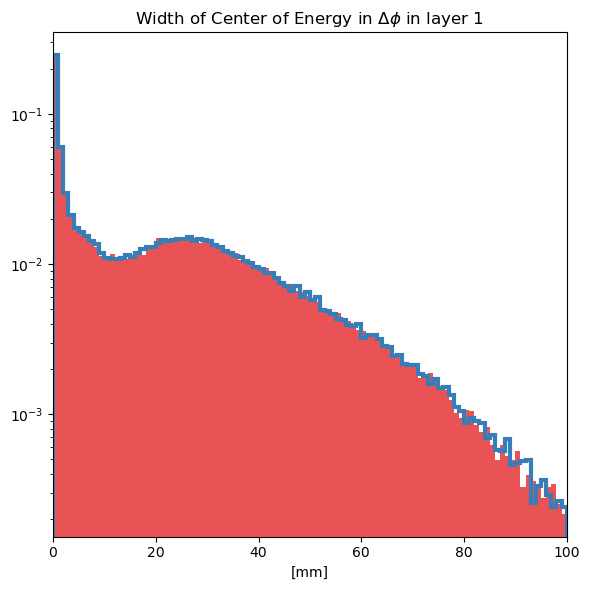

Separation power of Width Phi layer 2 histogram: 0.0003659121242233764


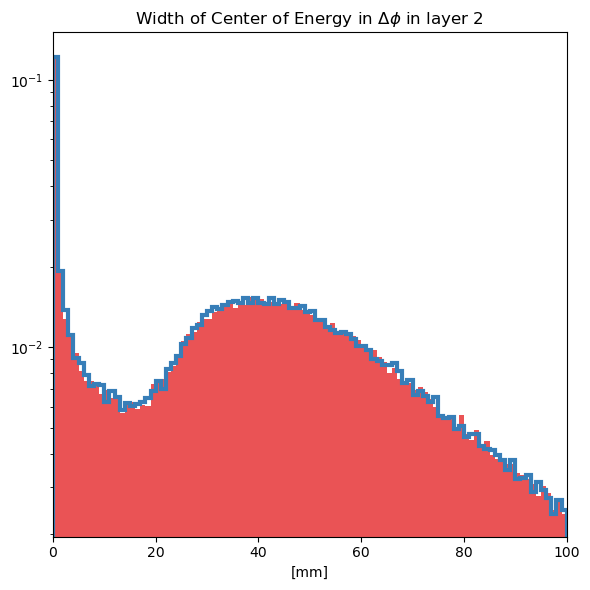

Separation power of Width Phi layer 12 histogram: 0.0004177373463018607


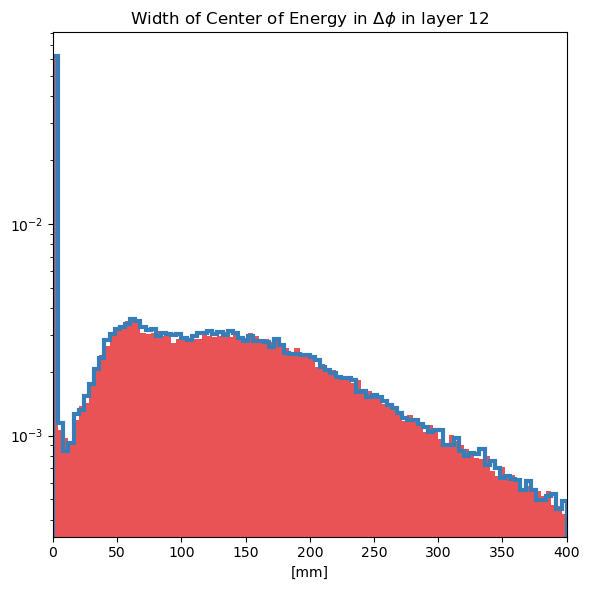

Separation power of Width Phi layer 13 histogram: 0.0004963456248944979


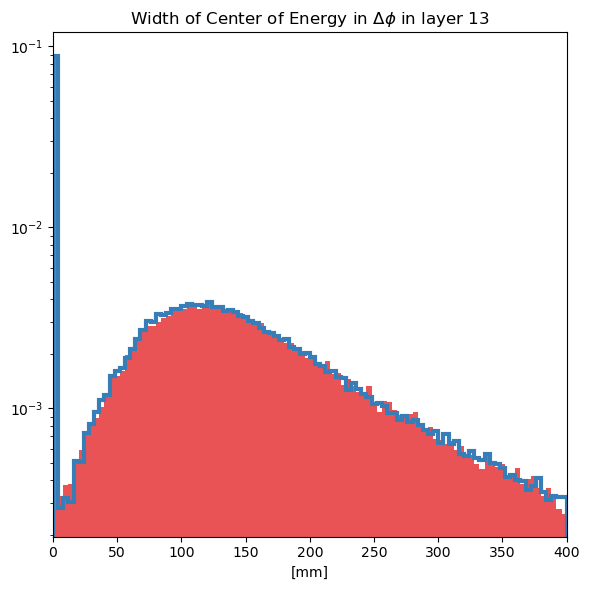

Separation power of Sparsity layer 0 histogram: 0.0003299217765208289


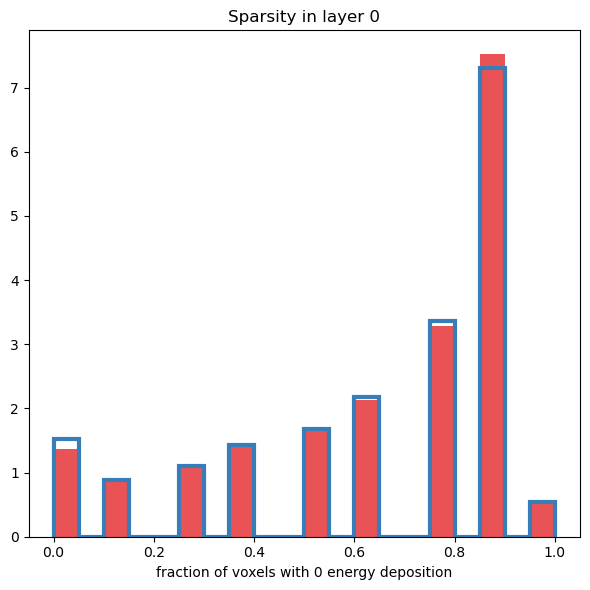

Separation power of Sparsity layer 1 histogram: 0.0002954928255048855


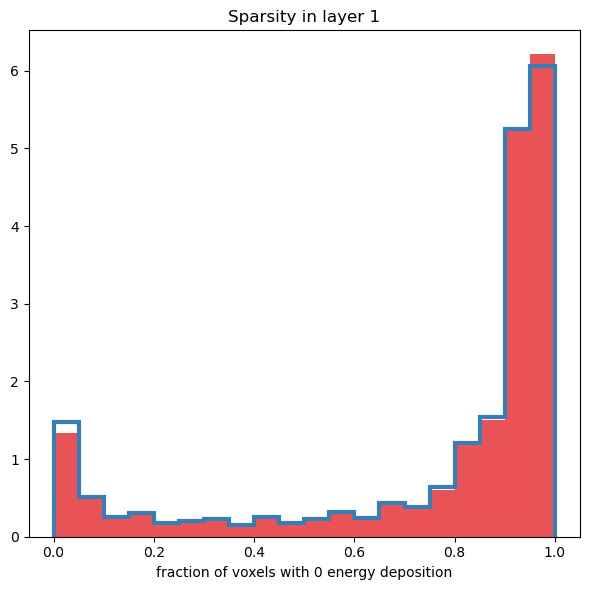

Separation power of Sparsity layer 2 histogram: 0.0019608605506315196


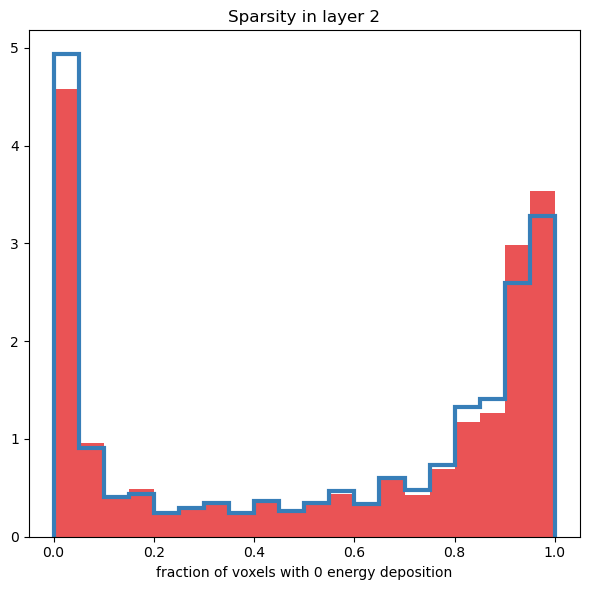

Separation power of Sparsity layer 3 histogram: 2.053025050243669e-05


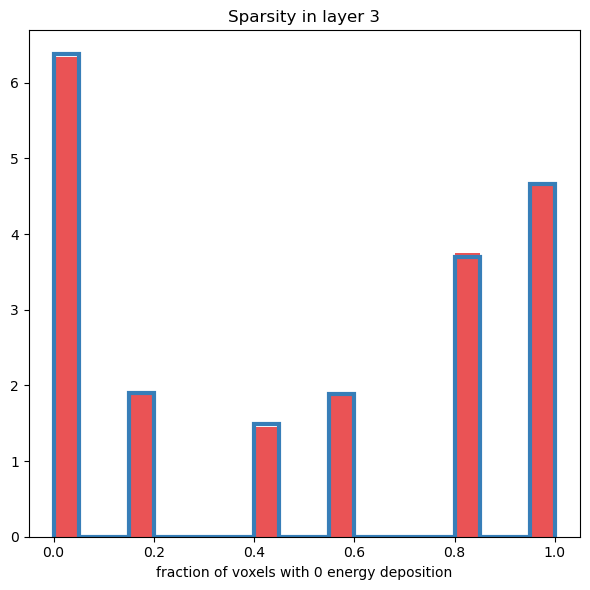

Separation power of Sparsity layer 12 histogram: 7.684428550124423e-05


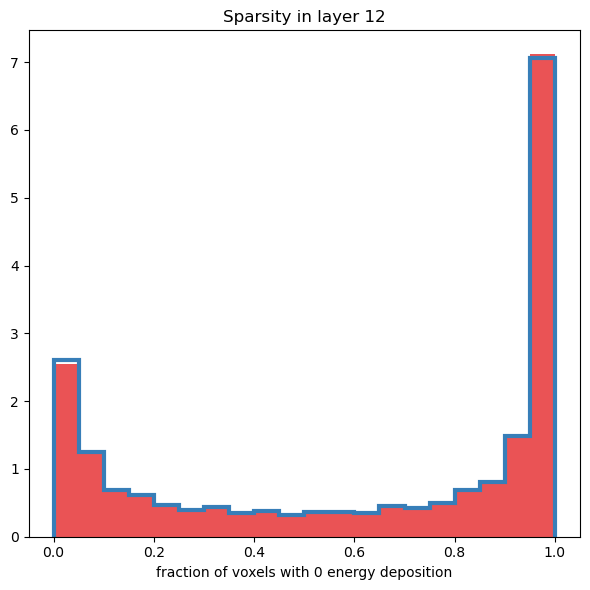

Separation power of Sparsity layer 13 histogram: 0.00014266870149009503


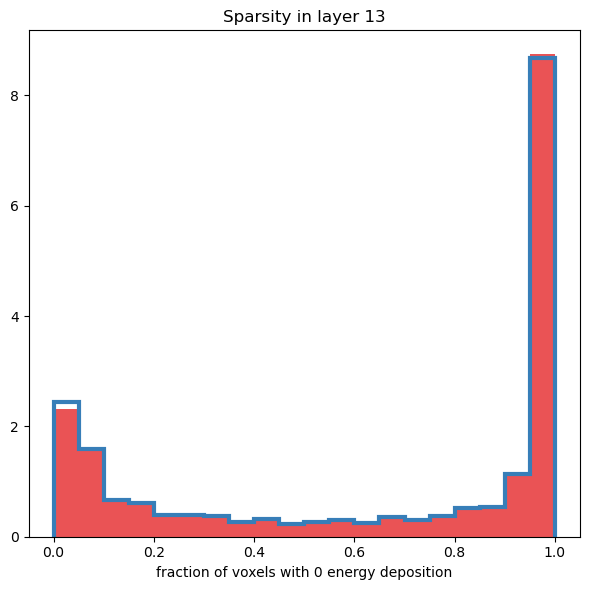

Separation power of Sparsity layer 14 histogram: 9.762718079551226e-05


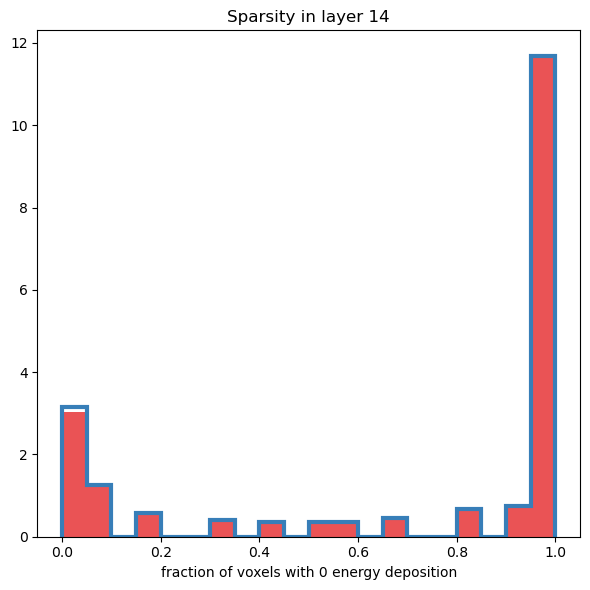

Separation power of EC r layer 0 histogram: 0.0003546479022788378


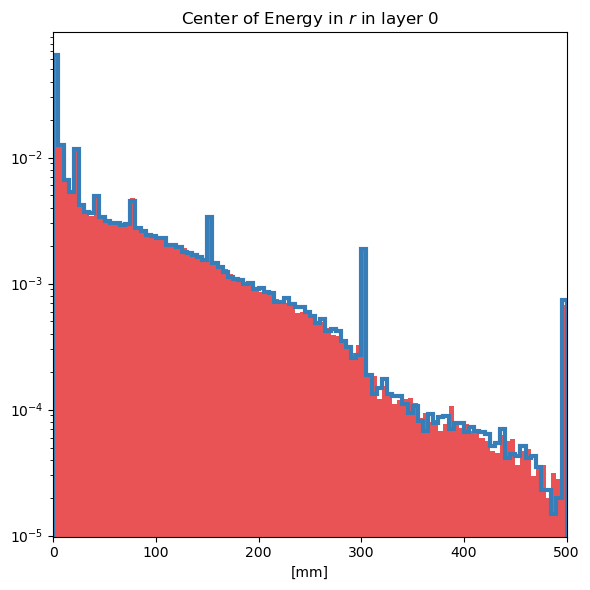

Separation power of EC r layer 1 histogram: 0.00017336758111912156


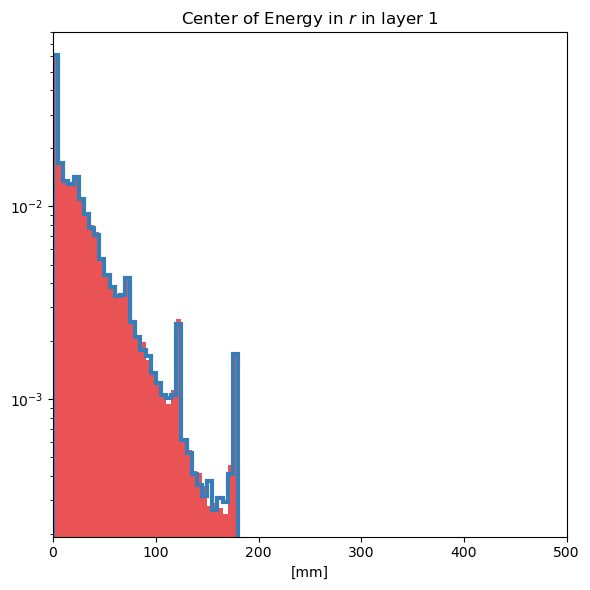

Separation power of EC r layer 2 histogram: 0.00026199523827330576


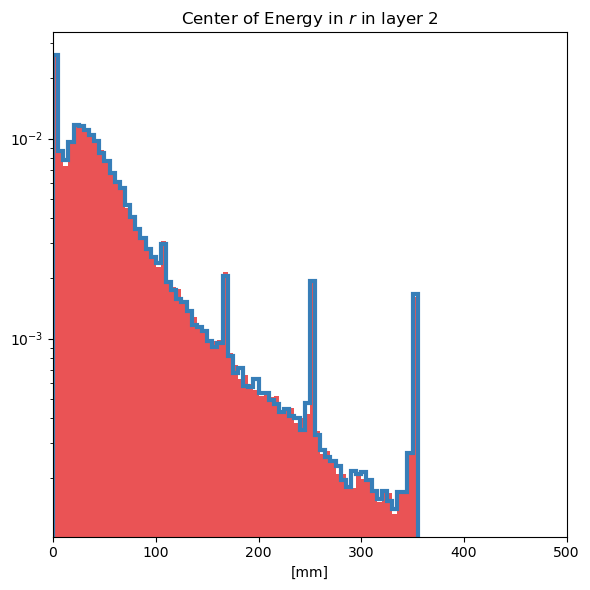

Separation power of EC r layer 3 histogram: 0.000449783995549959


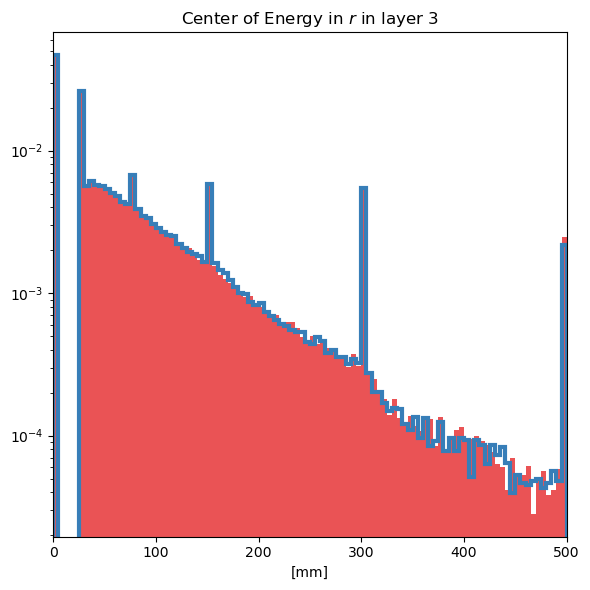

Separation power of EC r layer 12 histogram: 0.0004950745369284175


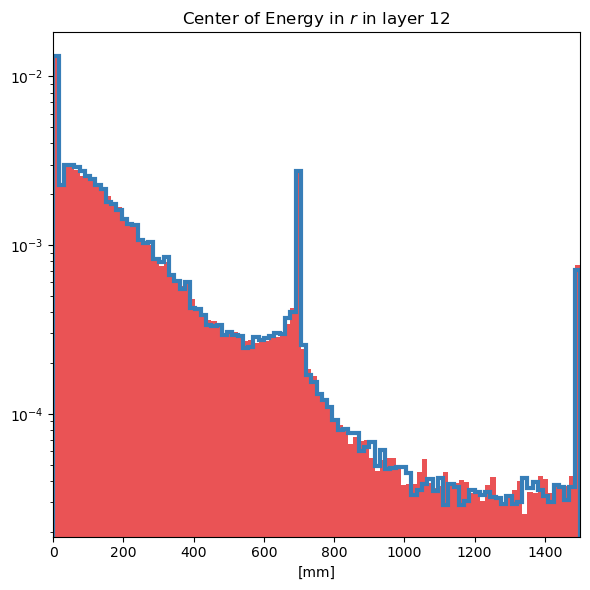

Separation power of EC r layer 13 histogram: 0.0004123923341201464


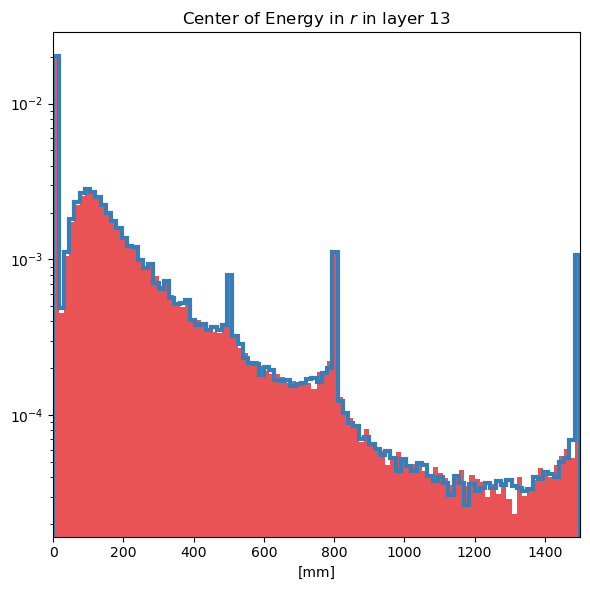

Separation power of EC r layer 14 histogram: 0.0005199215635235902


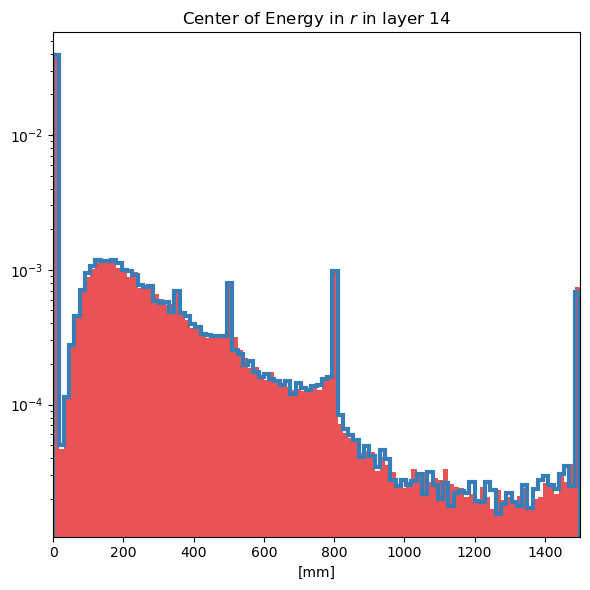

Separation power of Width r layer 0 histogram: 0.00039040645513217255


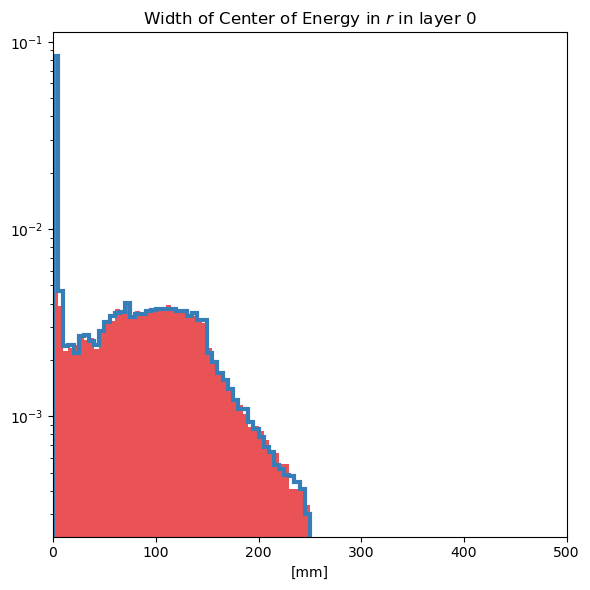

Separation power of Width r layer 1 histogram: 7.05532212489733e-05


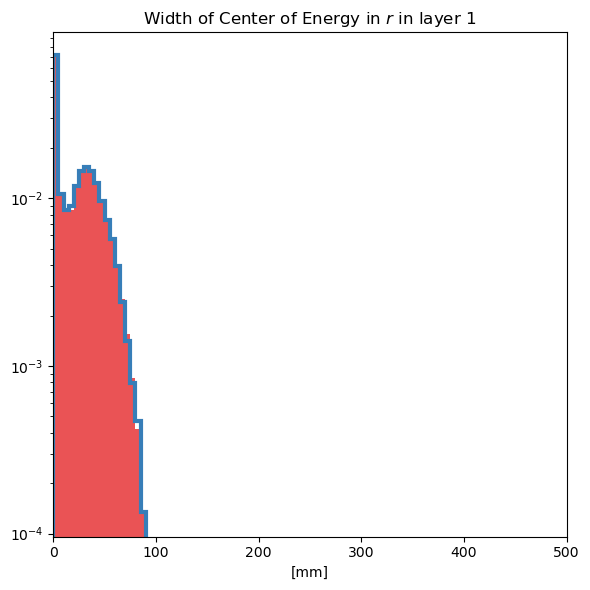

Separation power of Width r layer 2 histogram: 0.00013233011753855466


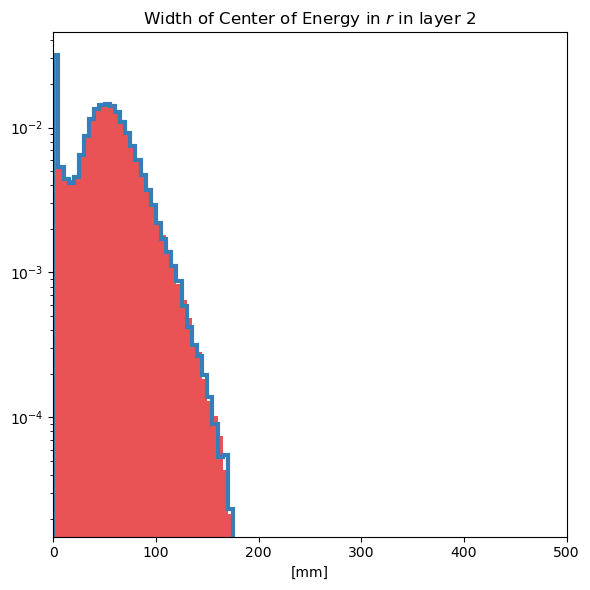

Separation power of Width r layer 3 histogram: 0.00019954206290794676


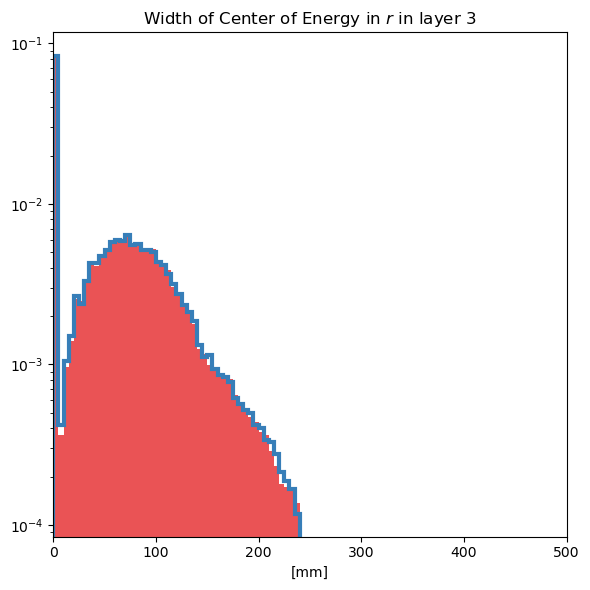

Separation power of Width r layer 12 histogram: 0.000300423251818013


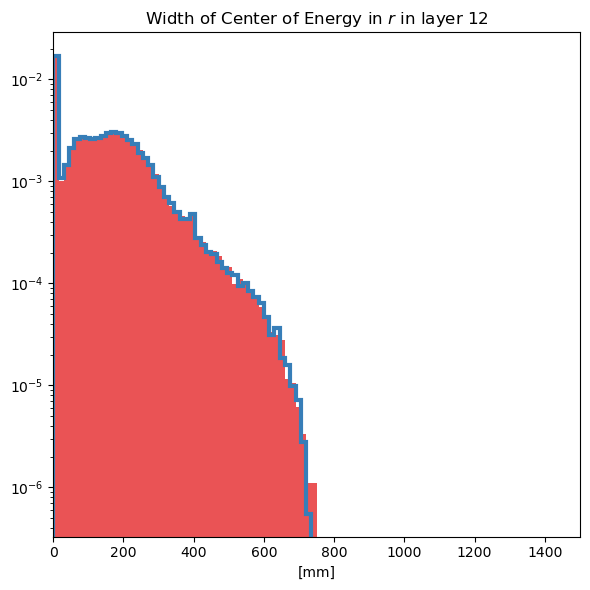

Separation power of Width r layer 13 histogram: 0.00024524490080429285


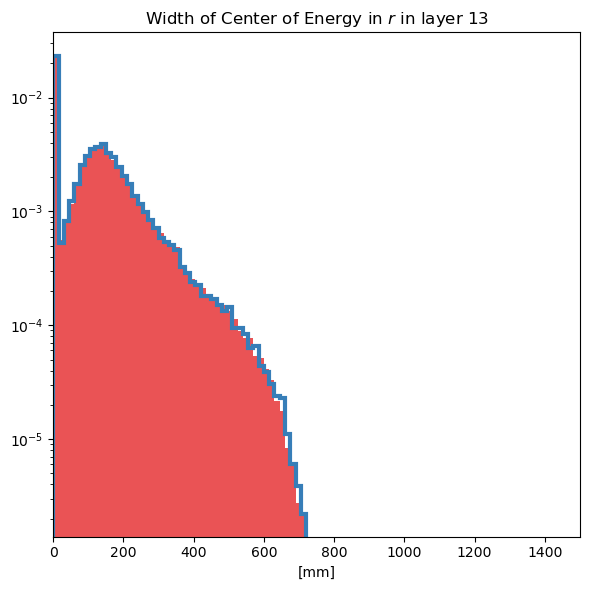

Separation power of Width r layer 14 histogram: 0.00022677931751620937


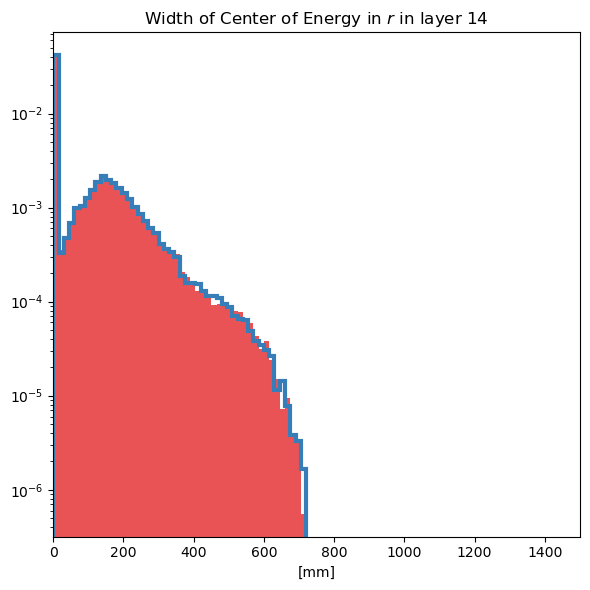

Separation power of voxel distribution histogram: 0.00044934570288450275


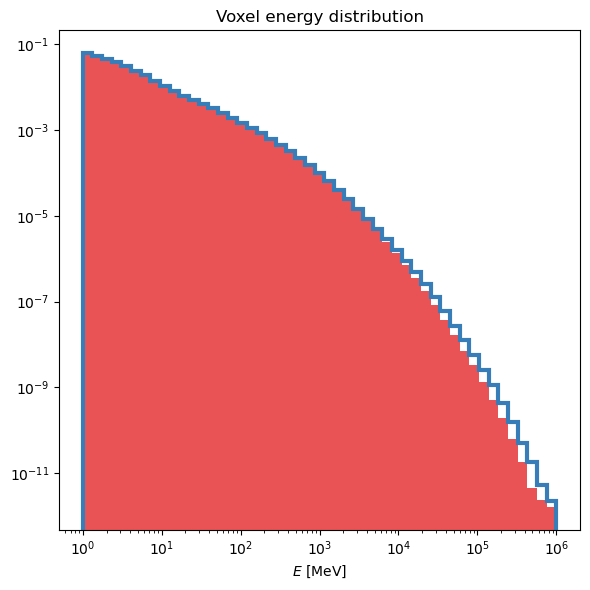

Separation power of Etot / Einc histogram: 0.000445191026593646


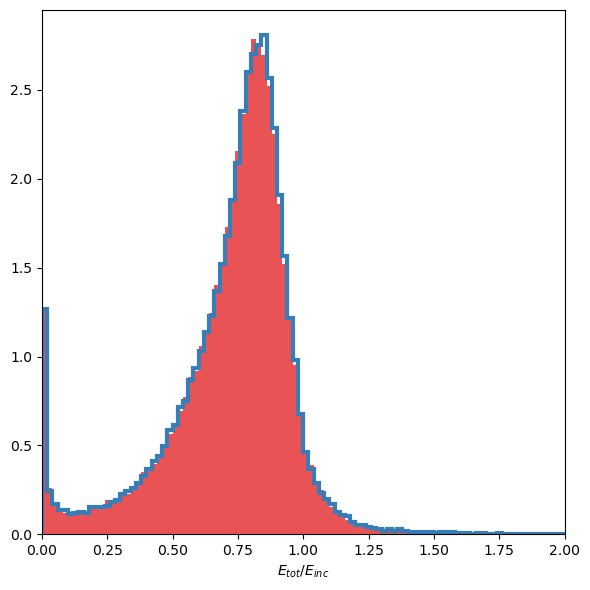

done


In [39]:
ds1_pions_reference_dict['E_layer_dict'] = get_sep_E_layers(HLF_pions_ref[1], HLF_pions_ref[0], ref=True)
ds1_pions_reference_dict['EC_eta_dict'] = get_sep_ECEtas(HLF_pions_ref[1], HLF_pions_ref[0], '1', ref=True)
ds1_pions_reference_dict['EC_phi_dict'] = get_sep_ECPhis(HLF_pions_ref[1], HLF_pions_ref[0], '1', ref=True)
ds1_pions_reference_dict['EC_eta_width_dict'] = get_sep_ECWidthEtas(HLF_pions_ref[1], HLF_pions_ref[0], '1', ref=True)
ds1_pions_reference_dict['EC_phi_width_dict'] = get_sep_ECWidthPhis(HLF_pions_ref[1], HLF_pions_ref[0], '1', ref=True)
ds1_pions_reference_dict['Sparsity_layer_dict'] = get_sep_Sparsity_layers(HLF_pions_ref[1], HLF_pions_ref[0], ref=True)
ds1_pions_reference_dict['EC_r_dict'] = get_sep_ECR(HLF_pions_ref[1], HLF_pions_ref[0], '1', ref=True)
ds1_pions_reference_dict['EC_r_width_dict'] = get_sep_ECWidthR(HLF_pions_ref[1], HLF_pions_ref[0], '1', ref=True)
ds1_pions_reference_dict['cell_dist'] = get_sep_cell_dist(HLF_pions_ref[1], HLF_pions_ref[0], ref=True)
ds1_pions_reference_dict['Etot_Einc_dist'] = get_sep_Etot_Einc(HLF_pions_ref[1], HLF_pions_ref[0], ref=True)

with open(f"ds1-pions_reference_{MIN_ENERGY}.pkl", 'wb') as handle:
    pickle.dump(ds1_pions_reference_dict, handle)

print(f"done")

#### ds1 pions 10 bootstraps for errorbars

In [42]:
# compute HLF
MIN_ENERGY = 1
HLF_pions_ref = []

ds1_pions_reference_dict = {'MIN_ENERGY': MIN_ENERGY}
file_name = {0: 'NEW_dataset_1_pions_1', 1: 'NEW_dataset_1_pions_2'}

for i in range(2):
    print(f"working on file {i+1}.")
    HLF_pions_ref.append(HLF.HighLevelFeatures('pion', 'CaloChallenge_homepage/code/binning_dataset_1_pions.xml'))
    E_inc, showers = extract_info(f'../scratch_CaloChallenge/data/official/{file_name[i]}.hdf5')
    showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
    HLF_pions_ref[-1].Einc = E_inc
    HLF_pions_ref[-1].showers = showers
    HLF_pions_ref[-1].CalculateFeatures(showers)

print(f"done reading files")


working on file 1.
120800
working on file 2.
120800
done reading files


In [43]:
big_Einc = np.concatenate([HLF_pions_ref[0].Einc, HLF_pions_ref[1].Einc])
big_showers = np.concatenate([HLF_pions_ref[0].showers, HLF_pions_ref[1].showers])
print(big_Einc.shape)
print(big_showers.shape)

for i in range(9):
    print(f"working on file {i+1} of 9")
    current_Einc_1 = np.array([])
    current_Einc_2 = np.array([])
    for n in range(8,23):
        len_Einc = len(big_Einc[big_Einc==2**n])
        new_idx = np.random.choice(np.arange(len_Einc), size=len_Einc, replace=False)
        current_Einc_1 = np.concatenate([current_Einc_1, big_Einc[big_Einc==2**n][new_idx[:len(new_idx)//2]]])
        current_Einc_2 = np.concatenate([current_Einc_2, big_Einc[big_Einc==2**n][new_idx[len(new_idx)//2:]]])
        if n == 8:
            current_showers_1 = big_showers[(big_Einc==2**n).reshape(-1)][new_idx[:len(new_idx)//2]]
            current_showers_2 = big_showers[(big_Einc==2**n).reshape(-1)][new_idx[len(new_idx)//2:]]
        else:
            current_showers_1 = np.concatenate([current_showers_1, big_showers[(big_Einc==2**n).reshape(-1)][new_idx[:len(new_idx)//2]]])
            current_showers_2 = np.concatenate([current_showers_2, big_showers[(big_Einc==2**n).reshape(-1)][new_idx[len(new_idx)//2:]]])

    current_Einc_1 = current_Einc_1.reshape(-1, 1)
    current_Einc_2 = current_Einc_2.reshape(-1, 1)
    #print(current_Einc_1.shape)
    #print(np.unique(current_Einc_1, return_counts=True))
    #print(current_Einc_2.shape)
    #print(np.unique(current_Einc_2, return_counts=True))
    #print(current_showers_1.shape)
    #print(current_showers_2.shape)
    HLF_pions_ref.append(HLF.HighLevelFeatures('pion', 'CaloChallenge_homepage/code/binning_dataset_1_pions.xml'))
    HLF_pions_ref[-1].Einc = current_Einc_1
    HLF_pions_ref[-1].showers = current_showers_1
    HLF_pions_ref[-1].CalculateFeatures(current_showers_1)
    print("done with first half")
    HLF_pions_ref.append(HLF.HighLevelFeatures('pion', 'CaloChallenge_homepage/code/binning_dataset_1_pions.xml'))
    HLF_pions_ref[-1].Einc = current_Einc_2
    HLF_pions_ref[-1].showers = current_showers_2
    HLF_pions_ref[-1].CalculateFeatures(current_showers_2)
    print("done with second half")

print("done")

(241600, 1)
(241600, 533)
working on file 1 of 9
done with first half
done with second half
working on file 2 of 9
done with first half
done with second half
working on file 3 of 9
done with first half
done with second half
working on file 4 of 9
done with first half
done with second half
working on file 5 of 9
done with first half
done with second half
working on file 6 of 9
done with first half
done with second half
working on file 7 of 9
done with first half
done with second half
working on file 8 of 9
done with first half
done with second half
working on file 9 of 9
done with first half
done with second half
done


Separation power of E layer 3 histogram: 0.00020405060811971423


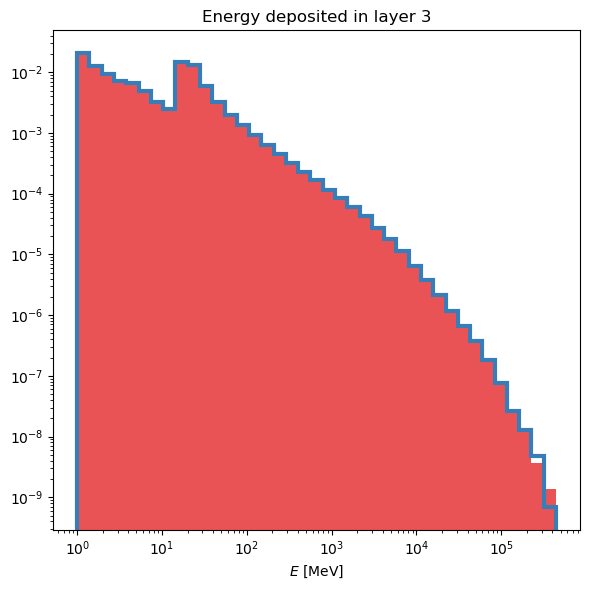

Separation power of E layer 12 histogram: 0.00013021413003440335


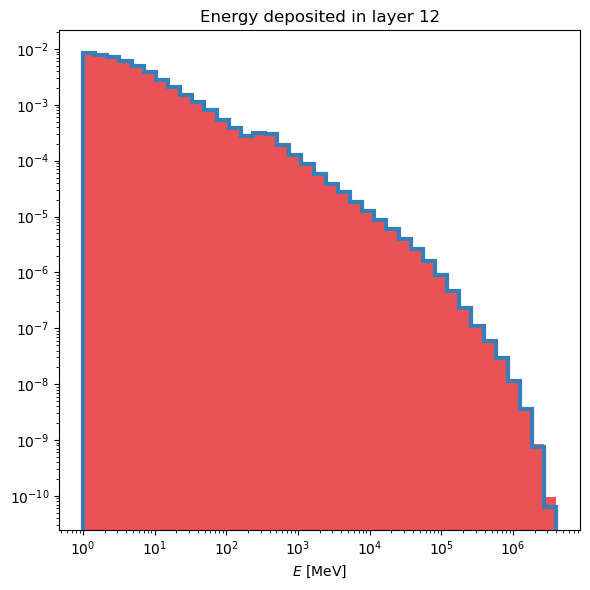

Separation power of E layer 13 histogram: 0.00019552109674694782


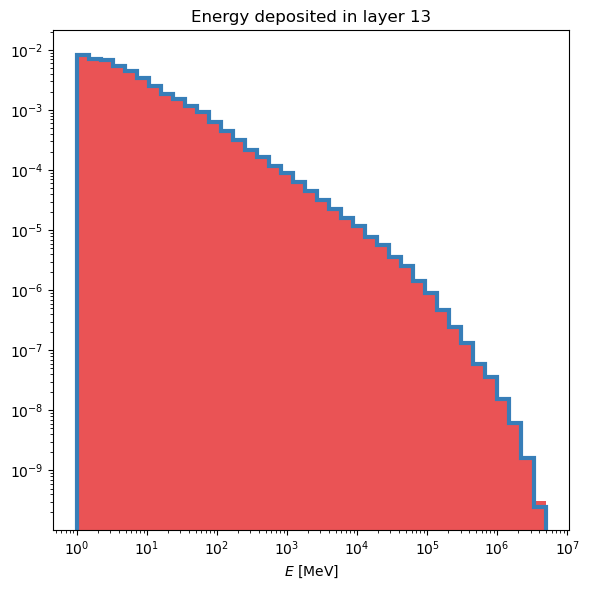

Separation power of E layer 14 histogram: 0.0005170755489114971


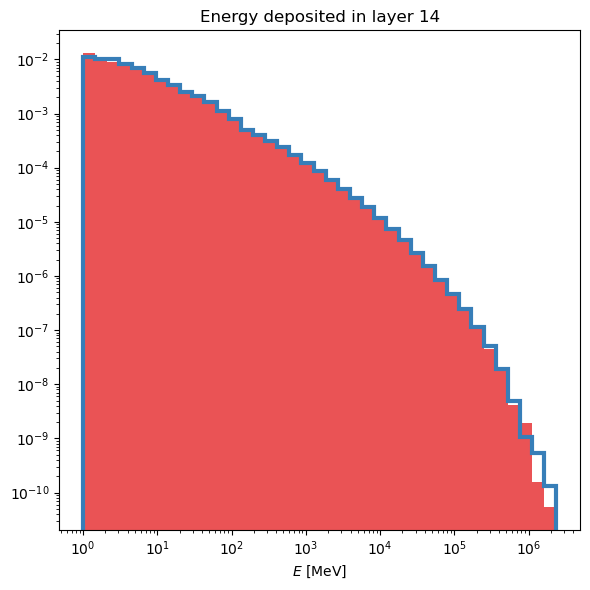

Separation power of EC Eta layer 1 histogram: 0.0004147249871560134


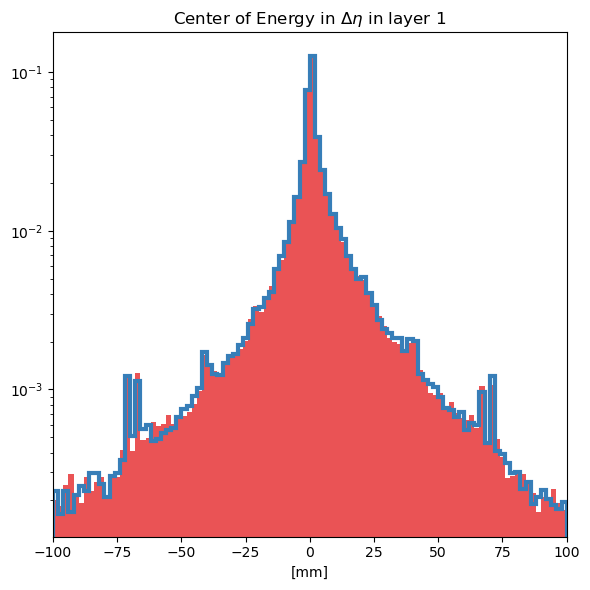

Separation power of EC Eta layer 2 histogram: 0.0004176771693576424


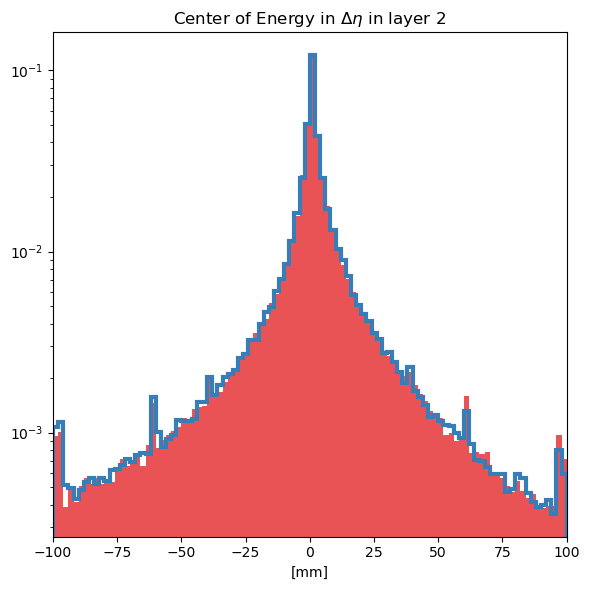

Separation power of EC Eta layer 12 histogram: 0.000453847131213062


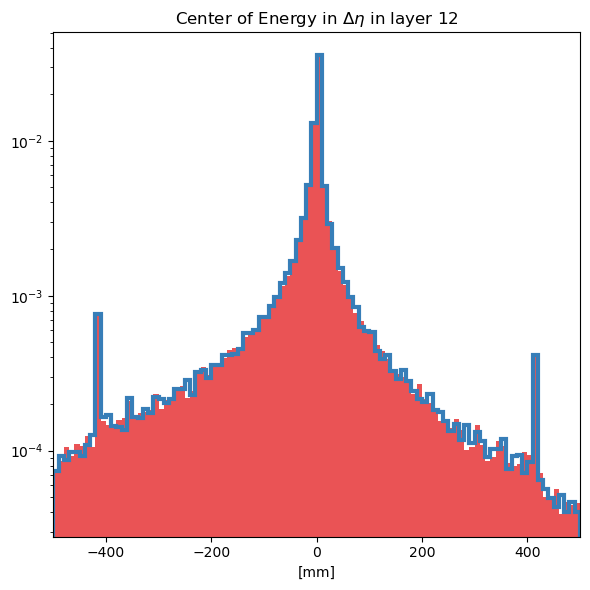

Separation power of EC Eta layer 13 histogram: 0.00046262557643122126


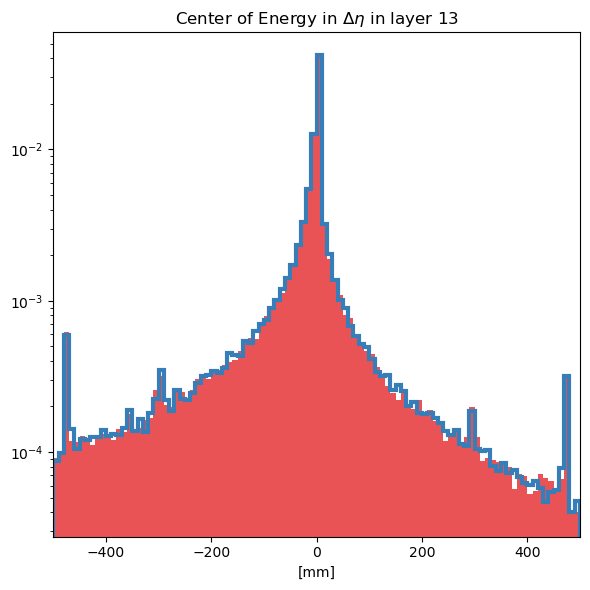

Separation power of EC Phi layer 1 histogram: 0.0004282810966547343


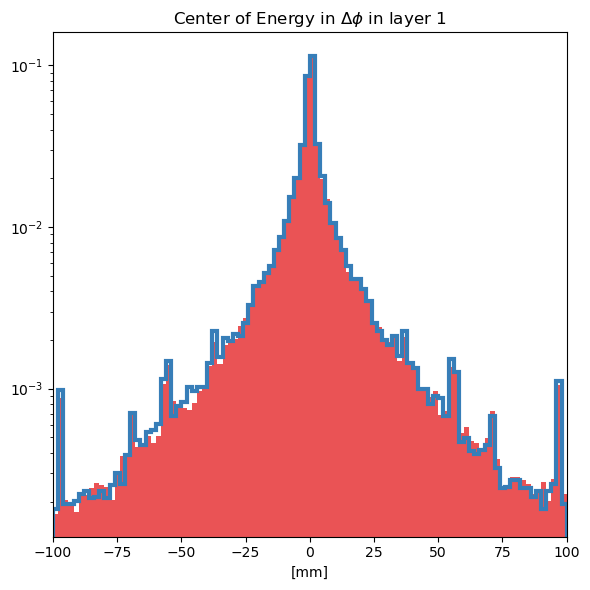

Separation power of EC Phi layer 2 histogram: 0.00044700621429770004


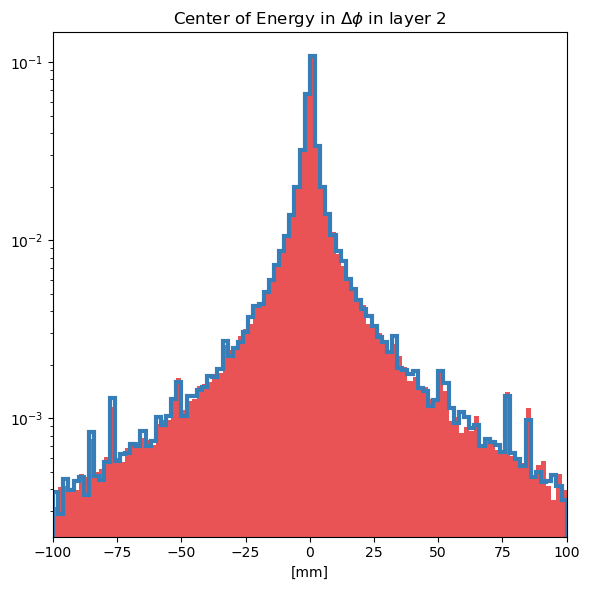

Separation power of EC Phi layer 12 histogram: 0.00040402034505246777


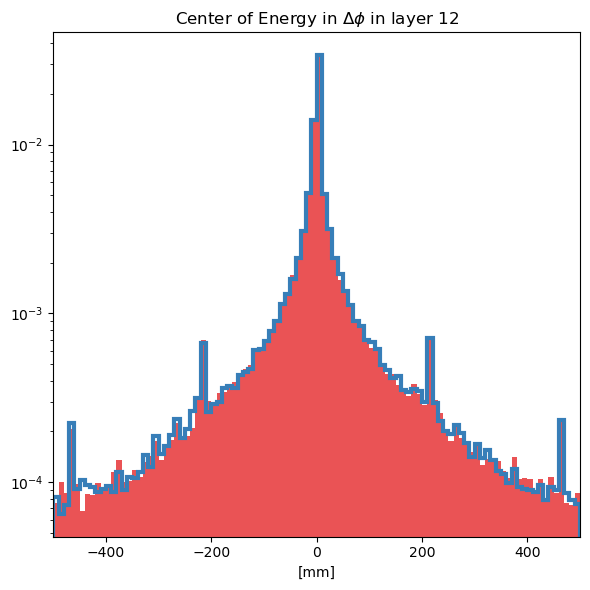

Separation power of EC Phi layer 13 histogram: 0.00046388409931604017


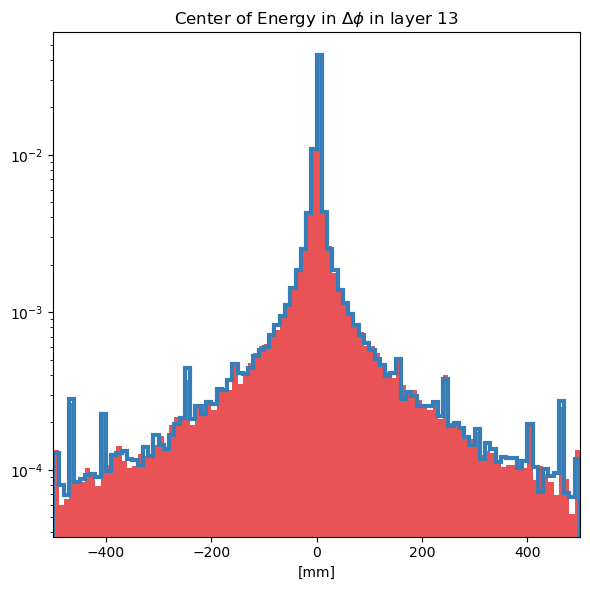

Separation power of Width Eta layer 1 histogram: 0.0004054698265921834


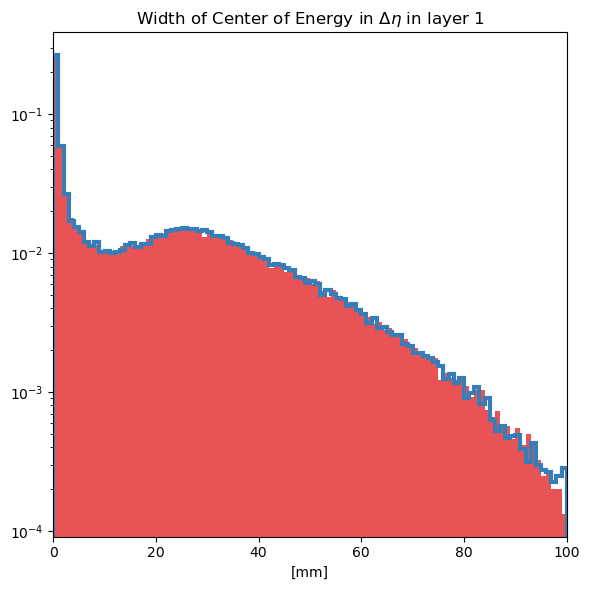

Separation power of Width Eta layer 2 histogram: 0.00042822144065417017


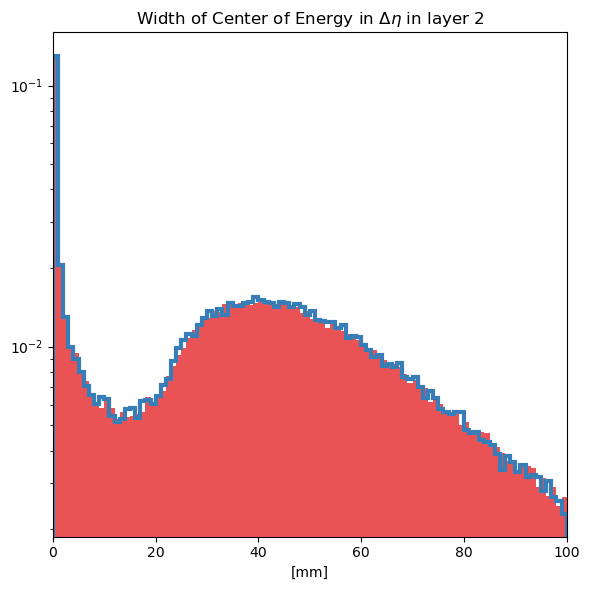

Separation power of Width Eta layer 12 histogram: 0.0003682516510257895


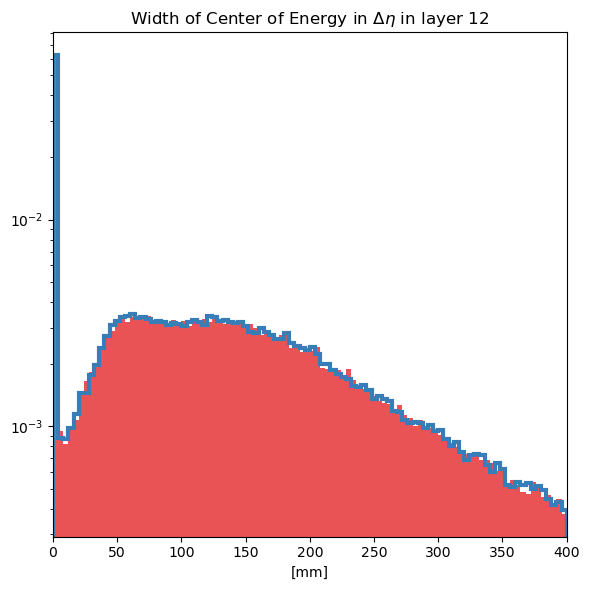

Separation power of Width Eta layer 13 histogram: 0.0004986850485775206


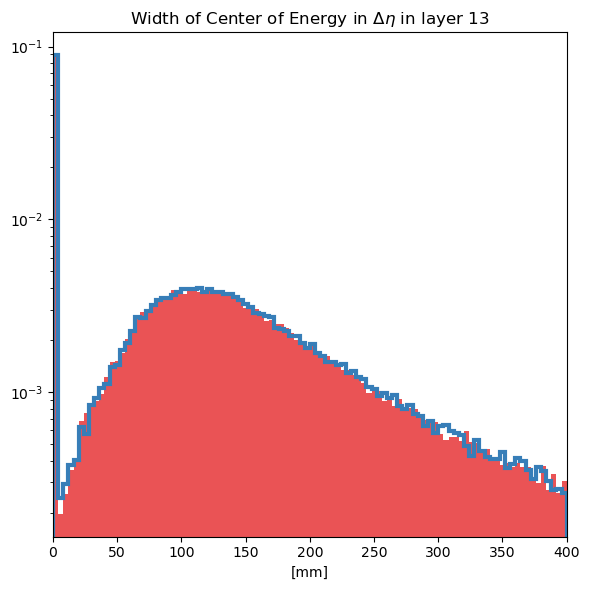

Separation power of Width Phi layer 1 histogram: 0.0005086036751278239


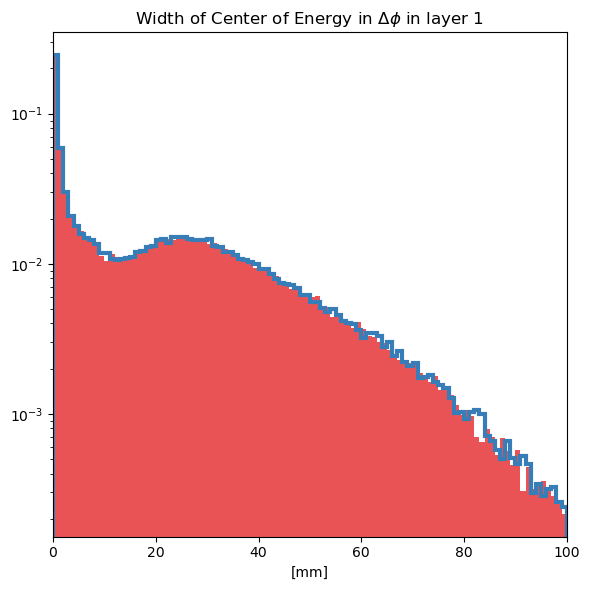

Separation power of Width Phi layer 2 histogram: 0.000357176480999077


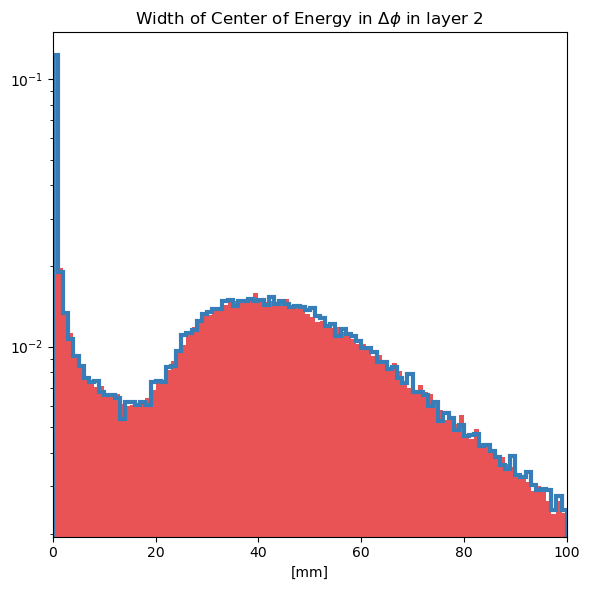

Separation power of Width Phi layer 12 histogram: 0.00045941723116368324


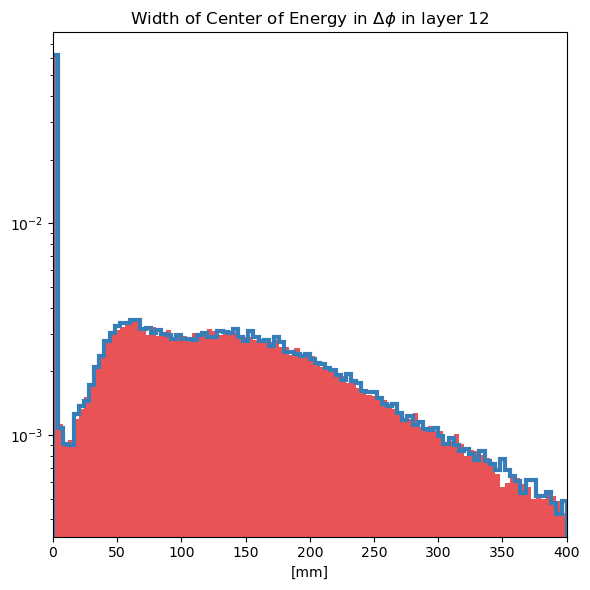

Separation power of Width Phi layer 13 histogram: 0.00037681844570661876


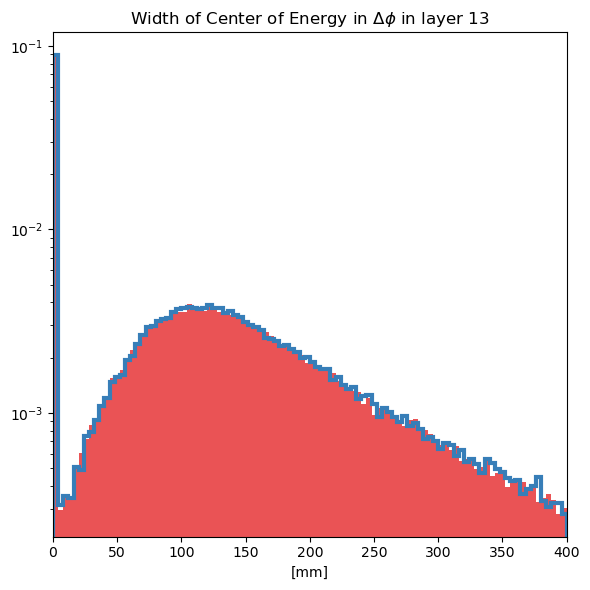

Separation power of Sparsity layer 0 histogram: 1.552331806600938e-05


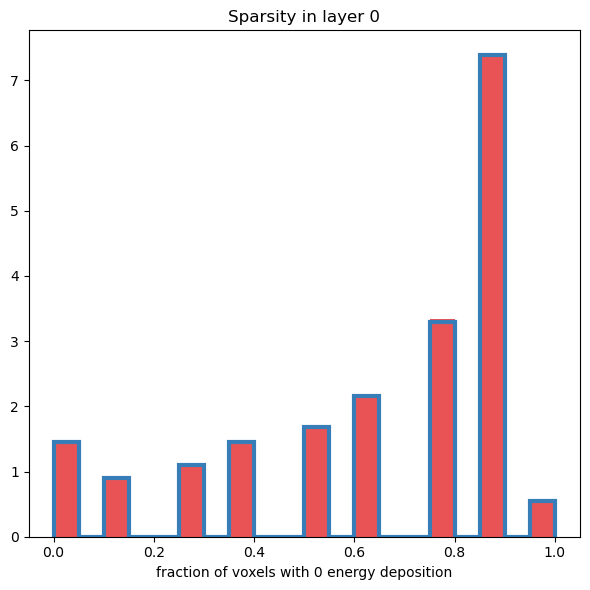

Separation power of Sparsity layer 1 histogram: 7.510588188294935e-05


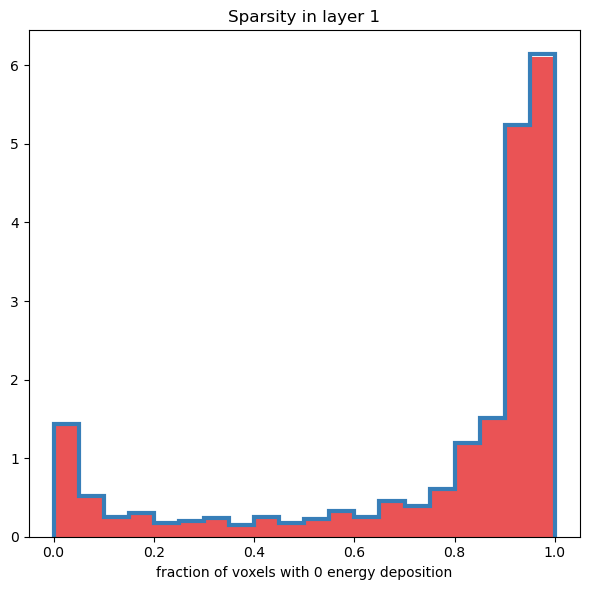

Separation power of Sparsity layer 2 histogram: 9.694996592737656e-05


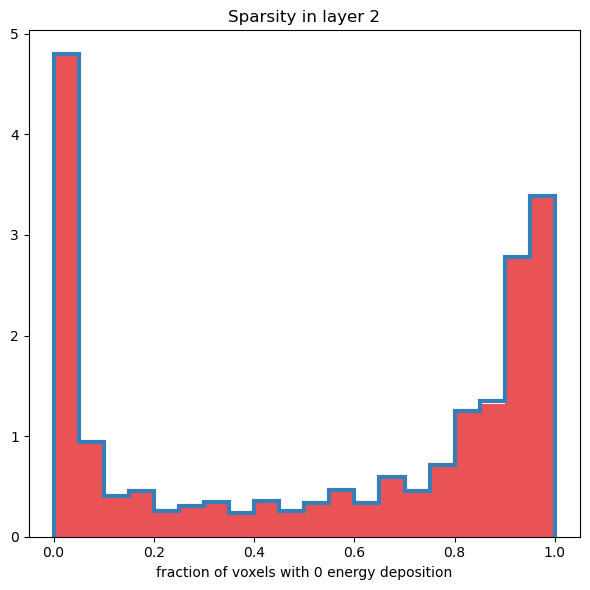

Separation power of Sparsity layer 3 histogram: 6.310425014205493e-06


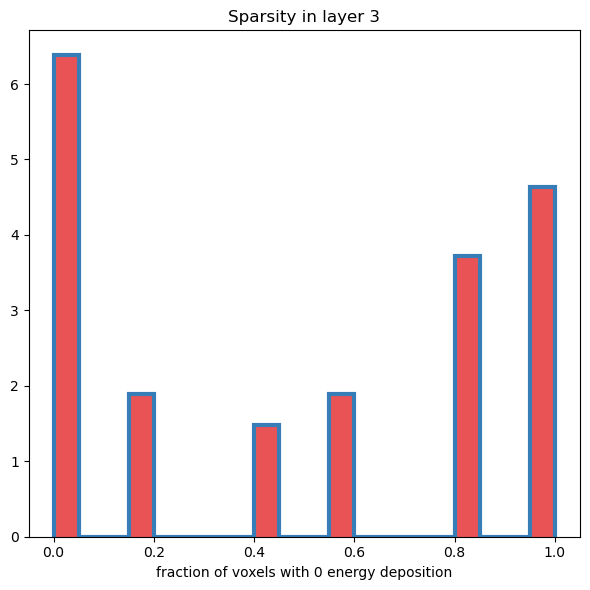

Separation power of Sparsity layer 12 histogram: 7.524570108099063e-05


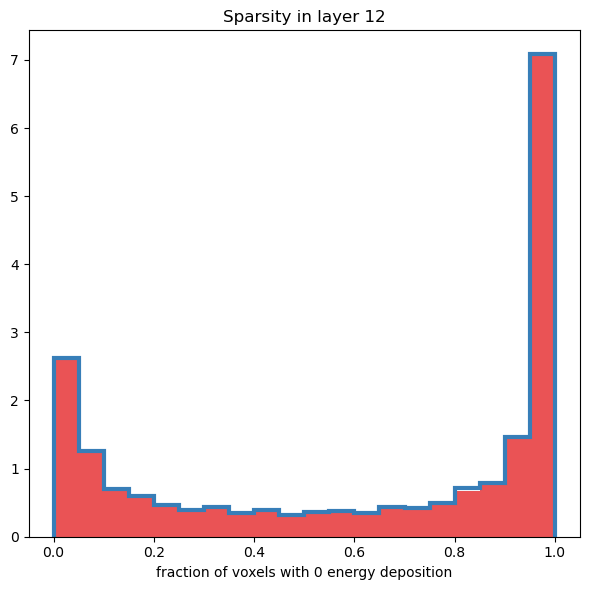

Separation power of Sparsity layer 13 histogram: 5.4088822512492694e-05


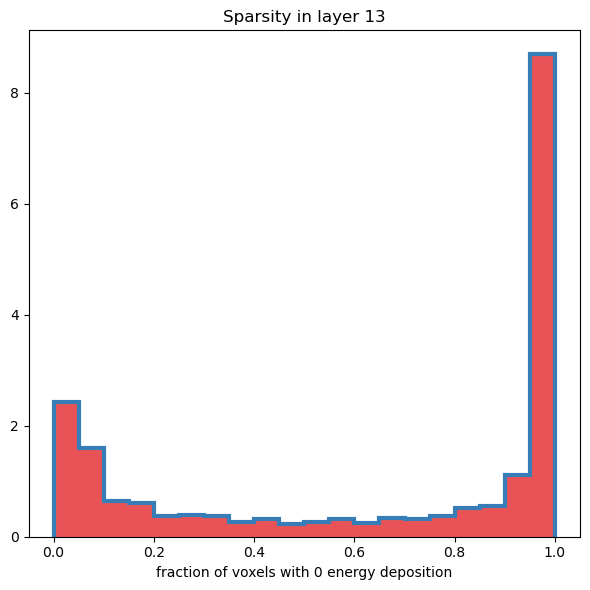

Separation power of Sparsity layer 14 histogram: 2.42273749532467e-05


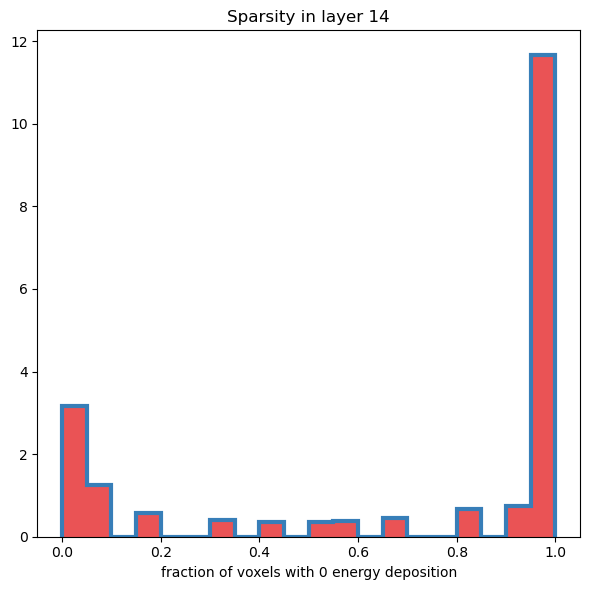

Separation power of EC r layer 0 histogram: 0.00046696435519609335


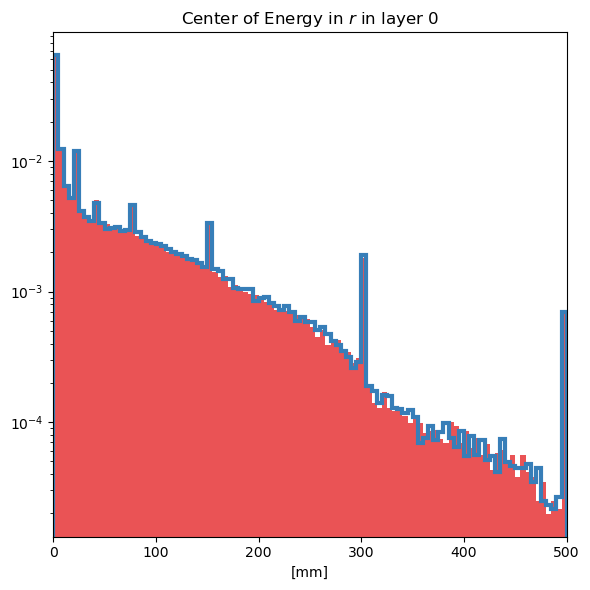

Separation power of EC r layer 1 histogram: 0.00010934360772600201


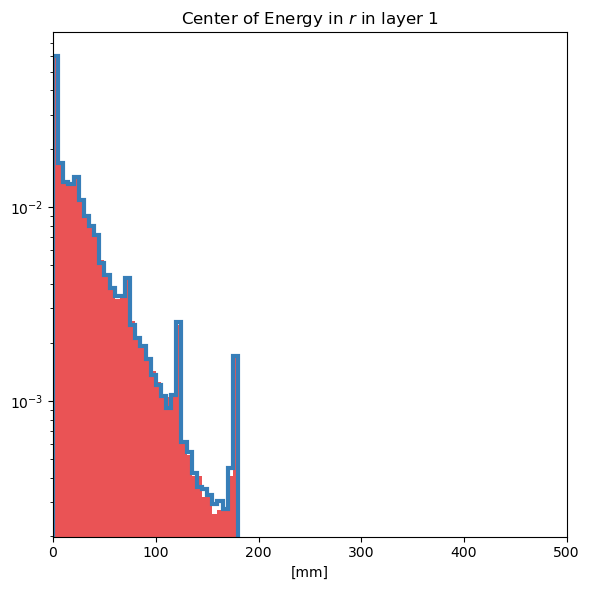

Separation power of EC r layer 2 histogram: 0.000245878186857551


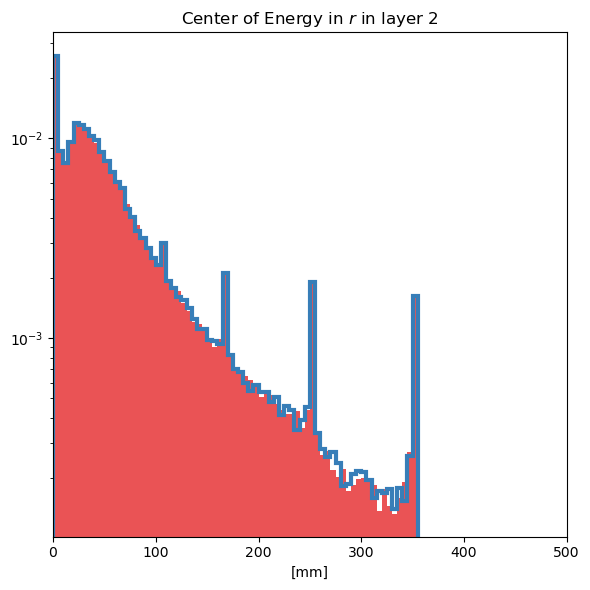

Separation power of EC r layer 3 histogram: 0.0005148678643079434


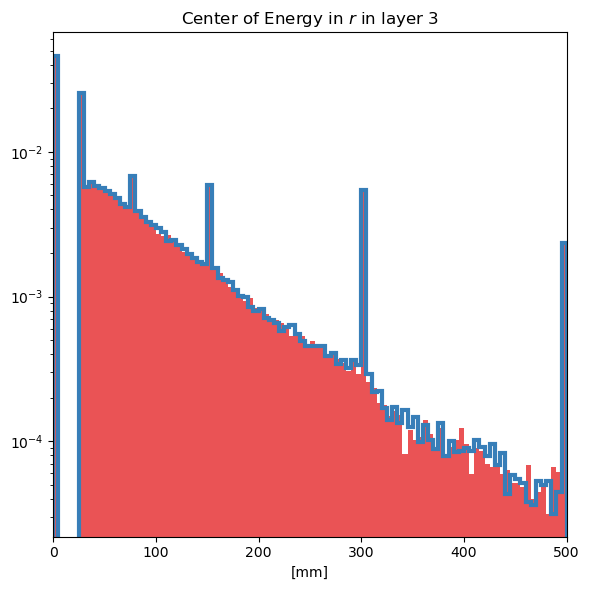

Separation power of EC r layer 12 histogram: 0.0003445187598196441


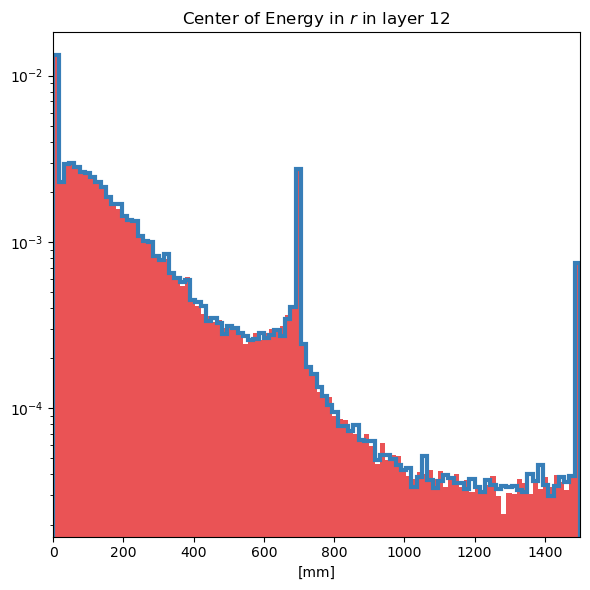

Separation power of EC r layer 13 histogram: 0.0004324327520852015


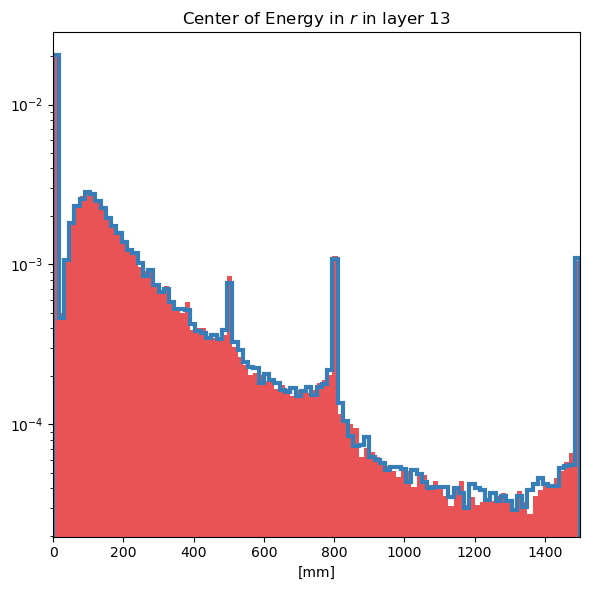

Separation power of EC r layer 14 histogram: 0.0004509301862886085


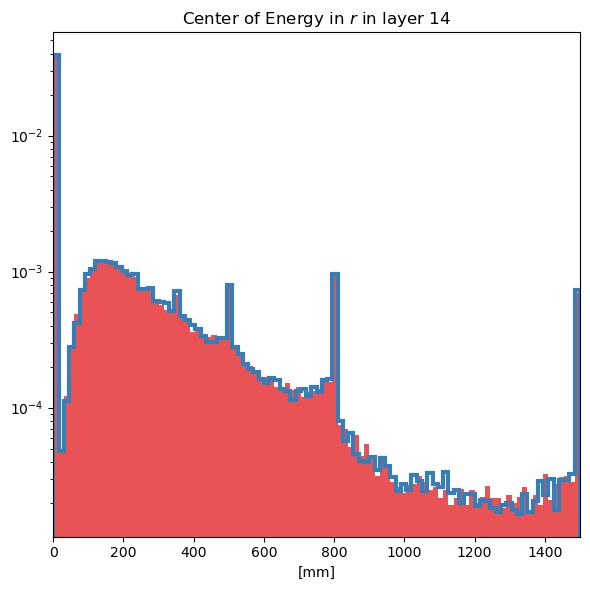

Separation power of Width r layer 0 histogram: 0.00020821210637928523


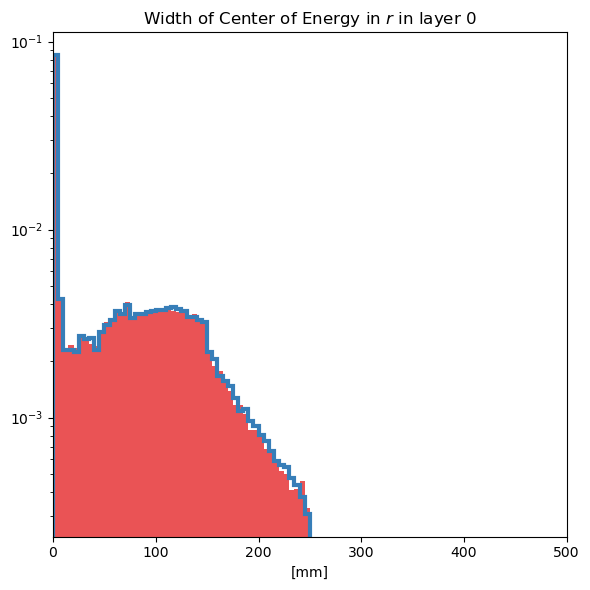

Separation power of Width r layer 1 histogram: 8.774423294887538e-05


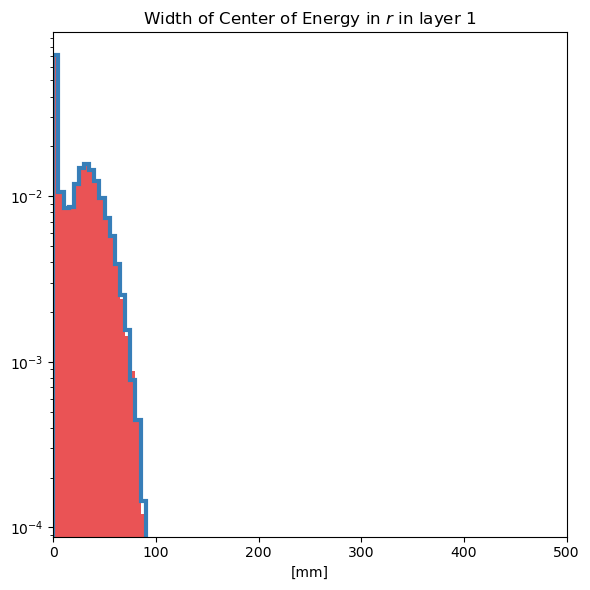

Separation power of Width r layer 2 histogram: 0.00012558434773714012


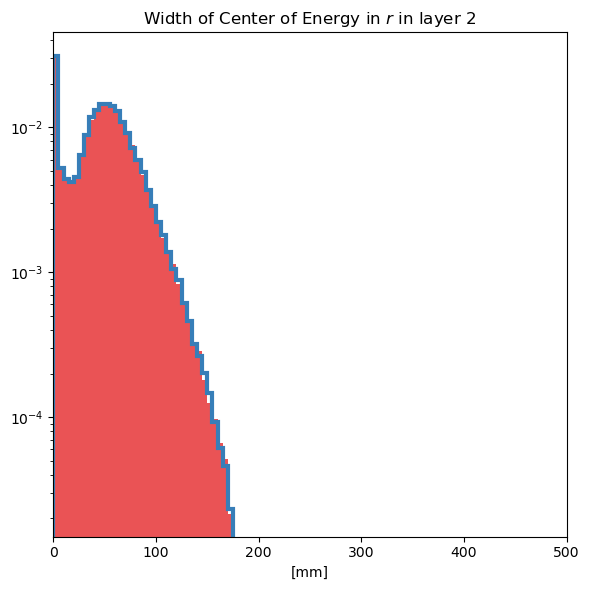

Separation power of Width r layer 3 histogram: 0.00015623675739690995


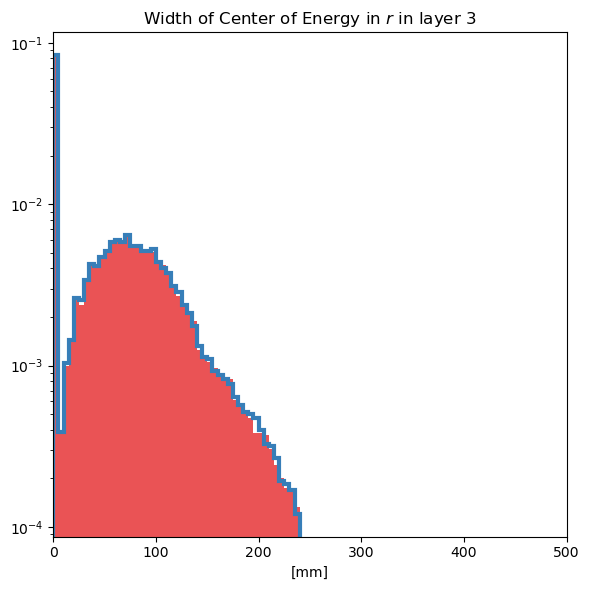

Separation power of Width r layer 12 histogram: 0.00028156765435500674


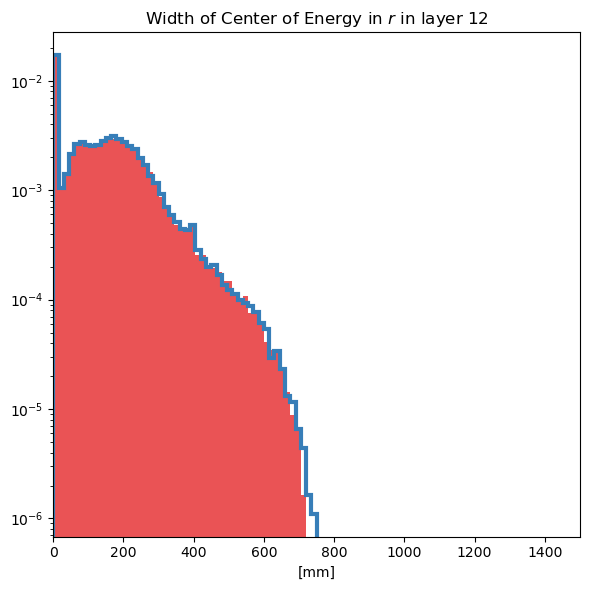

Separation power of Width r layer 13 histogram: 0.000193559027268971


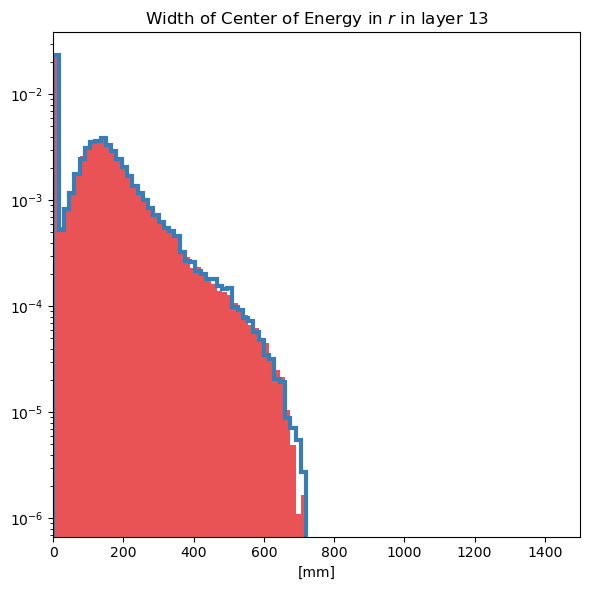

Separation power of Width r layer 14 histogram: 0.00028162494700224893


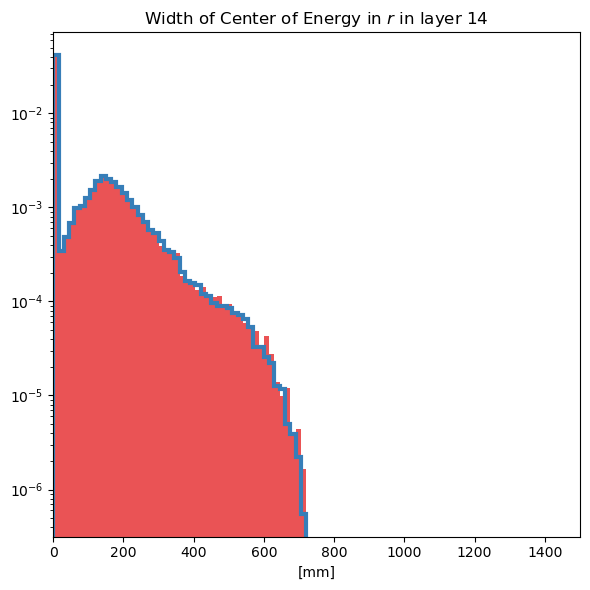

Separation power of voxel distribution histogram: 1.6760947746719333e-06


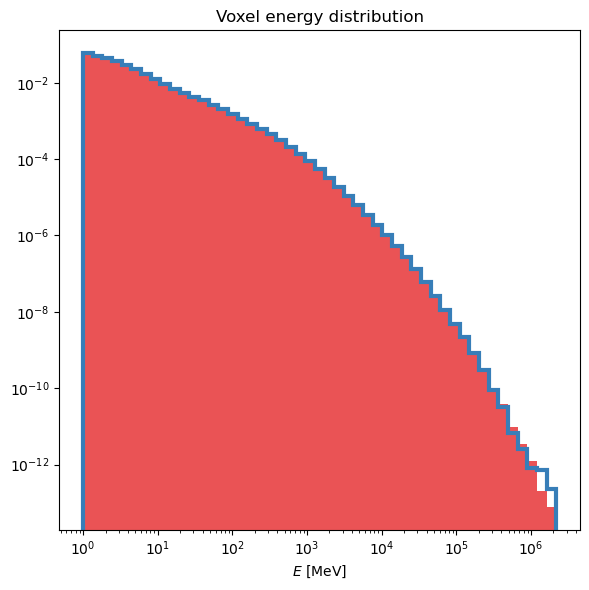

Separation power of Etot / Einc histogram: 0.0003766487677597569


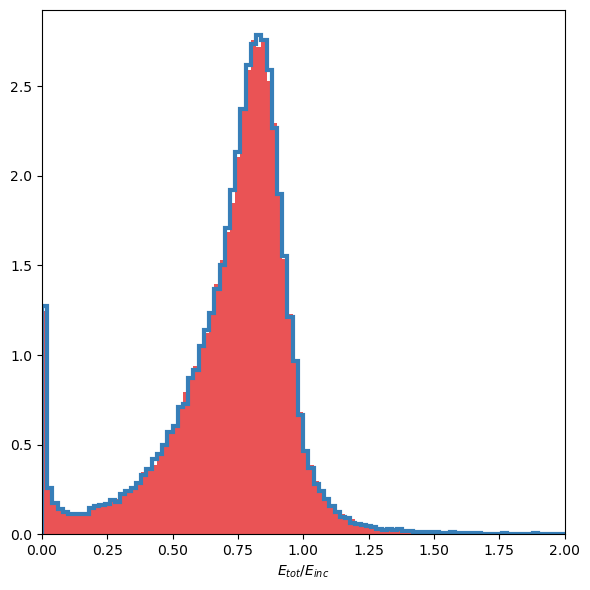

in iteration 4 of 10
Separation power of E layer 0 histogram: 0.00010912705065907394


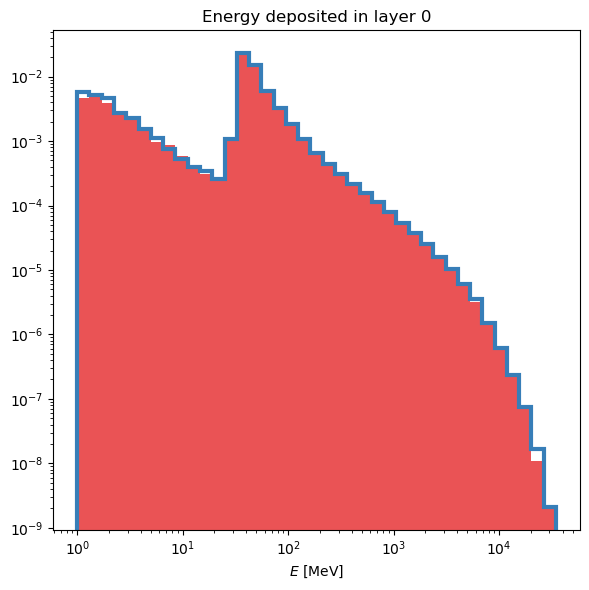

Separation power of E layer 1 histogram: 0.000183975705762504


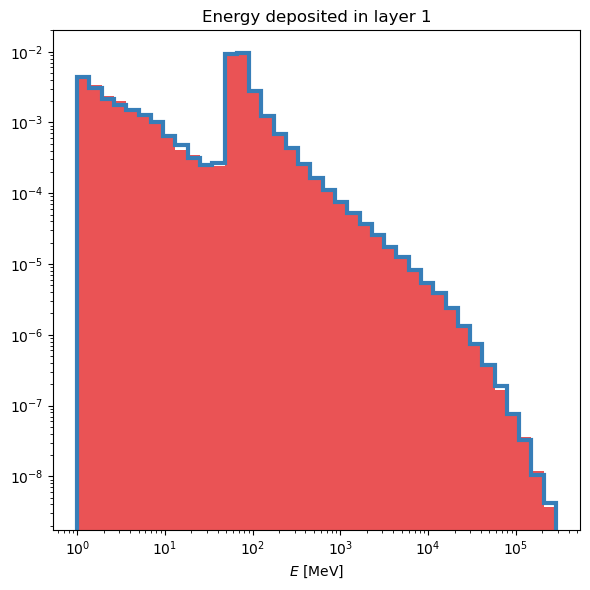

Separation power of E layer 2 histogram: 0.00014330924676973883


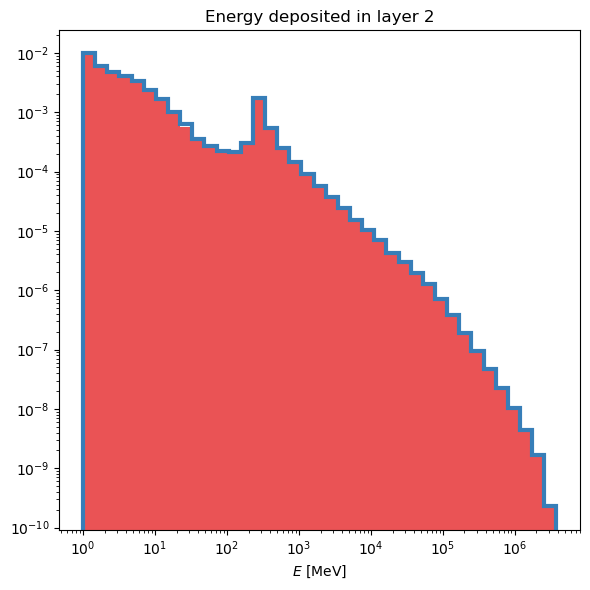

Separation power of E layer 3 histogram: 0.00013688824153676923


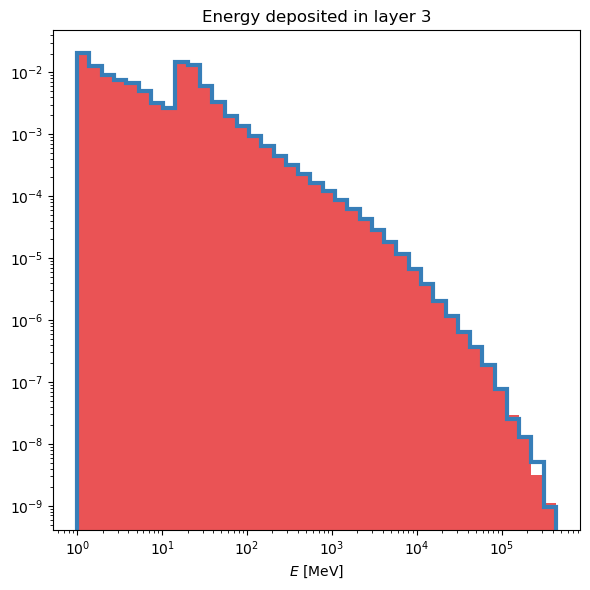

Separation power of E layer 12 histogram: 0.00016317571049829976


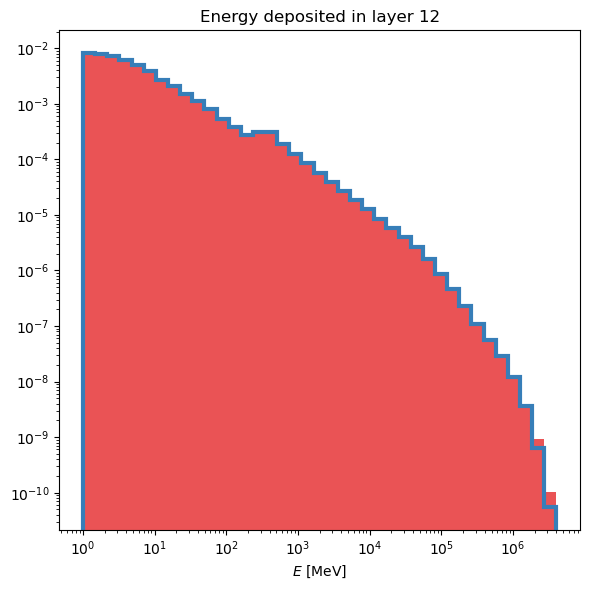

Separation power of E layer 13 histogram: 0.00019419667343444818


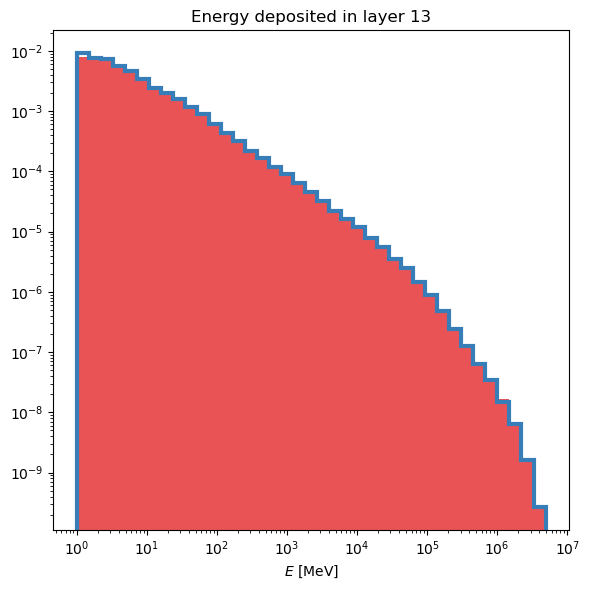

Separation power of E layer 14 histogram: 0.00027534520472297666


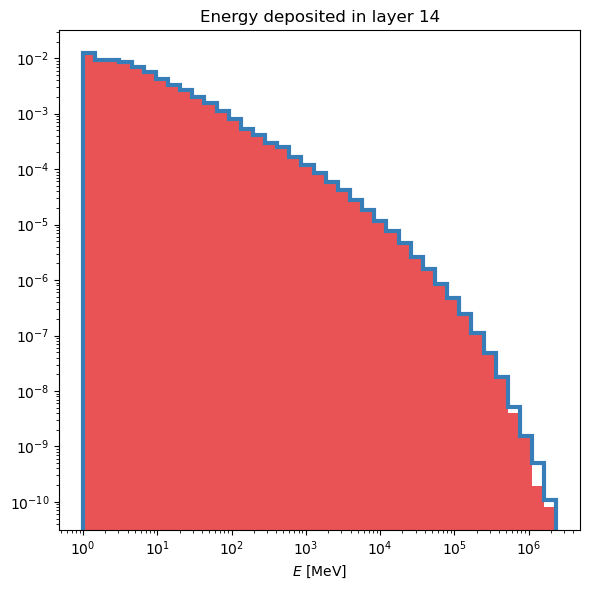

Separation power of EC Eta layer 1 histogram: 0.0004354598386262449


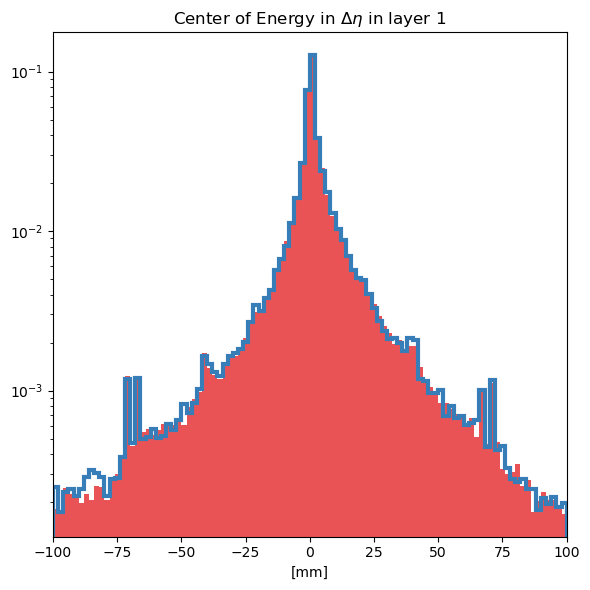

Separation power of EC Eta layer 2 histogram: 0.0004412686813514598


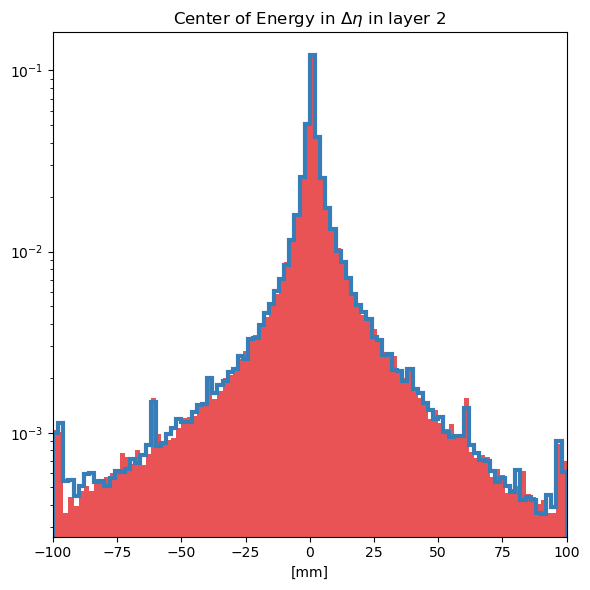

Separation power of EC Eta layer 12 histogram: 0.0004461432478836413


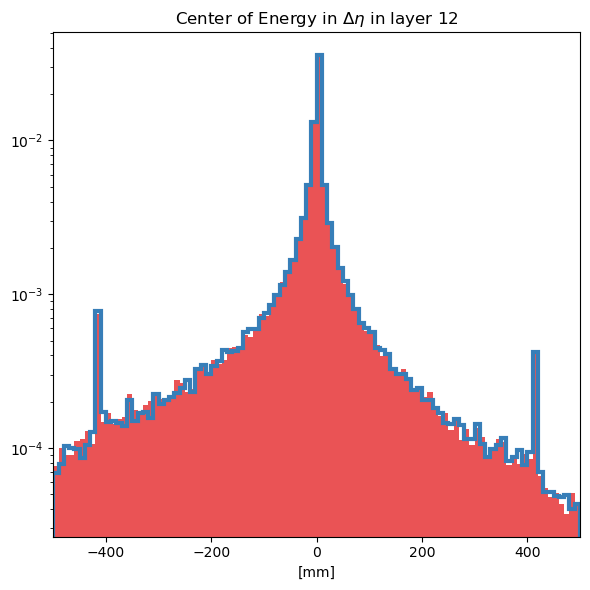

Separation power of EC Eta layer 13 histogram: 0.0004559102801554093


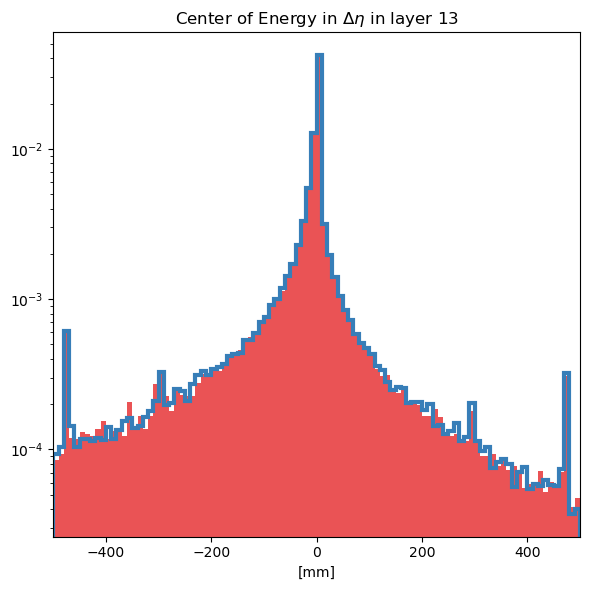

Separation power of EC Phi layer 1 histogram: 0.00046712611631584216


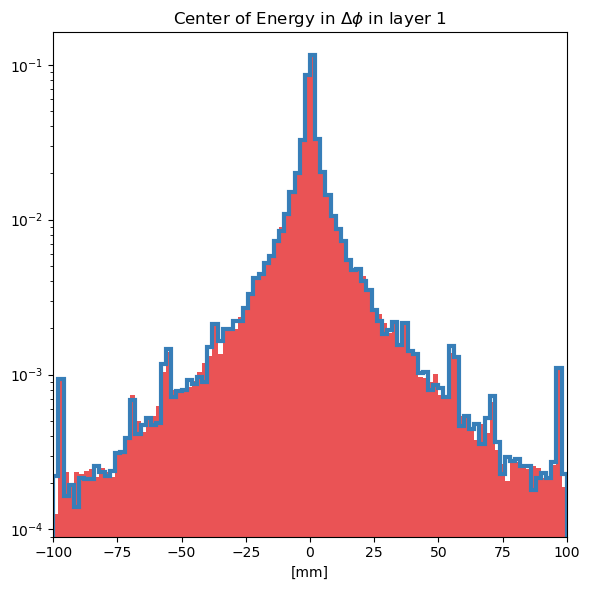

Separation power of EC Phi layer 2 histogram: 0.0004127313471818576


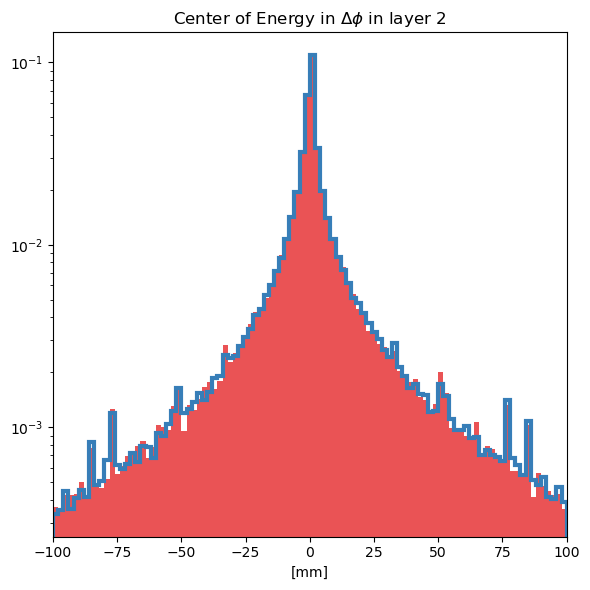

Separation power of EC Phi layer 12 histogram: 0.00039557163775876973


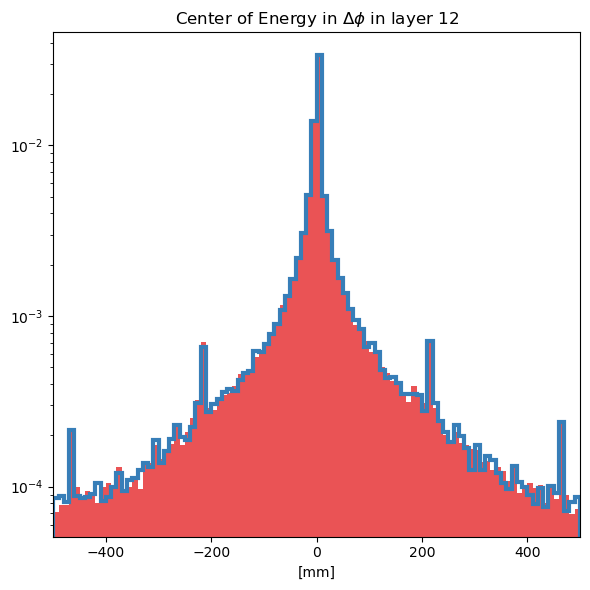

Separation power of EC Phi layer 13 histogram: 0.00041022130284662267


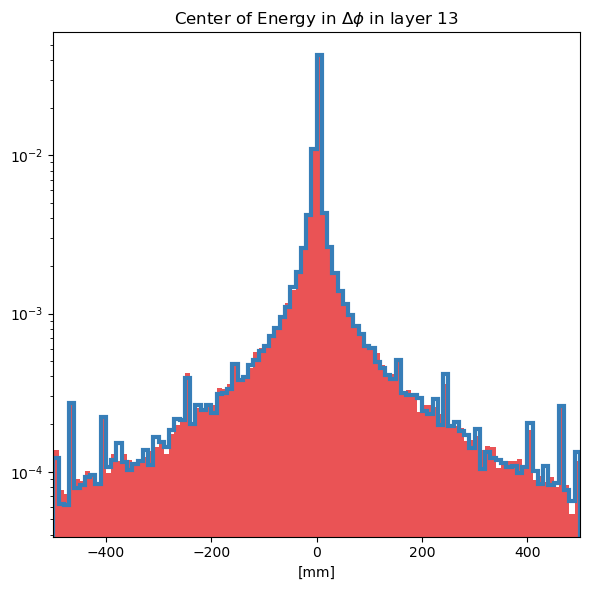

Separation power of Width Eta layer 1 histogram: 0.00036676665765667313


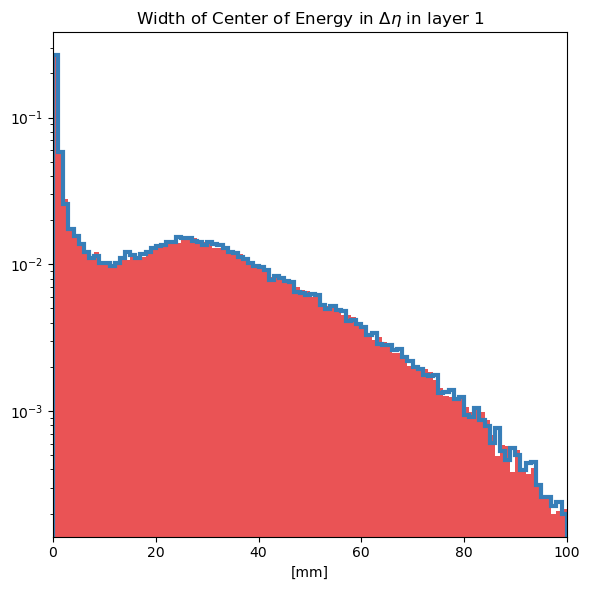

Separation power of Width Eta layer 2 histogram: 0.0004619338465351836


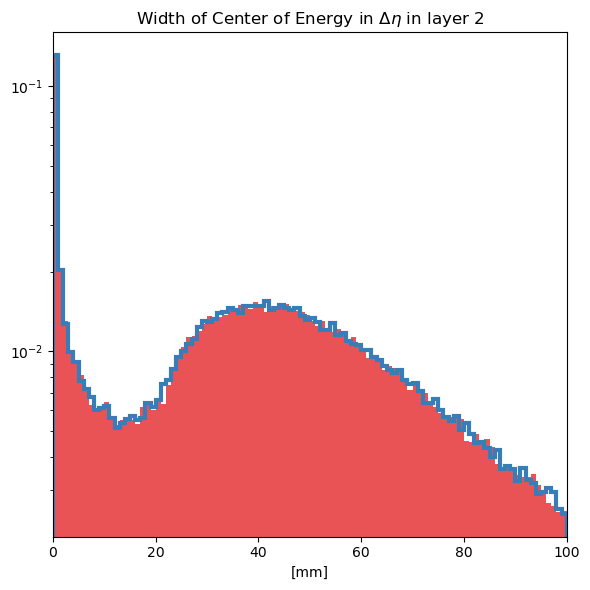

Separation power of Width Eta layer 12 histogram: 0.00042556332843101584


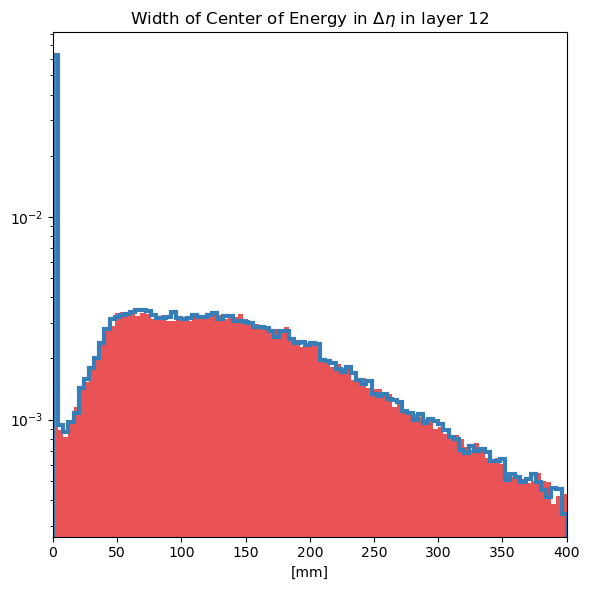

Separation power of Width Eta layer 13 histogram: 0.0004954108642670588


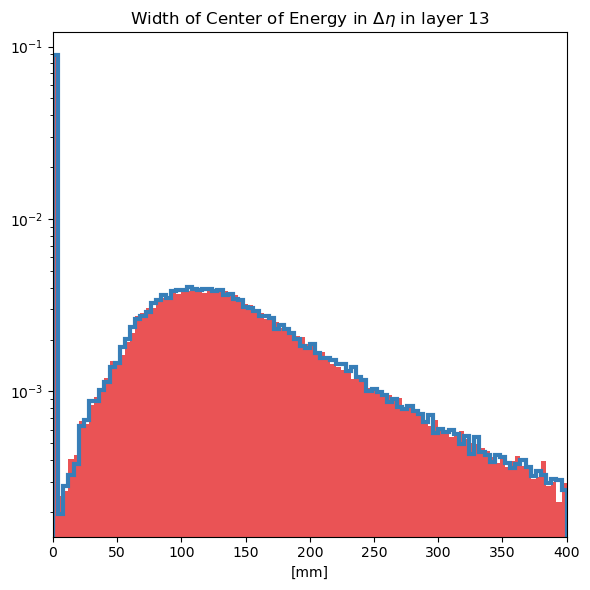

Separation power of Width Phi layer 1 histogram: 0.00041461139644865917


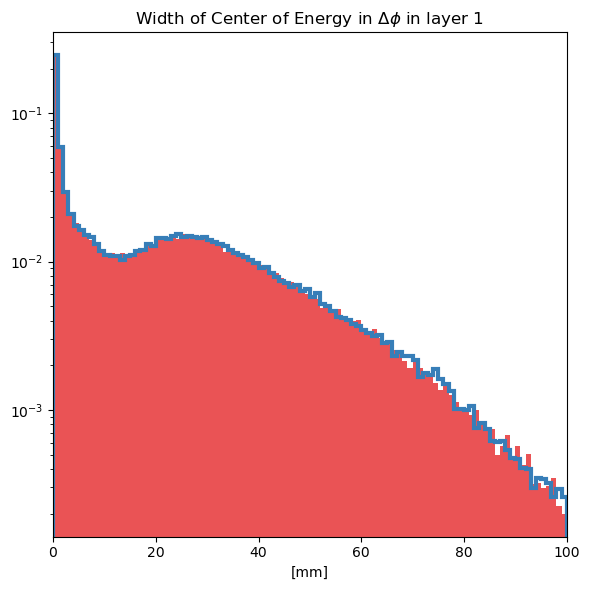

Separation power of Width Phi layer 2 histogram: 0.00036013522430388886


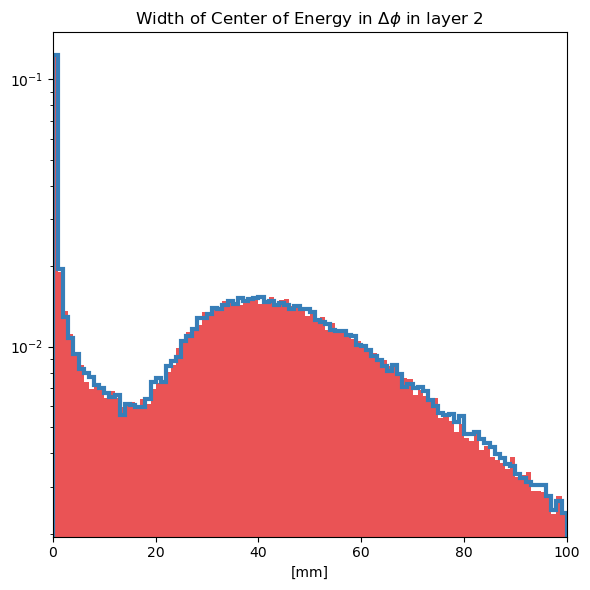

Separation power of Width Phi layer 12 histogram: 0.0004156107972309525


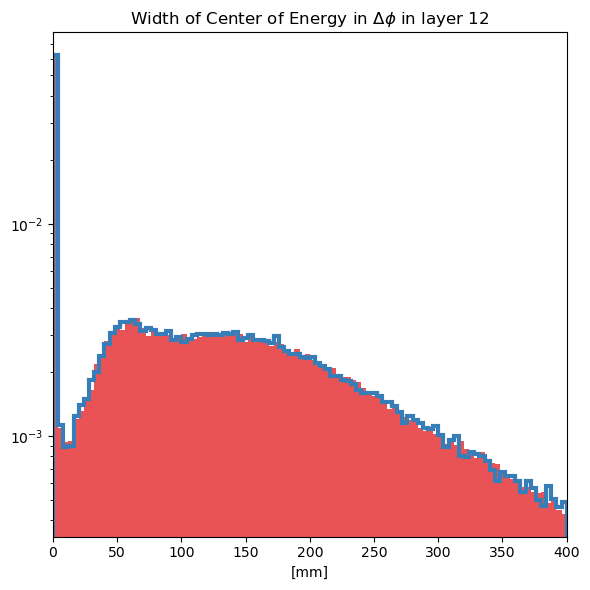

Separation power of Width Phi layer 13 histogram: 0.000421013658732771


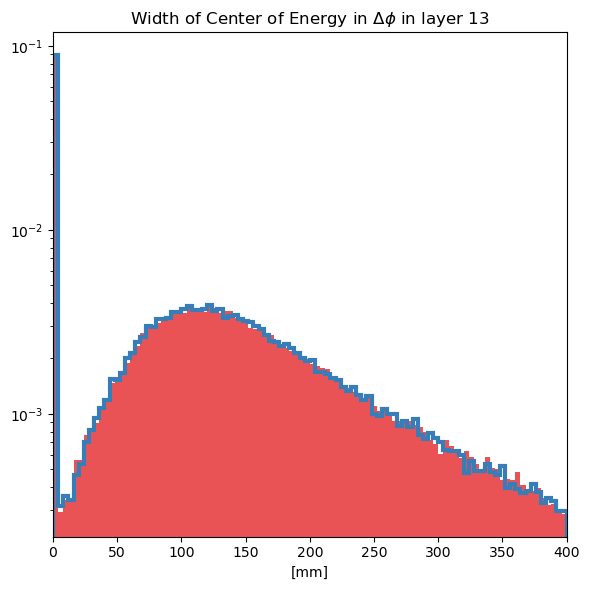

Separation power of Sparsity layer 0 histogram: 2.5517240168892213e-05


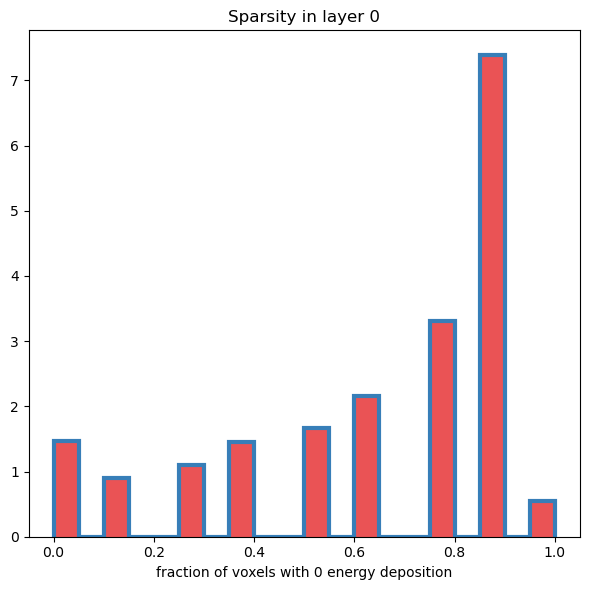

Separation power of Sparsity layer 1 histogram: 5.434654024895066e-05


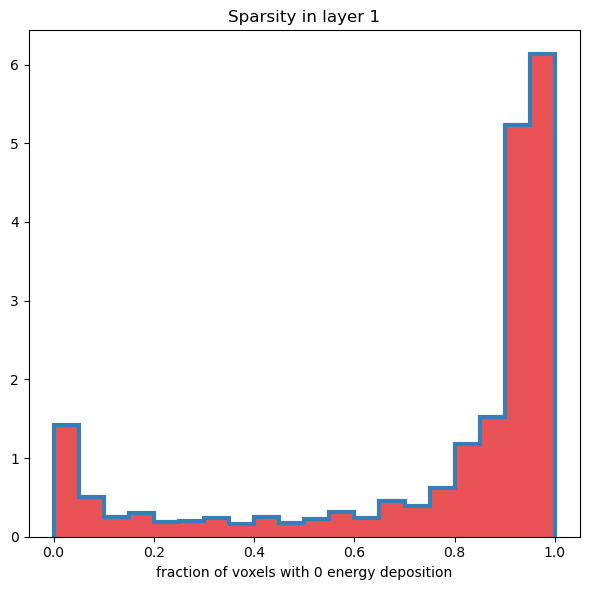

Separation power of Sparsity layer 2 histogram: 8.438966705407983e-05


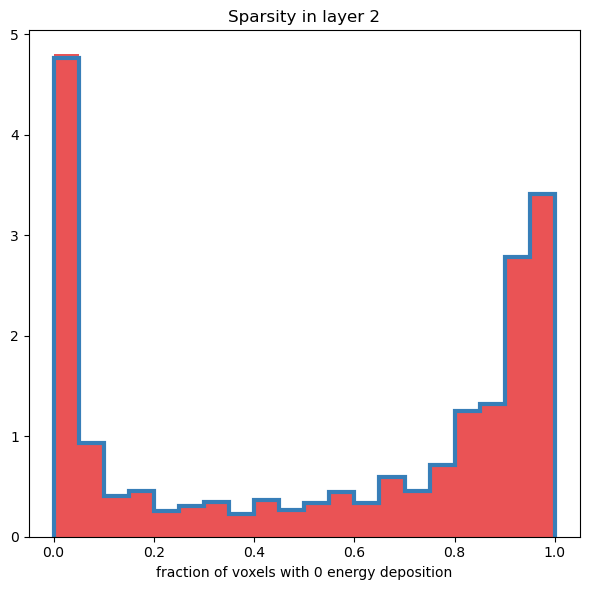

Separation power of Sparsity layer 3 histogram: 1.3503220924159301e-05


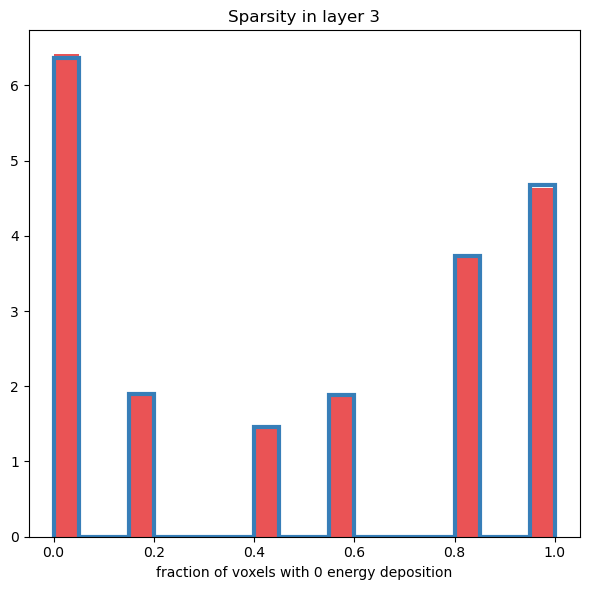

Separation power of Sparsity layer 12 histogram: 5.0095221629971585e-05


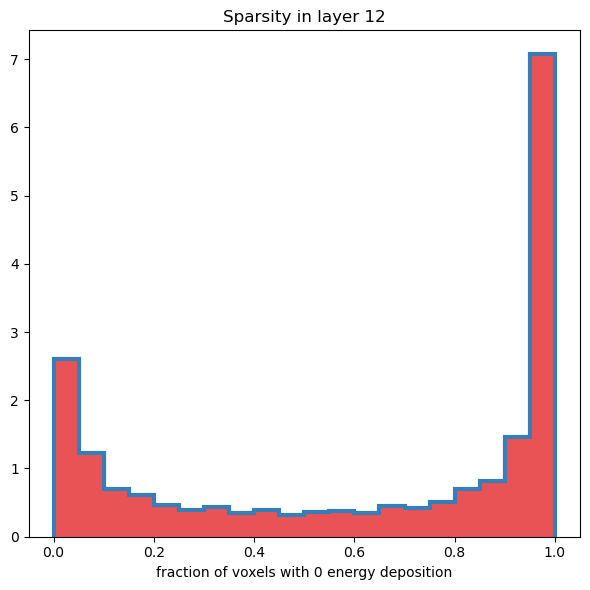

Separation power of Sparsity layer 13 histogram: 2.209303225853667e-05


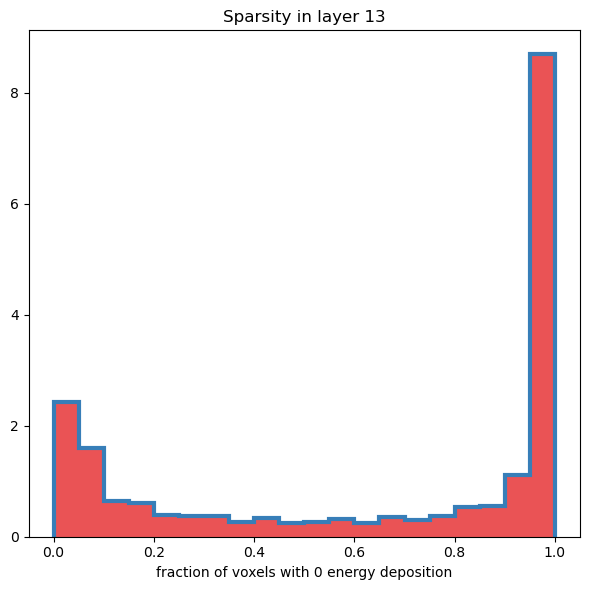

Separation power of Sparsity layer 14 histogram: 3.941390090793243e-05


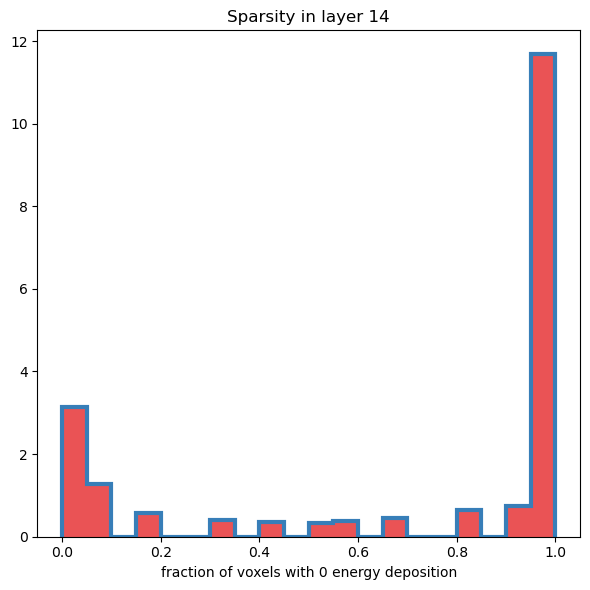

Separation power of EC r layer 0 histogram: 0.00044600132585176887


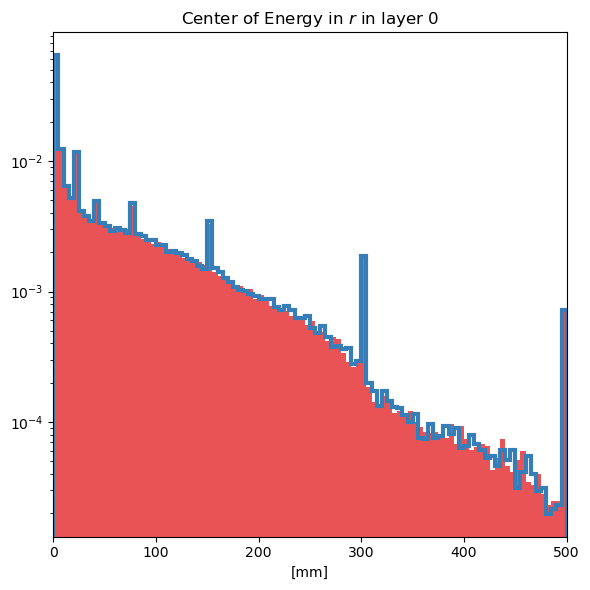

Separation power of EC r layer 1 histogram: 0.00015924951052574476


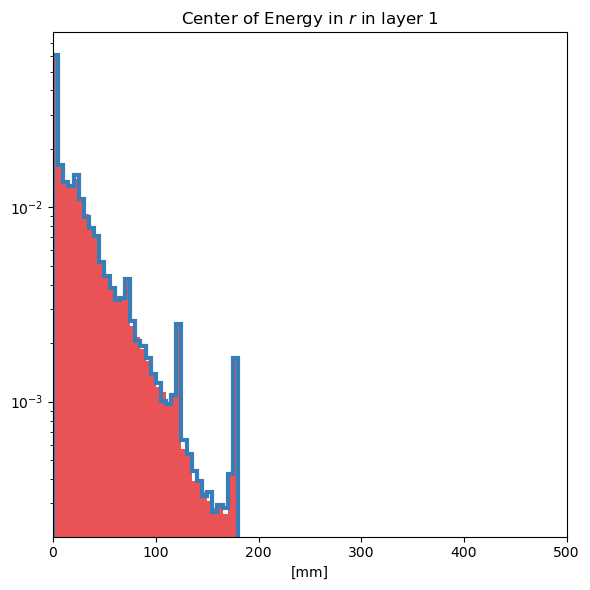

Separation power of EC r layer 2 histogram: 0.00034931187940601615


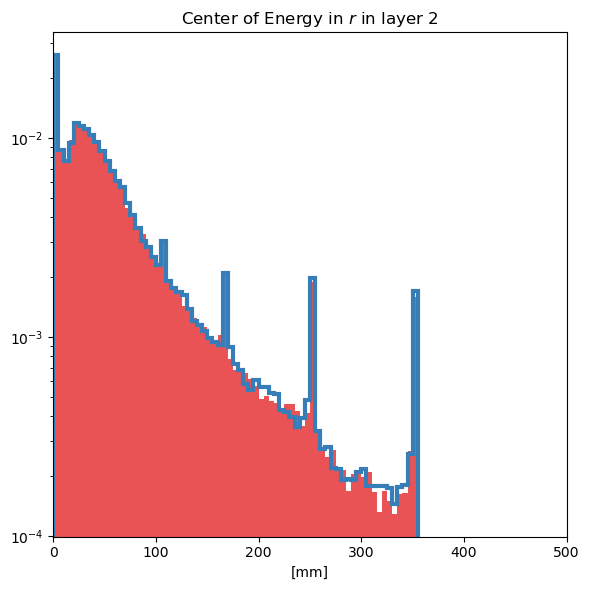

Separation power of EC r layer 3 histogram: 0.0003412723071113294


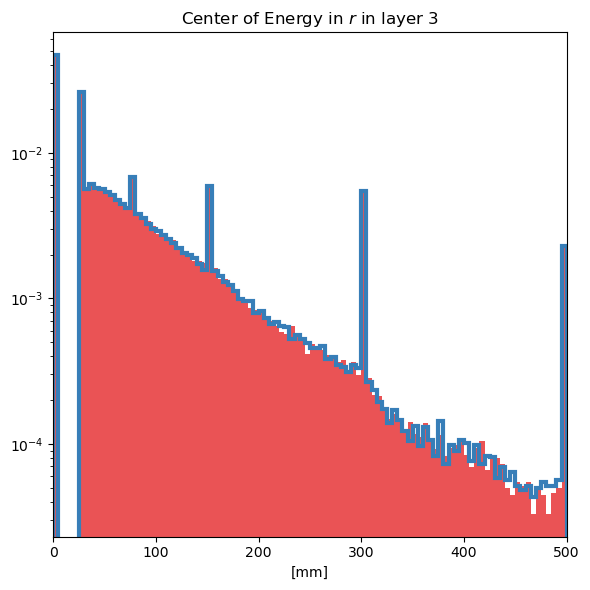

Separation power of EC r layer 12 histogram: 0.0004575758451094643


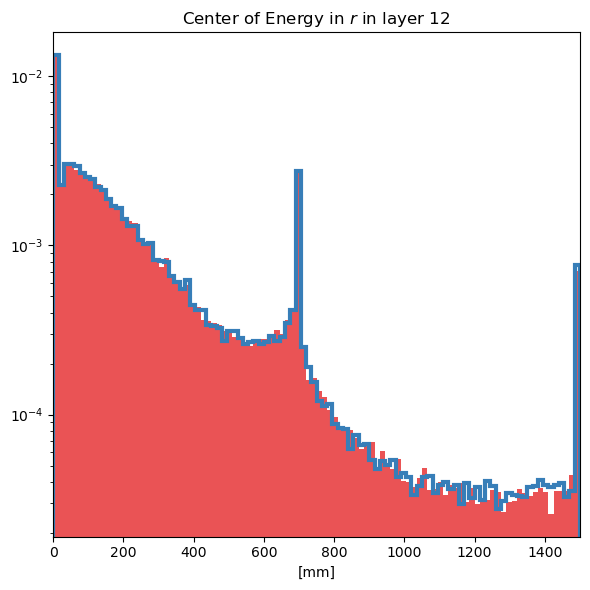

Separation power of EC r layer 13 histogram: 0.00039305737826019583


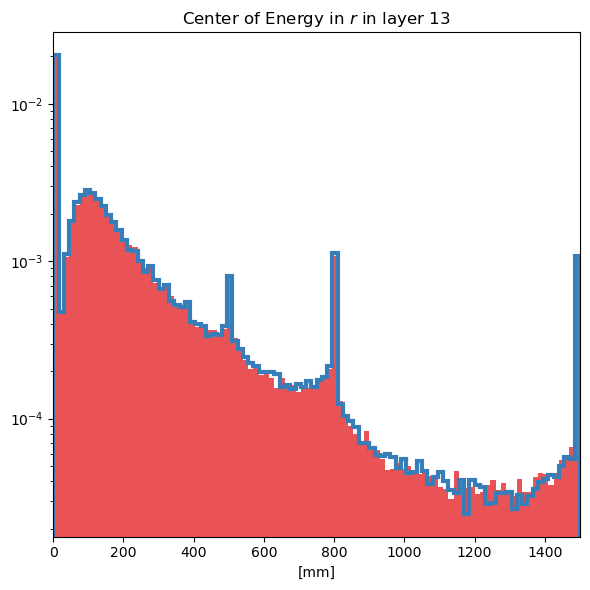

Separation power of EC r layer 14 histogram: 0.0004376078836302059


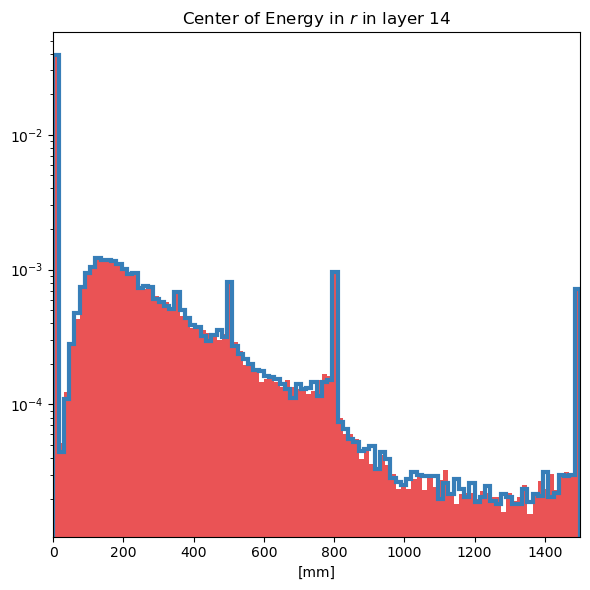

Separation power of Width r layer 0 histogram: 0.00030325704353482855


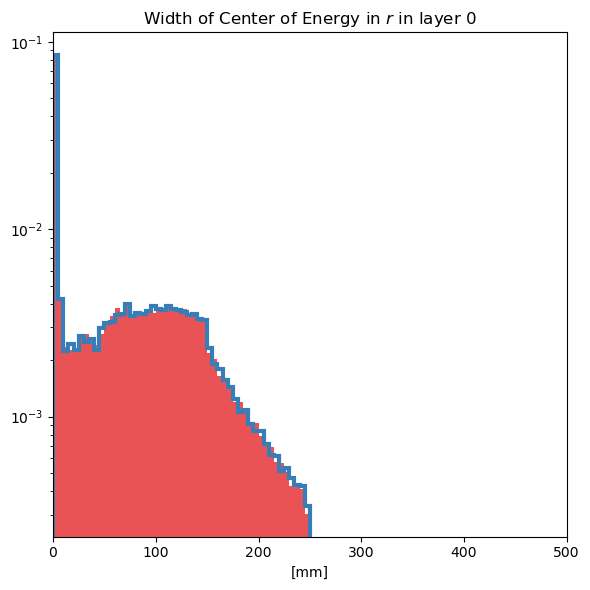

Separation power of Width r layer 1 histogram: 6.007140058963666e-05


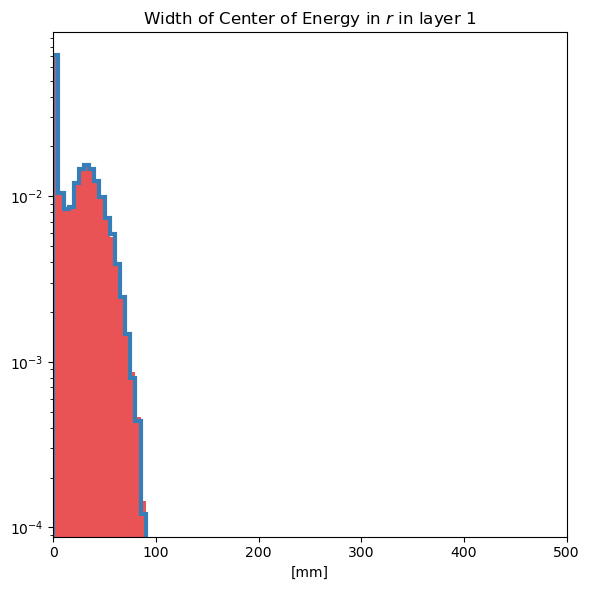

Separation power of Width r layer 2 histogram: 0.0001242527875588598


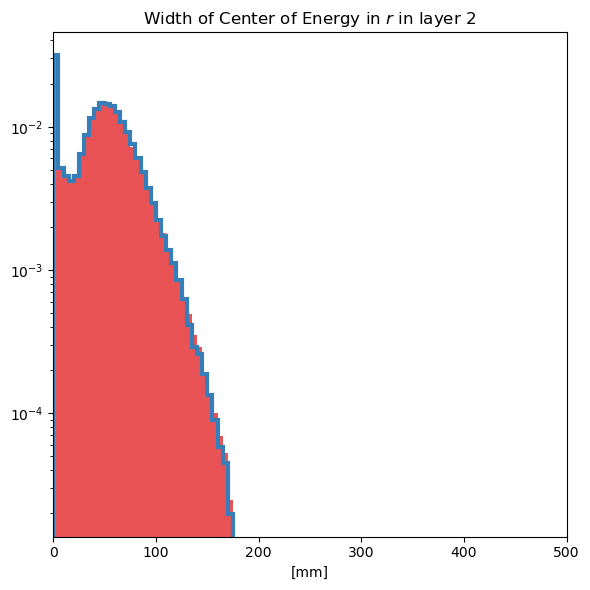

Separation power of Width r layer 3 histogram: 0.00012950814508889968


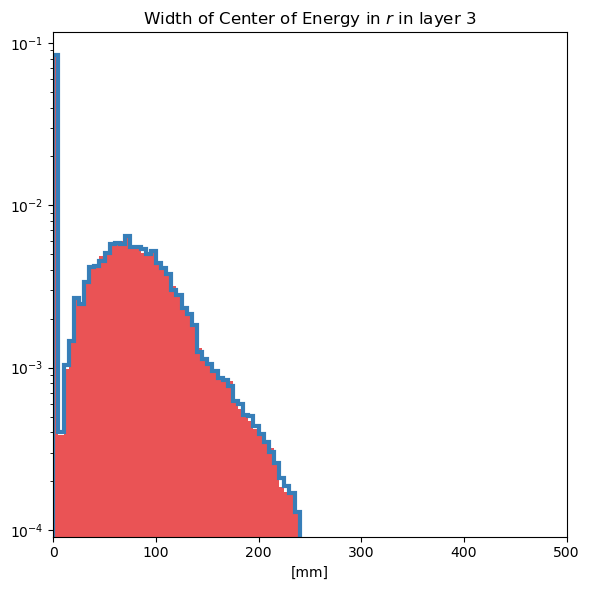

Separation power of Width r layer 12 histogram: 0.0002055601014924248


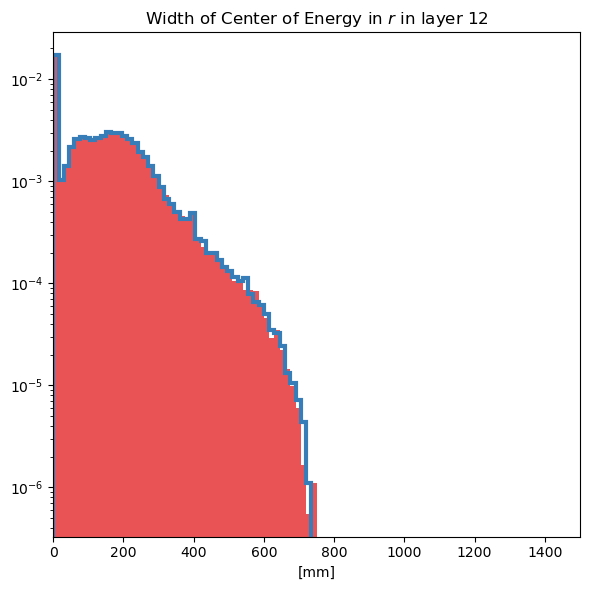

Separation power of Width r layer 13 histogram: 0.00011358708108433362


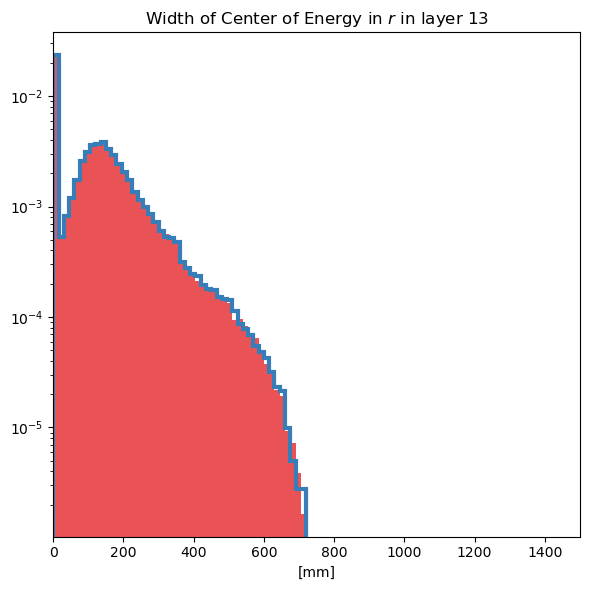

Separation power of Width r layer 14 histogram: 0.00013845624241728293


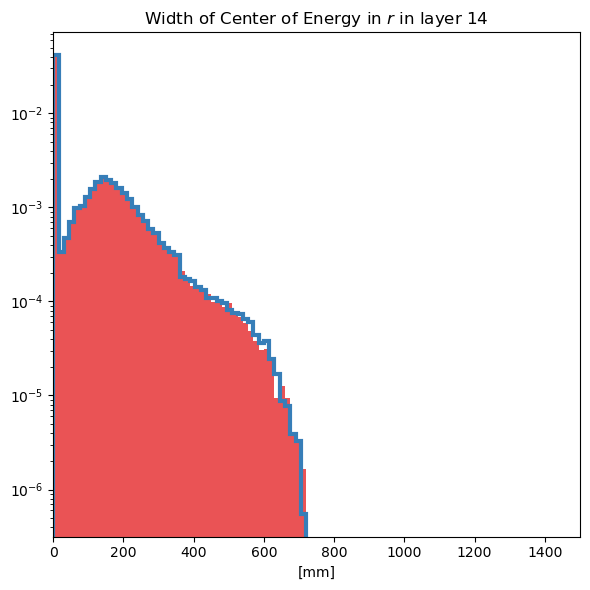

Separation power of voxel distribution histogram: 2.323752240597282e-06


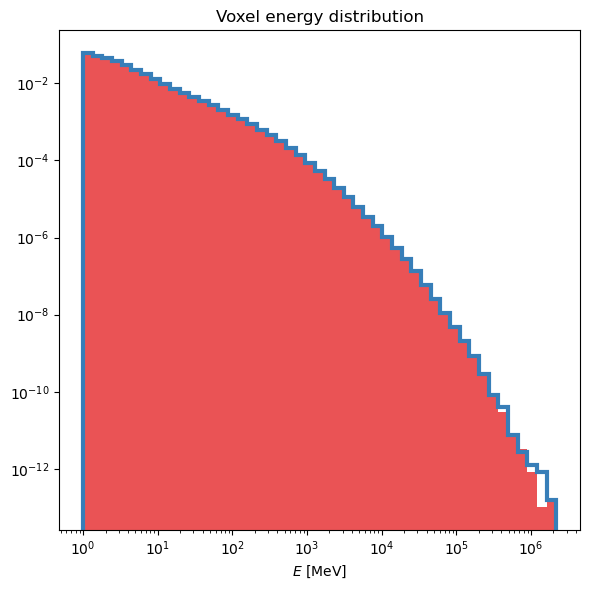

Separation power of Etot / Einc histogram: 0.00041796177578200407


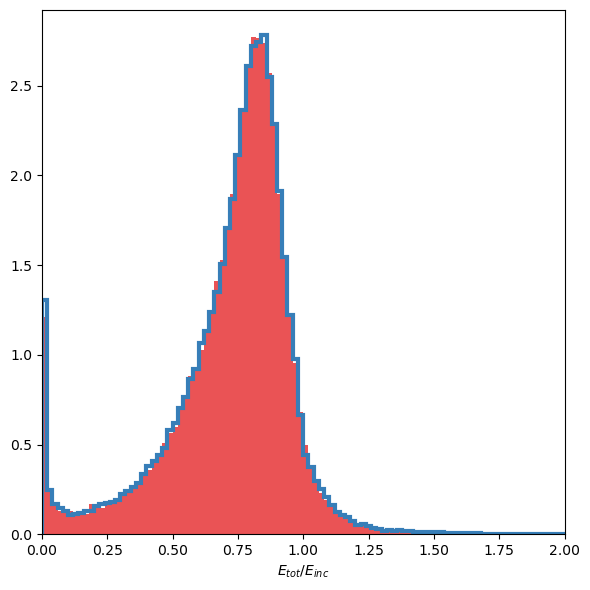

in iteration 5 of 10
Separation power of E layer 0 histogram: 0.0002437131927856401


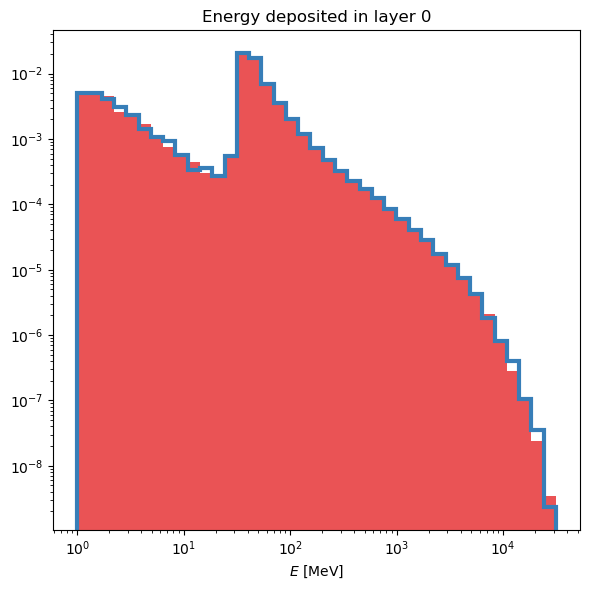

Separation power of E layer 1 histogram: 0.0001265855583507531


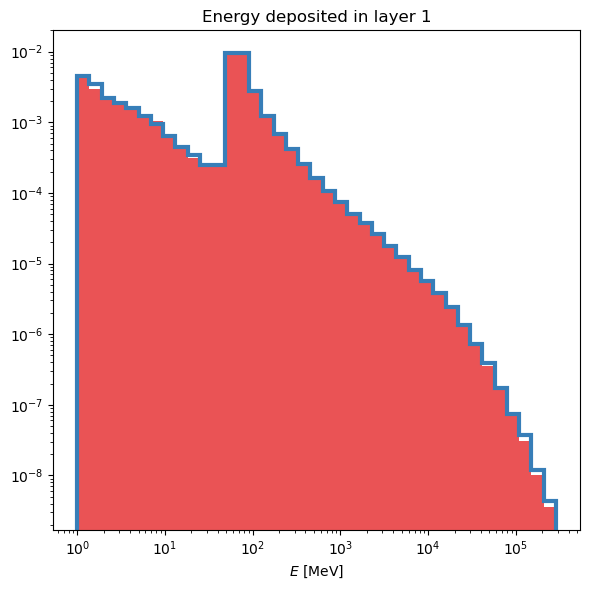

Separation power of E layer 2 histogram: 0.0002203596088079187


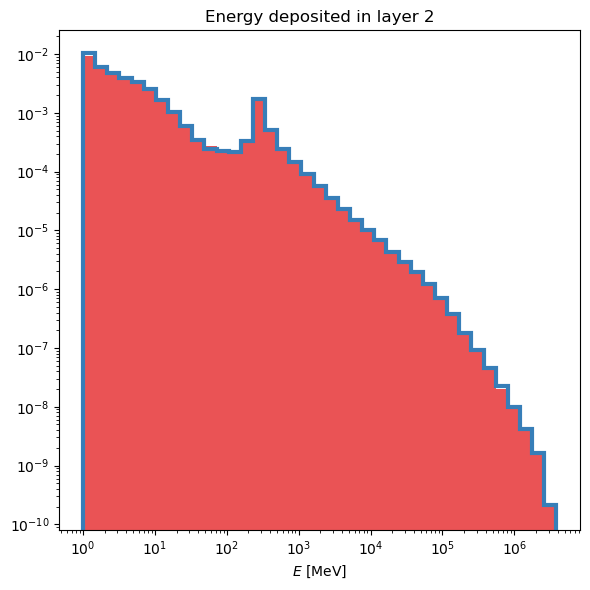

Separation power of E layer 3 histogram: 0.00023959433075011337


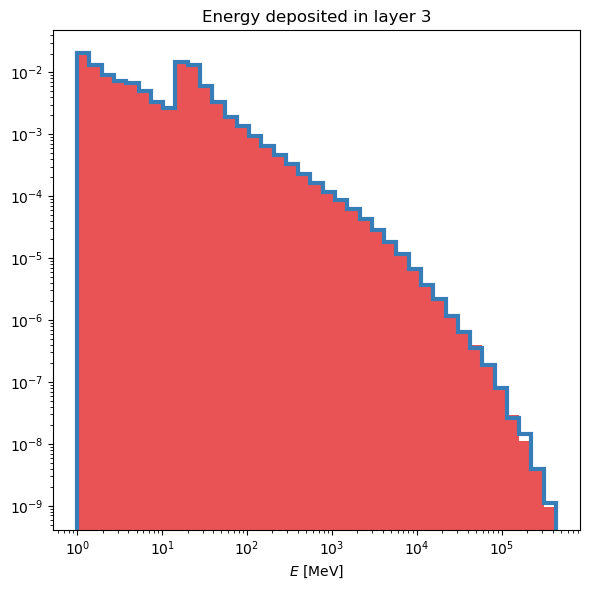

Separation power of E layer 12 histogram: 0.00022366255849105946


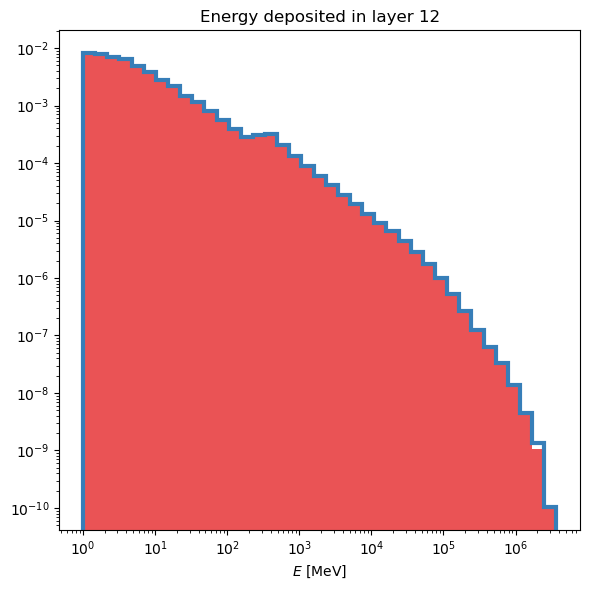

Separation power of E layer 13 histogram: 0.00018269635391552963


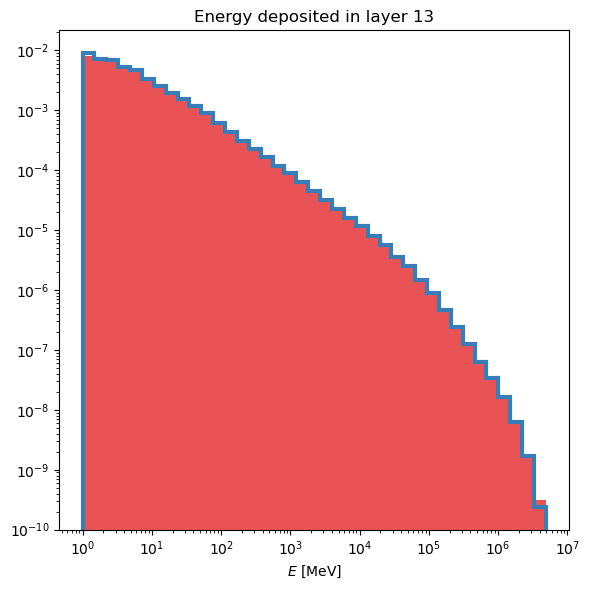

Separation power of E layer 14 histogram: 0.0003727926510101135


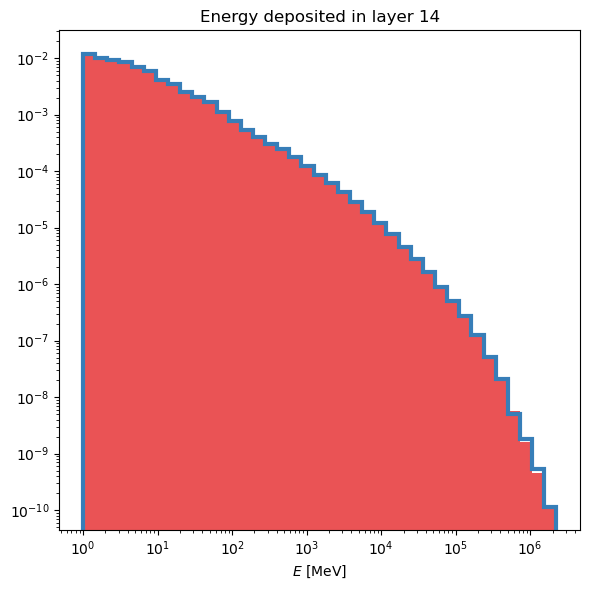

Separation power of EC Eta layer 1 histogram: 0.00032660334847685936


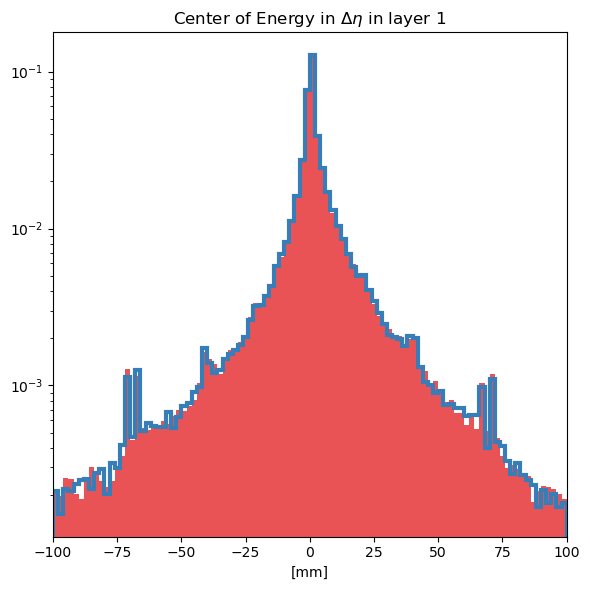

Separation power of EC Eta layer 2 histogram: 0.000460699849671284


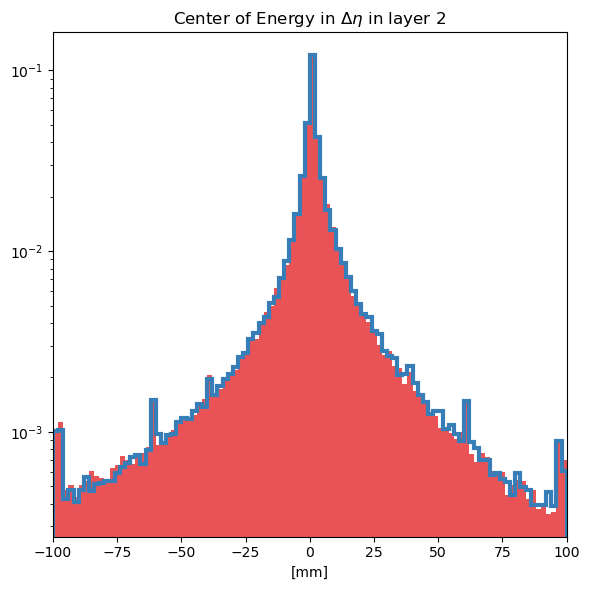

Separation power of EC Eta layer 12 histogram: 0.0005582985016372508


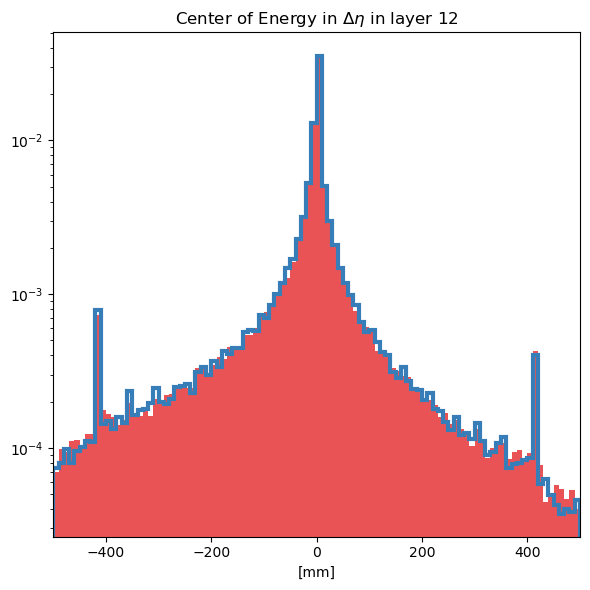

Separation power of EC Eta layer 13 histogram: 0.0004127925996941724


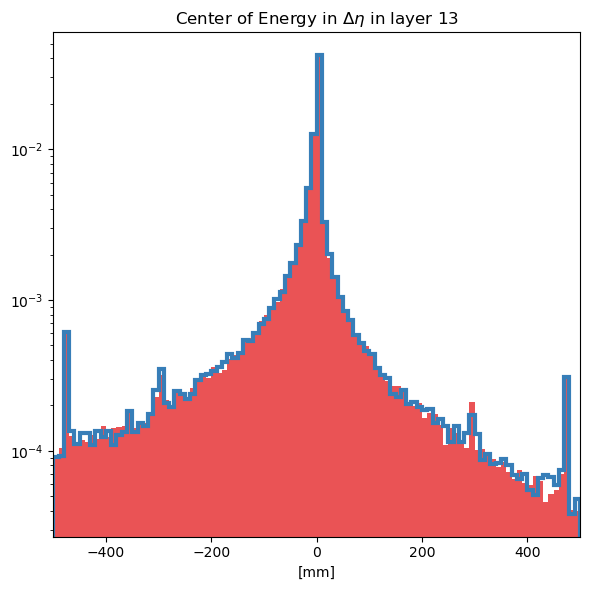

Separation power of EC Phi layer 1 histogram: 0.0004608341332027999


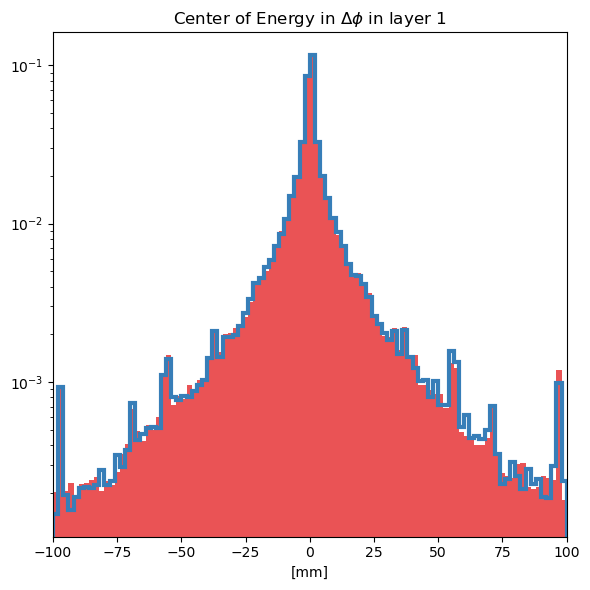

Separation power of EC Phi layer 2 histogram: 0.00043994328277347324


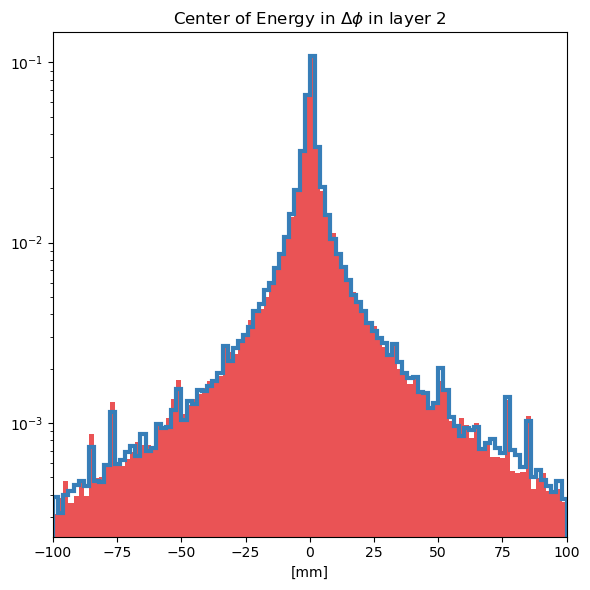

Separation power of EC Phi layer 12 histogram: 0.00043286130454935935


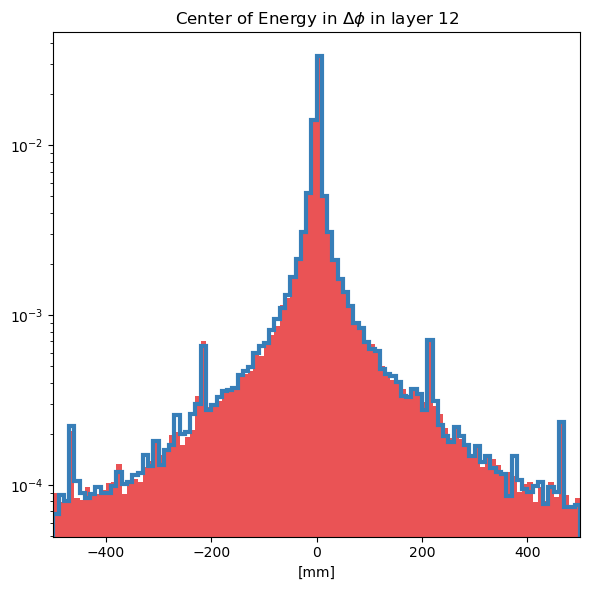

Separation power of EC Phi layer 13 histogram: 0.0004757795856653635


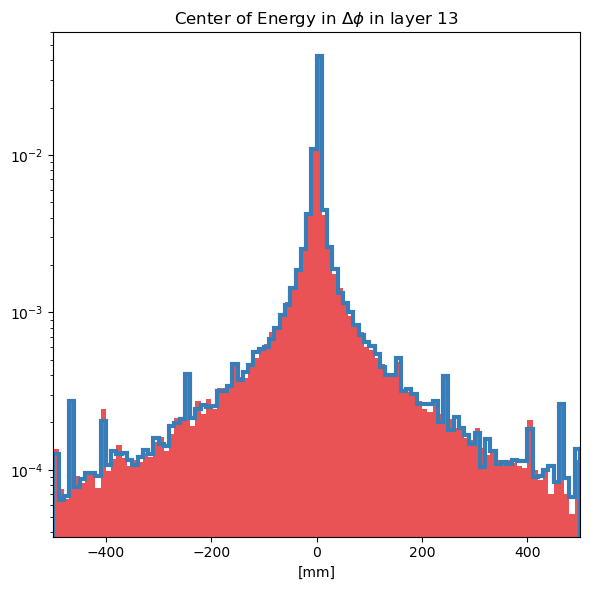

Separation power of Width Eta layer 1 histogram: 0.0003513224363200588


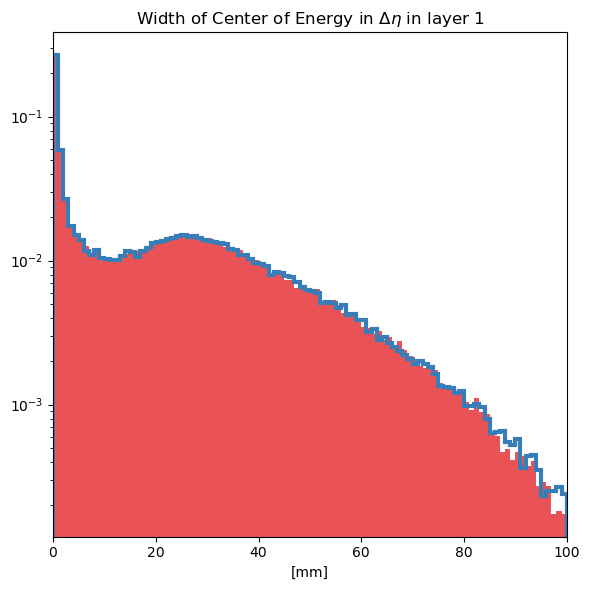

Separation power of Width Eta layer 2 histogram: 0.00038476236955675323


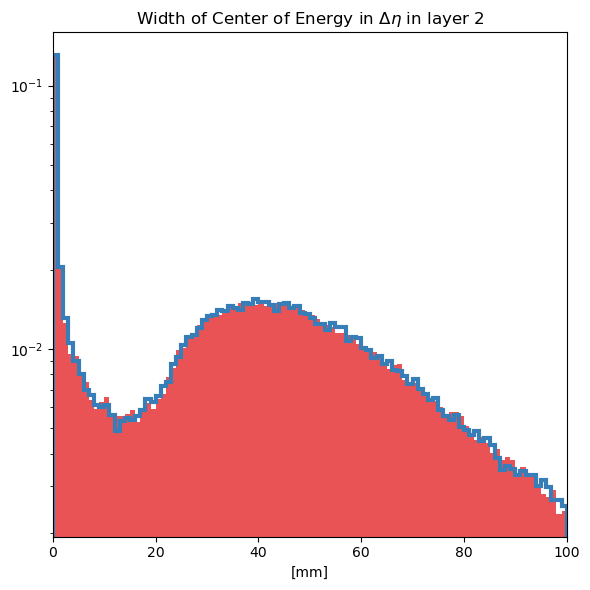

Separation power of Width Eta layer 12 histogram: 0.0004944554878961409


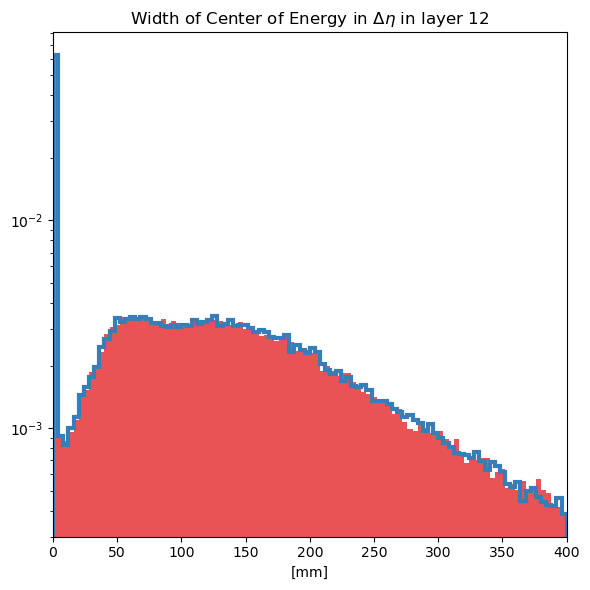

Separation power of Width Eta layer 13 histogram: 0.0003232805113160784


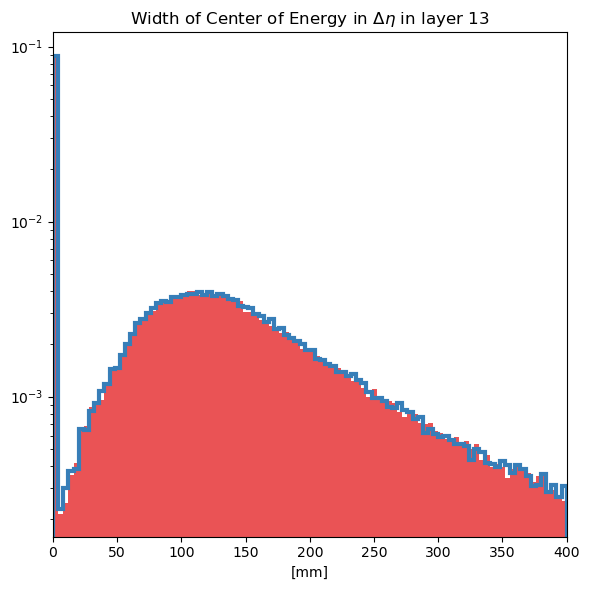

Separation power of Width Phi layer 1 histogram: 0.0004236904209909343


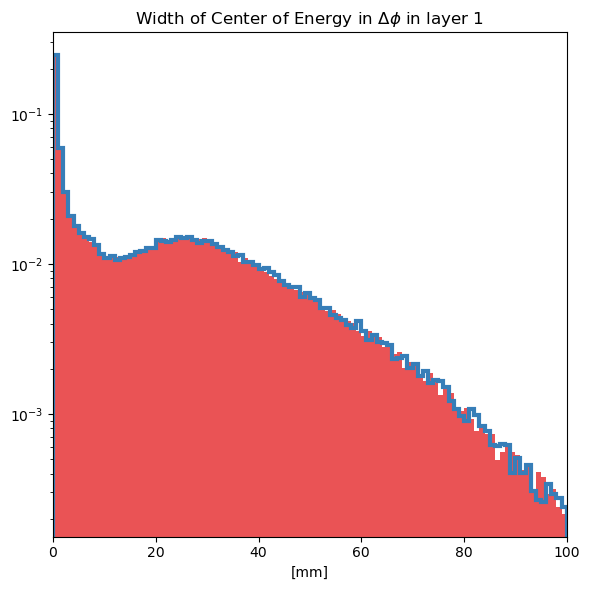

Separation power of Width Phi layer 2 histogram: 0.00037180025681010794


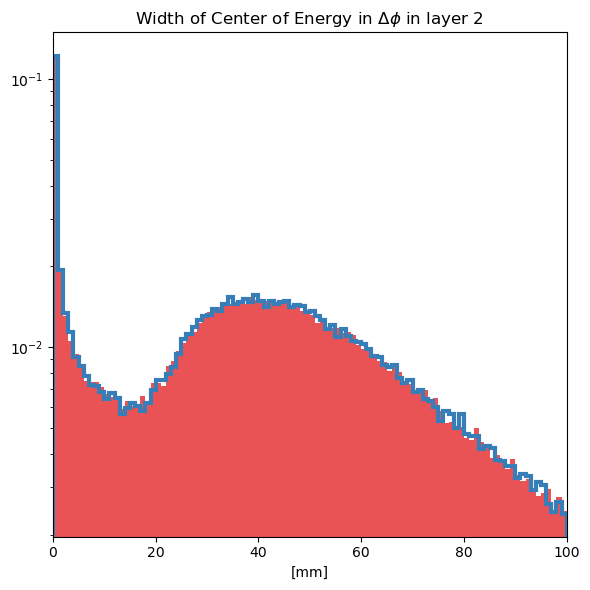

Separation power of Width Phi layer 12 histogram: 0.00045811871994517594


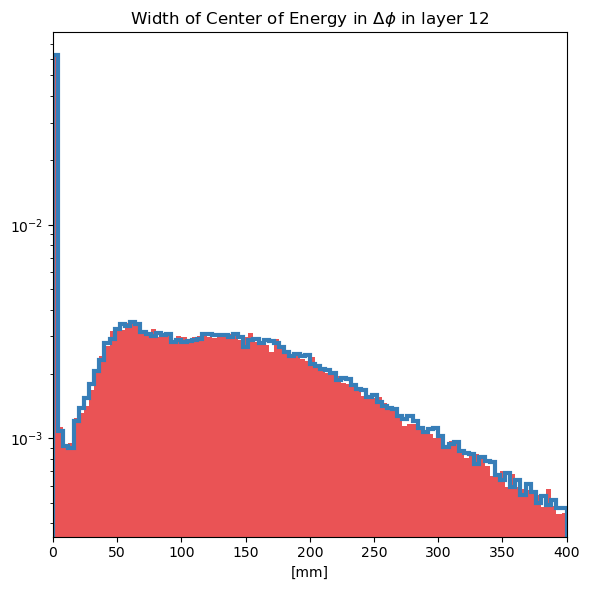

Separation power of Width Phi layer 13 histogram: 0.0004473546260301514


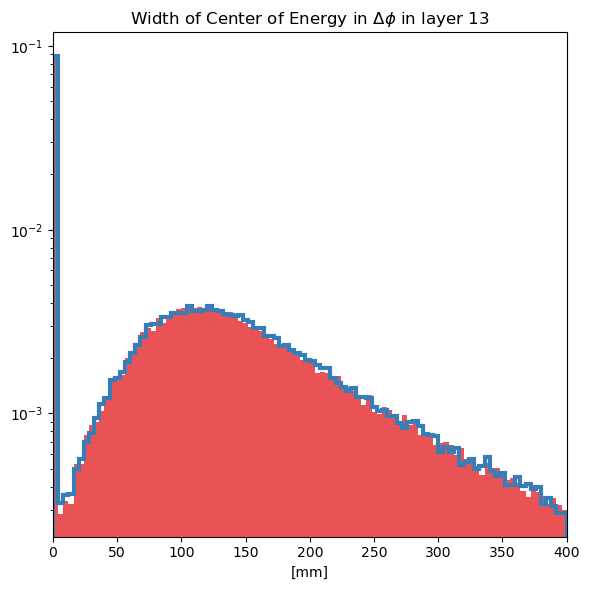

Separation power of Sparsity layer 0 histogram: 5.737394802807466e-05


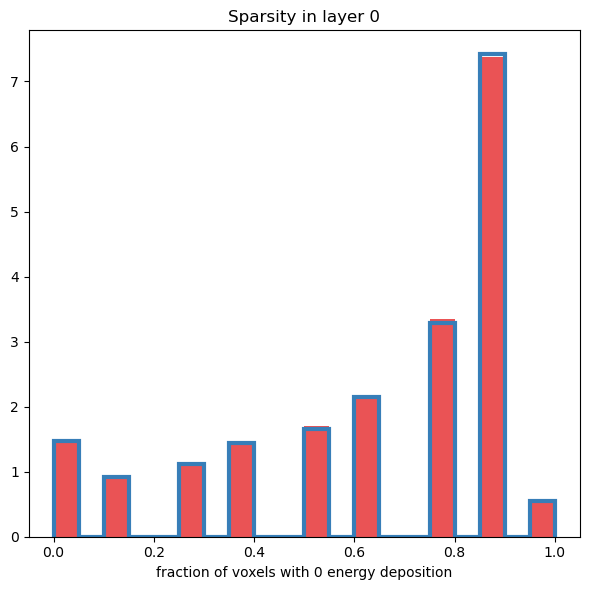

Separation power of Sparsity layer 1 histogram: 0.00012517244528400666


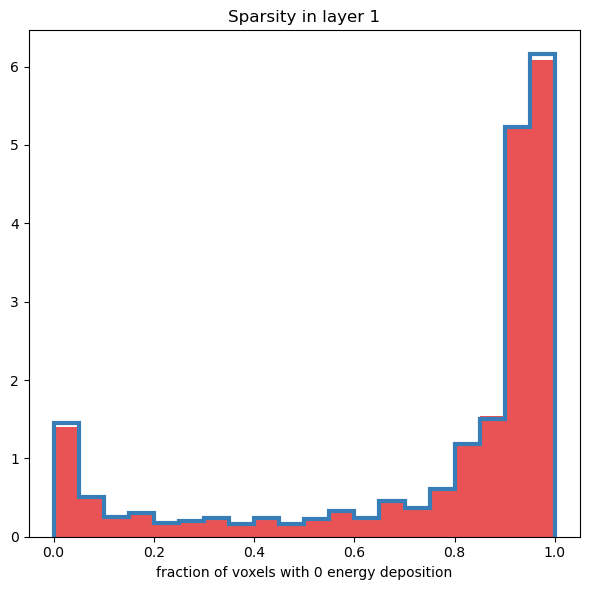

Separation power of Sparsity layer 2 histogram: 2.2049705117236485e-05


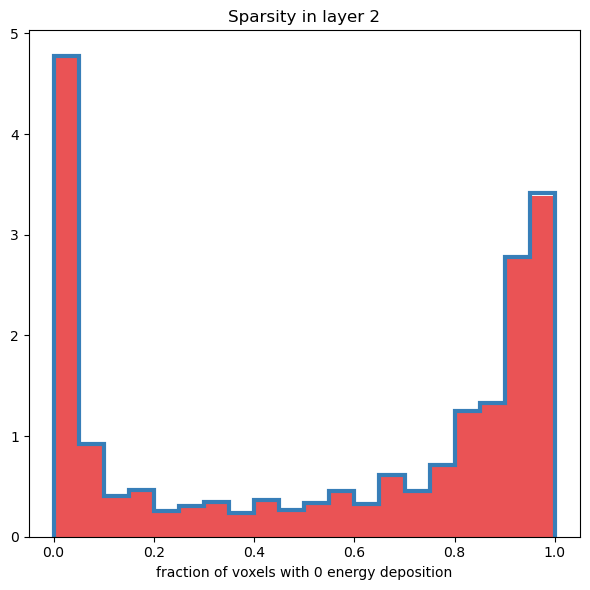

Separation power of Sparsity layer 3 histogram: 8.899260766002992e-06


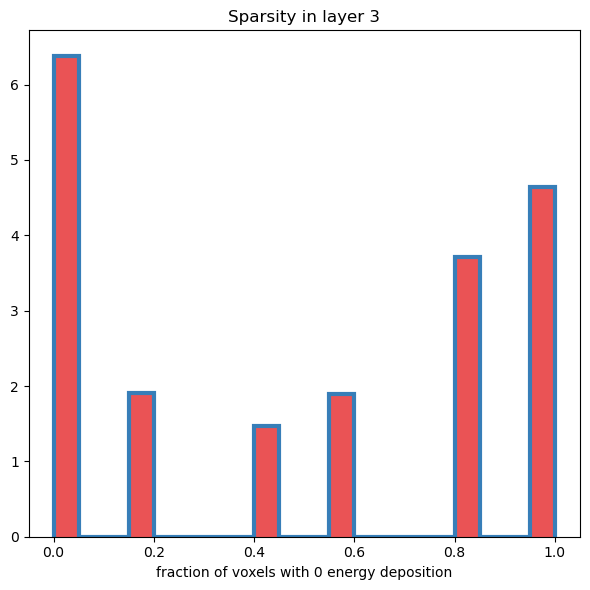

Separation power of Sparsity layer 12 histogram: 8.222219910149788e-05


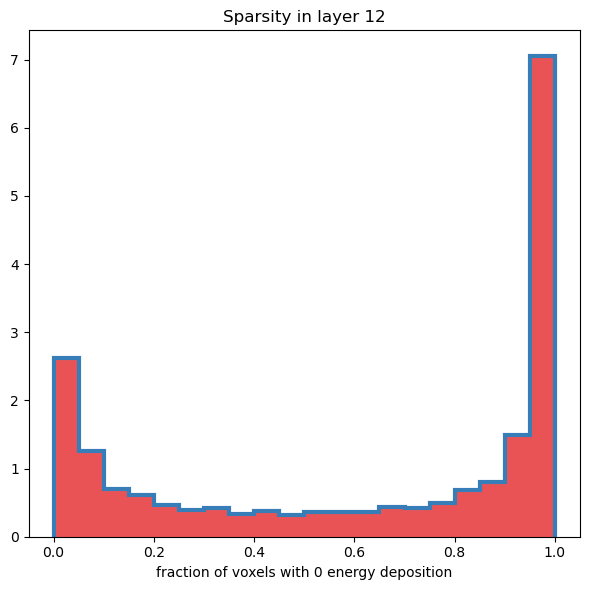

Separation power of Sparsity layer 13 histogram: 9.243309591325705e-05


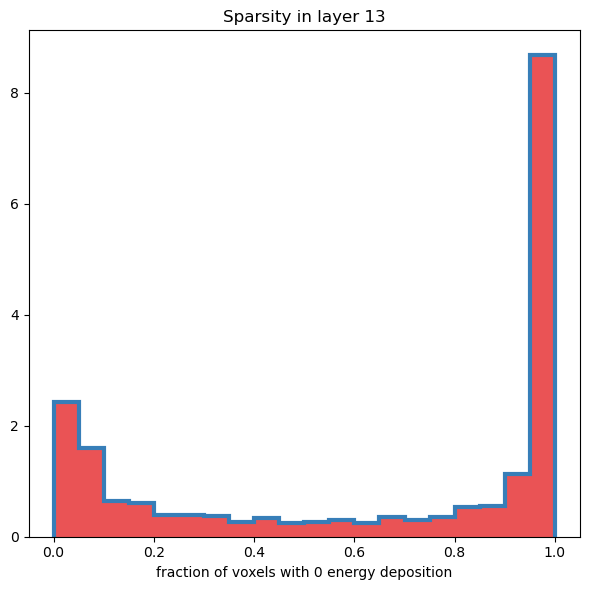

Separation power of Sparsity layer 14 histogram: 2.1262520048925917e-05


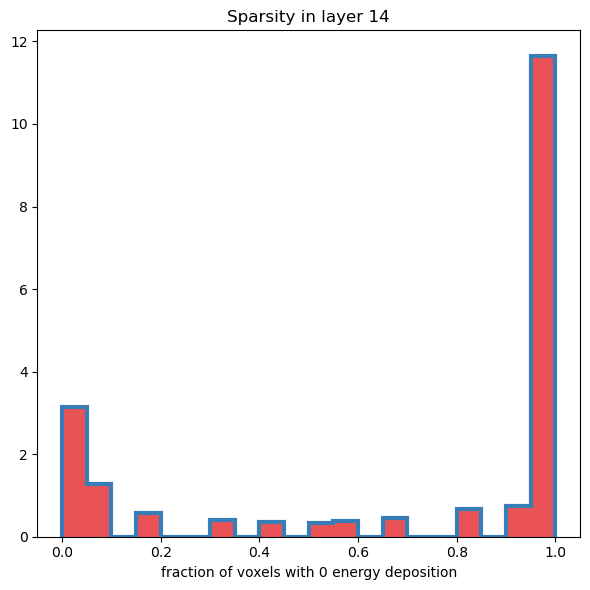

Separation power of EC r layer 0 histogram: 0.00035450373562166785


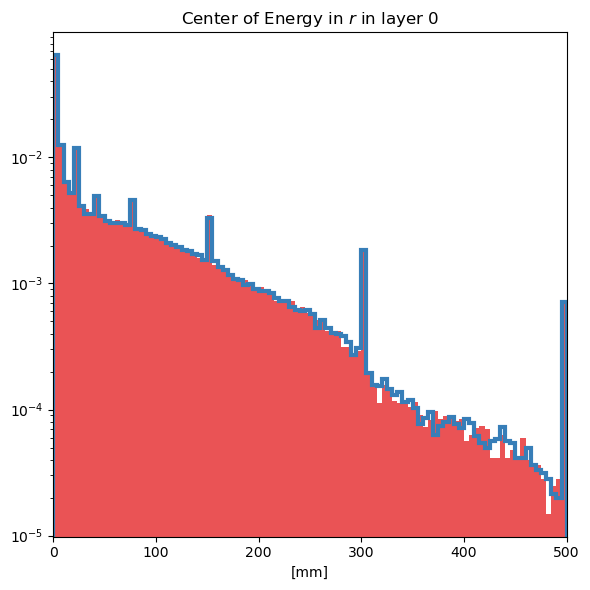

Separation power of EC r layer 1 histogram: 0.00014190541859189848


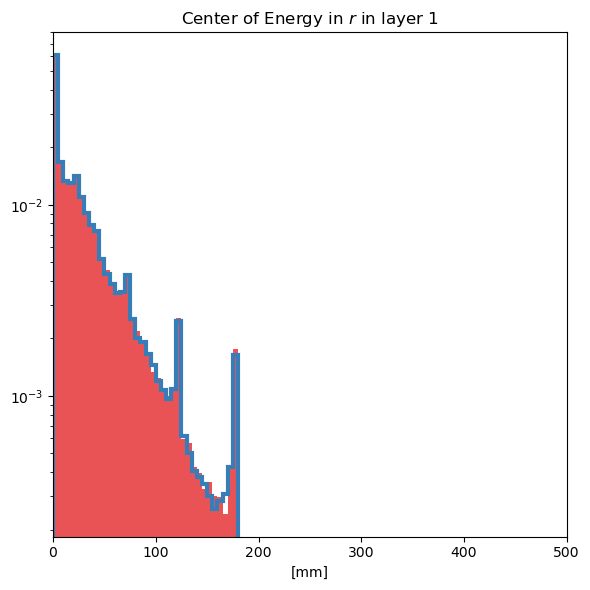

Separation power of EC r layer 2 histogram: 0.0002308242656885203


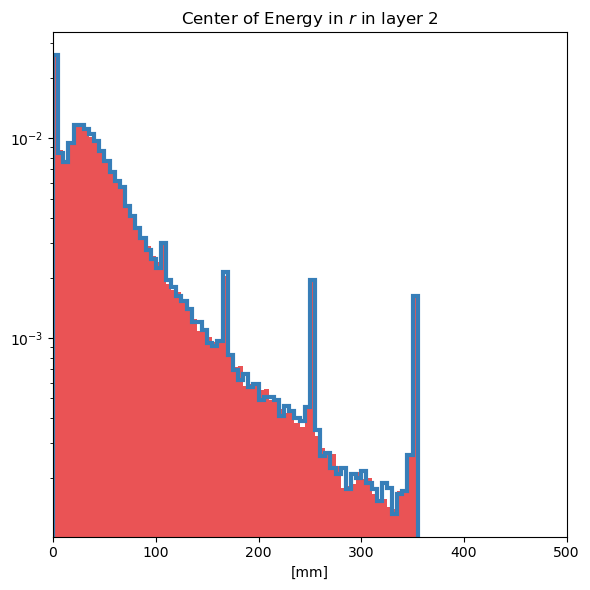

Separation power of EC r layer 3 histogram: 0.00040818567220011646


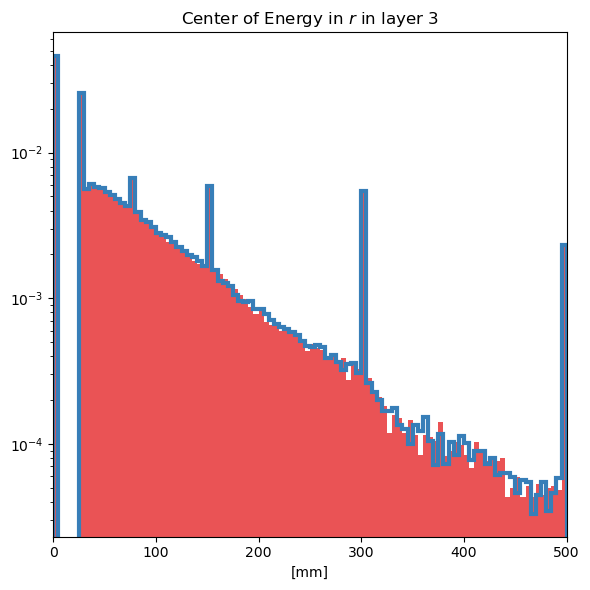

Separation power of EC r layer 12 histogram: 0.0004031259715607464


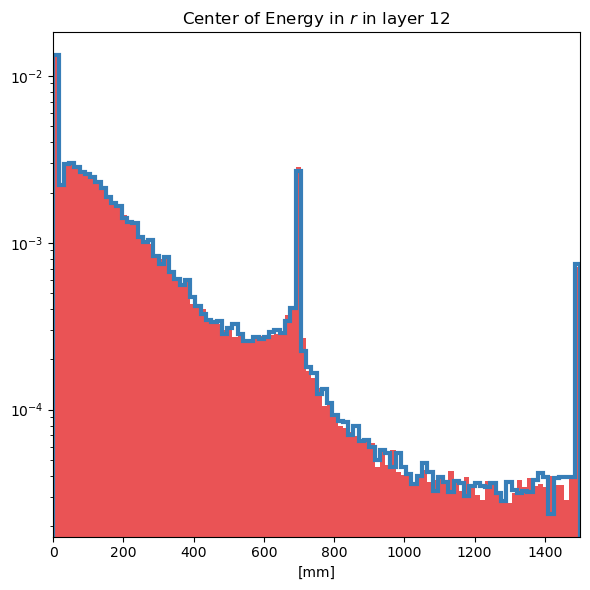

Separation power of EC r layer 13 histogram: 0.0005476533367672986


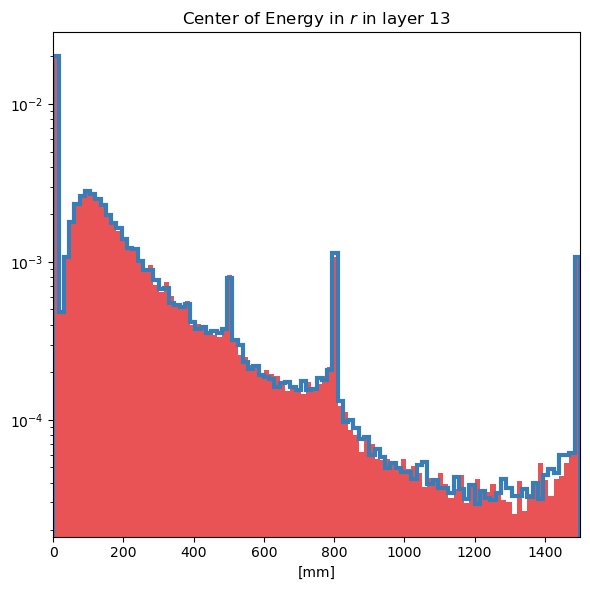

Separation power of EC r layer 14 histogram: 0.00036847674274004624


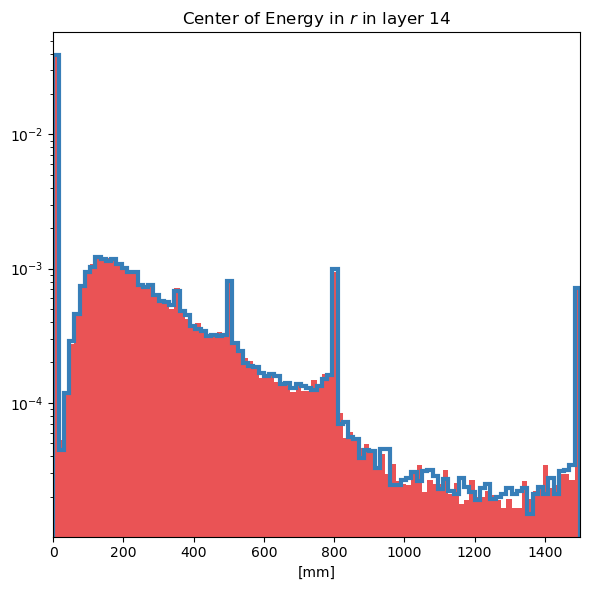

Separation power of Width r layer 0 histogram: 0.0001756662740013481


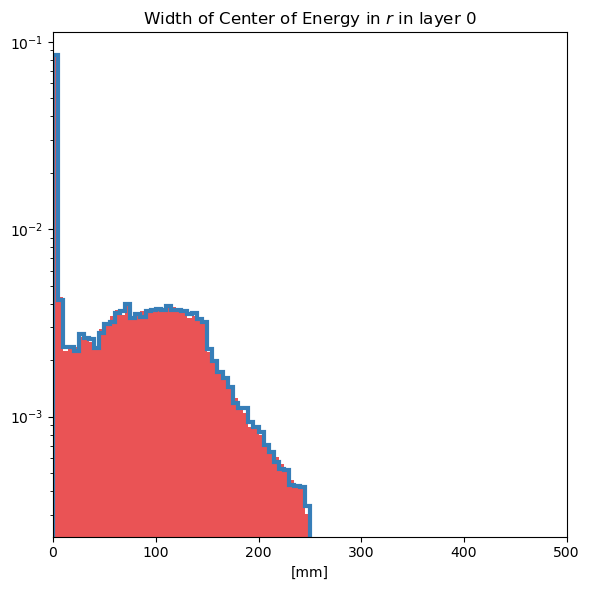

Separation power of Width r layer 1 histogram: 7.577803627808032e-05


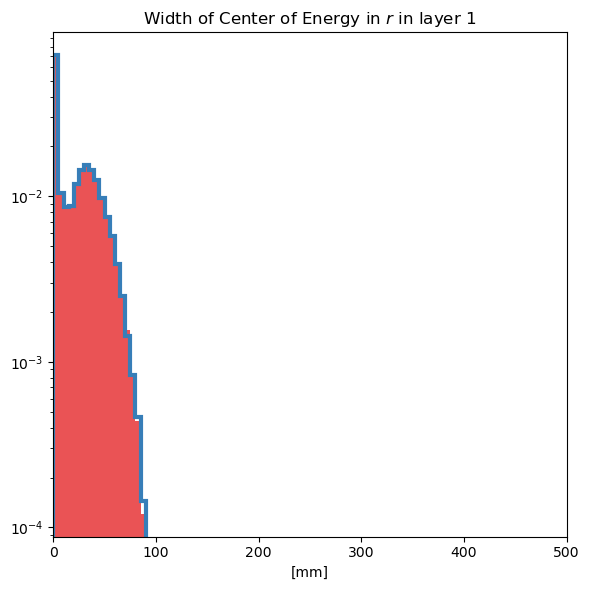

Separation power of Width r layer 2 histogram: 0.00014229473947108972


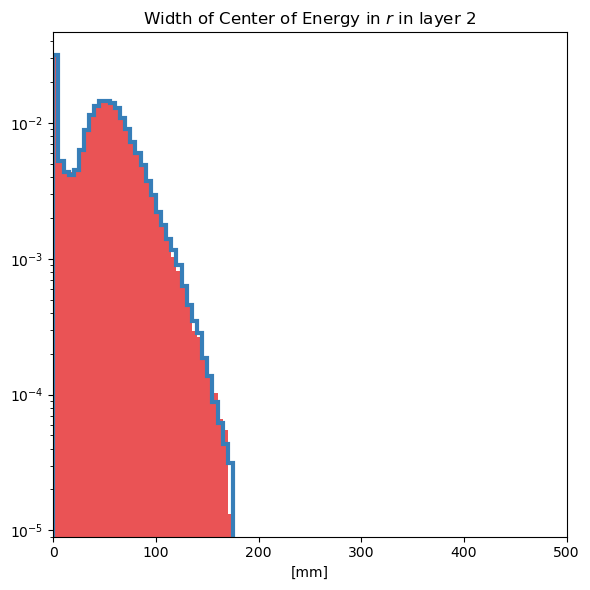

Separation power of Width r layer 3 histogram: 0.0002039794147018368


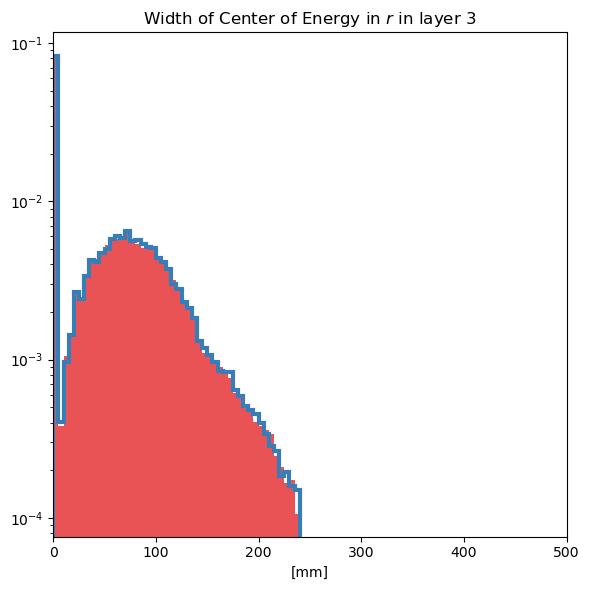

Separation power of Width r layer 12 histogram: 0.00021687755107029284


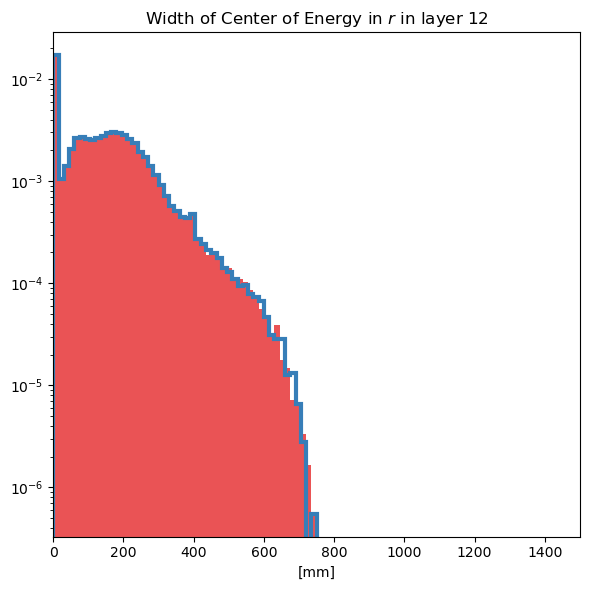

Separation power of Width r layer 13 histogram: 0.0002279609606650436


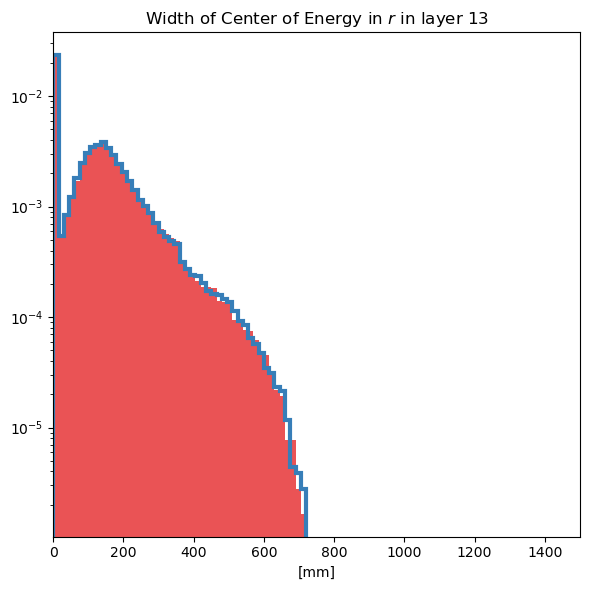

Separation power of Width r layer 14 histogram: 0.0001489419110698193


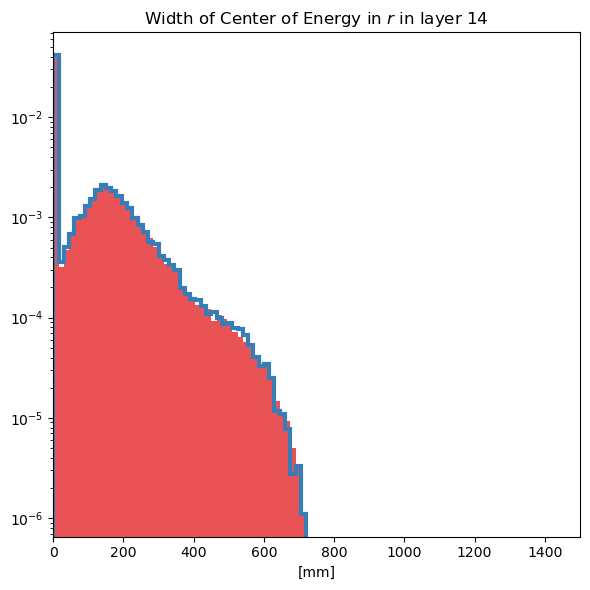

Separation power of voxel distribution histogram: 4.314599807336363e-06


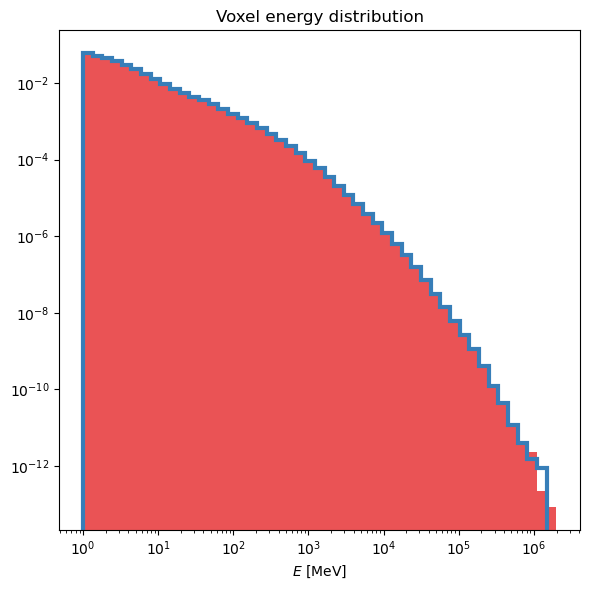

Separation power of Etot / Einc histogram: 0.00040768701744719283


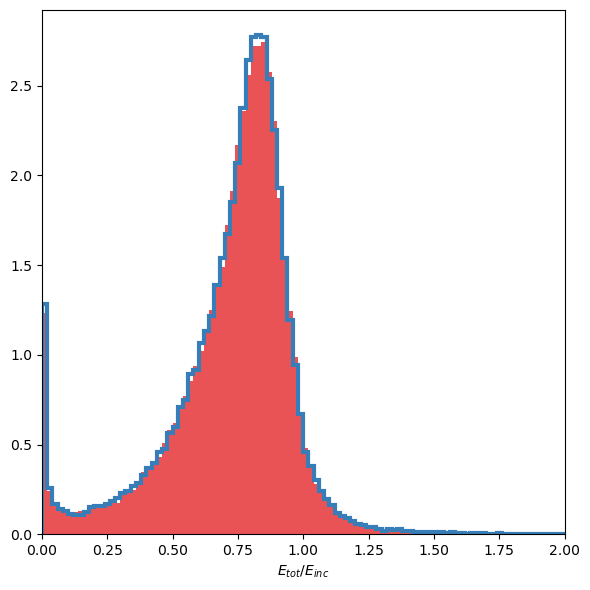

in iteration 6 of 10
Separation power of E layer 0 histogram: 0.0001486763161881131


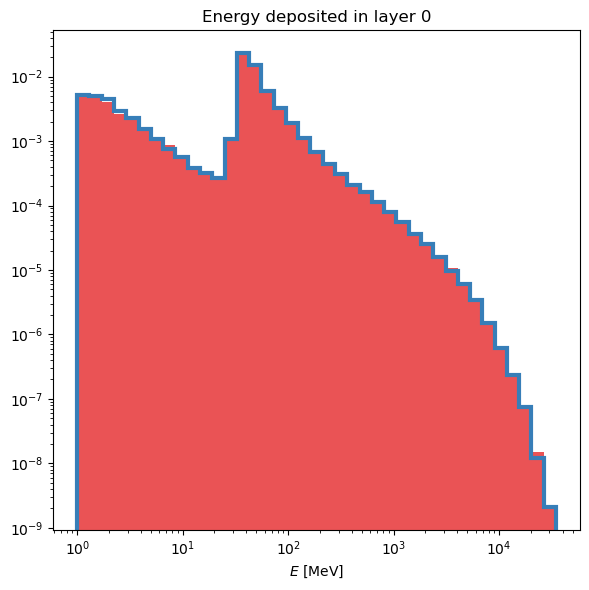

Separation power of E layer 1 histogram: 0.00014882487811309332


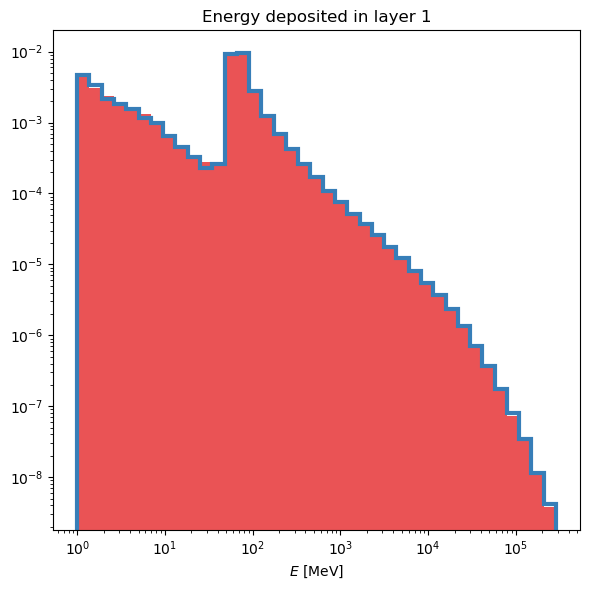

Separation power of E layer 2 histogram: 8.671558135761606e-05


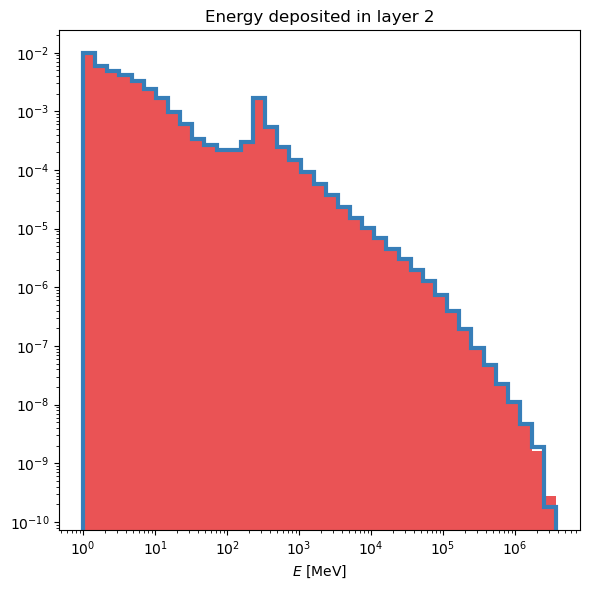

Separation power of E layer 3 histogram: 0.0001946767702928411


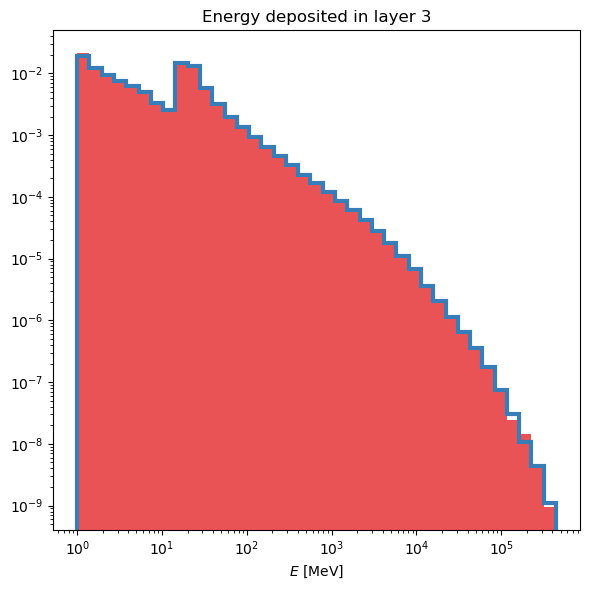

Separation power of E layer 12 histogram: 0.0001657722078410842


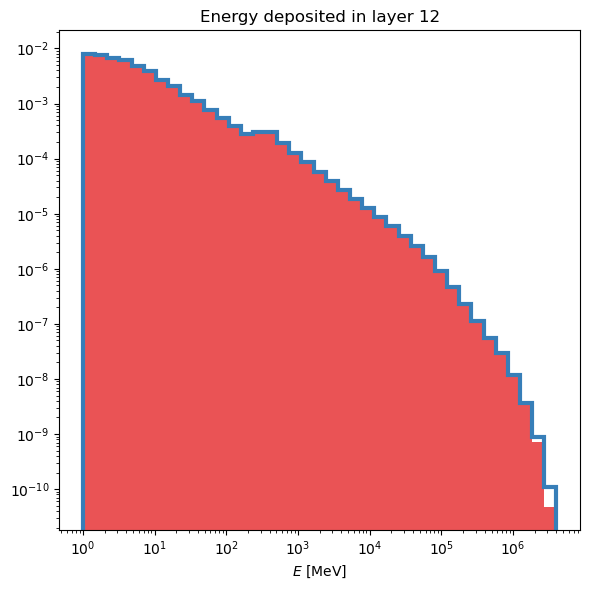

Separation power of E layer 13 histogram: 0.0002170748314677737


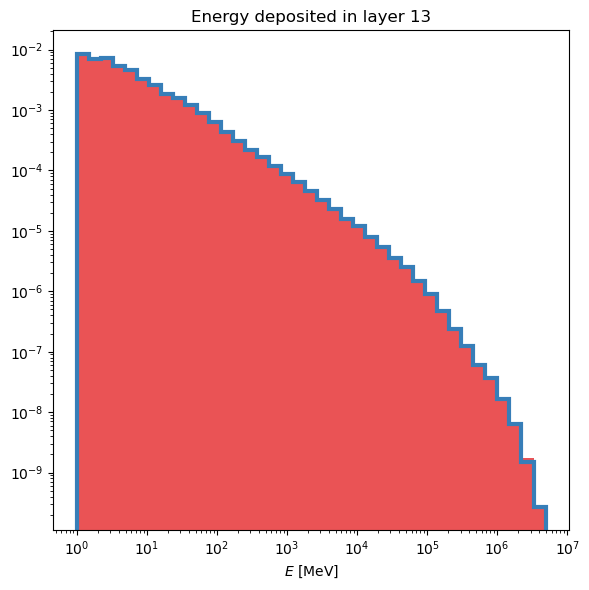

Separation power of E layer 14 histogram: 0.00022364094423563753


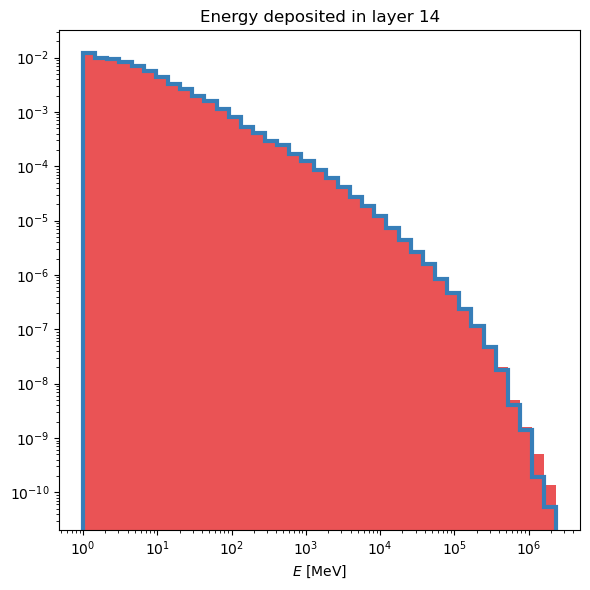

Separation power of EC Eta layer 1 histogram: 0.00044040039645753073


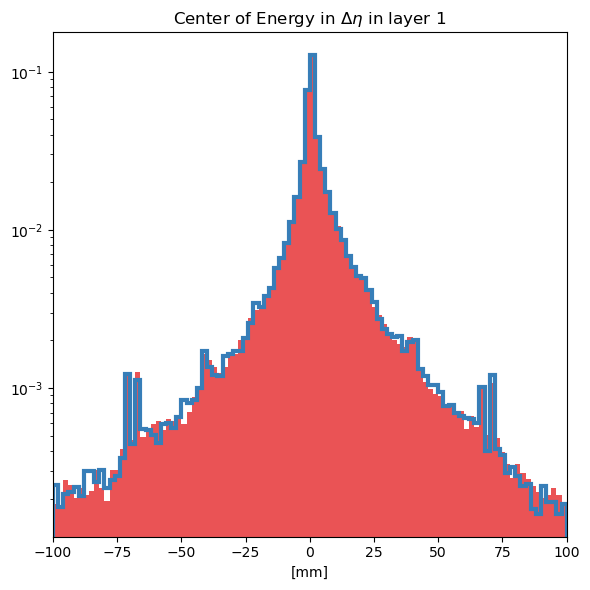

Separation power of EC Eta layer 2 histogram: 0.0003060469553457546


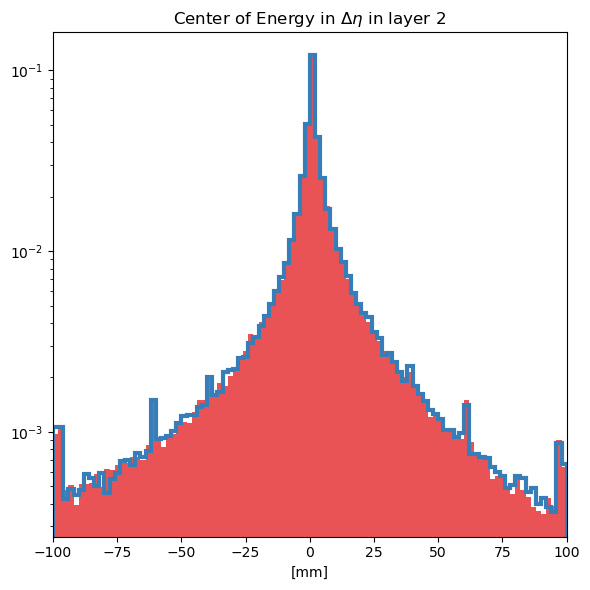

Separation power of EC Eta layer 12 histogram: 0.0005364701608413878


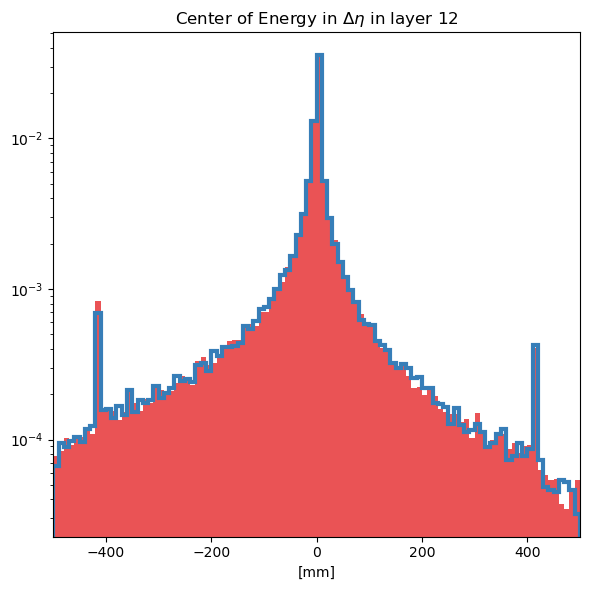

Separation power of EC Eta layer 13 histogram: 0.0003180401445976441


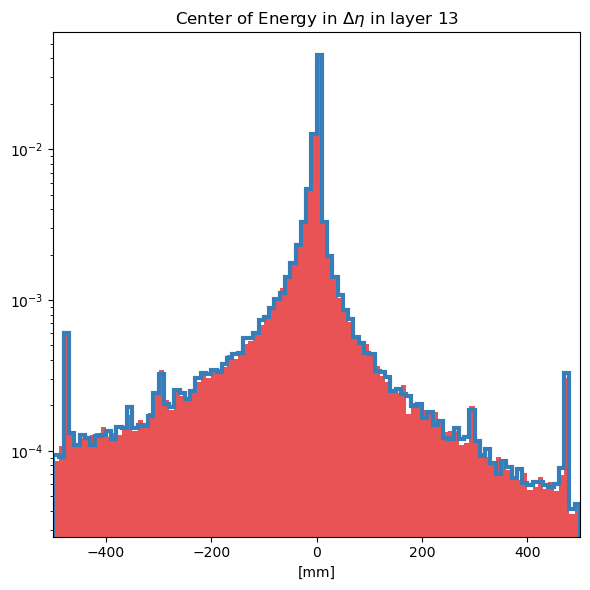

Separation power of EC Phi layer 1 histogram: 0.00038810373733490634


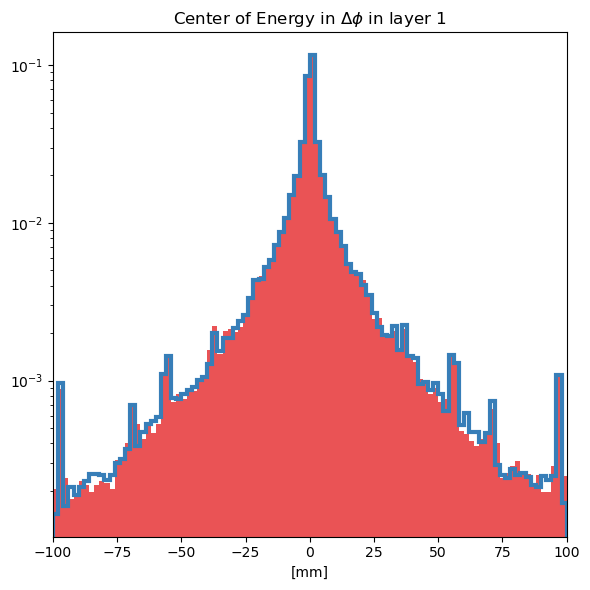

Separation power of EC Phi layer 2 histogram: 0.0004383126935885072


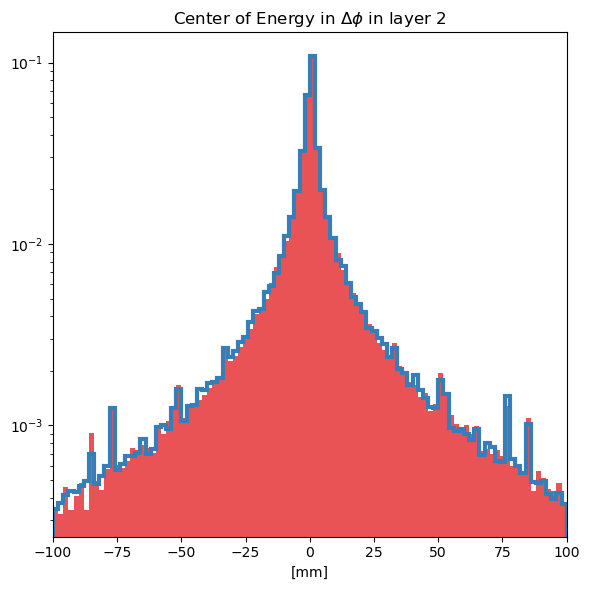

Separation power of EC Phi layer 12 histogram: 0.00030766991270956385


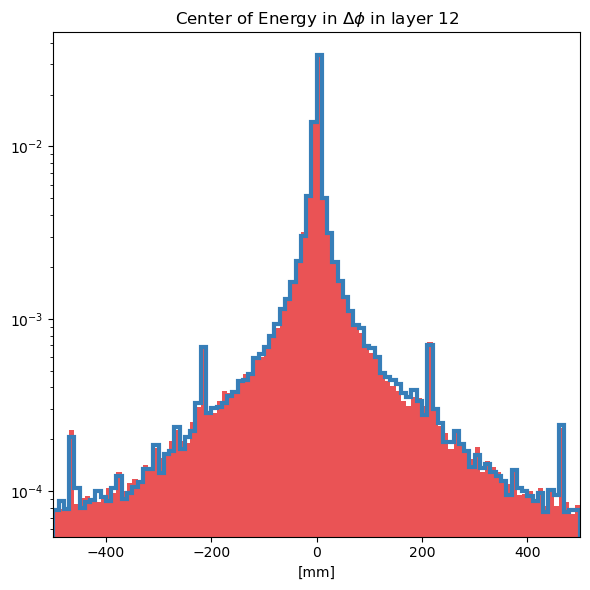

Separation power of EC Phi layer 13 histogram: 0.0003247303921486156


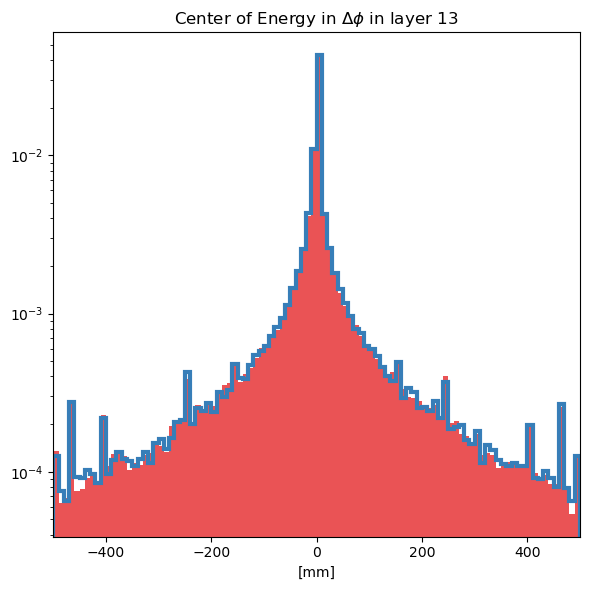

Separation power of Width Eta layer 1 histogram: 0.00038761041059997057


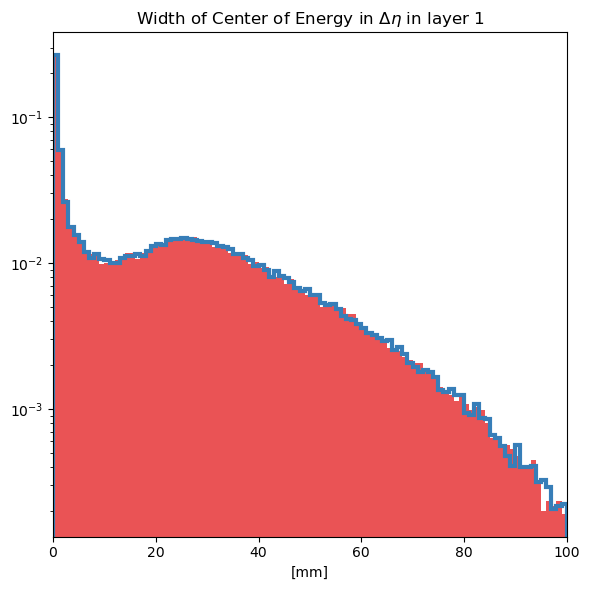

Separation power of Width Eta layer 2 histogram: 0.0005199549906029664


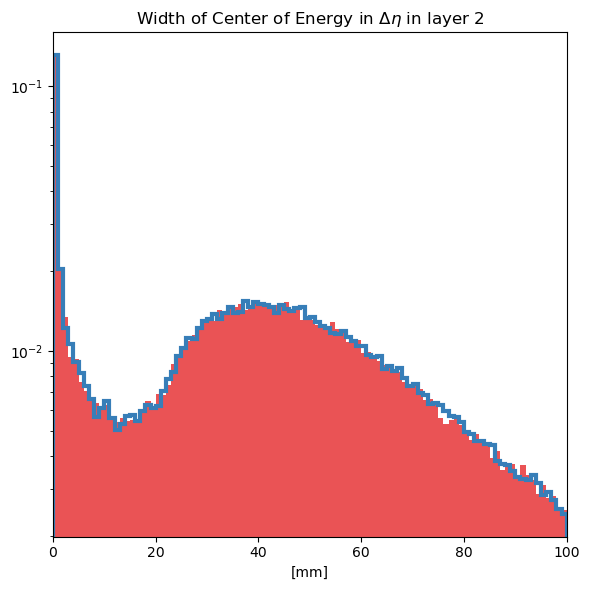

Separation power of Width Eta layer 12 histogram: 0.00041906554160813756


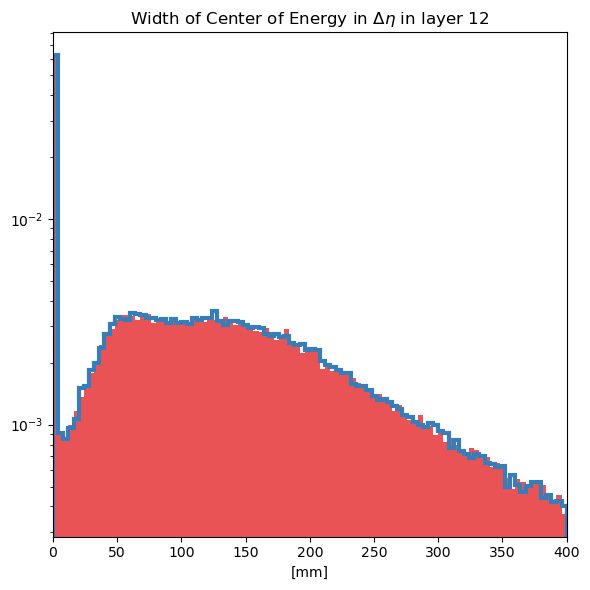

Separation power of Width Eta layer 13 histogram: 0.0005335681646240649


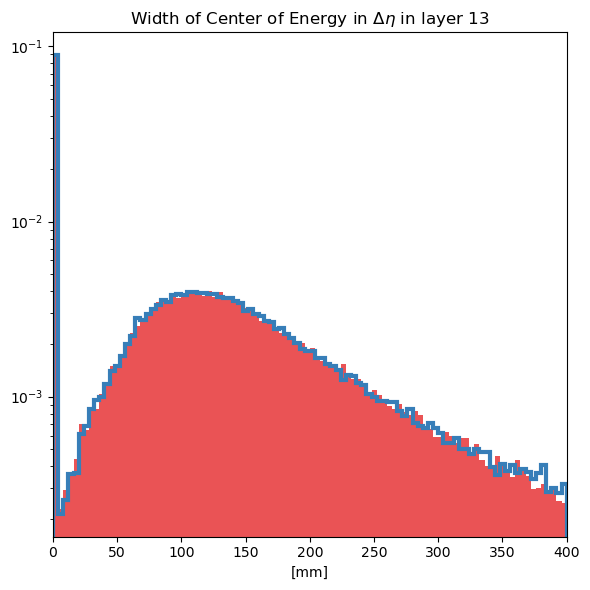

Separation power of Width Phi layer 1 histogram: 0.00048633252236028054


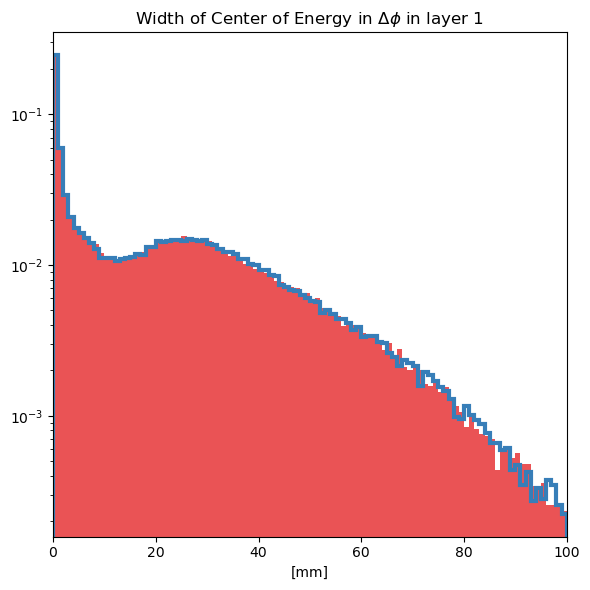

Separation power of Width Phi layer 2 histogram: 0.00041822746122251457


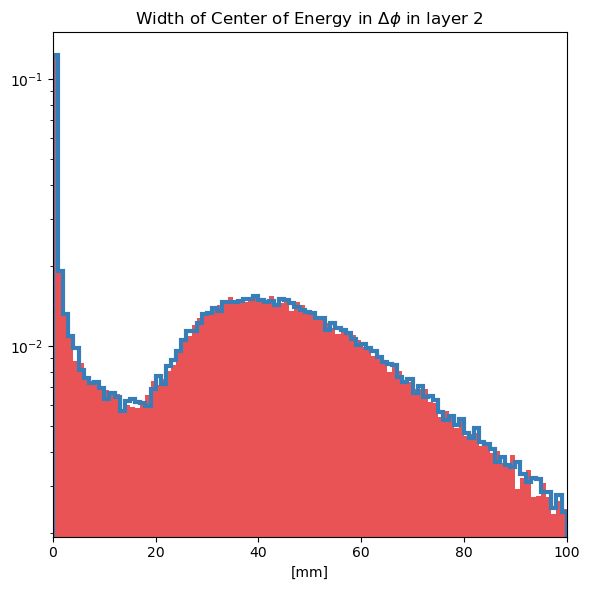

Separation power of Width Phi layer 12 histogram: 0.00035474345258363385


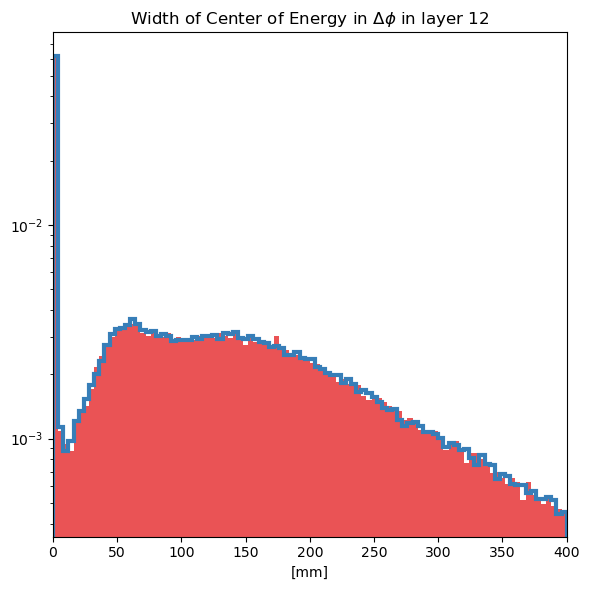

Separation power of Width Phi layer 13 histogram: 0.0003728315130646269


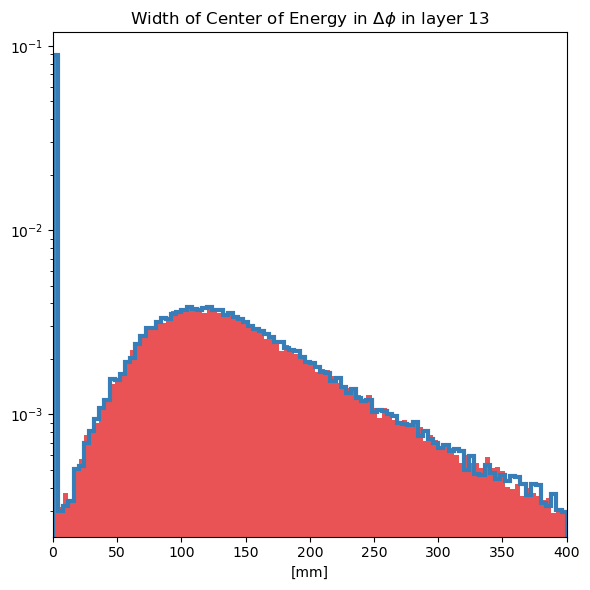

Separation power of Sparsity layer 0 histogram: 2.1416653492770446e-05


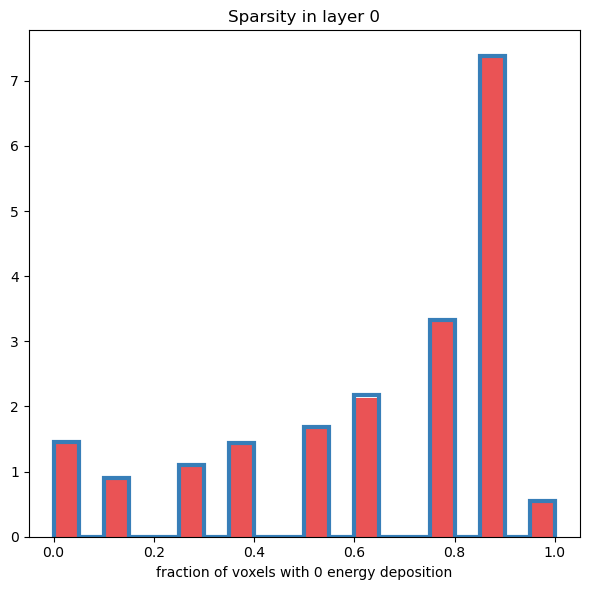

Separation power of Sparsity layer 1 histogram: 5.616273129507159e-05


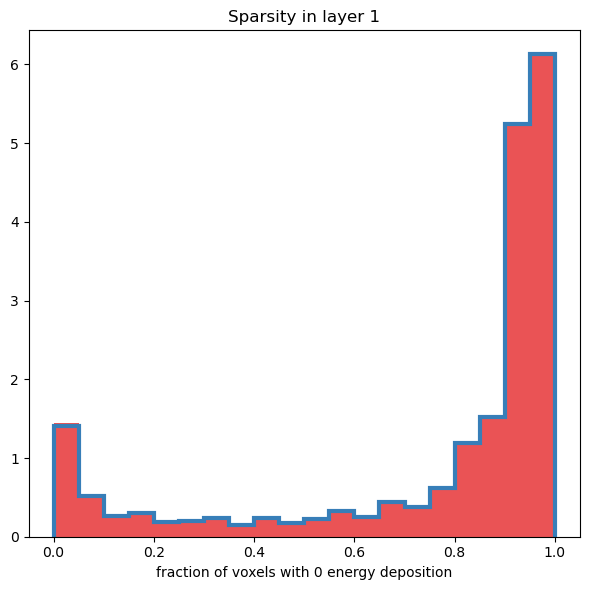

Separation power of Sparsity layer 2 histogram: 0.00012668260651357898


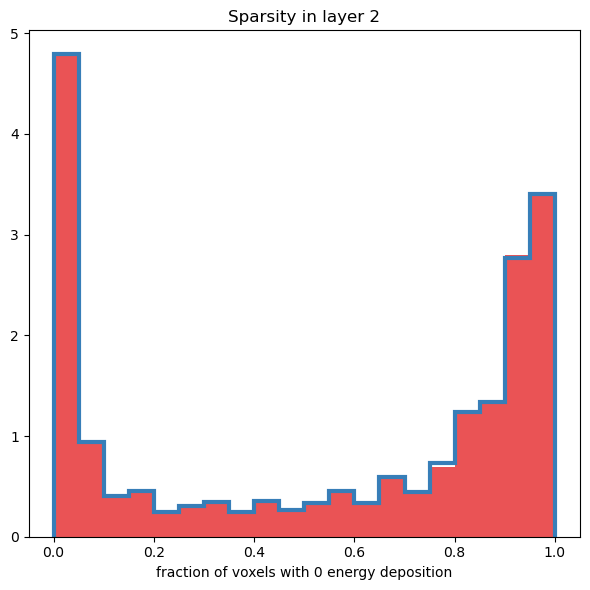

Separation power of Sparsity layer 3 histogram: 8.283657068214918e-06


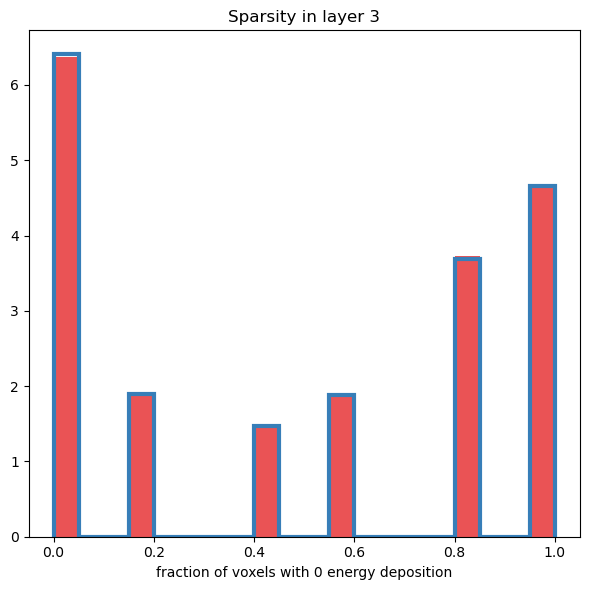

Separation power of Sparsity layer 12 histogram: 0.00011114395465149756


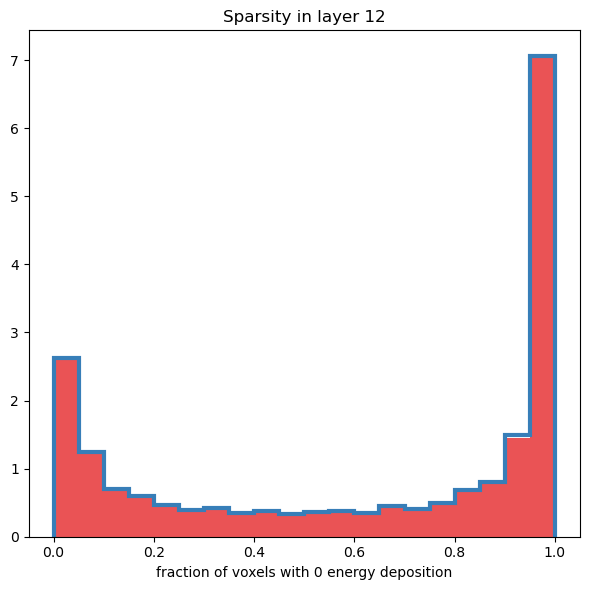

Separation power of Sparsity layer 13 histogram: 7.658437187513004e-05


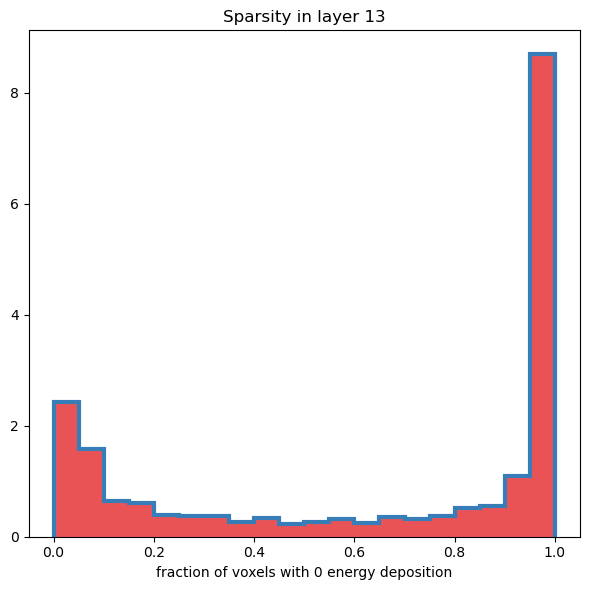

Separation power of Sparsity layer 14 histogram: 8.164017691273509e-06


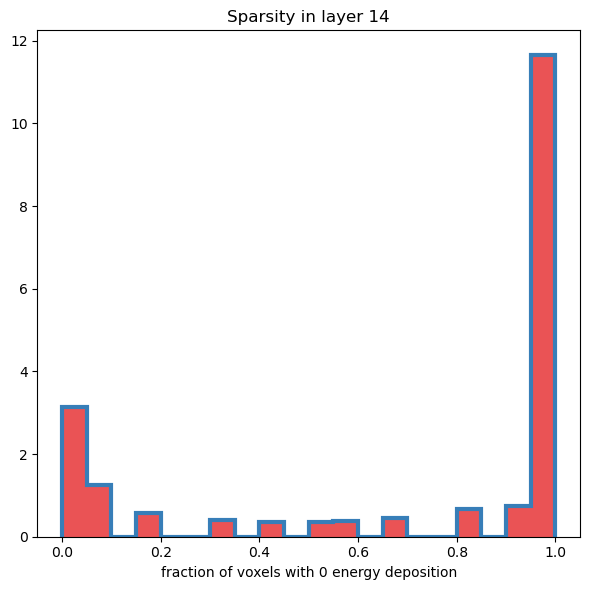

Separation power of EC r layer 0 histogram: 0.0003685502175014427


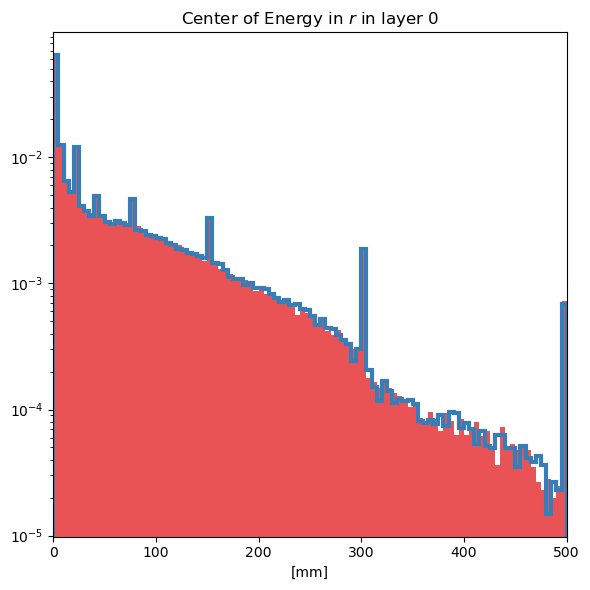

Separation power of EC r layer 1 histogram: 0.0001248790034169623


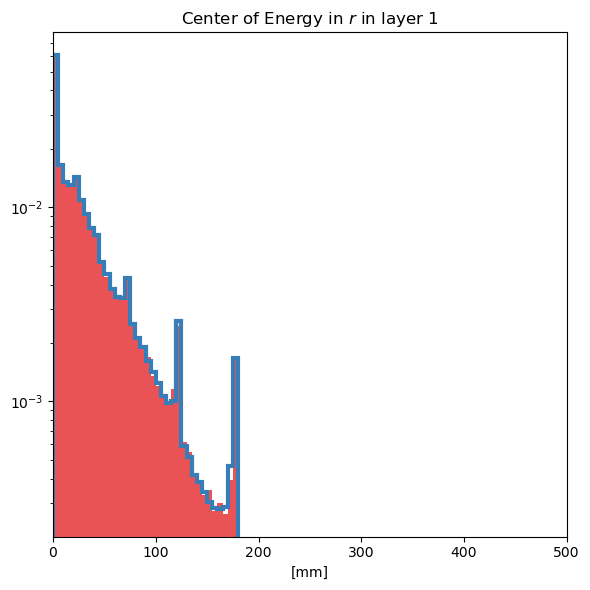

Separation power of EC r layer 2 histogram: 0.00022045150771710247


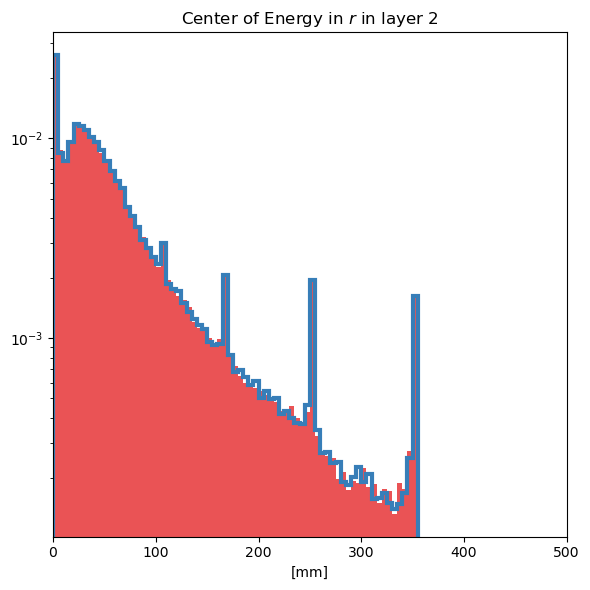

Separation power of EC r layer 3 histogram: 0.00042252666168655093


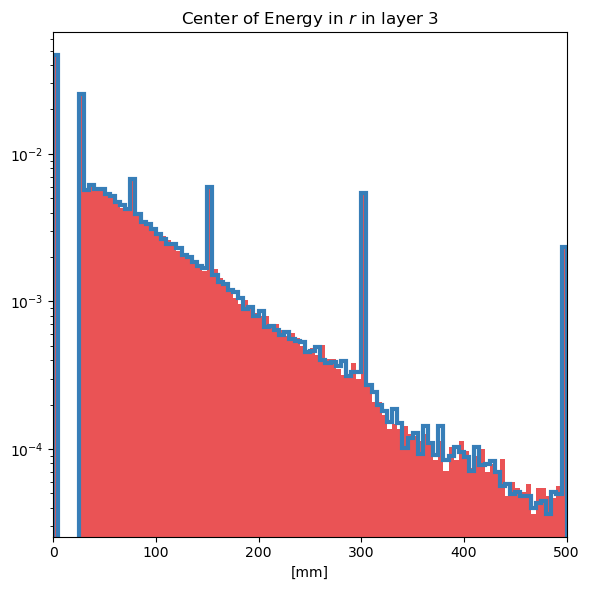

Separation power of EC r layer 12 histogram: 0.00037206907511075425


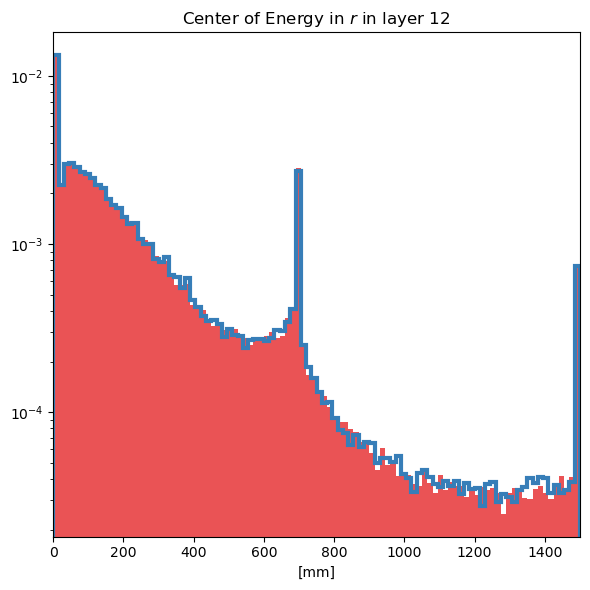

Separation power of EC r layer 13 histogram: 0.0003819227960317905


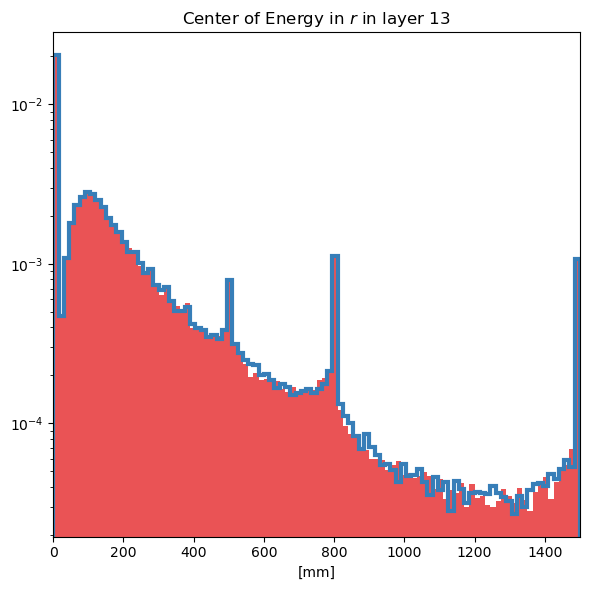

Separation power of EC r layer 14 histogram: 0.00034784921679169333


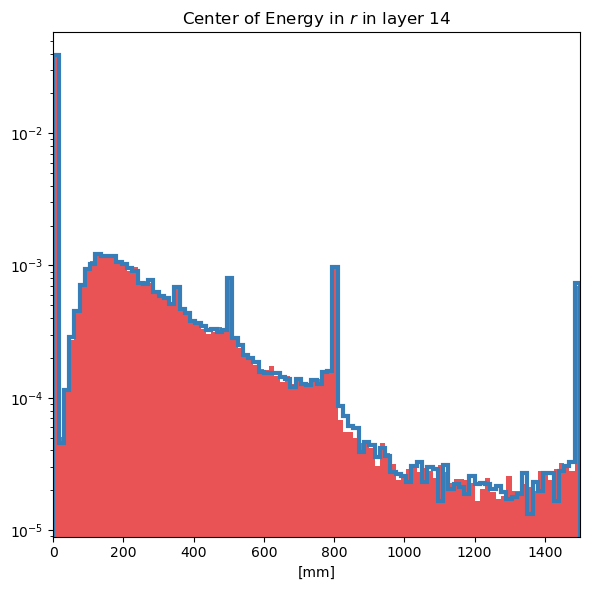

Separation power of Width r layer 0 histogram: 0.0002483231048383855


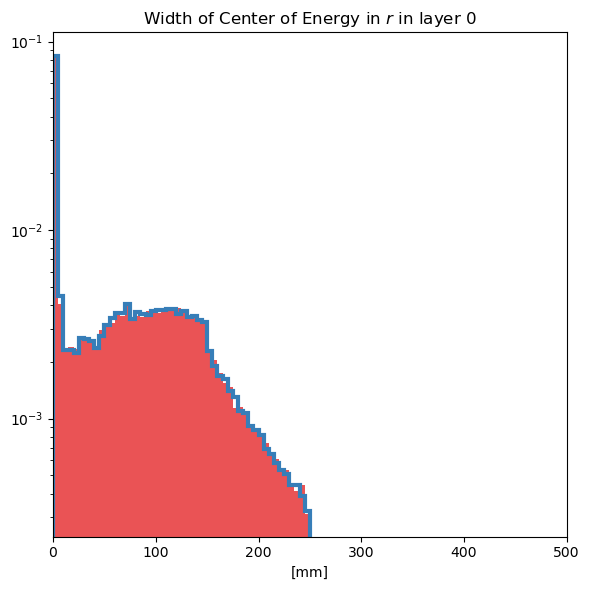

Separation power of Width r layer 1 histogram: 5.85783274214967e-05


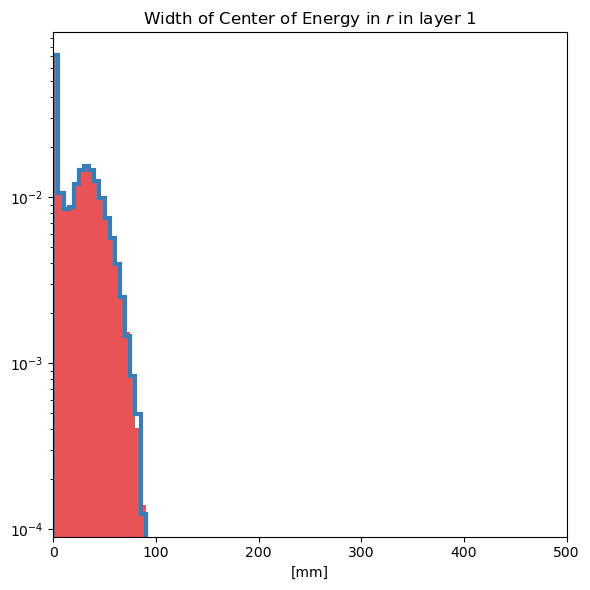

Separation power of Width r layer 2 histogram: 0.00019836675763901788


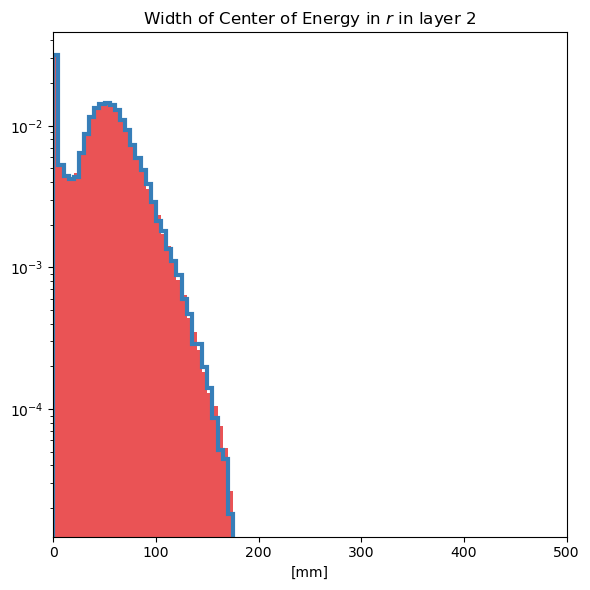

Separation power of Width r layer 3 histogram: 0.0002077696939867401


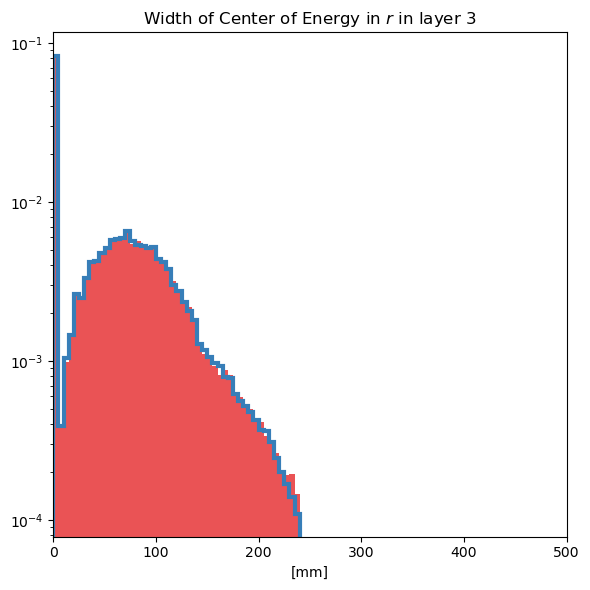

Separation power of Width r layer 12 histogram: 0.00020087090553434588


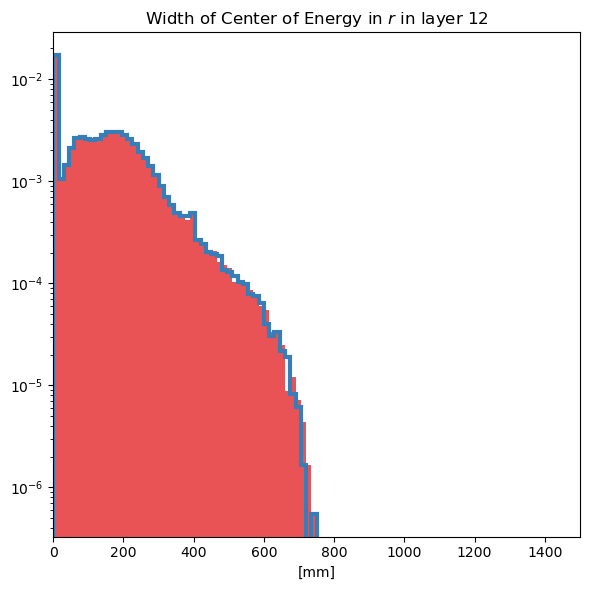

Separation power of Width r layer 13 histogram: 0.0002996484567752977


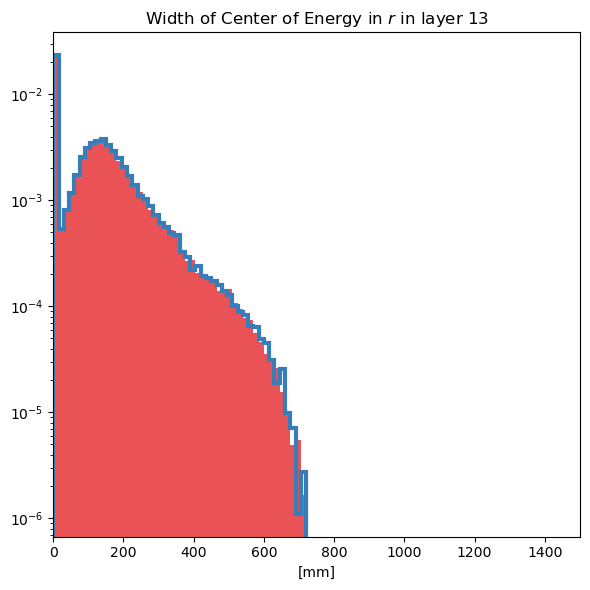

Separation power of Width r layer 14 histogram: 0.0001572539915082629


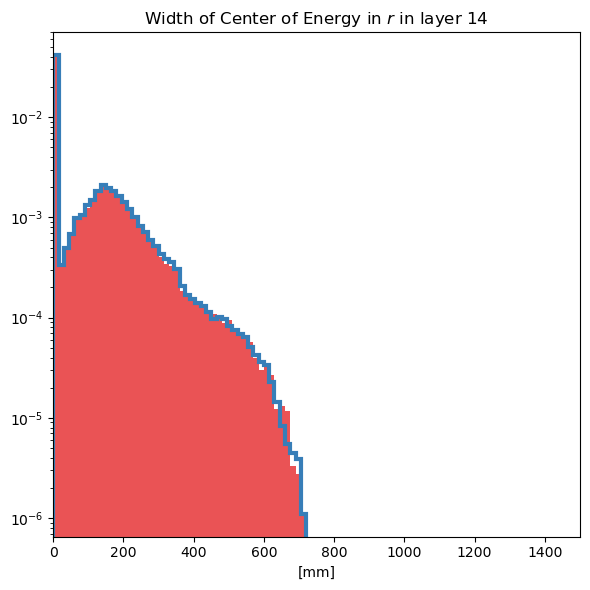

Separation power of voxel distribution histogram: 2.695119210460532e-06


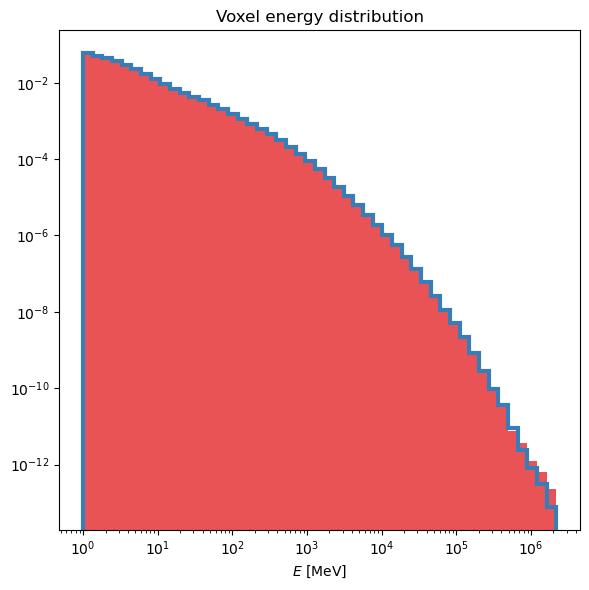

Separation power of Etot / Einc histogram: 0.0003404955029347259


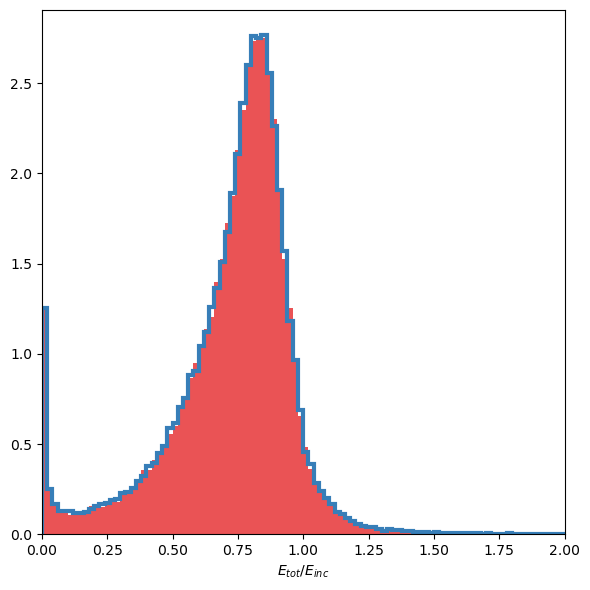

in iteration 7 of 10
Separation power of E layer 0 histogram: 0.00019764018779375747


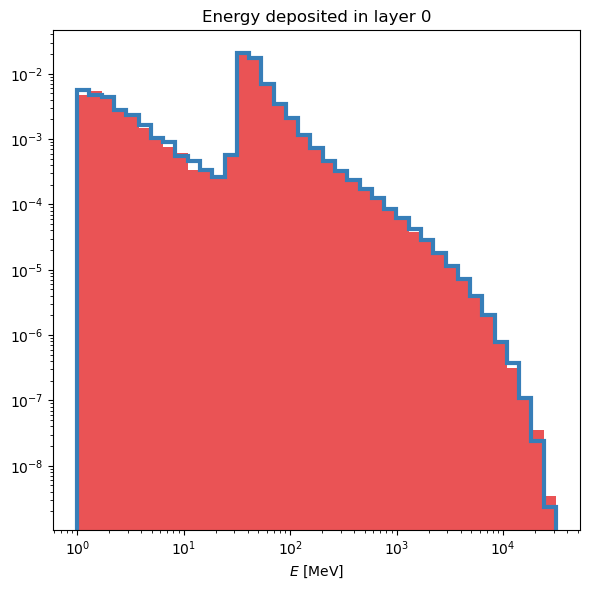

Separation power of E layer 1 histogram: 0.0001238884768084099


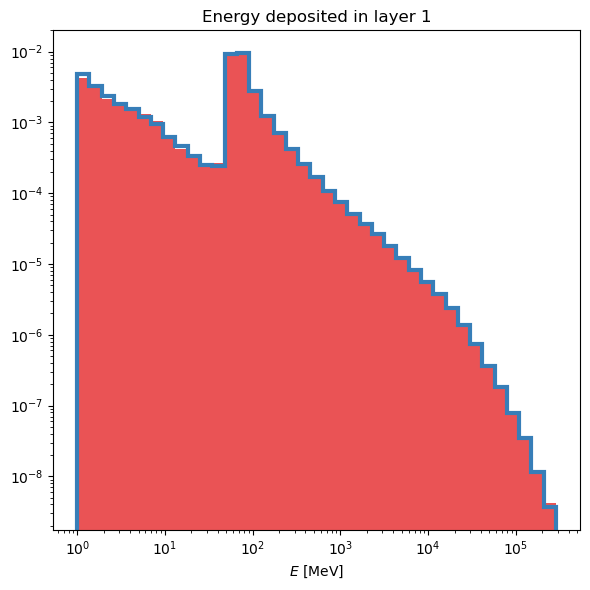

Separation power of E layer 2 histogram: 0.00011416072447500252


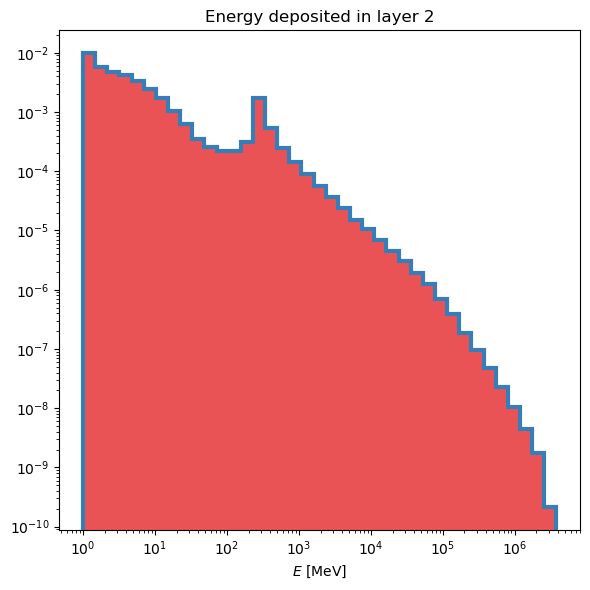

Separation power of E layer 3 histogram: 0.00012751546715818112


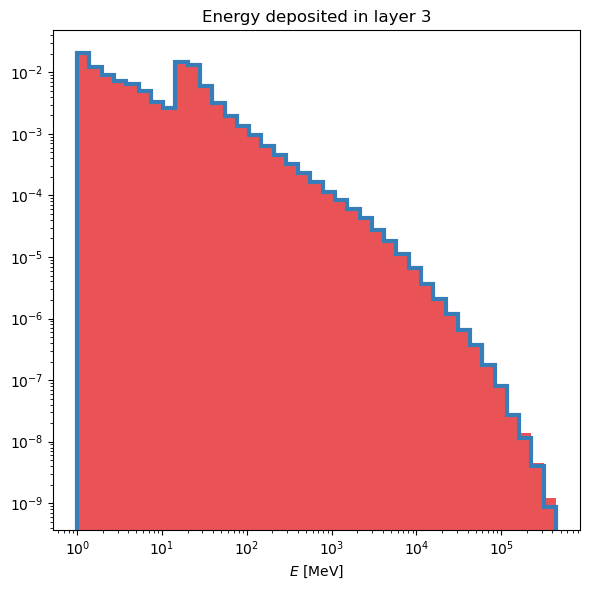

Separation power of E layer 12 histogram: 0.00019270119851673775


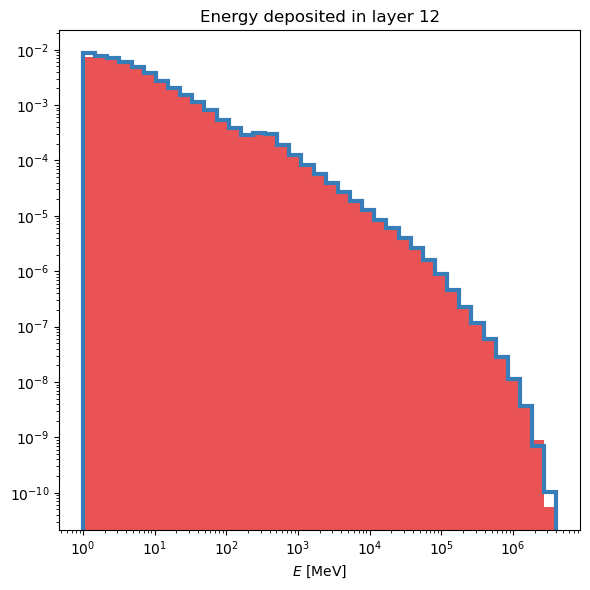

Separation power of E layer 13 histogram: 0.00011672954288772754


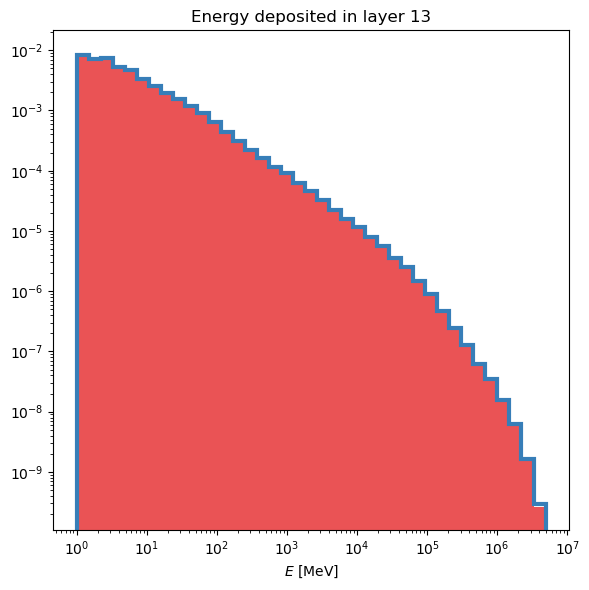

Separation power of E layer 14 histogram: 0.00040577996970704247


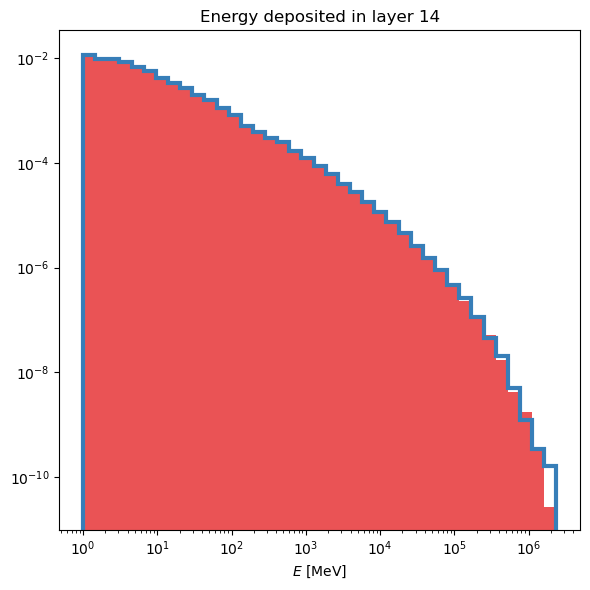

Separation power of EC Eta layer 1 histogram: 0.00038025128953397987


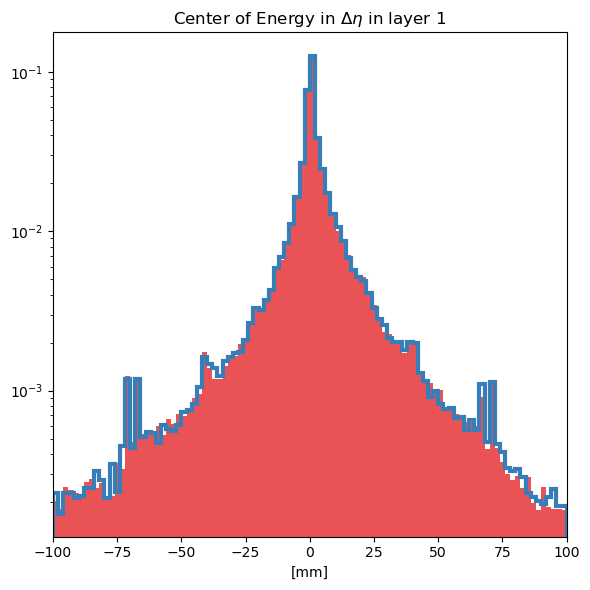

Separation power of EC Eta layer 2 histogram: 0.0003142670456267116


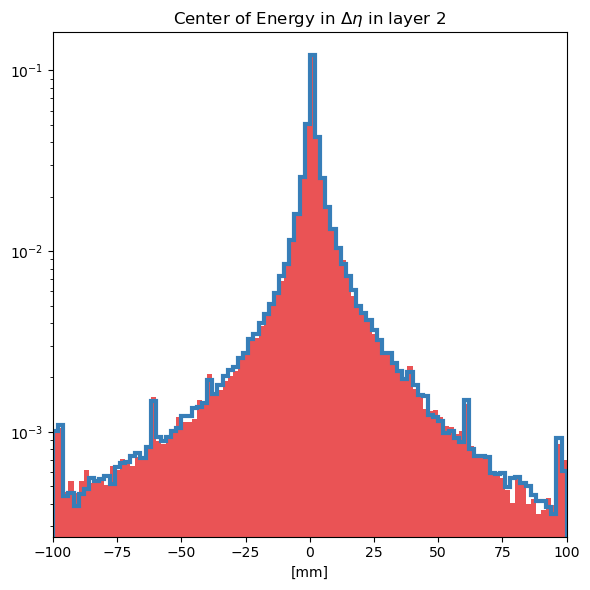

Separation power of EC Eta layer 12 histogram: 0.0005063016683139486


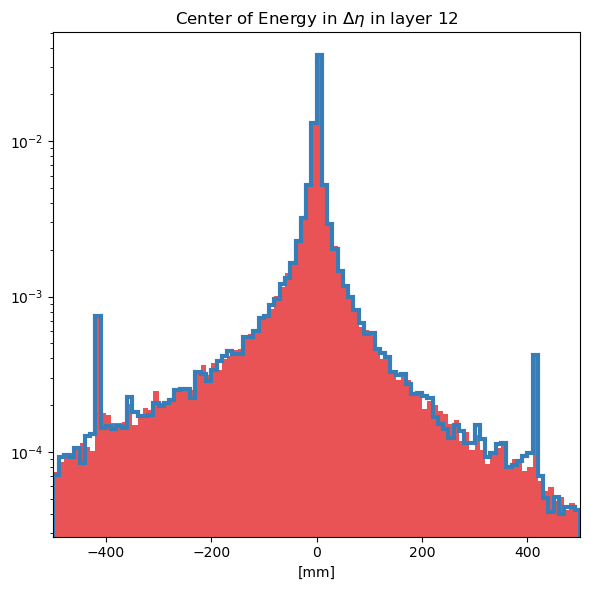

Separation power of EC Eta layer 13 histogram: 0.000438308133684438


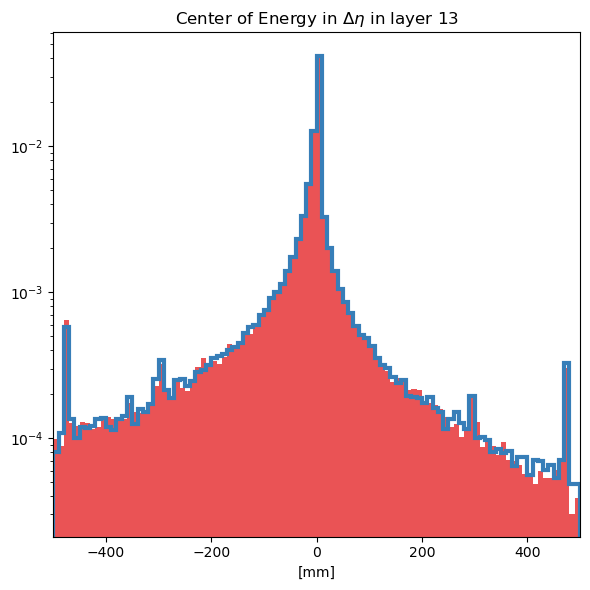

Separation power of EC Phi layer 1 histogram: 0.00040970903169187836


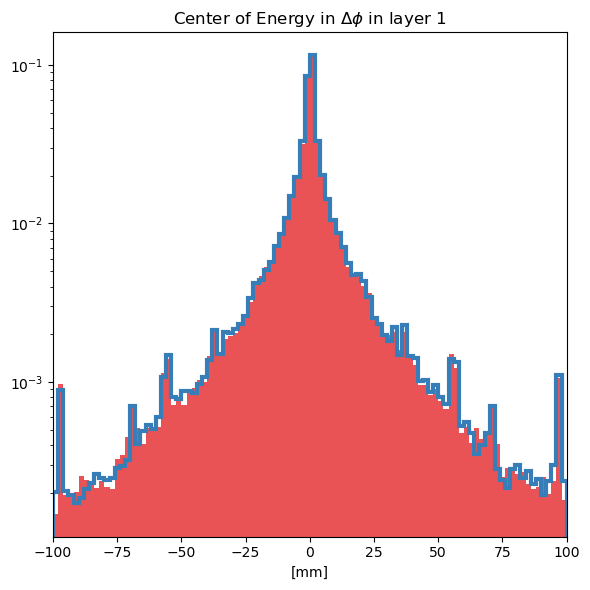

Separation power of EC Phi layer 2 histogram: 0.00044945933518180016


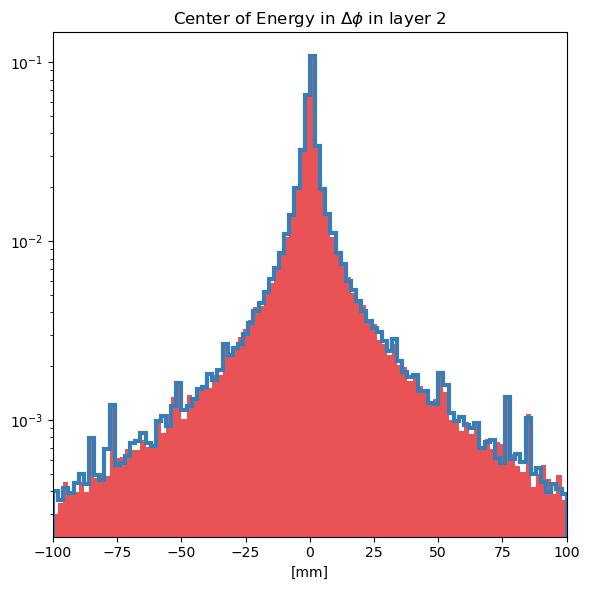

Separation power of EC Phi layer 12 histogram: 0.00036621812570918007


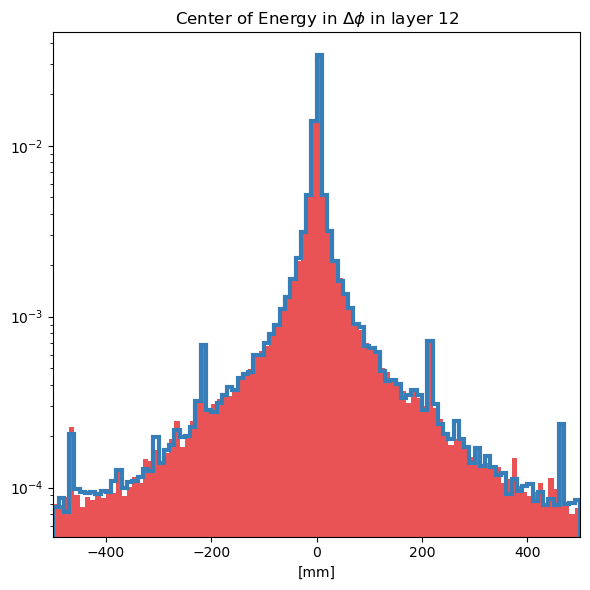

Separation power of EC Phi layer 13 histogram: 0.0003949293963590441


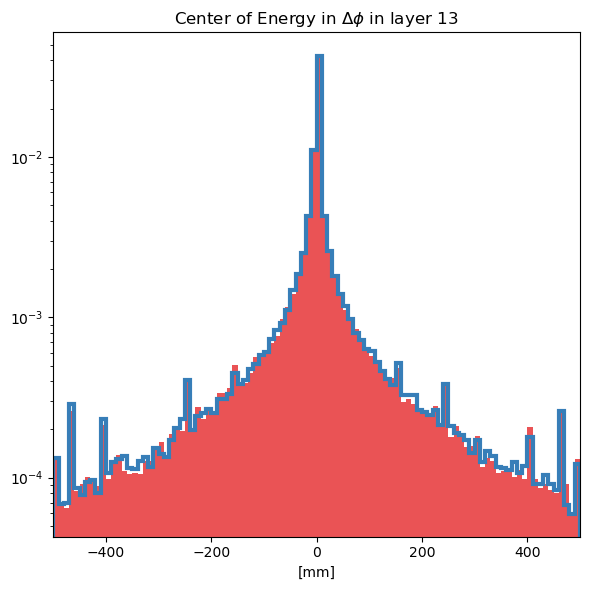

Separation power of Width Eta layer 1 histogram: 0.00034717927501960814


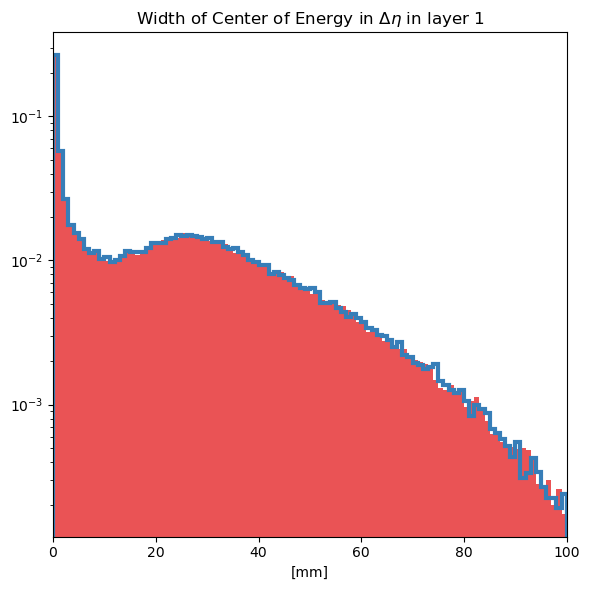

Separation power of Width Eta layer 2 histogram: 0.00036765050790859216


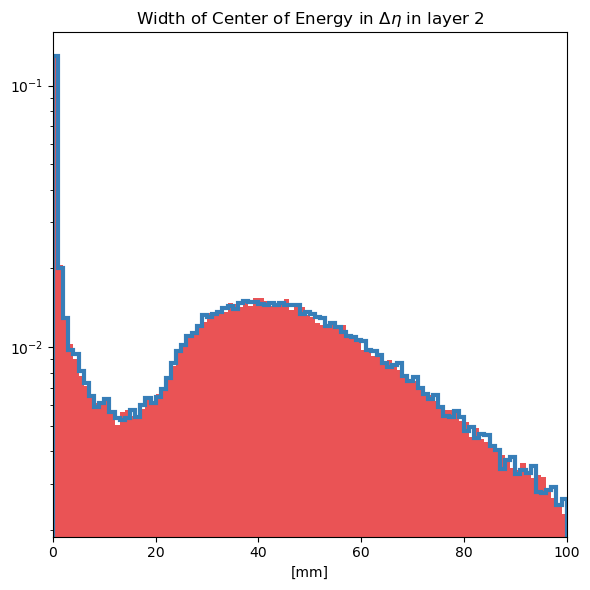

Separation power of Width Eta layer 12 histogram: 0.00038930102846333324


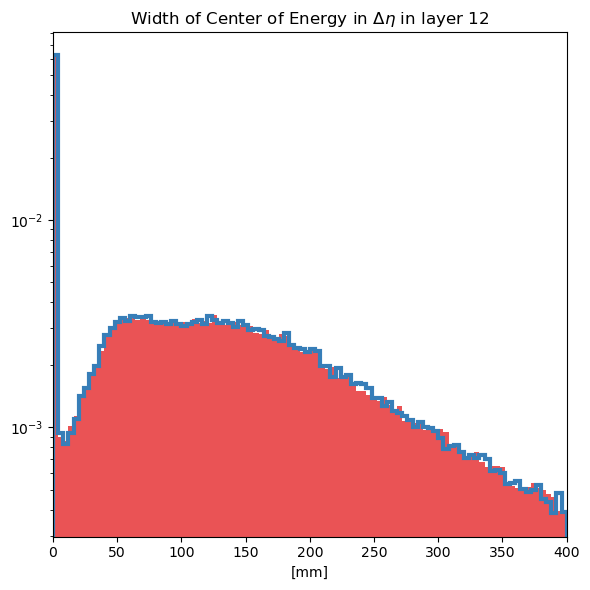

Separation power of Width Eta layer 13 histogram: 0.00039235915603058033


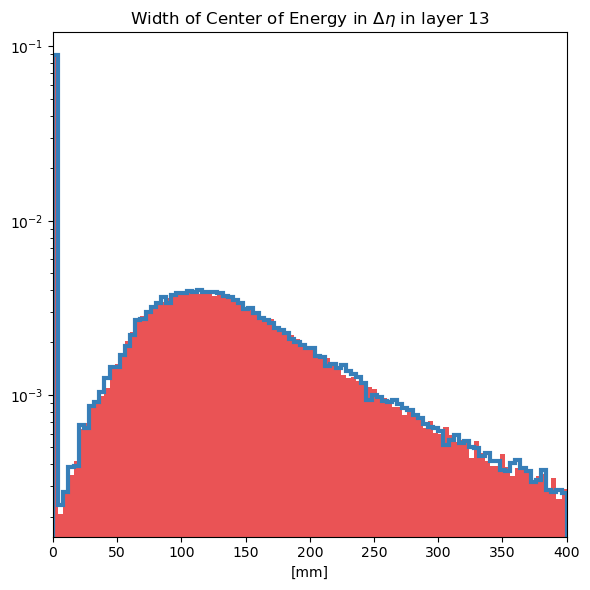

Separation power of Width Phi layer 1 histogram: 0.0006639104767293536


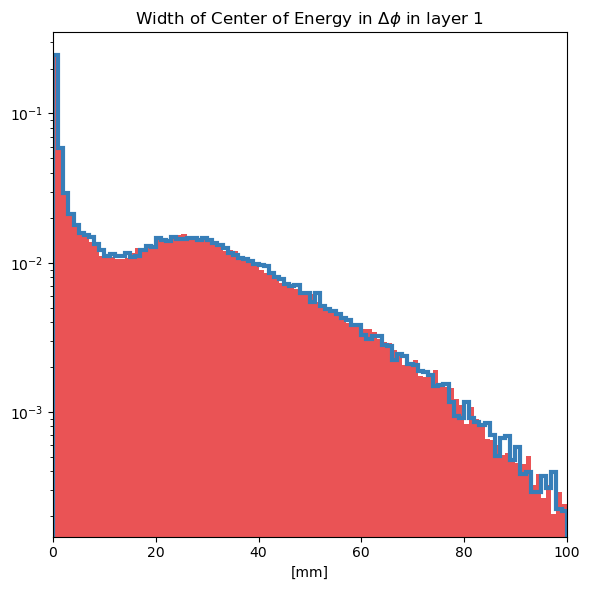

Separation power of Width Phi layer 2 histogram: 0.00048108092408165483


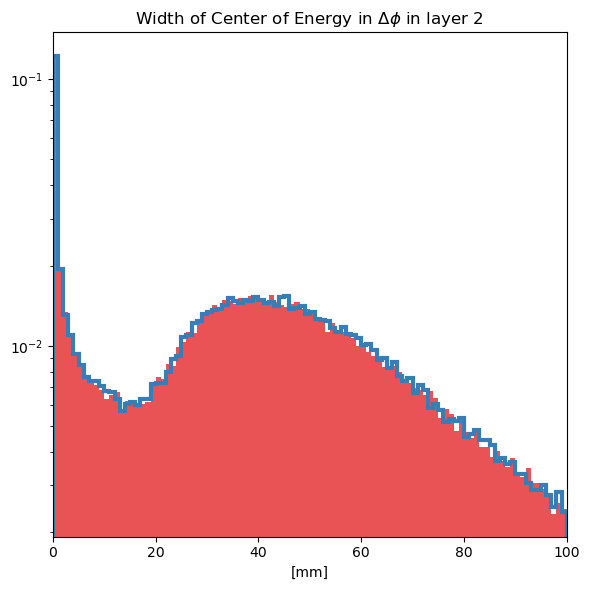

Separation power of Width Phi layer 12 histogram: 0.00036186588508738354


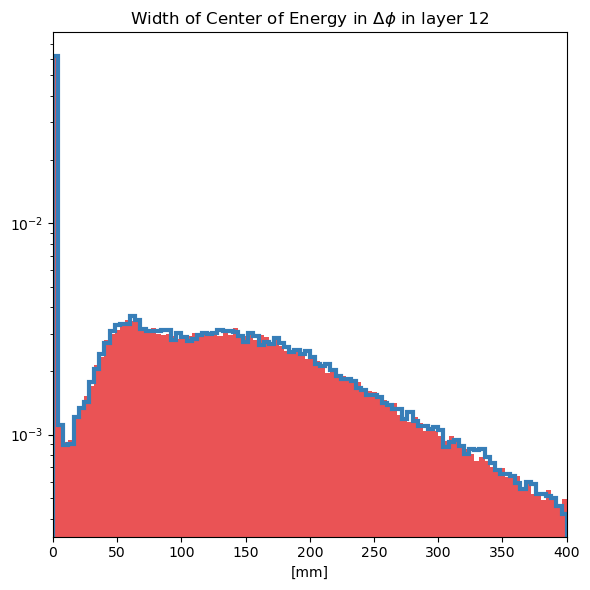

Separation power of Width Phi layer 13 histogram: 0.0004389068839662139


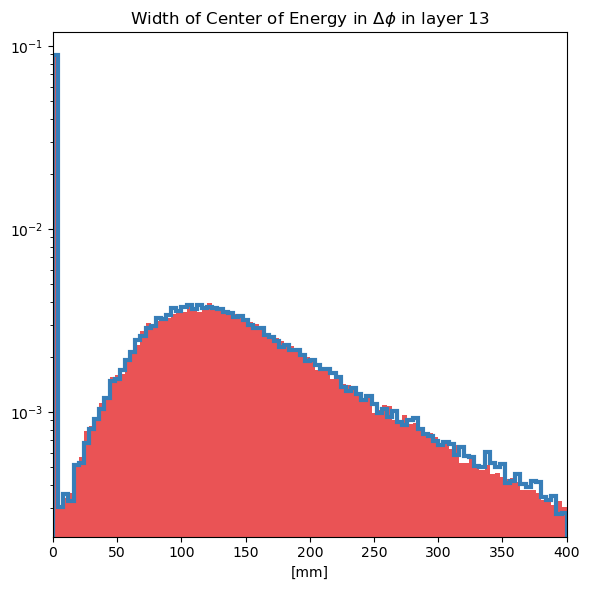

Separation power of Sparsity layer 0 histogram: 4.397889365664606e-05


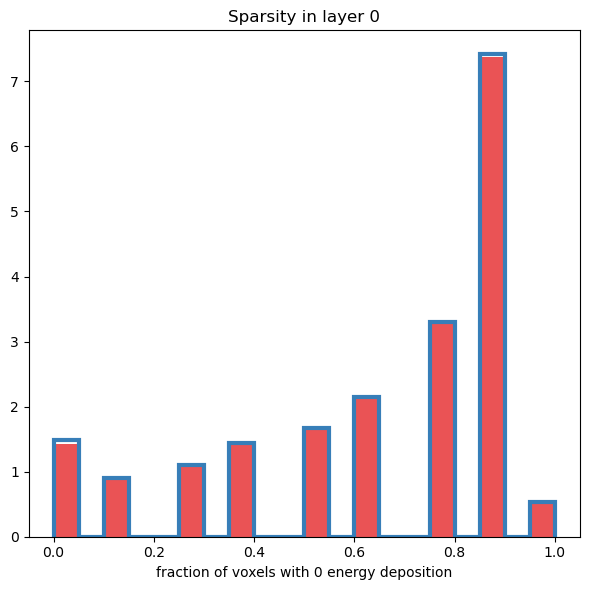

Separation power of Sparsity layer 1 histogram: 5.051088570201383e-05


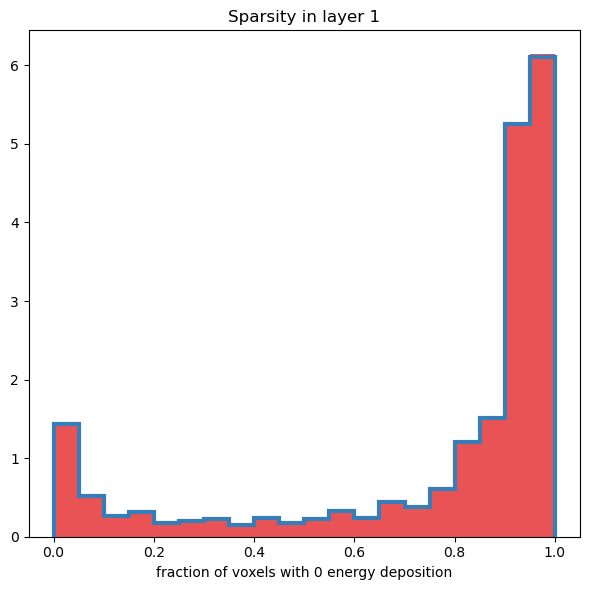

Separation power of Sparsity layer 2 histogram: 4.890039908600525e-05


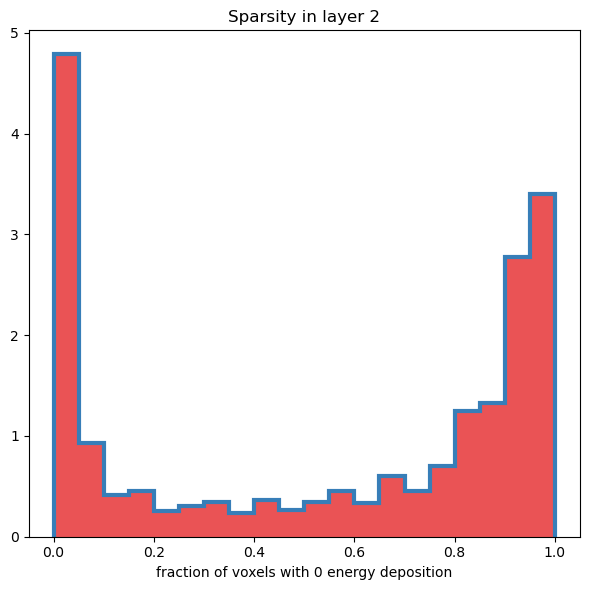

Separation power of Sparsity layer 3 histogram: 1.6191918380651513e-05


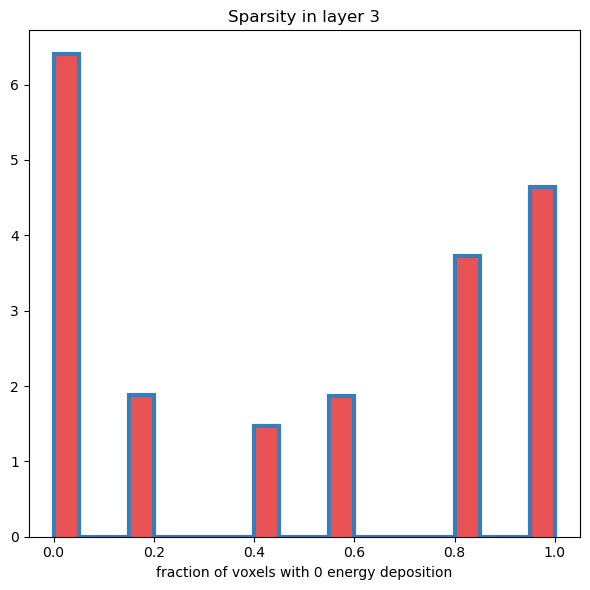

Separation power of Sparsity layer 12 histogram: 9.684496955526968e-05


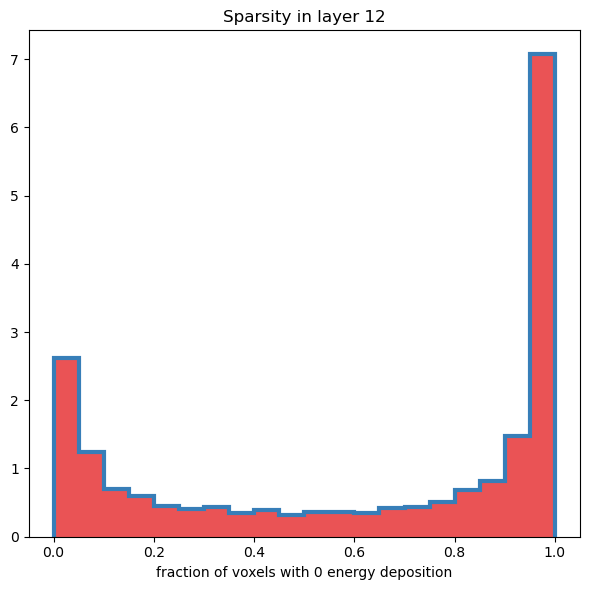

Separation power of Sparsity layer 13 histogram: 2.9657701549273824e-05


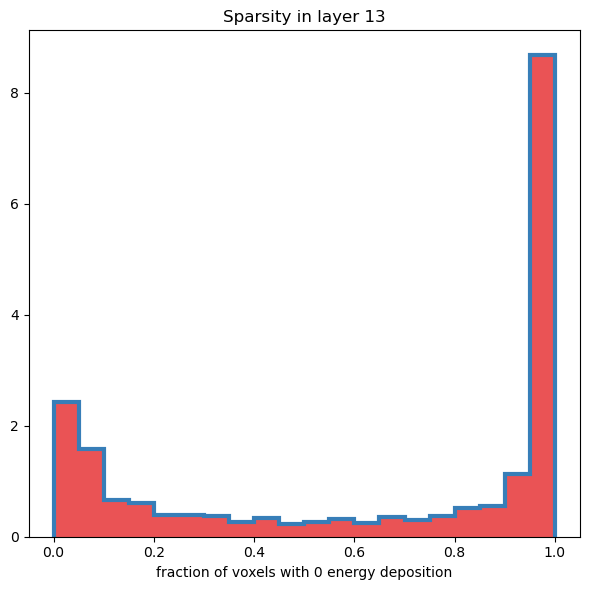

Separation power of Sparsity layer 14 histogram: 2.7436193970585436e-05


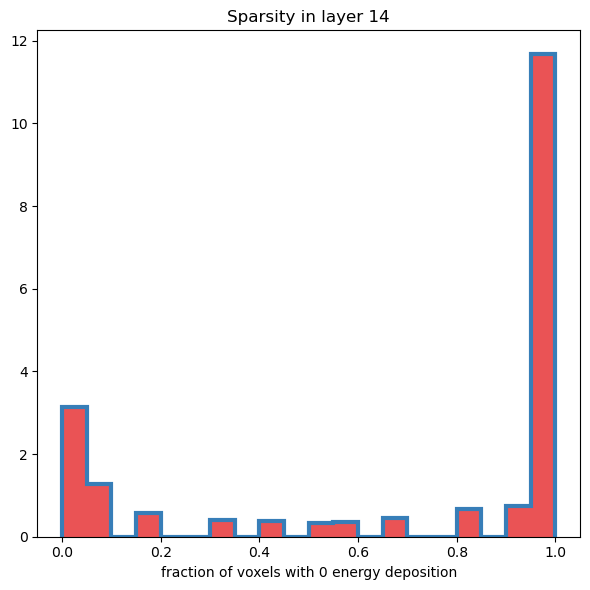

Separation power of EC r layer 0 histogram: 0.0003823407768552528


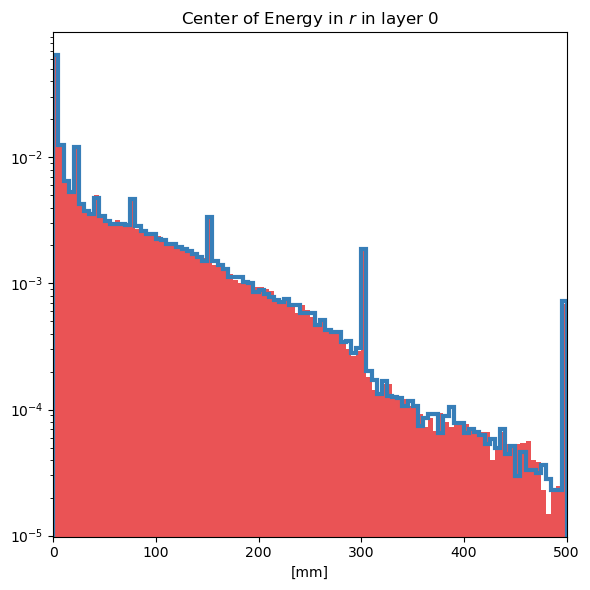

Separation power of EC r layer 1 histogram: 0.00012688169394131036


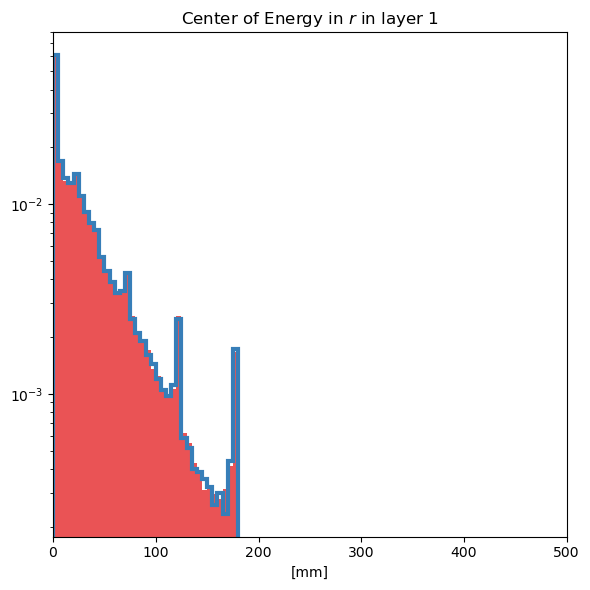

Separation power of EC r layer 2 histogram: 0.0002811358450030574


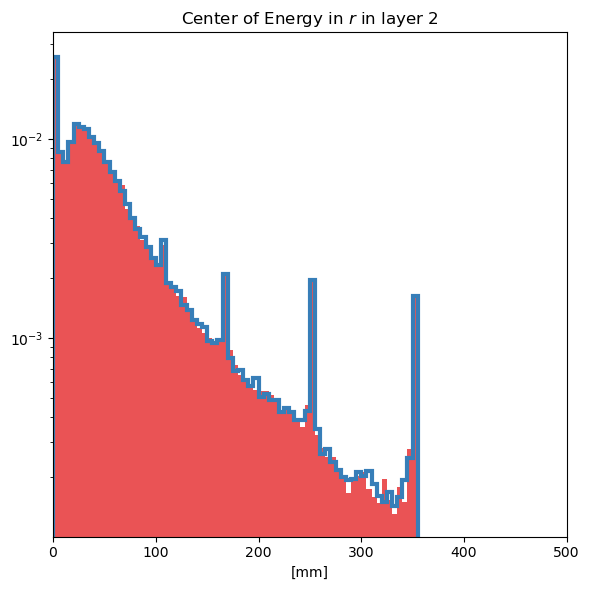

Separation power of EC r layer 3 histogram: 0.000476932595242837


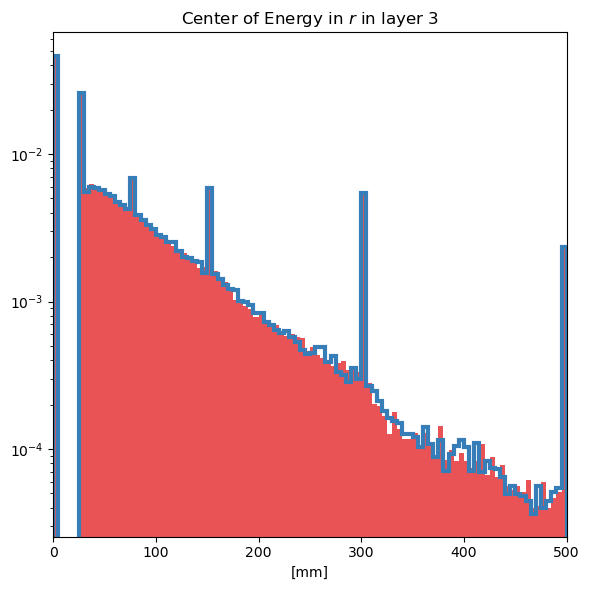

Separation power of EC r layer 12 histogram: 0.00034301925066365516


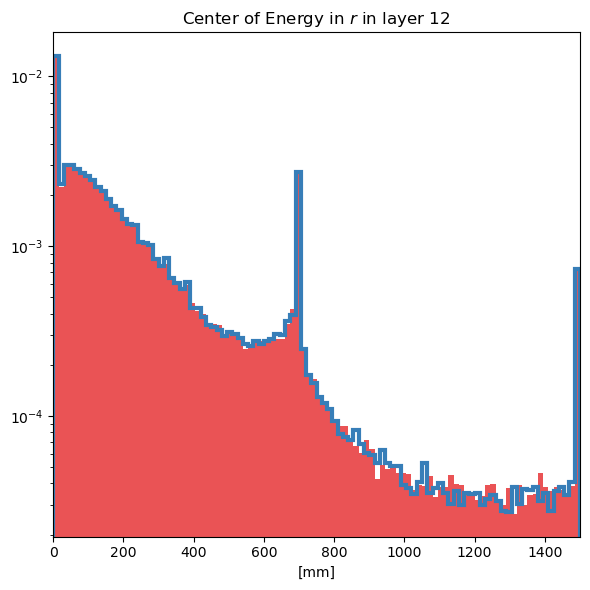

Separation power of EC r layer 13 histogram: 0.00047882212905560686


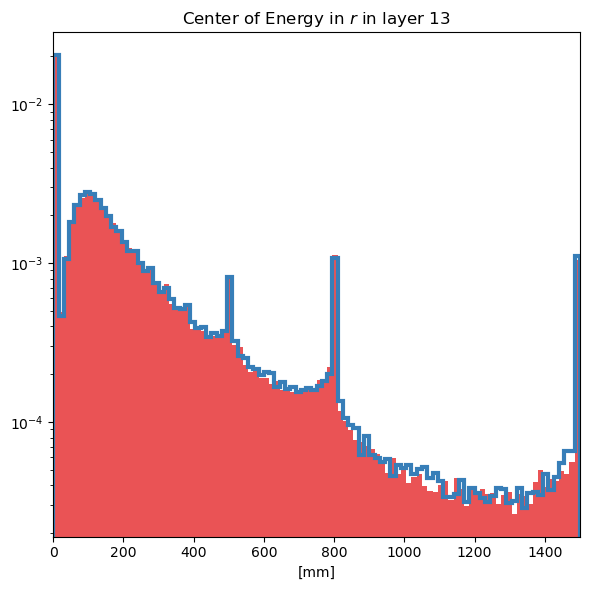

Separation power of EC r layer 14 histogram: 0.0004922721017789574


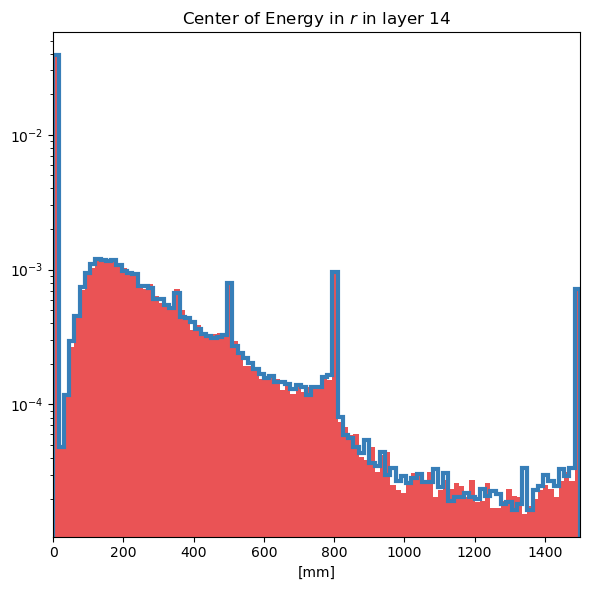

Separation power of Width r layer 0 histogram: 0.00020930256637734877


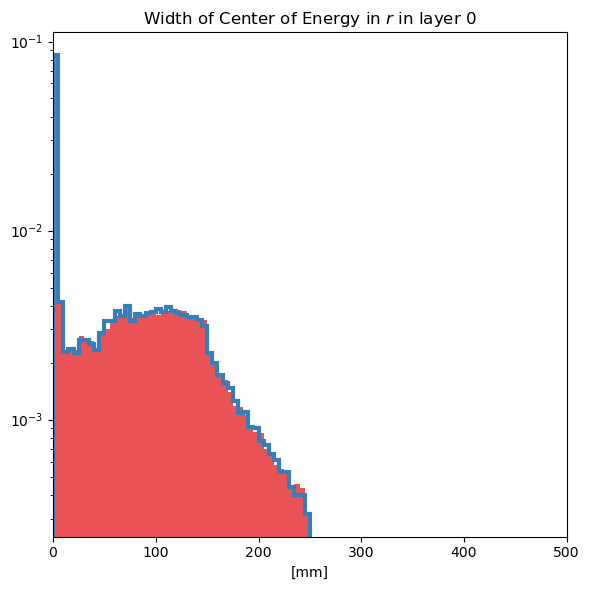

Separation power of Width r layer 1 histogram: 3.93657108747762e-05


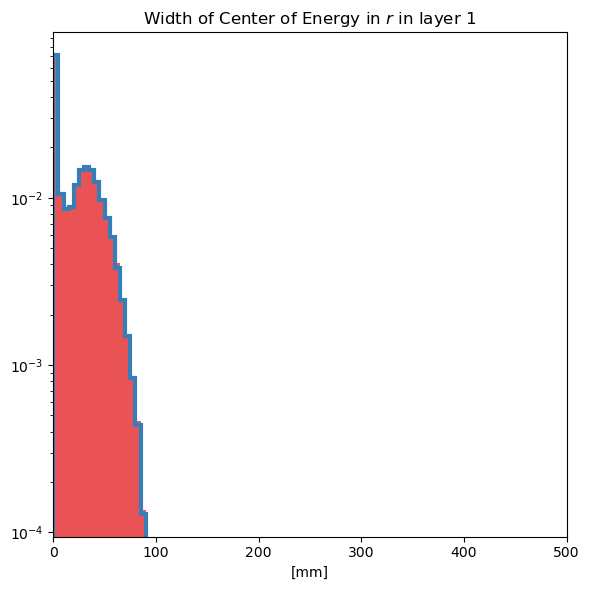

Separation power of Width r layer 2 histogram: 0.0001716977625499054


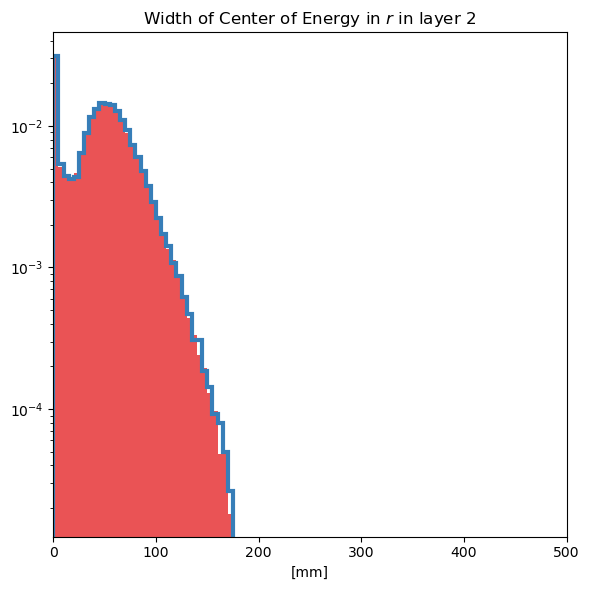

Separation power of Width r layer 3 histogram: 0.00022525592727982687


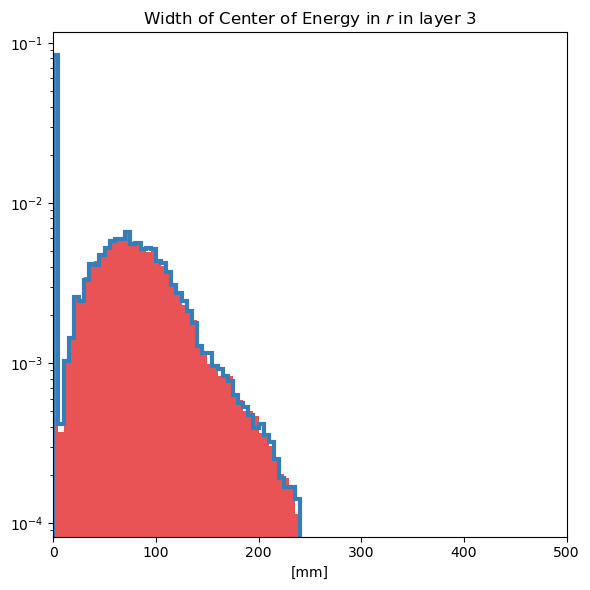

Separation power of Width r layer 12 histogram: 0.0002031952591928275


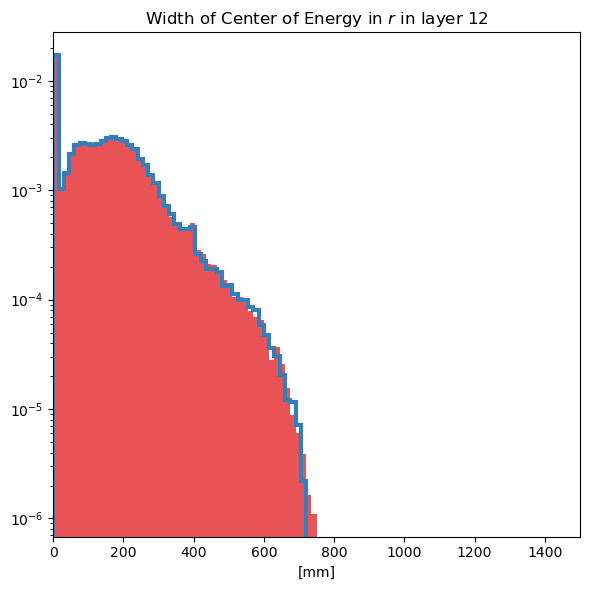

Separation power of Width r layer 13 histogram: 0.00019178651012048703


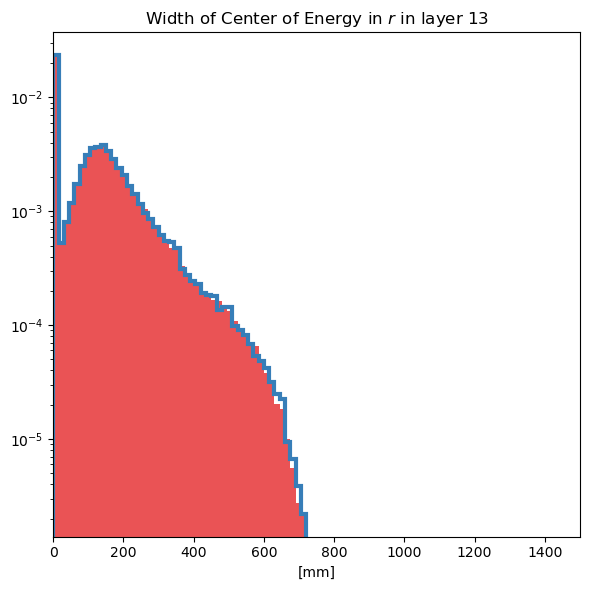

Separation power of Width r layer 14 histogram: 0.00017058851007332456


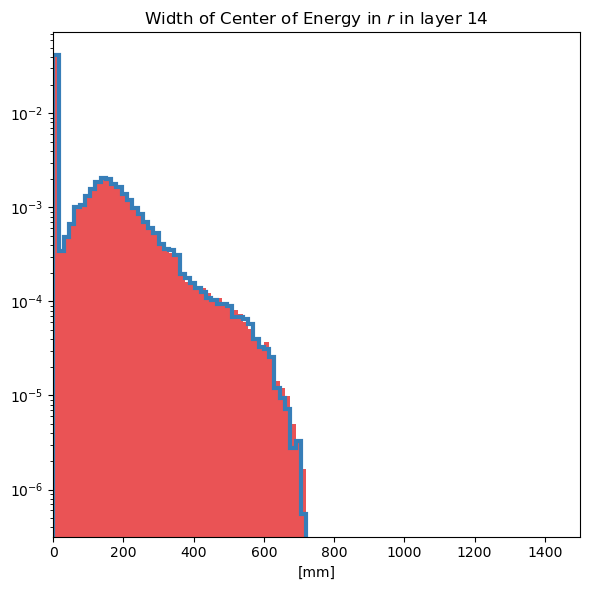

Separation power of voxel distribution histogram: 1.6459453036633876e-06


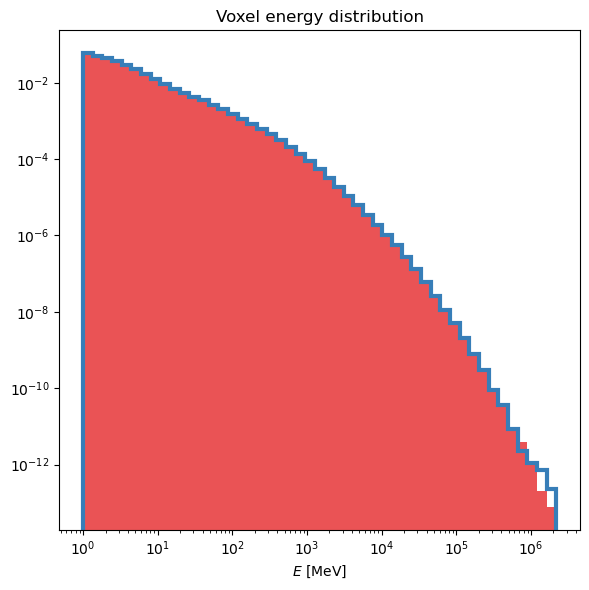

Separation power of Etot / Einc histogram: 0.0003996594659644583


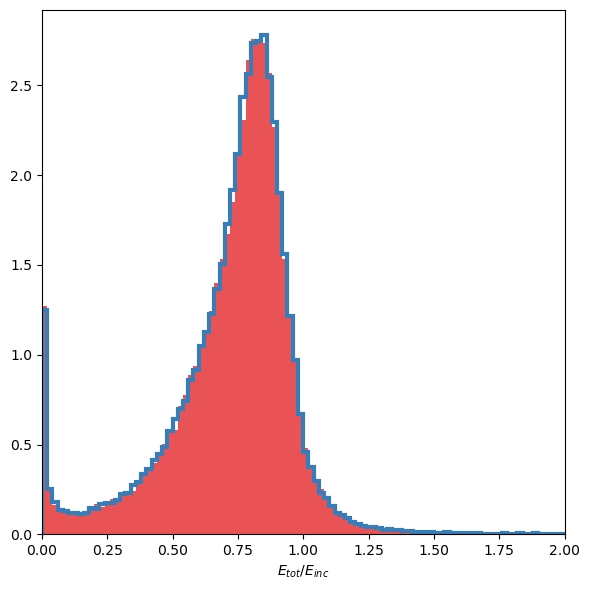

in iteration 8 of 10
Separation power of E layer 0 histogram: 0.000177671449309776


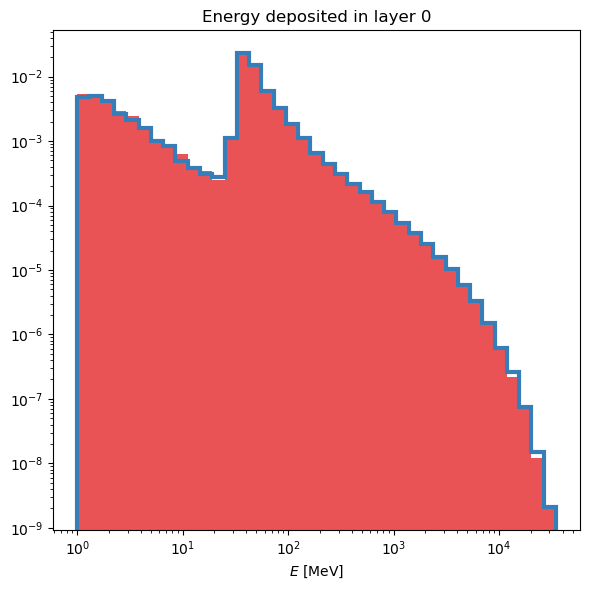

Separation power of E layer 1 histogram: 0.00023786538867309574


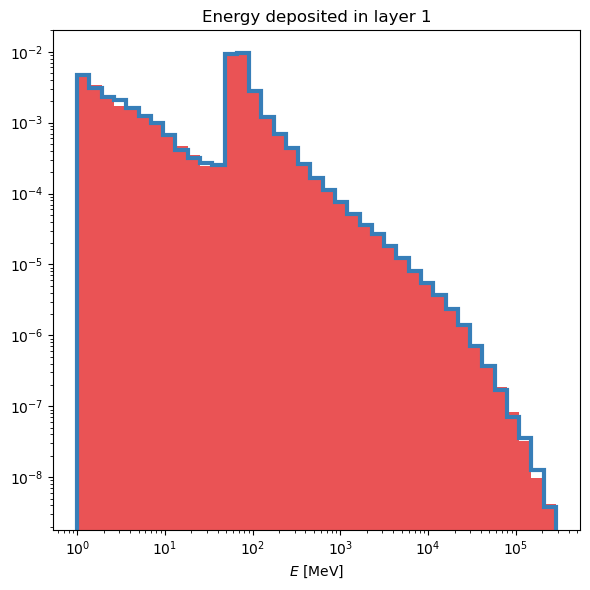

Separation power of E layer 2 histogram: 0.0001558076638935811


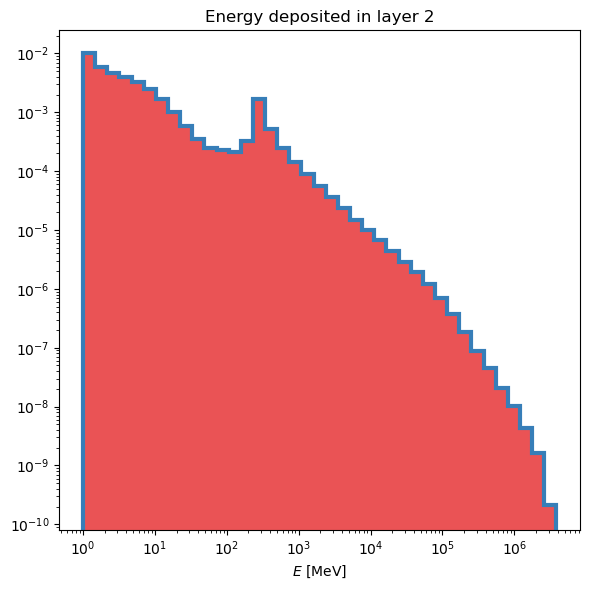

Separation power of E layer 3 histogram: 0.00023270749280482344


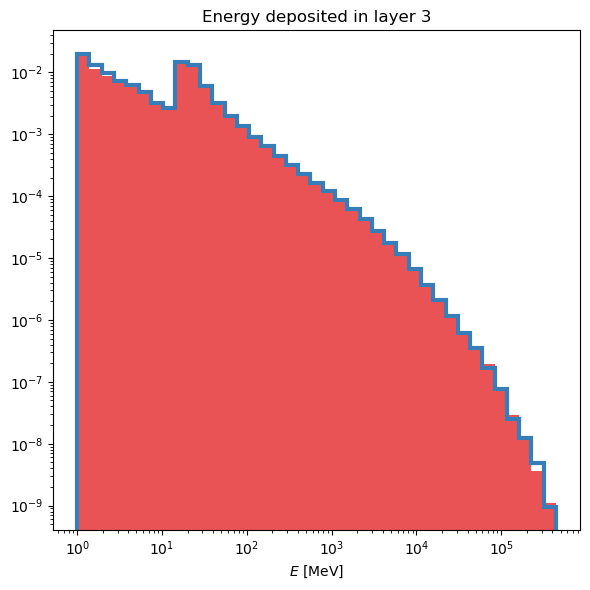

Separation power of E layer 12 histogram: 0.00019378101384857237


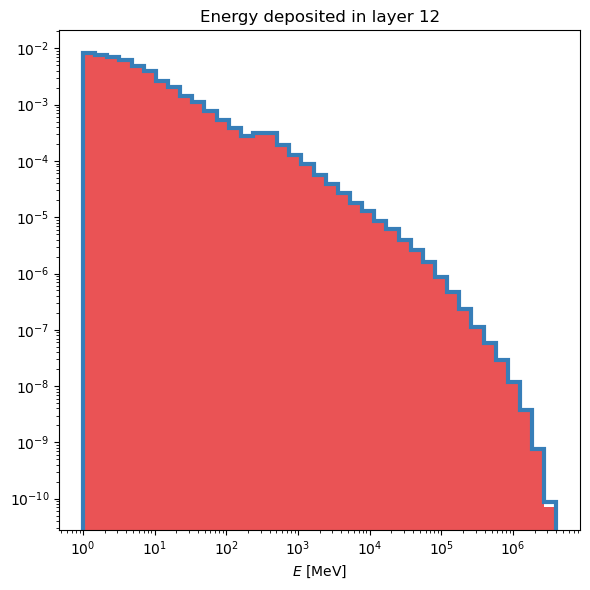

Separation power of E layer 13 histogram: 0.00023912047823644518


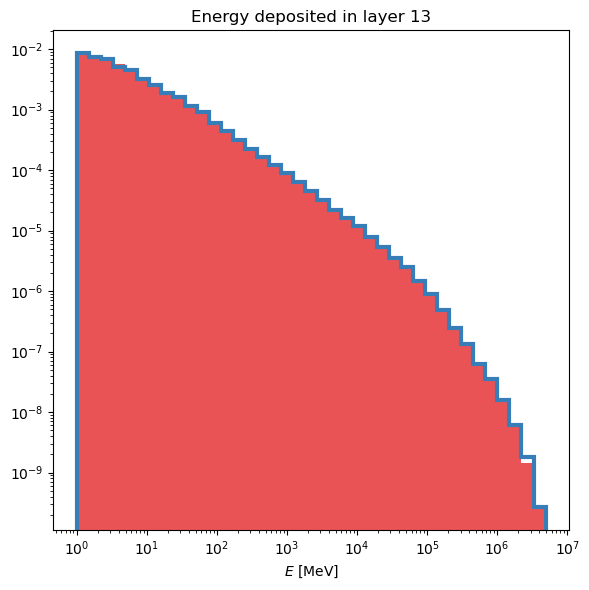

Separation power of E layer 14 histogram: 0.0003526634905059745


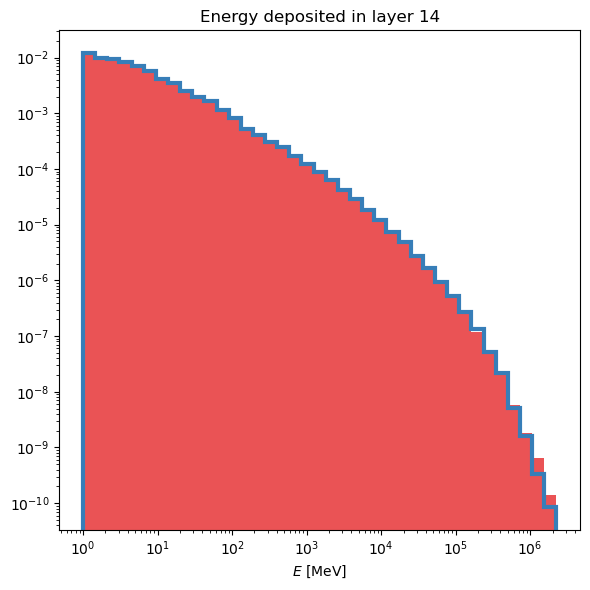

Separation power of EC Eta layer 1 histogram: 0.0004085466358165079


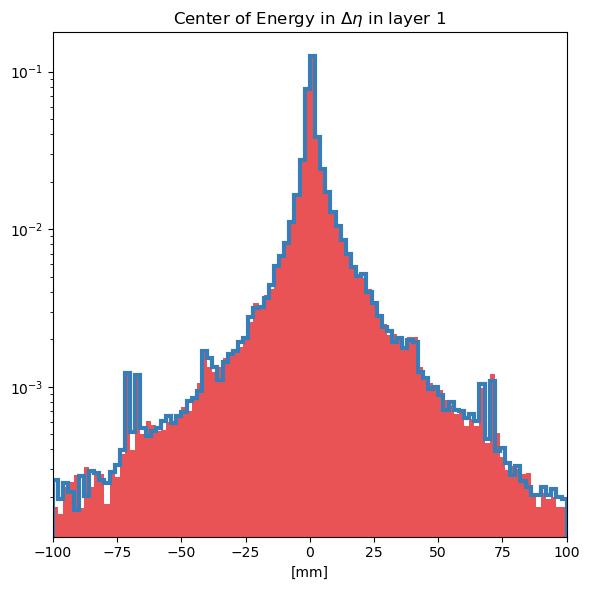

Separation power of EC Eta layer 2 histogram: 0.0003812914277565167


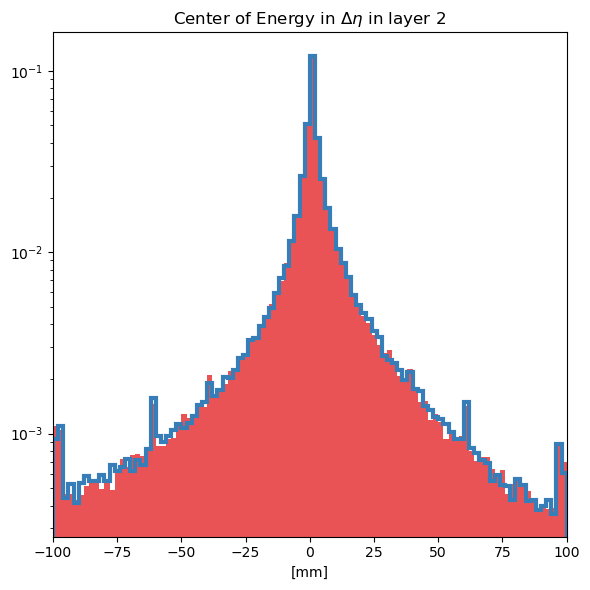

Separation power of EC Eta layer 12 histogram: 0.00043799167533595875


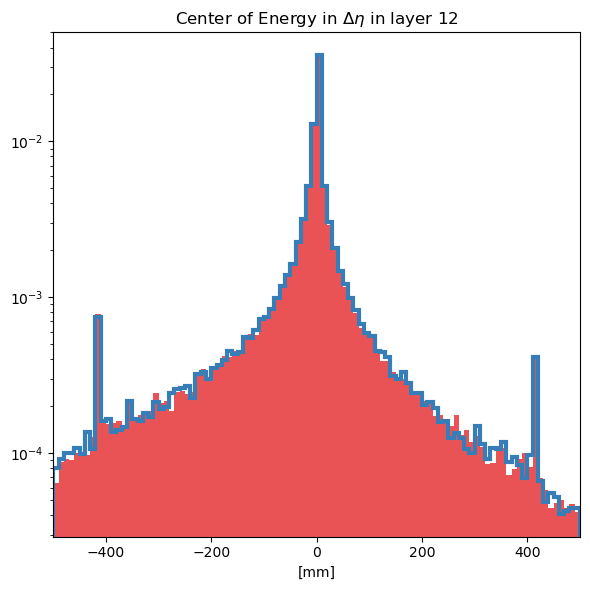

Separation power of EC Eta layer 13 histogram: 0.0005121767091490313


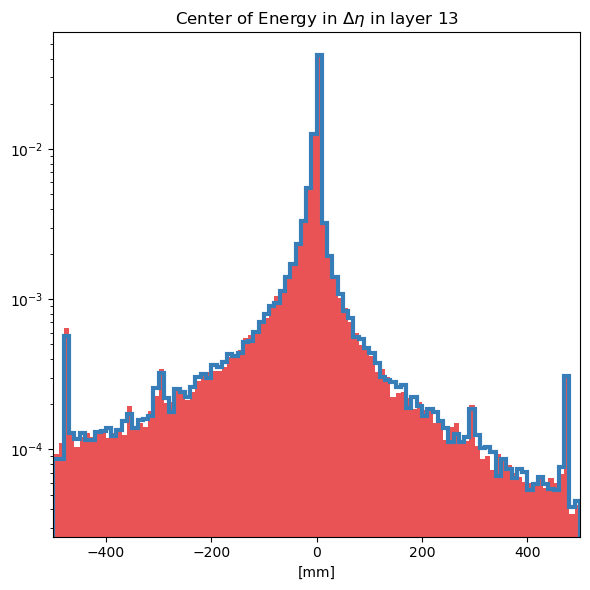

Separation power of EC Phi layer 1 histogram: 0.0004304170167447742


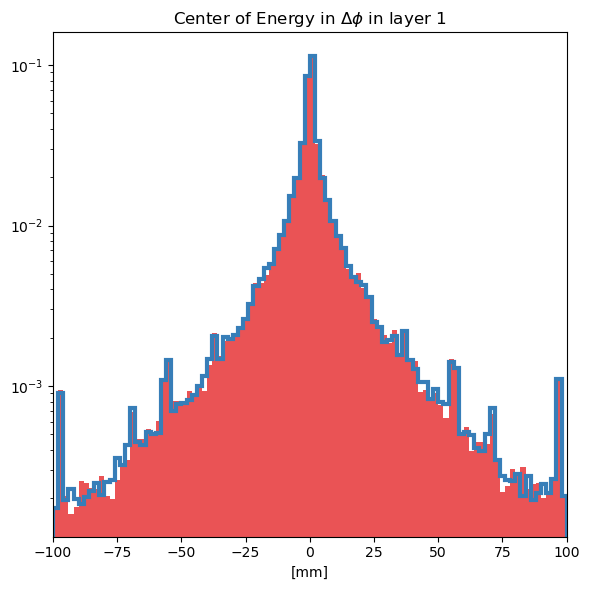

Separation power of EC Phi layer 2 histogram: 0.0004179776077820653


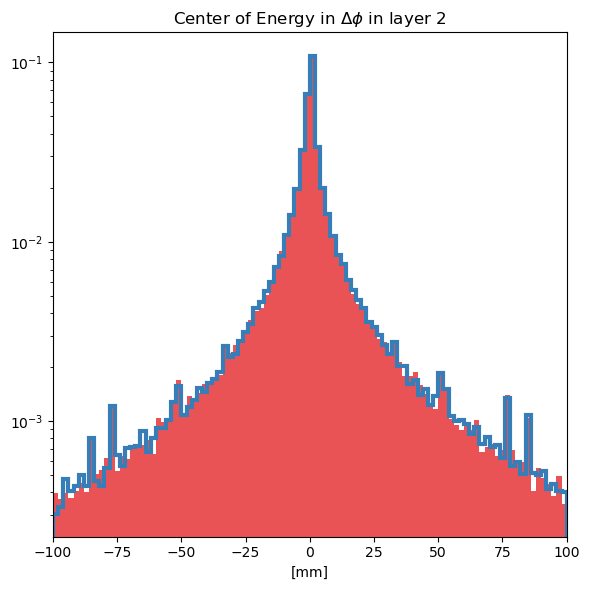

Separation power of EC Phi layer 12 histogram: 0.00035374138536838957


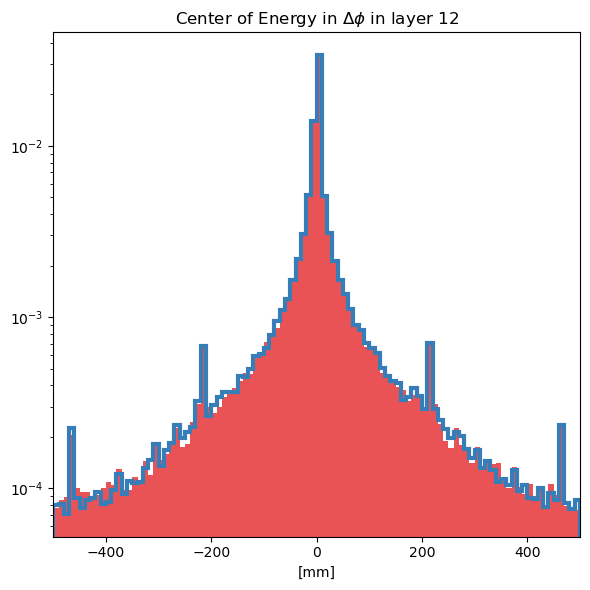

Separation power of EC Phi layer 13 histogram: 0.0003109388526256123


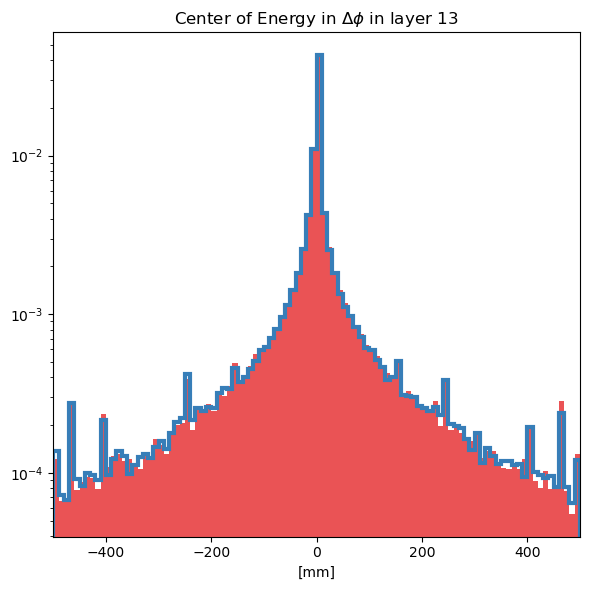

Separation power of Width Eta layer 1 histogram: 0.0003885436333903246


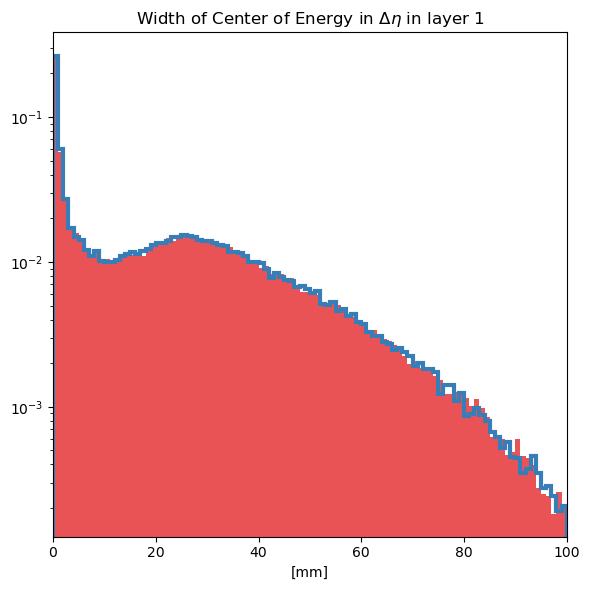

Separation power of Width Eta layer 2 histogram: 0.0004215756164509175


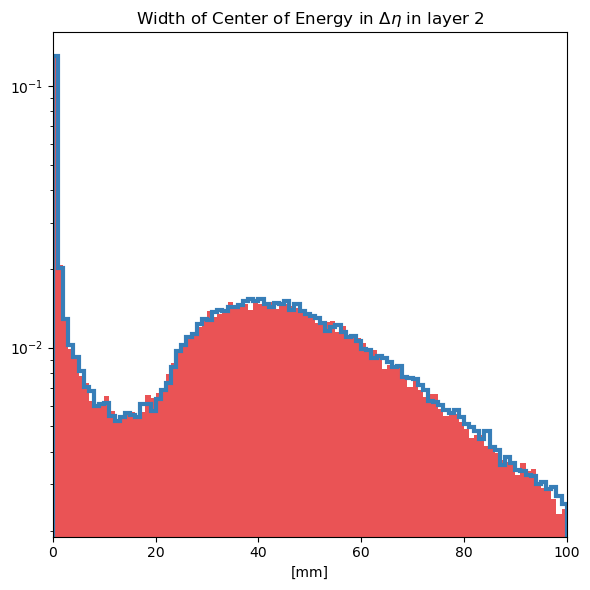

Separation power of Width Eta layer 12 histogram: 0.0003705654018964277


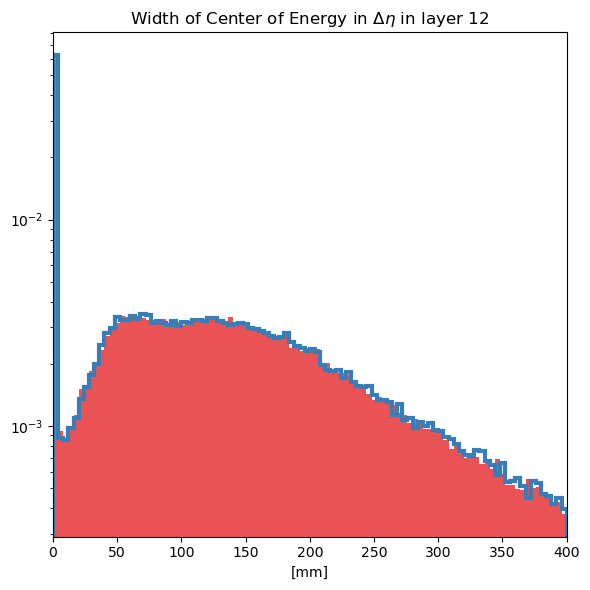

Separation power of Width Eta layer 13 histogram: 0.00043351114339244145


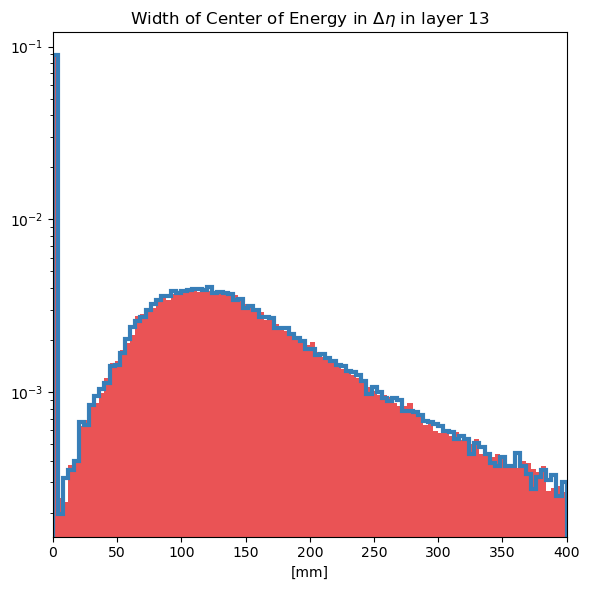

Separation power of Width Phi layer 1 histogram: 0.000426565479292124


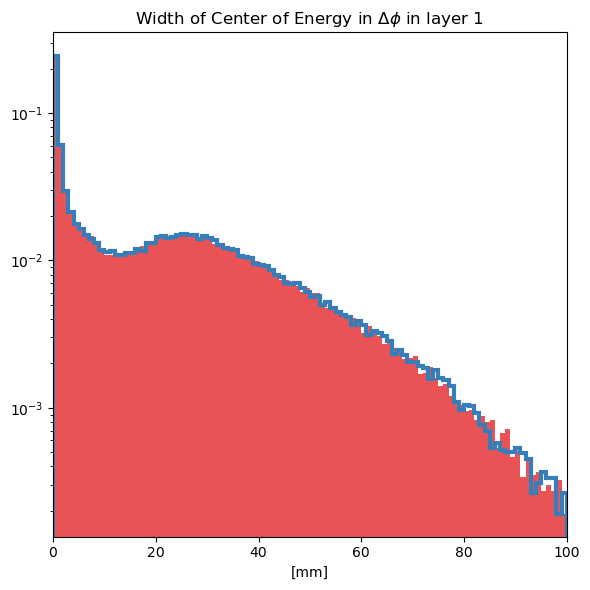

Separation power of Width Phi layer 2 histogram: 0.0004328012885919526


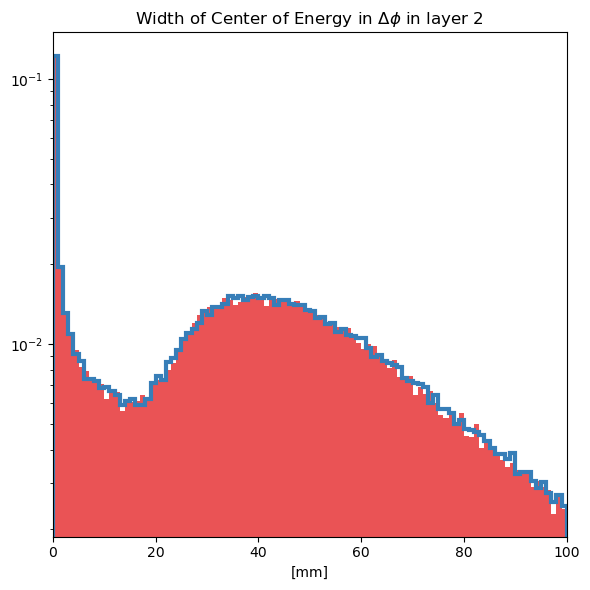

Separation power of Width Phi layer 12 histogram: 0.0005080768652740537


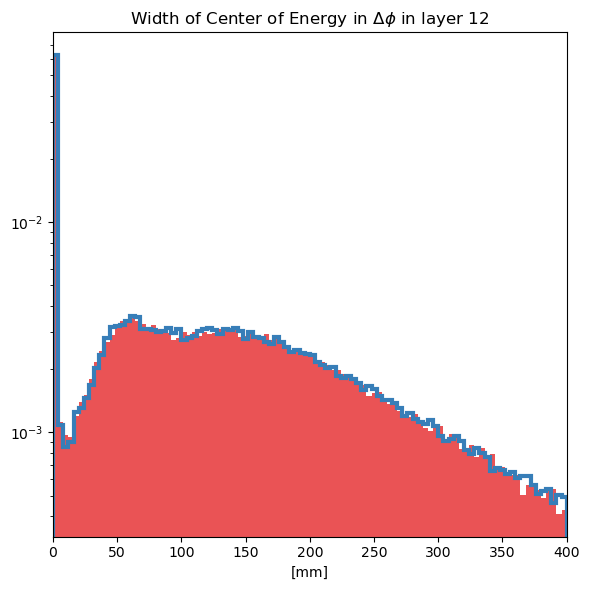

Separation power of Width Phi layer 13 histogram: 0.00034088562068269727


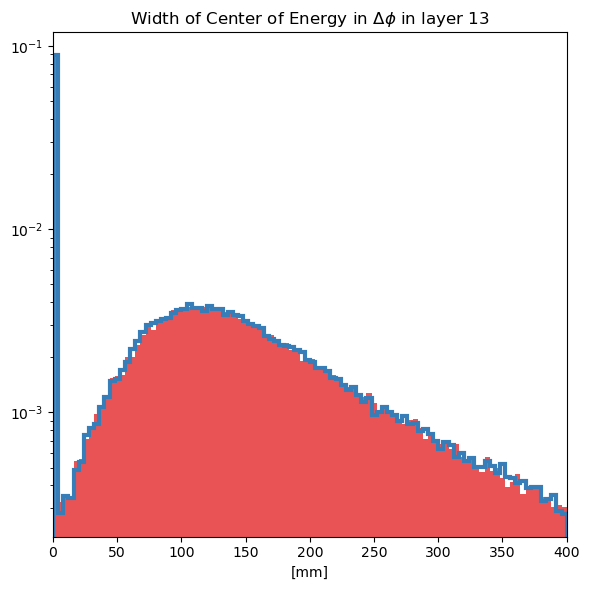

Separation power of Sparsity layer 0 histogram: 2.1954750003744223e-05


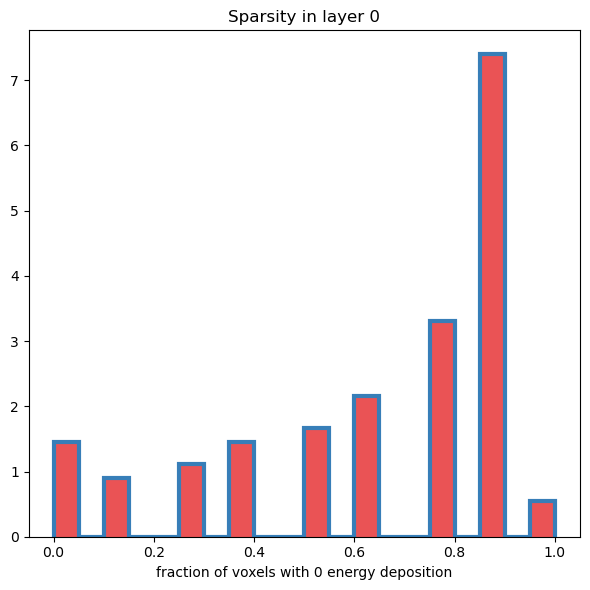

Separation power of Sparsity layer 1 histogram: 8.80031389755683e-05


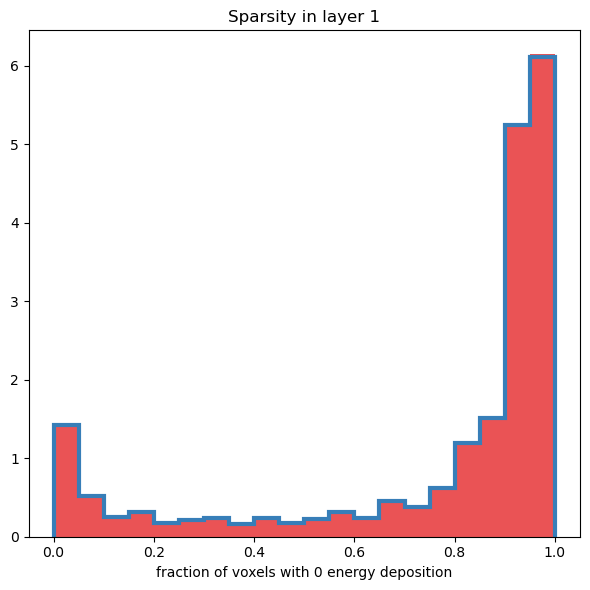

Separation power of Sparsity layer 2 histogram: 9.757806618653529e-05


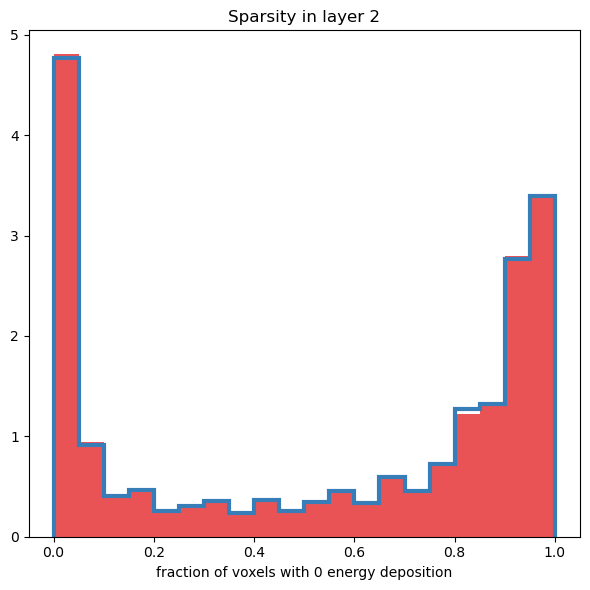

Separation power of Sparsity layer 3 histogram: 1.439674226305207e-05


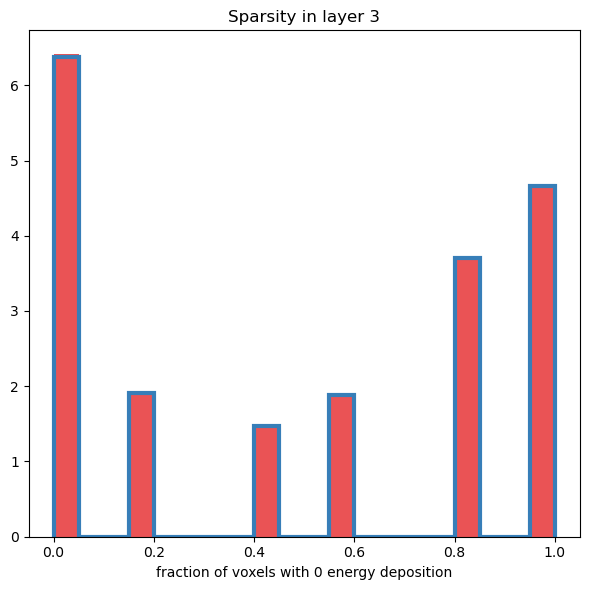

Separation power of Sparsity layer 12 histogram: 6.095109217684013e-05


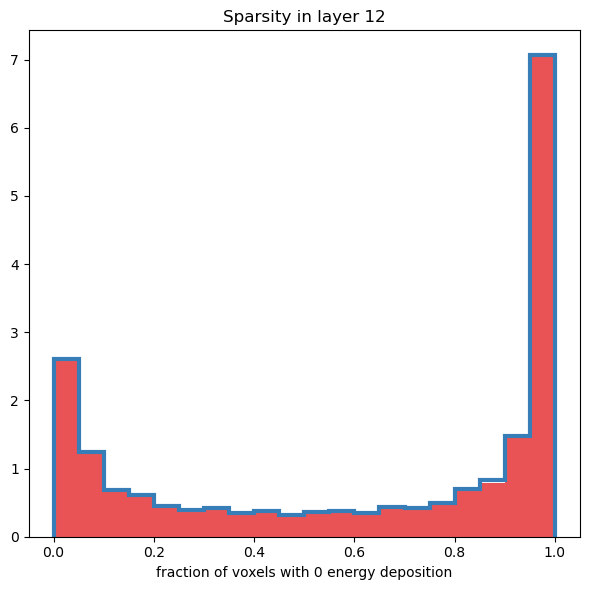

Separation power of Sparsity layer 13 histogram: 5.23042384471188e-05


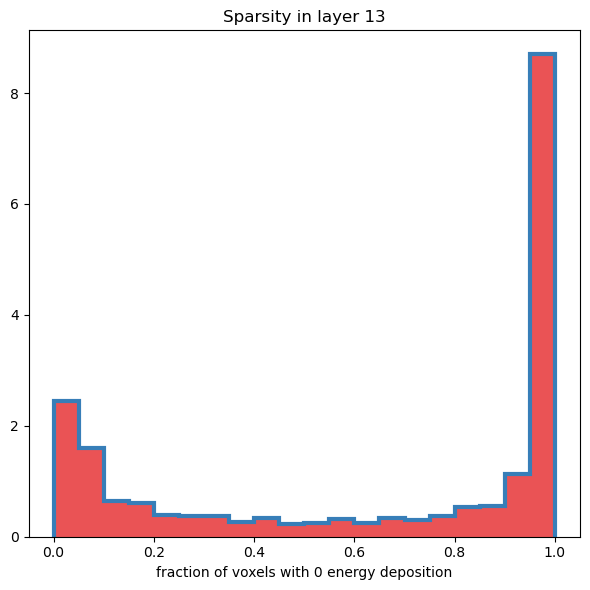

Separation power of Sparsity layer 14 histogram: 5.553035929361002e-05


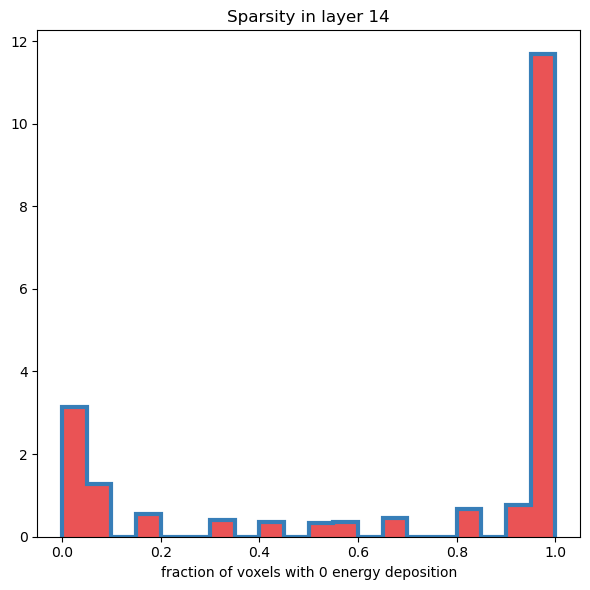

Separation power of EC r layer 0 histogram: 0.00035144292257672697


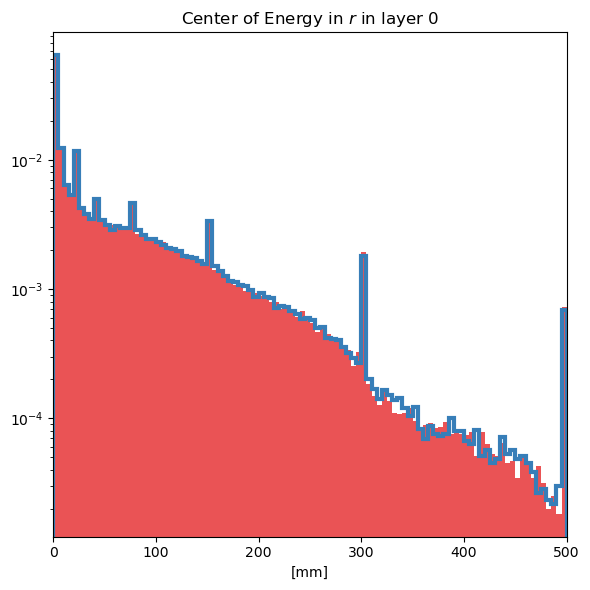

Separation power of EC r layer 1 histogram: 0.00015679905781527042


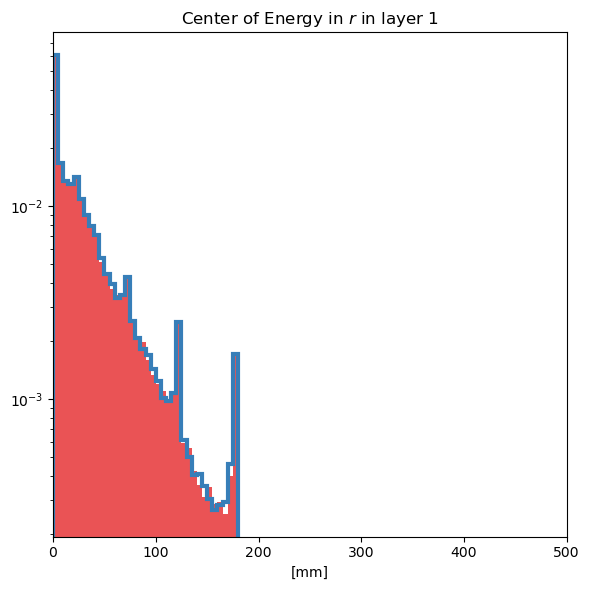

Separation power of EC r layer 2 histogram: 0.000266901361283331


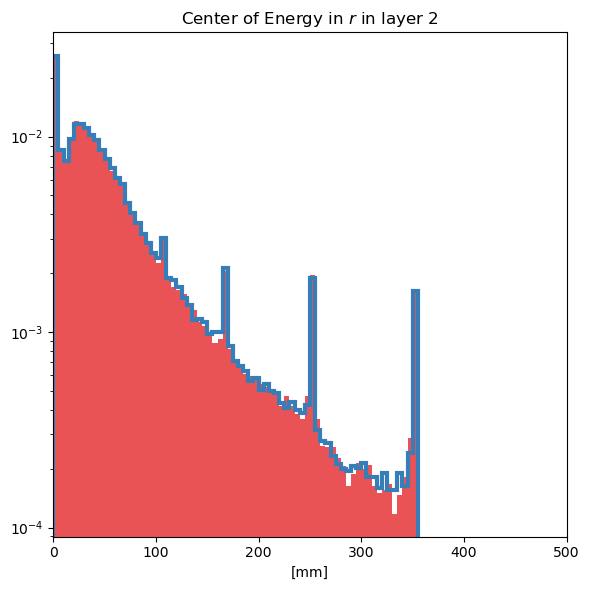

Separation power of EC r layer 3 histogram: 0.0003682164158209852


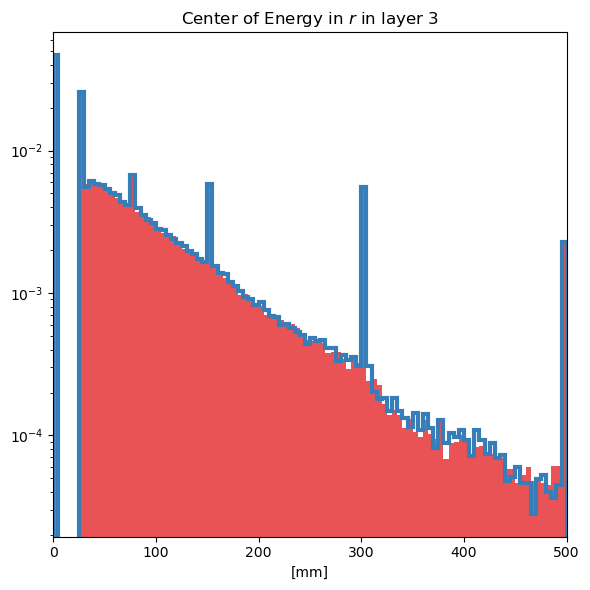

Separation power of EC r layer 12 histogram: 0.00043904501957558274


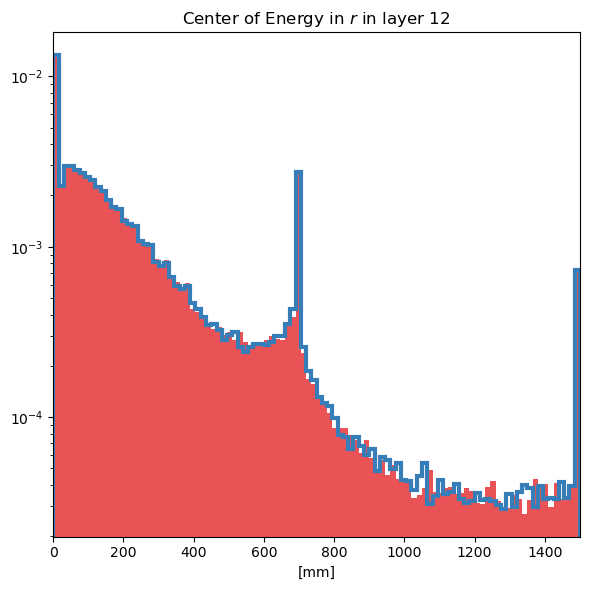

Separation power of EC r layer 13 histogram: 0.0004891538877643062


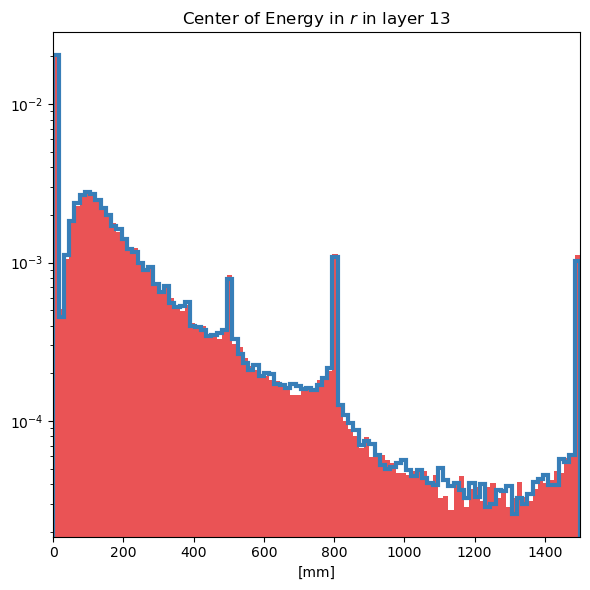

Separation power of EC r layer 14 histogram: 0.0003569746782015763


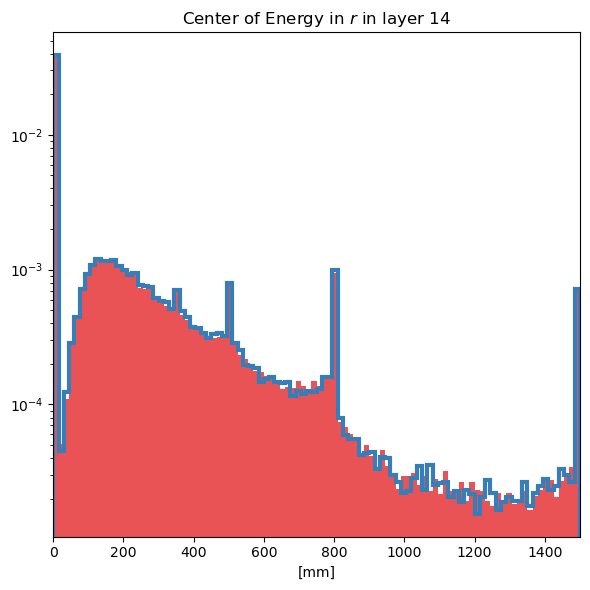

Separation power of Width r layer 0 histogram: 0.0001404793268563369


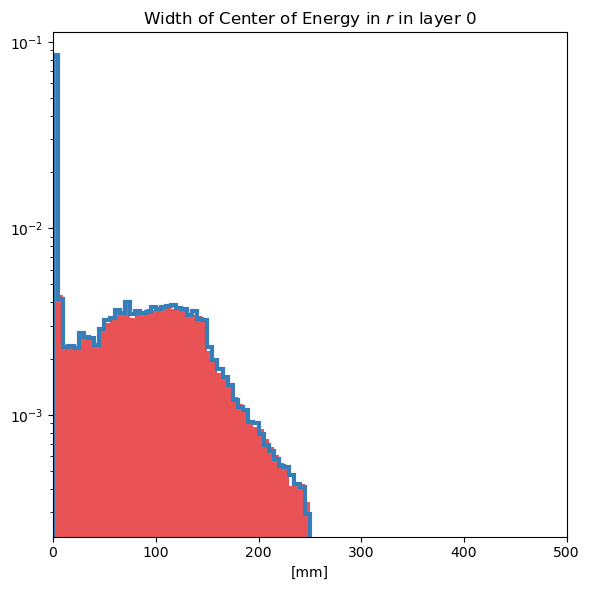

Separation power of Width r layer 1 histogram: 5.146813567657469e-05


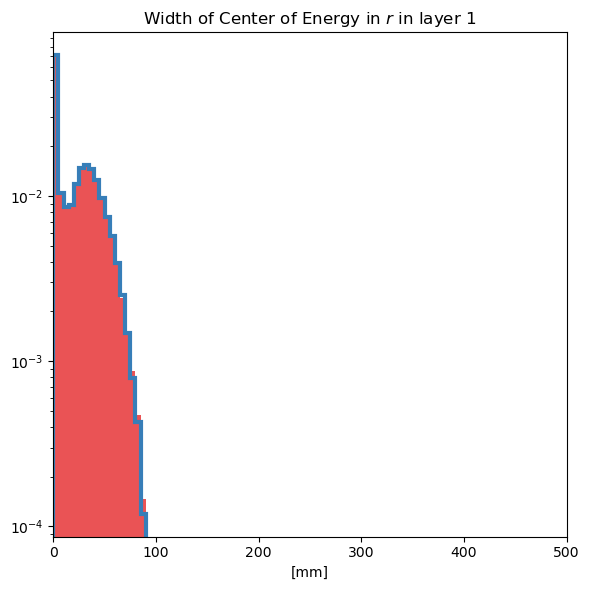

Separation power of Width r layer 2 histogram: 0.00021377453415205564


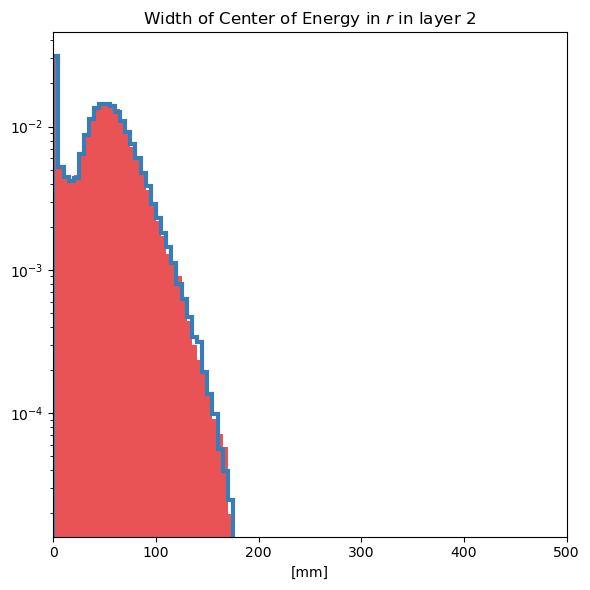

Separation power of Width r layer 3 histogram: 0.0001947742881720912


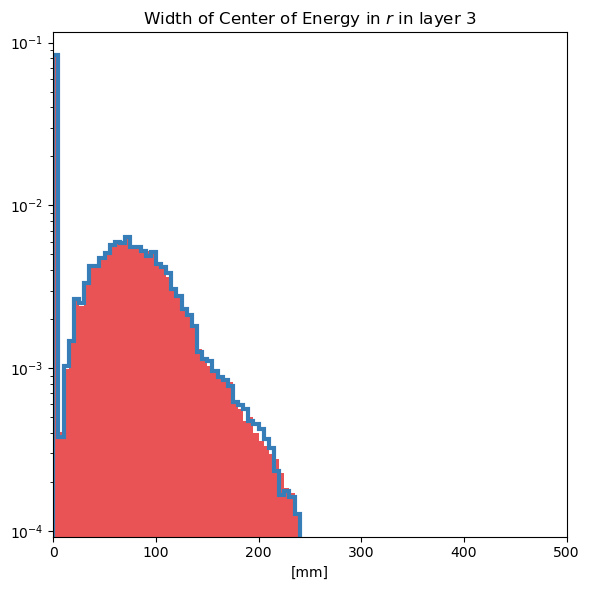

Separation power of Width r layer 12 histogram: 0.00023432781824533617


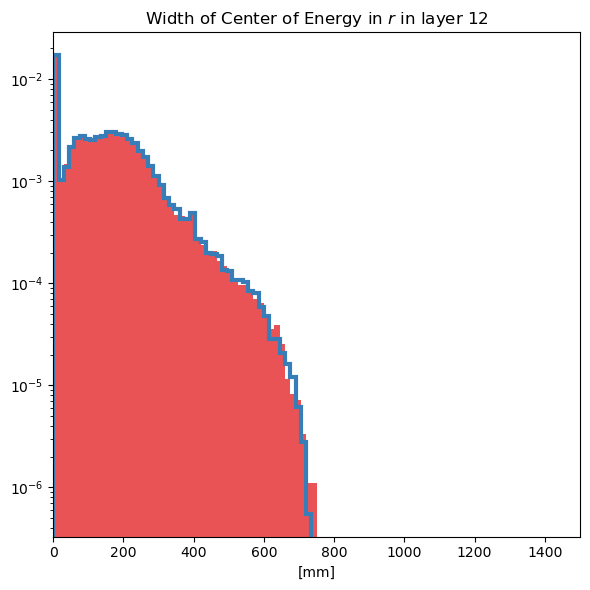

Separation power of Width r layer 13 histogram: 0.00015012653852871662


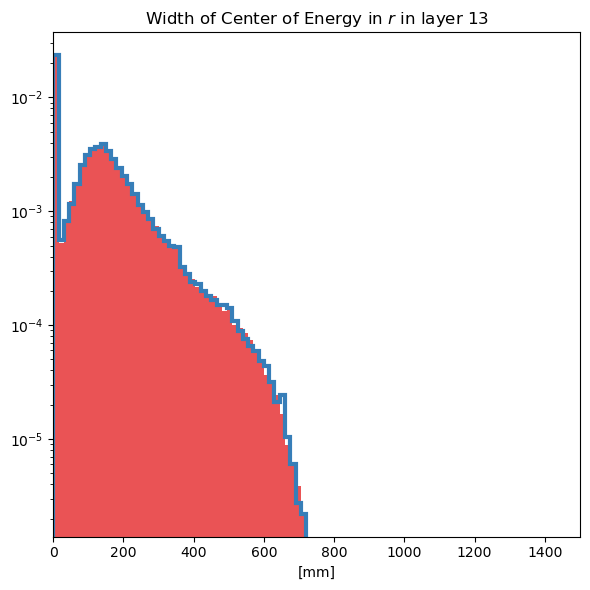

Separation power of Width r layer 14 histogram: 0.00017620822721088733


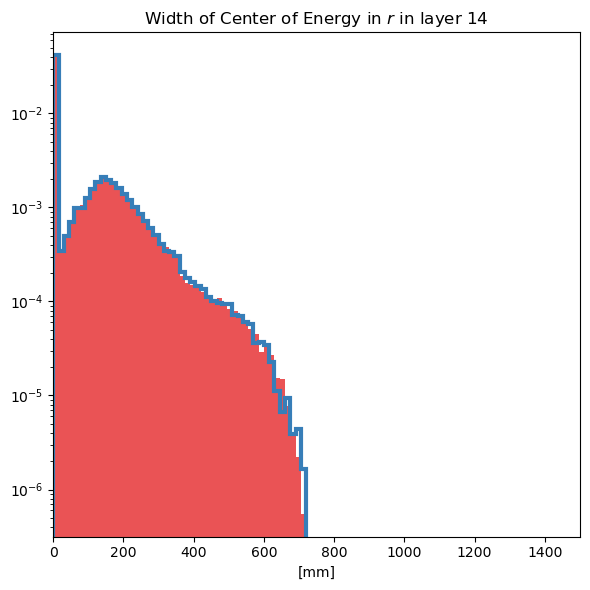

Separation power of voxel distribution histogram: 3.1404713236493e-06


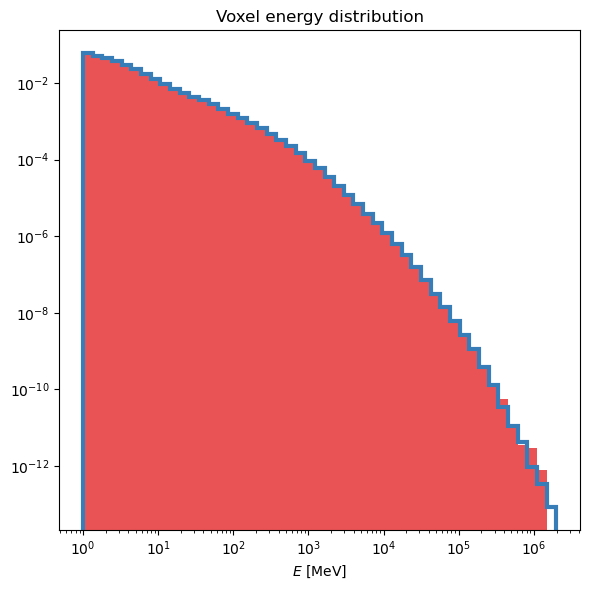

Separation power of Etot / Einc histogram: 0.0005051612603484692


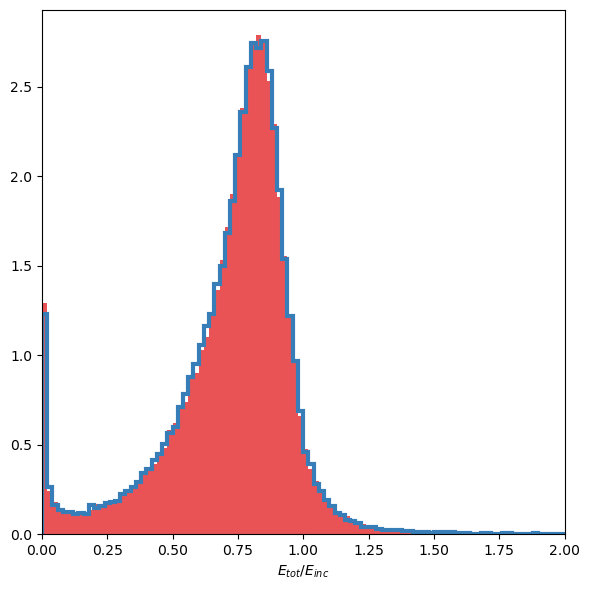

in iteration 9 of 10
Separation power of E layer 0 histogram: 0.00010638371550765283


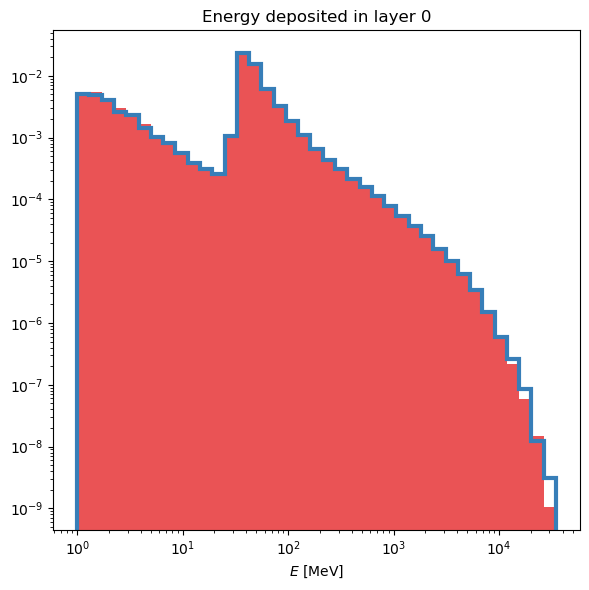

Separation power of E layer 1 histogram: 0.00014167017027213354


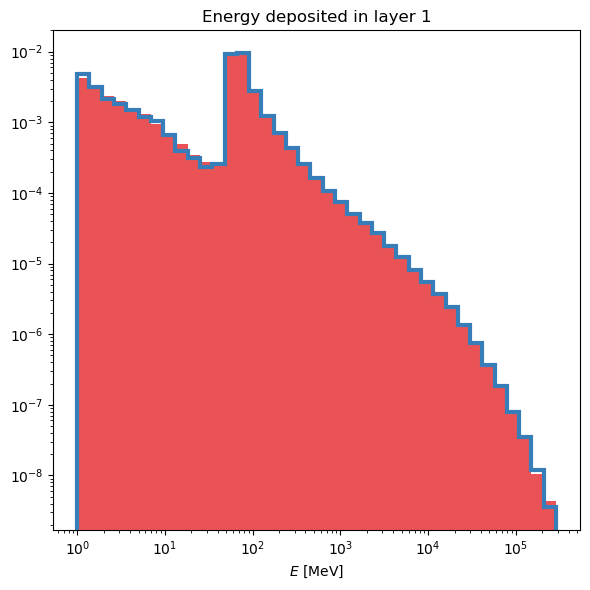

Separation power of E layer 2 histogram: 0.00015376347482467753


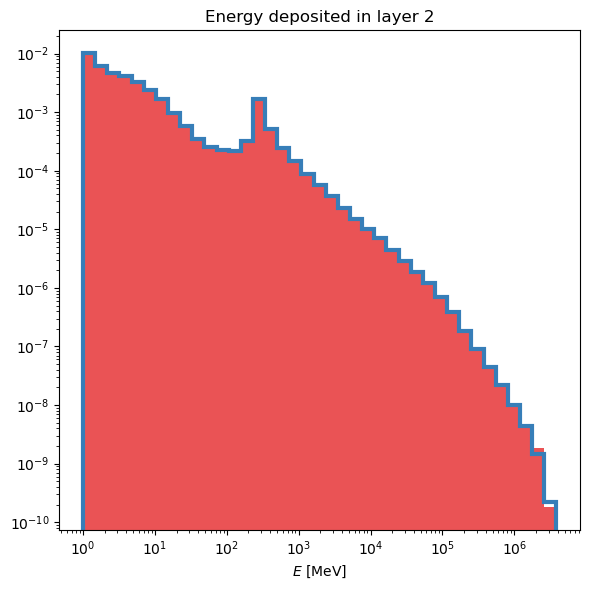

Separation power of E layer 3 histogram: 0.00020314849574104527


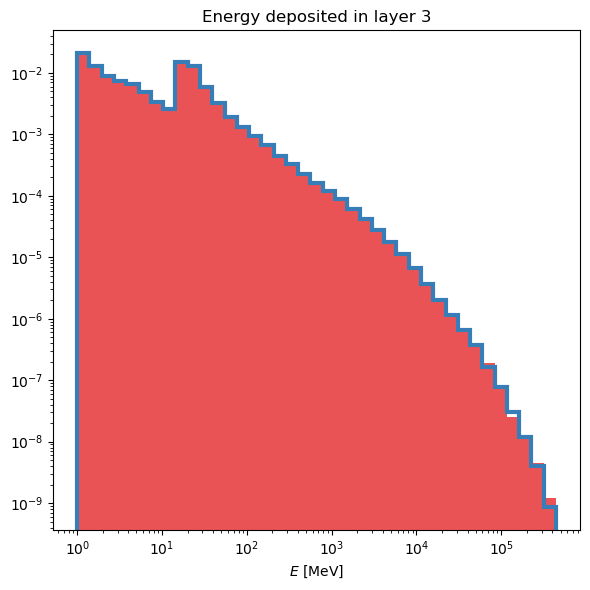

Separation power of E layer 12 histogram: 0.00017370933680724716


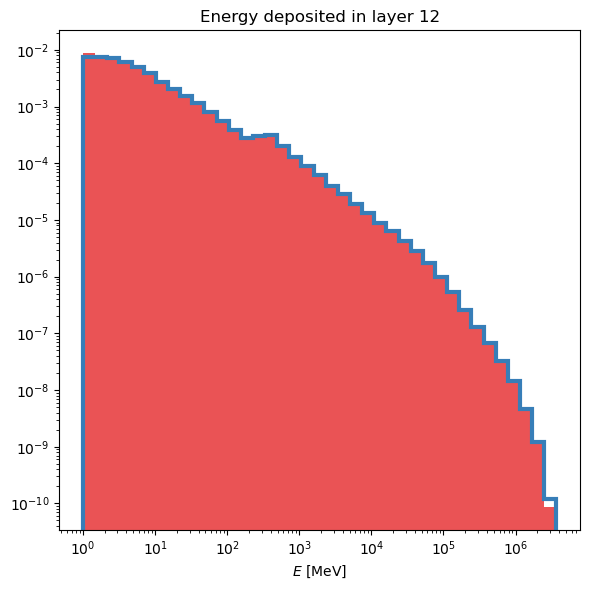

Separation power of E layer 13 histogram: 0.00027181579086060537


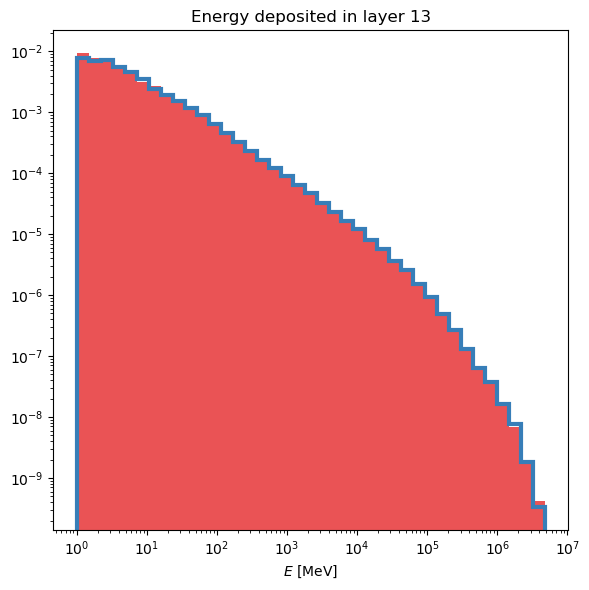

Separation power of E layer 14 histogram: 0.000312533250512917


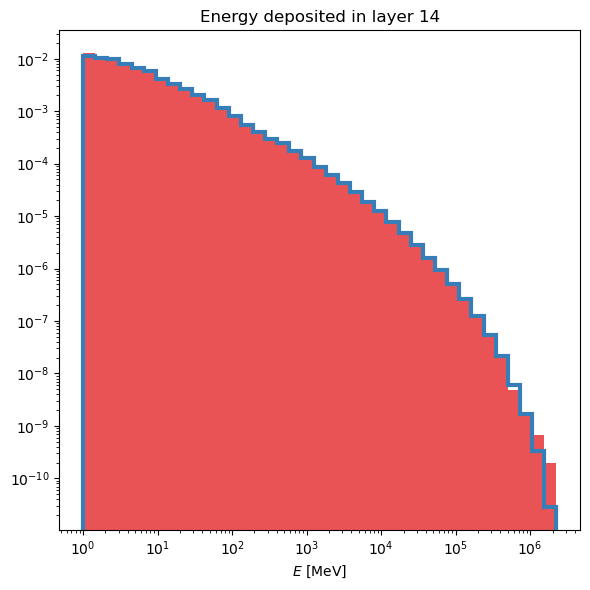

Separation power of EC Eta layer 1 histogram: 0.00034294505827756137


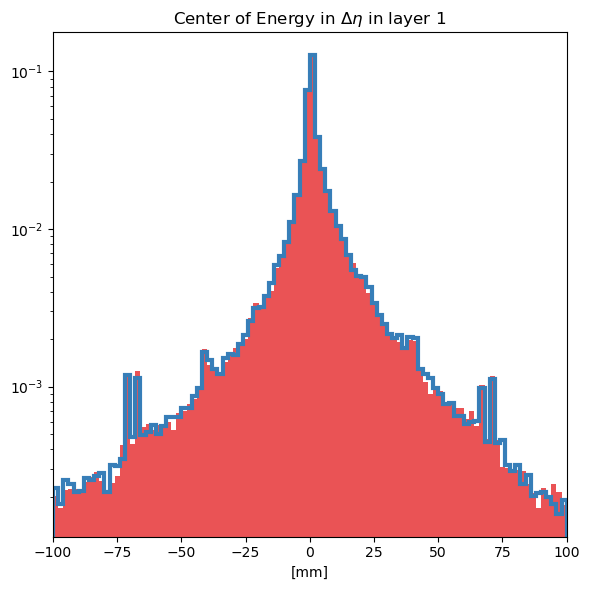

Separation power of EC Eta layer 2 histogram: 0.0003952071171048063


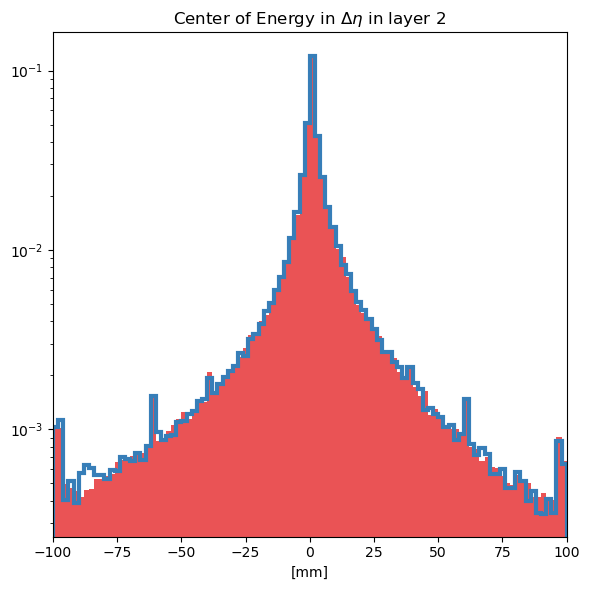

Separation power of EC Eta layer 12 histogram: 0.0003296003277232386


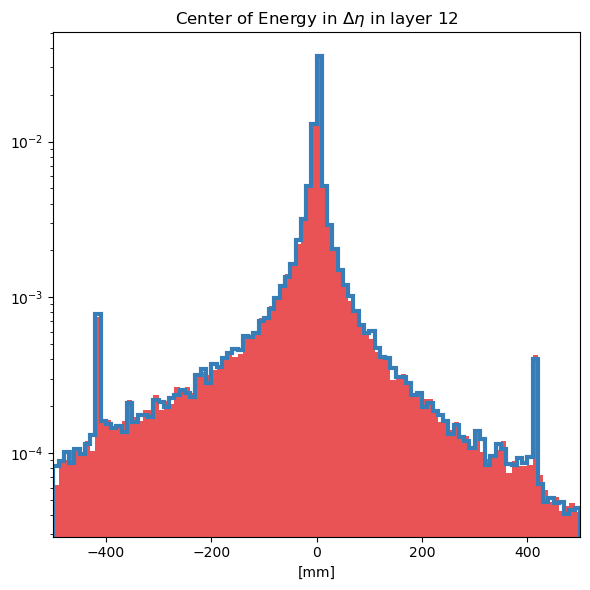

Separation power of EC Eta layer 13 histogram: 0.00046141454928734597


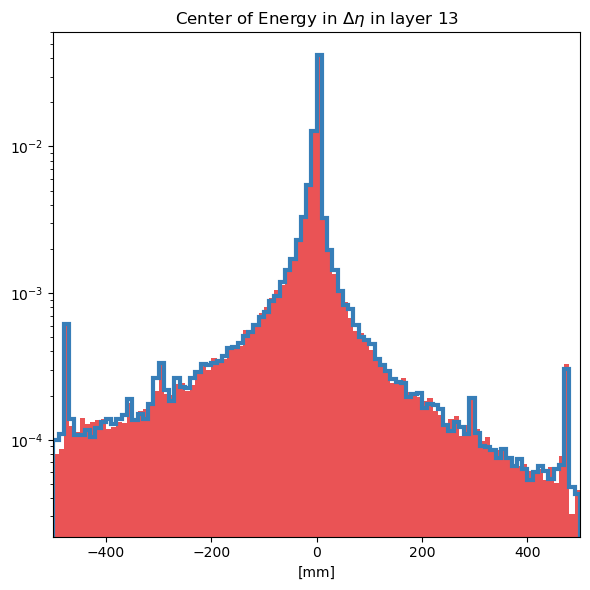

Separation power of EC Phi layer 1 histogram: 0.00029905335312255005


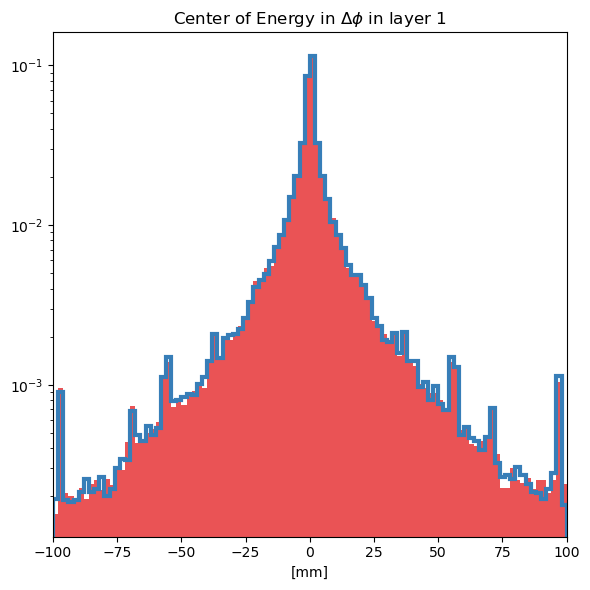

Separation power of EC Phi layer 2 histogram: 0.00036695480390971295


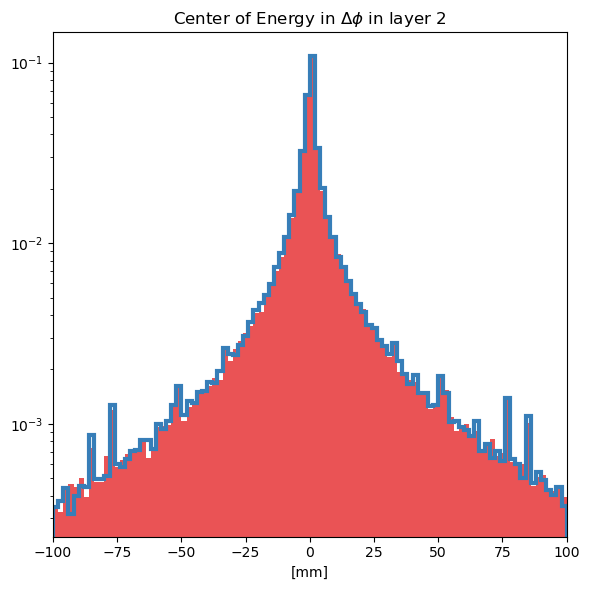

Separation power of EC Phi layer 12 histogram: 0.000449419255790039


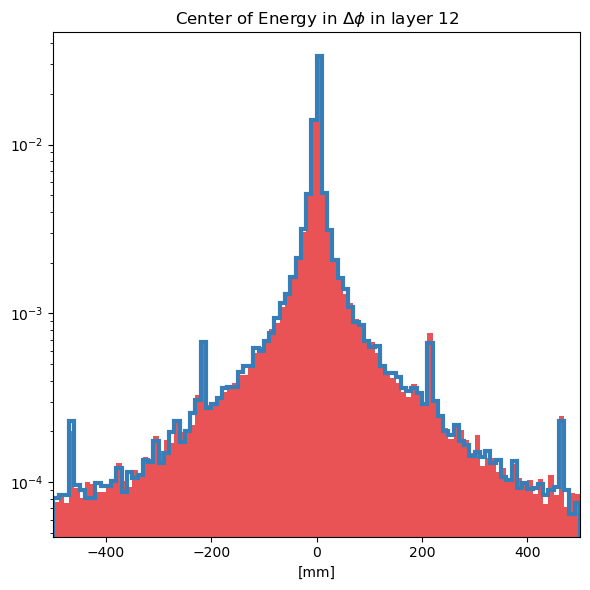

Separation power of EC Phi layer 13 histogram: 0.00044847813330496216


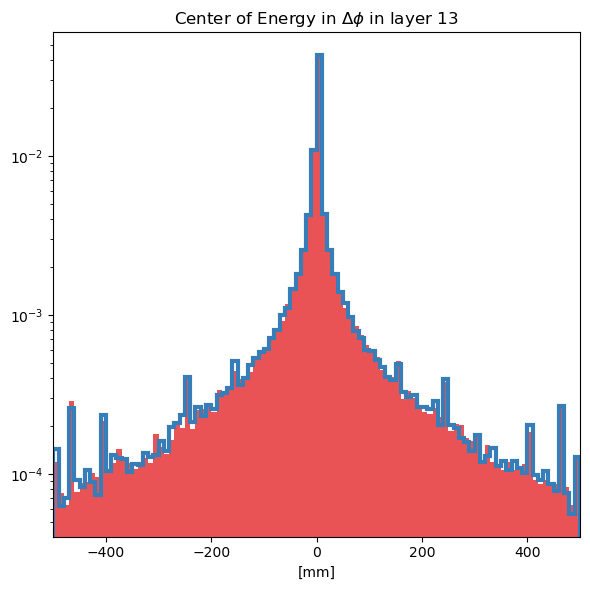

Separation power of Width Eta layer 1 histogram: 0.0003670703366797152


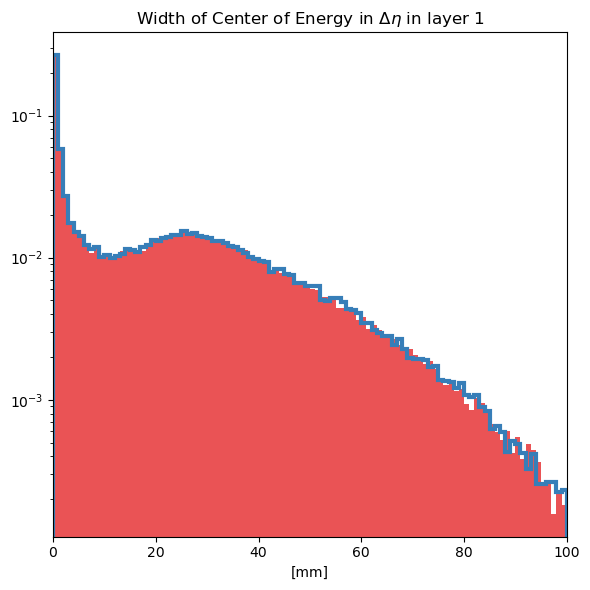

Separation power of Width Eta layer 2 histogram: 0.00041764631547070325


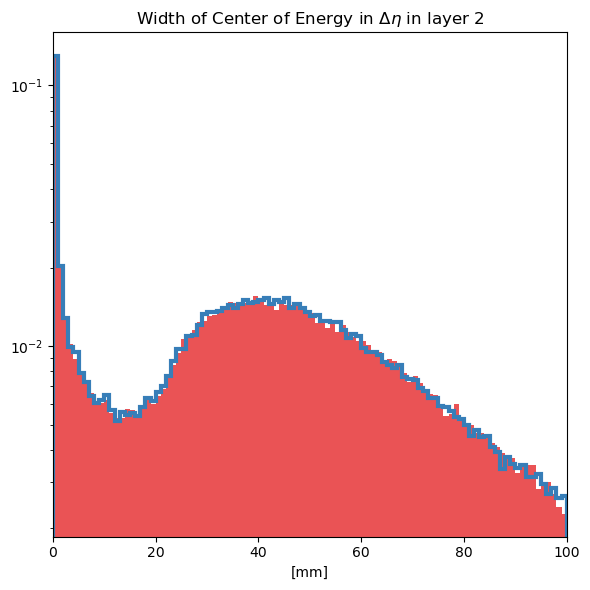

Separation power of Width Eta layer 12 histogram: 0.00047113999154968657


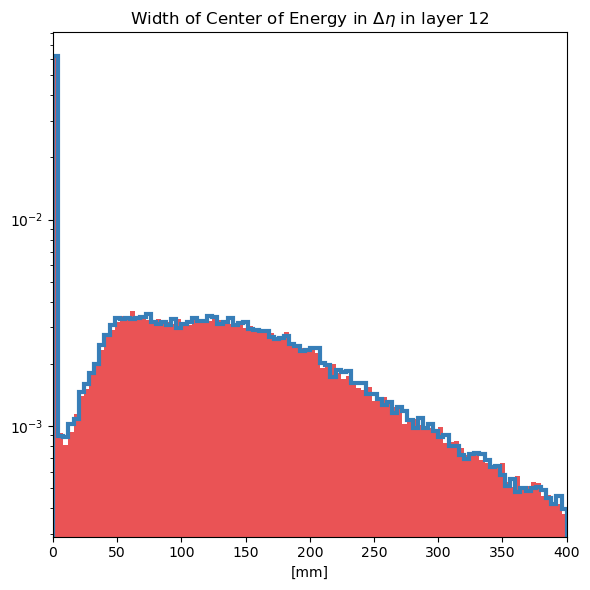

Separation power of Width Eta layer 13 histogram: 0.0003683613115207016


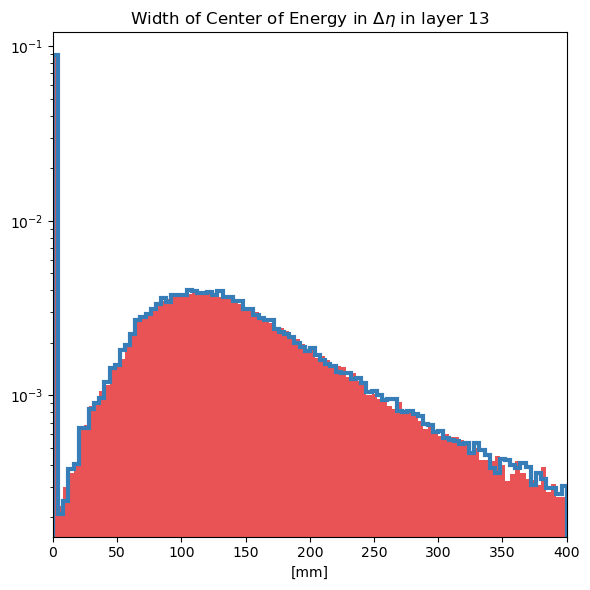

Separation power of Width Phi layer 1 histogram: 0.0005245640376995315


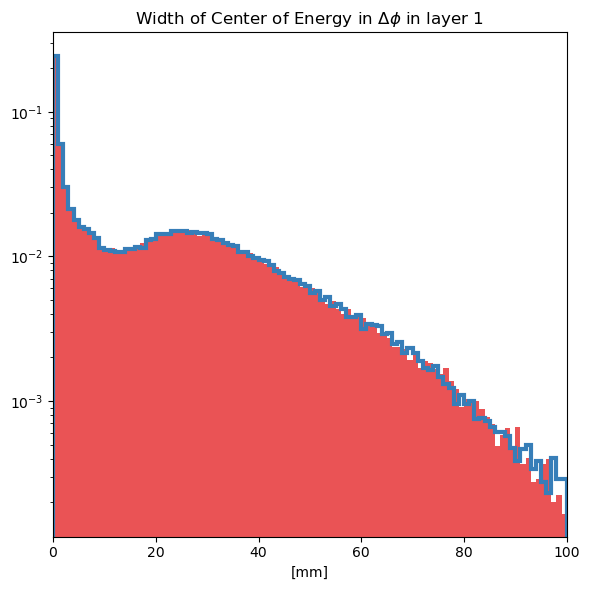

Separation power of Width Phi layer 2 histogram: 0.0003671111443247679


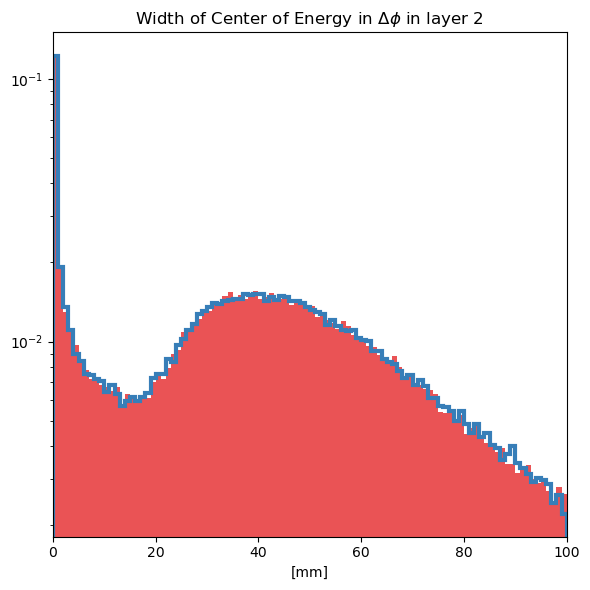

Separation power of Width Phi layer 12 histogram: 0.00037373074558213354


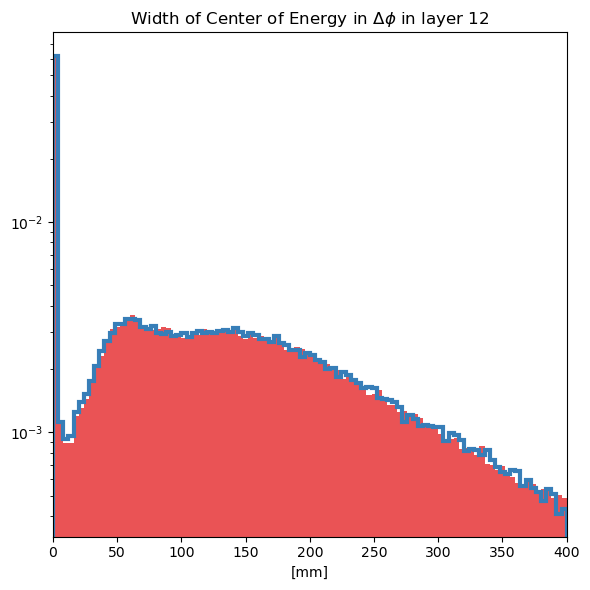

Separation power of Width Phi layer 13 histogram: 0.0004092386477073174


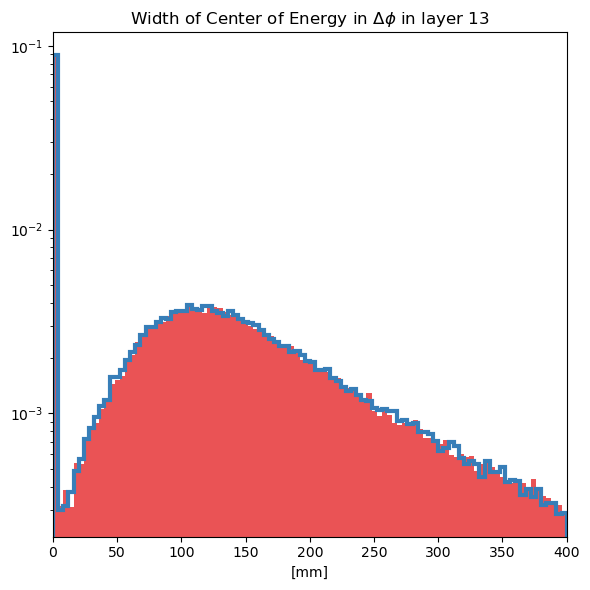

Separation power of Sparsity layer 0 histogram: 1.864666610993591e-05


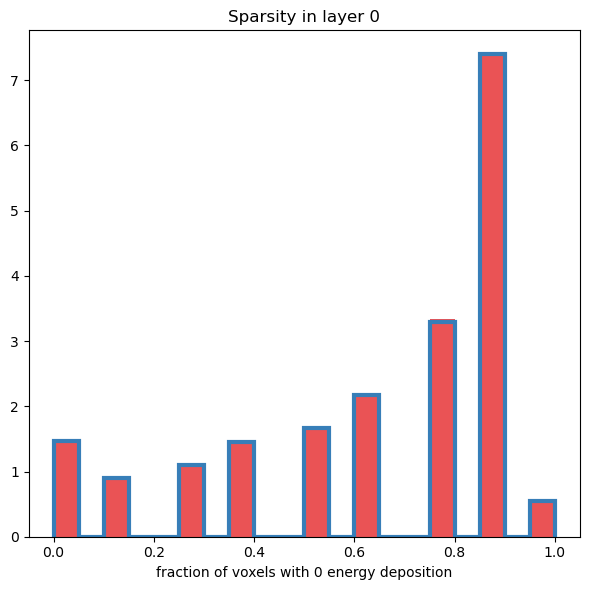

Separation power of Sparsity layer 1 histogram: 4.706555317188335e-05


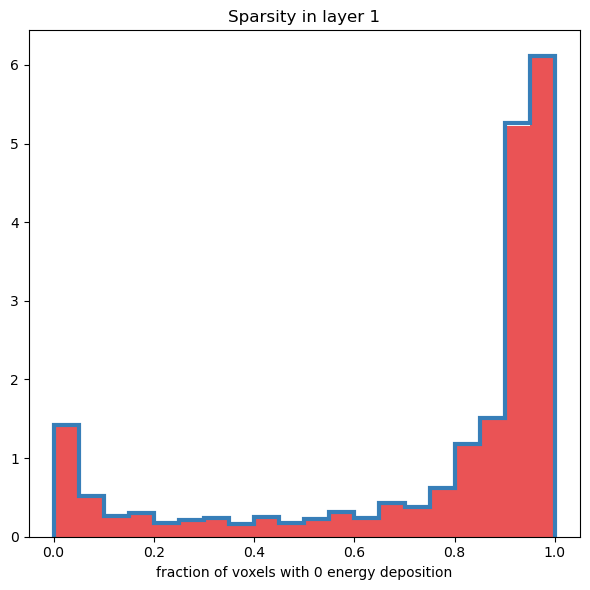

Separation power of Sparsity layer 2 histogram: 7.907003260413032e-05


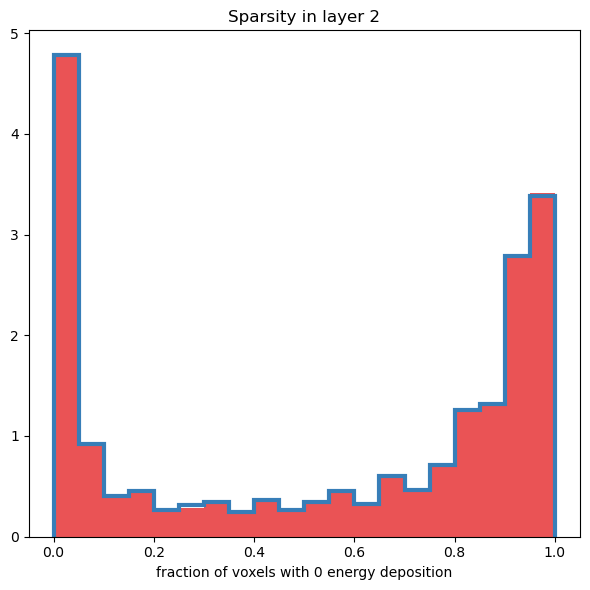

Separation power of Sparsity layer 3 histogram: 5.850116684152458e-06


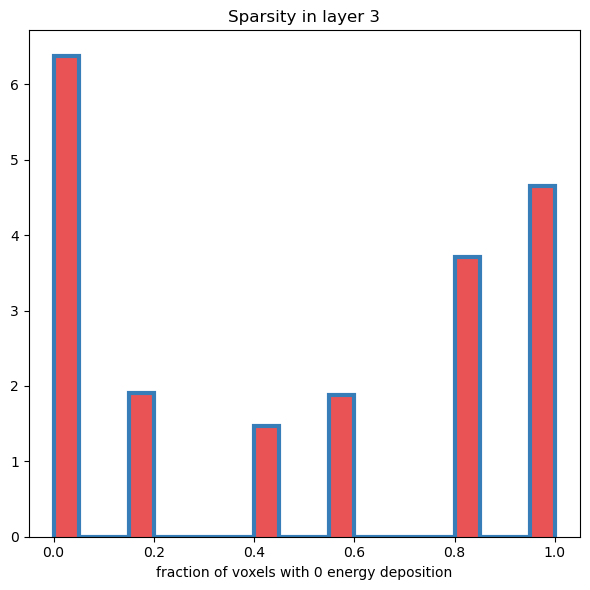

Separation power of Sparsity layer 12 histogram: 5.242559217233655e-05


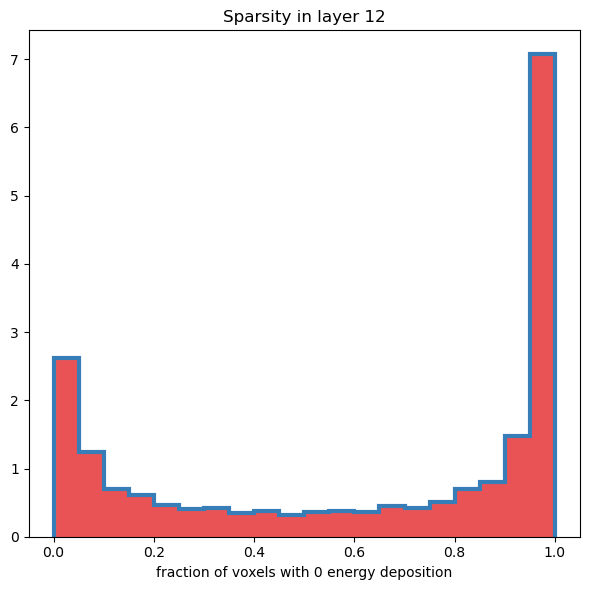

Separation power of Sparsity layer 13 histogram: 5.2434562179456456e-05


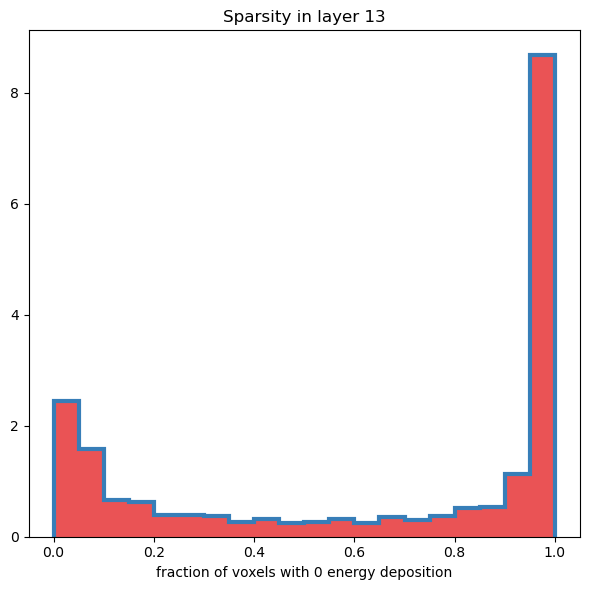

Separation power of Sparsity layer 14 histogram: 2.7178895694572425e-05


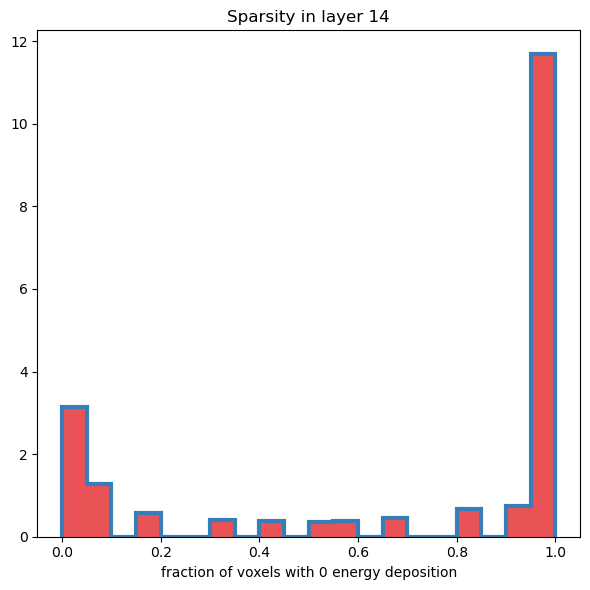

Separation power of EC r layer 0 histogram: 0.0003853848099608809


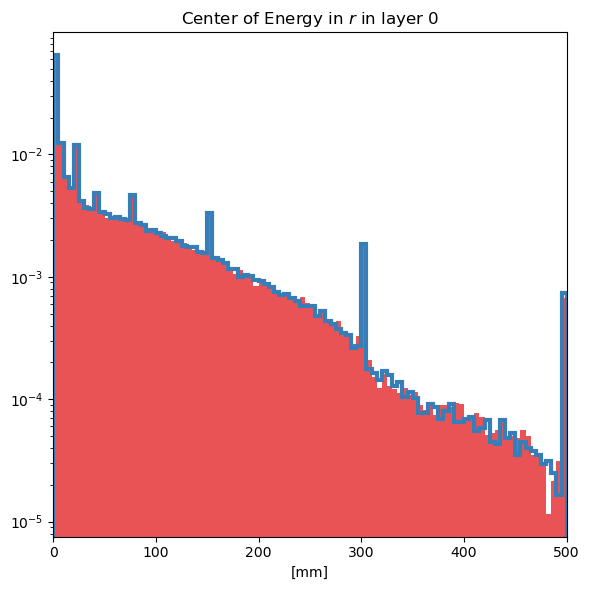

Separation power of EC r layer 1 histogram: 0.00019941903239379917


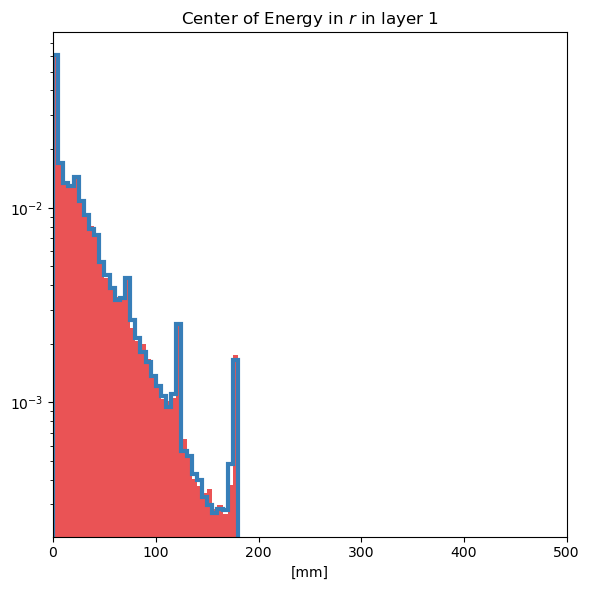

Separation power of EC r layer 2 histogram: 0.00021003563331184548


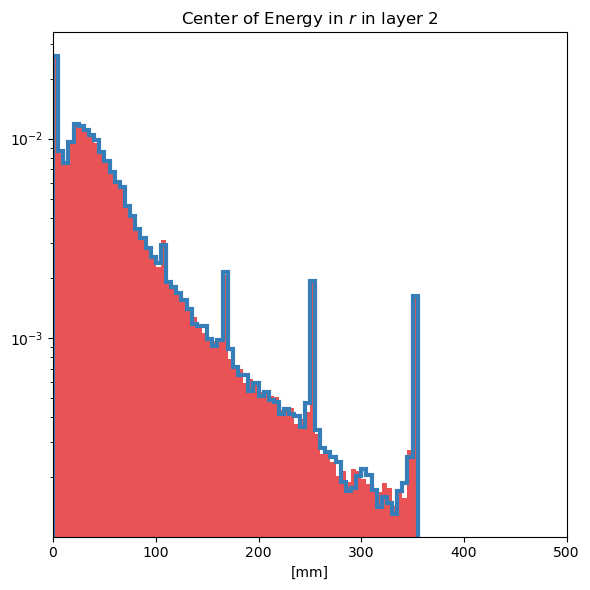

Separation power of EC r layer 3 histogram: 0.00035606855520326375


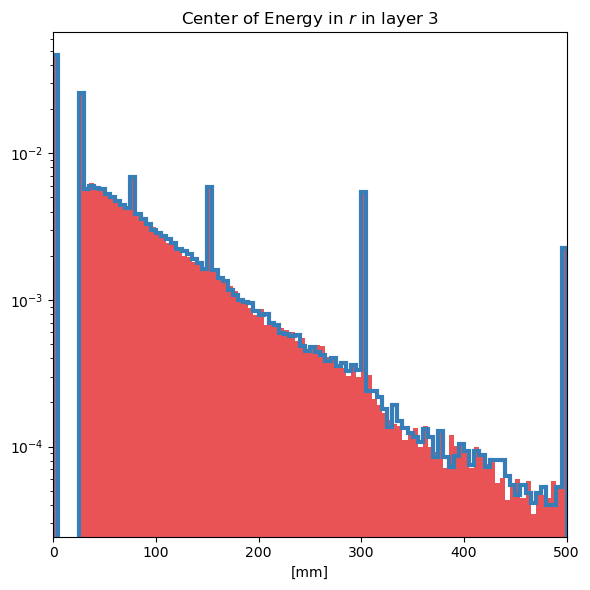

Separation power of EC r layer 12 histogram: 0.00046065150256501995


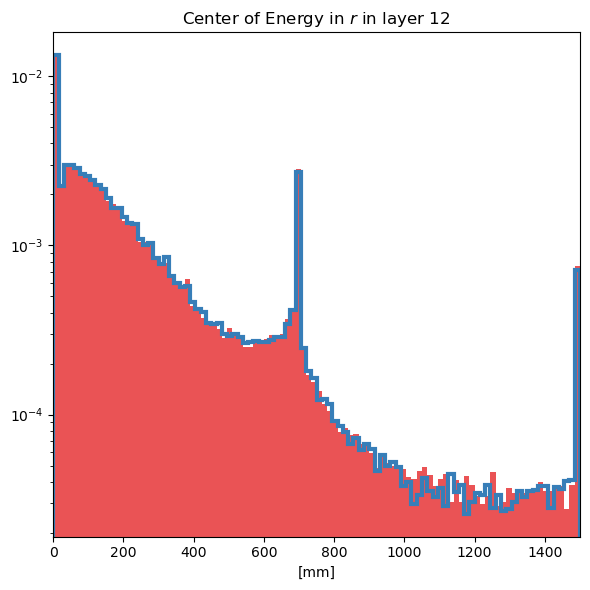

Separation power of EC r layer 13 histogram: 0.0003473569332796625


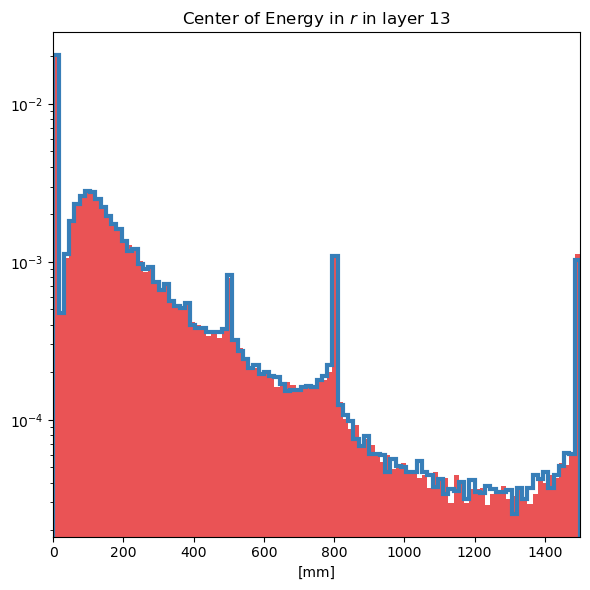

Separation power of EC r layer 14 histogram: 0.00041645900025725216


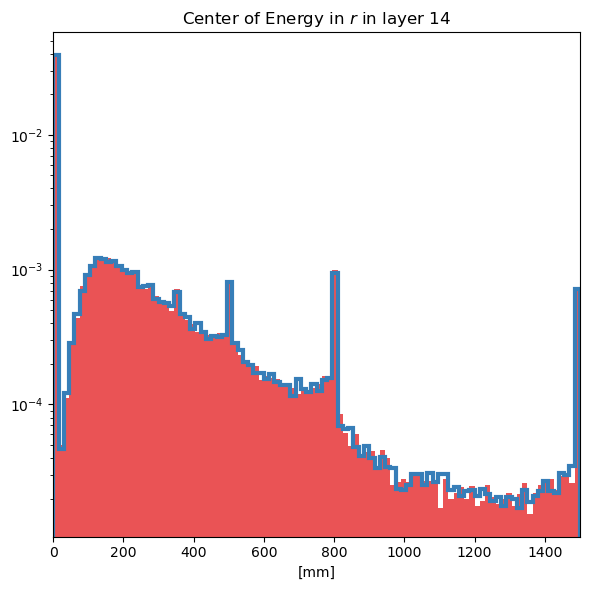

Separation power of Width r layer 0 histogram: 0.00021422095999127272


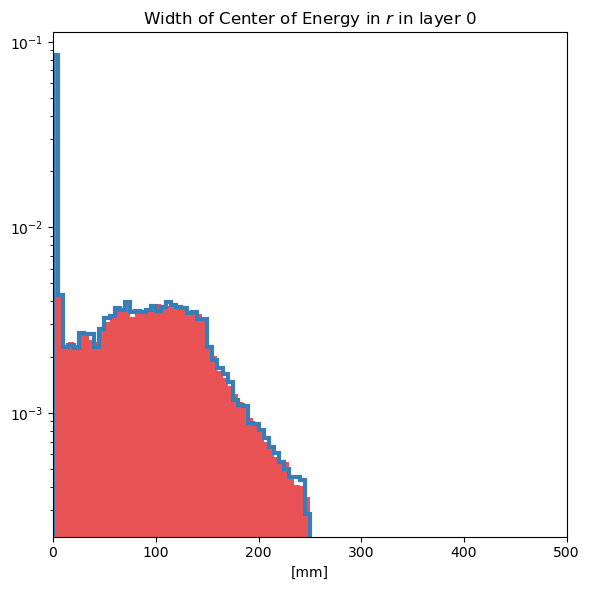

Separation power of Width r layer 1 histogram: 5.93451109423562e-05


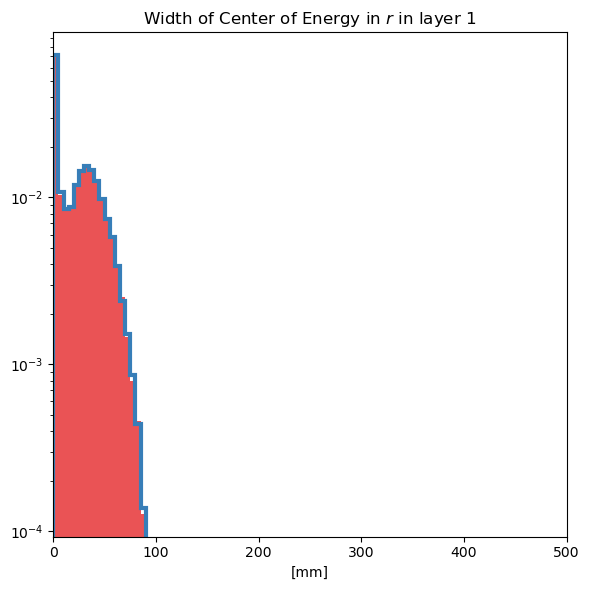

Separation power of Width r layer 2 histogram: 0.0001440964868406983


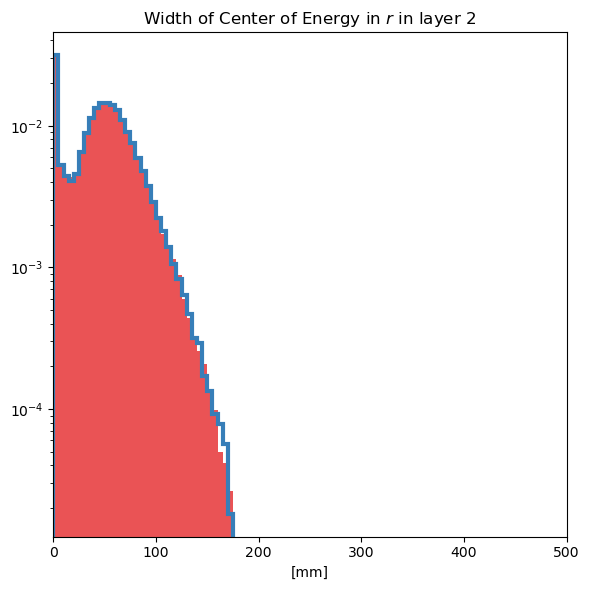

Separation power of Width r layer 3 histogram: 0.0002808458230486822


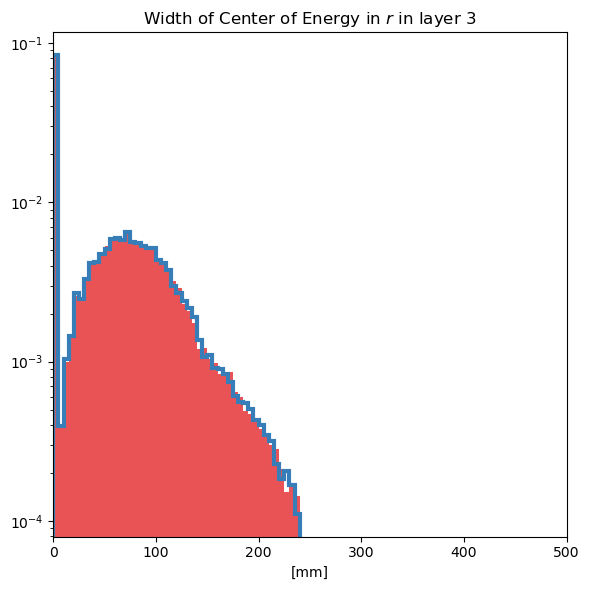

Separation power of Width r layer 12 histogram: 0.00023566206793907836


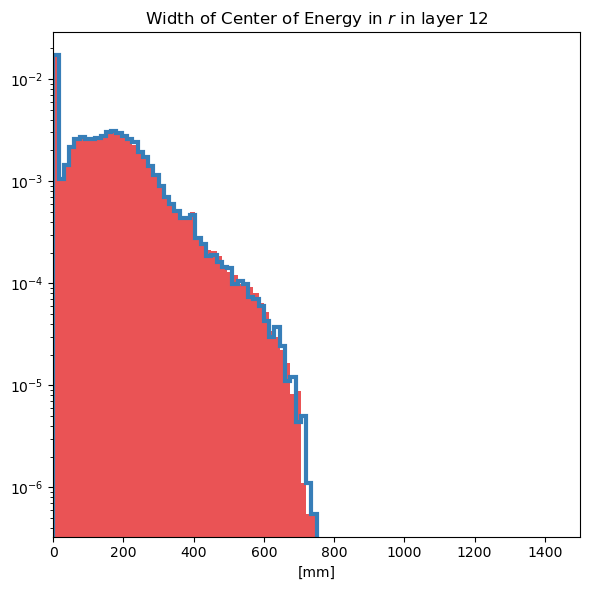

Separation power of Width r layer 13 histogram: 0.00020947658192211073


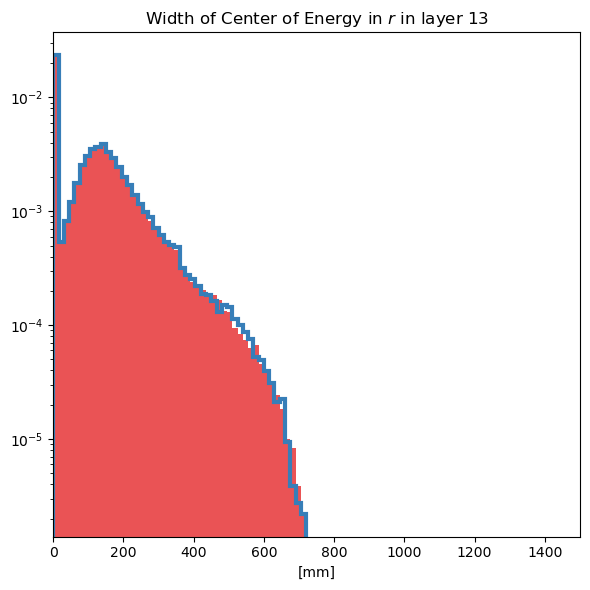

Separation power of Width r layer 14 histogram: 0.00021331671344309243


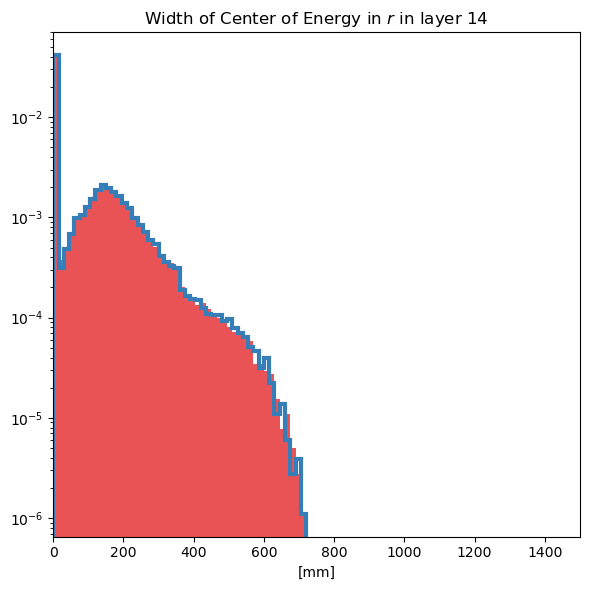

Separation power of voxel distribution histogram: 1.4569563710043019e-06


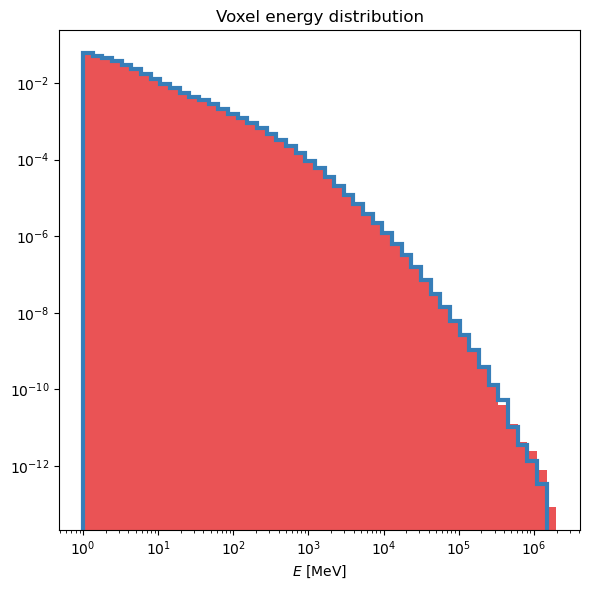

Separation power of Etot / Einc histogram: 0.0003281738451932236


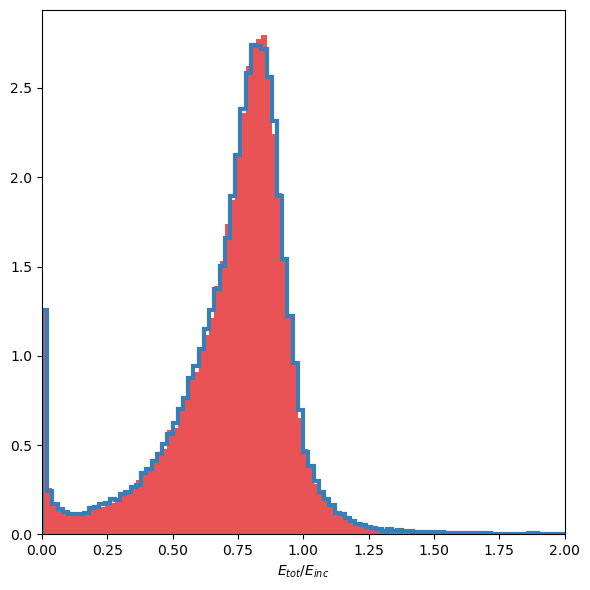

in iteration 10 of 10
Separation power of E layer 0 histogram: 0.0001811372912714698


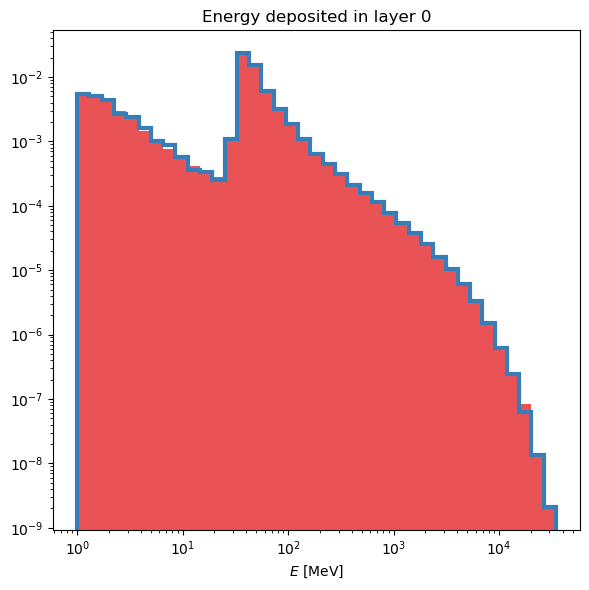

Separation power of E layer 1 histogram: 0.00015527982402927635


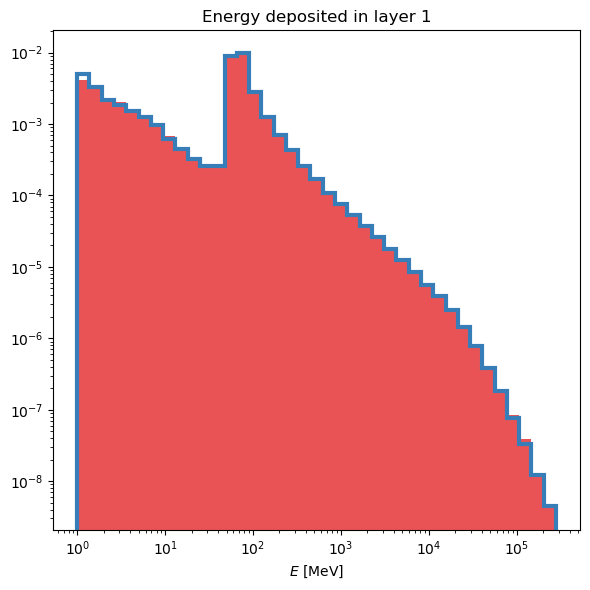

Separation power of E layer 2 histogram: 0.00010510626218459063


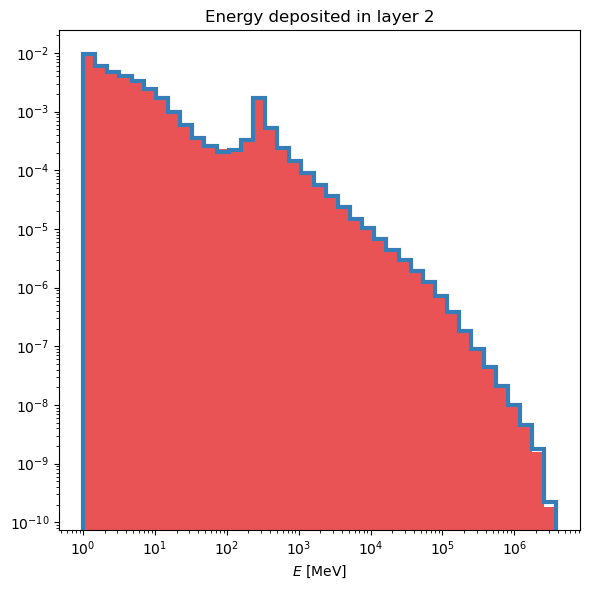

Separation power of E layer 3 histogram: 0.00019440437781816563


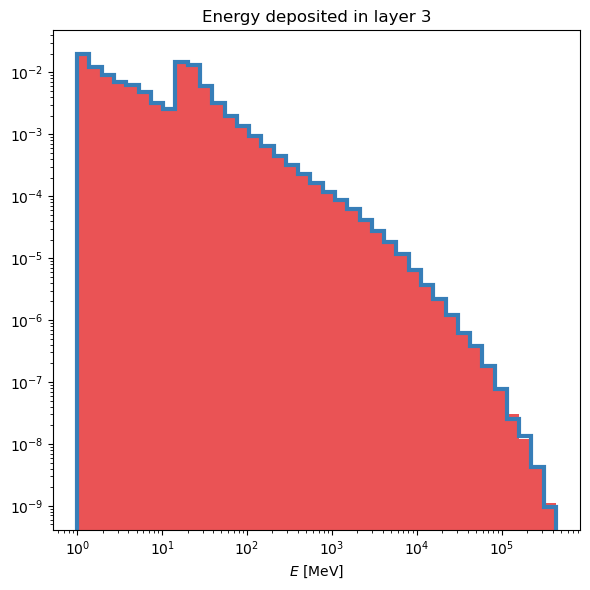

Separation power of E layer 12 histogram: 0.00013999080560934087


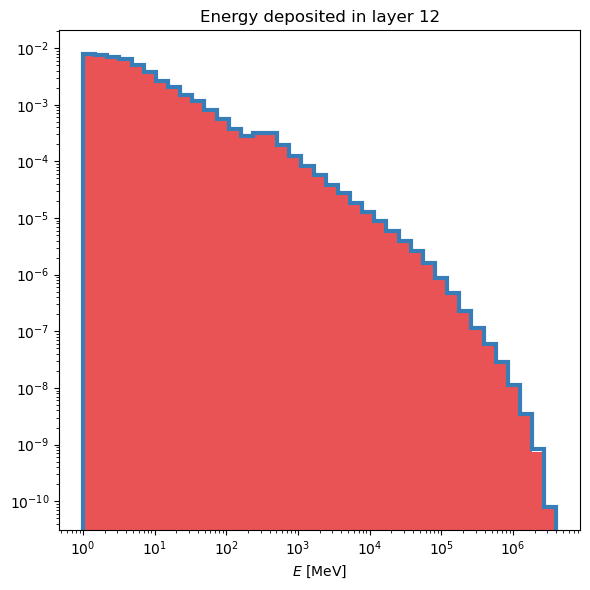

Separation power of E layer 13 histogram: 0.00018232090751650279


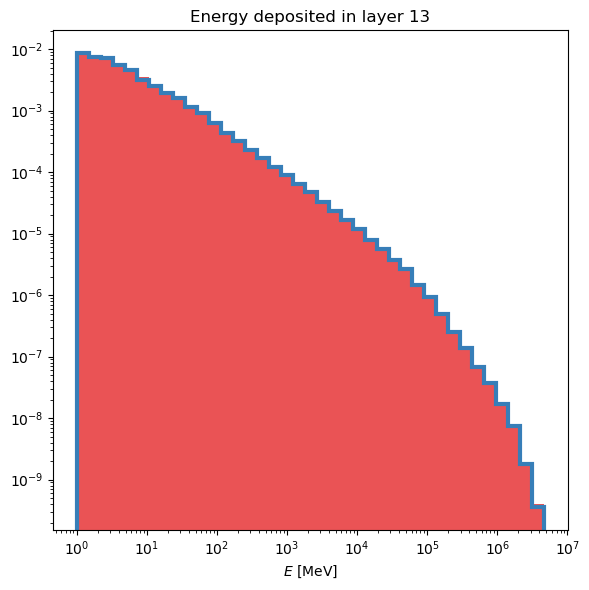

Separation power of E layer 14 histogram: 0.00028318229491400656


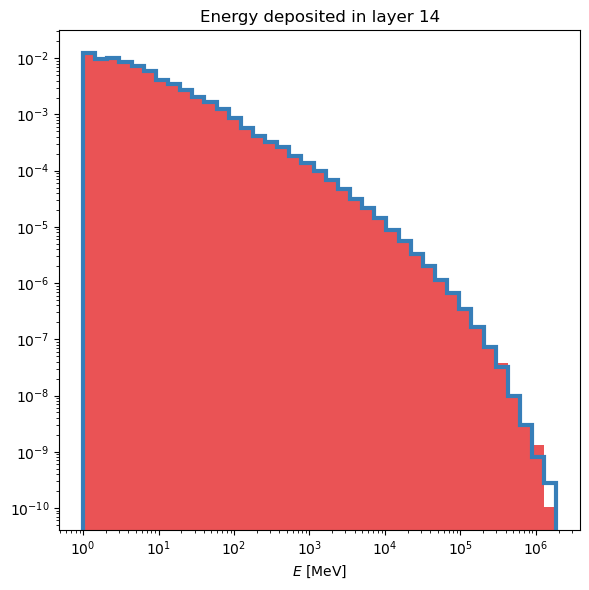

Separation power of EC Eta layer 1 histogram: 0.0005001870544526877


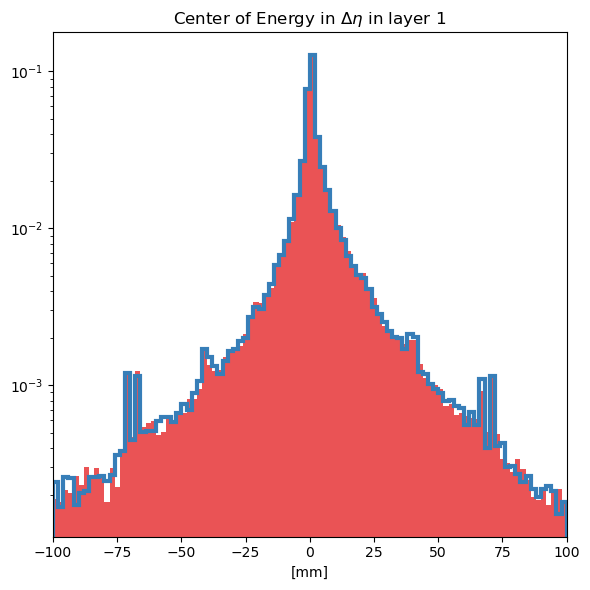

Separation power of EC Eta layer 2 histogram: 0.0003451902316749337


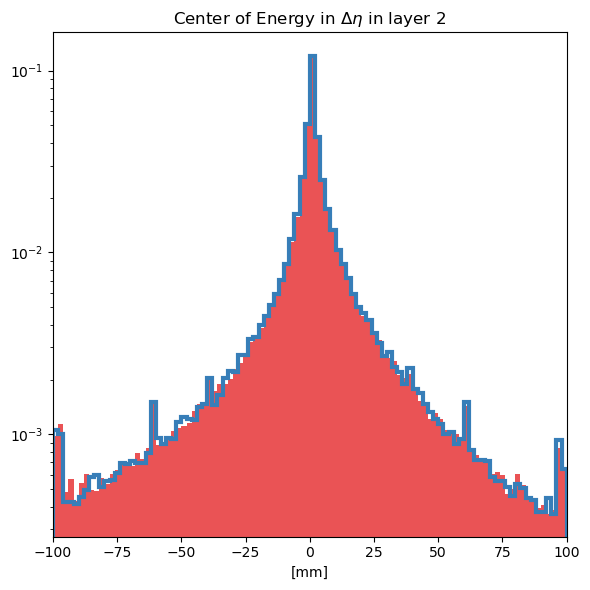

Separation power of EC Eta layer 12 histogram: 0.00046781841044592735


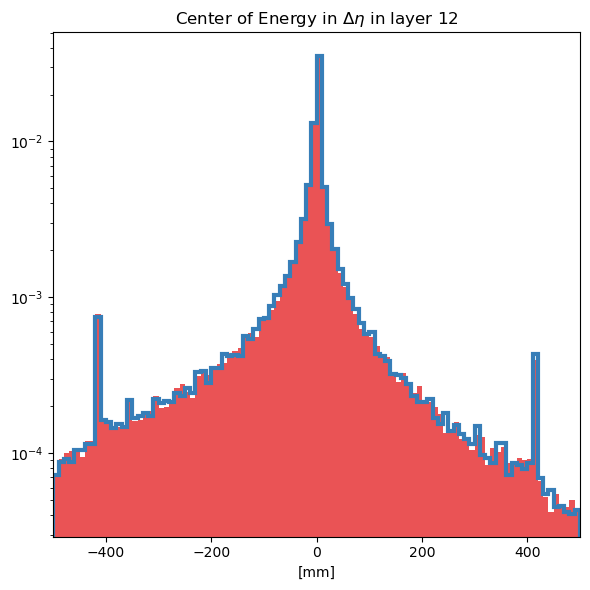

Separation power of EC Eta layer 13 histogram: 0.0003722456265565255


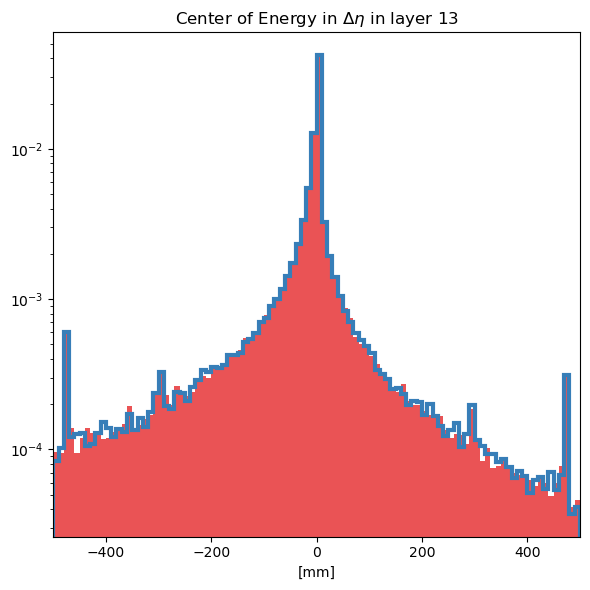

Separation power of EC Phi layer 1 histogram: 0.0004196699133439946


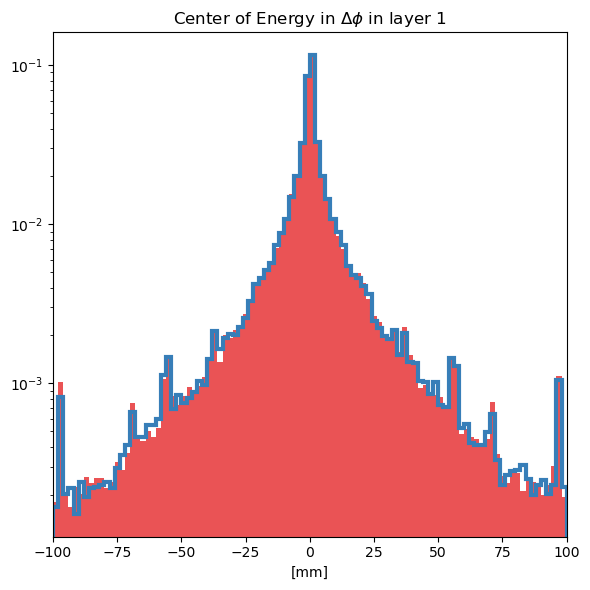

Separation power of EC Phi layer 2 histogram: 0.0004799323596702818


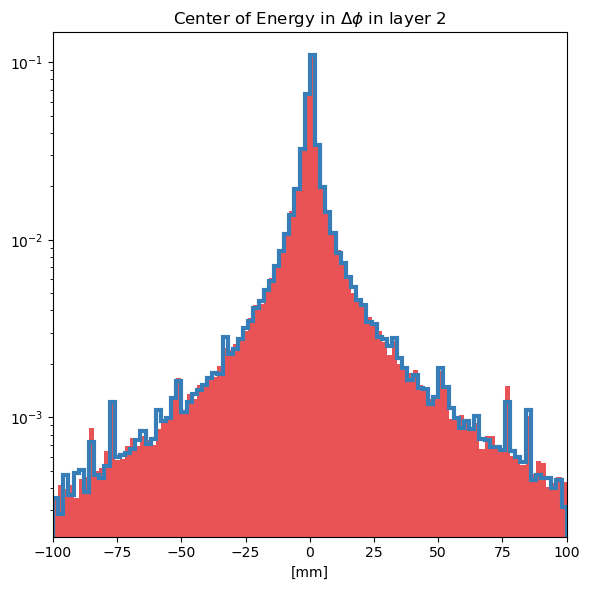

Separation power of EC Phi layer 12 histogram: 0.0003333434149839514


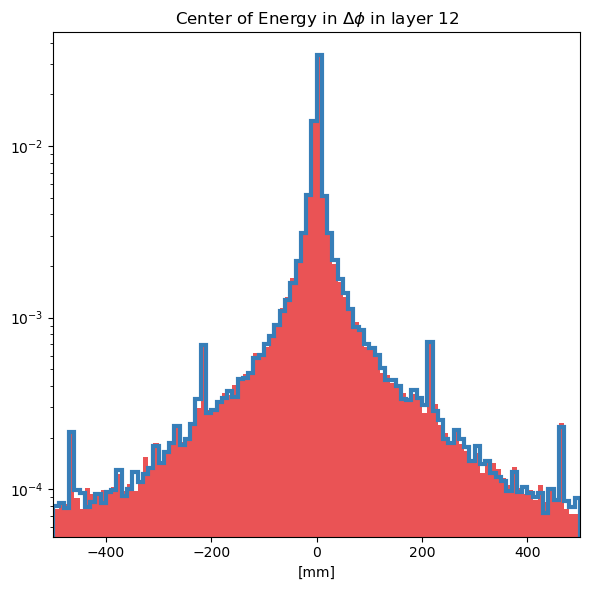

Separation power of EC Phi layer 13 histogram: 0.0004008187882891


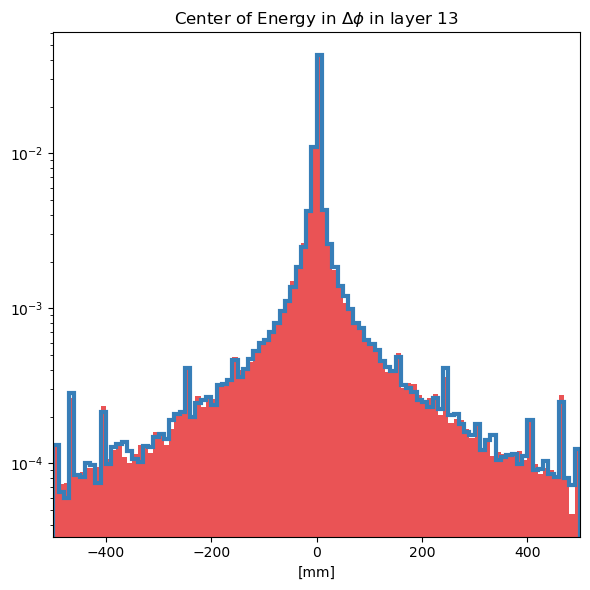

Separation power of Width Eta layer 1 histogram: 0.00039797233747279186


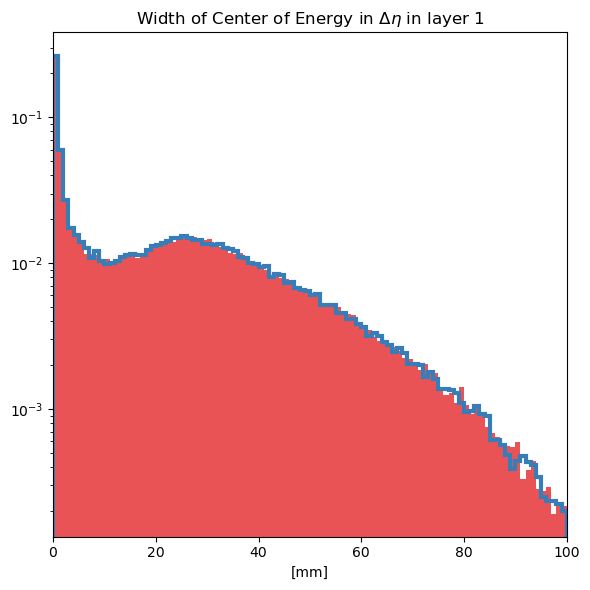

Separation power of Width Eta layer 2 histogram: 0.00046084526329528774


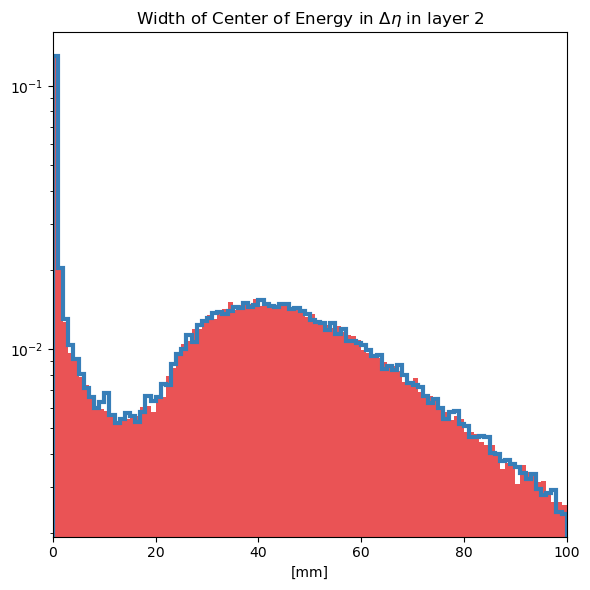

Separation power of Width Eta layer 12 histogram: 0.00043047773476607515


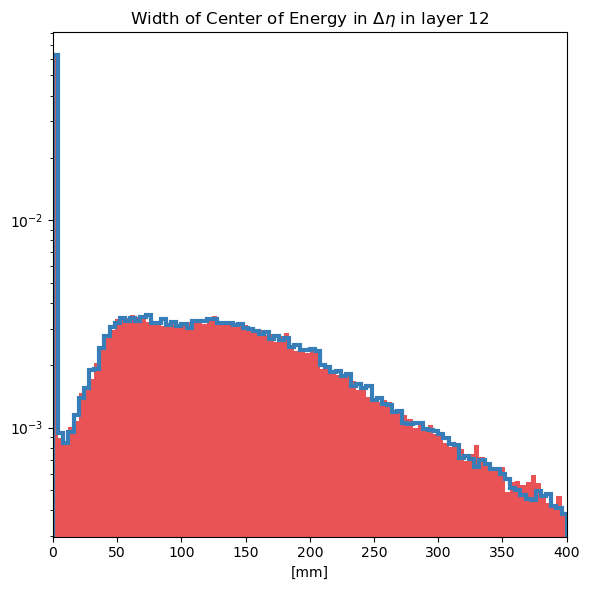

Separation power of Width Eta layer 13 histogram: 0.0004970560342451791


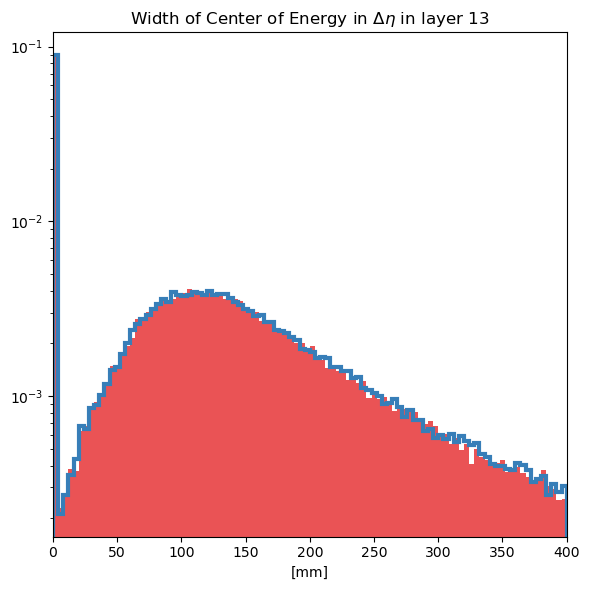

Separation power of Width Phi layer 1 histogram: 0.0004591567817996467


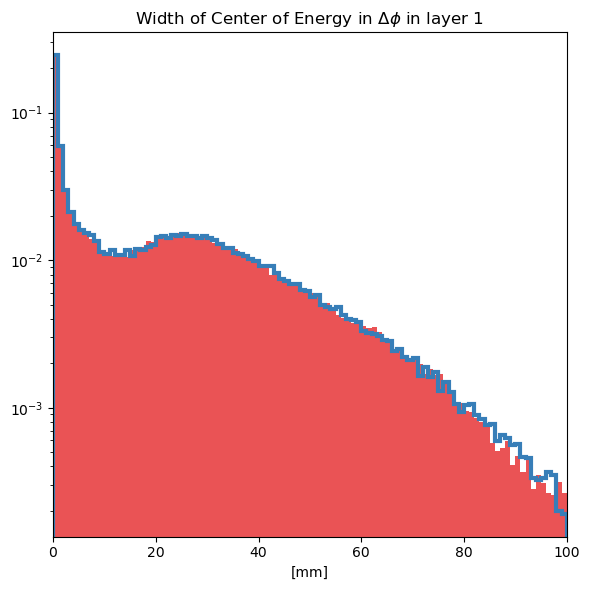

Separation power of Width Phi layer 2 histogram: 0.0005008430035434062


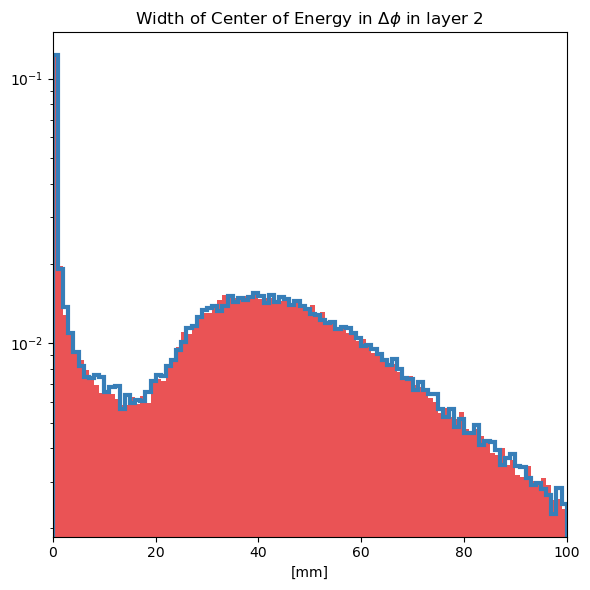

Separation power of Width Phi layer 12 histogram: 0.00040700984171361846


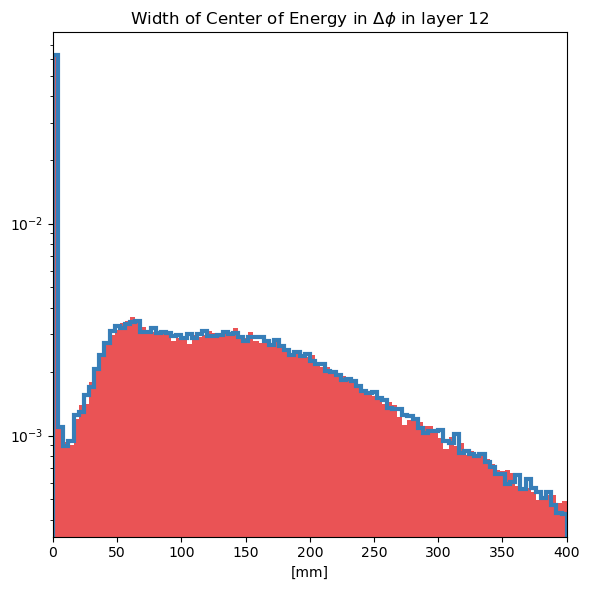

Separation power of Width Phi layer 13 histogram: 0.0004451937936120184


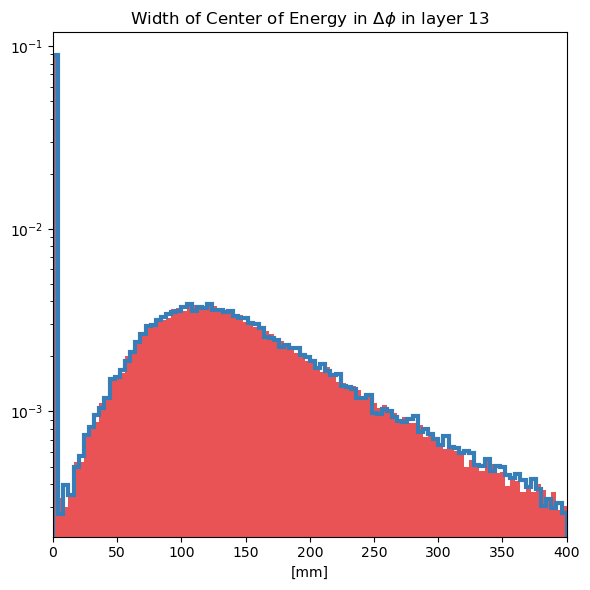

Separation power of Sparsity layer 0 histogram: 5.317535319987473e-05


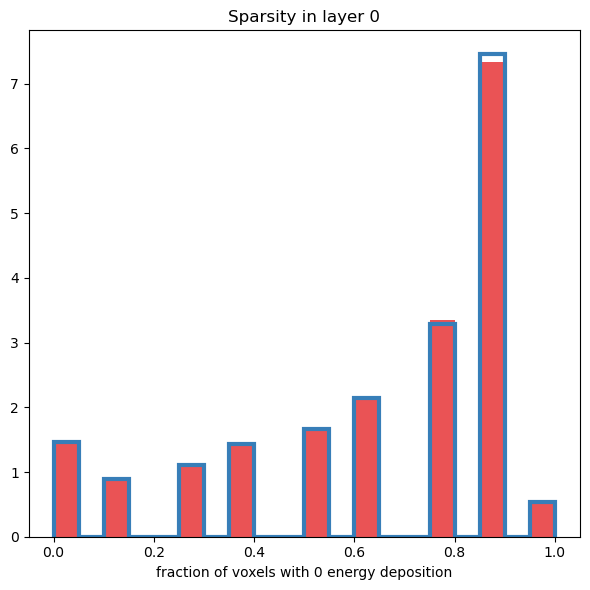

Separation power of Sparsity layer 1 histogram: 6.466522432525002e-05


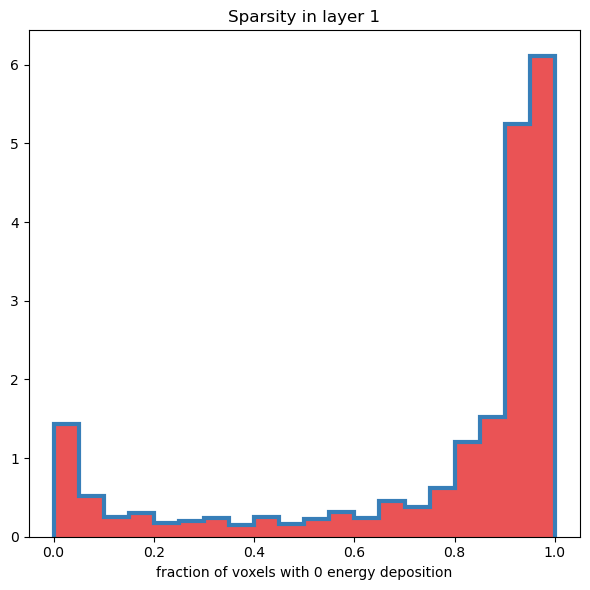

Separation power of Sparsity layer 2 histogram: 7.454954659729213e-05


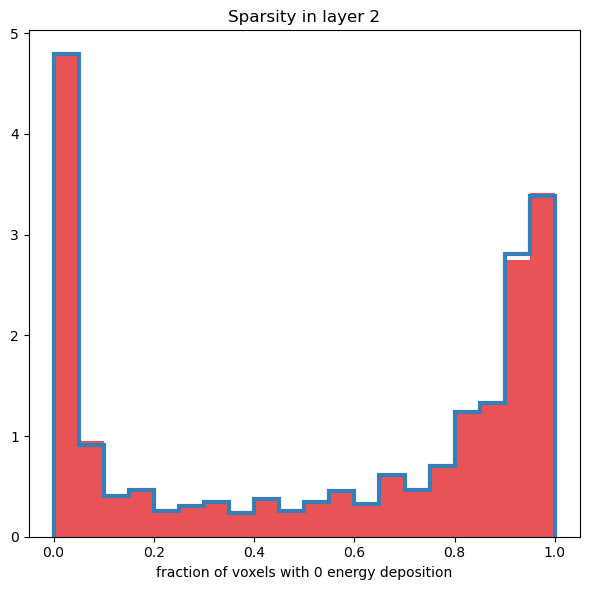

Separation power of Sparsity layer 3 histogram: 8.883907023632914e-06


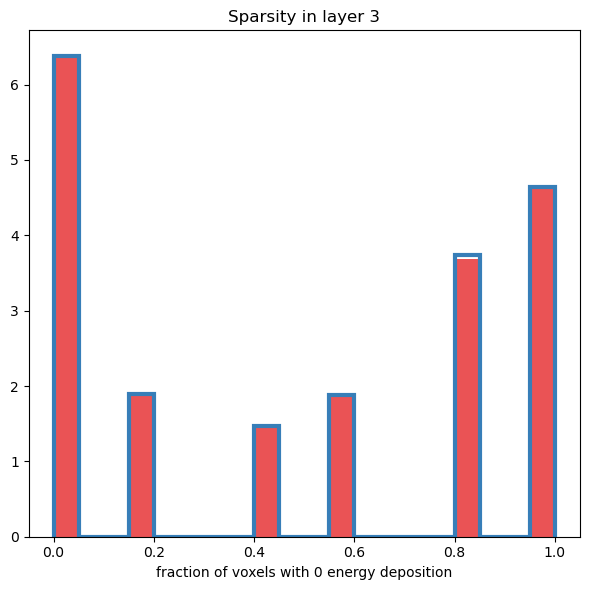

Separation power of Sparsity layer 12 histogram: 4.189092625253471e-05


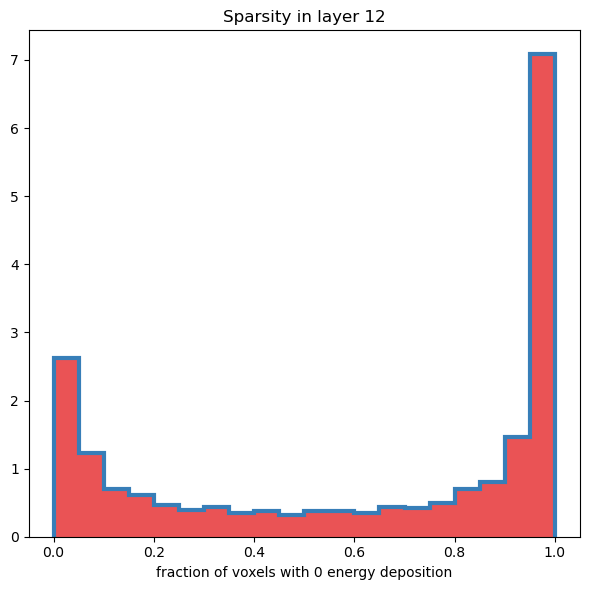

Separation power of Sparsity layer 13 histogram: 9.20249547464036e-05


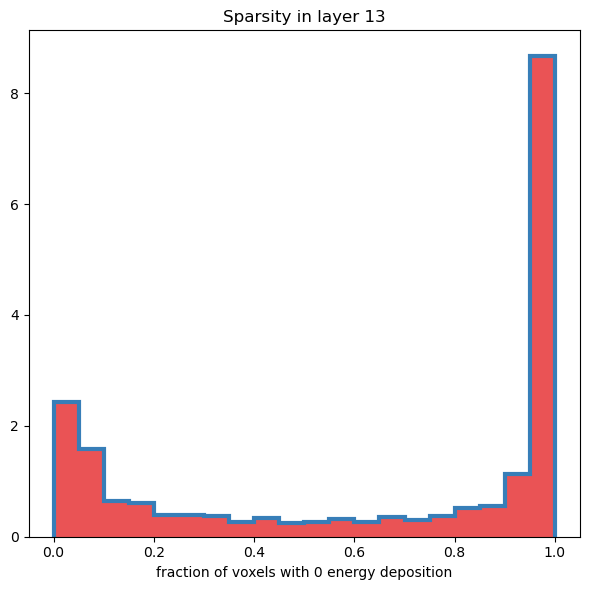

Separation power of Sparsity layer 14 histogram: 2.1130801639521948e-05


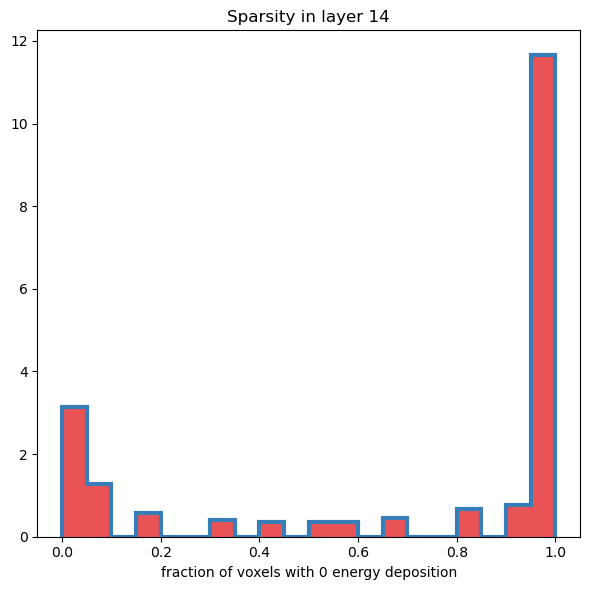

Separation power of EC r layer 0 histogram: 0.00037099662691641587


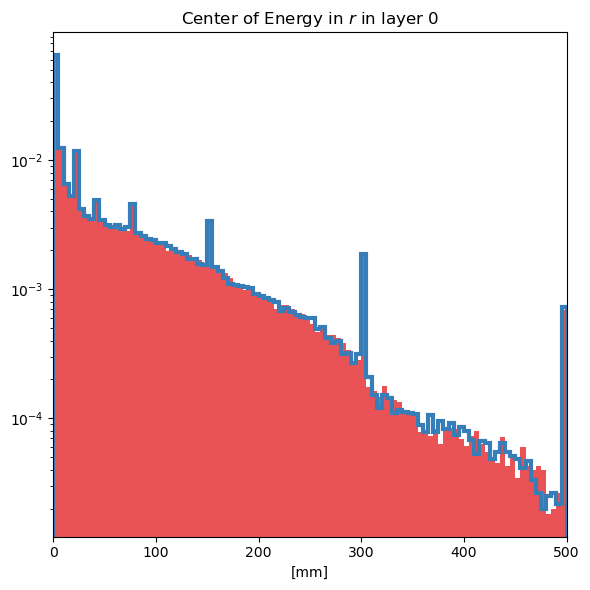

Separation power of EC r layer 1 histogram: 0.00012033471640358083


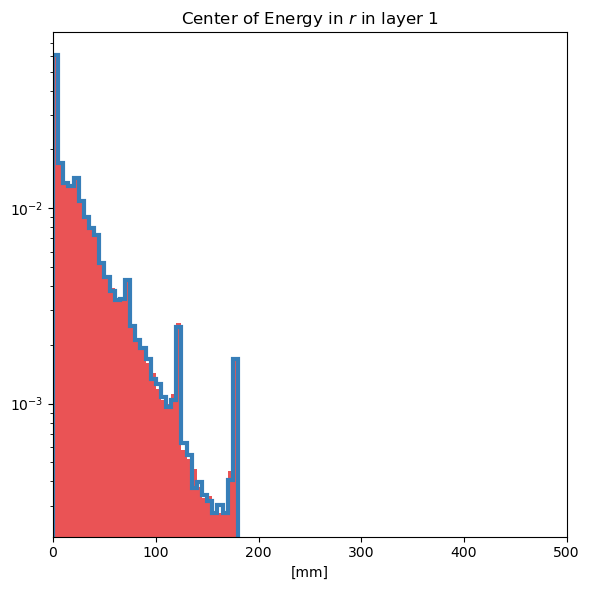

Separation power of EC r layer 2 histogram: 0.00024006823527221024


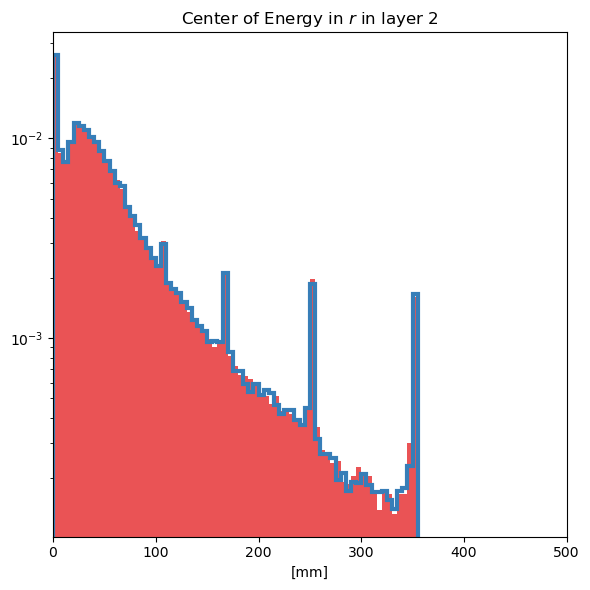

Separation power of EC r layer 3 histogram: 0.0003497284449935292


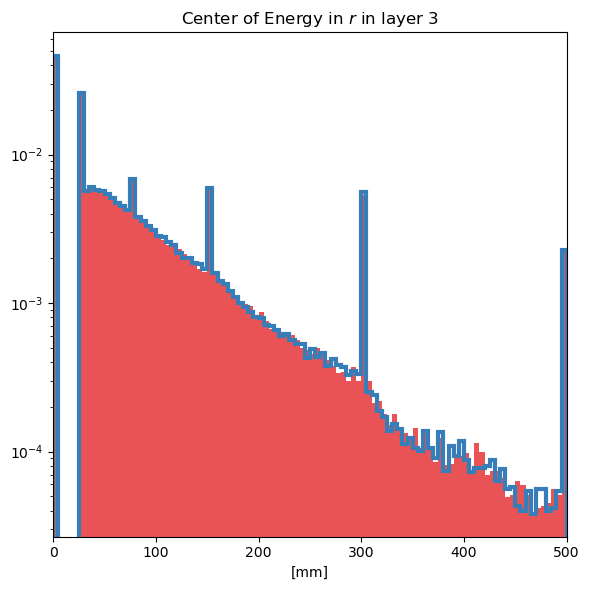

Separation power of EC r layer 12 histogram: 0.00036381902356380204


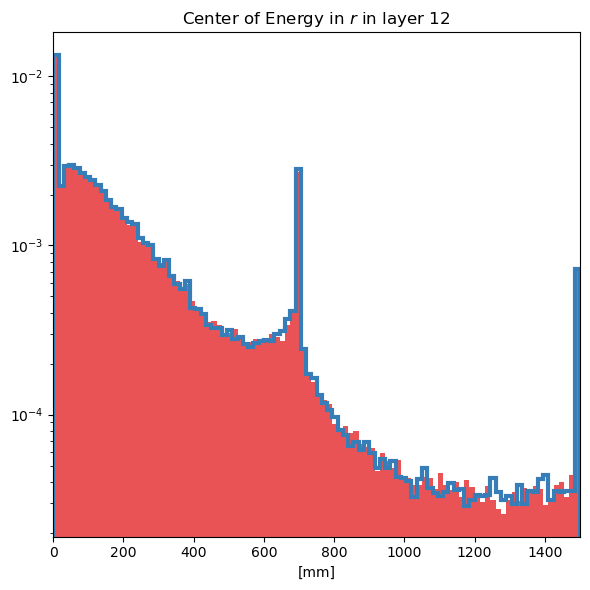

Separation power of EC r layer 13 histogram: 0.00038207932965183416


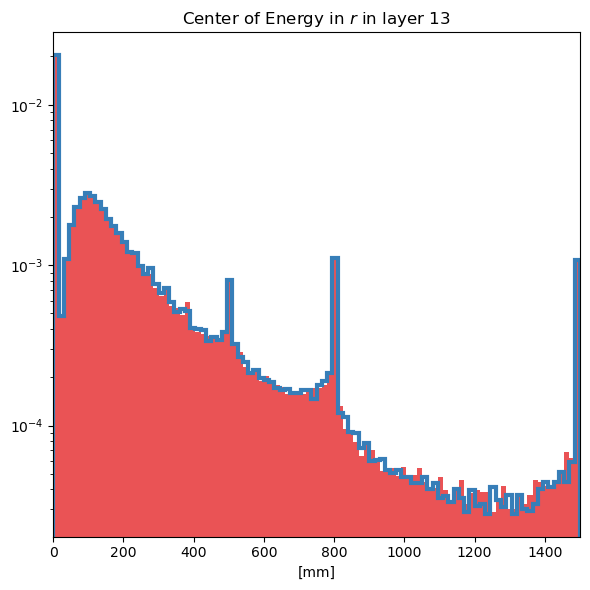

Separation power of EC r layer 14 histogram: 0.0003726075786390866


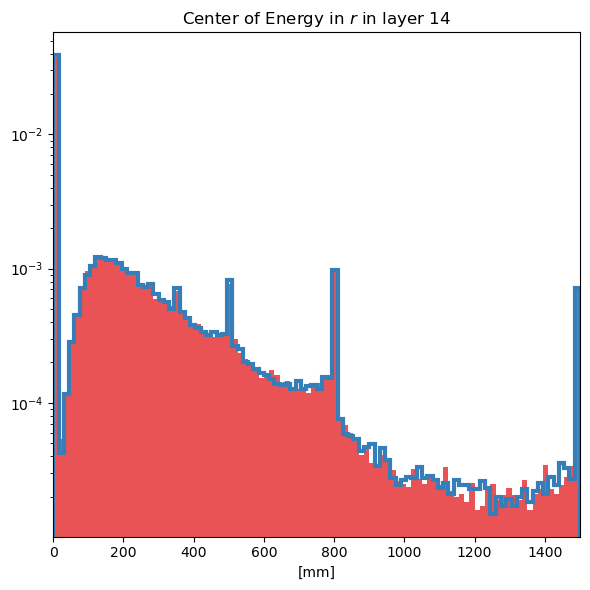

Separation power of Width r layer 0 histogram: 0.00020005559569227197


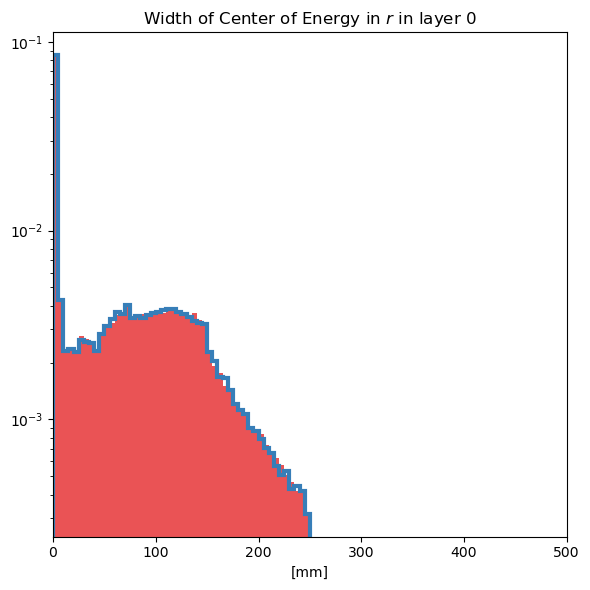

Separation power of Width r layer 1 histogram: 3.4928223160304805e-05


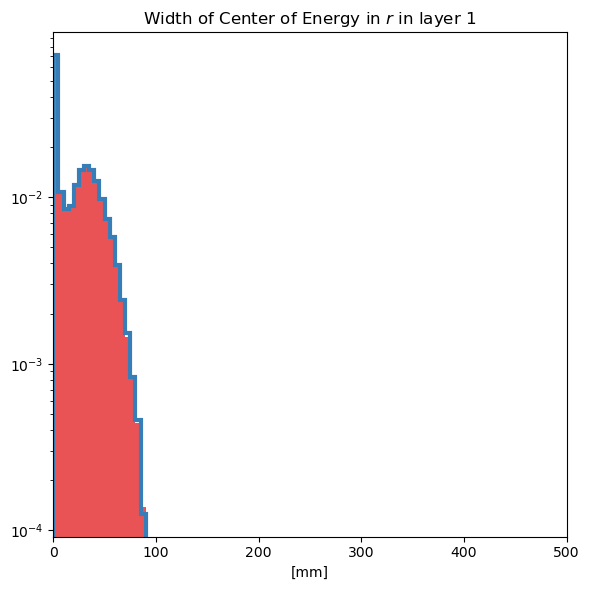

Separation power of Width r layer 2 histogram: 0.0001439618209949344


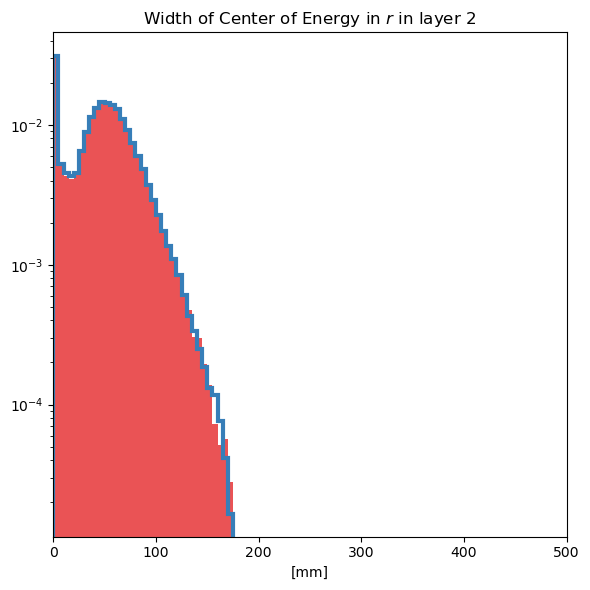

Separation power of Width r layer 3 histogram: 0.00018973354781238772


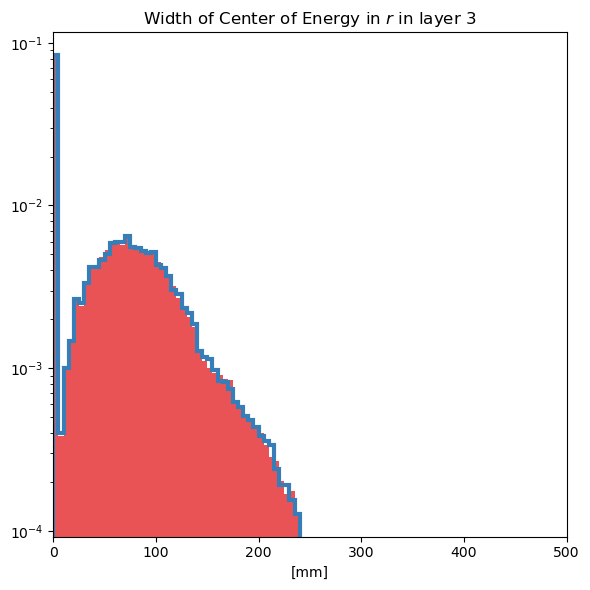

Separation power of Width r layer 12 histogram: 0.0002402018998186714


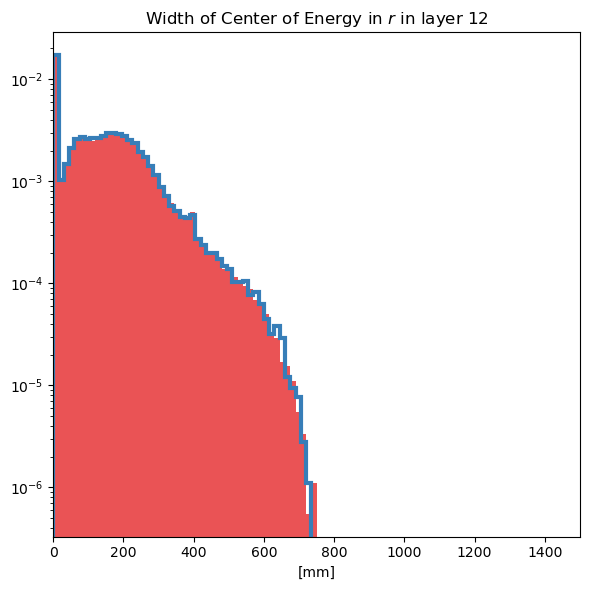

Separation power of Width r layer 13 histogram: 0.0002459375664257057


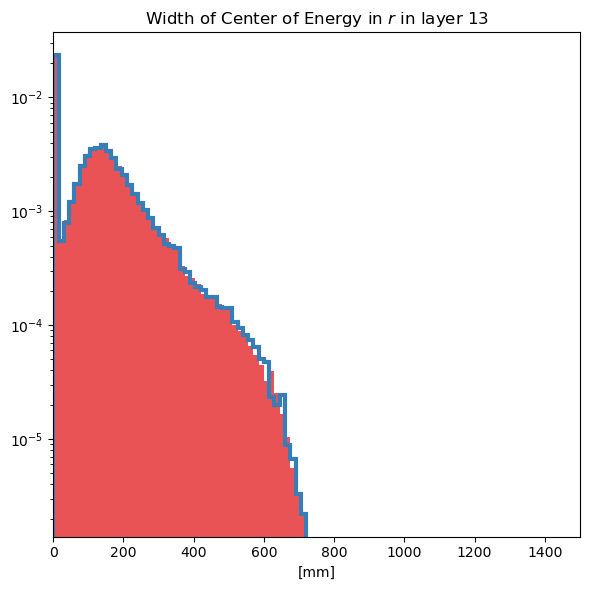

Separation power of Width r layer 14 histogram: 0.0001661179622862928


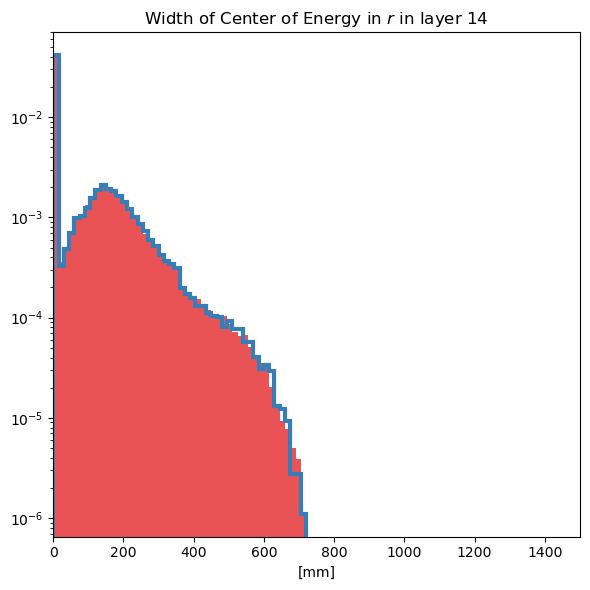

Separation power of voxel distribution histogram: 1.5680348096846762e-06


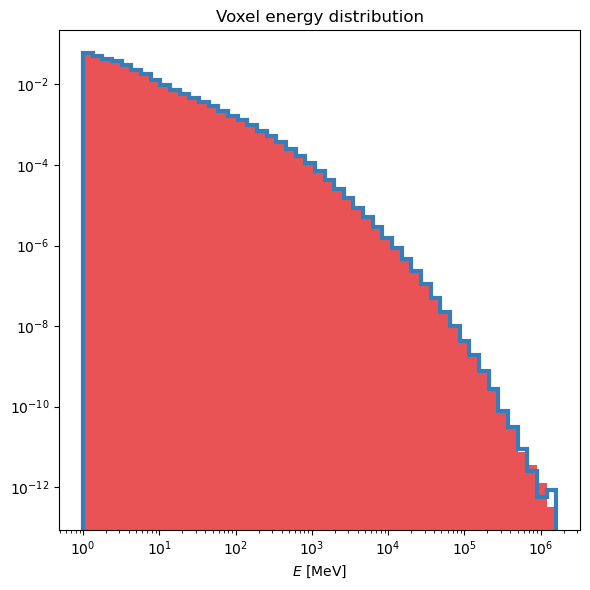

Separation power of Etot / Einc histogram: 0.00041455017538277104


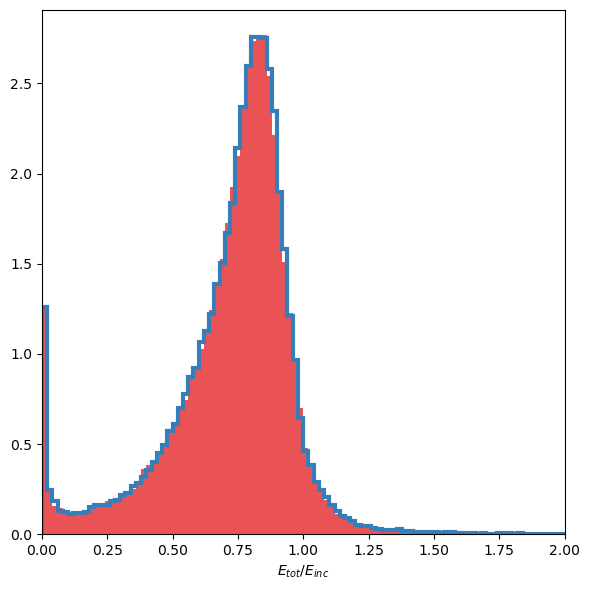

done


In [44]:
ds1_pions_reference_dict['E_layer_dict'] = []
ds1_pions_reference_dict['EC_eta_dict'] = []
ds1_pions_reference_dict['EC_phi_dict'] = []
ds1_pions_reference_dict['EC_eta_width_dict'] = []
ds1_pions_reference_dict['EC_phi_width_dict'] = []
ds1_pions_reference_dict['Sparsity_layer_dict'] = []
ds1_pions_reference_dict['EC_r_dict'] = []
ds1_pions_reference_dict['EC_r_width_dict'] = []
ds1_pions_reference_dict['cell_dist'] = []
ds1_pions_reference_dict['Etot_Einc_dist'] = []


for i in range(10):
    print(f'in iteration {i+1} of 10')
    ds1_pions_reference_dict['E_layer_dict'].append(get_sep_E_layers(HLF_pions_ref[2*i+1], HLF_pions_ref[2*i], ref=True))
    ds1_pions_reference_dict['EC_eta_dict'].append(get_sep_ECEtas(HLF_pions_ref[2*i+1], HLF_pions_ref[2*i], '1', ref=True))
    ds1_pions_reference_dict['EC_phi_dict'].append(get_sep_ECPhis(HLF_pions_ref[2*i+1], HLF_pions_ref[2*i], '1', ref=True))
    ds1_pions_reference_dict['EC_eta_width_dict'].append(get_sep_ECWidthEtas(HLF_pions_ref[2*i+1], HLF_pions_ref[2*i], '1', ref=True))
    ds1_pions_reference_dict['EC_phi_width_dict'].append(get_sep_ECWidthPhis(HLF_pions_ref[2*i+1], HLF_pions_ref[2*i], '1', ref=True))
    ds1_pions_reference_dict['Sparsity_layer_dict'].append(get_sep_Sparsity_layers(HLF_pions_ref[2*i+1], HLF_pions_ref[2*i], ref=True))
    ds1_pions_reference_dict['EC_r_dict'].append(get_sep_ECR(HLF_pions_ref[2*i+1], HLF_pions_ref[2*i], '1', ref=True))
    ds1_pions_reference_dict['EC_r_width_dict'].append(get_sep_ECWidthR(HLF_pions_ref[2*i+1], HLF_pions_ref[2*i], '1', ref=True))
    ds1_pions_reference_dict['cell_dist'].append(get_sep_cell_dist(HLF_pions_ref[2*i+1], HLF_pions_ref[2*i], ref=True))
    ds1_pions_reference_dict['Etot_Einc_dist'].append(get_sep_Etot_Einc(HLF_pions_ref[2*i+1], HLF_pions_ref[2*i], ref=True))

with open(f"ds1-pions_reference_{MIN_ENERGY}.pkl", 'wb') as handle:
    pickle.dump(ds1_pions_reference_dict, handle)

print(f"done")

#### ds2

In [20]:
# compute HLF
MIN_ENERGY = 0.5e-3/0.033

HLF_2_ref = []
ds2_reference_dict = {'MIN_ENERGY': MIN_ENERGY}

for i in range(2):
    print(f"working on file {i+1}.")
    HLF_2_ref.append(HLF.HighLevelFeatures('electron', 'CaloChallenge_homepage/code/binning_dataset_2.xml'))
    E_inc, showers = extract_info(f'../scratch_CaloChallenge/data/official/dataset_2_{i+1}.hdf5')
    HLF_2_ref[-1].Einc = E_inc
    showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
    HLF_2_ref[-1].showers = showers
    HLF_2_ref[-1].CalculateFeatures(showers)

print(f"done reading files")


working on file 1.
working on file 2.
done reading files


In [ ]:
ds2_reference_dict['E_layer_dict'] = get_sep_E_layers(HLF_2_ref[1], HLF_2_ref[0])
ds2_reference_dict['EC_eta_dict'] = get_sep_ECEtas(HLF_2_ref[1], HLF_2_ref[0], '2')
ds2_reference_dict['EC_phi_dict'] = get_sep_ECPhis(HLF_2_ref[1], HLF_2_ref[0], '2')
ds2_reference_dict['EC_eta_width_dict'] = get_sep_ECWidthEtas(HLF_2_ref[1], HLF_2_ref[0], '2')
ds2_reference_dict['EC_phi_width_dict'] = get_sep_ECWidthPhis(HLF_2_ref[1], HLF_2_ref[0], '2')
ds2_reference_dict['Sparsity_layer_dict'] = get_sep_Sparsity_layers(HLF_2_ref[1], HLF_2_ref[0])
ds2_reference_dict['EC_r_dict'] = get_sep_ECR(HLF_2_ref[1], HLF_2_ref[0], '2')
ds2_reference_dict['EC_r_width_dict'] = get_sep_ECWidthR(HLF_2_ref[1], HLF_2_ref[0], '2')
ds2_reference_dict['cell_dist'] = get_sep_cell_dist(HLF_2_ref[1].showers, HLF_2_ref[0].showers, shower_direct=True)
ds2_reference_dict['Etot_Einc_dist'] = get_sep_Etot_Einc(HLF_2_ref[1], HLF_2_ref[0])
    
with open('ds2_reference.pkl', 'wb') as handle:
    pickle.dump(ds2_reference_dict, handle)

print(f"done")

#### ds2 10 runs for errorbars

In [10]:
# compute HLF
MIN_ENERGY = 0.5e-3/0.033

HLF_2_ref = []
ds2_reference_dict = {'MIN_ENERGY': MIN_ENERGY}

HLF_2_ref.append(HLF.HighLevelFeatures('electron', 'CaloChallenge_homepage/code/binning_dataset_2.xml'))
E_inc, showers = extract_info(f'../scratch_CaloChallenge/data/official/dataset_2_2.hdf5')
HLF_2_ref[-1].Einc = E_inc
showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
HLF_2_ref[-1].showers = showers
HLF_2_ref[-1].CalculateFeatures(showers)

for i in range(3,13):
    print(f"working on file {i}.")
    HLF_2_ref.append(HLF.HighLevelFeatures('electron', 'CaloChallenge_homepage/code/binning_dataset_2.xml'))
    E_inc, showers = extract_info(f'../scratch_CaloChallenge/data/official_extended/dataset_2_{i}.hdf5')
    HLF_2_ref[-1].Einc = E_inc
    showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
    HLF_2_ref[-1].showers = showers
    HLF_2_ref[-1].CalculateFeatures(showers)

print(f"done reading files")


working on file 3.
working on file 4.
working on file 5.
working on file 6.
working on file 7.
working on file 8.
working on file 9.
working on file 10.
working on file 11.
working on file 12.
done reading files


In [ ]:
ds2_reference_dict['E_layer_dict'] = []
ds2_reference_dict['EC_eta_dict'] = []
ds2_reference_dict['EC_phi_dict'] = []
ds2_reference_dict['EC_eta_width_dict'] = []
ds2_reference_dict['EC_phi_width_dict'] = []
ds2_reference_dict['Sparsity_layer_dict'] = []
ds2_reference_dict['EC_r_dict'] = []
ds2_reference_dict['EC_r_width_dict'] = []
ds2_reference_dict['cell_dist'] = []
ds2_reference_dict['Etot_Einc_dist'] = []

for i in range(10):
    print(f'in iteration {i+1} of 10')
    ds2_reference_dict['E_layer_dict'].append(get_sep_E_layers(HLF_2_ref[i+1], HLF_2_ref[0]))
    ds2_reference_dict['EC_eta_dict'].append(get_sep_ECEtas(HLF_2_ref[i+1], HLF_2_ref[0], '2'))
    ds2_reference_dict['EC_phi_dict'].append(get_sep_ECPhis(HLF_2_ref[i+1], HLF_2_ref[0], '2'))
    ds2_reference_dict['EC_eta_width_dict'].append(get_sep_ECWidthEtas(HLF_2_ref[i+1], HLF_2_ref[0], '2'))
    ds2_reference_dict['EC_phi_width_dict'].append(get_sep_ECWidthPhis(HLF_2_ref[i+1], HLF_2_ref[0], '2'))
    ds2_reference_dict['Sparsity_layer_dict'].append(get_sep_Sparsity_layers(HLF_2_ref[i+1], HLF_2_ref[0]))
    ds2_reference_dict['EC_r_dict'].append(get_sep_ECR(HLF_2_ref[i+1], HLF_2_ref[0], '2'))
    ds2_reference_dict['EC_r_width_dict'].append(get_sep_ECWidthR(HLF_2_ref[i+1], HLF_2_ref[0], '2'))
    ds2_reference_dict['cell_dist'].append(get_sep_cell_dist(HLF_2_ref[i+1].showers, HLF_2_ref[0].showers, shower_direct=True))
    ds2_reference_dict['Etot_Einc_dist'].append(get_sep_Etot_Einc(HLF_2_ref[i+1], HLF_2_ref[0]))
    
with open('ds2_reference.pkl', 'wb') as handle:
    pickle.dump(ds2_reference_dict, handle)

print(f"done")

#### ds3

In [10]:
# compute HLF
MIN_ENERGY = 0.5e-3/0.033

HLF_3_ref = []
ds3_reference_dict = {'MIN_ENERGY': MIN_ENERGY}
filename = {0: 'dataset_3_1+2', 1: 'dataset_3_joined'}

for i in range(2):
    print(f"working on file {i+1}.")
    HLF_3_ref.append(HLF.HighLevelFeatures('electron', 'CaloChallenge_homepage/code/binning_dataset_3.xml'))
    E_inc, showers = extract_info(f'../scratch_CaloChallenge/data/official/{filename[i]}.hdf5')
    HLF_3_ref[-1].Einc = E_inc
    showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
    HLF_3_ref[-1].showers = showers
    HLF_3_ref[-1].CalculateFeatures(showers)

print(f"done reading files")


working on file 1.
working on file 2.
done reading files


In [ ]:
ds3_reference_dict['E_layer_dict'] = get_sep_E_layers(HLF_3_ref[1], HLF_3_ref[0])
ds3_reference_dict['EC_eta_dict'] = get_sep_ECEtas(HLF_3_ref[1], HLF_3_ref[0], '3')
ds3_reference_dict['EC_phi_dict'] = get_sep_ECPhis(HLF_3_ref[1], HLF_3_ref[0], '3')
ds3_reference_dict['EC_eta_width_dict'] = get_sep_ECWidthEtas(HLF_3_ref[1], HLF_3_ref[0], '3')
ds3_reference_dict['EC_phi_width_dict'] = get_sep_ECWidthPhis(HLF_3_ref[1], HLF_3_ref[0], '3')
ds3_reference_dict['Sparsity_layer_dict'] = get_sep_Sparsity_layers(HLF_3_ref[1], HLF_3_ref[0])
ds3_reference_dict['EC_r_dict'] = get_sep_ECR(HLF_3_ref[1], HLF_3_ref[0], '3')
ds3_reference_dict['EC_r_width_dict'] = get_sep_ECWidthR(HLF_3_ref[1], HLF_3_ref[0], '3')
ds3_reference_dict['cell_dist'] = get_sep_cell_dist(HLF_3_ref[1].showers, HLF_3_ref[0].showers, shower_direct=True)
ds3_reference_dict['Etot_Einc_dist'] = get_sep_Etot_Einc(HLF_3_ref[1], HLF_3_ref[0])
    
with open('ds3_reference.pkl', 'wb') as handle:
    pickle.dump(ds3_reference_dict, handle)

print(f"done")

#### ds3 10 runs for errorbars

In [10]:
# compute HLF
MIN_ENERGY = 0.5e-3/0.033

HLF_3_ref = []
ds3_reference_dict = {'MIN_ENERGY': MIN_ENERGY}
filename = {1: 'official/dataset_3_1+2', 0: 'official/dataset_3_joined'} # take reference wrt eval. set
for idx, i in enumerate(range(5,15)):
    filename[idx+2] = f'official_extended/dataset_3_{i}'

for i in filename.keys():
    print(f"working on file {filename[i]}.")
    if i in [7]:
        print(f"skipping file {filename[i]}.")
        continue
    HLF_3_ref.append(HLF.HighLevelFeatures('electron', 'CaloChallenge_homepage/code/binning_dataset_3.xml'))
    E_inc, showers = extract_info(f'../scratch_CaloChallenge/data/{filename[i]}.hdf5')
    HLF_3_ref[-1].Einc = E_inc
    showers = np.where(showers<MIN_ENERGY, np.zeros_like(showers), showers)
    HLF_3_ref[-1].showers = showers
    HLF_3_ref[-1].CalculateFeatures(showers)

print(f"done reading files")


working on file official/dataset_3_1+2.
working on file official/dataset_3_joined.
working on file official_extended/dataset_3_5.
working on file official_extended/dataset_3_6.
working on file official_extended/dataset_3_7.
working on file official_extended/dataset_3_8.
working on file official_extended/dataset_3_9.
working on file official_extended/dataset_3_10.
skipping file official_extended/dataset_3_10.
working on file official_extended/dataset_3_11.
working on file official_extended/dataset_3_12.
working on file official_extended/dataset_3_13.
working on file official_extended/dataset_3_14.
done reading files


In [ ]:
ds3_reference_dict['E_layer_dict'] = []
ds3_reference_dict['EC_eta_dict'] = []
ds3_reference_dict['EC_phi_dict'] = []
ds3_reference_dict['EC_eta_width_dict'] = []
ds3_reference_dict['EC_phi_width_dict'] = []
ds3_reference_dict['Sparsity_layer_dict'] = []
ds3_reference_dict['EC_r_dict'] = []
ds3_reference_dict['EC_r_width_dict'] = []
ds3_reference_dict['cell_dist'] = []
ds3_reference_dict['Etot_Einc_dist'] = []

for i in range(10):
    print(f'in iteration {i+1} of 10')
    ds3_reference_dict['E_layer_dict'].append(get_sep_E_layers(HLF_3_ref[i+1], HLF_3_ref[0]))
    ds3_reference_dict['EC_eta_dict'].append(get_sep_ECEtas(HLF_3_ref[i+1], HLF_3_ref[0], '3'))
    ds3_reference_dict['EC_phi_dict'].append(get_sep_ECPhis(HLF_3_ref[i+1], HLF_3_ref[0], '3'))
    ds3_reference_dict['EC_eta_width_dict'].append(get_sep_ECWidthEtas(HLF_3_ref[i+1], HLF_3_ref[0], '3'))
    ds3_reference_dict['EC_phi_width_dict'].append(get_sep_ECWidthPhis(HLF_3_ref[i+1], HLF_3_ref[0], '3'))
    ds3_reference_dict['Sparsity_layer_dict'].append(get_sep_Sparsity_layers(HLF_3_ref[i+1], HLF_3_ref[0]))
    ds3_reference_dict['EC_r_dict'].append(get_sep_ECR(HLF_3_ref[i+1], HLF_3_ref[0], '3'))
    ds3_reference_dict['EC_r_width_dict'].append(get_sep_ECWidthR(HLF_3_ref[i+1], HLF_3_ref[0], '3'))
    ds3_reference_dict['cell_dist'].append(get_sep_cell_dist(HLF_3_ref[i+1].showers, HLF_3_ref[0].showers, shower_direct=True))
    ds3_reference_dict['Etot_Einc_dist'].append(get_sep_Etot_Einc(HLF_3_ref[i+1], HLF_3_ref[0]))
    
with open('ds3_reference.pkl', 'wb') as handle:
    pickle.dump(ds3_reference_dict, handle)

print(f"done")

### Timing

In [40]:
# in ms per shower
ds1_photon_timing_dict = {1: 91.7, 4: 0.647, 7: 0.824, 8: 129., 9: 18.3, 10: 2.59, 27: 0.507, 12: 0.760, 16: 1.83}
ds1_pion_timing_dict = {1: 101., 4: 0.425, 7: 0.744, 27: 0.544, 12: 0.952, 16: 4.64}
ds2_timing_dict = {1: 495., 3: 17.1, 5: 1.10, 7: 1.40, 8: 970., 9: 123., 10: 4.30, 15: 150., 22: 5.03, 
                   27: 1.05, 14: 15.4, 23: 3.54, 4: 1.82}
ds3_timing_dict = {1: 406., 3: 77.2, 5: 5.07, 6: 50.6, 7: 3.53, 9: 631., 10: 17.8, 27: 3.54, 14: 25.9, 23: 10.6}


# copied from above
ds1_photon_cls_dict = {1: -2.0506, 4: -2.2104, 7: -11.4103, 8: -2.87819, 9: -3.3831, 10: -4.1859,
                       11: -2.4987, 12: -2.6619, 16: -15.7763, 17: -7.4741, 25: -5.2747, 26: -5.2186, 27: -3.8530}
ds1_pion_cls_dict = {1: -2.0939, 4: -2.9518, 7: -7.8493, 11: -3.5017, 12: -4.2131, 16: -13.9270, 17: -6.9995,
                     20: -2.2117, 24: -4.1314, 27: -3.6720}
ds2_cls_dict = {1: -2.4895, 3: -2.9404, 4: -2.9061, 5: -4.3483, 7: -8.1542, 8: -2.7967, 9: -3.2482, 10: -3.4612,
                13: -3.1657, 14: -3.6658, 15: -2.7070, 22: -7.9900, 23: -3.369527, 27: -4.5236}
ds3_cls_dict = {1: -2.2818, 2: -3.5881, 3: -2.3636, 5: -7.4930, 6: -5.3565, 7: -12.6454, 9: -3.1603, 10: -3.6653,
                13: -5.9583, 14: -5.3947, 21: -8.9068, 23: -2.8335, 27: -6.0804}

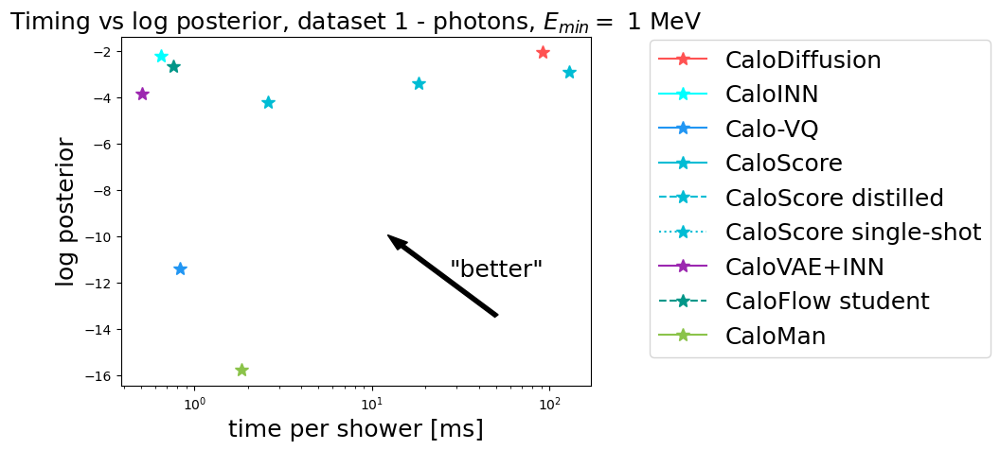

missing:
CaloFlow teacher
BoloGAN
CaloShower2GAN
CaloShower3GAN


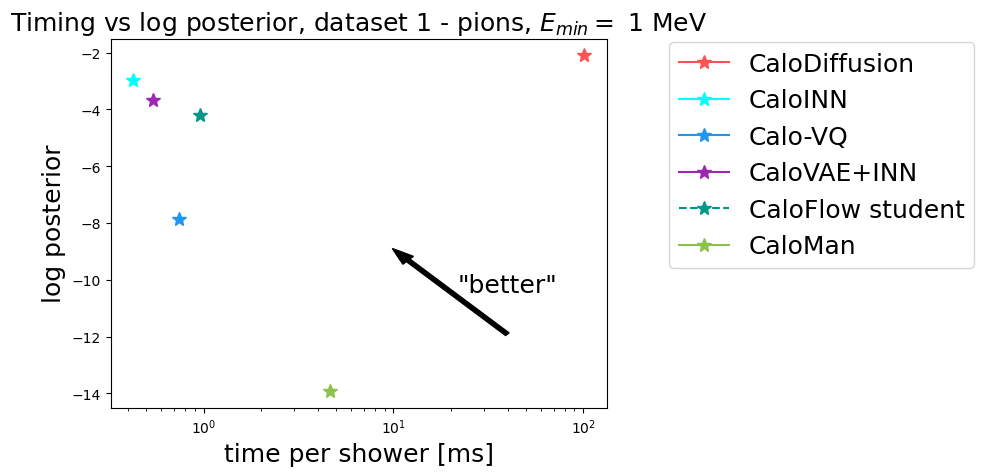

missing:
CaloFlow teacher
BoloGAN
DNN CaloSim
CaloShowerGAN


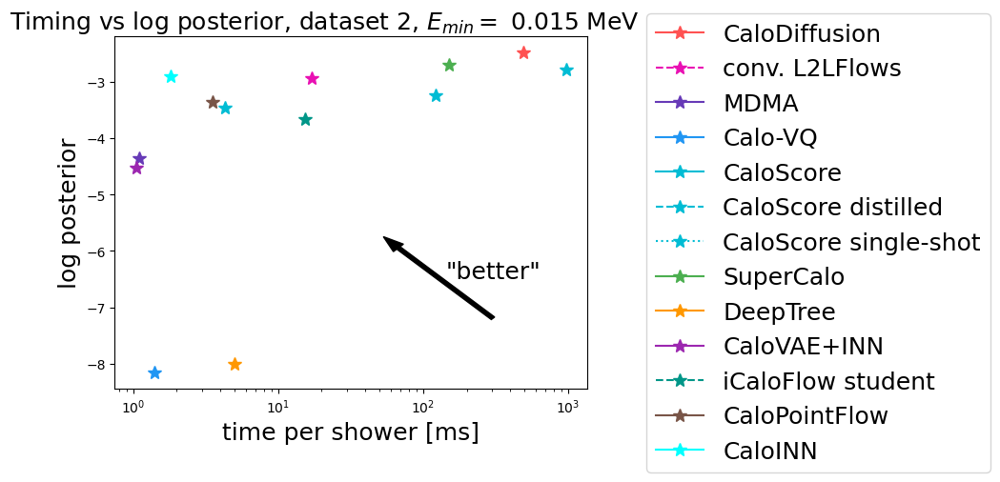

missing:
iCaloFlow teacher


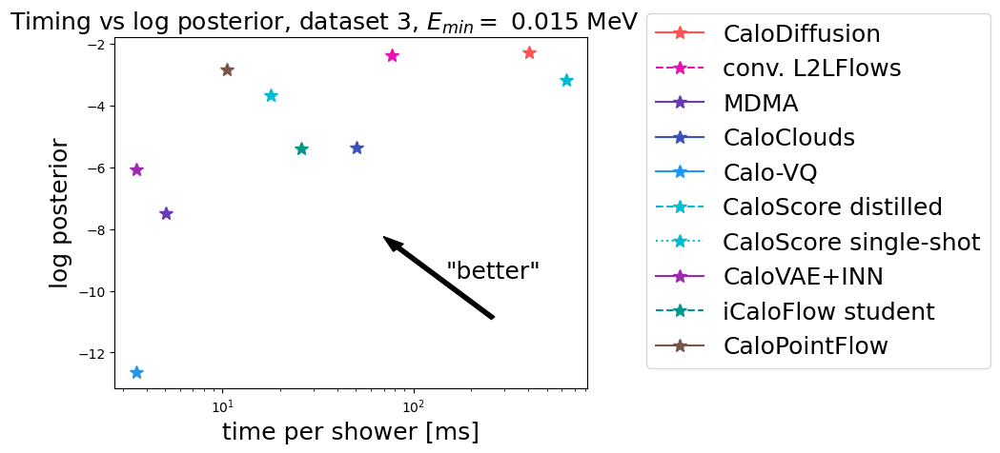

missing:
L2LFlows MAF
iCaloFlow teacher
GEANT4 transformer


In [44]:
MIN_ENERGY = 1
for key in ds1_photon_timing_dict.keys():
    plt.plot(ds1_photon_timing_dict[key], ds1_photon_cls_dict[key], markersize=10, label=id_dict[key], 
             **kwargs_dict[key], marker='*')
    
plt.xscale('log')
plt.xlabel('time per shower [ms]', fontsize=FS)
plt.ylabel('log posterior', fontsize=FS)
plt.legend(bbox_to_anchor=(1.1, 1.025), fontsize=FS)
plt.arrow(0.8, 0.2, -0.2, 0.2, width=0.01, transform=plt.gca().transAxes, color='k')
plt.text(0.8, 0.3, '"better"', ha='center', va='bottom', transform=plt.gca().transAxes, fontsize=FS)
plt.title(f"Timing vs log posterior, dataset 1 - photons, $E_{{min}}=$ {ds1_photons_results_dict['MIN_ENERGY']} MeV", fontsize=FS)
plt.savefig(f'results_fig/time/ds1-photons_time_{MIN_ENERGY}.pdf', dpi=300, bbox_inches='tight')
plt.show()

print("missing:")
for key in ds1_photon_cls_dict.keys():
    if key not in ds1_photon_timing_dict.keys():
        print(id_dict[key])

        
for key in ds1_pion_timing_dict.keys():
    plt.plot(ds1_pion_timing_dict[key], ds1_pion_cls_dict[key], markersize=10, label=id_dict[key], 
             **kwargs_dict[key], marker='*')
    
plt.xscale('log')
plt.ylabel('log posterior', fontsize=FS)
plt.xlabel('time per shower [ms]', fontsize=FS)
plt.legend(bbox_to_anchor=(1.1, 1.025), fontsize=FS)
plt.arrow(0.8, 0.2, -0.2, 0.2, width=0.01, transform=plt.gca().transAxes, color='k')
plt.text(0.8, 0.3, '"better"', ha='center', va='bottom', transform=plt.gca().transAxes, fontsize=FS)
plt.title(f"Timing vs log posterior, dataset 1 - pions, $E_{{min}}=$ {ds1_pions_results_dict['MIN_ENERGY']} MeV", fontsize=FS)
plt.savefig(f'results_fig/time/ds1-pions_time_{MIN_ENERGY}.pdf', dpi=300, bbox_inches='tight')
plt.show()

print("missing:")
for key in ds1_pion_cls_dict.keys():
    if key not in ds1_pion_timing_dict.keys():
        print(id_dict[key])

        
for key in ds2_timing_dict.keys():
    plt.plot(ds2_timing_dict[key], ds2_cls_dict[key], markersize=10, label=id_dict[key], 
             **kwargs_dict[key], marker='*')
    
plt.xscale('log')
plt.ylabel('log posterior', fontsize=FS)
plt.xlabel('time per shower [ms]', fontsize=FS)
plt.legend(bbox_to_anchor=(1.1, 1.1), fontsize=FS)
plt.arrow(0.8, 0.2, -0.2, 0.2, width=0.01, transform=plt.gca().transAxes, color='k')
plt.text(0.8, 0.3, '"better"', ha='center', va='bottom', transform=plt.gca().transAxes, fontsize=FS)
plt.title(f"Timing vs log posterior, dataset 2, $E_{{min}}=$ {ds2_results_dict['MIN_ENERGY']:.3f} MeV        ", fontsize=FS)
plt.savefig(f'results_fig/time/ds2_time.pdf', dpi=300, bbox_inches='tight')
plt.show()

print("missing:")
for key in ds2_cls_dict.keys():
    if key not in ds2_timing_dict.keys():
        print(id_dict[key])

        
for key in ds3_timing_dict.keys():
    plt.plot(ds3_timing_dict[key], ds3_cls_dict[key], markersize=10, label=id_dict[key], 
             **kwargs_dict[key], marker='*')
    
plt.xscale('log')
plt.ylabel('log posterior', fontsize=FS)
plt.xlabel('time per shower [ms]', fontsize=FS)
plt.legend(bbox_to_anchor=(1.1, 1.1), fontsize=FS)
plt.arrow(0.8, 0.2, -0.2, 0.2, width=0.01, transform=plt.gca().transAxes, color='k')
plt.text(0.8, 0.3, '"better"', ha='center', va='bottom', transform=plt.gca().transAxes, fontsize=FS)
plt.title(f"Timing vs log posterior, dataset 3, $E_{{min}}=$ {ds3_results_dict['MIN_ENERGY']:.3f} MeV        ", fontsize=FS)
plt.savefig(f'results_fig/time/ds3_time.pdf', dpi=300, bbox_inches='tight')
plt.show()

print("missing:")
for key in ds3_cls_dict.keys():
    if key not in ds3_timing_dict.keys():
        print(id_dict[key])

        